In [2]:
import importlib.util
import numpy as np
import struct
import sklearn
from sklearn import *
import matplotlib.pyplot as plt
from sklearn.datasets import make_moons
import numpy as np
import pandas as pd
from matplotlib.colors import ListedColormap
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import (
    plot_roc_curve,
    roc_curve,
    auc,
    roc_auc_score,
    accuracy_score,
    log_loss,
    f1_score,
    confusion_matrix,
    classification_report,
)
from sklearn.model_selection import train_test_split
from xgboost import XGBClassifier, plot_importance
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LassoCV
from xgboost import XGBClassifier, plot_importance

# Figure1 Glioma Biological Index

## Classification
### ROC Curve

In [80]:
# 训练和测试数据读入

data_Biological_index1 = pd.read_csv("data/Biological_index/Biological_index2.csv",index_col=0)
data_Biological_index1

#打乱数据
data_Biological_index1 = data_Biological_index1.sample(frac=1.0)#74 rows × 8 columns
data_Biological_index = data_Biological_index1.drop(['Pielous'], axis=1)

# data_Biological_index = data_Biological_index1.sample(frac=1.0)

# 划分训练数据和标签
y1,X1=np.split(data_Biological_index,indices_or_sections=(1,),axis=1)
X = X1.values
y = y1.values
# #标准化 可选 knn要 其他不用
Xs = StandardScaler().fit_transform(X) 
train_data,test_data,train_label,test_label=sklearn.model_selection.train_test_split(X,y,random_state=1,train_size=0.85,test_size=0.15)
train_datas,test_datas,train_labels,test_labels=sklearn.model_selection.train_test_split(Xs,y,random_state=1,train_size=0.85,test_size=0.15)

data_Biological_index

,phenotype,Clonality,Shannon.Index,Invsimpson.Index,Simpson.Index,Hvj.Index,Singleton
FileName,,,,,,,
Subject_91,0,0.088404,10.818531,1421.906213,0.999297,5.983035,0.459654
10956_PA,1,0.018066,8.685971,1585.846439,0.999369,5.818094,0.825178
Subject_95,0,0.162908,9.828143,232.871919,0.995706,5.685387,0.406619
Subject_60,0,0.132308,10.286566,189.501265,0.994723,5.766139,0.535313
15532_PA,1,0.230380,8.963938,132.570231,0.992457,5.393198,0.276214
...,...,...,...,...,...,...,...
Subject_63,0,0.178409,9.547225,118.857774,0.991587,5.682738,0.450599
Subject_46,0,0.054951,11.146752,8270.671218,0.999879,5.969395,0.514411
17232_PA,1,0.314057,7.665447,13.925555,0.928190,4.759081,0.323119


<AxesSubplot:>

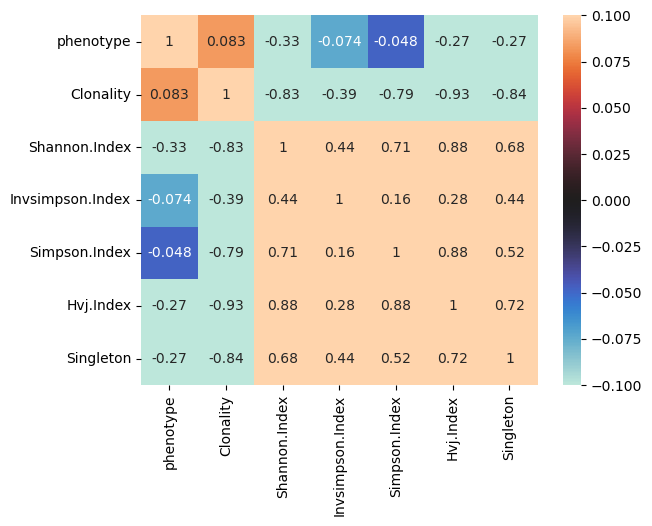

In [81]:
import seaborn as sns
train_corr_Biological_index = data_Biological_index.corr()
sns.heatmap(data_Biological_index.corr(), vmin=-0.1,vmax=0.1,center=0, annot=True)#, annot=True 删除则中间无数字只有色块

#### Training

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


0:	learn: 0.6843944	total: 29.9ms	remaining: 119ms
1:	learn: 0.6714176	total: 31.3ms	remaining: 47ms
2:	learn: 0.6558368	total: 31.8ms	remaining: 21.2ms
3:	learn: 0.6488875	total: 32.3ms	remaining: 8.08ms
4:	learn: 0.6374048	total: 32.9ms	remaining: 0us
RF: 0.7428571428571429
poly: 0.9714285714285715
RF: 1.0
LDA: 0.9142857142857143
NB: 0.7714285714285714
GBDT: 0.8571428571428572
XGB: 1.0
DT: 0.9
CalibratedClassifierCV: 0.2857142857142857
CatBoostClassifier: 0.9714285714285715
BaggingClassifier: 1.0


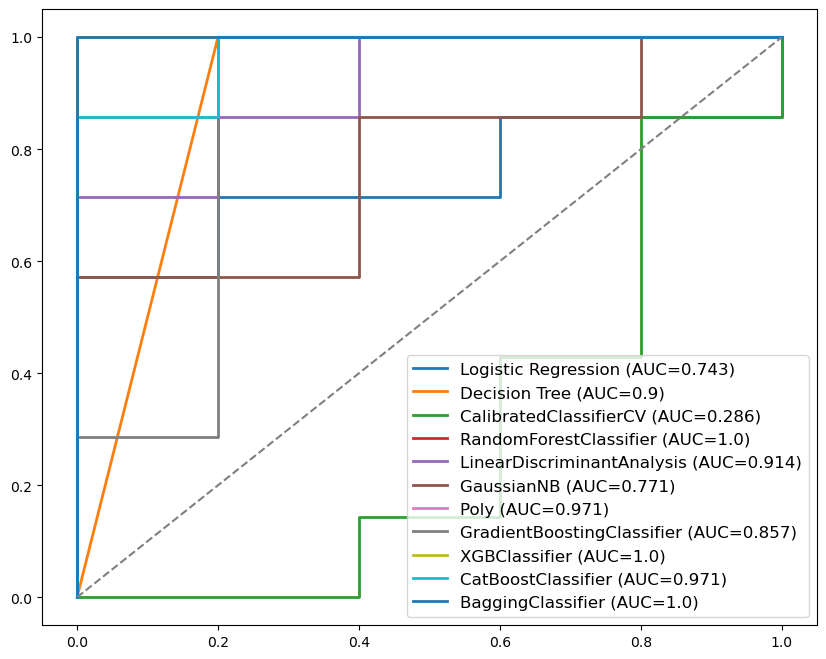

In [85]:
X,Xt,y,yt = train_data,test_data,train_label,test_label

# 训练模型
# LR
from sklearn.linear_model import LogisticRegressionCV
from sklearn.linear_model import LogisticRegression
lr_clf = LogisticRegression(multi_class='multinomial',solver='newton-cg',class_weight='balanced',max_iter=10000)
#clf = LogisticRegression(multi_class='multinomial',solver='lbfgs',class_weight='balanced',max_iter=10000)
lr_clf = LogisticRegression()

#RF
from sklearn.linear_model import LogisticRegressionCV
from sklearn.ensemble import RandomForestClassifier #分类器
rf_clf = RandomForestClassifier(n_estimators = 210) #训练100个基分类器

#svm linear
# from sklearn.svm import SVC
# import sklearn
# from sklearn.preprocessing import PolynomialFeatures, StandardScaler
# from sklearn.svm import LinearSVC
# from sklearn.pipeline import Pipeline
# svm_clf=svm.SVC(kernel='linear', probability=True,random_state=10)#使用核函数为线性核，参数默认，创建分类器

#SVM poly
from sklearn.svm import SVC
import sklearn
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.svm import LinearSVC
from sklearn.pipeline import Pipeline
def PolynomialSVC(degree, C=1.0):
    return Pipeline([
        ('poly', PolynomialFeatures(degree=degree)),
        ('std)scaler', StandardScaler()),
        ('linearSVC', LinearSVC(C=C))
    ])
svm = PolynomialSVC(degree=3)
from sklearn.calibration import CalibratedClassifierCV
poly_clf = CalibratedClassifierCV(svm) 

#LDA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
lda_clf = LinearDiscriminantAnalysis() 

#KNN
from sklearn.neighbors import KNeighborsClassifier
knn_clf = KNeighborsClassifier()

#bays
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import confusion_matrix
nb_clf = GaussianNB()

#GBDT
from sklearn.ensemble import GradientBoostingClassifier #GBDT算法
gbdt_clf = GradientBoostingClassifier() 

#XGBOOST
import xgboost as xgb
from xgboost.sklearn import XGBClassifier
xgb_clf = XGBClassifier()

#dt
from sklearn.tree import DecisionTreeClassifier  
# classifier = DecisionTreeClassifier()  
dt_clf = DecisionTreeClassifier()  

#CalibratedClassifierCV
from sklearn.naive_bayes import GaussianNB
from sklearn.calibration import CalibratedClassifierCV
# 创建高斯朴素贝叶斯实例
clf = GaussianNB()
# 使用sigmoid校准创建校准交叉验证
# clf_sigmoid = CalibratedClassifierCV(clf, cv=2, method='sigmoid')
cv_clf = CalibratedClassifierCV(clf, cv=2, method='sigmoid')

#CatBoostClassifier
import catboost as cb
from catboost import CatBoostClassifier
from sklearn import metrics
from sklearn.model_selection import train_test_split\
# cb = CatBoostClassifier(iterations=5, learning_rate=0.1)
cbc_clf=CatBoostClassifier(iterations=5, learning_rate=0.1)

#BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.model_selection import train_test_split
dt = DecisionTreeClassifier(random_state=1)
bag_clf=BaggingClassifier(base_estimator=dt, 
        n_estimators=50, random_state=1)

#训练模型
lr_clf.fit(X,np.ravel(y,order='C'))
# knn_clf.fit(X,np.ravel(y,order='C'))
# svm_clf.fit(X,np.ravel(y,order='C'))
poly_clf.fit(X,np.ravel(y,order='C'))
rf_clf.fit(X,np.ravel(y,order='C'))
lda_clf.fit(X,np.ravel(y,order='C'))
nb_clf.fit(X,np.ravel(y,order='C'))
gbdt_clf.fit(X,np.ravel(y,order='C'))
xgb_clf.fit(X,np.ravel(y,order='C'))
dt_clf.fit(X,np.ravel(y,order='C'))
cv_clf.fit(X,np.ravel(y,order='C'))
cbc_clf.fit(X,np.ravel(y,order='C'))
bag_clf.fit(X,np.ravel(y,order='C'))

#from jiaxin
# yt = phenoknn_test["phenotype"]
#prob 预测
score_lr = lr_clf.predict_proba(Xt)[:,1]
#score_knn = knn_clf.predict_proba(Xt)[:,1]
# score_svm = svm_clf.predict_proba(Xt)[:,1]
score_poly = poly_clf.predict_proba(Xt)[:,1]
score_rf = rf_clf.predict_proba(Xt)[:,1]
score_lda = lda_clf.predict_proba(Xt)[:,1]
score_nb = nb_clf.predict_proba(Xt)[:,1]
score_gbdt = gbdt_clf.predict_proba(Xt)[:,1]
score_xgb = xgb_clf.predict_proba(Xt)[:,1]
score_dt = dt_clf.predict_proba(Xt)[:,1]
score_cv = cv_clf.predict_proba(Xt)[:,1]
score_cbc = cbc_clf.predict_proba(Xt)[:,1]
score_bag = bag_clf.predict_proba(Xt)[:,1]

#0-1预测
predict_lr = lr_clf.predict(Xt)
#predict_knn = knn_clf.predict(Xt)
# predict_svm = svm_clf.predict(Xt)
predict_poly = poly_clf.predict(Xt)
predict_rf = rf_clf.predict(Xt)
predict_lda = lda_clf.predict(Xt)
predict_nb = nb_clf.predict(Xt)
predict_gbdt = gbdt_clf.predict(Xt)
predict_xgb = xgb_clf.predict(Xt)
predict_dt = dt_clf.predict(Xt)
predict_cv = cv_clf.predict(Xt)
predict_cbc = cbc_clf.predict(Xt)
predict_bag = bag_clf.predict(Xt)

# #使用roc_curve方法得到三个模型的真正率TP,假正率FP和阈值threshold
fpr_lr,tpr_lr,thres_lr = roc_curve(yt,score_lr, pos_label=1)
#fpr_knn,tpr_knn,thres_knn = roc_curve(yt,score_knn, pos_label=1)
# fpr_svm,tpr_svm,thres_svm = roc_curve(yt,score_svm, pos_label=1)
fpr_poly,tpr_poly,thres_poly = roc_curve(yt,score_poly, pos_label=1)
fpr_rf,tpr_rf,thres_rf = roc_curve(yt,score_rf, pos_label=1)
fpr_lda,tpr_lda,thres_lda = roc_curve(yt,score_lda, pos_label=1)
fpr_nb,tpr_nb,thres_nb = roc_curve(yt,score_nb, pos_label=1)
fpr_gbdt,tpr_gbdt,thres_gbdt = roc_curve(yt,score_gbdt, pos_label=1)
fpr_xgb,tpr_xgb,thres_xgb = roc_curve(yt,score_xgb, pos_label=1)
fpr_dt,tpr_dt,thres_dt = roc_curve(yt,score_dt, pos_label=1)
fpr_cv,tpr_cv,thres_cv = roc_curve(yt,score_cv, pos_label=1)
fpr_cbc,tpr_cbc,thres_cbc = roc_curve(yt,score_cbc, pos_label=1)
fpr_bag,tpr_bag,thres_bag = roc_curve(yt,score_bag, pos_label=1)

#使用roc_curve方法得到三个模型的真正率TP,假正率FP和阈值threshold
# fpr_lr,tpr_lr,thres_lr = roc_curve(yt,score_lr,)
# #fpr_knn,tpr_knn,thres_knn = roc_curve(yt,score_knn, pos_label=1)
# fpr_svm,tpr_svm,thres_svm = roc_curve(yt,score_svm, )
# fpr_poly,tpr_poly,thres_poly = roc_curve(yt,score_poly, )
# fpr_rf,tpr_rf,thres_rf = roc_curve(yt,score_rf, )
# fpr_lda,tpr_lda,thres_lda = roc_curve(yt,score_lda, )
# fpr_gbdt,tpr_gbdt,thres_gbdt = roc_curve(yt,score_gbdt, )
# fpr_xgb,tpr_xgb,thres_xgb = roc_curve(yt,score_xgb, )

#输出指标结果图
#print("knn:",auc(fpr_knn,tpr_knn))
print("RF:",auc(fpr_lr,tpr_lr))
# print("SVM:",auc(fpr_svm,tpr_svm))
print("poly:",auc(fpr_poly,tpr_poly))
print("RF:",auc(fpr_rf,tpr_rf))
print("LDA:",auc(fpr_lda,tpr_lda))
print("NB:",auc(fpr_nb,tpr_nb))
print("GBDT:",auc(fpr_gbdt,tpr_gbdt))
print("XGB:",auc(fpr_xgb,tpr_xgb))
print("DT:",auc(fpr_dt,tpr_dt))
print("CalibratedClassifierCV:",auc(fpr_cv,tpr_cv))
print("CatBoostClassifier:",auc(fpr_cbc,tpr_cbc))
print("BaggingClassifier:",auc(fpr_bag,tpr_bag))

#ROC
#创建画布
fig,ax = plt.subplots(figsize=(10,8))
#自定义标签名称label=''
ax.plot(fpr_lr,tpr_lr,linewidth=2,
        label='Logistic Regression (AUC={})'.format(str(round(auc(fpr_lr,tpr_lr),3))))
ax.plot(fpr_dt,tpr_dt,linewidth=2,
        label='Decision Tree (AUC={})'.format(str(round(auc(fpr_dt,tpr_dt),3))))
ax.plot(fpr_cv,tpr_cv,linewidth=2,
       label='CalibratedClassifierCV (AUC={})'.format(str(round(auc(fpr_cv,tpr_cv),3))))
# ax.plot(fpr_svm,tpr_svm,linewidth=2,
#         label='svm (AUC={})'.format(str(round(auc(fpr_svm,tpr_svm),3))))
ax.plot(fpr_rf,tpr_rf,linewidth=2,
        label='RandomForestClassifier (AUC={})'.format(str(round(auc(fpr_rf,tpr_rf),3))))
ax.plot(fpr_lda,tpr_lda,linewidth=2,
        label='LinearDiscriminantAnalysis (AUC={})'.format(str(round(auc(fpr_lda,tpr_lda),3))))
ax.plot(fpr_nb,tpr_nb,linewidth=2,
        label='GaussianNB (AUC={})'.format(str(round(auc(fpr_nb,tpr_nb),3))))
ax.plot(fpr_poly,tpr_poly,linewidth=2,
        label='Poly (AUC={})'.format(str(round(auc(fpr_poly,tpr_poly),3))))
ax.plot(fpr_gbdt,tpr_gbdt,linewidth=2,
        label='GradientBoostingClassifier (AUC={})'.format(str(round(auc(fpr_gbdt,tpr_gbdt),3))))
ax.plot(fpr_xgb,tpr_xgb,linewidth=2,
        label='XGBClassifier (AUC={})'.format(str(round(auc(fpr_xgb,tpr_xgb),3))))
ax.plot(fpr_cbc,tpr_cbc,linewidth=2,
        label='CatBoostClassifier (AUC={})'.format(str(round(auc(fpr_cbc,tpr_cbc),3))))
ax.plot(fpr_bag,tpr_bag,linewidth=2,
        label='BaggingClassifier (AUC={})'.format(str(round(auc(fpr_bag,tpr_bag),3))))

#绘制对角线
ax.plot([0,1],[0,1],linestyle='--',color='grey')
#调整字体大小
plt.legend(fontsize=12)
plt.show()



### Importance

In [86]:
'''
数据重新导入
'''
# 训练和测试数据读入

# data_Biological_index = pd.read_csv("D:/zky/aimuen/分类_脑胶质瘤/原始数据/脑胶质瘤_样本生物指标/Biological_index.csv",index_col=0)
# data_Biological_index=data_Biological_index.drop(["nc_diversity","nc_frequency"],axis=1)

data_Biological_index = pd.read_csv("data/Biological_index/Biological_index2.csv",index_col=0)
data_Biological_index = data_Biological_index.drop(['Pielous'], axis=1)
data_Biological_index

#打乱数据
data_Biological_index = data_Biological_index.sample(frac=1.0)

# 划分训练数据和标签
y2,X2=np.split(data_Biological_index,indices_or_sections=(1,),axis=1)
data_Biological_index

,phenotype,Clonality,Shannon.Index,Invsimpson.Index,Simpson.Index,Hvj.Index,Singleton
FileName,,,,,,,
Subject_81,0,0.061645,10.624018,919.183529,0.998912,5.976600,0.547533
NOA-16_ID23_V03_tracking,1,0.114262,10.210090,657.151530,0.998478,5.720246,0.396379
Subject_44,0,0.024417,11.782817,12327.963550,0.999919,5.974824,0.749482
Subject_67,0,0.148048,9.801668,261.959043,0.996183,5.693046,0.465303
NOA-16_ID30_V03_tracking,1,0.147927,9.314893,193.515722,0.994832,5.506464,0.551791
...,...,...,...,...,...,...,...
Subject_104,0,0.020452,12.172199,9170.244260,0.999891,6.000114,0.799732
33296_PA,1,0.132692,10.494906,351.477374,0.997155,5.665789,0.398588
Subject_96,0,0.388479,6.678802,14.509791,0.931081,4.542314,0.233544


#### XGBClassifier

feature_importance {'Simpson.Index': 0.0, 'Clonality': 0.093, 'Singleton': 0.113, 'Shannon.Index': 0.127, 'Invsimpson.Index': 0.252, 'Hvj.Index': 0.415}


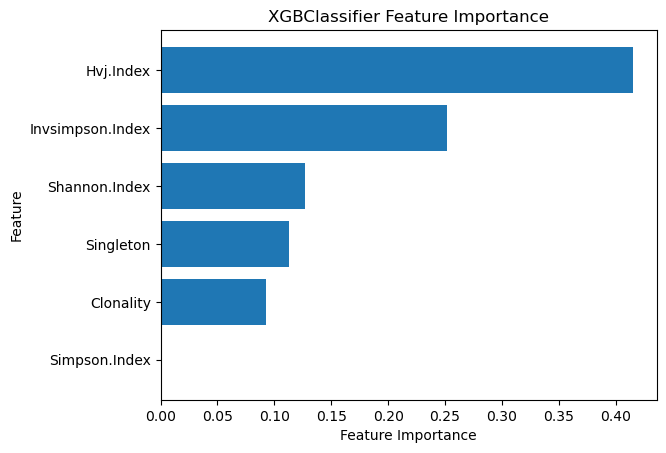

In [89]:
import pandas as pd
from sklearn.ensemble import GradientBoostingClassifier
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score
from xgboost import XGBClassifier
from xgboost import plot_importance

# 训练模型
gbdt = XGBClassifier(n_estimators=100, random_state=42)
gbdt.fit(X2, y2)

# 获取特征重要性排名
importance = gbdt.feature_importances_

# 将特征重要性排序
feature_importance = {feature: round(importance, 3) for feature, importance in zip(X2.columns, importance)}
feature_importance = dict(sorted(feature_importance.items(), key=lambda x: x[1], reverse=False))
feature_importance_XGB = feature_importance
print("feature_importance",feature_importance)

# 绘制条形图
plt.barh(range(len(feature_importance)), feature_importance.values(), align='center')
plt.yticks(range(len(feature_importance)), feature_importance.keys())
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('XGBClassifier Feature Importance')
plt.show()

In [118]:
feature_importance_XGB

{'Pielous': 0.0,
 'Simpson.Index': 0.0,
 'Clonality': 0.093,
 'Singleton': 0.113,
 'Shannon.Index': 0.127,
 'Invsimpson.Index': 0.252,
 'Hvj.Index': 0.415}

#### Permutation Importance

C:\Users\Administrator\AppData\Local\Temp\ipykernel_6852\374844196.py:8: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rf.fit(X2, y2)


feature_importance {'Simpson.Index': 0.015, 'Invsimpson.Index': 0.019, 'Singleton': 0.022, 'Shannon.Index': 0.047, 'Clonality': 0.078, 'Hvj.Index': 0.324}


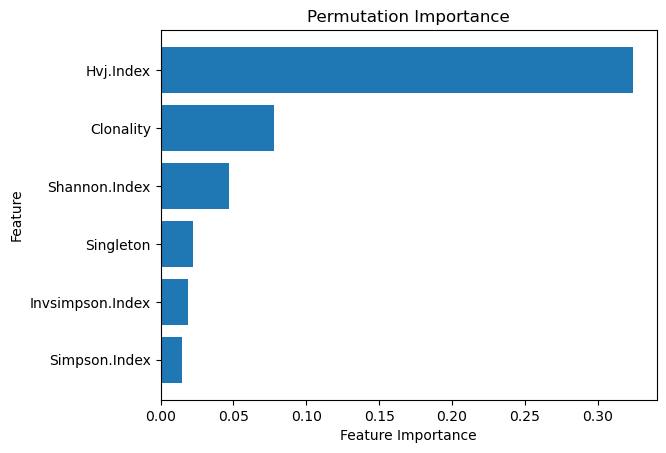

In [90]:
import pandas as pd
from sklearn.inspection import permutation_importance
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt

# 训练模型
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X2, y2)

# 计算特征重要性
result = permutation_importance(rf, X2, y2, n_repeats=10, random_state=42)

# 将特征重要性排序
feature_importance = {feature: round(importance, 3) for feature, importance in zip(X2.columns, result.importances_mean)}
feature_importance = dict(sorted(feature_importance.items(), key=lambda x: x[1], reverse=False))
feature_importance_Permutation = feature_importance
print("feature_importance",feature_importance)
#### XGBClassifier
# 绘制条形图
# plt.barh(range(len(feature_importance)), list(feature_importance.values()), align='center')
# plt.yticks(range(len(feature_importance)), list(feature_importance.keys()))
plt.barh(range(len(feature_importance)), feature_importance.values(), align='center')
plt.yticks(range(len(feature_importance)), feature_importance.keys())
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Permutation Importance')
plt.show()

#### GradientBoostingClassifier

feature_importance {'Singleton': 0.035, 'Shannon.Index': 0.084, 'Invsimpson.Index': 0.089, 'Clonality': 0.14, 'Simpson.Index': 0.15, 'Hvj.Index': 0.503}


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


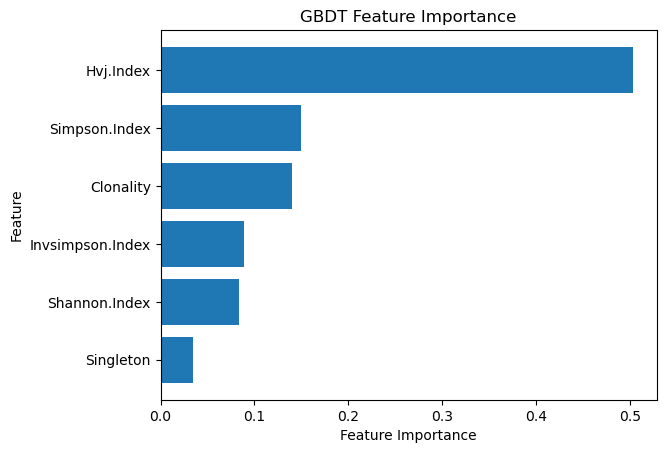

In [91]:
import pandas as pd
from sklearn.ensemble import GradientBoostingClassifier
import matplotlib.pyplot as plt

# 训练模型
gbdt = GradientBoostingClassifier(n_estimators=100, random_state=42)
gbdt.fit(X2, y2)

# 获取特征重要性排名
importance = gbdt.feature_importances_

# 将特征重要性排序
feature_importance = {feature: round(importance, 3) for feature, importance in zip(X2.columns, importance)}
feature_importance = dict(sorted(feature_importance.items(), key=lambda x: x[1], reverse=False))
feature_importance_GBDT = feature_importance
print("feature_importance",feature_importance)

# 绘制条形图
plt.barh(range(len(feature_importance)), feature_importance.values(), align='center')
plt.yticks(range(len(feature_importance)), feature_importance.keys())
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('GBDT Feature Importance')
plt.show()

#### Random Forest

C:\Users\Administrator\AppData\Local\Temp\ipykernel_6852\2383336139.py:7: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rf.fit(X2, y2)


feature_importance {'Invsimpson.Index': 0.112, 'Simpson.Index': 0.122, 'Singleton': 0.127, 'Clonality': 0.154, 'Shannon.Index': 0.184, 'Hvj.Index': 0.301}


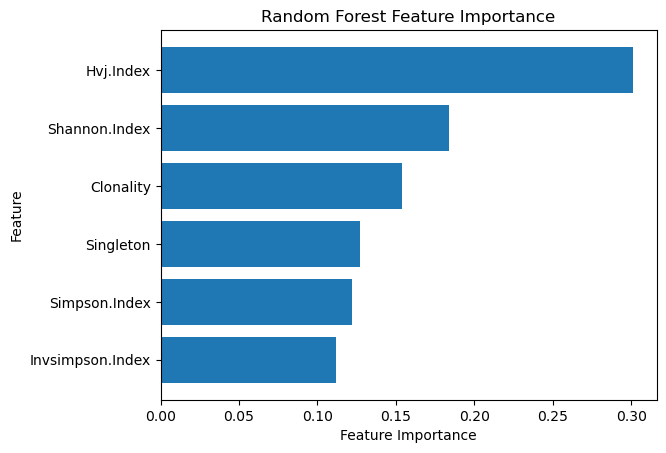

In [92]:
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt

# 训练模型
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X2, y2)

# 获取特征重要性排名
importance = rf.feature_importances_

# 将特征重要性排序
feature_importance = {feature: round(importance, 3) for feature, importance in zip(X2.columns, importance)}
feature_importance = dict(sorted(feature_importance.items(), key=lambda x: x[1], reverse=False))
feature_importance_RF = feature_importance
print("feature_importance",feature_importance)

# 绘制条形图
# plt.barh(range(len(feature_importance)), list(feature_importance.values()), align='center')
# plt.yticks(range(len(feature_importance)), list(feature_importance.keys()))
plt.barh(range(len(feature_importance)), feature_importance.values(), align='center')
plt.yticks(range(len(feature_importance)), feature_importance.keys())
plt.xlabel('Feature Importance')
plt.ylabel('Feature')
plt.title('Random Forest Feature Importance')
plt.show()

### Feature Selection and Box Plot
#### Feature Selection Process

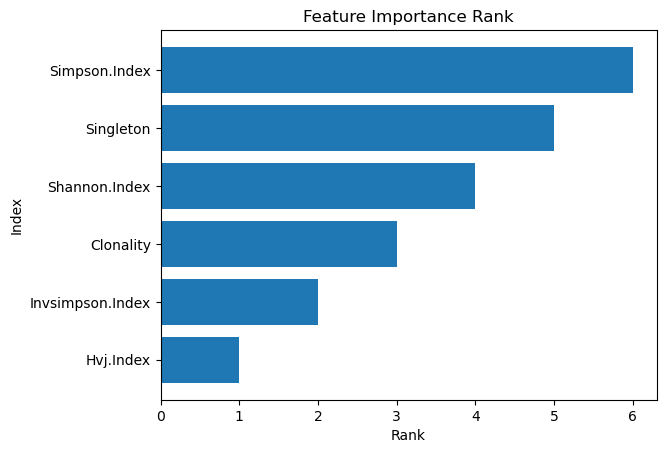

              index     rf    xgb   gbdt   perm  rank
1         Hvj.Index  0.301  0.415  0.503  0.324   1.0
2  Invsimpson.Index  0.112  0.252  0.089  0.019   2.0
0         Clonality  0.154  0.093  0.140  0.078   3.0
3     Shannon.Index  0.184  0.127  0.084  0.047   4.0
5         Singleton  0.127  0.113  0.035  0.022   5.0
4     Simpson.Index  0.122  0.000  0.150  0.015   6.0


In [105]:
import pandas as pd
import matplotlib.pyplot as plt

# 将每个字典转换为 DataFrame，并按 index 降序排列
df_rf = pd.DataFrame(feature_importance_RF.items(), columns=['index', 'rf']).sort_values(by=['rf'], ascending=False).reset_index(drop=True)
df_xgb = pd.DataFrame(feature_importance_XGB.items(), columns=['index', 'xgb']).sort_values(by=['xgb'], ascending=False).reset_index(drop=True)
df_gbdt = pd.DataFrame(feature_importance_GBDT.items(), columns=['index', 'gbdt']).sort_values(by=['gbdt'], ascending=False).reset_index(drop=True)
df_perm = pd.DataFrame(feature_importance_Permutation.items(), columns=['index', 'perm']).sort_values(by=['perm'], ascending=False).reset_index(drop=True)

# 将多个 DataFrame 合并为一个 DataFrame，按指标名称分组，将相同指标的排名相加
df_merge = pd.concat([df_rf, df_xgb, df_gbdt, df_perm], axis=0).groupby(['index']).sum().reset_index()

# 计算指标总排名
df_merge['rank'] = df_merge.iloc[:, 1:].sum(axis=1).rank(ascending=False)

# 按指标总排名降序排序
df_merge = df_merge.sort_values(by=['rank'], ascending=True)

# 输出条形图和数据框
plt.barh(df_merge['index'], df_merge['rank'])
plt.xlabel('Rank')
plt.ylabel('Index')
plt.title('Feature Importance Rank')
plt.show()

print(df_merge)


In [116]:
df_merge2 = df_merge.set_index('index')
df_merge2

,rf,xgb,gbdt,perm,rank
index,,,,,
Hvj.Index,0.301,0.415,0.503,0.324,1.0
Invsimpson.Index,0.112,0.252,0.089,0.019,2.0
Clonality,0.154,0.093,0.140,0.078,3.0
Shannon.Index,0.184,0.127,0.084,0.047,4.0
Singleton,0.127,0.113,0.035,0.022,5.0
Simpson.Index,0.122,0.000,0.150,0.015,6.0


In [134]:
df_merge3 = df_merge2.drop(['rank'],axis=1)
df_merge3['sum']=df_merge3['rf']+df_merge3['xgb']+df_merge3['gbdt']+df_merge3['perm']
df_merge3

,rf,xgb,gbdt,perm,sum
index,,,,,
Hvj.Index,0.301,0.415,0.503,0.324,1.543
Invsimpson.Index,0.112,0.252,0.089,0.019,0.472
Clonality,0.154,0.093,0.140,0.078,0.465
Shannon.Index,0.184,0.127,0.084,0.047,0.442
Singleton,0.127,0.113,0.035,0.022,0.297
Simpson.Index,0.122,0.000,0.150,0.015,0.287


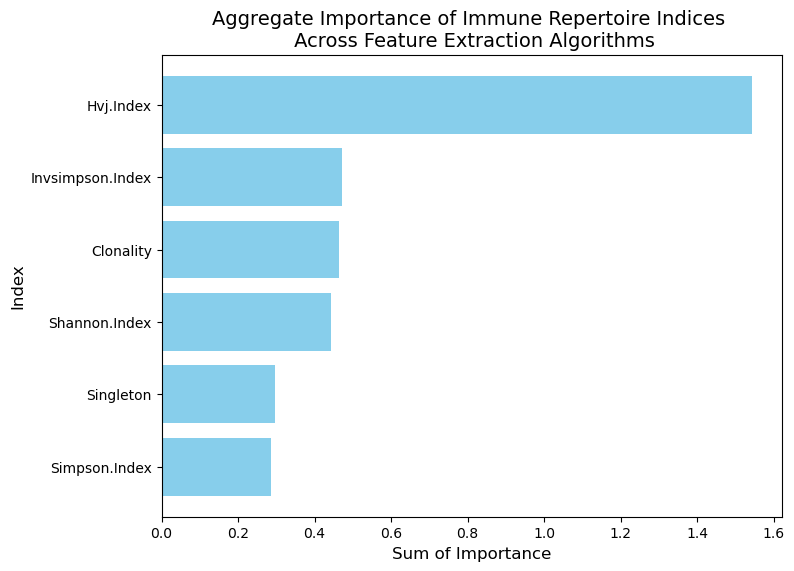

In [137]:
import matplotlib.pyplot as plt

# 排序并提取数据
df_merge3_sorted = df_merge3.sort_values(by='sum', ascending=False)
x_values = df_merge3_sorted.index.tolist()
y_values = df_merge3_sorted['sum'].tolist()

# 绘图
fig, ax = plt.subplots(figsize=(8, 6))
ax.barh(x_values, y_values, color='skyblue')#, color='blue'
ax.invert_yaxis()
ax.set_xlabel('Sum of Importance', fontsize=12)
ax.set_ylabel('Index', fontsize=12)
ax.set_title('Aggregate Importance of Immune Repertoire Indices \n Across Feature Extraction Algorithms', fontsize=14)
plt.show()


In [119]:
df_rank = df_merge2.rank(axis=0)
# df_rank.drop(['index'],axis=1)
df_rank['sum']=df_rank['rf']+df_rank['xgb']+df_rank['gbdt']+df_rank['perm']
df_rank

,rf,xgb,gbdt,perm,rank,sum
index,,,,,,
Hvj.Index,6.0,6.0,6.0,6.0,1.0,24.0
Invsimpson.Index,1.0,5.0,3.0,2.0,2.0,11.0
Clonality,4.0,2.0,4.0,5.0,3.0,15.0
Shannon.Index,5.0,4.0,2.0,4.0,4.0,15.0
Singleton,3.0,3.0,1.0,3.0,5.0,10.0
Simpson.Index,2.0,1.0,5.0,1.0,6.0,9.0


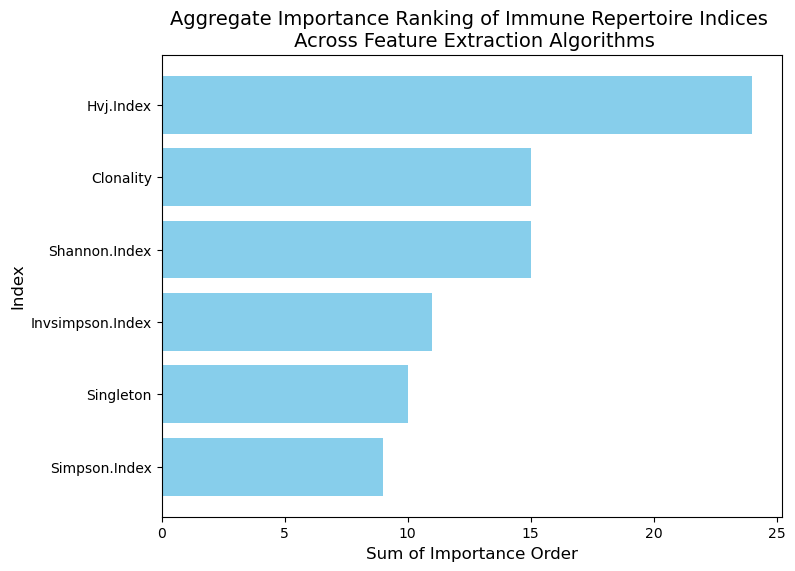

In [136]:
import matplotlib.pyplot as plt

# 排序并提取数据
df_rank_sorted = df_rank.sort_values(by='sum', ascending=False)
x_values = df_rank_sorted.index.tolist()
y_values = df_rank_sorted['sum'].tolist()

# 绘图
fig, ax = plt.subplots(figsize=(8, 6))
ax.barh(x_values, y_values, color='skyblue')#, color='blue'
ax.invert_yaxis()
ax.set_xlabel('Sum of Importance Order', fontsize=12)
ax.set_ylabel('Index', fontsize=12)
ax.set_title('Aggregate Importance Ranking of Immune Repertoire Indices \n Across Feature Extraction Algorithms', fontsize=14)
plt.show()


In [132]:
col_mean

Invsimpson.Index    0.1166
Clonality           0.0796
Singleton           0.0798
Simpson.Index       0.0686
Pielous             0.0712
Shannon.Index       0.1106
Hvj.Index           0.3526
dtype: float64

In [131]:
importance = col_mean.values
feature_importance = {feature: round(importance, 3) for feature, importance in zip(X2.columns, importance)}
feature_importance = dict(sorted(feature_importance.items(), key=lambda x: x[1], reverse=False))
feature_importance_RF = feature_importance
print("feature_importance",feature_importance)

feature_importance {'Invsimpson.Index': 0.069, 'Simpson.Index': 0.071, 'Pielous': 0.08, 'Shannon.Index': 0.08, 'Hvj.Index': 0.111, 'Clonality': 0.117, 'Singleton': 0.353}


#### Box Plot

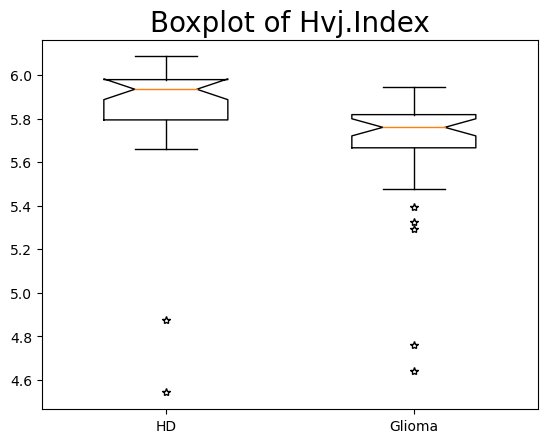

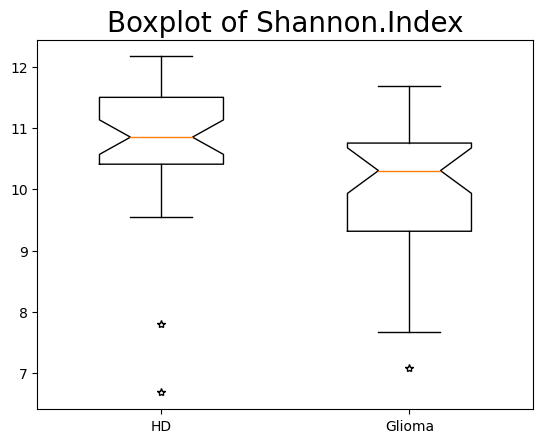

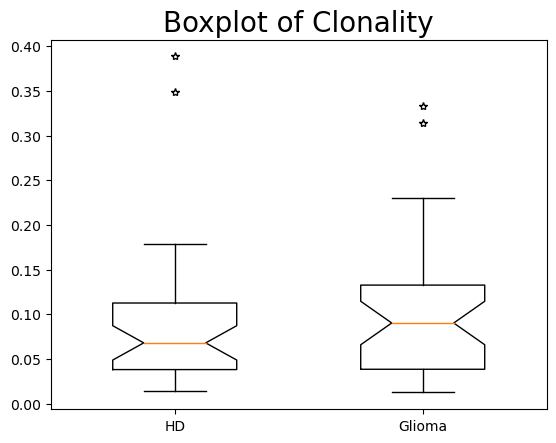

In [106]:
# 因子指标读入

data_Biological_index = pd.read_csv("data/Biological_index/Biological_index2.csv",index_col=0)
data_Biological_index.columns = ['phenotype', 'Clonality','Pielous','Shannon_Index','Invsimpson_Index','Simpson_Index','Hvj_Index','Singleton']
data_Biological_index

import matplotlib.pyplot as plt
plt.rcParams["font.size"]=10#设置字体大小
plt.boxplot([data_Biological_index.Hvj_Index[data_Biological_index.phenotype==0],data_Biological_index.Hvj_Index[data_Biological_index.phenotype==1]],labels=['HD','Glioma'],notch=True,sym = '*',widths=(0.5, 0.5))
plt.title('Boxplot of Hvj.Index',fontsize=20)
plt.show()

import matplotlib.pyplot as plt
plt.rcParams["font.size"]=10#设置字体大小
plt.boxplot([data_Biological_index.Shannon_Index[data_Biological_index.phenotype==0],data_Biological_index.Shannon_Index[data_Biological_index.phenotype==1]],labels=['HD','Glioma'],notch=True,sym = '*',widths=(0.5, 0.5))
plt.title('Boxplot of Shannon.Index',fontsize=20)
plt.show()

import matplotlib.pyplot as plt
# plt.figure(figsize=(10,10))#设置画布的尺寸
plt.rcParams["font.size"]=10#设置字体大小
plt.boxplot([data_Biological_index.Clonality[data_Biological_index.phenotype==0],data_Biological_index.Clonality[data_Biological_index.phenotype==1]],labels=['HD','Glioma'],notch=True,sym = '*',widths=(0.5, 0.5))
plt.title('Boxplot of Clonality',fontsize=20)
plt.show()

# import matplotlib.pyplot as plt
# plt.rcParams["font.size"]=10#设置字体大小
# plt.boxplot([data_Biological_index.mean_insert_size[data_Biological_index.phenotype==0],data_Biological_index.mean_insert_size[data_Biological_index.phenotype==1]],labels=['HD','Glioma'],notch=True,sym = '*',widths=(0.5, 0.5))
# plt.title('Boxplot of mean_insert_size',fontsize=20)
# plt.show()

### Correlation Plot

<AxesSubplot:>

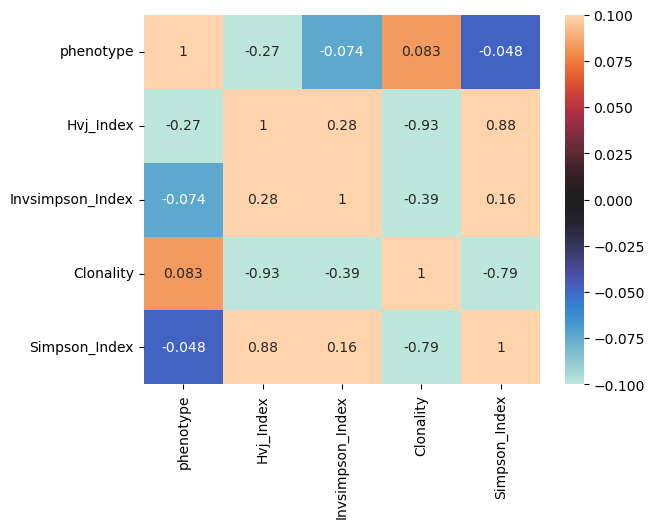

In [44]:
import seaborn as sns
train_corr_Biological_index = data_Biological_index.corr()
index_select=data_Biological_index[["phenotype","Hvj_Index","Invsimpson_Index","Clonality","Simpson_Index"]]#,"mean_insert_size"
index_select

import seaborn as sns
train_corr_Biological_index = index_select.corr()
sns.heatmap(index_select.corr(), vmin=-0.1,vmax=0.1,center=0, annot=True)# 删除则中间无数字只有色块

# Figure2 2D Classification

## Data Collation

### Train data

In [19]:
for i in range(1,6):
    data=pd.read_csv('data/Glioma_dimension2/overPair/AssociatedClones_Cutoff_1e-0%d.csv'%i)
    data.drop(['Sampleid', 'Cutoff'], axis=1, inplace=True)
    data.replace(to_replace ='Positive', value =1,inplace=True)
    data.replace(to_replace ='Negative', value =0,inplace=True)
    data = data.sample(frac=1.0)
    data.to_csv('data/Glioma_dimension2/merge_dimension2/AssociatedClones_train_Cutoff_1e-0%d.csv'%i)

### Test Data

In [33]:
for i in range(1,6):
    data_neg=pd.read_csv("data/Glioma_dimension2/Glioma_test/neg-test/neg-test_overlapPair_Cutoff1e-0%d.csv"%i)
    data_neg.drop(['Sampleid', 'Cutoff'], axis=1, inplace=True)
#     data_neg.replace(to_replace ='Positive', value =1,inplace=True)
    data_neg.replace(to_replace ='Negative', value =0,inplace=True)
    data_neg = data_neg.sample(frac=1.0)
    data_pos=pd.read_csv("data/Glioma_dimension2/Glioma_test/pos-test/pos-test_overlapPair_Cutoff1e-0%d.csv"%i)
    data_pos.drop(['Sampleid', 'Cutoff'], axis=1, inplace=True)
    data_pos.replace(to_replace ='Y', value =1,inplace=True)
    data_pos = data_pos.sample(frac=1.0)
    data_test=pd.concat([data_neg,data_pos])
    data_test = data_test.sample(frac=1.0)
    data_test.to_csv('data/Glioma_dimension2/merge_dimension2/AssociatedClones_test_Cutoff_1e-0%d.csv'%i)

### Correlation Plot

<AxesSubplot:>

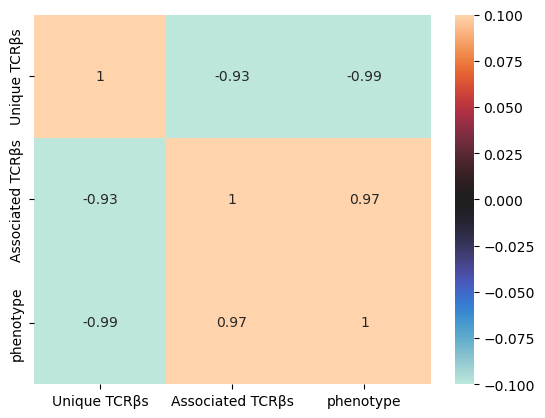

In [36]:
data=pd.read_csv('data/Glioma_dimension2/merge_dimension2/AssociatedClones_train_Cutoff_1e-01.csv')
data.columns = ['Unnamed: 0', 'Unique TCRβs','Associated TCRβs','phenotype']
data=data.drop(["Unnamed: 0"],axis=1)
import seaborn as sns
data = data.corr()
sns.heatmap(data.corr(), vmin=-0.1,vmax=0.1,center=0, annot=True)

### Box Plot

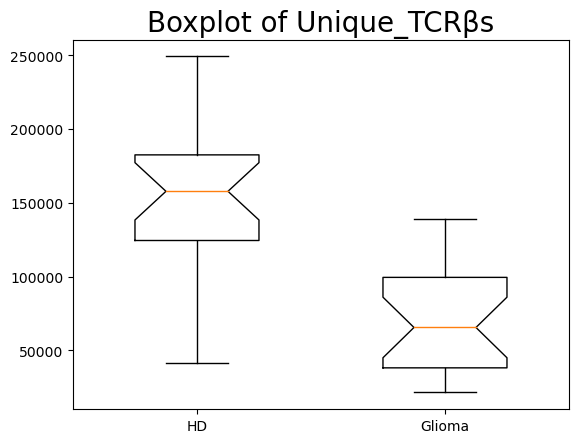

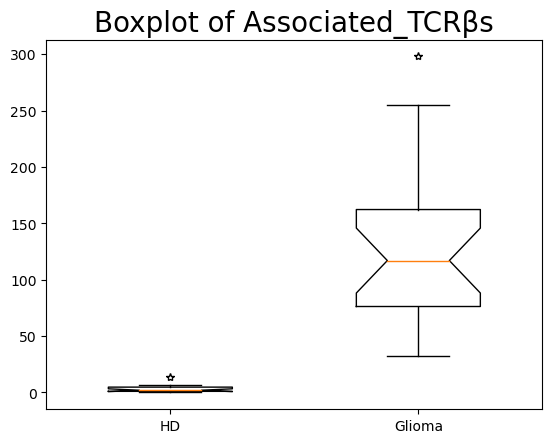

In [38]:
# 因子指标读入

# data_Biological_index = pd.read_csv("C:/Users/Administrator/Desktop/分类_脑胶质瘤/原始数据/脑胶质瘤_样本生物指标/Biological_index.csv",index_col=0)
# data_Biological_index

data=pd.read_csv('data/Glioma_dimension2/merge_dimension2/AssociatedClones_train_Cutoff_1e-01.csv')
data.columns = ['Unnamed: 0', 'Unique_TCRβs','Associated_TCRβs','phenotype']
data_Biological_index=data.drop(["Unnamed: 0"],axis=1)

import matplotlib.pyplot as plt
plt.rcParams["font.size"]=10#设置字体大小
plt.boxplot([data_Biological_index.Unique_TCRβs[data_Biological_index.phenotype==0],data_Biological_index.Unique_TCRβs[data_Biological_index.phenotype==1]],labels=['HD','Glioma'],notch=True,sym = '*',widths=(0.5, 0.5))
plt.title('Boxplot of Unique_TCRβs',fontsize=20)
plt.show()

import matplotlib.pyplot as plt
plt.rcParams["font.size"]=10#设置字体大小
plt.boxplot([data_Biological_index.Associated_TCRβs[data_Biological_index.phenotype==0],data_Biological_index.Associated_TCRβs[data_Biological_index.phenotype==1]],labels=['HD','Glioma'],notch=True,sym = '*',widths=(0.5, 0.5))
plt.title('Boxplot of Associated_TCRβs',fontsize=20)
plt.show()

## Training

### ROC Curve

0:	learn: 0.6501965	total: 10.6ms	remaining: 42.4ms
1:	learn: 0.5986504	total: 11.1ms	remaining: 16.6ms
2:	learn: 0.5675918	total: 11.3ms	remaining: 7.56ms
3:	learn: 0.5387542	total: 11.7ms	remaining: 2.92ms
4:	learn: 0.5147164	total: 12ms	remaining: 0us
best_index 4
accuracy 0.8333333333333334


C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

best_index 3
accuracy 0.9666666666666667
best_index 4
accuracy 0.8666666666666667
best_index 1
accuracy 0.9333333333333333
best_index 4
accuracy 0.8666666666666667
best_index 1
accuracy 0.9333333333333333
best_index 1
accuracy 0.9333333333333333
best_index 2
accuracy 0.9666666666666667
best_index 1
accuracy 0.9666666666666667
best_index 4
accuracy 0.9333333333333333
best_index 0
accuracy 0.9333333333333333
best_index 0
accuracy 0.9
best_index 1
accuracy 0.6
best_index 0
accuracy 0.9333333333333333
Epoch 1/100
2/2 [==============================] - 1s 487ms/step - loss: 0.5678 - accuracy: 1.0000 - auc_75: 1.0000 - precision_75: 1.0000 - recall_75: 1.0000 - val_loss: 0.7055 - val_accuracy: 0.6667 - val_auc_75: 0.5744 - val_precision_75: 0.6667 - val_recall_75: 0.6667
Epoch 2/100
2/2 [==============================] - 0s 28ms/step - loss: 0.5554 - accuracy: 1.0000 - auc_75: 1.0000 - precision_75: 1.0000 - recall_75: 1.0000 - val_loss: 0.7015 - val_accuracy: 0.6667 - val_auc_75: 0.5811 - v

C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:309: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:310: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:309: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:310: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:309: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:310: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

Epoch 1/100
2/2 [==============================] - 3s 584ms/step - loss: 0.6899 - accuracy: 0.2500 - auc_76: 0.4298 - precision_76: 0.2500 - recall_76: 0.2500 - val_loss: 0.6333 - val_accuracy: 0.7667 - val_auc_76: 0.8361 - val_precision_76: 0.7667 - val_recall_76: 0.7667
Epoch 2/100
2/2 [==============================] - 0s 30ms/step - loss: 0.5015 - accuracy: 0.9773 - auc_76: 0.9995 - precision_76: 0.9773 - recall_76: 0.9773 - val_loss: 0.5534 - val_accuracy: 0.7667 - val_auc_76: 0.8667 - val_precision_76: 0.7667 - val_recall_76: 0.7667
Epoch 3/100
2/2 [==============================] - 0s 31ms/step - loss: 0.3181 - accuracy: 0.9773 - auc_76: 0.9995 - precision_76: 0.9773 - recall_76: 0.9773 - val_loss: 0.4651 - val_accuracy: 0.7667 - val_auc_76: 0.8811 - val_precision_76: 0.7667 - val_recall_76: 0.7667
Epoch 4/100
2/2 [==============================] - 0s 34ms/step - loss: 0.1523 - accuracy: 0.9773 - auc_76: 0.9995 - precision_76: 0.9773 - recall_76: 0.9773 - val_loss: 0.4165 - val_

C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:374: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:375: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:374: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:375: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


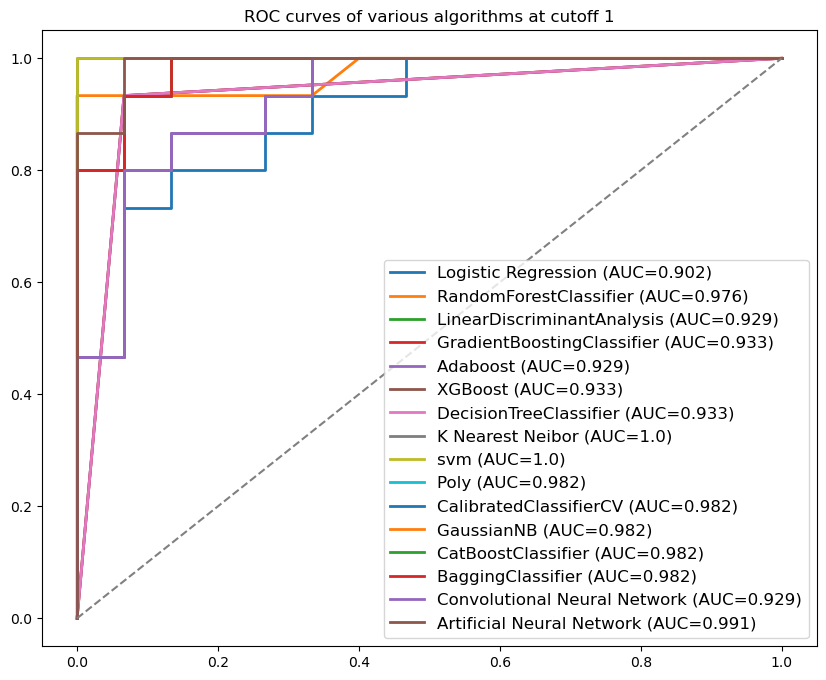

0:	learn: 0.6520231	total: 5.18ms	remaining: 20.7ms
1:	learn: 0.6213429	total: 5.77ms	remaining: 8.65ms
2:	learn: 0.5825414	total: 6.05ms	remaining: 4.04ms
3:	learn: 0.5530418	total: 6.4ms	remaining: 1.6ms
4:	learn: 0.5259937	total: 6.74ms	remaining: 0us
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

best_index 4
accuracy 0.9666666666666667
best_index 2
accuracy 0.9666666666666667
best_index 1
accuracy 0.9666666666666667
best_index 2
accuracy 0.9666666666666667
best_index 1
accuracy 0.9666666666666667
best_index 1
accuracy 0.9666666666666667
best_index 2
accuracy 0.9666666666666667
best_index 1
accuracy 0.9666666666666667
best_index 1
accuracy 0.9666666666666667
best_index 0
accuracy 0.9666666666666667
best_index 1
accuracy 1.0
best_index 1
accuracy 0.8666666666666667
best_index 0
accuracy 0.9666666666666667
Epoch 1/100
2/2 [==============================] - 2s 398ms/step - loss: 0.6688 - accuracy: 0.5227 - auc_77: 0.5620 - precision_77: 0.5227 - recall_77: 0.5227 - val_loss: 0.7084 - val_accuracy: 0.4667 - val_auc_77: 0.5167 - val_precision_77: 0.4667 - val_recall_77: 0.4667
Epoch 2/100
2/2 [==============================] - 0s 26ms/step - loss: 0.6533 - accuracy: 0.5227 - auc_77: 0.5775 - precision_77: 0.5227 - recall_77: 0.5227 - val_loss: 0.7008 - val_accuracy: 0.5000 - val_auc

C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:309: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:310: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:309: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:310: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:309: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:310: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

Epoch 1/100
2/2 [==============================] - 1s 368ms/step - loss: 0.6727 - accuracy: 0.6136 - auc_78: 0.6849 - precision_78: 0.6136 - recall_78: 0.6136 - val_loss: 0.5840 - val_accuracy: 0.9667 - val_auc_78: 0.9994 - val_precision_78: 0.9667 - val_recall_78: 0.9667
Epoch 2/100
2/2 [==============================] - 0s 29ms/step - loss: 0.5005 - accuracy: 0.9773 - auc_78: 0.9995 - precision_78: 0.9773 - recall_78: 0.9773 - val_loss: 0.4546 - val_accuracy: 0.9333 - val_auc_78: 0.9956 - val_precision_78: 0.9333 - val_recall_78: 0.9333
Epoch 3/100
2/2 [==============================] - 0s 30ms/step - loss: 0.3096 - accuracy: 0.9773 - auc_78: 0.9995 - precision_78: 0.9773 - recall_78: 0.9773 - val_loss: 0.3079 - val_accuracy: 0.9333 - val_auc_78: 0.9956 - val_precision_78: 0.9333 - val_recall_78: 0.9333
Epoch 4/100
2/2 [==============================] - 0s 28ms/step - loss: 0.1431 - accuracy: 1.0000 - auc_78: 1.0000 - precision_78: 1.0000 - recall_78: 1.0000 - val_loss: 0.1873 - val_

C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:374: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:375: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:374: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:375: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


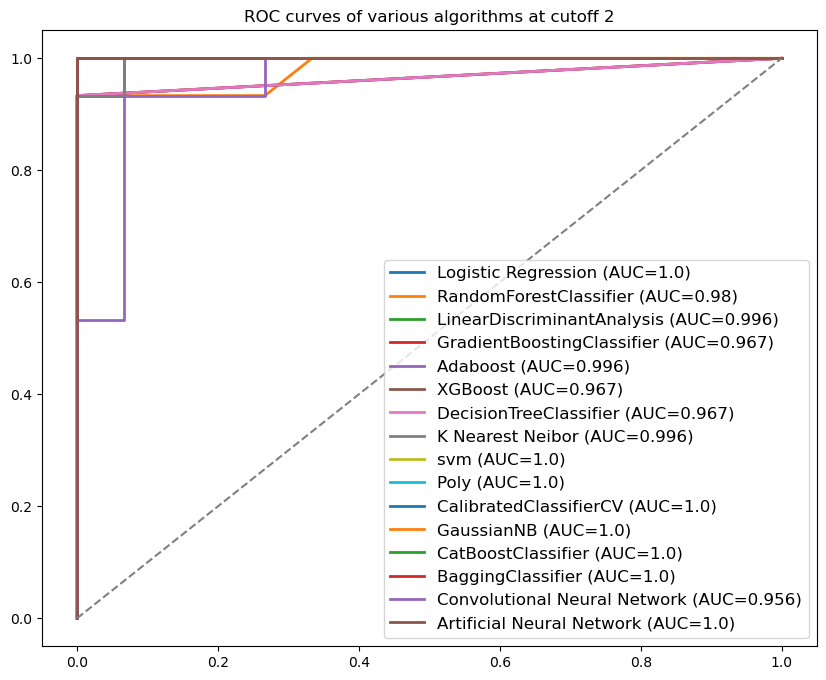

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\linesearch.py:478: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0:	learn: 0.6445875	total: 4.03ms	remaining: 16.1ms
1:	learn: 0.6090689	total: 4.64ms	remaining: 6.96ms
2:	learn: 0.5699440	total: 4.92ms	remaining: 3.28ms
3:	learn: 0.5390293	total: 5.26ms	remaining: 1.31ms
4:	learn: 0.5062334	total: 5.47ms	remaining: 0us
best_index 1
accuracy 0.9666666666666667
best_index 5
accuracy 0.9666666666666667
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

best_index 1
accuracy 0.9666666666666667
best_index 2
accuracy 0.9666666666666667
best_index 1
accuracy 0.9666666666666667
best_index 1
accuracy 0.9666666666666667
best_index 4
accuracy 0.9333333333333333
best_index 2
accuracy 0.9666666666666667
best_index 1
accuracy 0.9666666666666667
best_index 1
accuracy 0.9
best_index 1
accuracy 0.9
best_index 1
accuracy 1.0
best_index 0
accuracy 0.9666666666666667
Epoch 1/100
2/2 [==============================] - 1s 412ms/step - loss: 0.6404 - accuracy: 0.6591 - auc_79: 0.7936 - precision_79: 0.6591 - recall_79: 0.6591 - val_loss: 0.7478 - val_accuracy: 0.5000 - val_auc_79: 0.4228 - val_precision_79: 0.5000 - val_recall_79: 0.5000
Epoch 2/100
2/2 [==============================] - 0s 18ms/step - loss: 0.6268 - accuracy: 0.7727 - auc_79: 0.8383 - precision_79: 0.7727 - recall_79: 0.7727 - val_loss: 0.7382 - val_accuracy: 0.5333 - val_auc_79: 0.4689 - val_precision_79: 0.5333 - val_recall_79: 0.5333
Epoch 3/100
2/2 [==============================] 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:309: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:310: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:309: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:310: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:309: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:310: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

Epoch 1/100
2/2 [==============================] - 1s 369ms/step - loss: 0.6514 - accuracy: 0.7500 - auc_80: 0.8685 - precision_80: 0.7500 - recall_80: 0.7500 - val_loss: 0.5608 - val_accuracy: 0.9000 - val_auc_80: 0.9394 - val_precision_80: 0.9000 - val_recall_80: 0.9000
Epoch 2/100
2/2 [==============================] - 0s 24ms/step - loss: 0.4655 - accuracy: 0.9773 - auc_80: 0.9995 - precision_80: 0.9773 - recall_80: 0.9773 - val_loss: 0.4016 - val_accuracy: 0.9333 - val_auc_80: 0.9511 - val_precision_80: 0.9333 - val_recall_80: 0.9333
Epoch 3/100
2/2 [==============================] - 0s 26ms/step - loss: 0.2613 - accuracy: 1.0000 - auc_80: 1.0000 - precision_80: 1.0000 - recall_80: 1.0000 - val_loss: 0.2776 - val_accuracy: 0.9333 - val_auc_80: 0.9544 - val_precision_80: 0.9333 - val_recall_80: 0.9333
Epoch 4/100
2/2 [==============================] - 0s 29ms/step - loss: 0.0994 - accuracy: 1.0000 - auc_80: 1.0000 - precision_80: 1.0000 - recall_80: 1.0000 - val_loss: 0.2495 - val_

C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:374: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:375: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:374: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:375: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


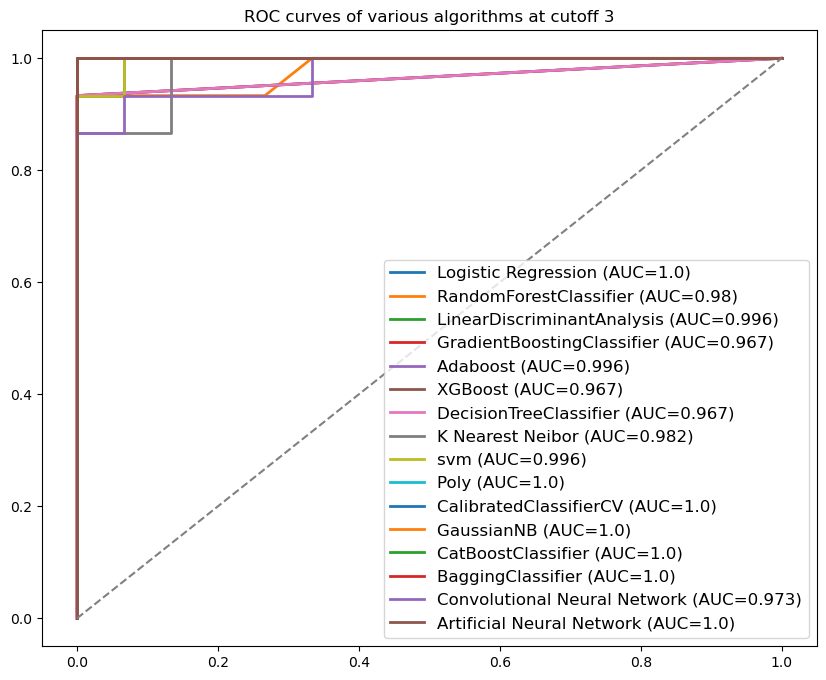

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\linesearch.py:478: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)


0:	learn: 0.6695560	total: 329us	remaining: 1.32ms
1:	learn: 0.6392864	total: 939us	remaining: 1.41ms
2:	learn: 0.6189313	total: 1.44ms	remaining: 958us
3:	learn: 0.5885540	total: 1.67ms	remaining: 417us
4:	learn: 0.5616980	total: 2.34ms	remaining: 0us


C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

best_index 3
accuracy 0.6333333333333333
best_index 7
accuracy 0.7666666666666667
best_index 4
accuracy 0.7333333333333333
best_index 7
accuracy 0.7666666666666667
best_index 4
accuracy 0.7333333333333333
best_index 7
accuracy 0.7666666666666667
best_index 1
accuracy 0.6333333333333333
best_index 3
accuracy 0.7666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

best_index 10
accuracy 0.7333333333333333
best_index 2
accuracy 0.8333333333333334
best_index 1
accuracy 0.5666666666666667
best_index 0
accuracy 0.5666666666666667
best_index 3
accuracy 0.7666666666666667
best_index 2
accuracy 0.6333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


Epoch 1/100
2/2 [==============================] - 2s 446ms/step - loss: 0.5019 - accuracy: 0.9318 - auc_81: 0.9478 - precision_81: 0.9318 - recall_81: 0.9318 - val_loss: 0.6269 - val_accuracy: 0.6333 - val_auc_81: 0.7061 - val_precision_81: 0.6333 - val_recall_81: 0.6333
Epoch 2/100
2/2 [==============================] - 0s 27ms/step - loss: 0.4941 - accuracy: 0.9318 - auc_81: 0.9483 - precision_81: 0.9318 - recall_81: 0.9318 - val_loss: 0.6237 - val_accuracy: 0.6333 - val_auc_81: 0.7089 - val_precision_81: 0.6333 - val_recall_81: 0.6333
Epoch 3/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4860 - accuracy: 0.9318 - auc_81: 0.9478 - precision_81: 0.9318 - recall_81: 0.9318 - val_loss: 0.6204 - val_accuracy: 0.6333 - val_auc_81: 0.7122 - val_precision_81: 0.6333 - val_recall_81: 0.6333
Epoch 4/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4786 - accuracy: 0.9318 - auc_81: 0.9463 - precision_81: 0.9318 - recall_81: 0.9318 - val_loss: 0.6170 - val_

C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:309: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:310: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:309: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:310: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:309: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:310: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

Epoch 1/100
2/2 [==============================] - 1s 381ms/step - loss: 0.6703 - accuracy: 0.5455 - auc_82: 0.6860 - precision_82: 0.5455 - recall_82: 0.5455 - val_loss: 0.5953 - val_accuracy: 0.8000 - val_auc_82: 0.8500 - val_precision_82: 0.8000 - val_recall_82: 0.8000
Epoch 2/100
2/2 [==============================] - 0s 26ms/step - loss: 0.4920 - accuracy: 0.9318 - auc_82: 0.9566 - precision_82: 0.9318 - recall_82: 0.9318 - val_loss: 0.5034 - val_accuracy: 0.8000 - val_auc_82: 0.8600 - val_precision_82: 0.8000 - val_recall_82: 0.8000
Epoch 3/100
2/2 [==============================] - 0s 29ms/step - loss: 0.3352 - accuracy: 0.9318 - auc_82: 0.9700 - precision_82: 0.9318 - recall_82: 0.9318 - val_loss: 0.4578 - val_accuracy: 0.8000 - val_auc_82: 0.8589 - val_precision_82: 0.8000 - val_recall_82: 0.8000
Epoch 4/100
2/2 [==============================] - 0s 26ms/step - loss: 0.2391 - accuracy: 0.9318 - auc_82: 0.9659 - precision_82: 0.9318 - recall_82: 0.9318 - val_loss: 0.5124 - val_

C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:374: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:375: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:374: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:375: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


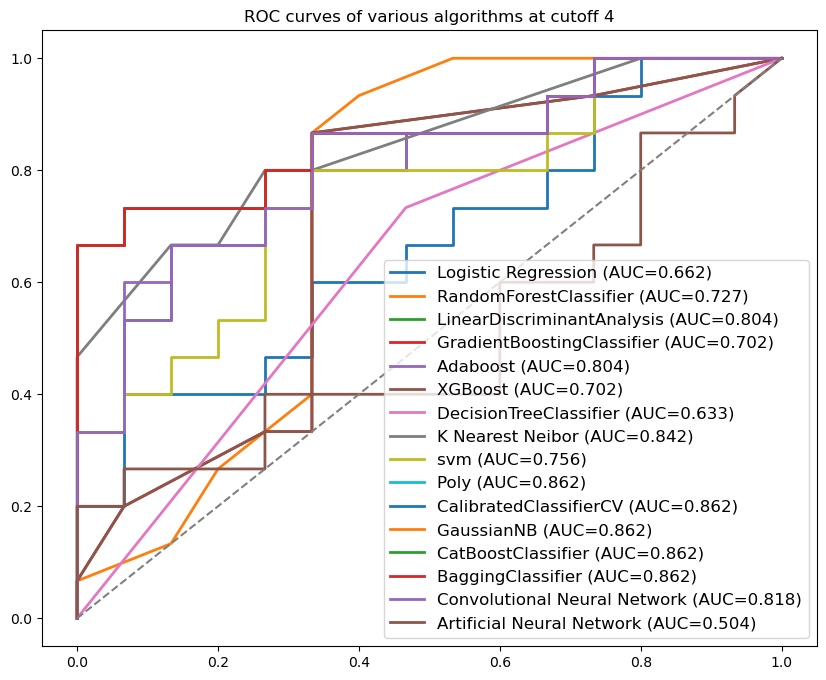

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\linesearch.py:478: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0:	learn: 0.6695560	total: 14.8ms	remaining: 59.3ms
1:	learn: 0.6392864	total: 15.4ms	remaining: 23.1ms
2:	learn: 0.6189313	total: 15.8ms	remaining: 10.5ms
3:	learn: 0.5885540	total: 16ms	remaining: 4ms
4:	learn: 0.5616981	total: 16.2ms	remaining: 0us


C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

best_index 3
accuracy 0.6333333333333333
best_index 8
accuracy 0.7666666666666667
best_index 4
accuracy 0.7333333333333333
best_index 7
accuracy 0.7666666666666667
best_index 4
accuracy 0.7333333333333333
best_index 7
accuracy 0.7666666666666667
best_index 1
accuracy 0.6333333333333333
best_index 3
accuracy 0.7666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:211: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:212: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

best_index 10
accuracy 0.7333333333333333
best_index 2
accuracy 0.8333333333333334
best_index 1
accuracy 0.5666666666666667
best_index 0
accuracy 0.5666666666666667
best_index 3
accuracy 0.7666666666666667
best_index 2
accuracy 0.6333333333333333
Epoch 1/100
2/2 [==============================] - 1s 401ms/step - loss: 0.6959 - accuracy: 0.5455 - auc_83: 0.4535 - precision_83: 0.5455 - recall_83: 0.5455 - val_loss: 0.6964 - val_accuracy: 0.5667 - val_auc_83: 0.4628 - val_precision_83: 0.5667 - val_recall_83: 0.5667
Epoch 2/100
2/2 [==============================] - 0s 21ms/step - loss: 0.6842 - accuracy: 0.5682 - auc_83: 0.5855 - precision_83: 0.5682 - recall_83: 0.5682 - val_loss: 0.6914 - val_accuracy: 0.5667 - val_auc_83: 0.5061 - val_precision_83: 0.5667 - val_recall_83: 0.5667
Epoch 3/100
2/2 [==============================] - 0s 23ms/step - loss: 0.6733 - accuracy: 0.5682 - auc_83: 0.6759 - precision_83: 0.5682 - recall_83: 0.5682 - val_loss: 0.6866 - val_accuracy: 0.5667 - val_au

C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:309: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:310: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:309: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:310: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:309: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:310: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

Epoch 1/100
2/2 [==============================] - 1s 386ms/step - loss: 0.6713 - accuracy: 0.6136 - auc_84: 0.7025 - precision_84: 0.6136 - recall_84: 0.6136 - val_loss: 0.5926 - val_accuracy: 0.8000 - val_auc_84: 0.8500 - val_precision_84: 0.8000 - val_recall_84: 0.8000
Epoch 2/100
2/2 [==============================] - 0s 25ms/step - loss: 0.5071 - accuracy: 0.9318 - auc_84: 0.9514 - precision_84: 0.9318 - recall_84: 0.9318 - val_loss: 0.5129 - val_accuracy: 0.8000 - val_auc_84: 0.8439 - val_precision_84: 0.8000 - val_recall_84: 0.8000
Epoch 3/100
2/2 [==============================] - 0s 27ms/step - loss: 0.3642 - accuracy: 0.9318 - auc_84: 0.9427 - precision_84: 0.9318 - recall_84: 0.9318 - val_loss: 0.4713 - val_accuracy: 0.8000 - val_auc_84: 0.8478 - val_precision_84: 0.8000 - val_recall_84: 0.8000
Epoch 4/100
2/2 [==============================] - 0s 34ms/step - loss: 0.2527 - accuracy: 0.9318 - auc_84: 0.9644 - precision_84: 0.9318 - recall_84: 0.9318 - val_loss: 0.5014 - val_

C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:374: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:375: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:374: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\313214966.py:375: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


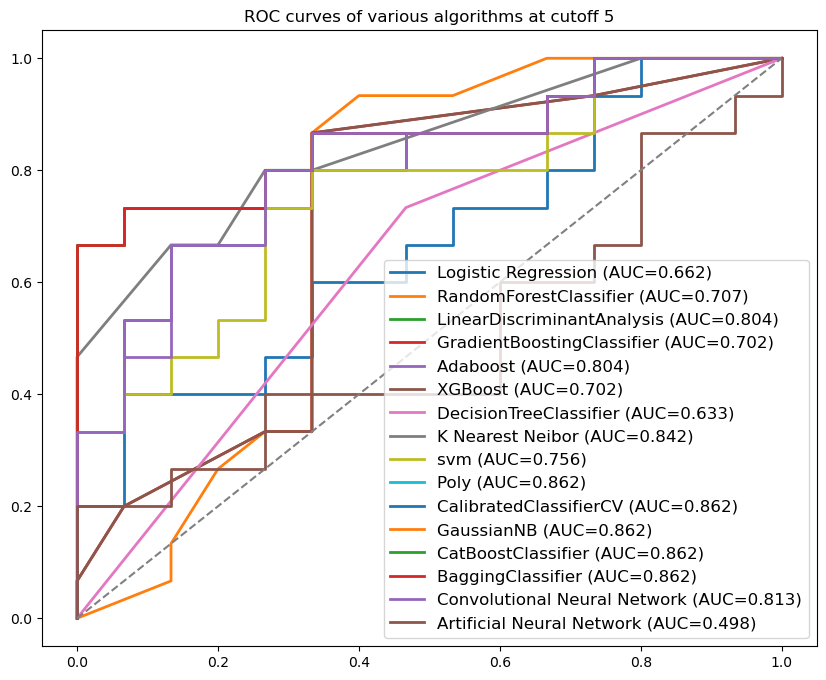

,cutoff,algorithm,best_thresthod,AUC,Accuracy,Sensitivity,Specificity,F1,FDR,Cross_entropy_loss
0,1,lr,8.135874e-08,0.902222,0.833333,0.733333,0.933333,0.083333,0.814815,5.693111
0,1,rf,3.666667e-01,0.975556,0.966667,0.933333,1.000000,0.000000,0.965517,0.203617
0,1,lda,3.365629e-02,0.928889,0.866667,0.800000,0.933333,0.076923,0.857143,0.899367
0,1,gbdt,2.190173e-05,0.933333,0.933333,0.933333,0.933333,0.066667,0.933333,0.715283
0,1,adb,3.365629e-02,0.928889,0.866667,0.800000,0.933333,0.076923,0.857143,0.899367
...,...,...,...,...,...,...,...,...,...,...
0,5,nb,8.573084e-01,0.524444,0.566667,0.200000,0.933333,0.250000,0.315789,1.446104
0,5,cbc,5.496589e-01,0.837778,0.766667,0.533333,1.000000,0.000000,0.695652,0.620082
0,5,bag,6.489111e-01,0.597778,0.633333,0.733333,0.533333,0.388889,0.666667,3.173694
0,5,CNN,4.700000e-01,0.813333,0.733333,0.600000,0.866667,0.181818,0.692308,0.557775


In [37]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import numpy as np
import struct
import sklearn
from sklearn import *
import matplotlib.pyplot as plt
from sklearn.datasets import make_moons
import numpy as np
import pandas as pd
import sklearn
import sklearn.metrics as metrics
from sklearn.metrics import plot_roc_curve,roc_curve,auc,roc_auc_score
from matplotlib.colors import ListedColormap
from sklearn.preprocessing import StandardScaler

dfs=pd.DataFrame() 
for i in range(1,6):
    data_train=pd.read_csv('data/Glioma_dimension2/merge_dimension2/AssociatedClones_train_Cutoff_1e-0%d.csv'%i)
    data_test=pd.read_csv('data/Glioma_dimension2/merge_dimension2/AssociatedClones_test_Cutoff_1e-0%d.csv'%i)
    data_train.drop(['Unnamed: 0'], axis=1, inplace=True)
    data_test.drop(['Unnamed: 0'], axis=1, inplace=True)
    
    #test
    Xt,yt=np.split(data_test,indices_or_sections=(2,),axis=1)
    Xt = Xt.values
    yt = yt.values
    #train
    X,y=np.split(data_train,indices_or_sections=(2,),axis=1)
    X = X.values
    y = y.values
    #标准化 可选 knn要 其他不用
    Xs = StandardScaler().fit_transform(X) 
    Xts = StandardScaler().fit_transform(Xt) 
    train_data,train_label,train_datas,train_labels=X,y,Xs,y
    test_data,test_label,test_datas,test_labels=Xt,yt,Xts,yt

    #训练模型
    #训练模型
    # LR
    from sklearn.linear_model import LogisticRegressionCV
    from sklearn.linear_model import LogisticRegression
    lr_clf = LogisticRegression(multi_class='multinomial',solver='newton-cg',class_weight='balanced',max_iter=10000)
    #clf = LogisticRegression(multi_class='multinomial',solver='lbfgs',class_weight='balanced',max_iter=10000)
    #lr_clf = LogisticRegression()
    
    #svm linear
    from sklearn.svm import SVC
    svm_clf=SVC(kernel='linear', probability=True,random_state=10)#使用核函数为线性核，参数默认，创建分类器 

    #SVM poly
    from sklearn.svm import SVC
    import sklearn
    from sklearn.preprocessing import PolynomialFeatures, StandardScaler
    from sklearn.svm import LinearSVC
    from sklearn.pipeline import Pipeline
    def PolynomialSVC(degree, C=1.0):
        return Pipeline([
            ('poly', PolynomialFeatures(degree=degree)),
            ('std)scaler', StandardScaler()),
            ('linearSVC', LinearSVC(C=C))
        ])
    svm = PolynomialSVC(degree=3)
    from sklearn.calibration import CalibratedClassifierCV
    poly_clf = CalibratedClassifierCV(svm) 

    #KNN
    from sklearn.neighbors import KNeighborsClassifier
    knn_clf = KNeighborsClassifier(n_neighbors=10)

    #RF
    from sklearn.linear_model import LogisticRegressionCV
    from sklearn.ensemble import RandomForestClassifier #分类器
    rf_clf = RandomForestClassifier(n_estimators = 210) #训练100个基分类器

    #LDA
    from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
    from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
    lda_clf = LinearDiscriminantAnalysis() 

    #GBDT
    from sklearn.ensemble import GradientBoostingClassifier #GBDT算法
    gbdt_clf = GradientBoostingClassifier() 

    #AdaBoost
    from sklearn.ensemble import AdaBoostClassifier
    adb_clf = AdaBoostClassifier(n_estimators=100) #迭代100次

    #xgboost
    import xgboost as xgb
    from xgboost.sklearn import XGBClassifier
    xgb_clf = XGBClassifier()

    #decision tree
    from sklearn.tree import DecisionTreeClassifier
    dt_clf = DecisionTreeClassifier()
    
    #bays
    from sklearn.model_selection import StratifiedShuffleSplit
    from sklearn.naive_bayes import GaussianNB
    from sklearn.metrics import confusion_matrix
    nb_clf = GaussianNB()

    #CalibratedClassifierCV
    from sklearn.naive_bayes import GaussianNB
    from sklearn.calibration import CalibratedClassifierCV
    # 创建高斯朴素贝叶斯实例
    clf = GaussianNB()
    # 使用sigmoid校准创建校准交叉验证
    # clf_sigmoid = CalibratedClassifierCV(clf, cv=2, method='sigmoid')
    cv_clf = CalibratedClassifierCV(clf, cv=2, method='sigmoid')

    #CatBoostClassifier
    import catboost as cb
    from catboost import CatBoostClassifier
    from sklearn import metrics
    from sklearn.model_selection import train_test_split
    cbc_clf=CatBoostClassifier(iterations=5, learning_rate=0.1)

    #BaggingClassifier
    from sklearn.tree import DecisionTreeClassifier
    from sklearn.ensemble import BaggingClassifier
    from sklearn.model_selection import train_test_split
    dt = DecisionTreeClassifier(random_state=1)
    bag_clf=BaggingClassifier(base_estimator=dt, 
            n_estimators=50, random_state=1) 
    
    #神经网络算法

    #训练模型
    lr_clf.fit(train_data,train_label.astype('int').ravel())
    rf_clf.fit(train_datas,train_labels.astype('int').ravel())
    lda_clf.fit(train_data,train_label.astype('int').ravel())
    gbdt_clf.fit(train_datas,train_labels.astype('int').ravel())
    adb_clf.fit(train_data,train_label.astype('int').ravel())
    xgb_clf.fit(train_datas,train_labels.astype('int').ravel())
    dt_clf.fit(train_data,train_label.astype('int').ravel())
    knn_clf.fit(train_datas,train_labels.astype('int').ravel())
    svm_clf.fit(train_datas,train_labels.astype('int').ravel())
    poly_clf.fit(train_data,train_label.astype('int').ravel())
    nb_clf.fit(train_data,train_label.astype('int').ravel())
    cv_clf.fit(train_data,train_label.astype('int').ravel())
    cbc_clf.fit(train_data,train_label.astype('int').ravel())
    bag_clf.fit(train_data,train_label.astype('int').ravel())

    #prob 预测
    score_lr = lr_clf.predict_proba(test_data)[:,1]
    score_rf = rf_clf.predict_proba(test_datas)[:,1]
    score_lda = lda_clf.predict_proba(test_data)[:,1]
    score_gbdt = gbdt_clf.predict_proba(test_datas)[:,1]
    score_adb = lda_clf.predict_proba(test_data)[:,1]
    score_xgb = gbdt_clf.predict_proba(test_datas)[:,1]
    score_dt = dt_clf.predict_proba(test_data)[:,1]
    score_knn = knn_clf.predict_proba(test_datas)[:,1]
    score_svm = svm_clf.predict_proba(test_datas)[:,1]
    score_poly = poly_clf.predict_proba(test_data)[:,1]
    score_nb = nb_clf.predict_proba(test_data)[:,1]
    score_cv = cv_clf.predict_proba(test_data)[:,1]
    score_cbc = cbc_clf.predict_proba(test_data)[:,1]
    score_bag = bag_clf.predict_proba(test_data)[:,1]
    
    #0-1预测
    predict_lr = lr_clf.predict(test_data)
    predict_rf = rf_clf.predict(test_datas)
    predict_lda = lda_clf.predict(test_data)
    predict_gbdt = gbdt_clf.predict(test_datas)
    predict_adb = adb_clf.predict(test_data)
    predict_xgb = xgb_clf.predict(test_datas)
    predict_dt = dt_clf.predict(test_data)
    predict_knn = knn_clf.predict(test_datas)
    predict_svm = svm_clf.predict(test_datas)
    predict_poly = poly_clf.predict(test_data)
    predict_nb = nb_clf.predict(test_data)
    predict_cv = cv_clf.predict(test_data)
    predict_cbc = cbc_clf.predict(test_data)
    predict_bag = bag_clf.predict(test_data)
    
    #使用roc_curve方法得到三个模型的真正率TP,假正率FP和阈值threshold
    fpr_lr,tpr_lr,thres_lr = roc_curve(test_label,score_lr,)
    fpr_rf,tpr_rf,thres_rf = roc_curve(test_labels,score_rf,)
    fpr_lda,tpr_lda,thres_lda = roc_curve(test_label,score_lda,)
    fpr_gbdt,tpr_gbdt,thres_gbdt = roc_curve(test_labels,score_gbdt,)
    fpr_adb,tpr_adb,thres_adb = roc_curve(test_label,score_adb,)
    fpr_xgb,tpr_xgb,thres_xgb = roc_curve(test_labels,score_xgb,)
    fpr_dt,tpr_dt,thres_dt = roc_curve(test_label,score_dt,)
    fpr_knn,tpr_knn,thres_knn = roc_curve(test_labels,score_knn,)
    fpr_svm,tpr_svm,thres_svm = roc_curve(test_labels,score_svm,)
    fpr_poly,tpr_poly,thres_poly = roc_curve(test_label,score_poly,)
    fpr_nb,tpr_nb,thres_nb = roc_curve(test_label,score_poly,)
    fpr_cv,tpr_cv,thres_cv = roc_curve(test_label,score_poly,)
    fpr_cbc,tpr_cbc,thres_cbc = roc_curve(test_label,score_poly,)
    fpr_bag,tpr_bag,thres_bag = roc_curve(test_label,score_poly,)
    
    #修改函数已获取最佳阈值对应的最佳准确率等
    def classification_inbestthres(test_label,predict,score,fpr,tpr,thres):
        results = []
        for threshold in thres:
            if threshold > 1:
                continue
            else:
                y_pred = (score > threshold).astype(int)
                tn, fp, fn, tp = confusion_matrix(test_label, y_pred).ravel()
                accuracy = (tp + tn) / (tp + tn + fn +fp)
                recall = tp / (tp + fn)
                speciality=tn / (tn + fp)
                precision = tp / (tp + fp)
                FDR = fp / (tp + fp)
                f1 = 2 * tp / (2 * tp + fn + fp)
                Cross_entropy_loss = metrics.log_loss(test_label, score)
                results.append([threshold, roc_auc_score(test_label, score), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
        # 转换为数组并找出准确率最高的结果
        results = np.array(results)
#         print("results",results)
#         print("results[:, 0]",results[:, 0])
#         print("results[:, 1]",results[:, 1])
#         print("results[:, 2]",results[:, 2])
        best_index = np.argmax(results[:, 2])
        print("best_index",best_index)
        # 输出最佳阈值下的指标
        best_threshold, auc_alg,accuracy, recall,speciality, precision, FDR, f1, Cross_entropy_loss = results[best_index, :]
        print("accuracy",accuracy)
        return best_threshold, auc_alg,accuracy, recall,speciality, FDR, f1, Cross_entropy_loss

    algorithms = ["lr","rf","lda","gbdt","adb","xgb","dt","knn","svm","poly","cv","nb","cbc","bag"]
    for alg in algorithms:
        thres=eval("thres_%s"%alg)
#         thres= np.linspace(0, 1, 101)
        predict=eval("predict_%s"%alg)##***给参数名字字符串赋值的过程***
        score=eval("score_%s"%alg)
        fpr=eval("fpr_%s"%alg)
        tpr=eval("tpr_%s"%alg)
        result=classification_inbestthres(test_label,predict,score,fpr,tpr,thres)
        df=[]
        list = [i,alg,result[0],result[1],result[2],result[3],result[4],result[5],result[6],result[7]]
        df.append(list)
        data=pd.DataFrame(df)
        dfs=pd.concat([dfs,data])
    
    #加上两个神经网络算法的结果
    import tensorflow as tf
    from sklearn.datasets import load_iris
    from sklearn.model_selection import train_test_split
    from sklearn.preprocessing import StandardScaler
    import numpy as np
    from sklearn.datasets import load_iris
    from sklearn.model_selection import train_test_split
    from sklearn.preprocessing import StandardScaler
    import matplotlib.pyplot as plt
    # X_train, X_test, y_train, y_test = Xs, Xts,y,yt#标准化后结果反而差
    X_train, X_test, y_train, y_test = X, Xt,y,yt
    # Scale the data
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test = scaler.transform(X_test)
    # Convert labels to one-hot encoding
    y_train = tf.keras.utils.to_categorical(y_train, num_classes=2)
    y_test = tf.keras.utils.to_categorical(y_test, num_classes=2)
    
    '''
    2.1 卷积神经网络 用于二分类 with adam
    '''
    # Build the model
    model = tf.keras.Sequential([
        tf.keras.layers.Reshape((2, 1), input_shape=(2,)),#每次输入的x_train的大小 2*1
        tf.keras.layers.Conv1D(filters=32, kernel_size=2, activation='relu'),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(units=2, activation='softmax')#输出的类别数 0-1 两类
    ])
    # Compile the model
    model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy", tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])
    # Train the model
    history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))
    # Evaluate the model on the test data
    test_loss, test_accuracy, test_auc, test_precision, test_recall = model.evaluate(X_test, y_test)
    # Calculate the F1 score, FDR error rate, sensitivity, and specificity
    f1_score = 2 * (test_precision * test_recall) / (test_precision + test_recall)
    fdr_error_rate = 1 - test_recall
    sensitivity = test_recall
    specificity = 1 - test_precision
    # Evaluate the model
    results = model.evaluate(X_test, y_test)
    # Make predictions
    probabilities = model.predict(X_test)
    predictions = np.argmax(probabilities, axis=1)
    import numpy as np
    from sklearn.metrics import roc_auc_score, confusion_matrix, precision_recall_curve, f1_score
    from tensorflow.keras.losses import BinaryCrossentropy
    # 预测结果
    predictions = model.predict(X_test)
    # 在测试集上进行预测
    y_pred_cnn = model.predict(X_test)[:, 1]
    # 计算CNN模型的AUC
    fpr_cnn, tpr_cnn, thresholds = roc_curve(y_test[:, 1], y_pred_cnn)
    auc_cnn = auc(fpr_cnn, tpr_cnn)
    # 枚举阈值并计算分类结果
    thresholds = np.linspace(0, 1, 101)
    results = []
    for threshold in thresholds:
        y_pred = (predictions > threshold).astype(int)
        tn, fp, fn, tp = confusion_matrix(y_test.argmax(axis=1), y_pred.argmax(axis=1)).ravel()
        accuracy = (tp + tn) / (tp + tn + fn +fp)
        recall = tp / (tp + fn)
        speciality=tn / (tn + fp)
        precision = tp / (tp + fp)
        FDR = fp / (tp + fp)
        f1 = 2 * tp / (2 * tp + fn + fp)
#         Cross_entropy_loss = metrics.log_loss(y_test.argmax(axis=1), predictions.argmax(axis=1))
        Cross_entropy_loss = metrics.log_loss(y_test, predictions)
        results.append([threshold, roc_auc_score(y_test, predictions), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
#         results.append([threshold, roc_auc_score(y_test.argmax(axis=1), predictions.argmax(axis=1)), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
    # 转换为数组并找出准确率最高的结果
    results = np.array(results)
    best_index = np.argmax(results[:, 2])
    # 输出最佳阈值下的指标
    best_threshold, auc_cnn,accuracy, recall,speciality, precision, FDR, f1, Cross_entropy_loss = results[best_index, :]
    df=[]
    list = [i,'CNN',best_threshold,auc_cnn, accuracy,recall,speciality,FDR,f1,Cross_entropy_loss]
    df.append(list)
    data=pd.DataFrame(df)
    dfs=pd.concat([dfs,data])
     
    '''
    2.2 ann
    '''
    # Build the model
    import keras
    model = keras.Sequential([
            keras.layers.Dense(500,activation='relu',input_shape=[2]),#输入特征数目为2
            keras.layers.Dense(500,activation='relu'),
            keras.layers.Dense(250,activation='relu'),
            keras.layers.Dense(250,activation='relu'),
            keras.layers.Dense(2, activation='softmax')])#输出的类别为2个，所以输出层2个节点
    # Compile the model
    model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy", tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])
    # Train the model
    history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))
    # Evaluate the model on the test data
    test_loss, test_accuracy, test_auc, test_precision, test_recall = model.evaluate(X_test, y_test)
    # Calculate the F1 score, FDR error rate, sensitivity, and specificity
    f1_score = 2 * (test_precision * test_recall) / (test_precision + test_recall)
    fdr_error_rate = 1 - test_recall
    sensitivity = test_recall
    specificity = 1 - test_precision
    # Evaluate the model
    results = model.evaluate(X_test, y_test)
    # Make predictions
    probabilities = model.predict(X_test)
    predictions = np.argmax(probabilities, axis=1)
    import numpy as np
    from sklearn.metrics import roc_auc_score, confusion_matrix, precision_recall_curve, f1_score
    from tensorflow.keras.losses import BinaryCrossentropy
    # 预测结果
    predictions = model.predict(X_test)
    # 在测试集上进行预测
    y_pred_ann = model.predict(X_test)[:, 1]
    # 计算CNN模型的AUC
    fpr_ann, tpr_ann, thresholds = roc_curve(y_test[:, 1], y_pred_ann)
    auc_ann = auc(fpr_ann, tpr_ann)
    # 枚举阈值并计算分类结果
    thresholds = np.linspace(0, 1, 101)
    results = []
    for threshold in thresholds:
        y_pred = (predictions > threshold).astype(int)
        tn, fp, fn, tp = confusion_matrix(y_test.argmax(axis=1), y_pred.argmax(axis=1)).ravel()
#         accuracy = accuracy_score(y_test.argmax(axis=1), y_pred.argmax(axis=1))
        accuracy = (tp + tn) / (tp + tn + fn +fp)
        recall = tp / (tp + fn)
        speciality=tn / (tn + fp)
        precision = tp / (tp + fp)
        FDR = fp / (tp + fp)
        f1 = 2 * tp / (2 * tp + fn + fp)
#         f1 = f1_score(y_test.argmax(axis=1), y_pred.argmax(axis=1))
#         loss = BinaryCrossentropy(y_test.argmax(axis=1), predictions.argmax(axis=1))
#         Cross_entropy_loss = metrics.log_loss(y_test.argmax(axis=1), predictions.argmax(axis=1))
        Cross_entropy_loss = metrics.log_loss(y_test, predictions)
        results.append([threshold, roc_auc_score(y_test, predictions), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
#         results.append([threshold, roc_auc_score(y_test.argmax(axis=1), predictions.argmax(axis=1)), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
    # 转换为数组并找出准确率最高的结果
    results = np.array(results)
    best_index = np.argmax(results[:, 2])
    # 输出最佳阈值下的指标
    best_threshold, auc_ann,accuracy, recall,speciality, precision, FDR, f1, Cross_entropy_loss = results[best_index, :]
    df=[]
    list = [i,'ANN',best_threshold,auc_ann, accuracy,recall,speciality,FDR,f1,Cross_entropy_loss]
    df.append(list)
    data=pd.DataFrame(df)
    dfs=pd.concat([dfs,data])
    
    #ROC
    #创建画布
    fig,ax = plt.subplots(figsize=(10,8))
    #自定义标签名称label=''
    ax.plot(fpr_lr,tpr_lr,linewidth=2,
            label='Logistic Regression (AUC={})'.format(str(round(auc(fpr_lr,tpr_lr),3))))
    ax.plot(fpr_rf,tpr_rf,linewidth=2,
            label='RandomForestClassifier (AUC={})'.format(str(round(auc(fpr_rf,tpr_rf),3))))
    ax.plot(fpr_lda,tpr_lda,linewidth=2,
            label='LinearDiscriminantAnalysis (AUC={})'.format(str(round(auc(fpr_lda,tpr_lda),3))))
    ax.plot(fpr_gbdt,tpr_gbdt,linewidth=2,
            label='GradientBoostingClassifier (AUC={})'.format(str(round(auc(fpr_gbdt,tpr_gbdt),3))))
    ax.plot(fpr_adb,tpr_adb,linewidth=2,
            label='Adaboost (AUC={})'.format(str(round(auc(fpr_adb,tpr_adb),3))))
    ax.plot(fpr_xgb,tpr_xgb,linewidth=2,
            label='XGBoost (AUC={})'.format(str(round(auc(fpr_xgb,tpr_xgb),3))))
    ax.plot(fpr_dt,tpr_dt,linewidth=2,
            label='DecisionTreeClassifier (AUC={})'.format(str(round(auc(fpr_dt,tpr_dt),3))))
    ax.plot(fpr_knn,tpr_knn,linewidth=2,
           label='K Nearest Neibor (AUC={})'.format(str(round(auc(fpr_knn,tpr_knn),3))))
    ax.plot(fpr_svm,tpr_svm,linewidth=2,
            label='svm (AUC={})'.format(str(round(auc(fpr_svm,tpr_svm),3))))
    ax.plot(fpr_poly,tpr_poly,linewidth=2,
            label='Poly (AUC={})'.format(str(round(auc(fpr_poly,tpr_poly),3))))
    ax.plot(fpr_cv,tpr_cv,linewidth=2,
           label='CalibratedClassifierCV (AUC={})'.format(str(round(auc(fpr_cv,tpr_cv),3))))
    ax.plot(fpr_nb,tpr_nb,linewidth=2,
            label='GaussianNB (AUC={})'.format(str(round(auc(fpr_nb,tpr_nb),3))))
    ax.plot(fpr_cbc,tpr_cbc,linewidth=2,
            label='CatBoostClassifier (AUC={})'.format(str(round(auc(fpr_cbc,tpr_cbc),3))))
    ax.plot(fpr_bag,tpr_bag,linewidth=2,
            label='BaggingClassifier (AUC={})'.format(str(round(auc(fpr_bag,tpr_bag),3))))
    ax.plot(fpr_cnn,tpr_cnn,linewidth=2,
            label='Convolutional Neural Network (AUC={})'.format(str(round(auc(fpr_cnn,tpr_cnn),3))))
    ax.plot(fpr_ann,tpr_ann,linewidth=2,
            label='Artificial Neural Network (AUC={})'.format(str(round(auc(fpr_ann,tpr_ann),3))))
    #绘制对角线
    ax.plot([0,1],[0,1],linestyle='--',color='grey')
    #调整字体大小
    plt.legend(fontsize=12)
    plt.title("ROC curves of various algorithms at cutoff %d"%i)
    plt.show()
data/Glioma_dimension2/merge_dimension2/
dfs.columns = ['cutoff','algorithm','best_thresthod','AUC','Accuracy','Sensitivity','Specificity','F1','FDR','Cross_entropy_loss']
dfs.to_csv("data/Glioma_dimension2/result.csv")
dfs

### Distribution map of individual algorithms - training points

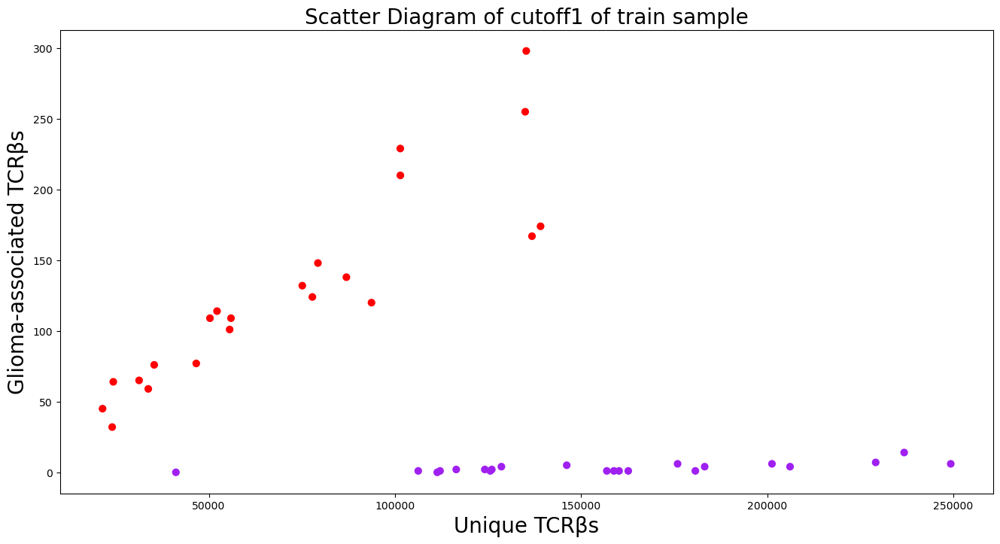

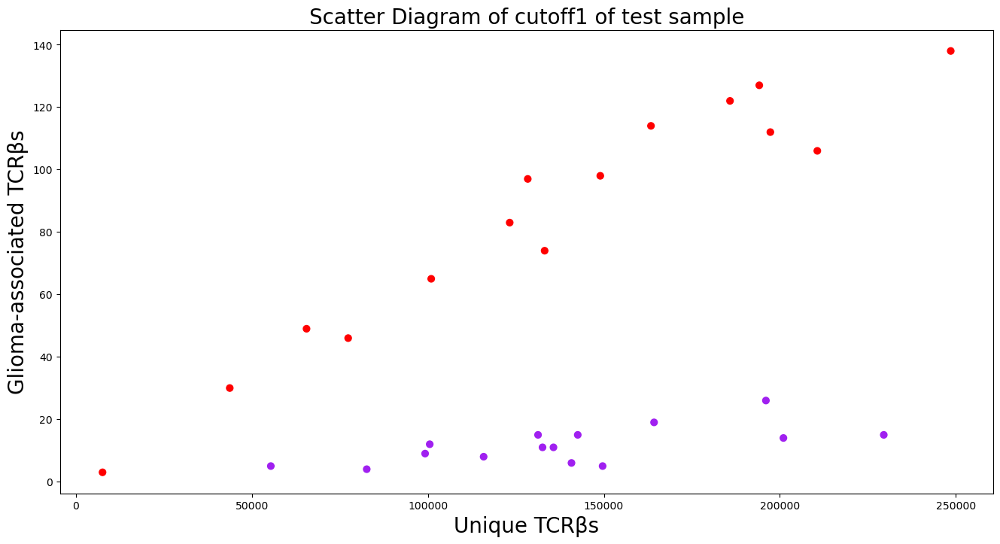

0:	learn: 0.6501965	total: 38.7ms	remaining: 155ms
1:	learn: 0.5986504	total: 39.4ms	remaining: 59.1ms
2:	learn: 0.5675918	total: 41ms	remaining: 27.3ms
3:	learn: 0.5387542	total: 41.4ms	remaining: 10.4ms
4:	learn: 0.5147164	total: 42.3ms	remaining: 0us


C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 4
accuracy 0.8333333333333334


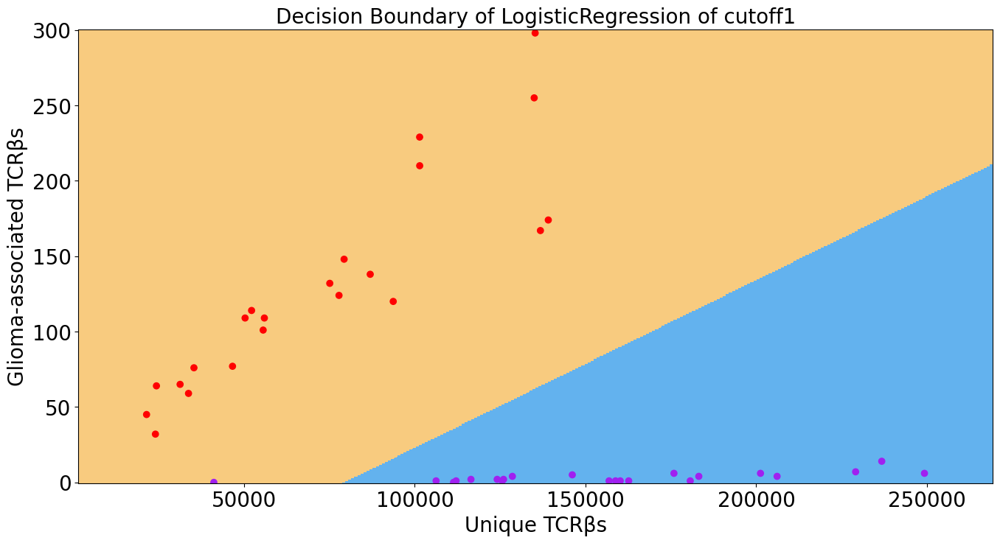

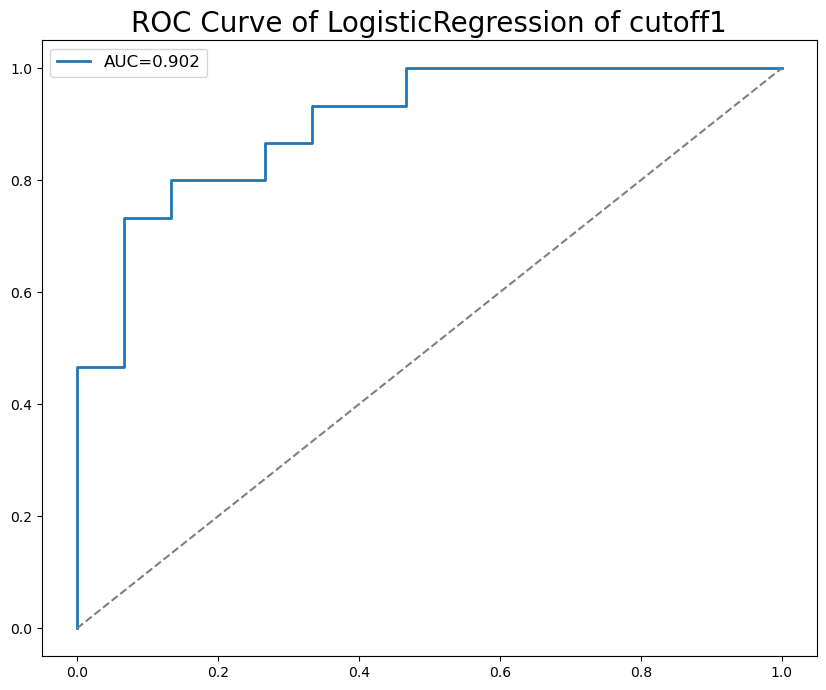

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 4
accuracy 0.9666666666666667


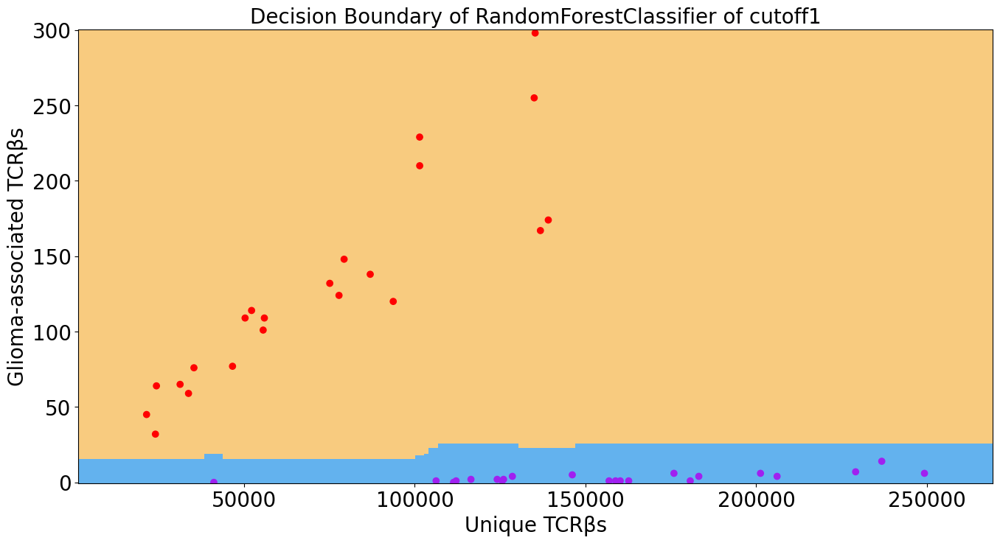

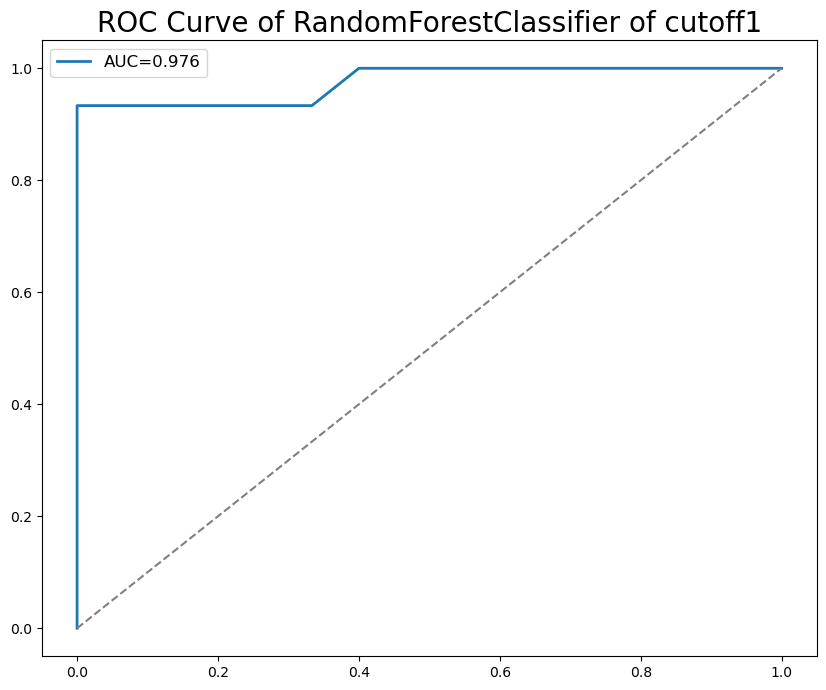

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 4
accuracy 0.8666666666666667


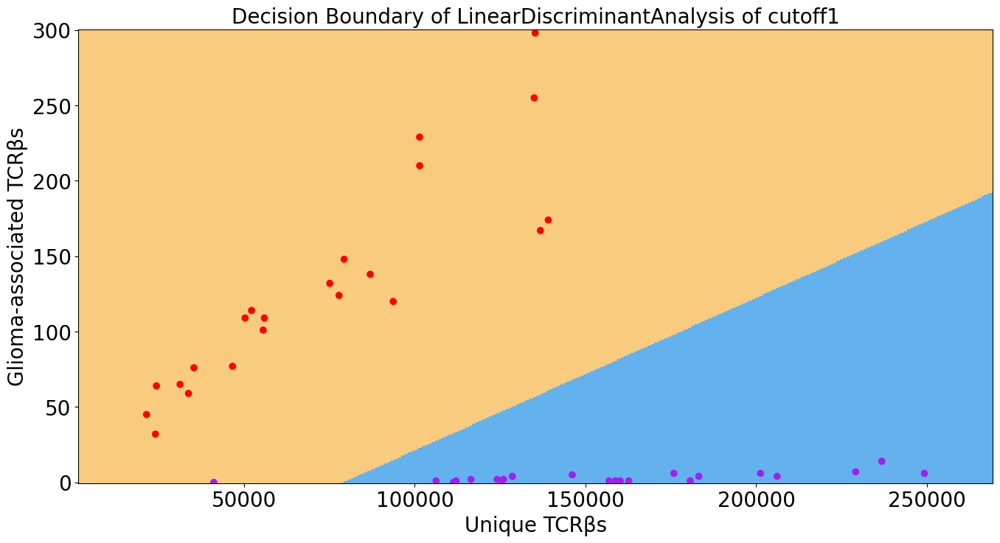

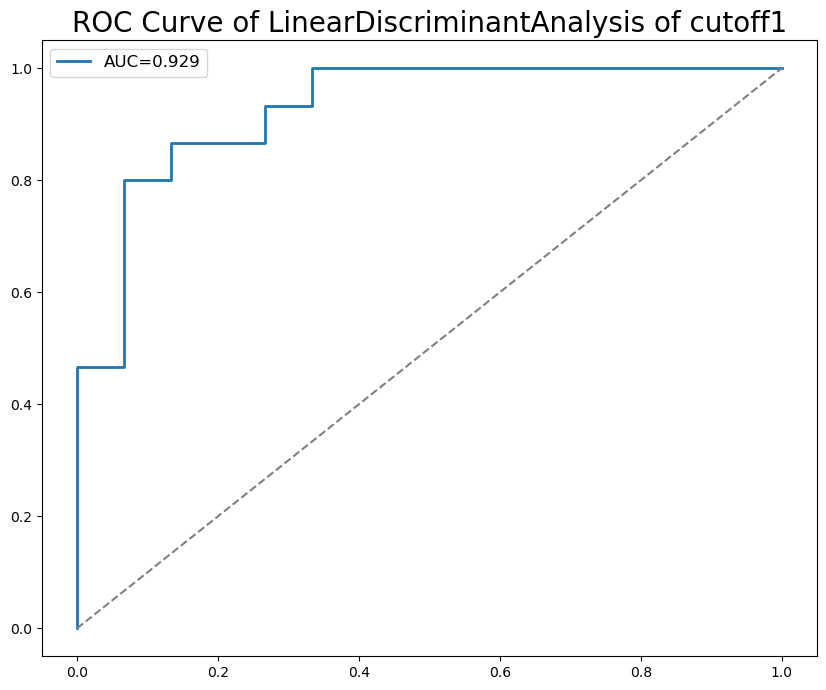

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.9333333333333333


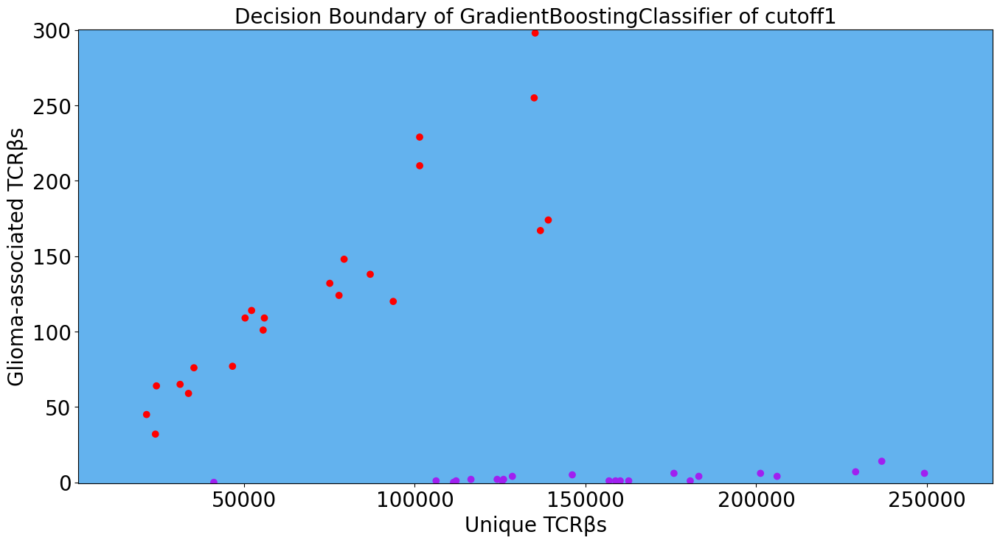

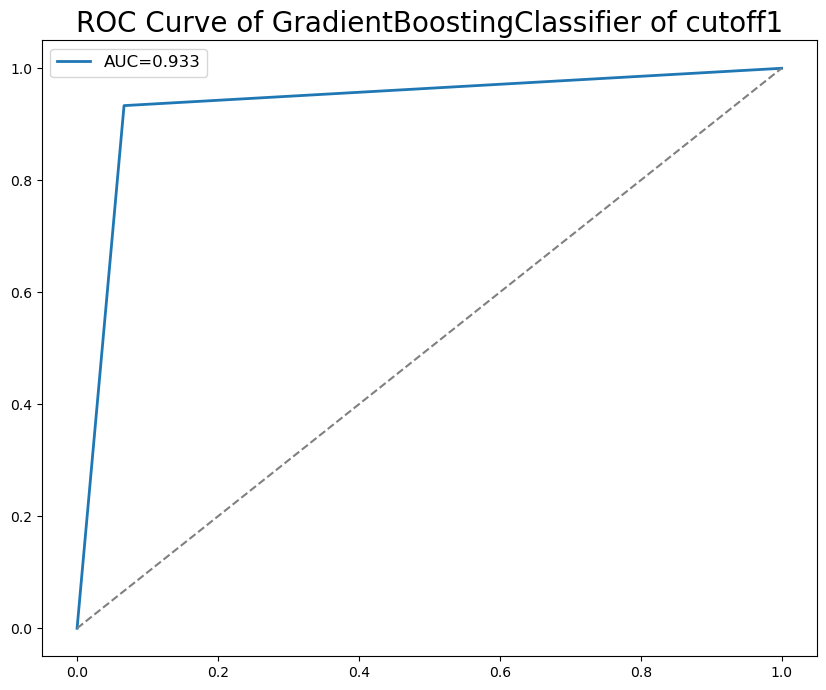

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 4
accuracy 0.8666666666666667


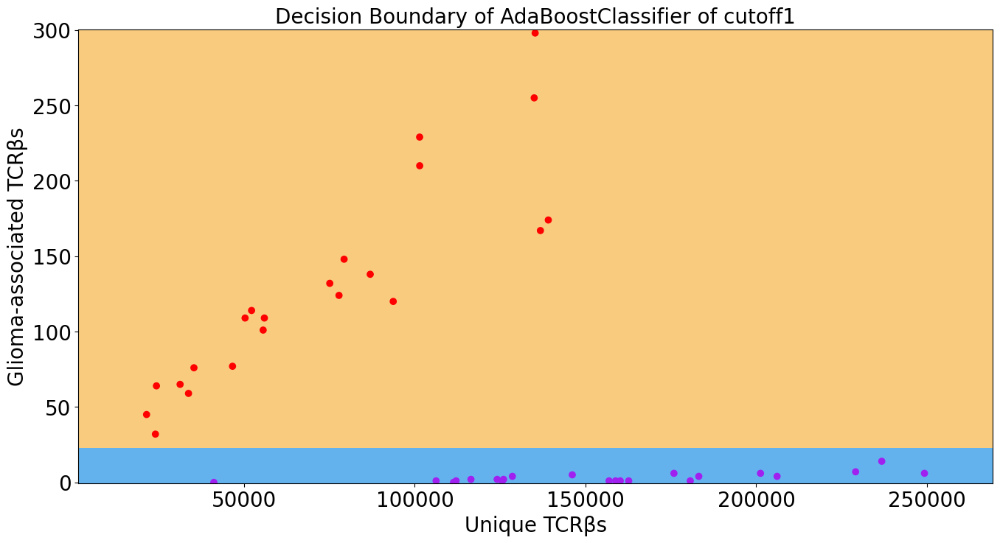

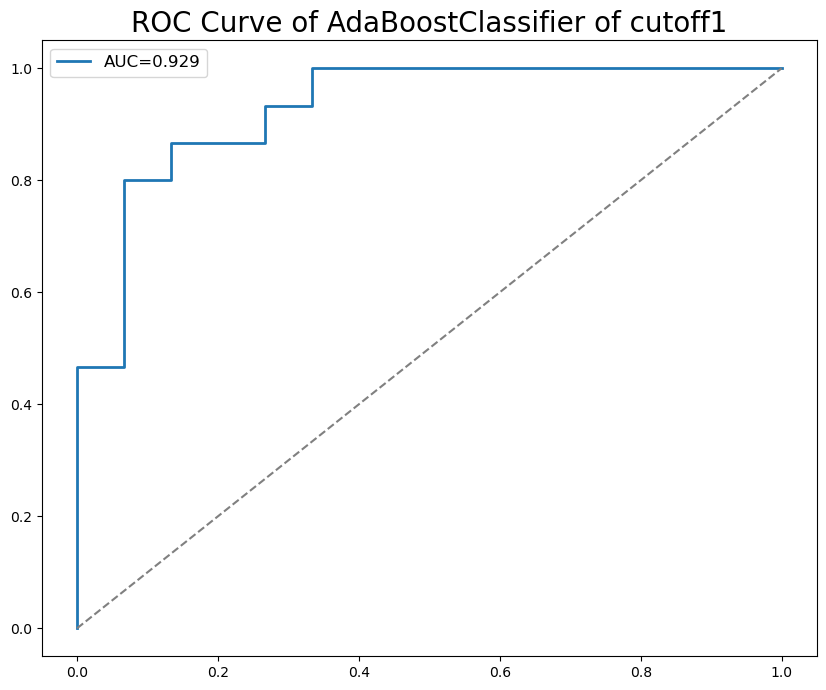

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.9333333333333333


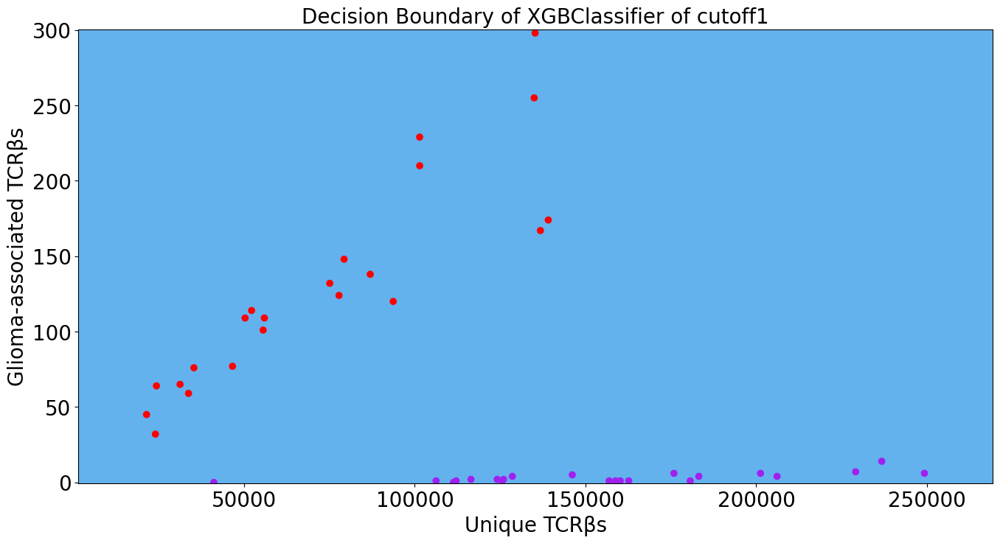

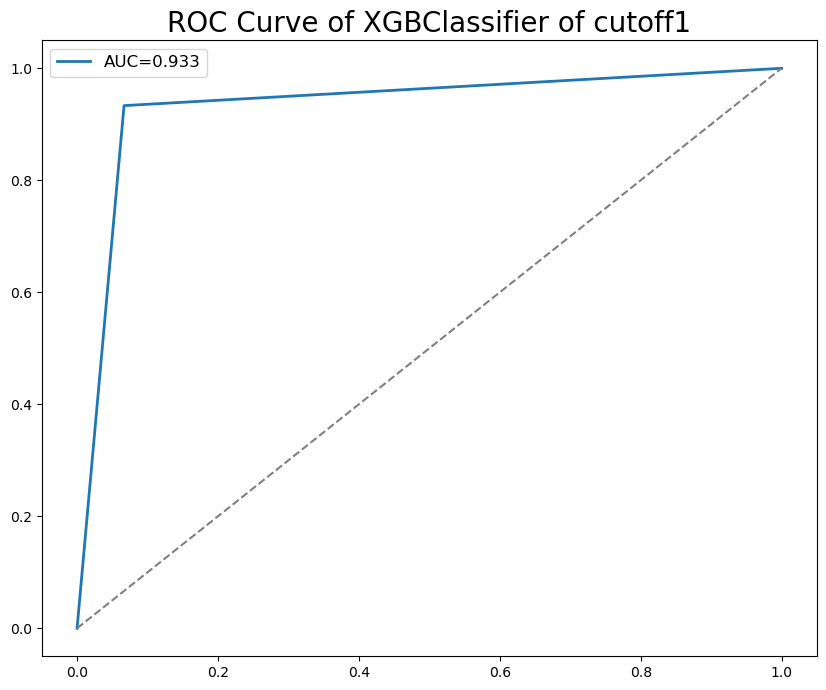

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.9333333333333333


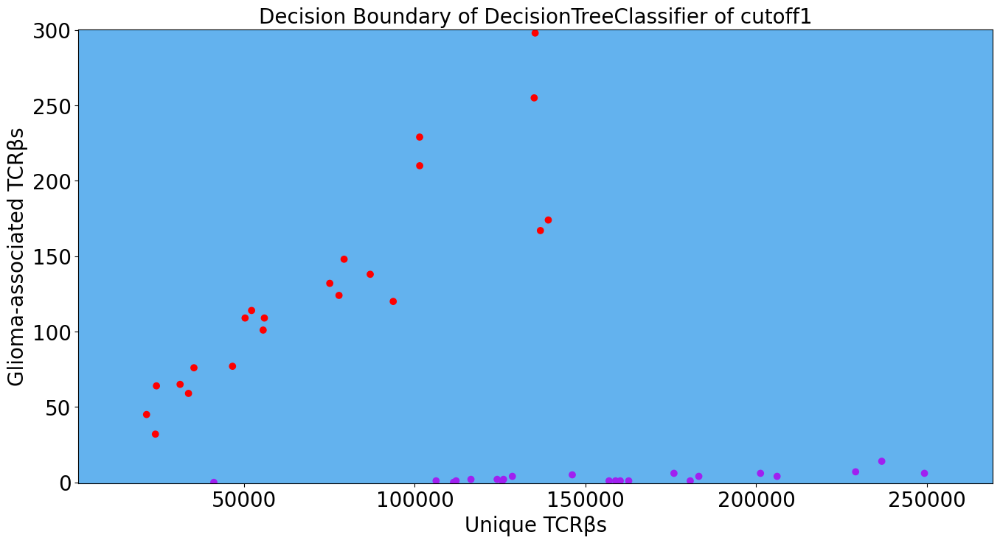

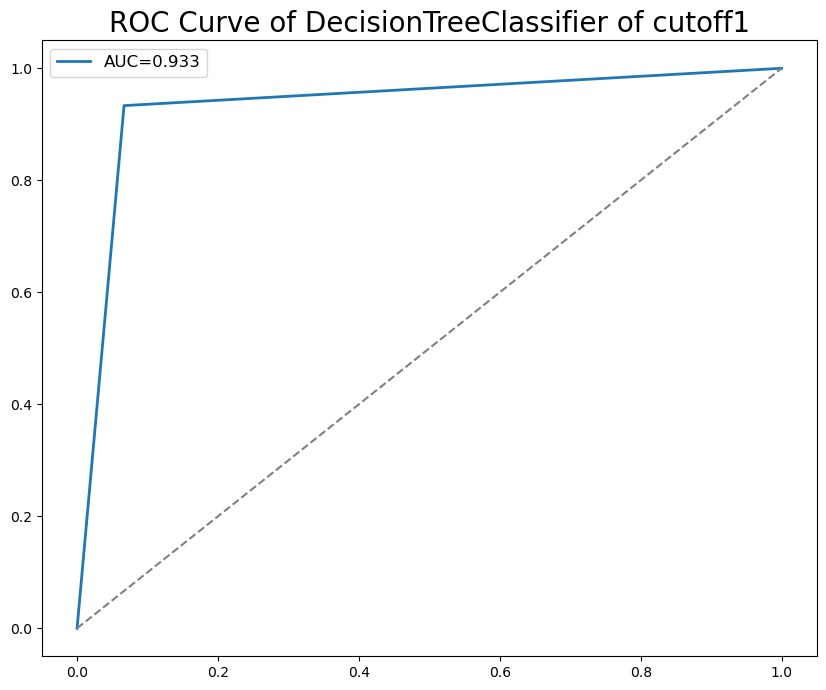

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 2
accuracy 0.9666666666666667


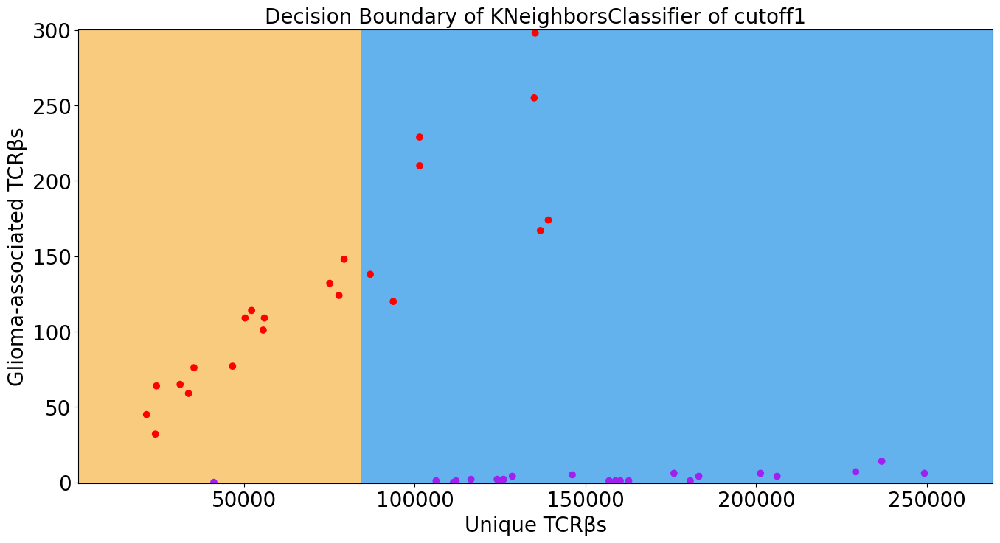

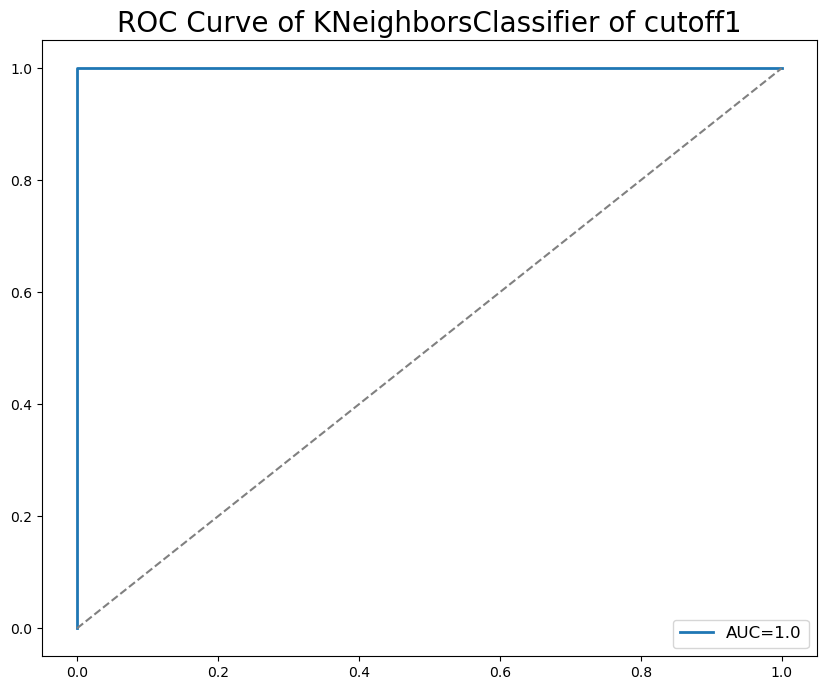

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.9666666666666667


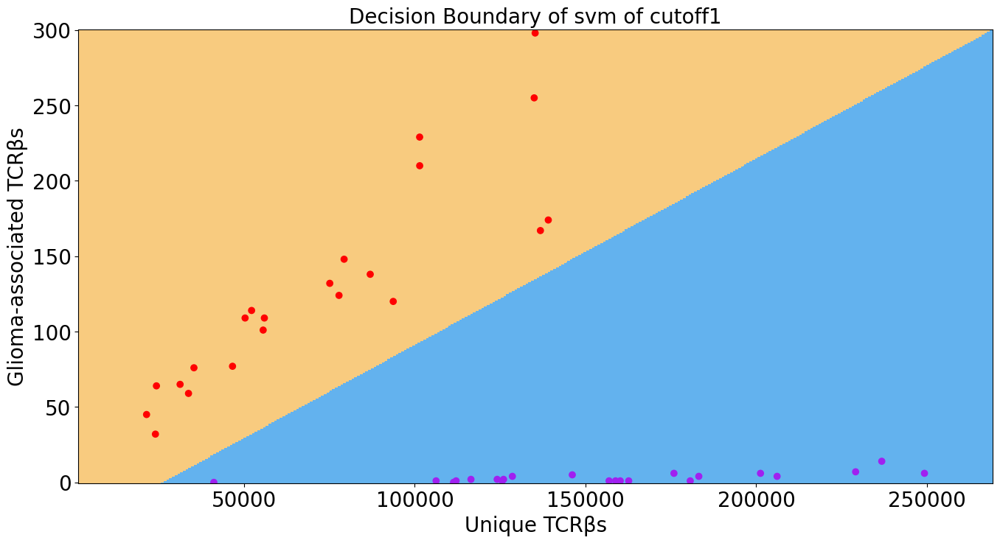

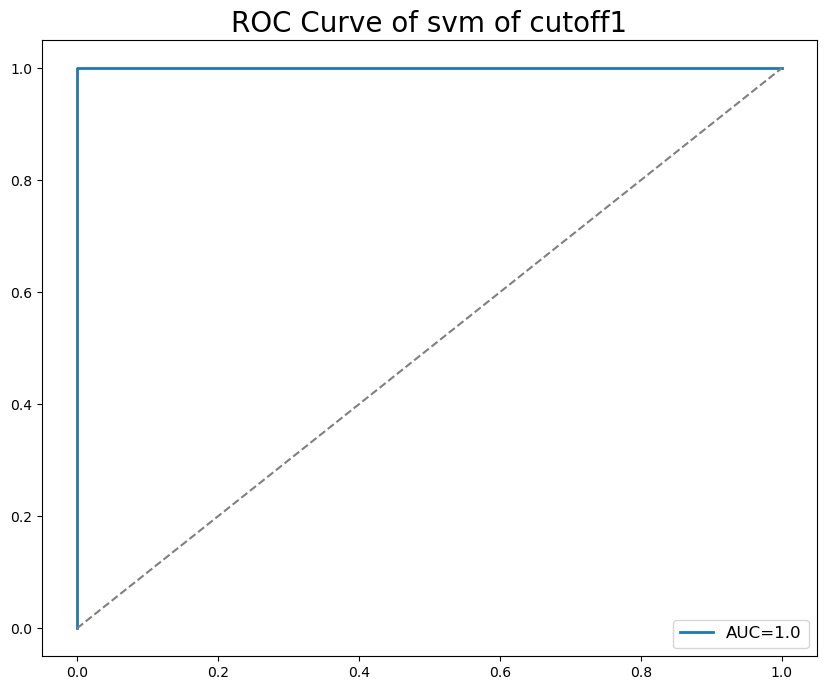

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 4
accuracy 0.9333333333333333


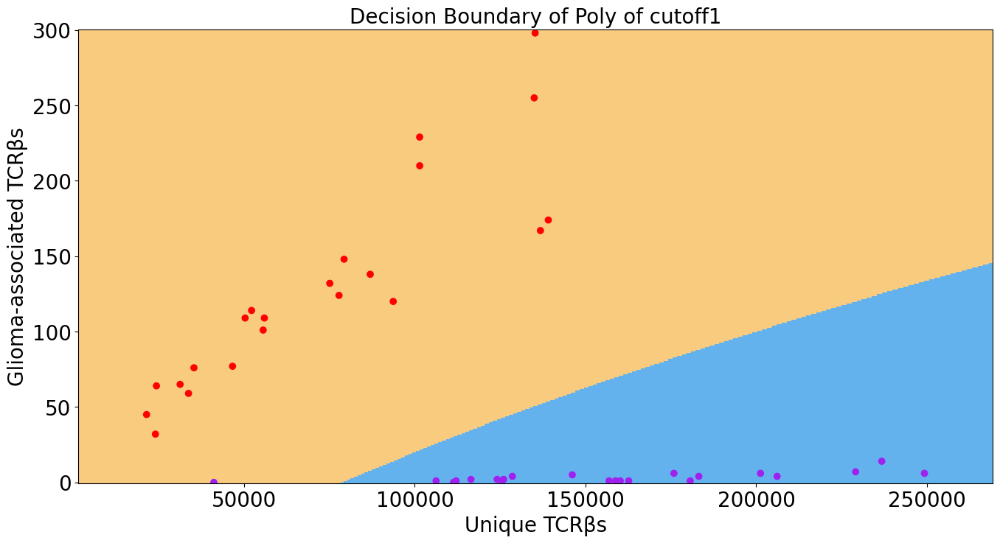

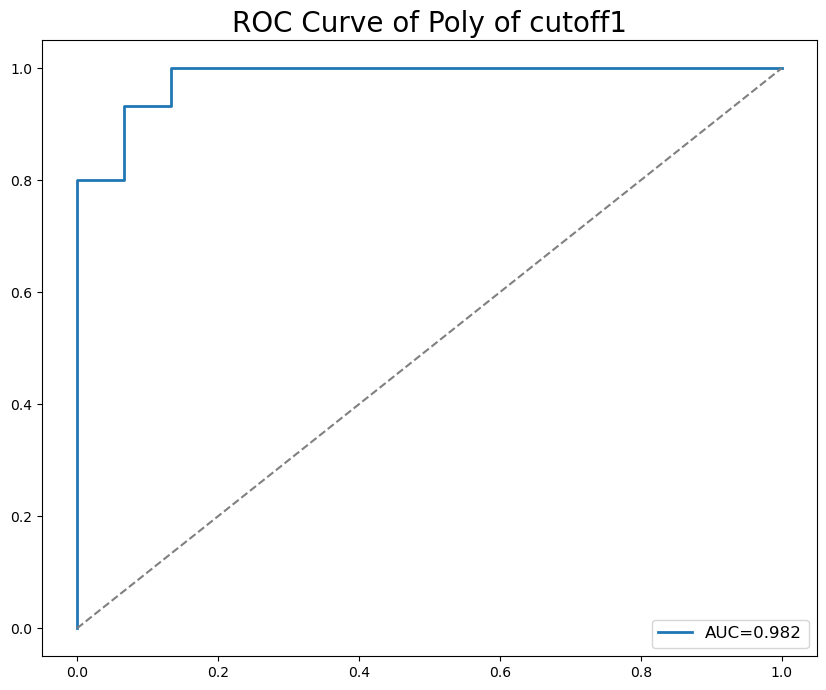

best_index 0
accuracy 0.9333333333333333


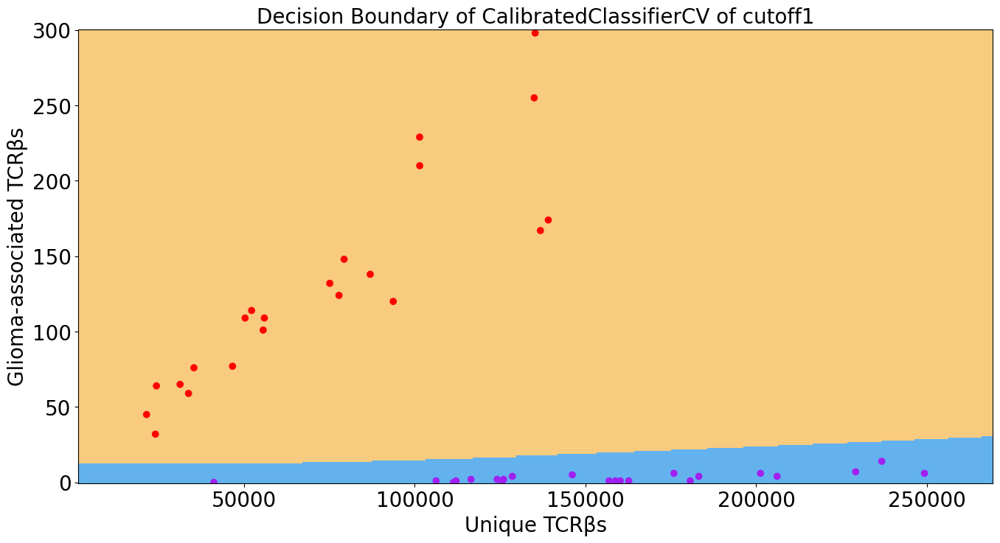

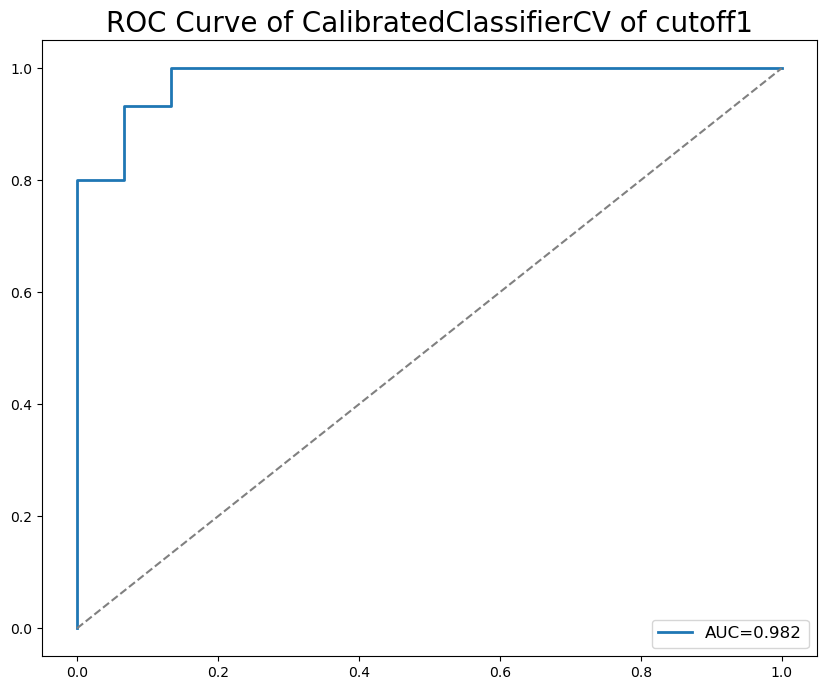

best_index 0
accuracy 0.9


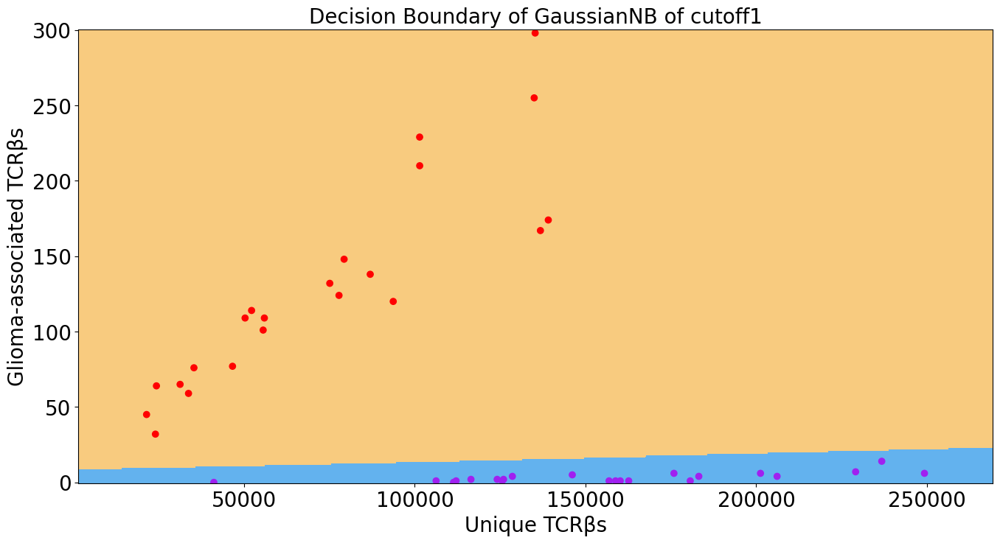

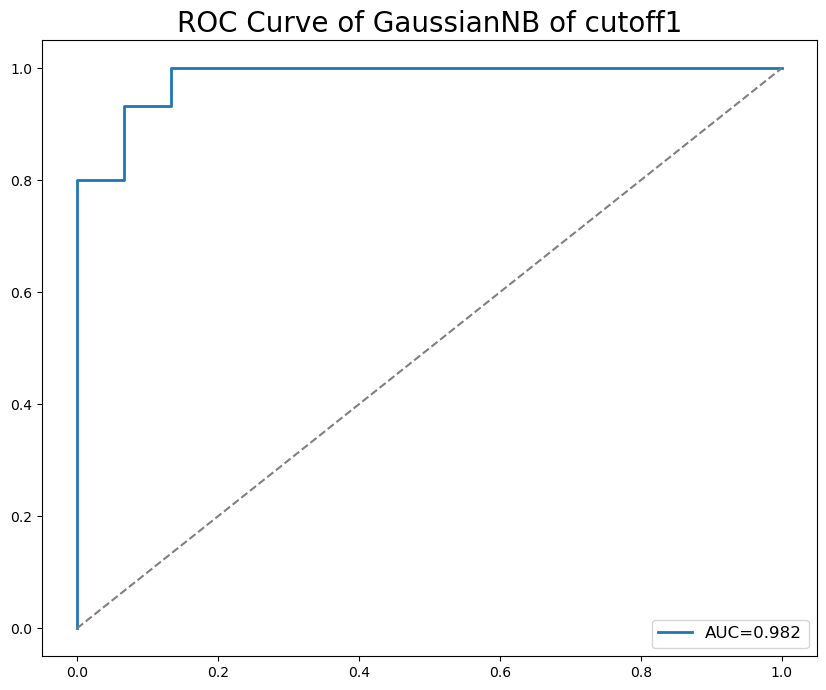

0:	learn: 0.6501965	total: 10.8ms	remaining: 43.3ms
1:	learn: 0.5986504	total: 12ms	remaining: 18ms
2:	learn: 0.5675918	total: 14ms	remaining: 9.33ms
3:	learn: 0.5387542	total: 14.5ms	remaining: 3.61ms
4:	learn: 0.5147164	total: 14.9ms	remaining: 0us


C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.6


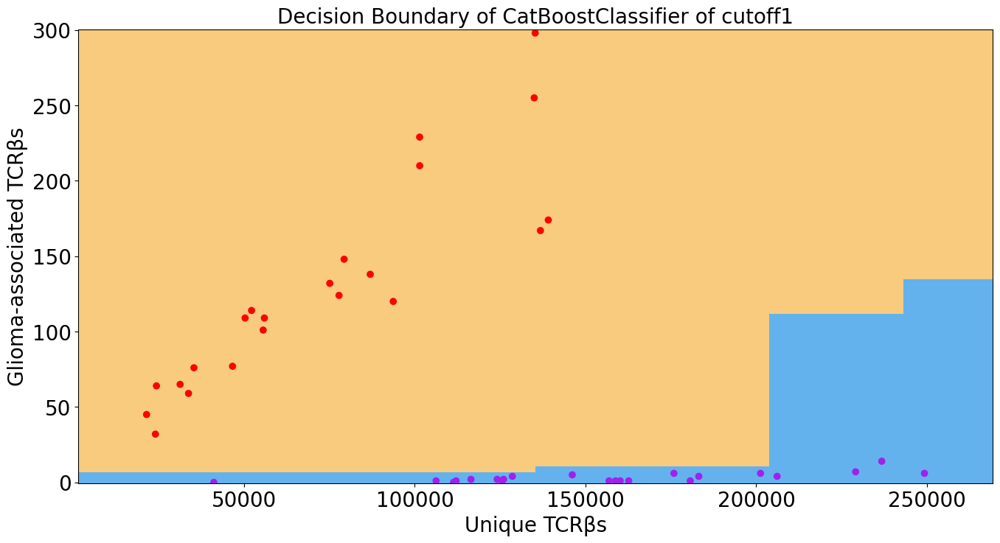

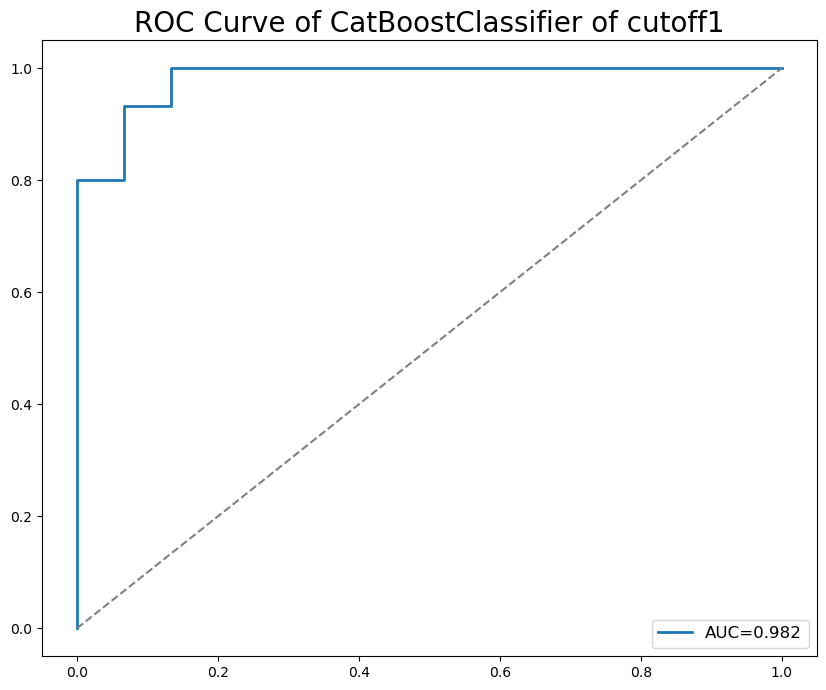

best_index 0
accuracy 0.9333333333333333


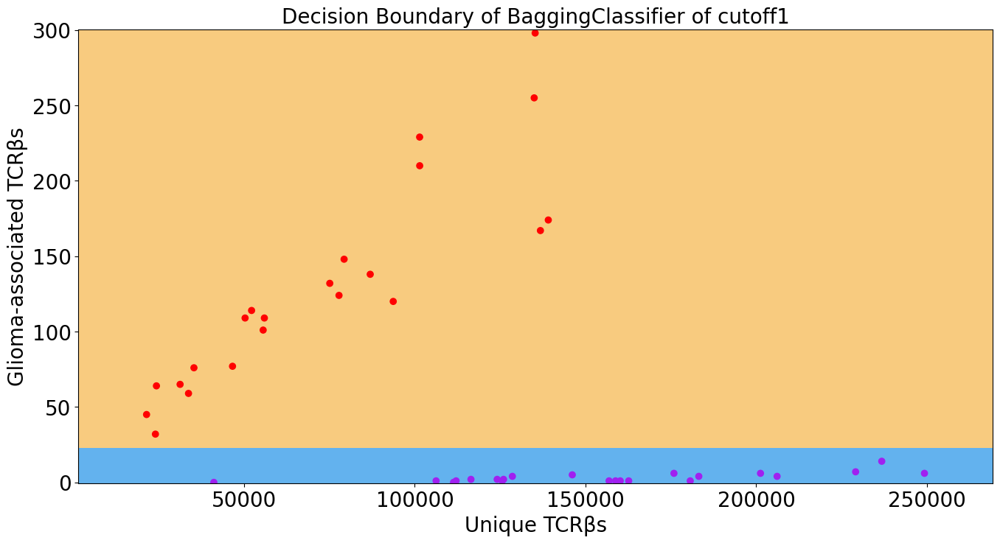

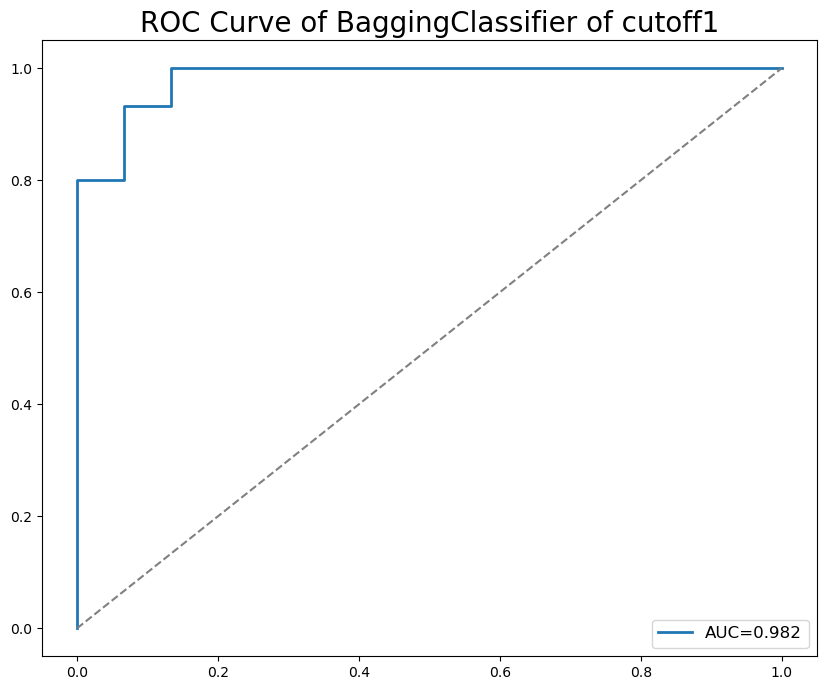

Epoch 1/100
2/2 [==============================] - 2s 452ms/step - loss: 0.7289 - accuracy: 0.5000 - auc_2: 0.3833 - precision_2: 0.5000 - recall_2: 0.5000 - val_loss: 0.7194 - val_accuracy: 0.5000 - val_auc_2: 0.4272 - val_precision_2: 0.5000 - val_recall_2: 0.5000
Epoch 2/100
2/2 [==============================] - 0s 29ms/step - loss: 0.7185 - accuracy: 0.5000 - auc_2: 0.4747 - precision_2: 0.5000 - recall_2: 0.5000 - val_loss: 0.7160 - val_accuracy: 0.5667 - val_auc_2: 0.4561 - val_precision_2: 0.5667 - val_recall_2: 0.5667
Epoch 3/100
2/2 [==============================] - 0s 28ms/step - loss: 0.7083 - accuracy: 0.5909 - auc_2: 0.5429 - precision_2: 0.5909 - recall_2: 0.5909 - val_loss: 0.7129 - val_accuracy: 0.6333 - val_auc_2: 0.4861 - val_precision_2: 0.6333 - val_recall_2: 0.6333
Epoch 4/100
2/2 [==============================] - 0s 23ms/step - loss: 0.6985 - accuracy: 0.6591 - auc_2: 0.6183 - precision_2: 0.6591 - recall_2: 0.6591 - val_loss: 0.7098 - val_accuracy: 0.6667 - va

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:376: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:377: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:376: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:377: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:376: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:377: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\U

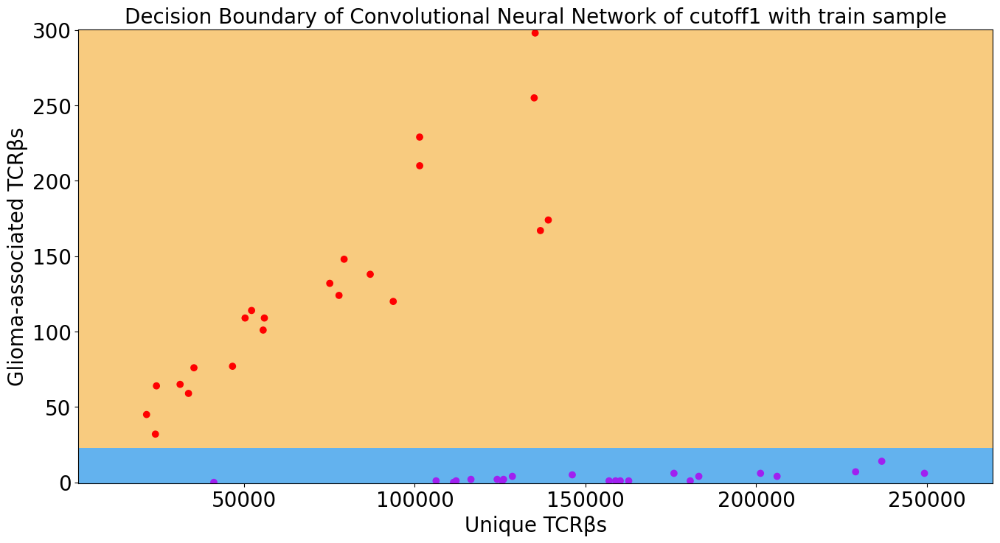

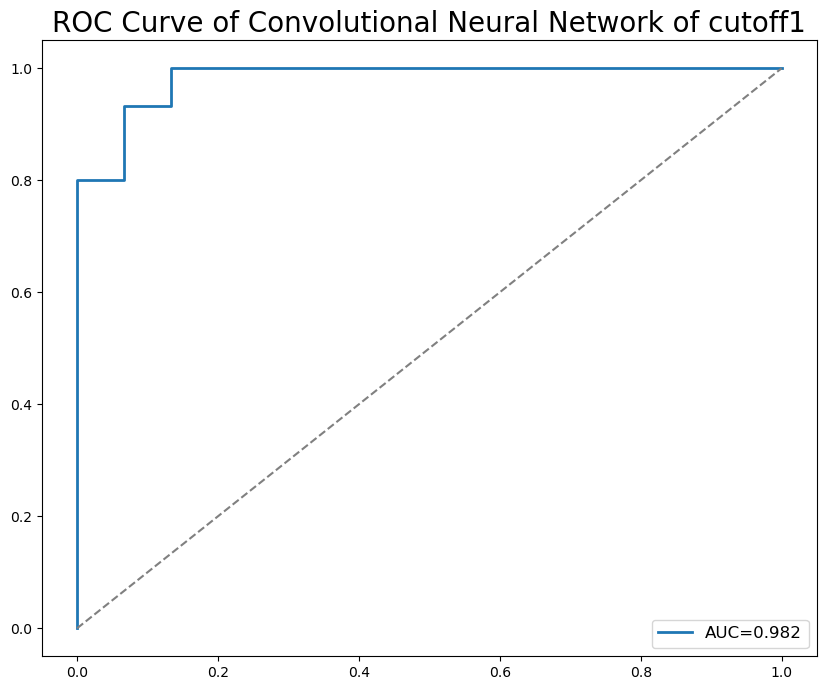

Epoch 1/100
2/2 [==============================] - 1s 425ms/step - loss: 0.6628 - accuracy: 0.6591 - auc_3: 0.7495 - precision_3: 0.6591 - recall_3: 0.6591 - val_loss: 0.6177 - val_accuracy: 0.8667 - val_auc_3: 0.9228 - val_precision_3: 0.8667 - val_recall_3: 0.8667
Epoch 2/100
2/2 [==============================] - 0s 35ms/step - loss: 0.4789 - accuracy: 0.9773 - auc_3: 0.9716 - precision_3: 0.9773 - recall_3: 0.9773 - val_loss: 0.5366 - val_accuracy: 0.8333 - val_auc_3: 0.9056 - val_precision_3: 0.8333 - val_recall_3: 0.8333
Epoch 3/100
2/2 [==============================] - 0s 30ms/step - loss: 0.2902 - accuracy: 0.9773 - auc_3: 0.9923 - precision_3: 0.9773 - recall_3: 0.9773 - val_loss: 0.4628 - val_accuracy: 0.8333 - val_auc_3: 0.8950 - val_precision_3: 0.8333 - val_recall_3: 0.8333
Epoch 4/100
2/2 [==============================] - 0s 32ms/step - loss: 0.1432 - accuracy: 0.9773 - auc_3: 0.9995 - precision_3: 0.9773 - recall_3: 0.9773 - val_loss: 0.4411 - val_accuracy: 0.8000 - va

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:463: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:464: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:463: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:464: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


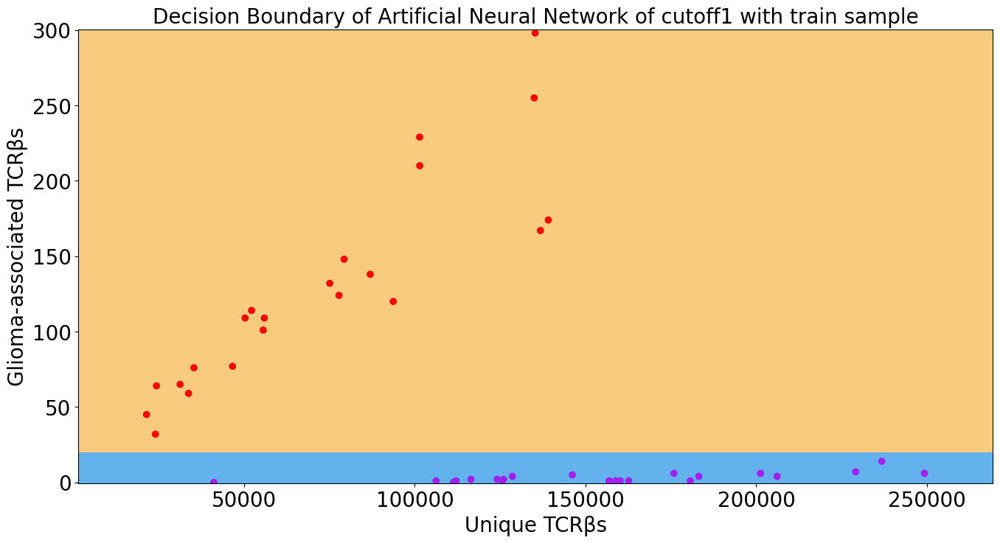

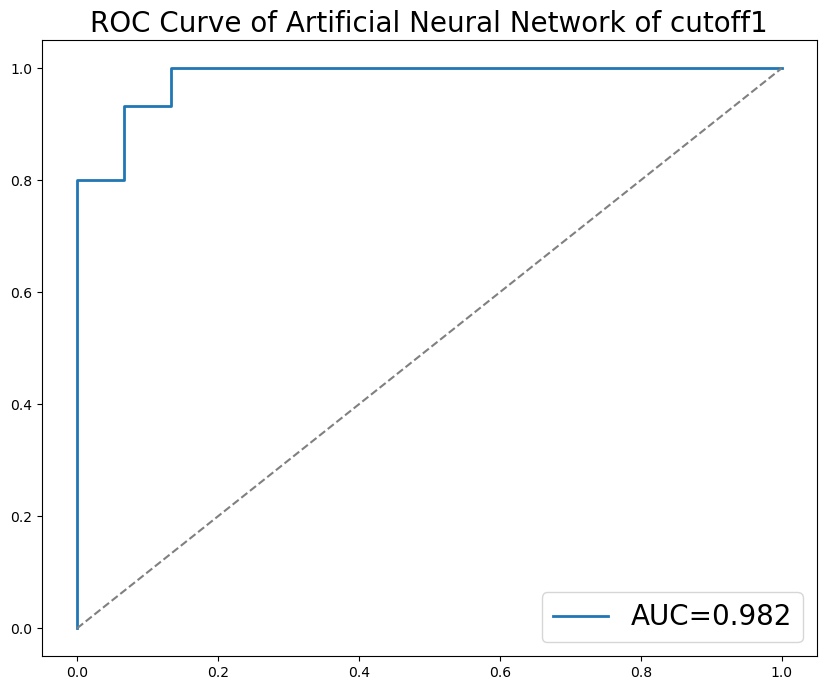

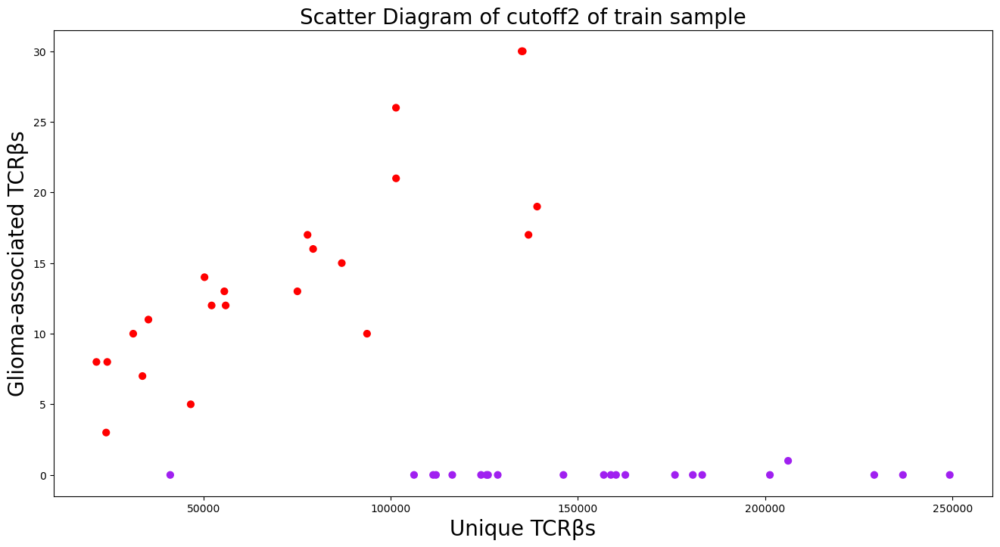

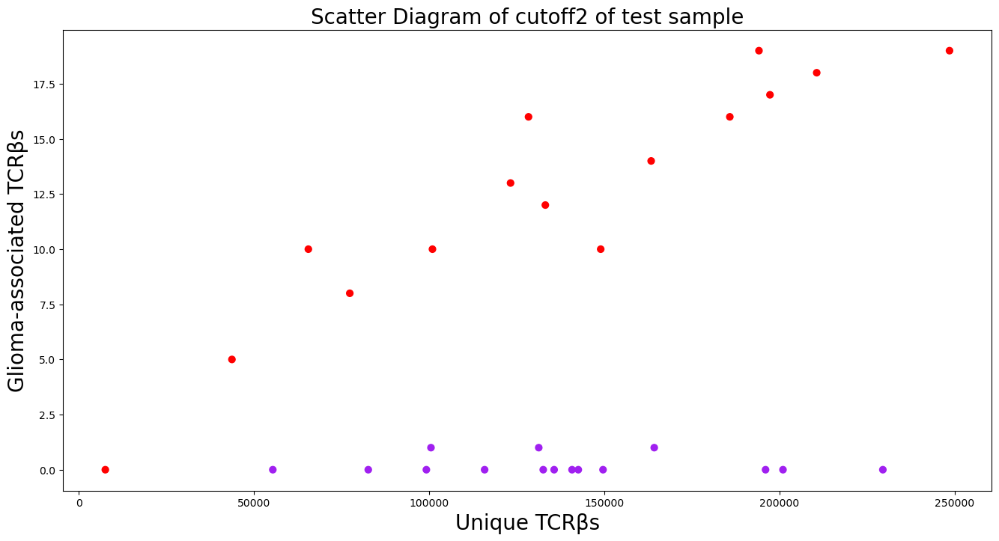

0:	learn: 0.6520231	total: 18.6ms	remaining: 74.4ms
1:	learn: 0.6213429	total: 19.7ms	remaining: 29.5ms
2:	learn: 0.5825414	total: 19.9ms	remaining: 13.3ms
3:	learn: 0.5530418	total: 20.2ms	remaining: 5.05ms
4:	learn: 0.5259937	total: 20.5ms	remaining: 0us


C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.9666666666666667


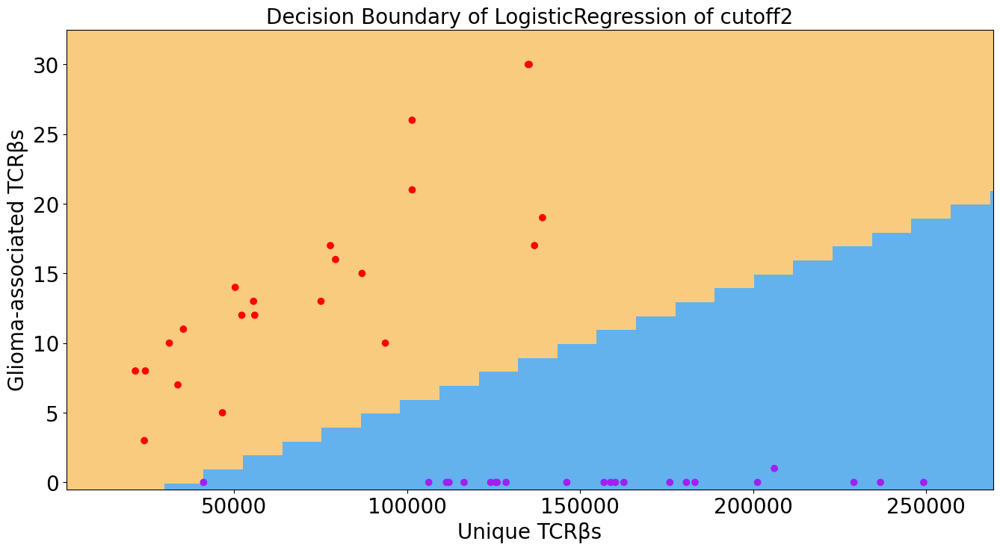

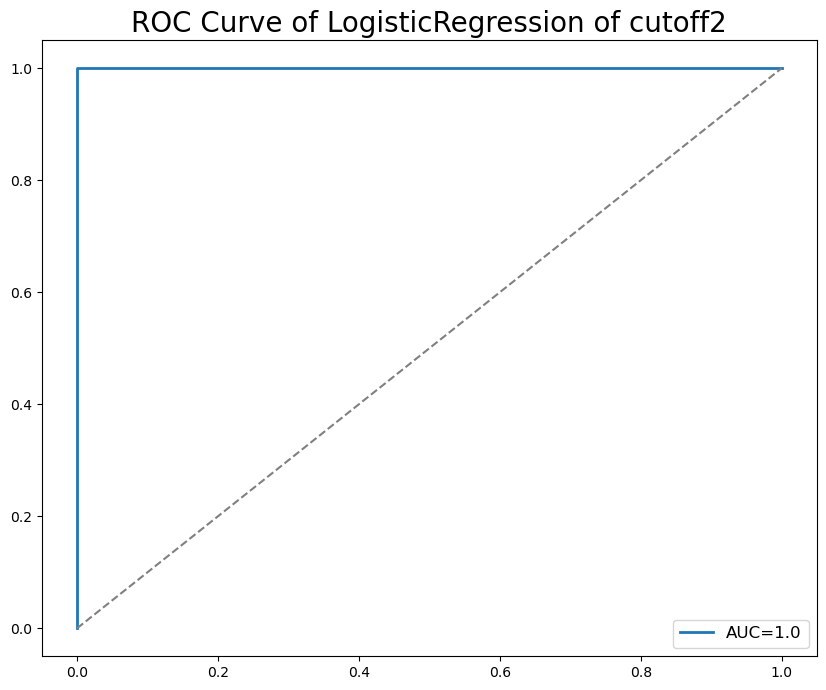

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 3
accuracy 0.9666666666666667


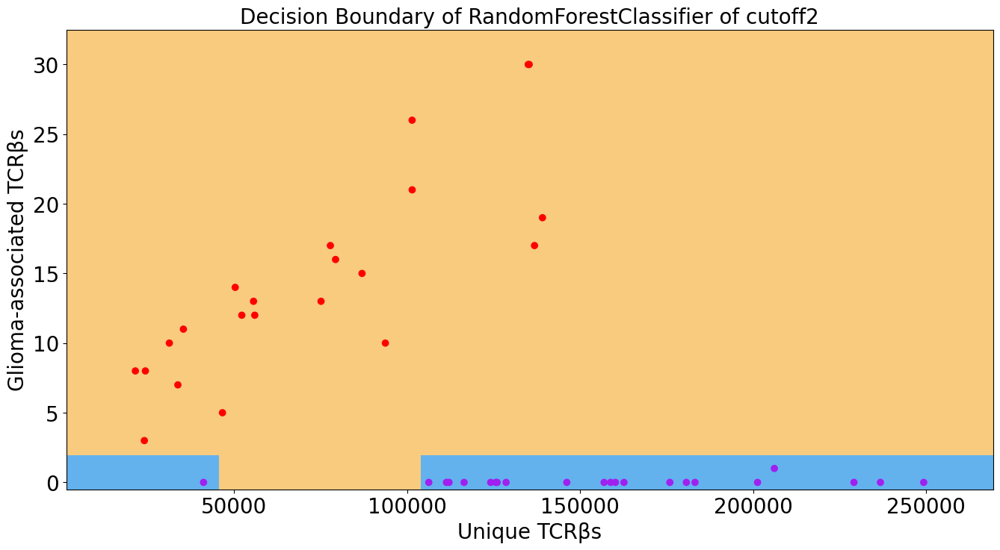

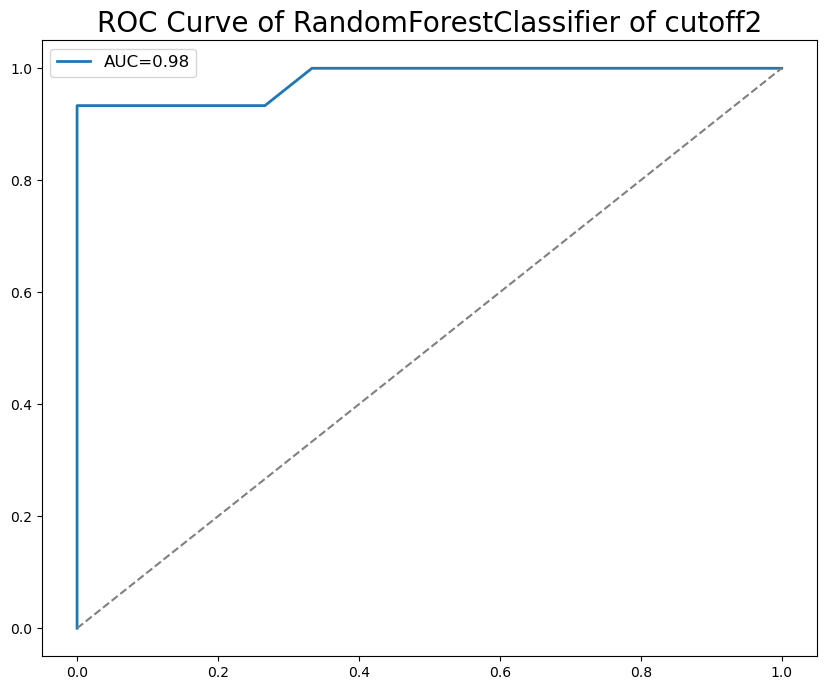

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 2
accuracy 0.9666666666666667


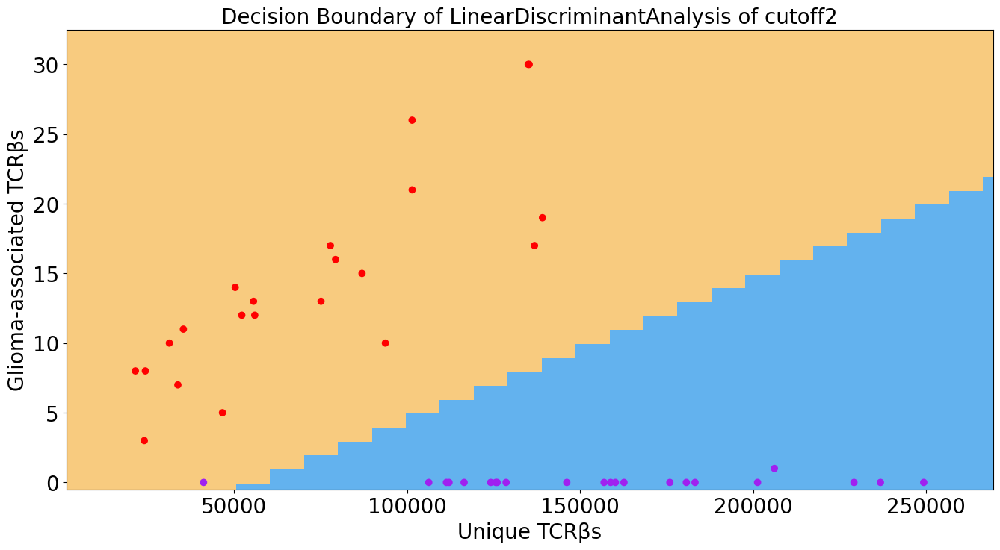

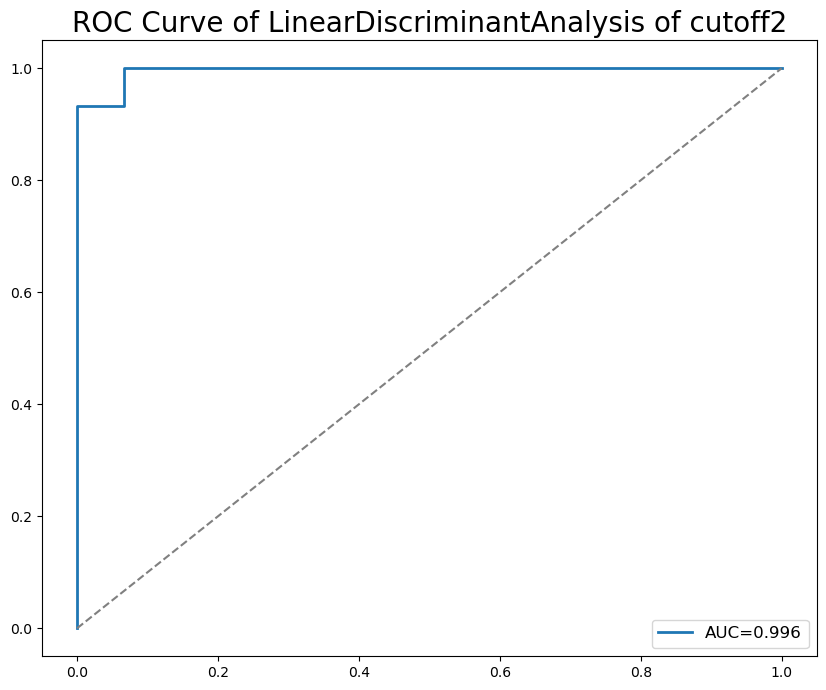

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.9666666666666667


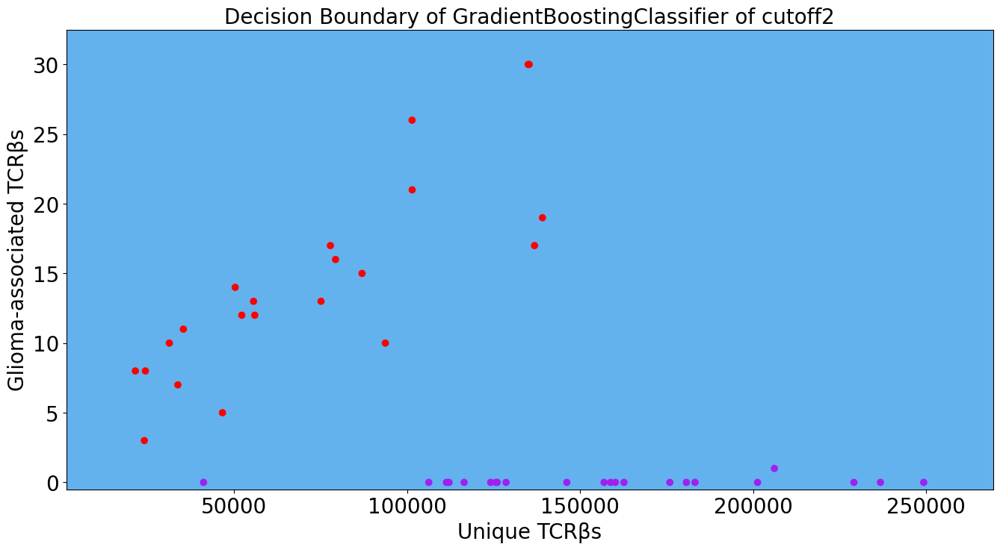

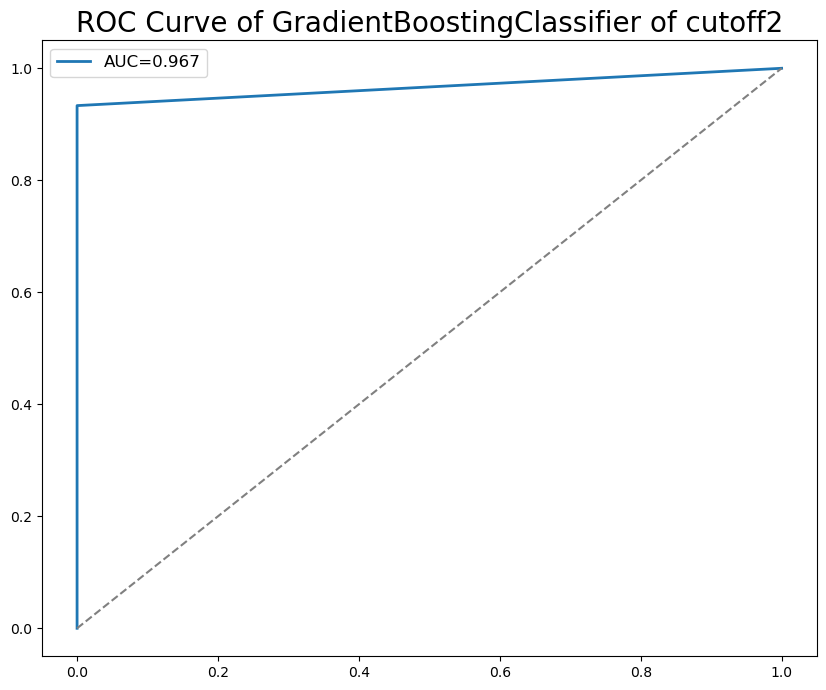

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 2
accuracy 0.9666666666666667


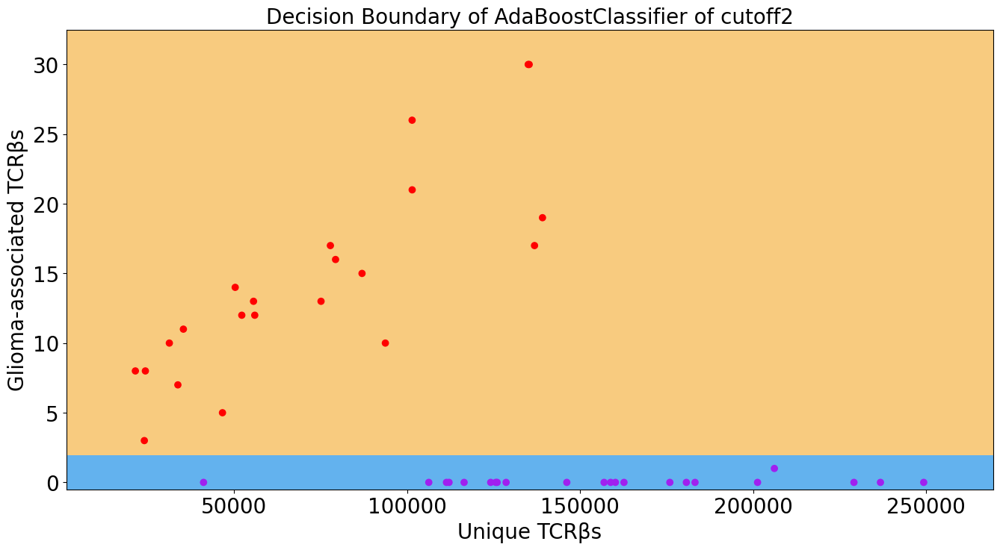

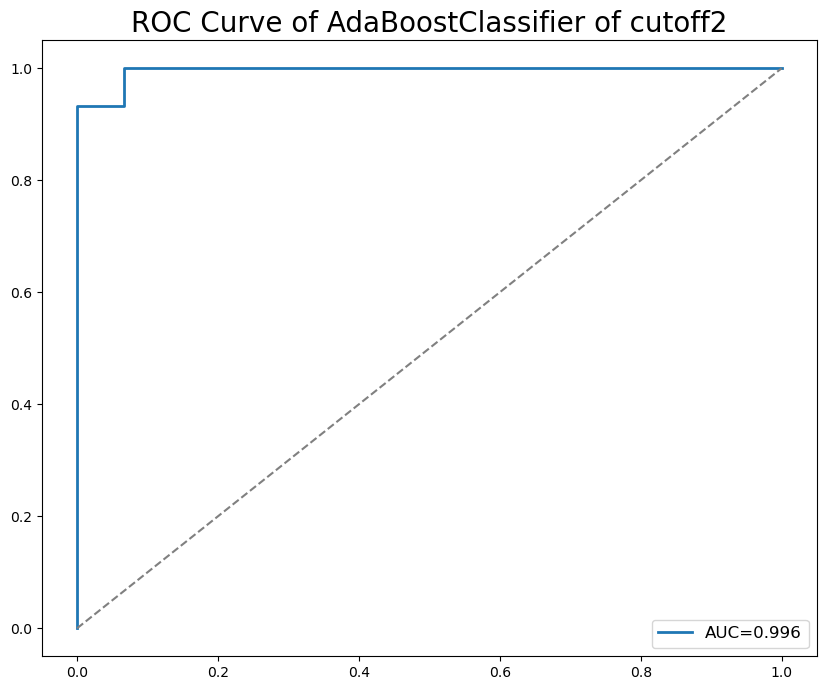

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.9666666666666667


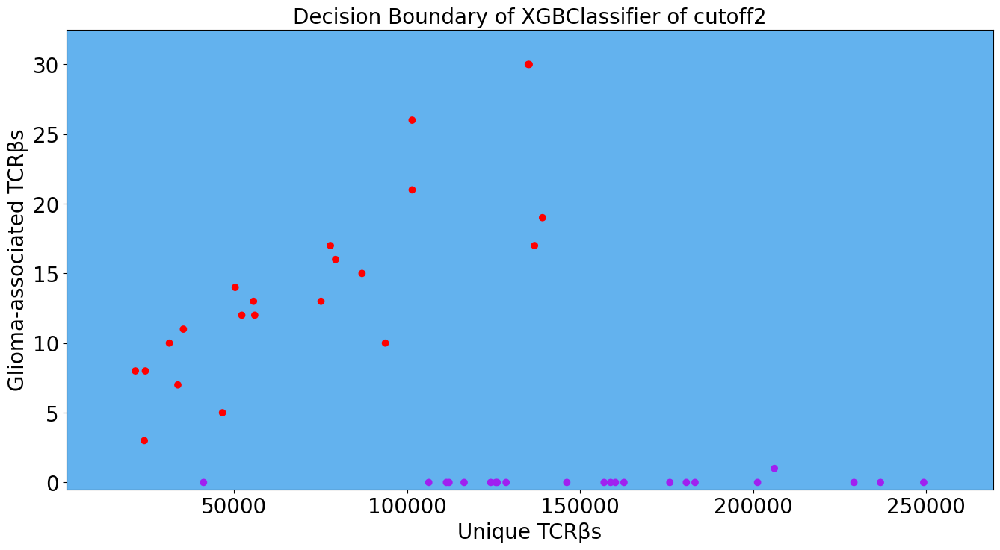

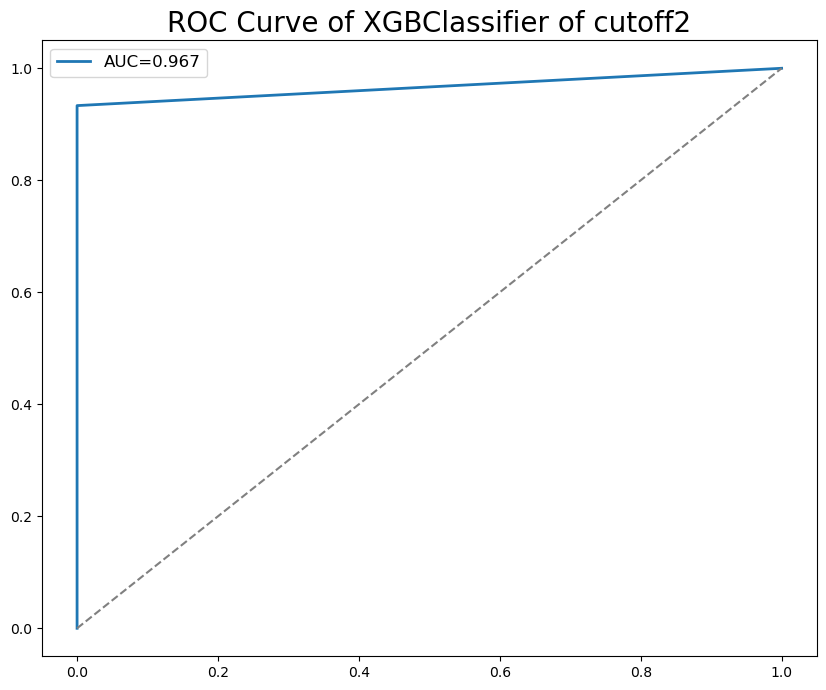

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.9666666666666667


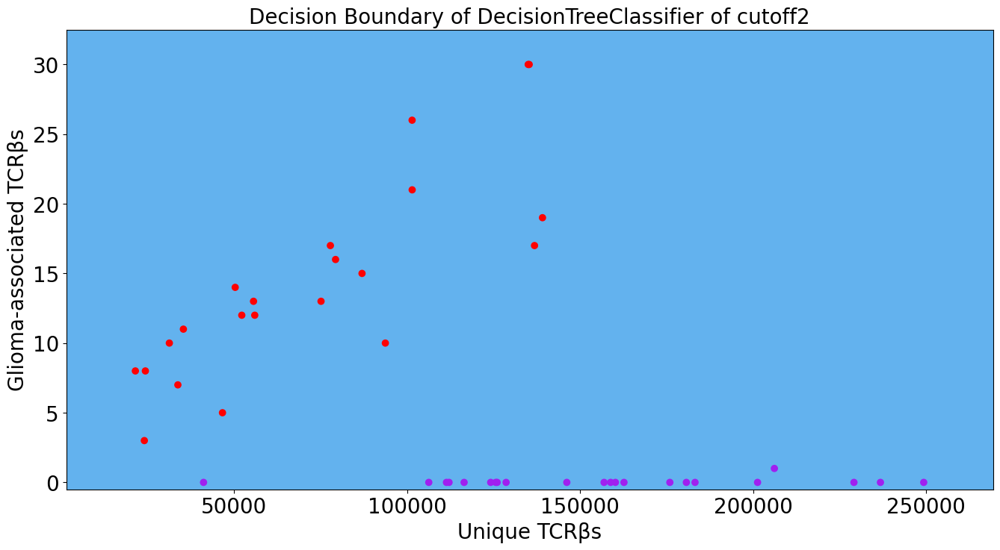

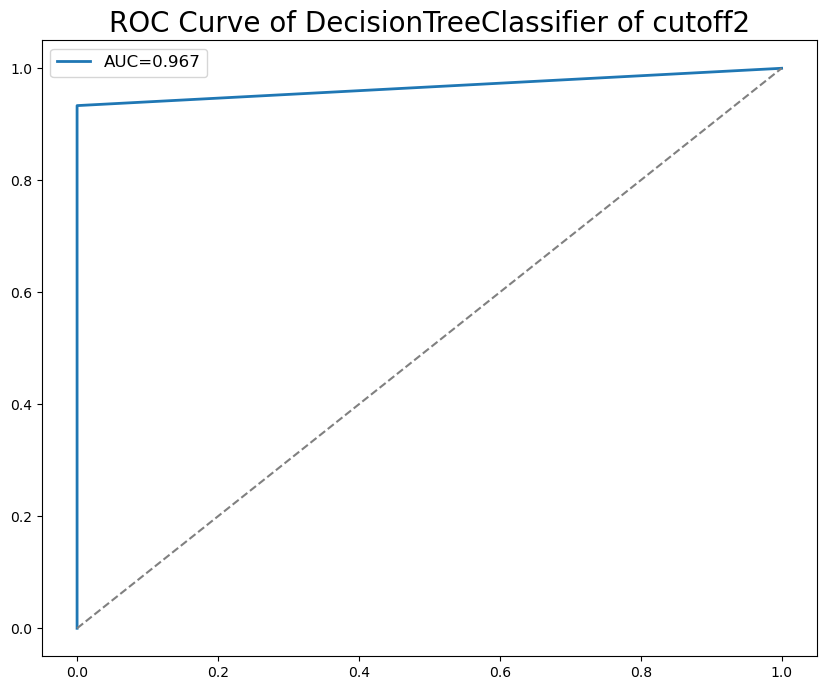

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 2
accuracy 0.9666666666666667


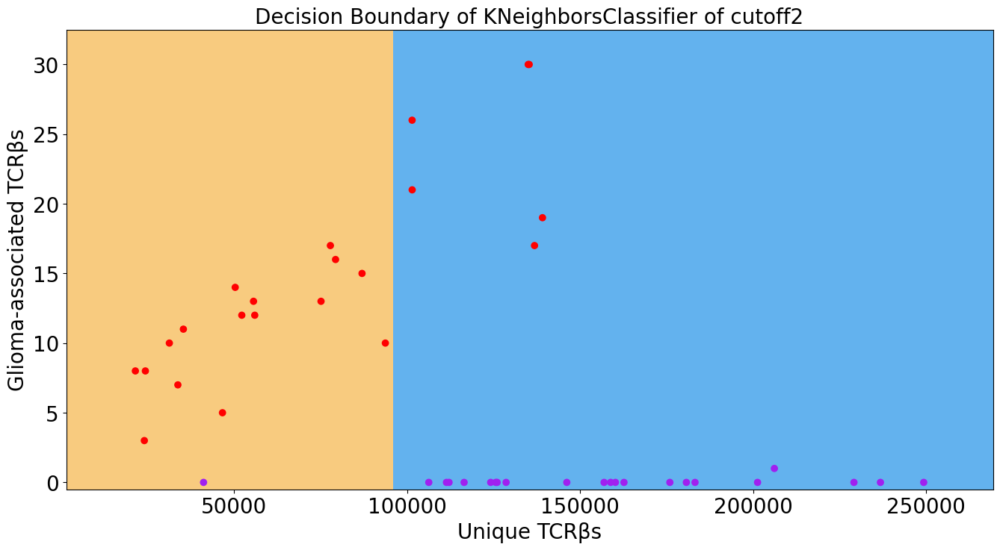

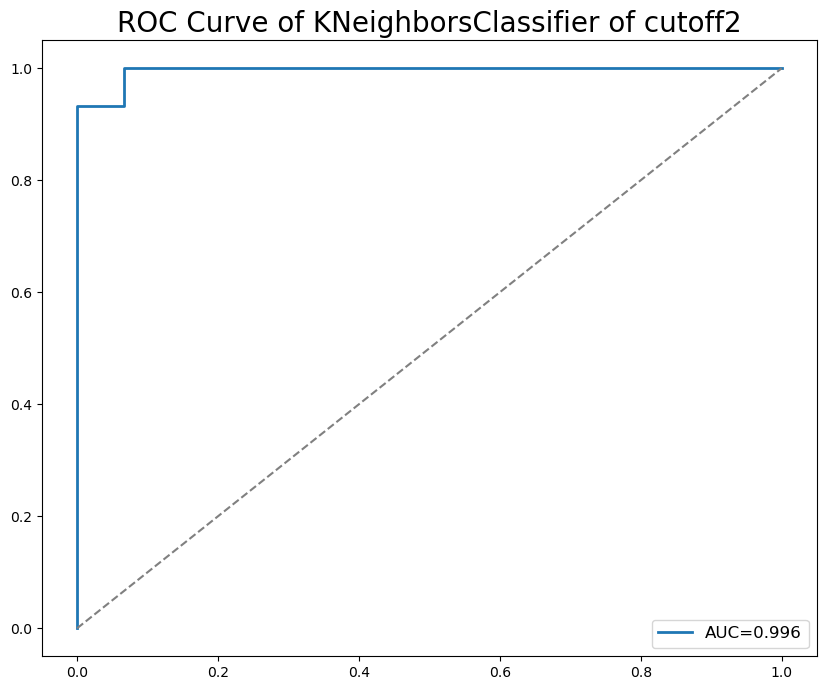

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.9666666666666667


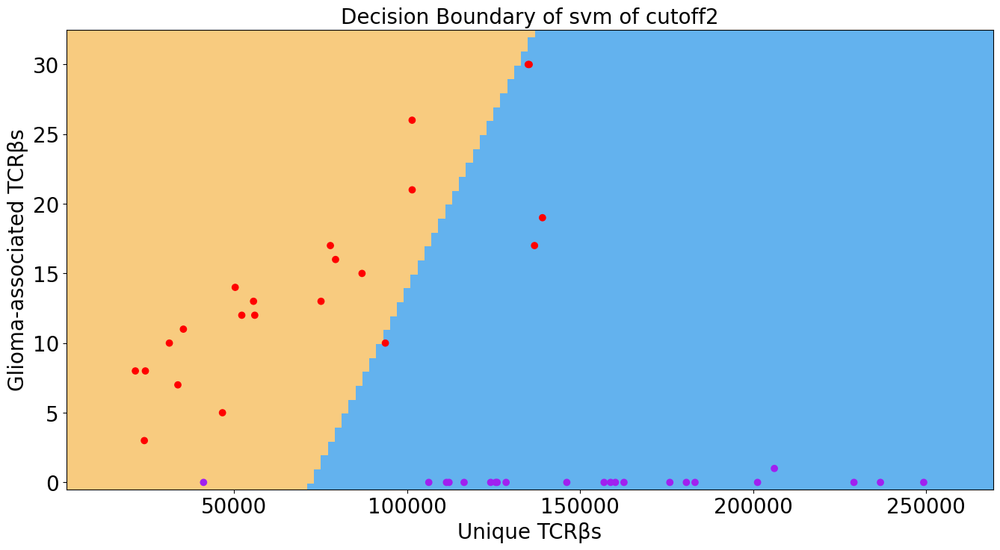

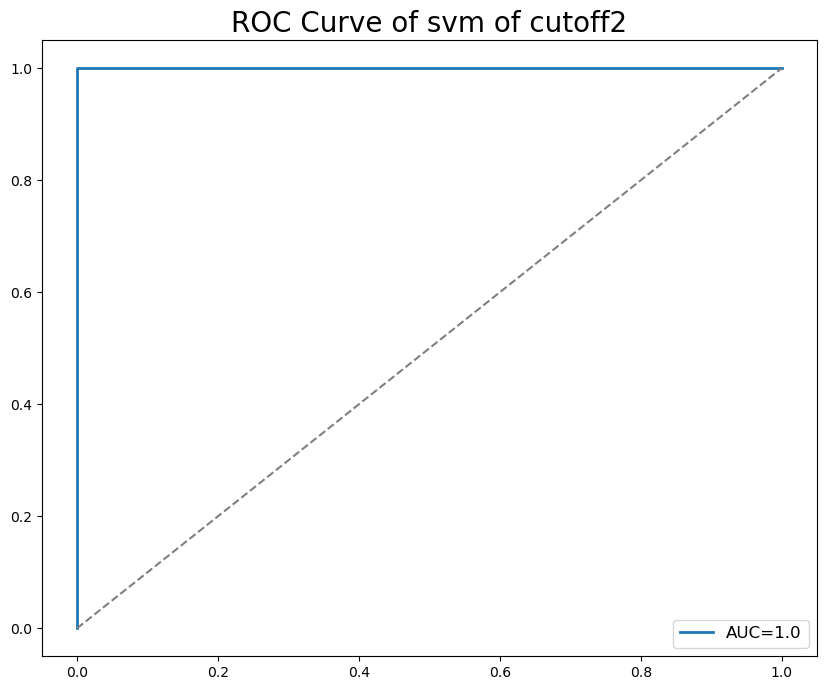

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.9666666666666667


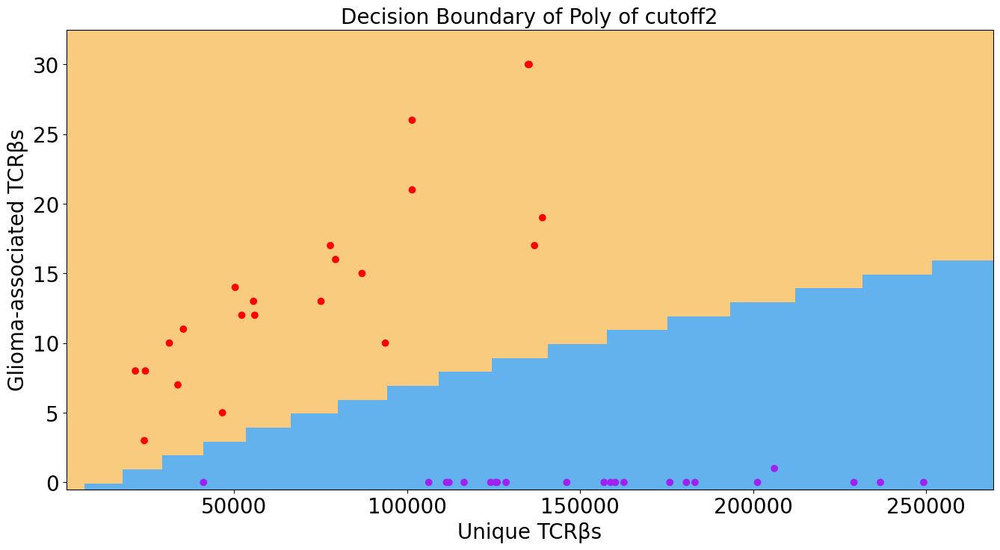

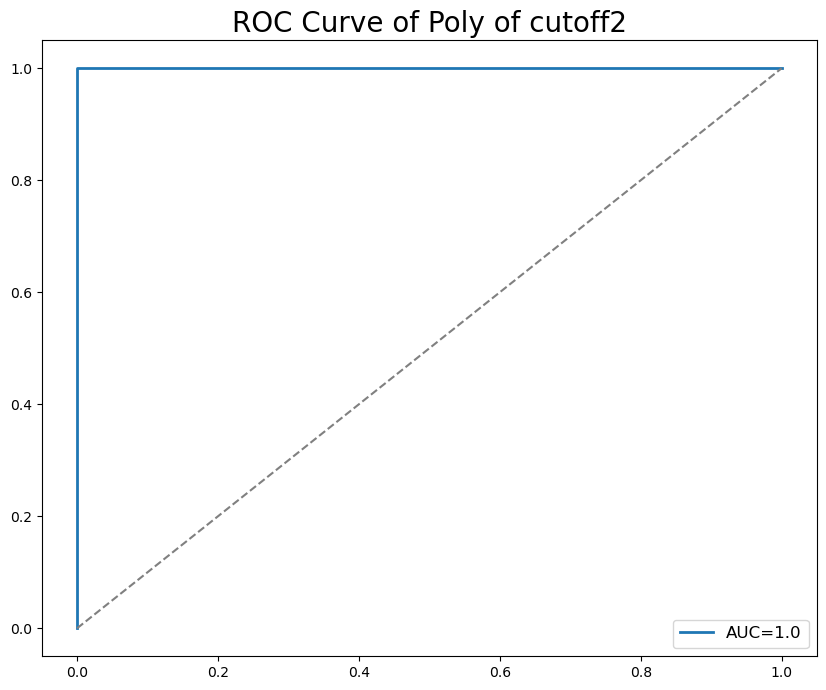

best_index 0
accuracy 0.9666666666666667


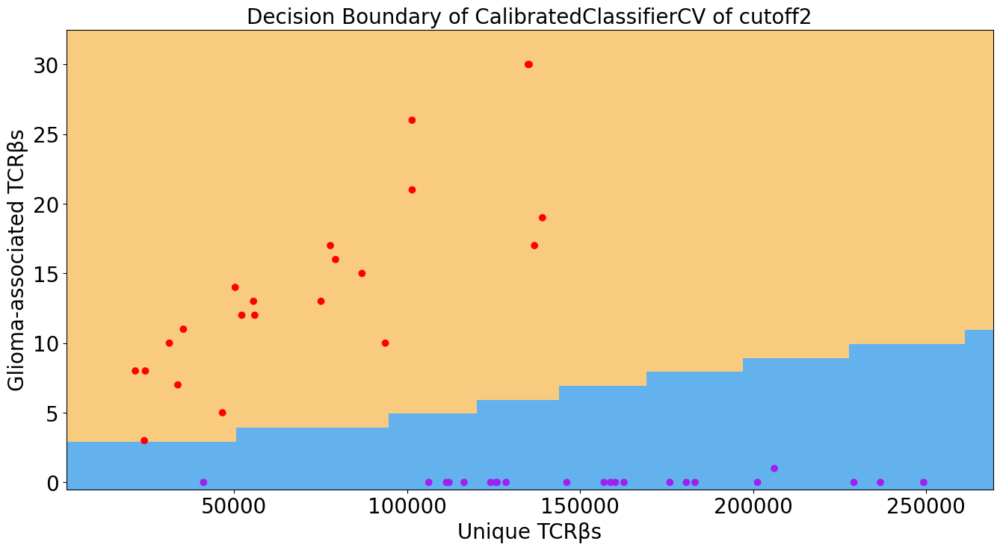

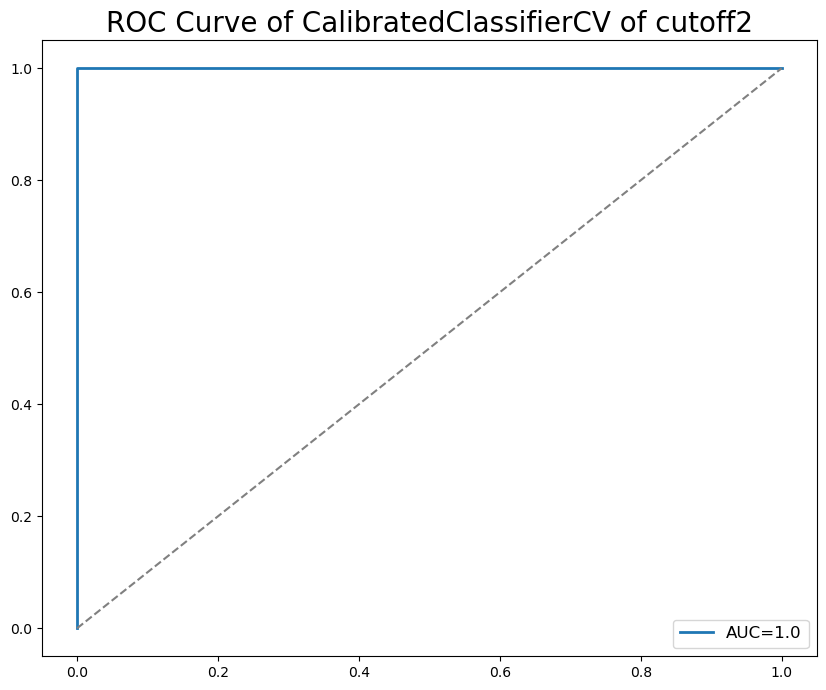

best_index 1
accuracy 1.0


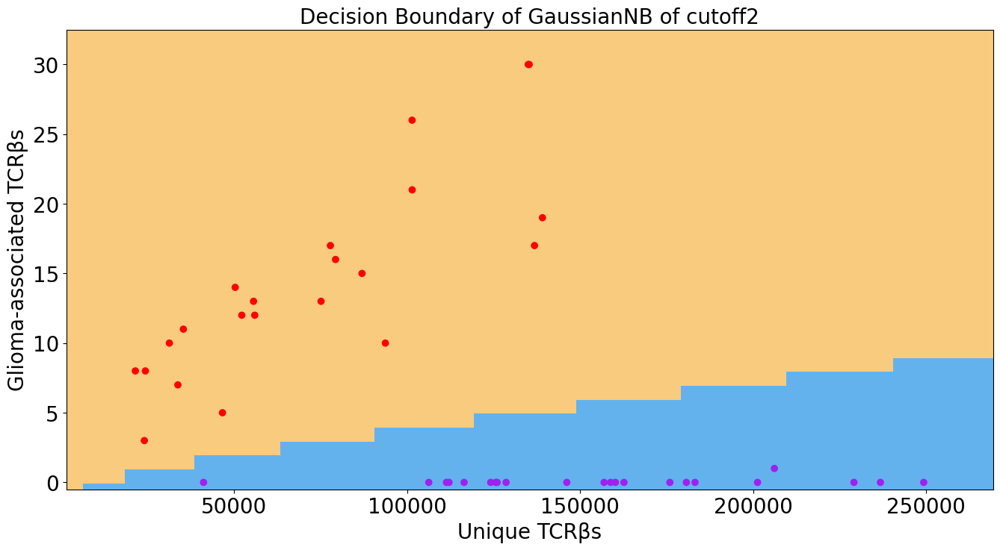

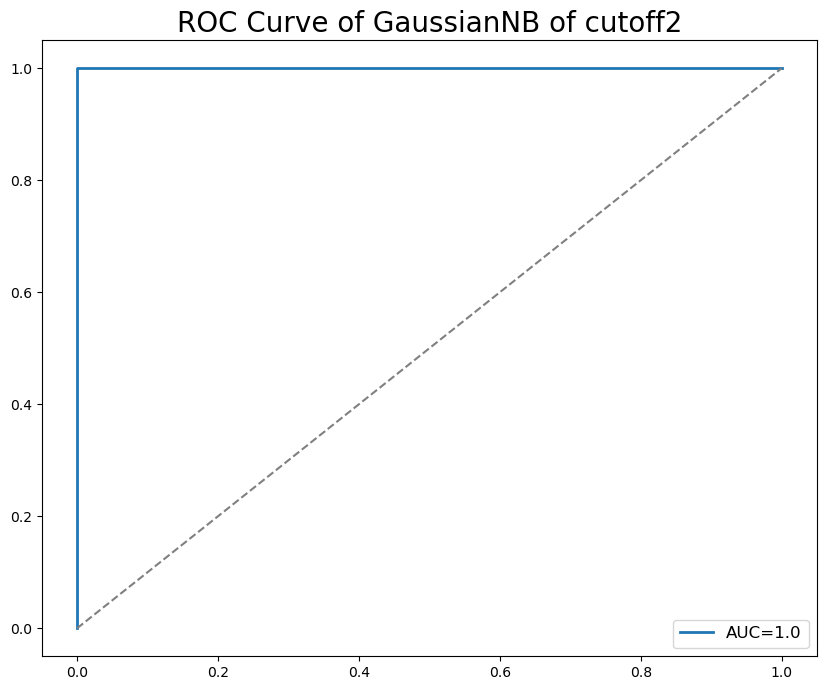

0:	learn: 0.6520231	total: 1.69ms	remaining: 6.76ms
1:	learn: 0.6213429	total: 2.22ms	remaining: 3.33ms
2:	learn: 0.5825414	total: 2.48ms	remaining: 1.65ms
3:	learn: 0.5530418	total: 2.82ms	remaining: 704us
4:	learn: 0.5259937	total: 3.1ms	remaining: 0us
best_index 1
accuracy 0.8666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


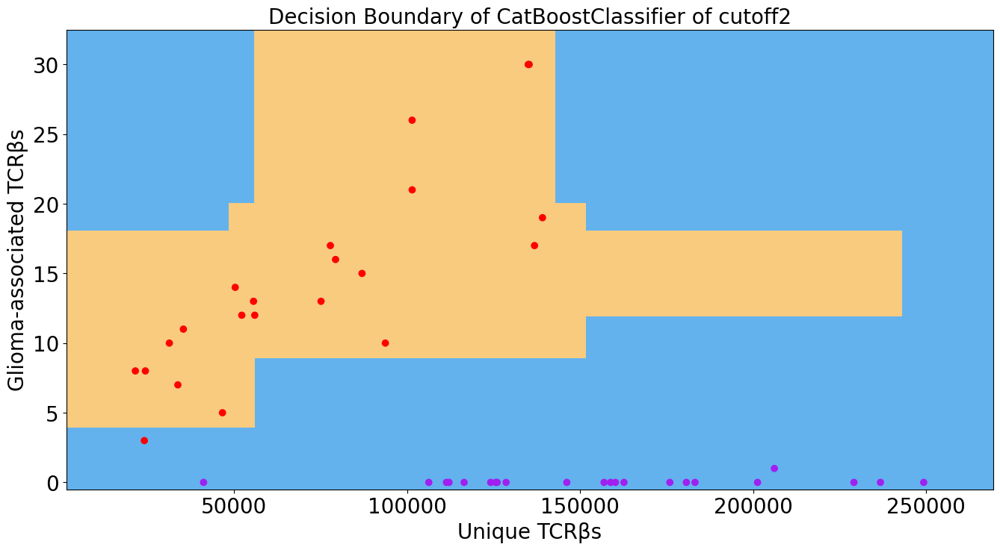

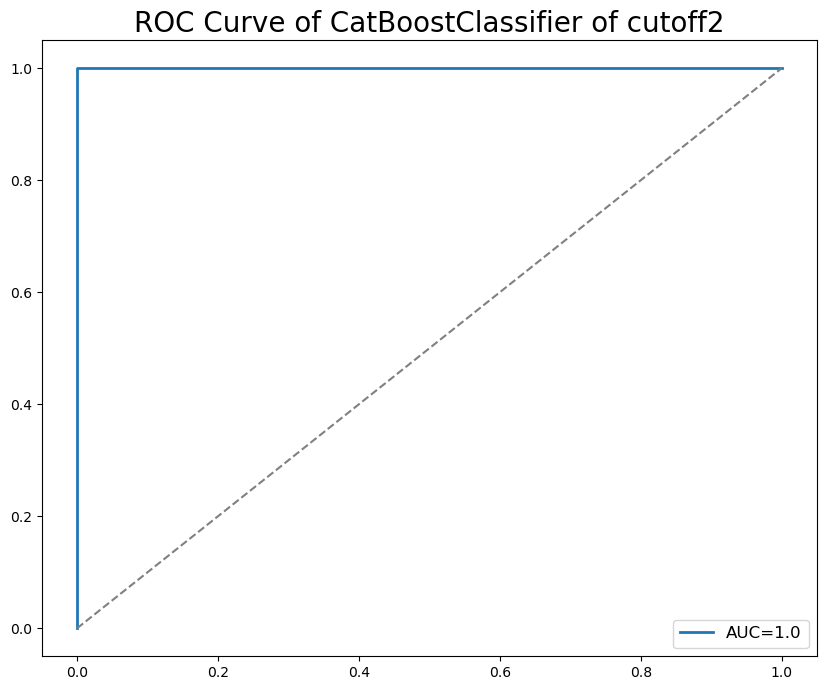

best_index 0
accuracy 0.9666666666666667


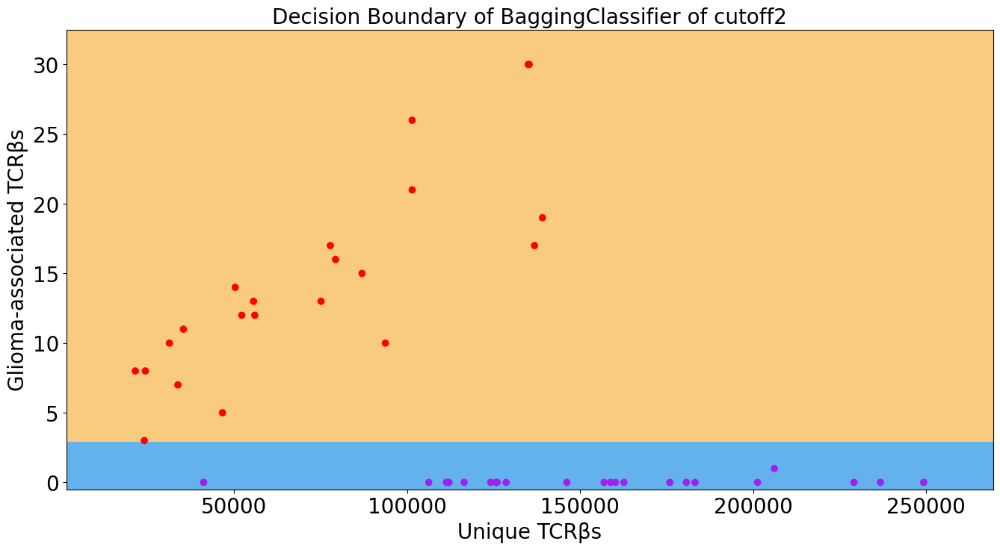

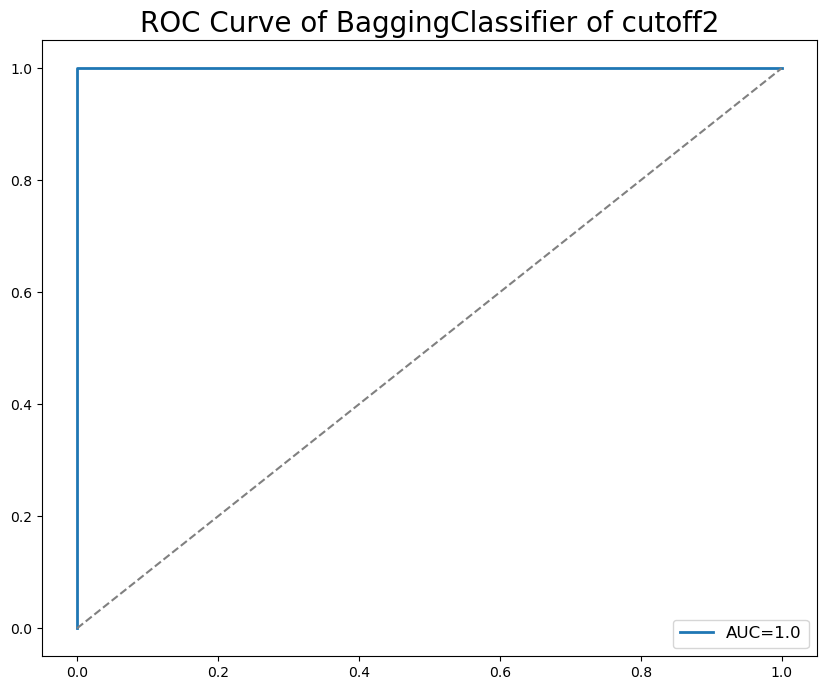

Epoch 1/100
2/2 [==============================] - 1s 387ms/step - loss: 0.5876 - accuracy: 0.8409 - auc_4: 0.8450 - precision_4: 0.8409 - recall_4: 0.8409 - val_loss: 0.6726 - val_accuracy: 0.5333 - val_auc_4: 0.6000 - val_precision_4: 0.5333 - val_recall_4: 0.5333
Epoch 2/100
2/2 [==============================] - 0s 23ms/step - loss: 0.5755 - accuracy: 0.8409 - auc_4: 0.8704 - precision_4: 0.8409 - recall_4: 0.8409 - val_loss: 0.6649 - val_accuracy: 0.5333 - val_auc_4: 0.6256 - val_precision_4: 0.5333 - val_recall_4: 0.5333
Epoch 3/100
2/2 [==============================] - 0s 23ms/step - loss: 0.5645 - accuracy: 0.8409 - auc_4: 0.8858 - precision_4: 0.8409 - recall_4: 0.8409 - val_loss: 0.6572 - val_accuracy: 0.5333 - val_auc_4: 0.6500 - val_precision_4: 0.5333 - val_recall_4: 0.5333
Epoch 4/100
2/2 [==============================] - 0s 25ms/step - loss: 0.5533 - accuracy: 0.8636 - auc_4: 0.9057 - precision_4: 0.8636 - recall_4: 0.8636 - val_loss: 0.6495 - val_accuracy: 0.5333 - va

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:376: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:377: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:376: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:377: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:376: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:377: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\U

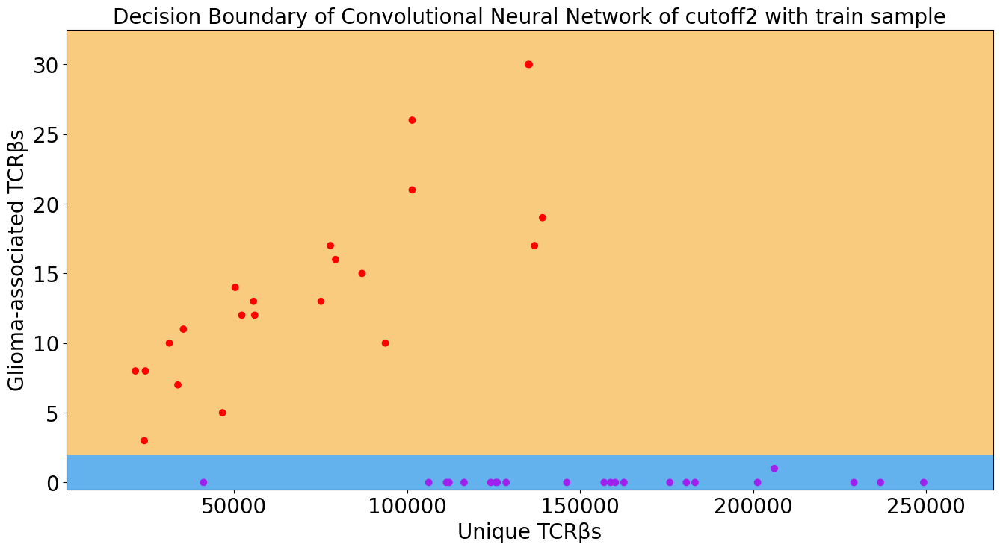

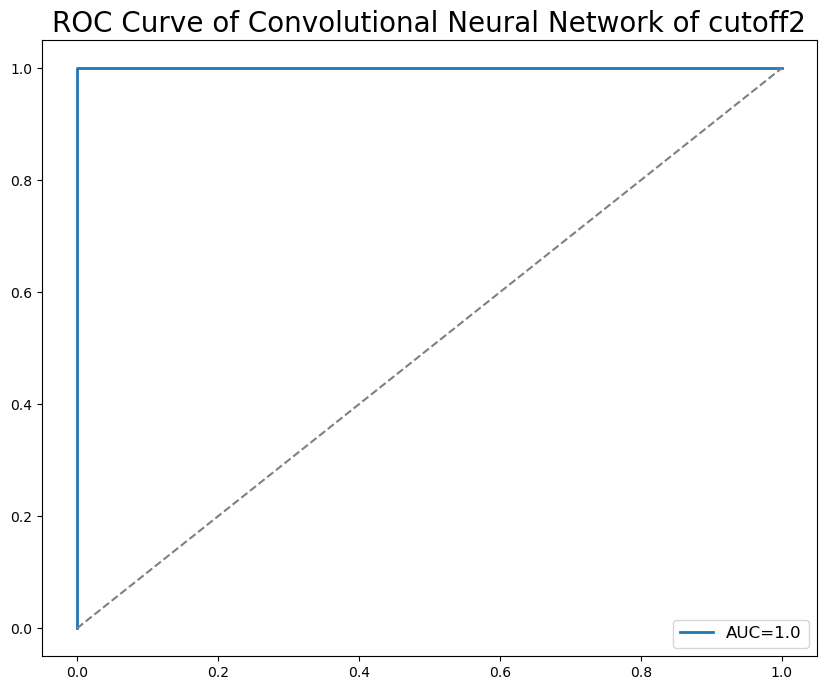

Epoch 1/100
2/2 [==============================] - 1s 429ms/step - loss: 0.6592 - accuracy: 0.9773 - auc_5: 0.9879 - precision_5: 0.9773 - recall_5: 0.9773 - val_loss: 0.5840 - val_accuracy: 0.9667 - val_auc_5: 0.9944 - val_precision_5: 0.9667 - val_recall_5: 0.9667
Epoch 2/100
2/2 [==============================] - 0s 25ms/step - loss: 0.5021 - accuracy: 0.9773 - auc_5: 0.9845 - precision_5: 0.9773 - recall_5: 0.9773 - val_loss: 0.4472 - val_accuracy: 0.9667 - val_auc_5: 0.9956 - val_precision_5: 0.9667 - val_recall_5: 0.9667
Epoch 3/100
2/2 [==============================] - 0s 25ms/step - loss: 0.3168 - accuracy: 0.9773 - auc_5: 0.9990 - precision_5: 0.9773 - recall_5: 0.9773 - val_loss: 0.2909 - val_accuracy: 0.9333 - val_auc_5: 0.9956 - val_precision_5: 0.9333 - val_recall_5: 0.9333
Epoch 4/100
2/2 [==============================] - 0s 27ms/step - loss: 0.1479 - accuracy: 0.9773 - auc_5: 0.9995 - precision_5: 0.9773 - recall_5: 0.9773 - val_loss: 0.1733 - val_accuracy: 0.9667 - va

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:463: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:464: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:463: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:464: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


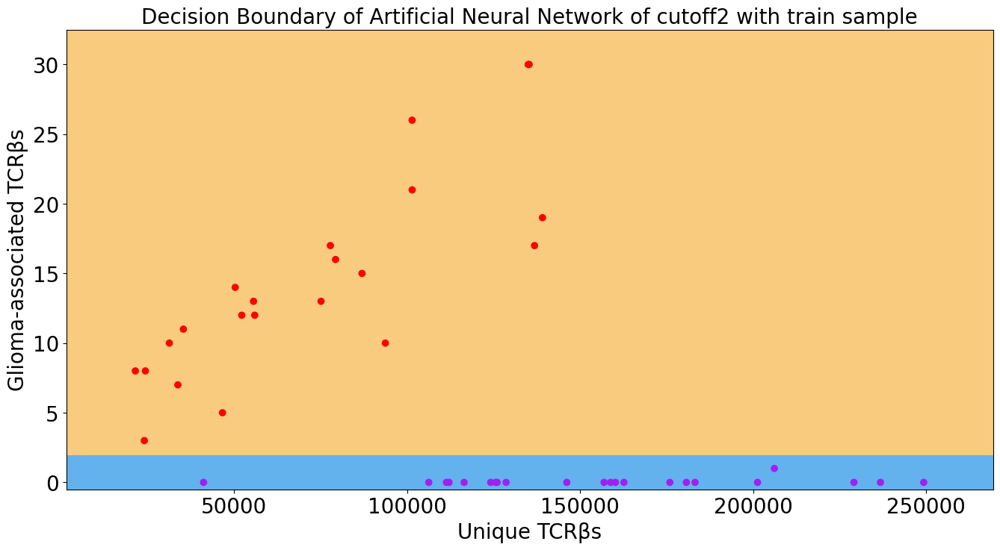

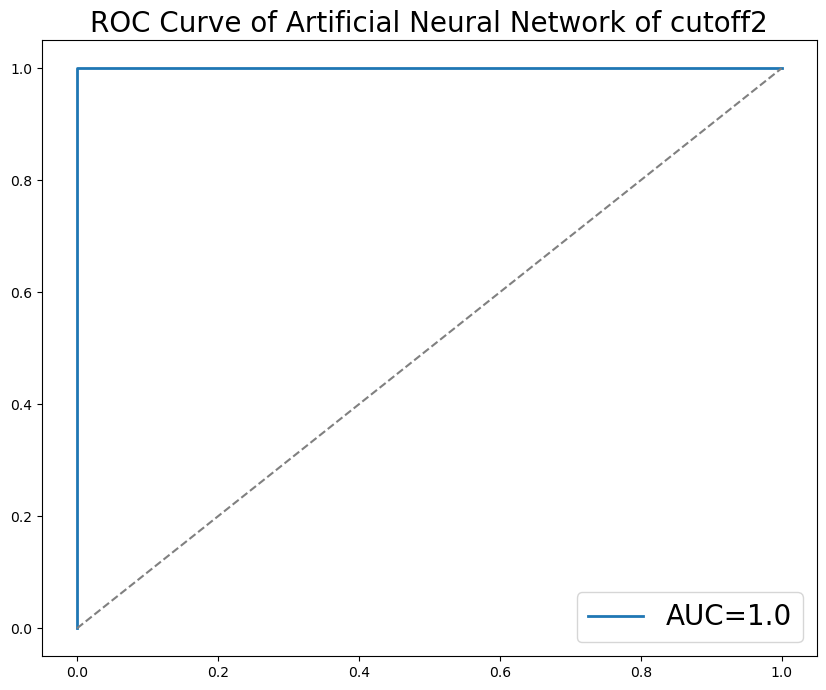

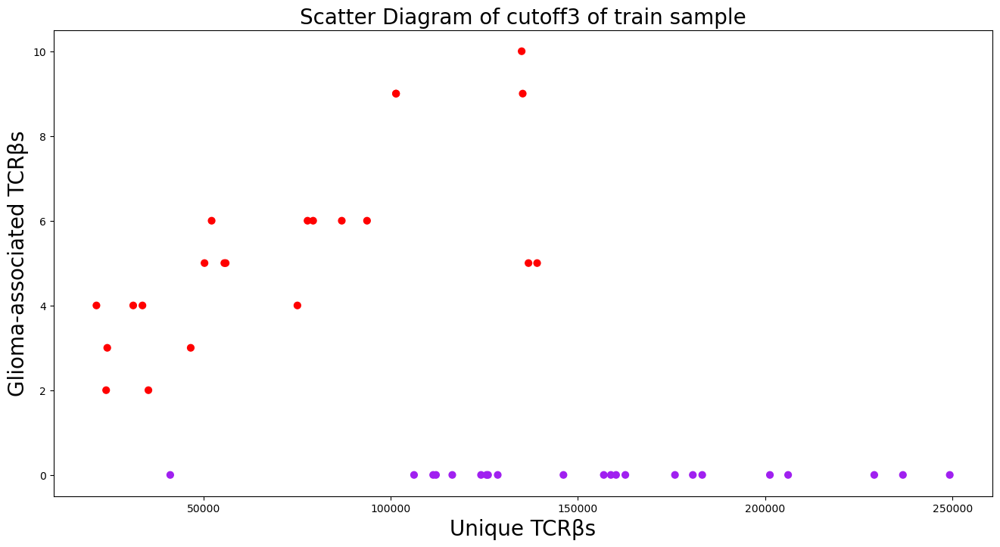

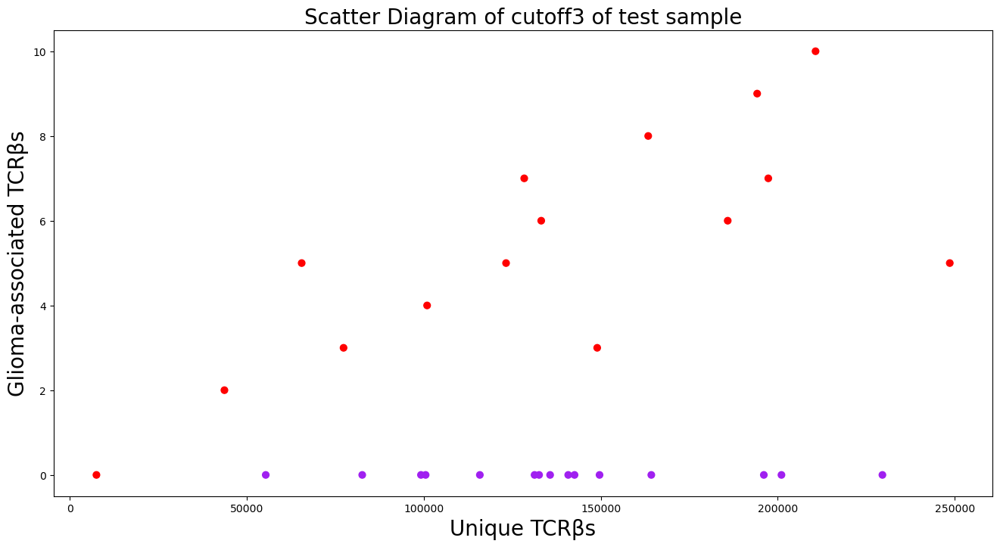

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\linesearch.py:478: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0:	learn: 0.6445875	total: 376us	remaining: 1.51ms
1:	learn: 0.6090689	total: 1.1ms	remaining: 1.65ms
2:	learn: 0.5699440	total: 1.4ms	remaining: 935us
3:	learn: 0.5390293	total: 1.76ms	remaining: 440us
4:	learn: 0.5062334	total: 1.99ms	remaining: 0us


C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\linesearch.py:478: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.9666666666666667


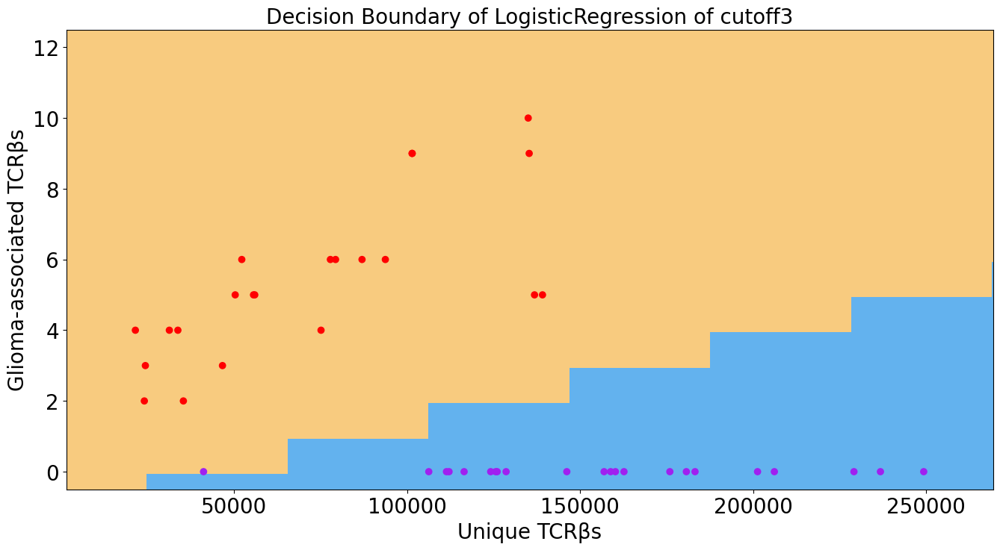

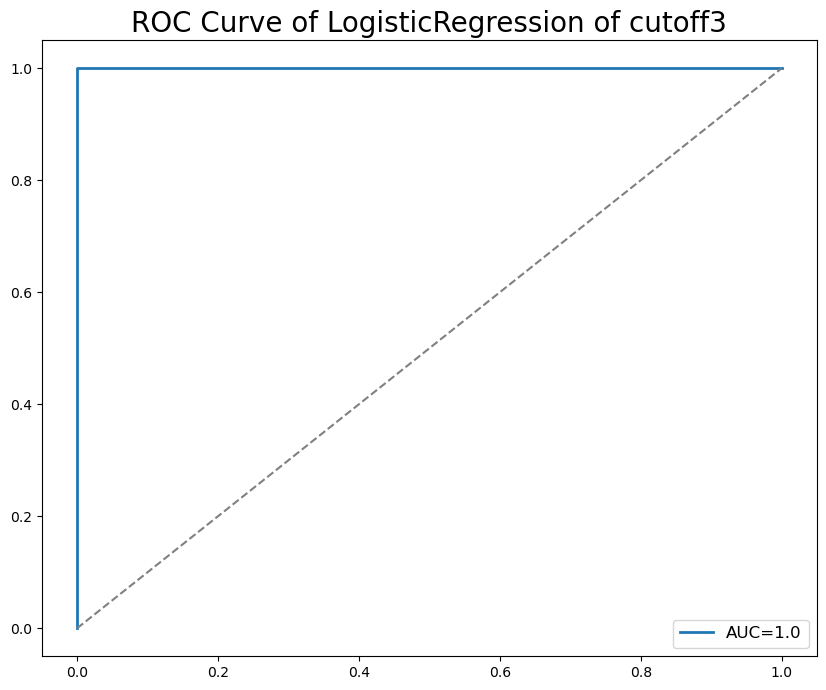

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 5
accuracy 0.9666666666666667


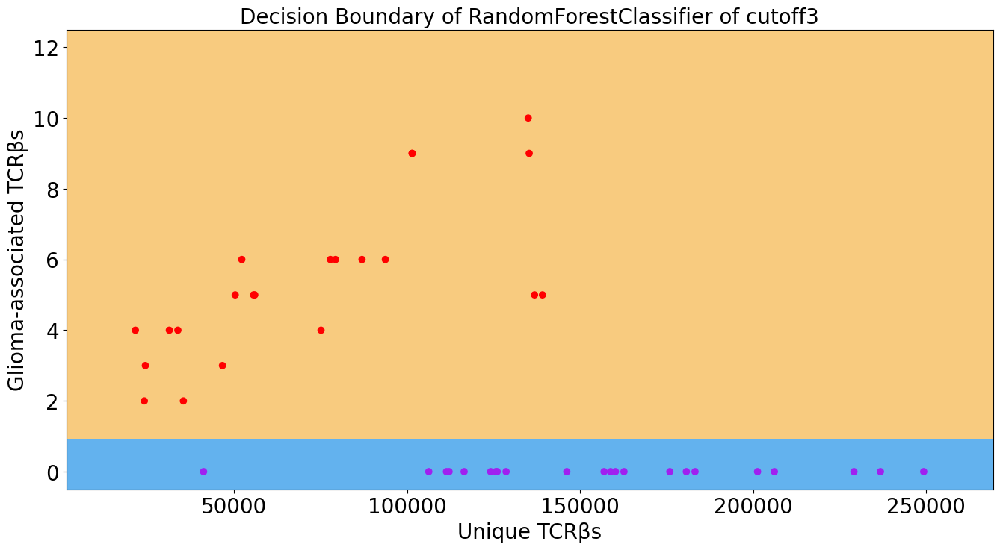

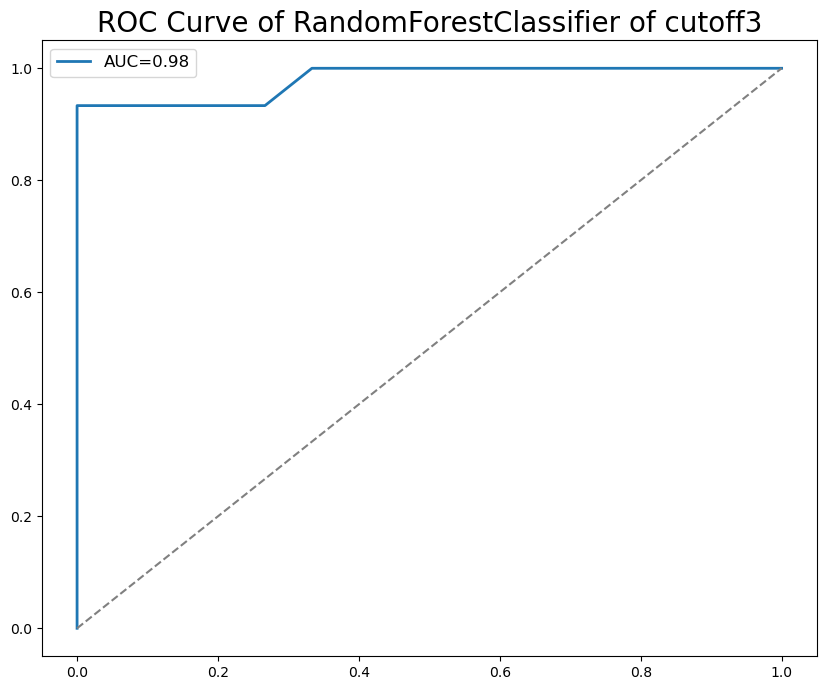

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 2
accuracy 0.9666666666666667


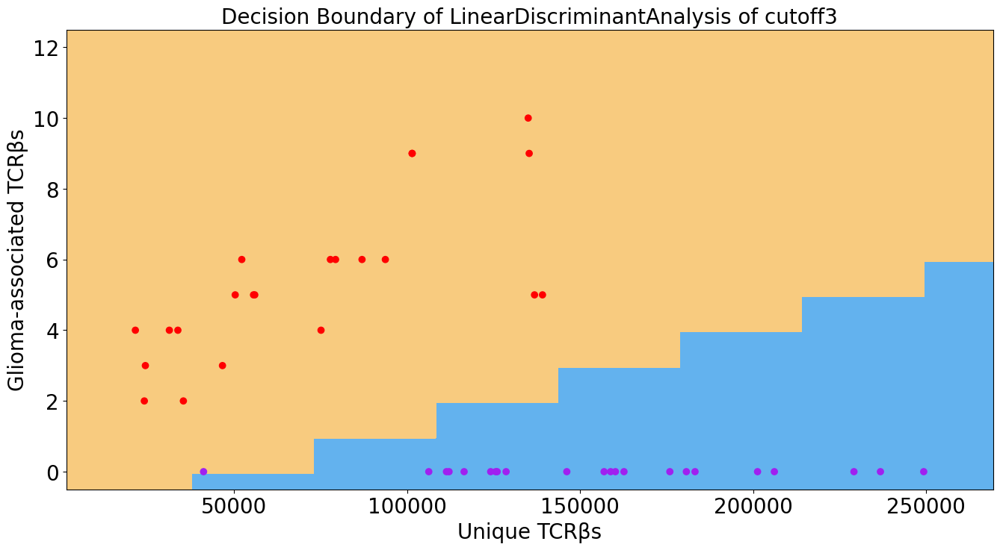

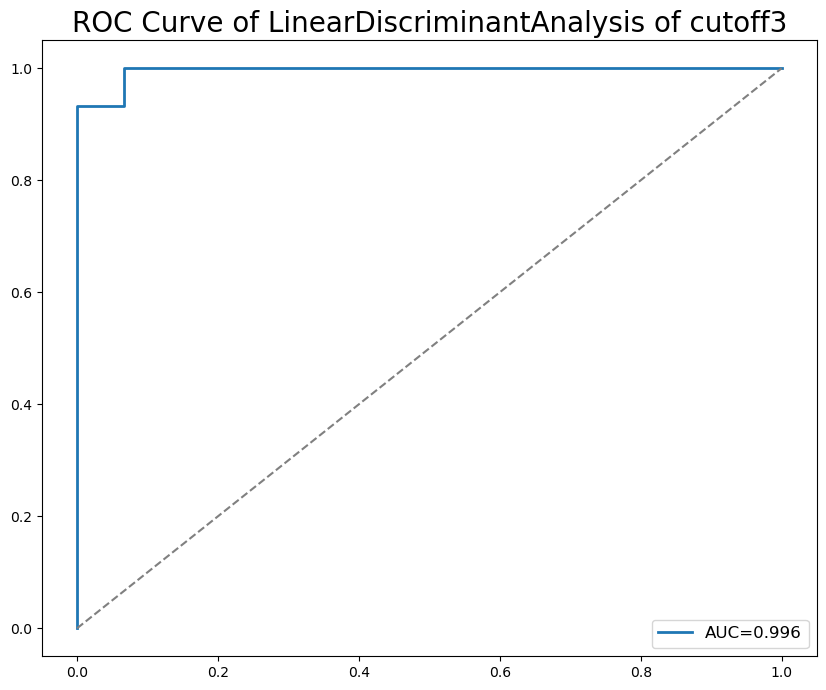

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.9666666666666667


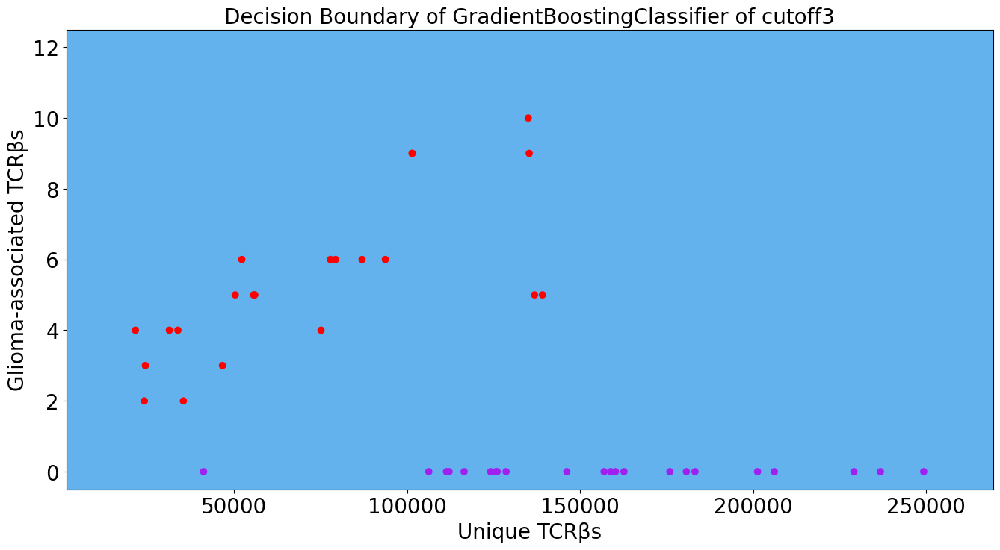

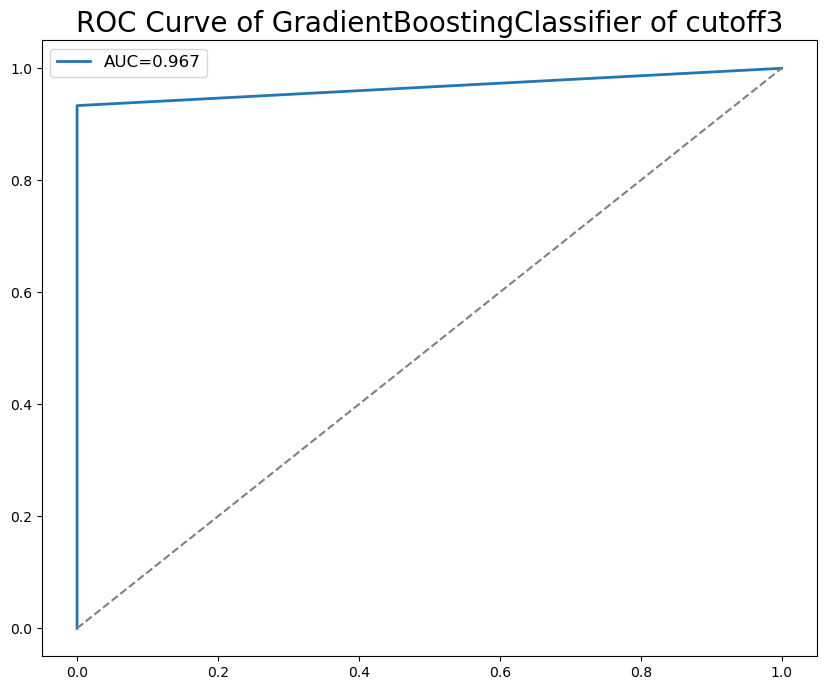

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 2
accuracy 0.9666666666666667


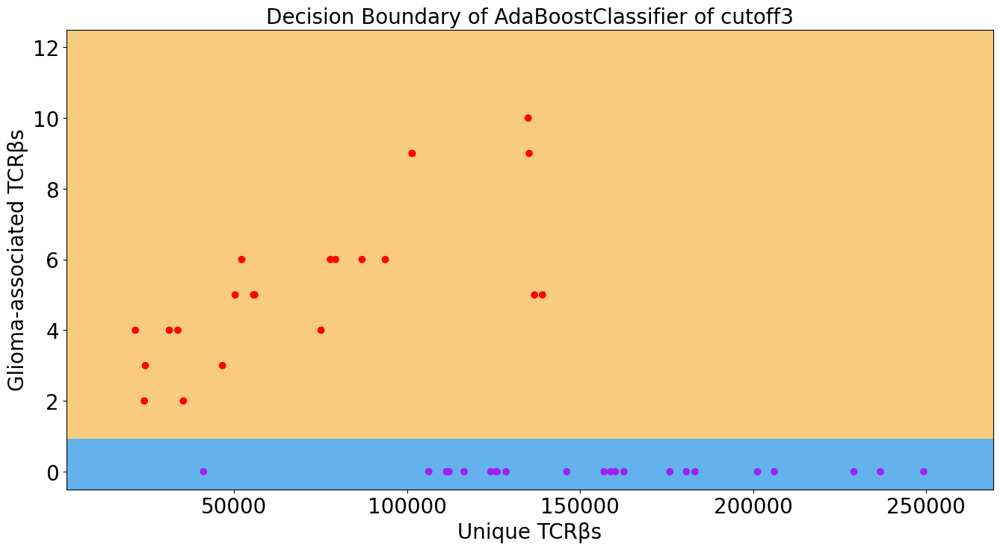

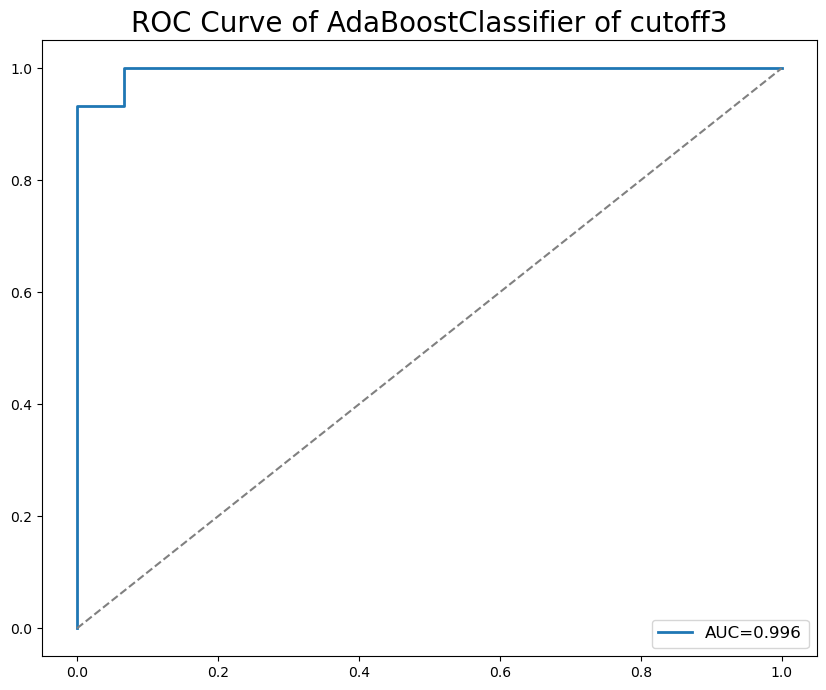

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.9666666666666667


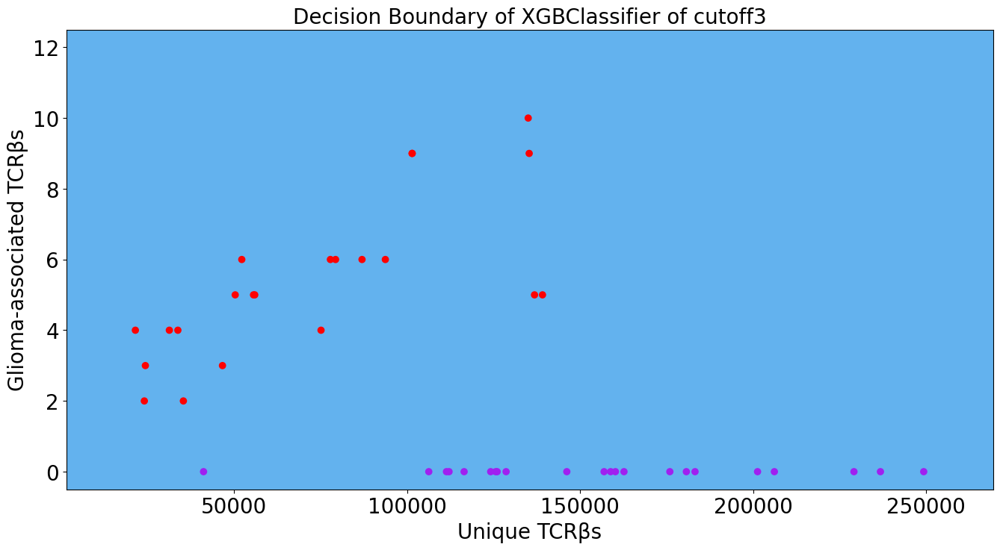

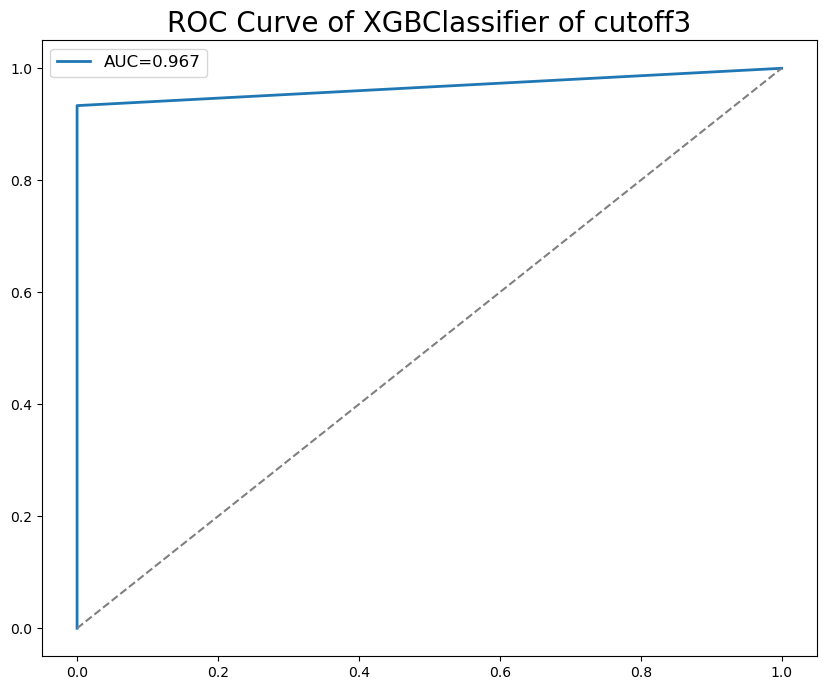

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.9666666666666667


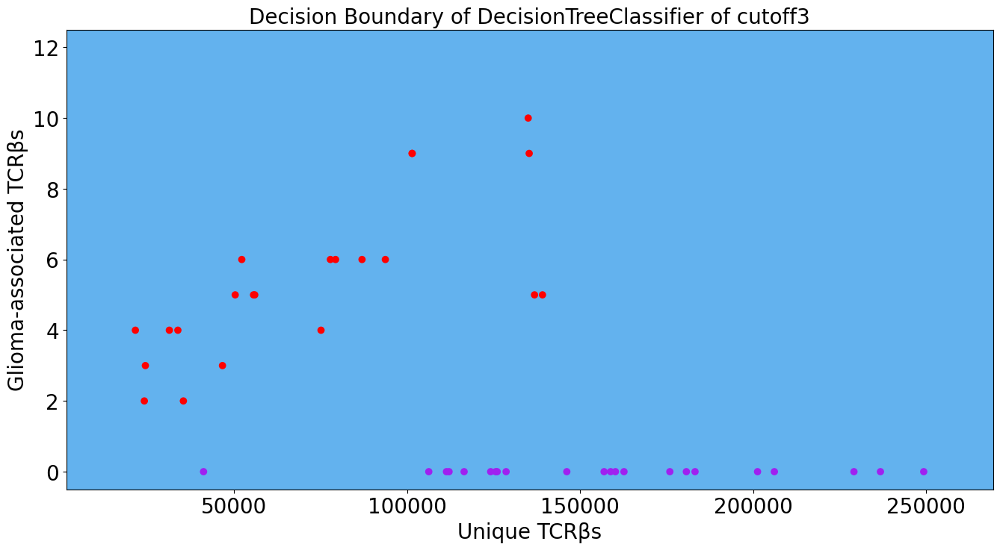

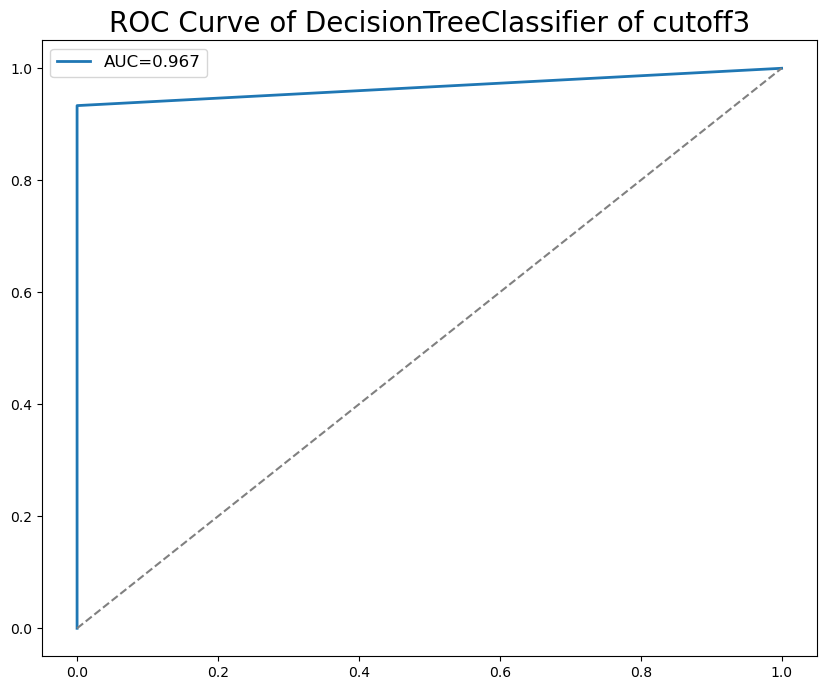

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 4
accuracy 0.9333333333333333


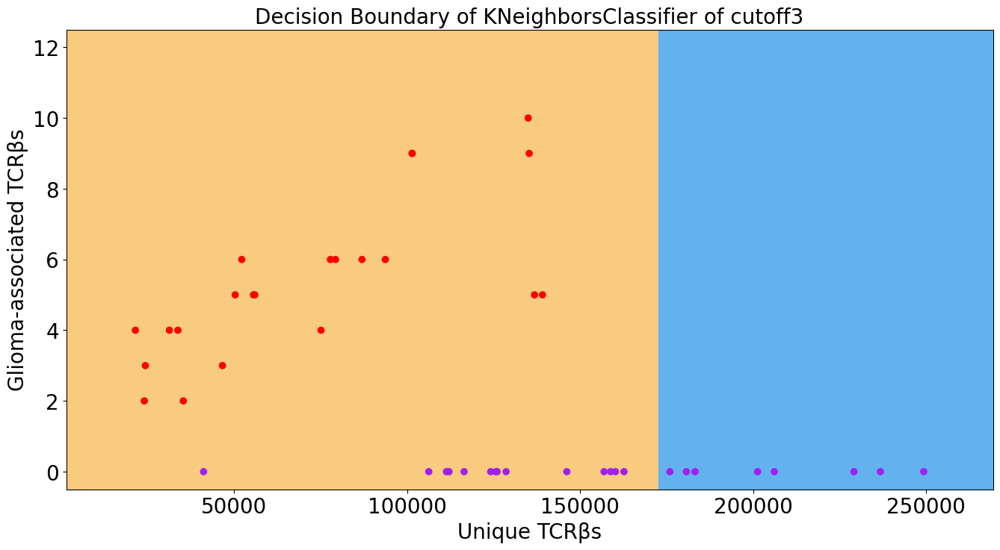

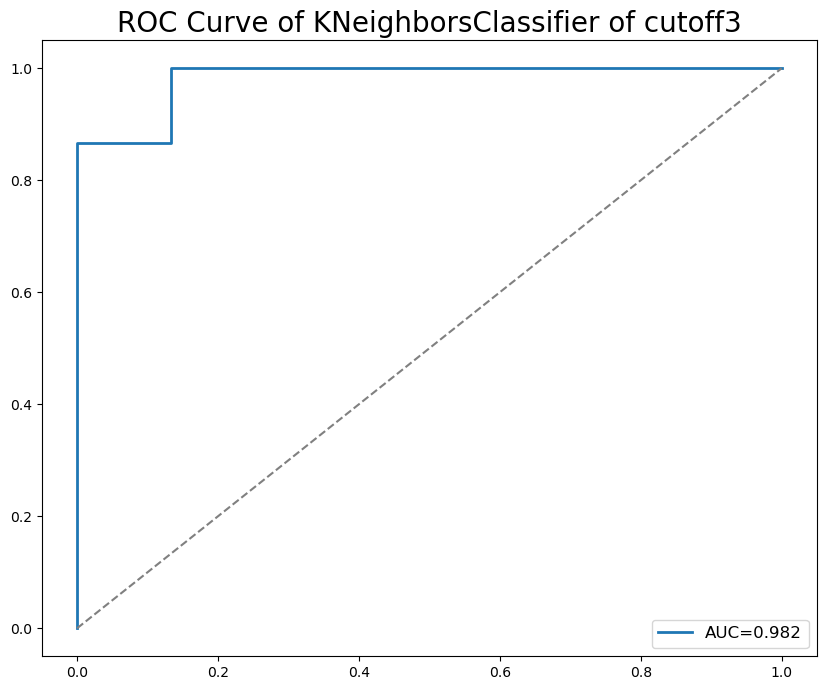

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 2
accuracy 0.9666666666666667


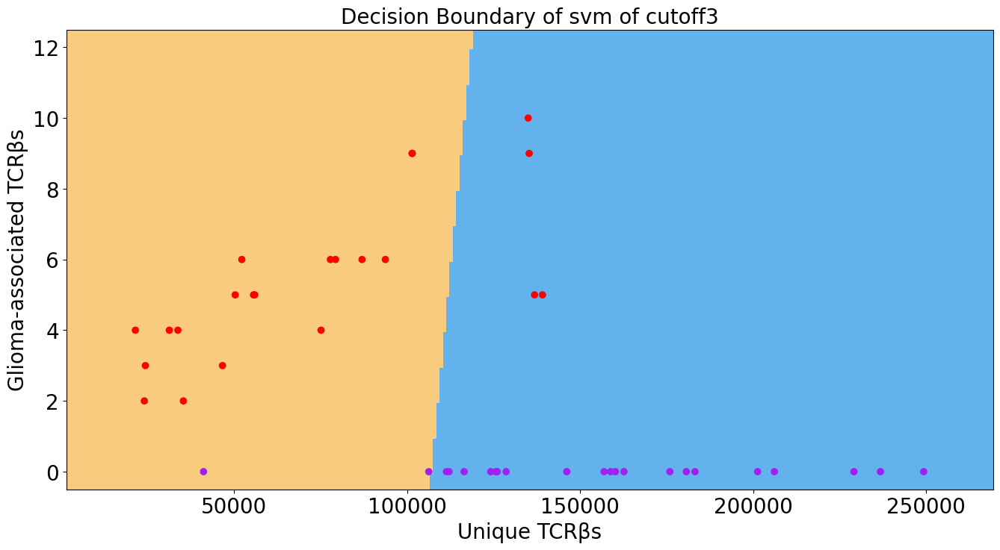

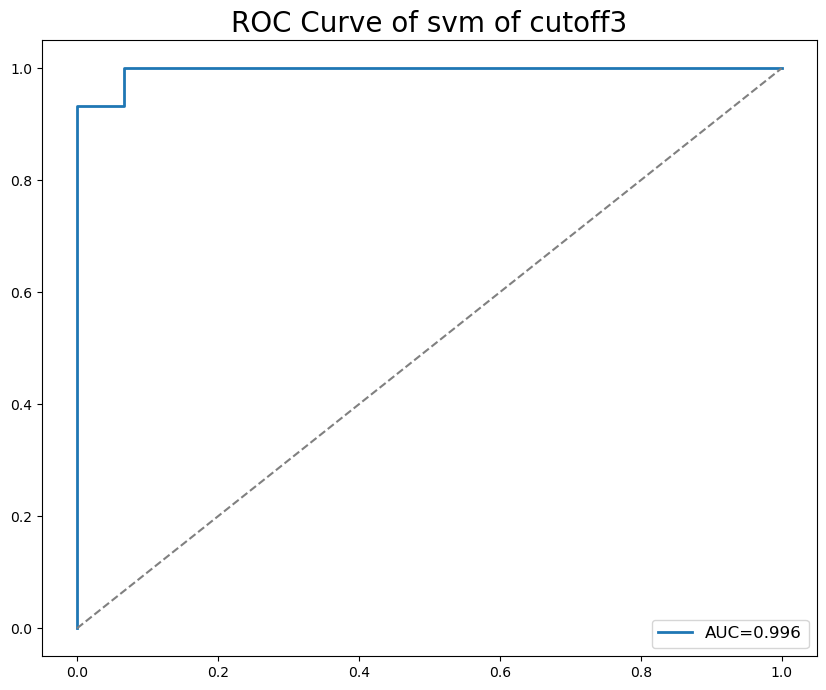

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.9666666666666667


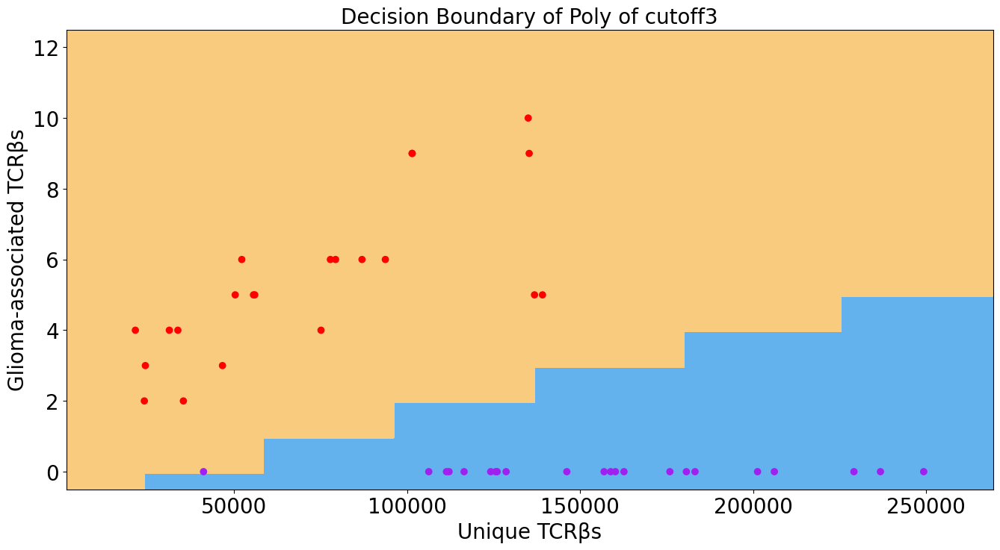

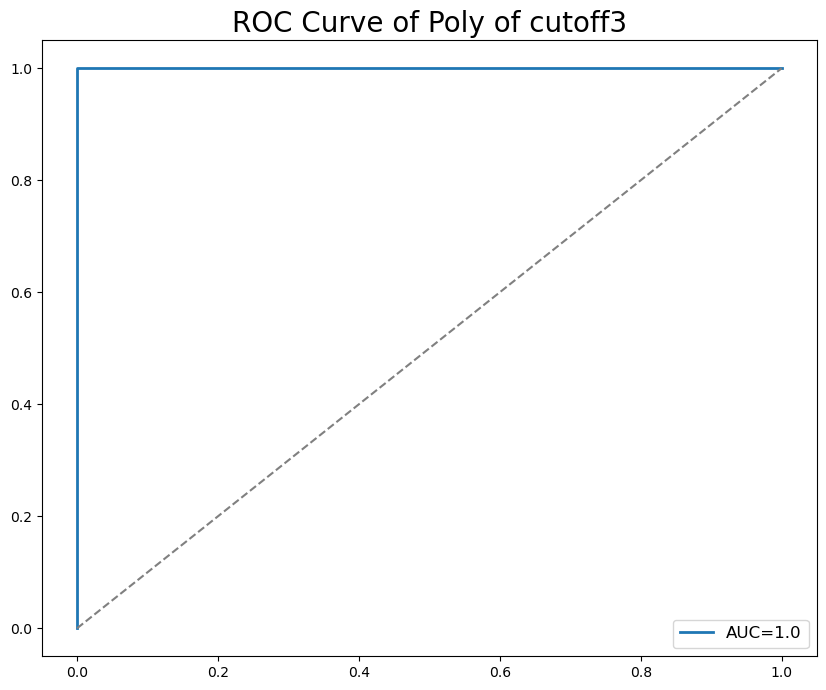

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.9


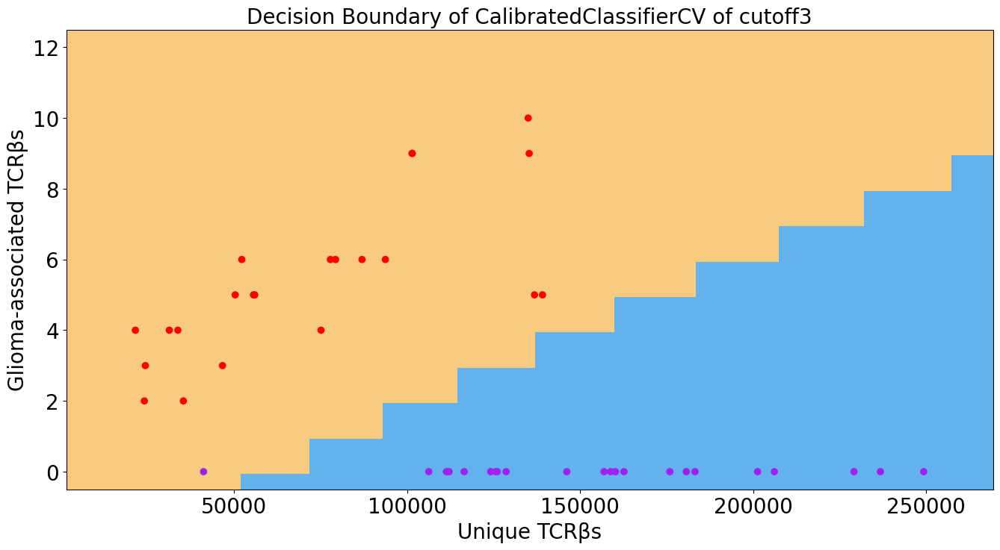

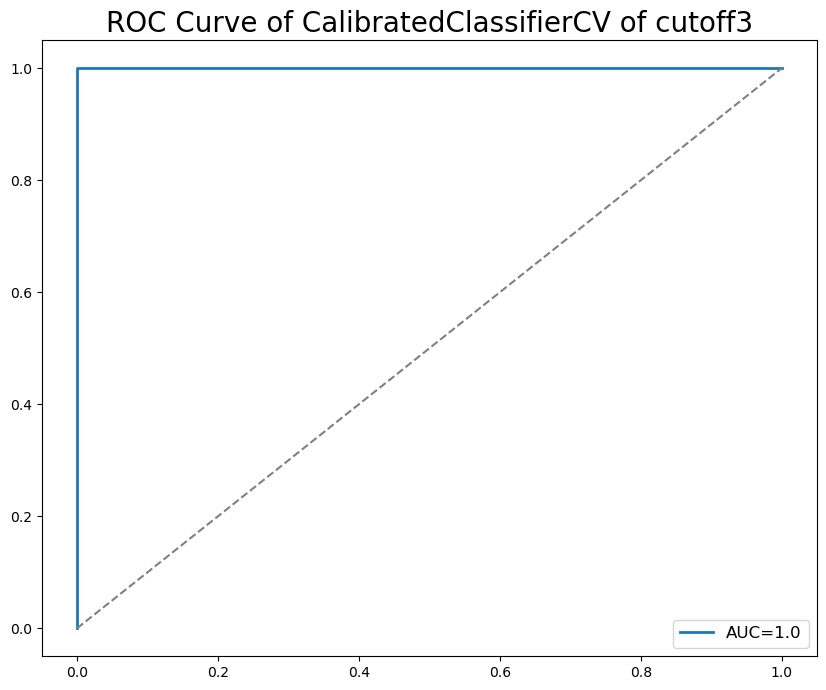

best_index 1
accuracy 0.9


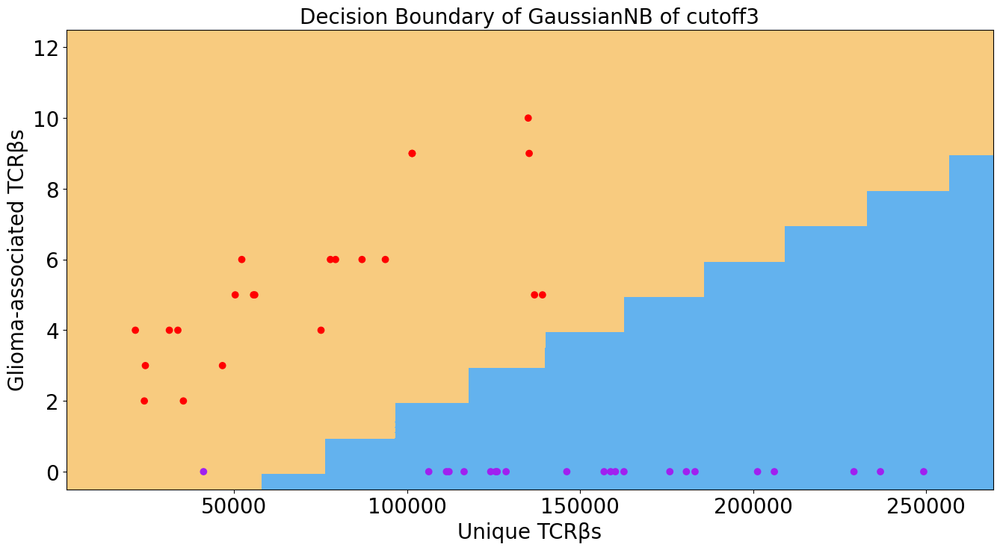

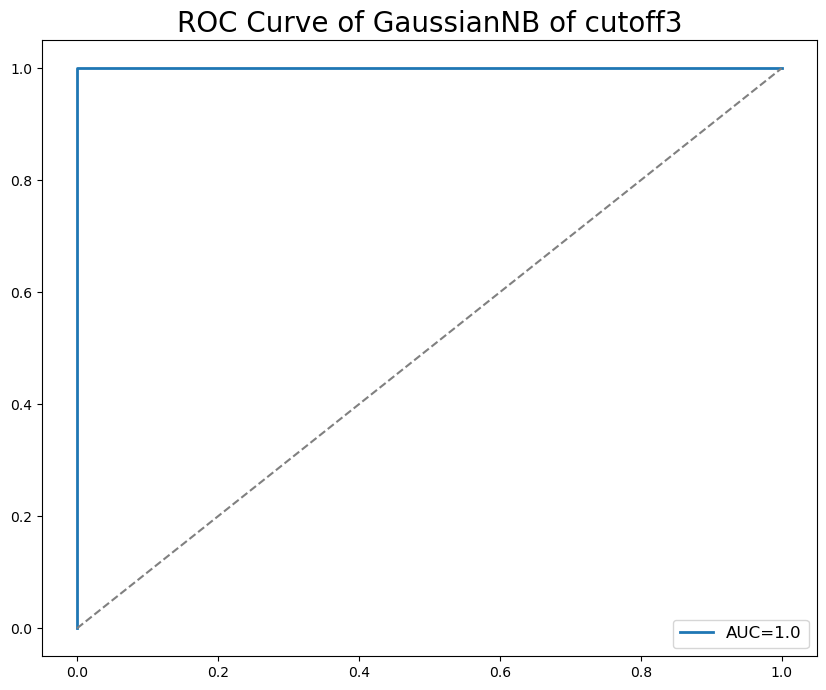

0:	learn: 0.6445875	total: 425us	remaining: 1.7ms
1:	learn: 0.6090689	total: 2.15ms	remaining: 3.23ms
2:	learn: 0.5699440	total: 2.45ms	remaining: 1.63ms
3:	learn: 0.5390293	total: 2.79ms	remaining: 696us
4:	learn: 0.5062334	total: 3ms	remaining: 0us
best_index 1
accuracy 1.0


C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


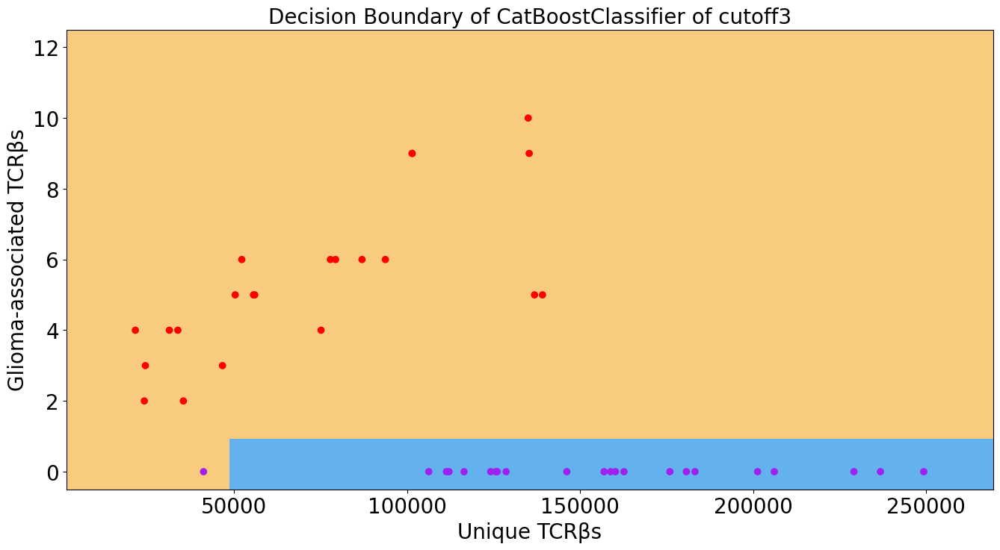

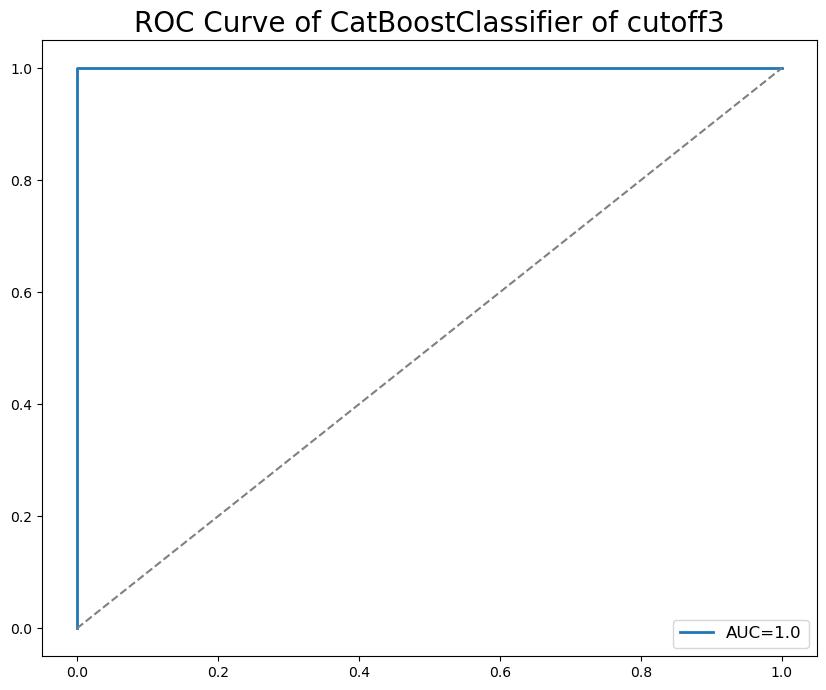

best_index 0
accuracy 0.9666666666666667


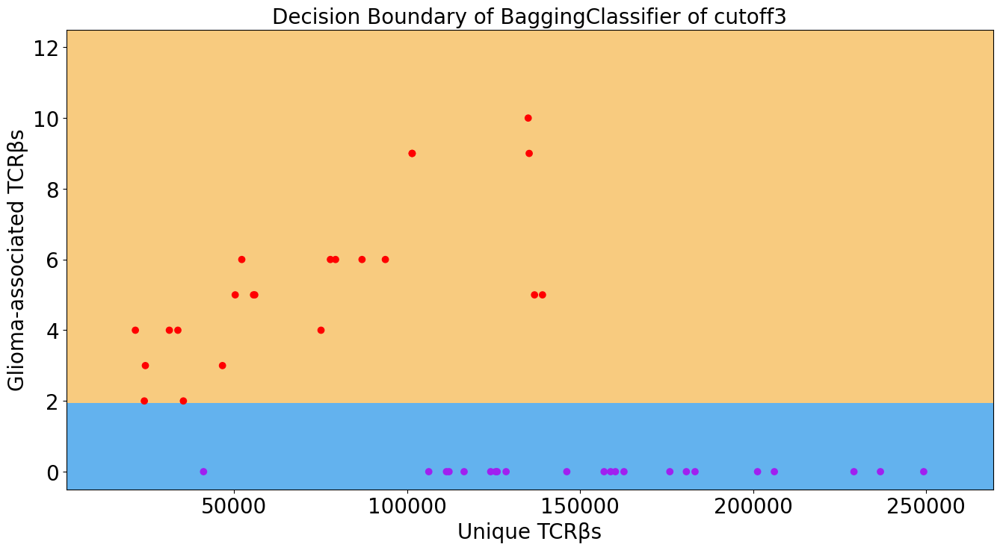

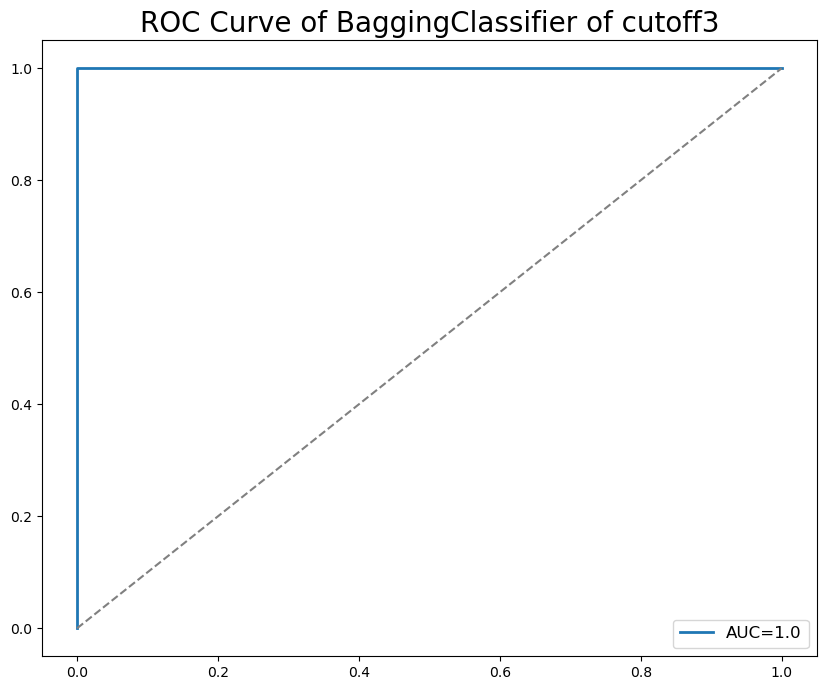

Epoch 1/100
2/2 [==============================] - 1s 366ms/step - loss: 0.7295 - accuracy: 0.3182 - auc_6: 0.4210 - precision_6: 0.3182 - recall_6: 0.3182 - val_loss: 0.8302 - val_accuracy: 0.1667 - val_auc_6: 0.1822 - val_precision_6: 0.1667 - val_recall_6: 0.1667
Epoch 2/100
2/2 [==============================] - 0s 19ms/step - loss: 0.7143 - accuracy: 0.3409 - auc_6: 0.4432 - precision_6: 0.3409 - recall_6: 0.3409 - val_loss: 0.8202 - val_accuracy: 0.1667 - val_auc_6: 0.1867 - val_precision_6: 0.1667 - val_recall_6: 0.1667
Epoch 3/100
2/2 [==============================] - 0s 23ms/step - loss: 0.6996 - accuracy: 0.3409 - auc_6: 0.4589 - precision_6: 0.3409 - recall_6: 0.3409 - val_loss: 0.8103 - val_accuracy: 0.1667 - val_auc_6: 0.1889 - val_precision_6: 0.1667 - val_recall_6: 0.1667
Epoch 4/100
2/2 [==============================] - 0s 20ms/step - loss: 0.6849 - accuracy: 0.3636 - auc_6: 0.5039 - precision_6: 0.3636 - recall_6: 0.3636 - val_loss: 0.8005 - val_accuracy: 0.1667 - va

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:376: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:377: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:376: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:377: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:376: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:377: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\U

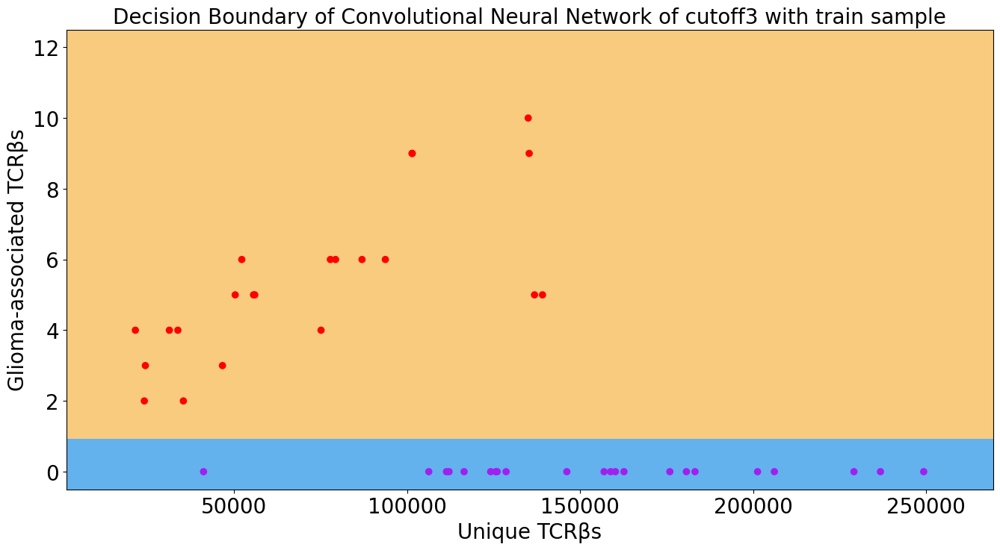

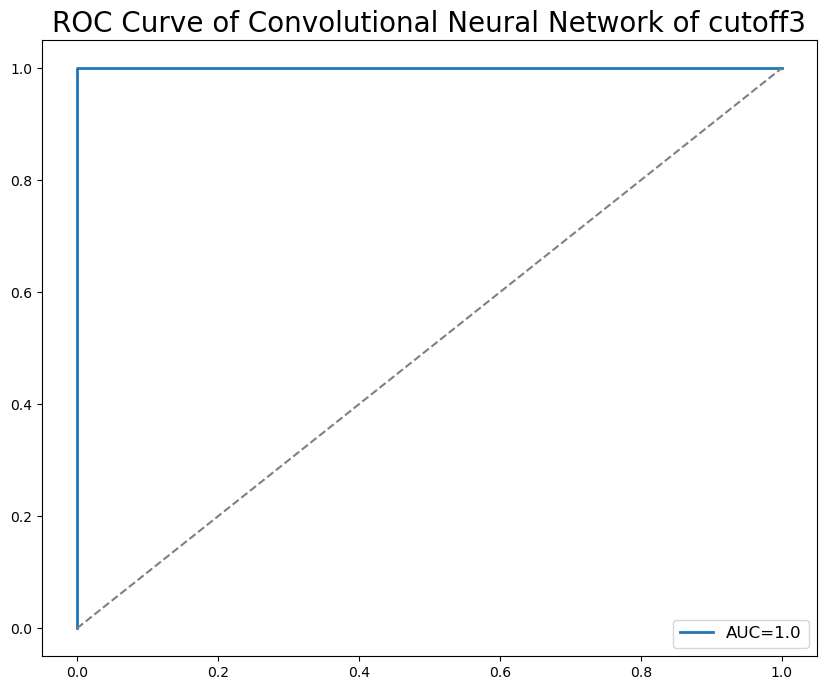

Epoch 1/100
2/2 [==============================] - 1s 367ms/step - loss: 0.6619 - accuracy: 0.6818 - auc_7: 0.8027 - precision_7: 0.6818 - recall_7: 0.6818 - val_loss: 0.5382 - val_accuracy: 0.9333 - val_auc_7: 0.9700 - val_precision_7: 0.9333 - val_recall_7: 0.9333
Epoch 2/100
2/2 [==============================] - 0s 24ms/step - loss: 0.4549 - accuracy: 0.9773 - auc_7: 0.9995 - precision_7: 0.9773 - recall_7: 0.9773 - val_loss: 0.3799 - val_accuracy: 0.9333 - val_auc_7: 0.9756 - val_precision_7: 0.9333 - val_recall_7: 0.9333
Epoch 3/100
2/2 [==============================] - 0s 24ms/step - loss: 0.2533 - accuracy: 0.9773 - auc_7: 0.9995 - precision_7: 0.9773 - recall_7: 0.9773 - val_loss: 0.2379 - val_accuracy: 0.9333 - val_auc_7: 0.9800 - val_precision_7: 0.9333 - val_recall_7: 0.9333
Epoch 4/100
2/2 [==============================] - 0s 23ms/step - loss: 0.1015 - accuracy: 1.0000 - auc_7: 1.0000 - precision_7: 1.0000 - recall_7: 1.0000 - val_loss: 0.1691 - val_accuracy: 0.9333 - va

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:463: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:464: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:463: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:464: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


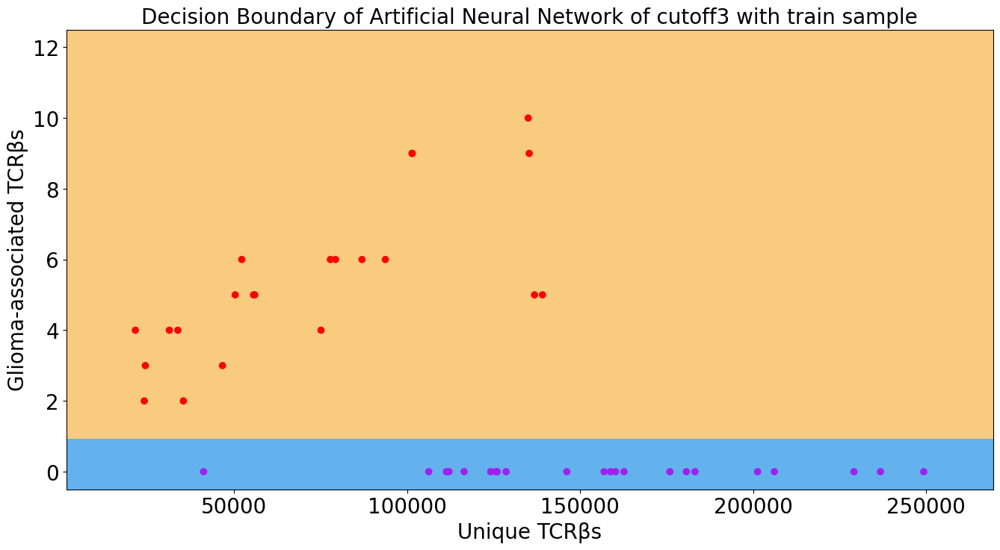

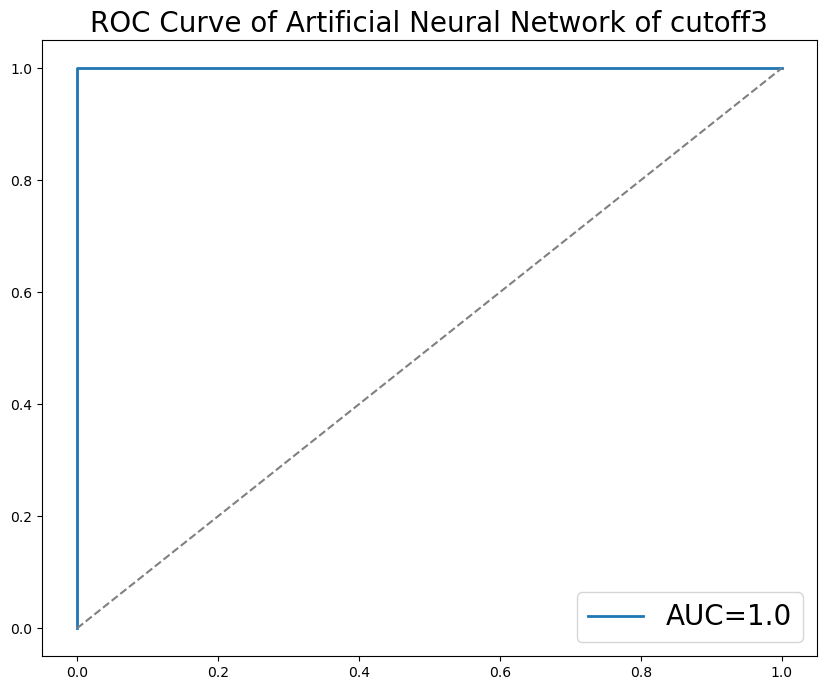

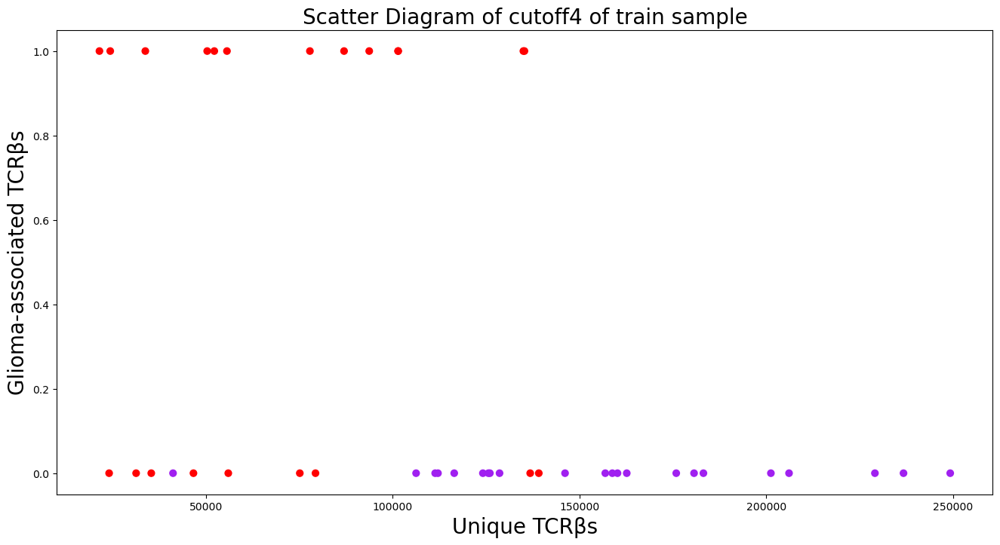

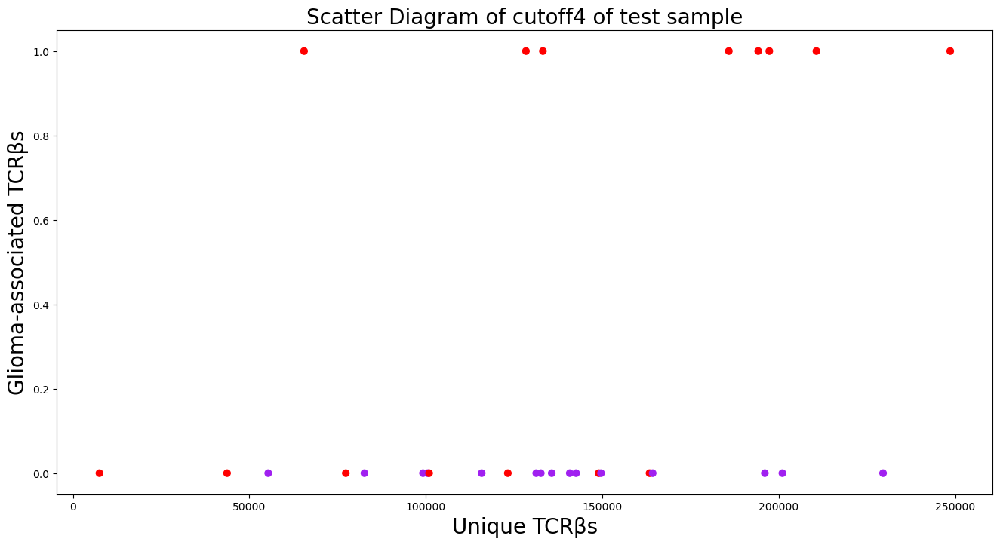

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\linesearch.py:478: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)


0:	learn: 0.6695560	total: 302us	remaining: 1.21ms
1:	learn: 0.6392864	total: 790us	remaining: 1.19ms
2:	learn: 0.6189313	total: 1.14ms	remaining: 757us
3:	learn: 0.5885540	total: 1.32ms	remaining: 329us
4:	learn: 0.5616980	total: 1.55ms	remaining: 0us


C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\linesearch.py:478: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 3
accuracy 0.6333333333333333


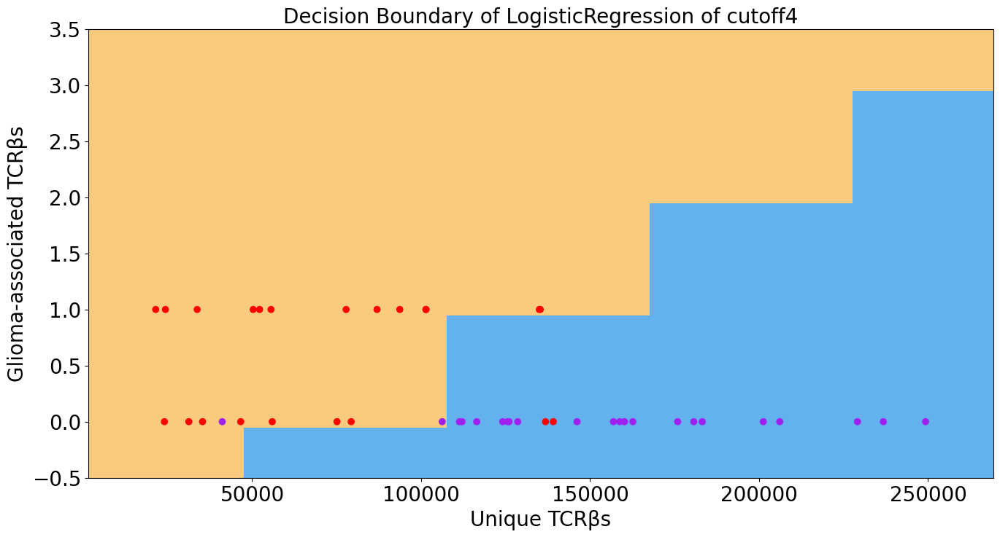

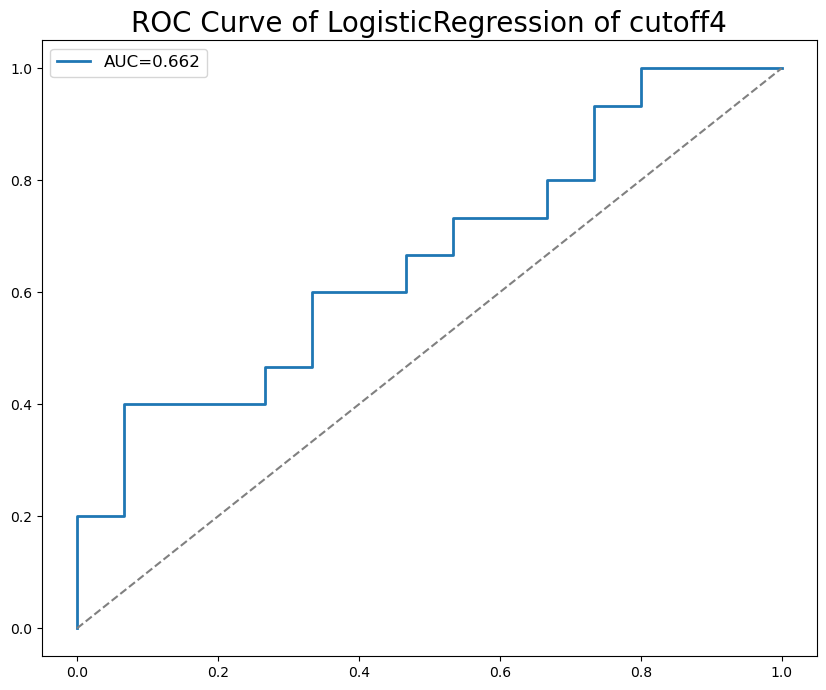

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 8
accuracy 0.7666666666666667


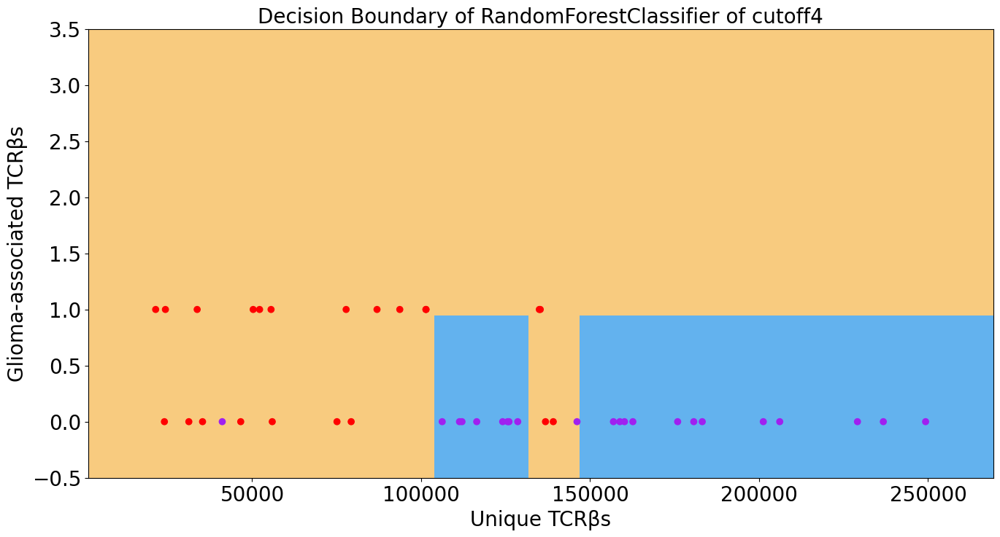

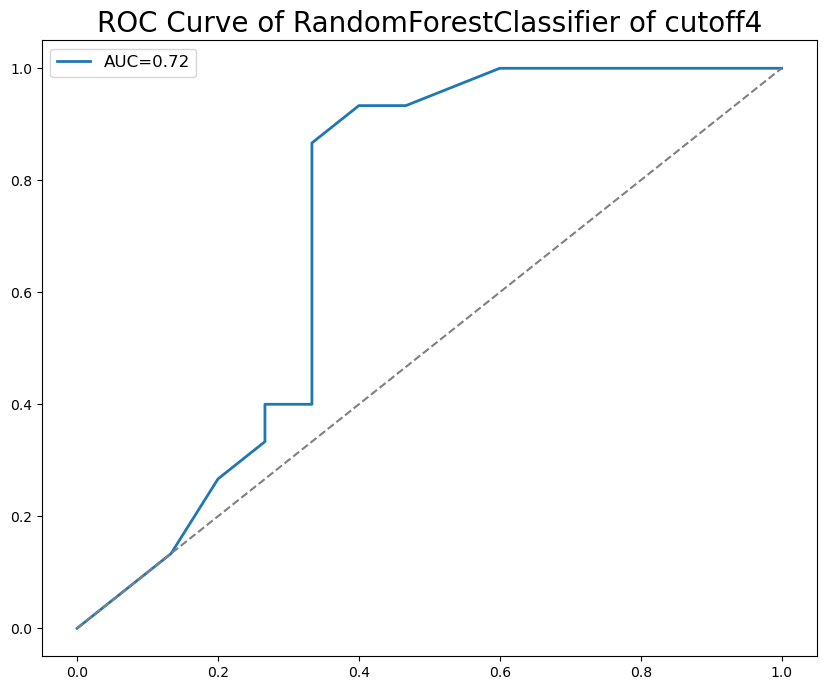

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 4
accuracy 0.7333333333333333


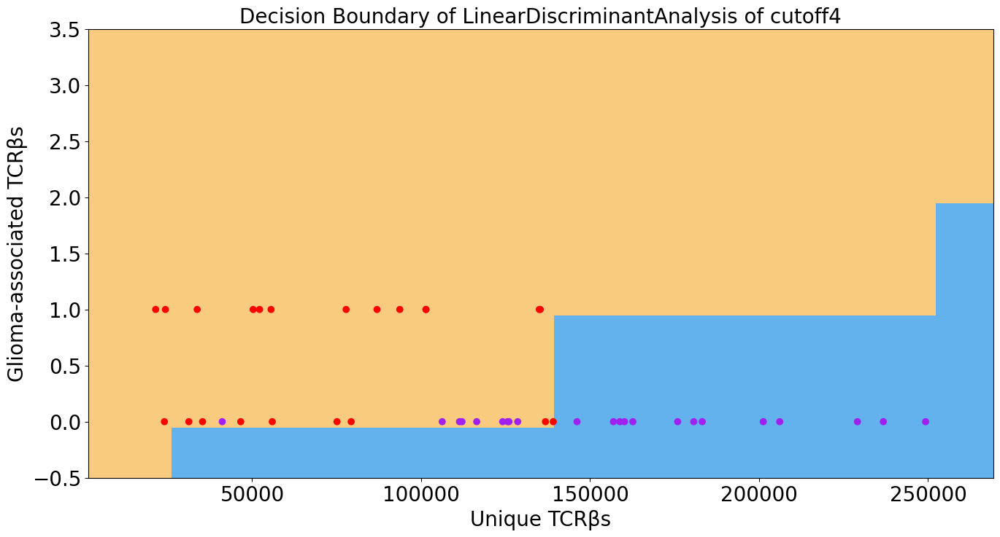

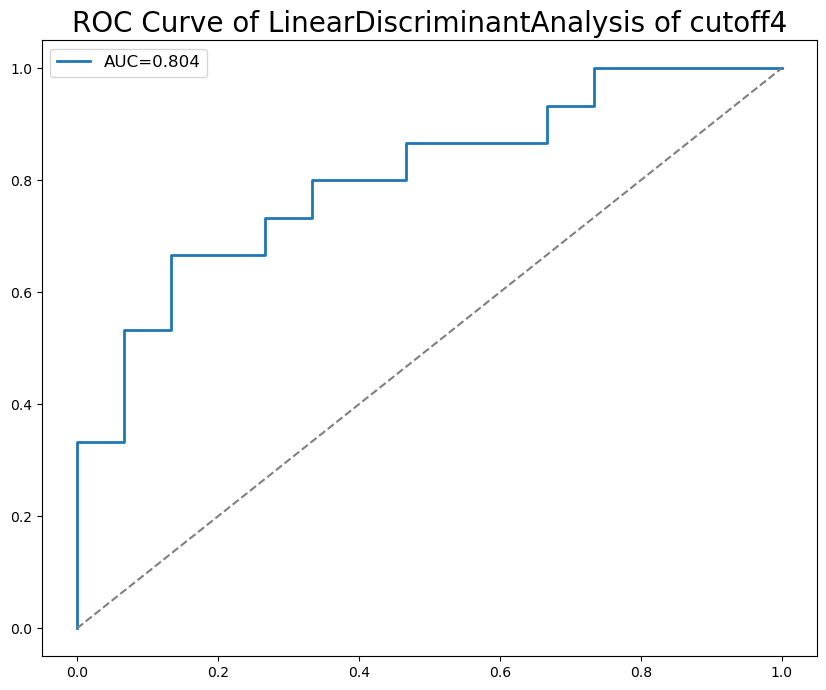

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 7
accuracy 0.7666666666666667


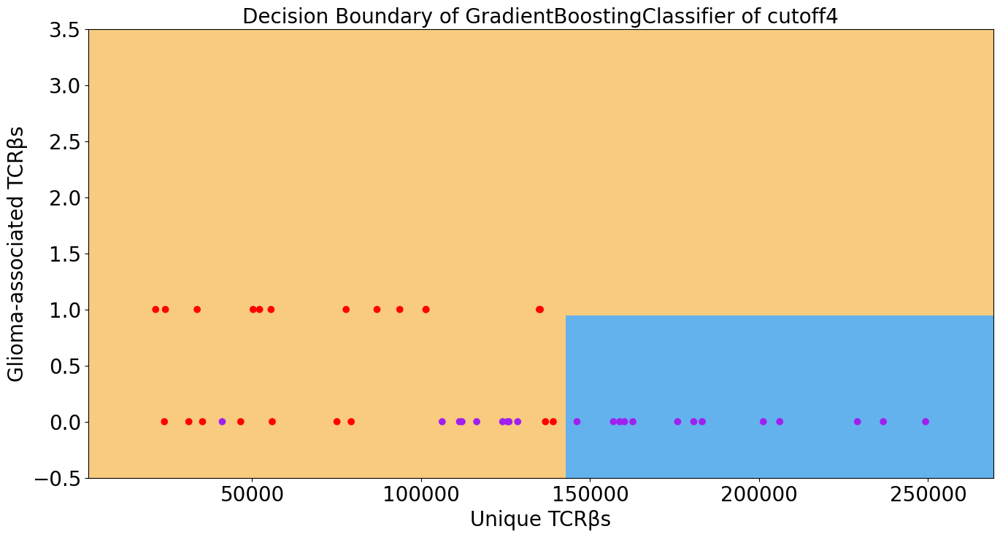

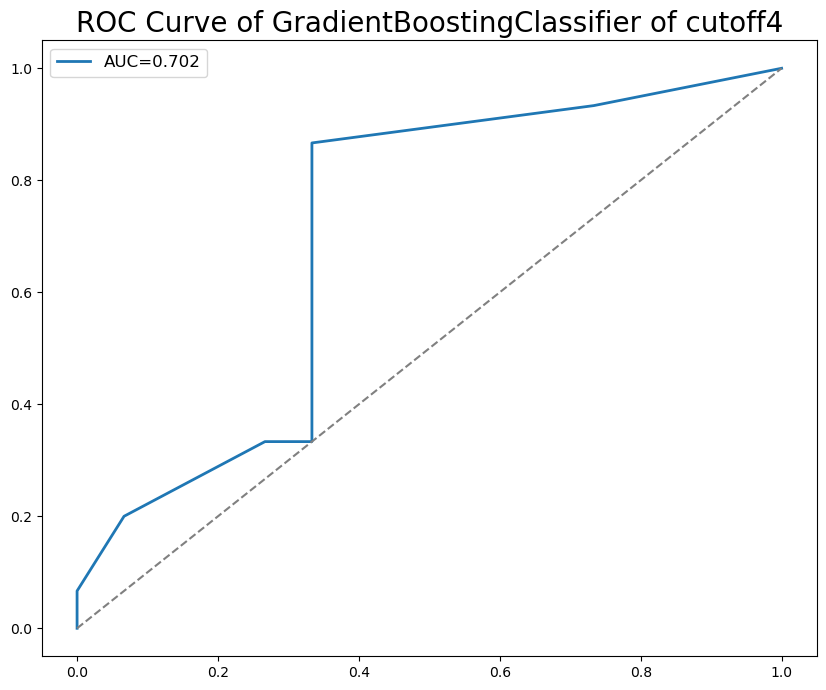

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 4
accuracy 0.7333333333333333


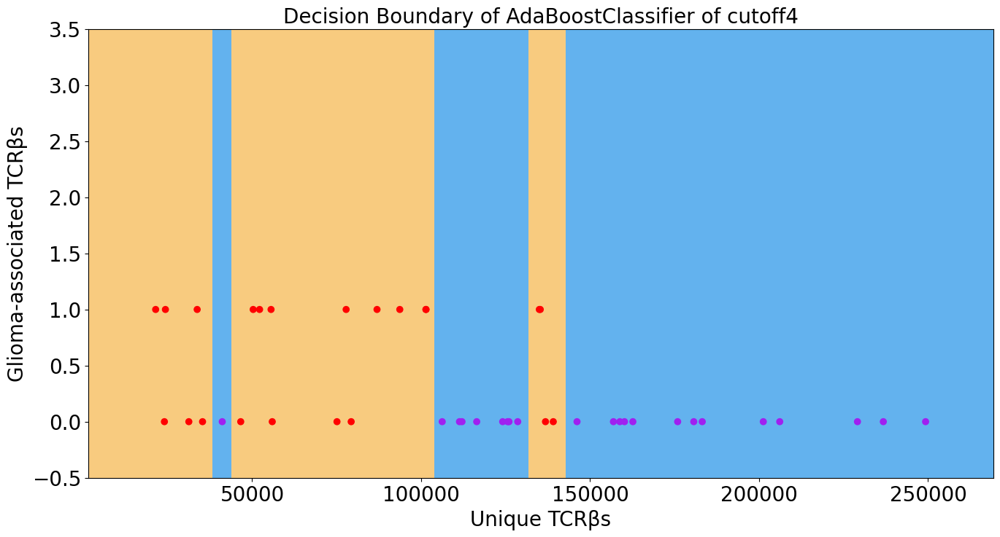

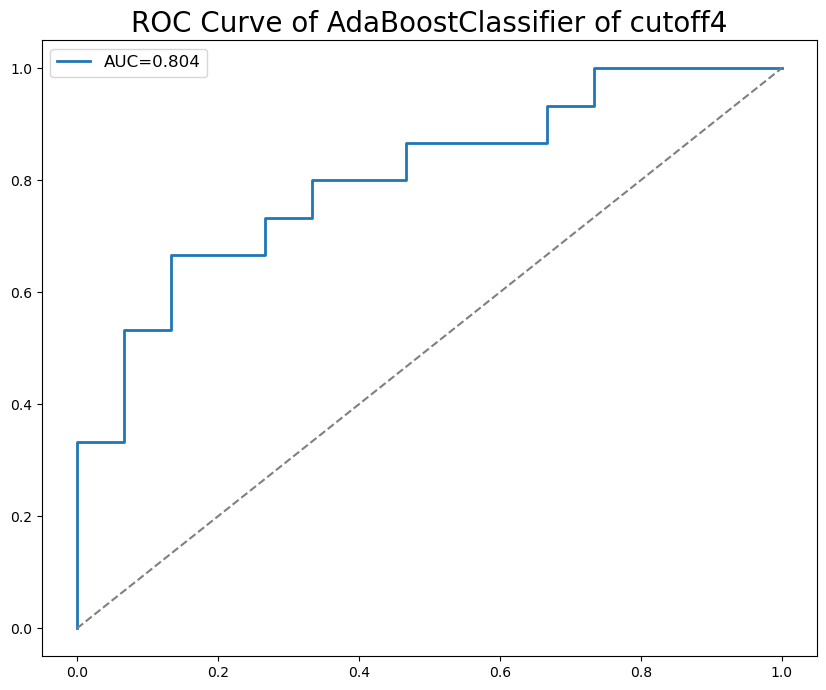

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 7
accuracy 0.7666666666666667


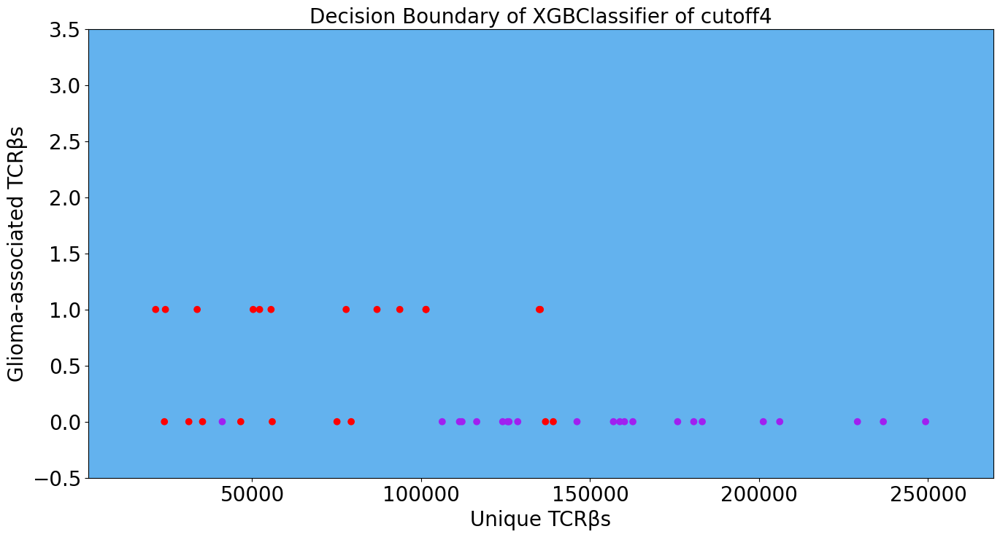

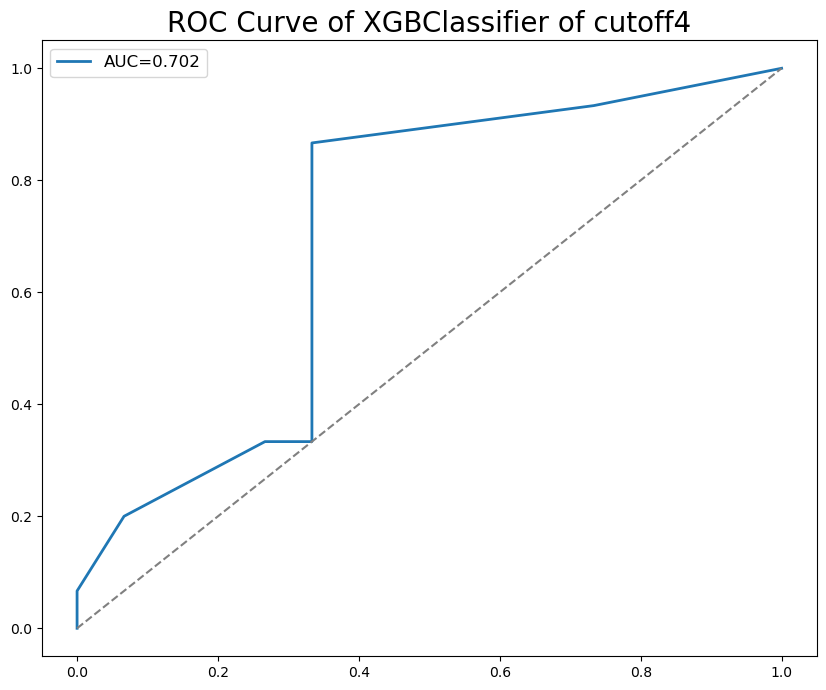

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.6333333333333333


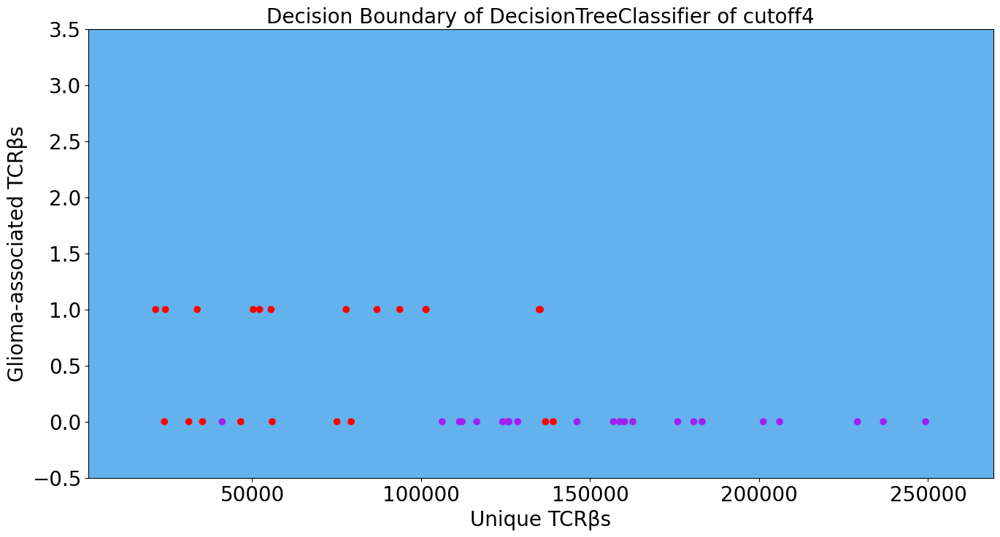

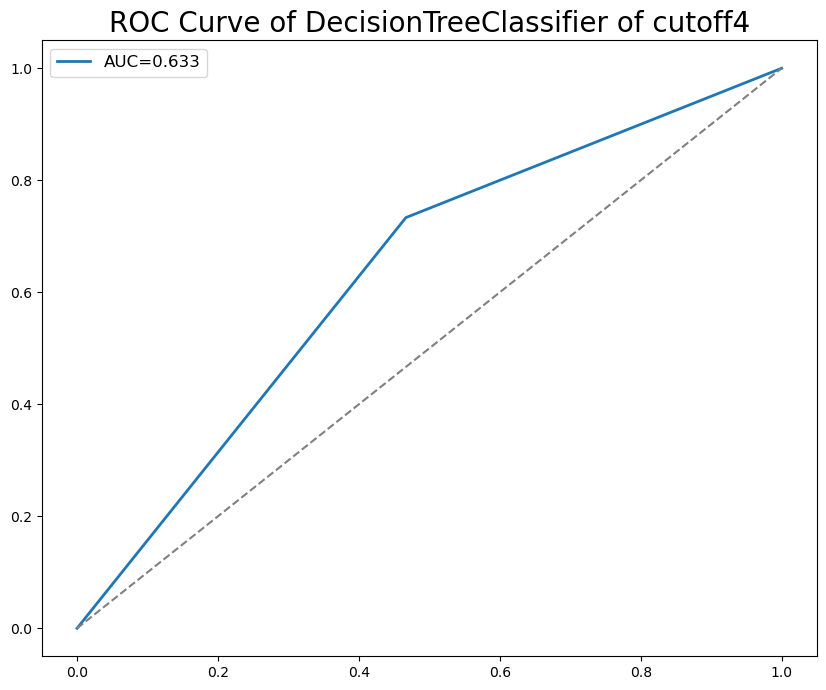

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 3
accuracy 0.7666666666666667


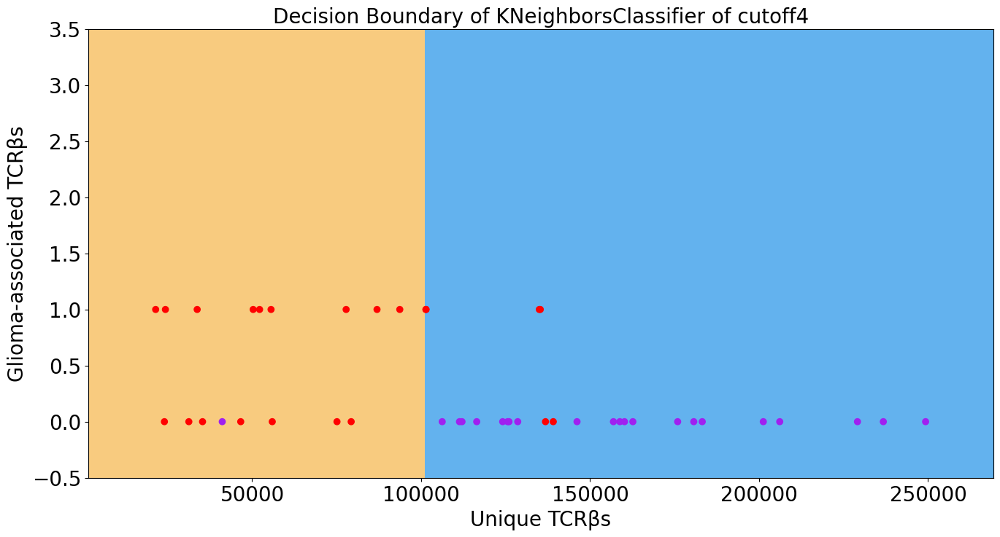

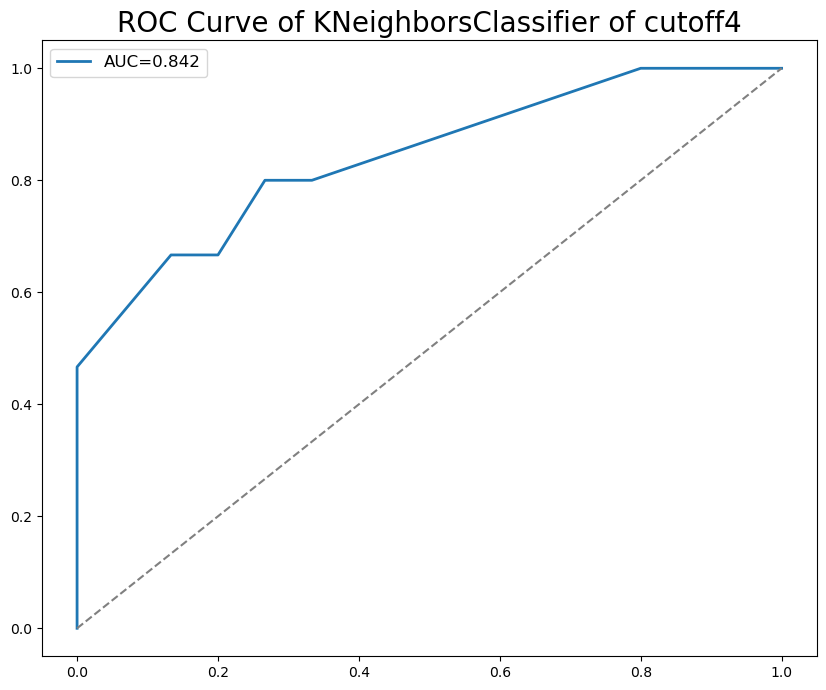

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 10
accuracy 0.7333333333333333


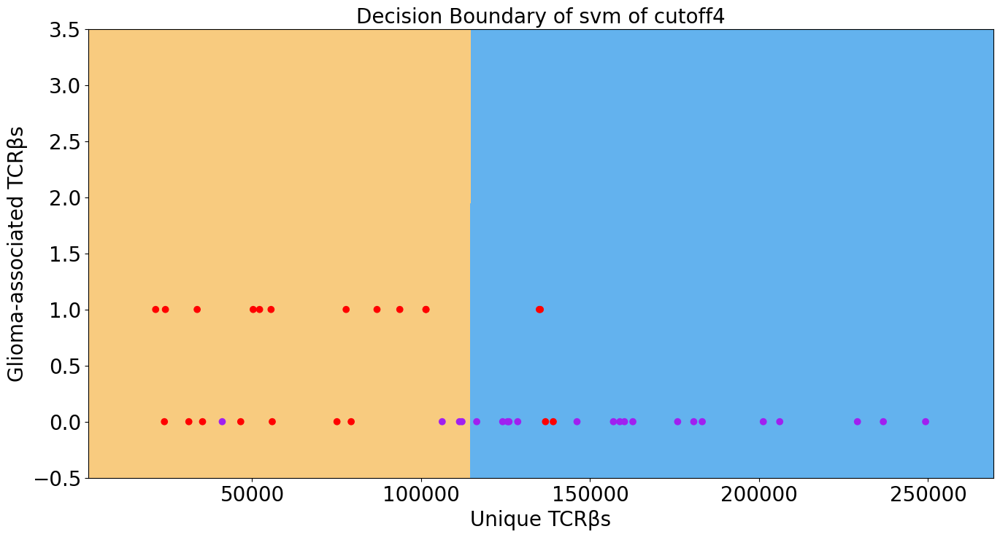

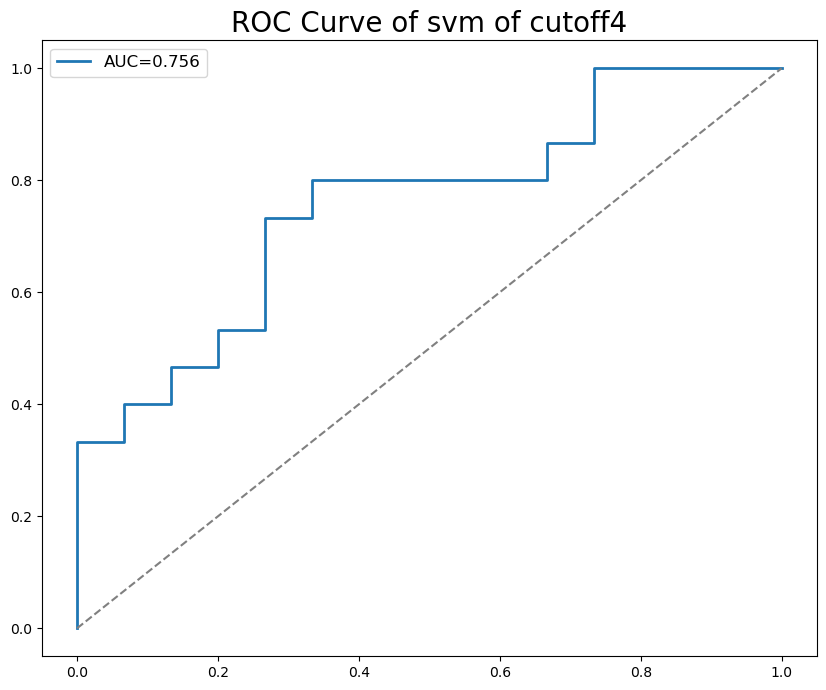

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 2
accuracy 0.8333333333333334


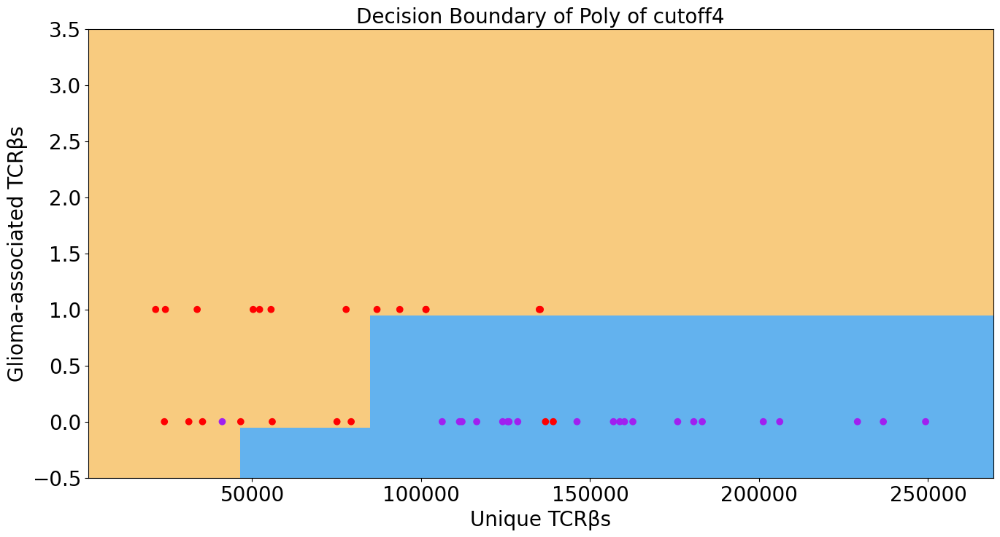

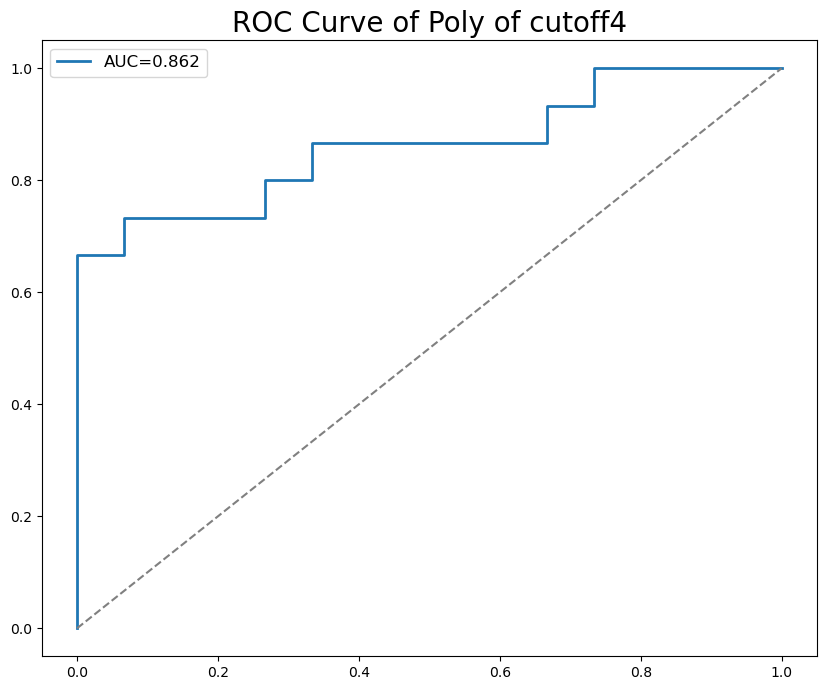

best_index 1
accuracy 0.5666666666666667


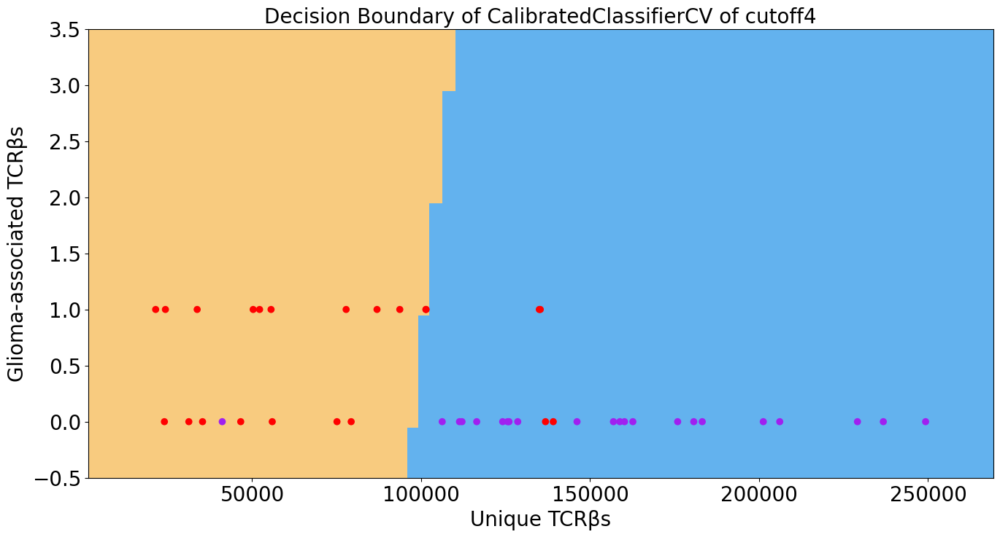

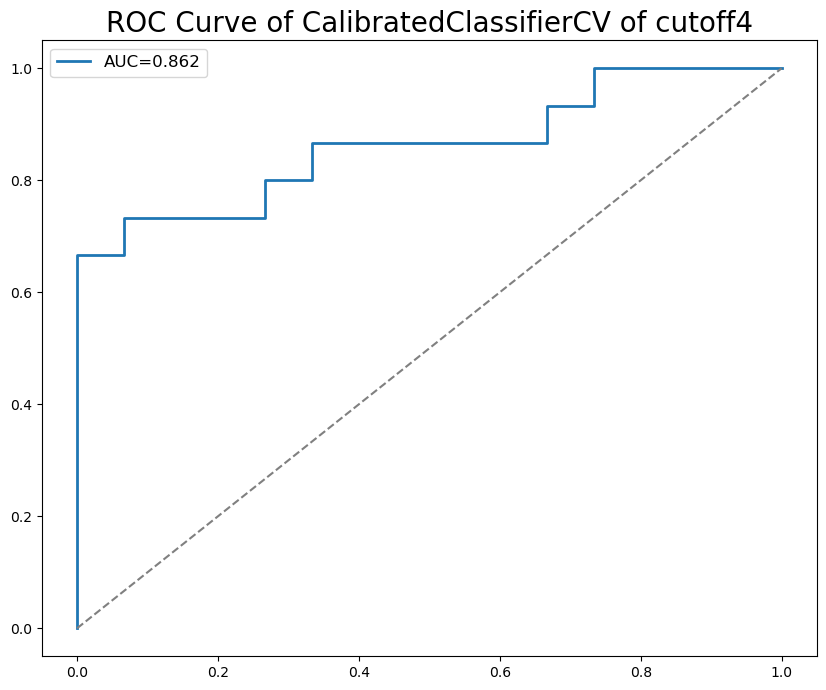

best_index 0
accuracy 0.5666666666666667


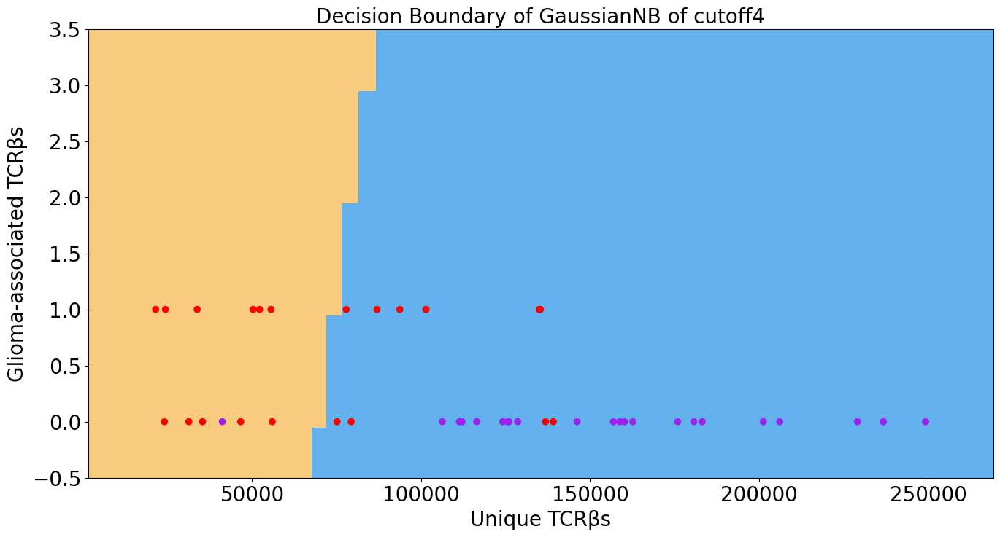

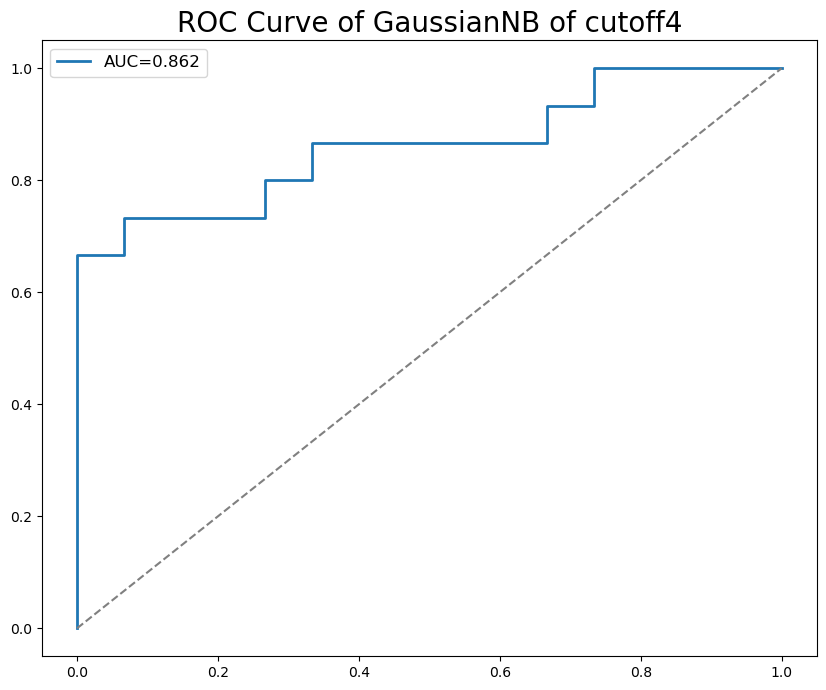

0:	learn: 0.6695560	total: 311us	remaining: 1.24ms
1:	learn: 0.6392864	total: 815us	remaining: 1.22ms
2:	learn: 0.6189313	total: 2.16ms	remaining: 1.44ms
3:	learn: 0.5885540	total: 2.4ms	remaining: 599us
4:	learn: 0.5616980	total: 2.62ms	remaining: 0us
best_index 3
accuracy 0.7666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


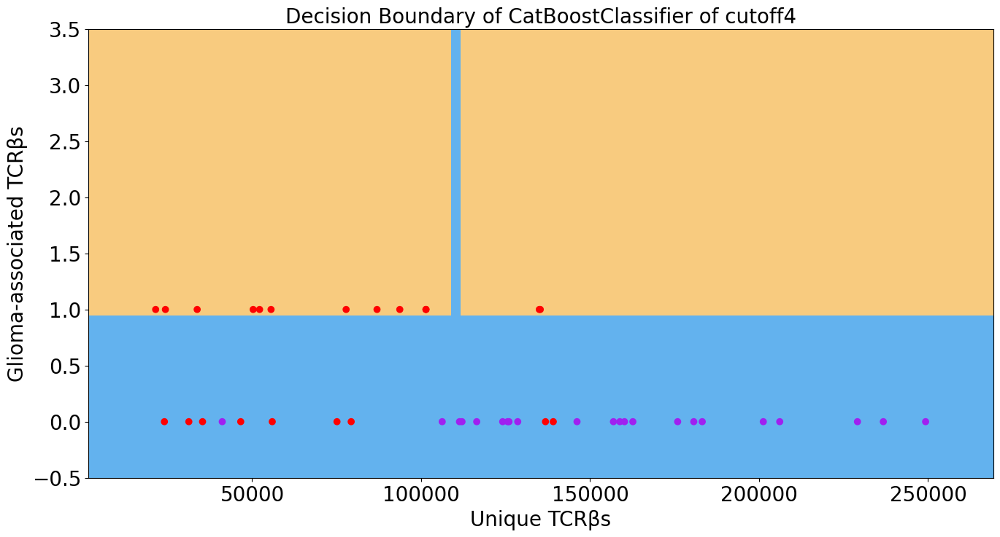

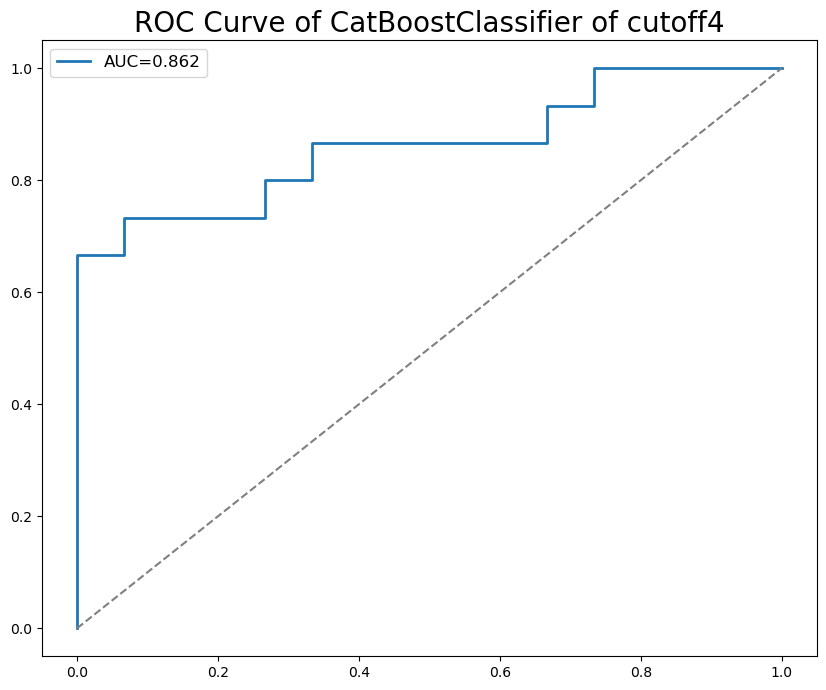

best_index 2
accuracy 0.6333333333333333


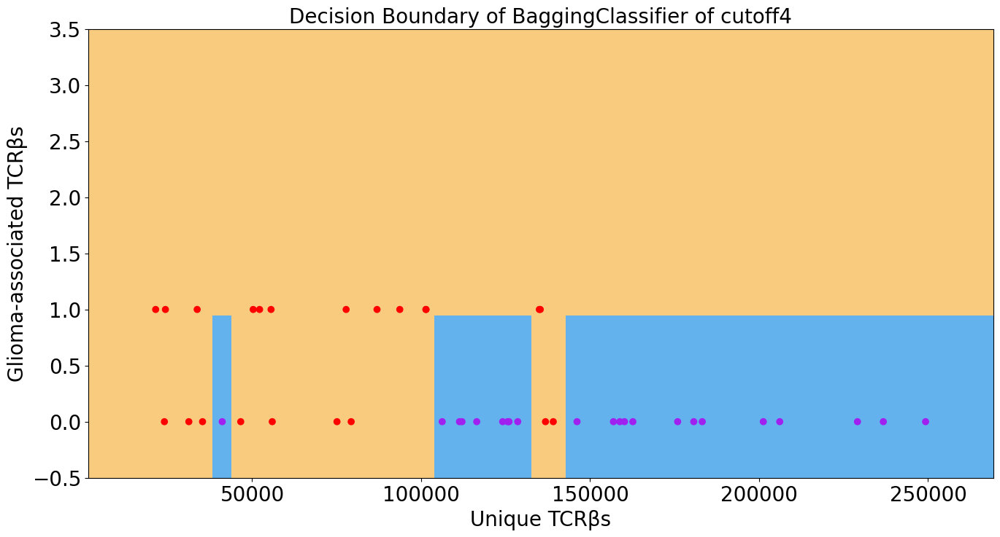

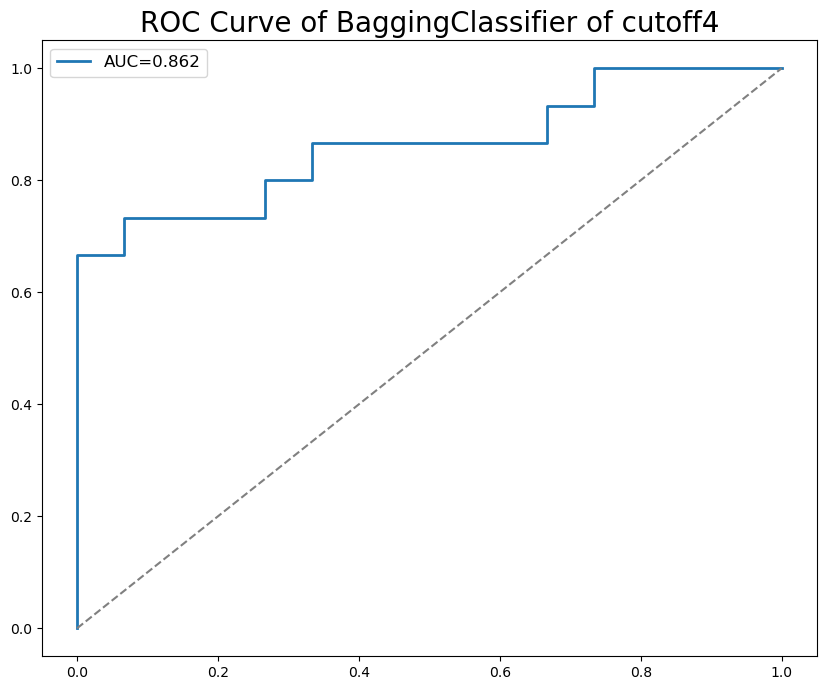

Epoch 1/100
2/2 [==============================] - 1s 360ms/step - loss: 0.5829 - accuracy: 0.8182 - auc_8: 0.9248 - precision_8: 0.8182 - recall_8: 0.8182 - val_loss: 0.6889 - val_accuracy: 0.6667 - val_auc_8: 0.5778 - val_precision_8: 0.6667 - val_recall_8: 0.6667
Epoch 2/100
2/2 [==============================] - 0s 20ms/step - loss: 0.5722 - accuracy: 0.8636 - auc_8: 0.9344 - precision_8: 0.8636 - recall_8: 0.8636 - val_loss: 0.6833 - val_accuracy: 0.6667 - val_auc_8: 0.5878 - val_precision_8: 0.6667 - val_recall_8: 0.6667
Epoch 3/100
2/2 [==============================] - 0s 23ms/step - loss: 0.5616 - accuracy: 0.8636 - auc_8: 0.9370 - precision_8: 0.8636 - recall_8: 0.8636 - val_loss: 0.6778 - val_accuracy: 0.6667 - val_auc_8: 0.6006 - val_precision_8: 0.6667 - val_recall_8: 0.6667
Epoch 4/100
2/2 [==============================] - 0s 20ms/step - loss: 0.5511 - accuracy: 0.8636 - auc_8: 0.9419 - precision_8: 0.8636 - recall_8: 0.8636 - val_loss: 0.6725 - val_accuracy: 0.6333 - va

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:376: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:377: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:376: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:377: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:376: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:377: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\U

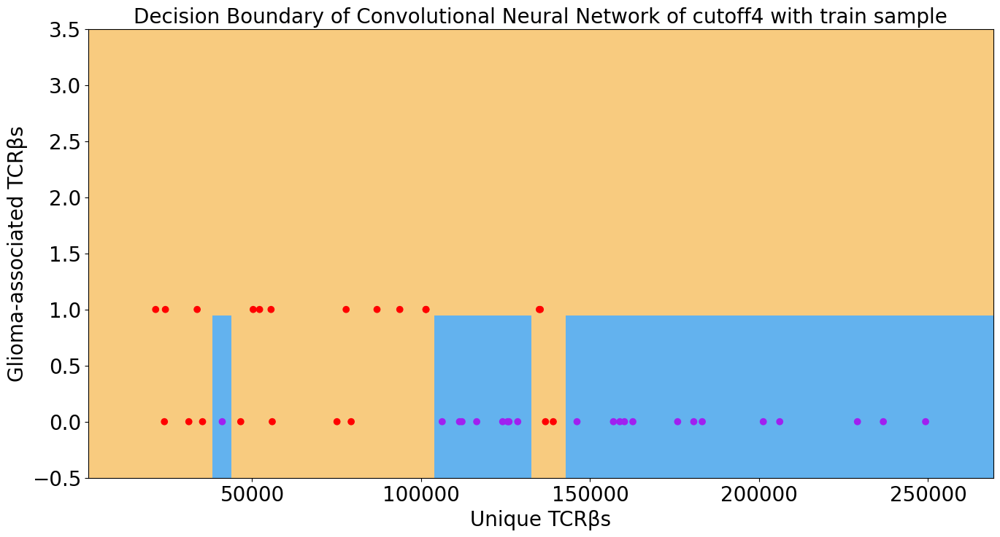

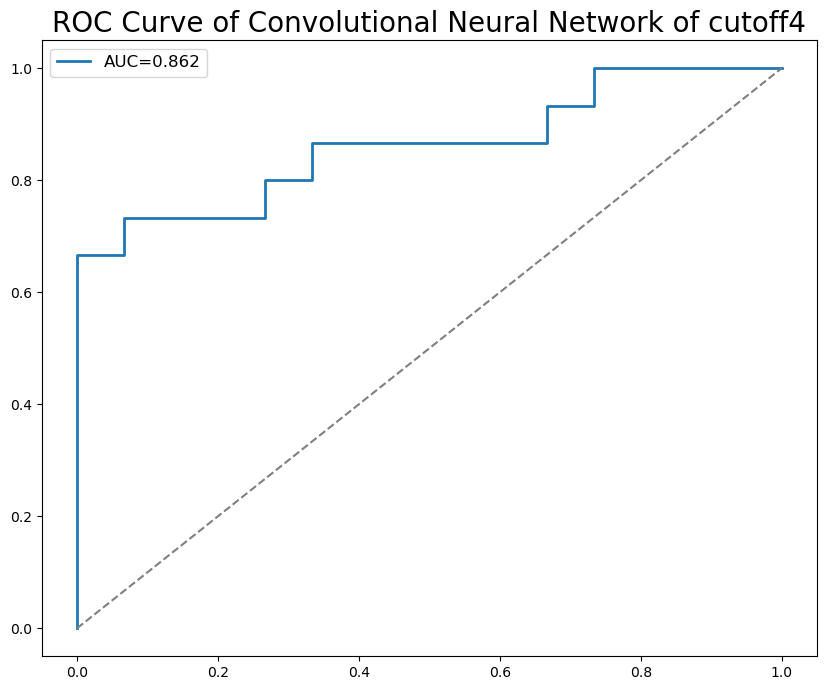

Epoch 1/100
2/2 [==============================] - 2s 368ms/step - loss: 0.6706 - accuracy: 0.5227 - auc_9: 0.6327 - precision_9: 0.5227 - recall_9: 0.5227 - val_loss: 0.5891 - val_accuracy: 0.7667 - val_auc_9: 0.8739 - val_precision_9: 0.7667 - val_recall_9: 0.7667
Epoch 2/100
2/2 [==============================] - 0s 24ms/step - loss: 0.5018 - accuracy: 0.9318 - auc_9: 0.9582 - precision_9: 0.9318 - recall_9: 0.9318 - val_loss: 0.4958 - val_accuracy: 0.8000 - val_auc_9: 0.8756 - val_precision_9: 0.8000 - val_recall_9: 0.8000
Epoch 3/100
2/2 [==============================] - 0s 27ms/step - loss: 0.3758 - accuracy: 0.9318 - auc_9: 0.9427 - precision_9: 0.9318 - recall_9: 0.9318 - val_loss: 0.4328 - val_accuracy: 0.8000 - val_auc_9: 0.8744 - val_precision_9: 0.8000 - val_recall_9: 0.8000
Epoch 4/100
2/2 [==============================] - 0s 27ms/step - loss: 0.2687 - accuracy: 0.9318 - auc_9: 0.9613 - precision_9: 0.9318 - recall_9: 0.9318 - val_loss: 0.4305 - val_accuracy: 0.8000 - va

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:463: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:464: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:463: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:464: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


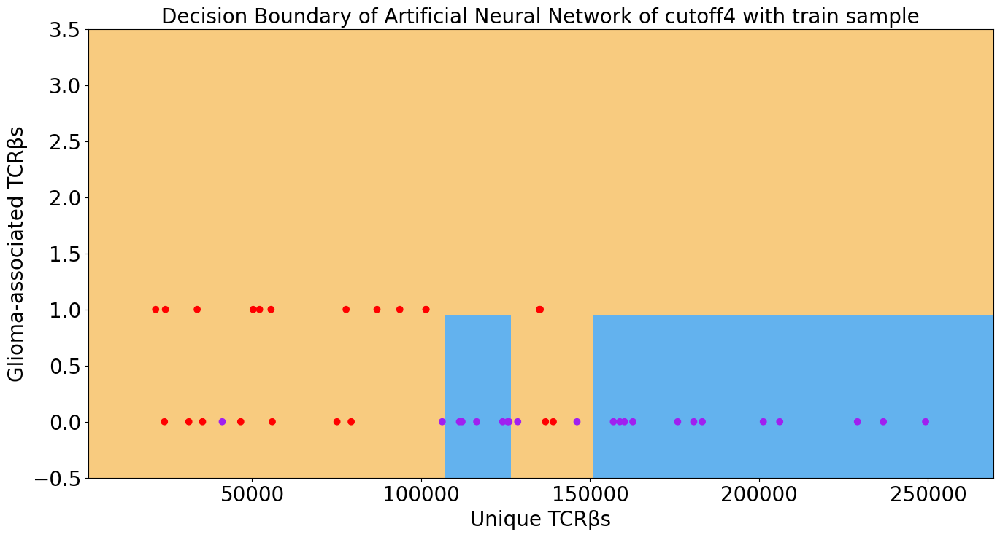

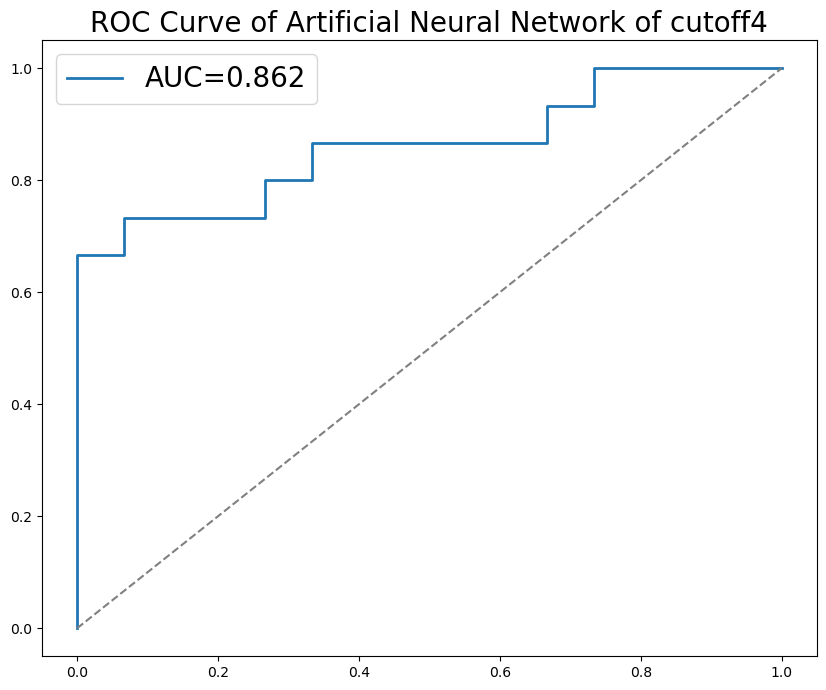

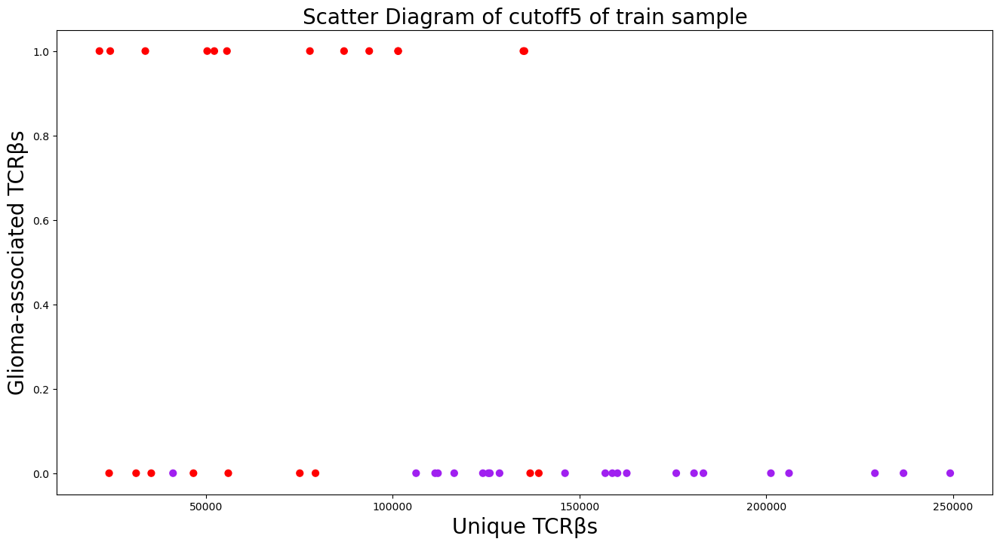

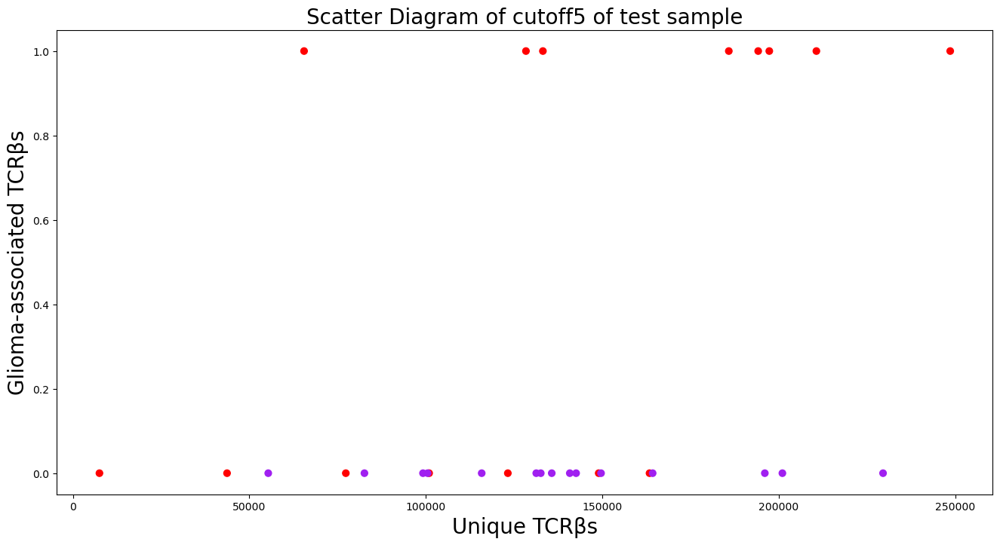

C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\linesearch.py:478: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")


0:	learn: 0.6695560	total: 287us	remaining: 1.15ms
1:	learn: 0.6392864	total: 717us	remaining: 1.07ms
2:	learn: 0.6189313	total: 1.05ms	remaining: 700us
3:	learn: 0.5885540	total: 1.23ms	remaining: 306us
4:	learn: 0.5616981	total: 1.44ms	remaining: 0us


C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\linesearch.py:478: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\ProgramData\Anaconda3\lib\site-packages\scipy\optimize\linesearch.py:327: LineSearchWarning: The line search algorithm did not converge
  warn('The line search algorithm did not converge', LineSearchWarning)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\optimize.py:203: UserWarning: Line Search failed
  warnings.warn("Line Search failed")
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 3
accuracy 0.6333333333333333


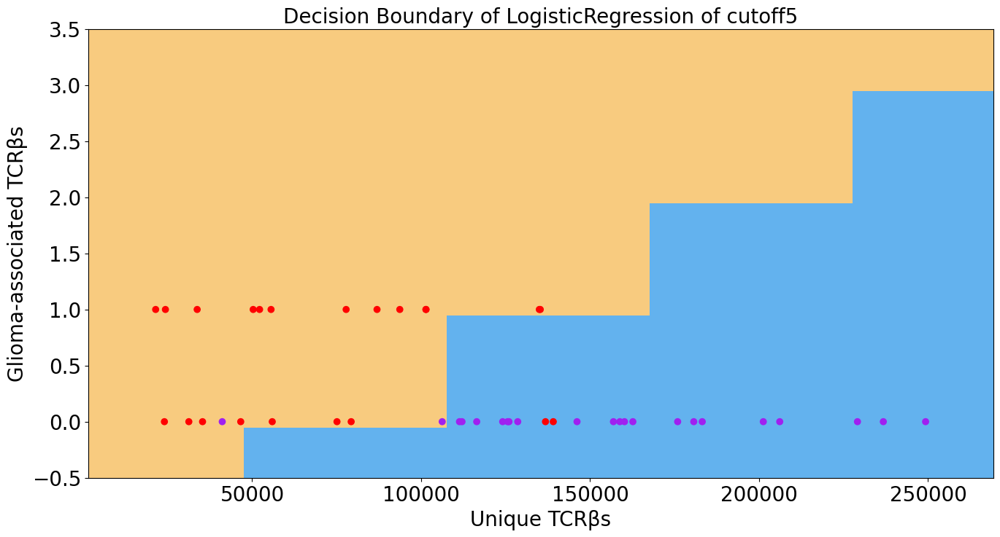

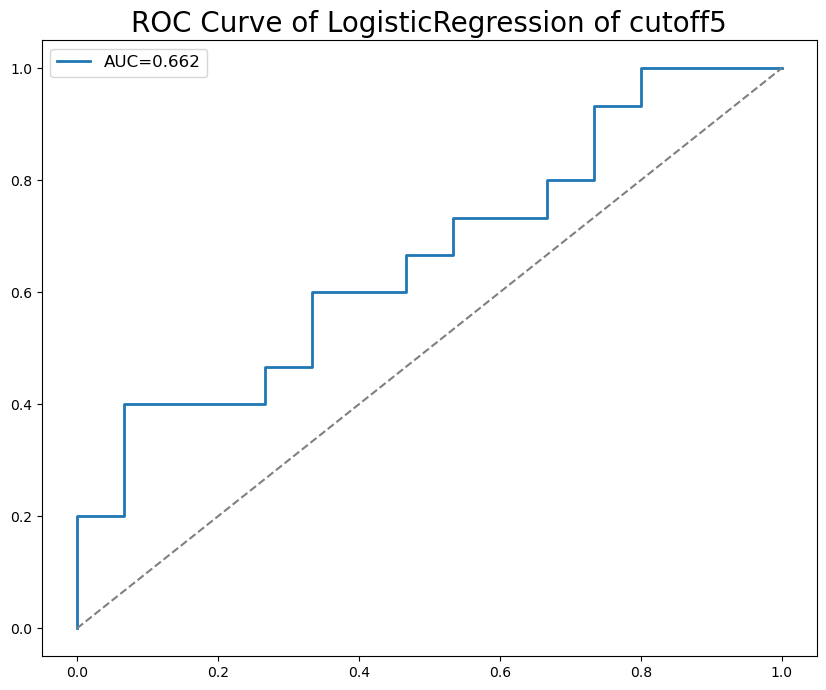

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 8
accuracy 0.7666666666666667


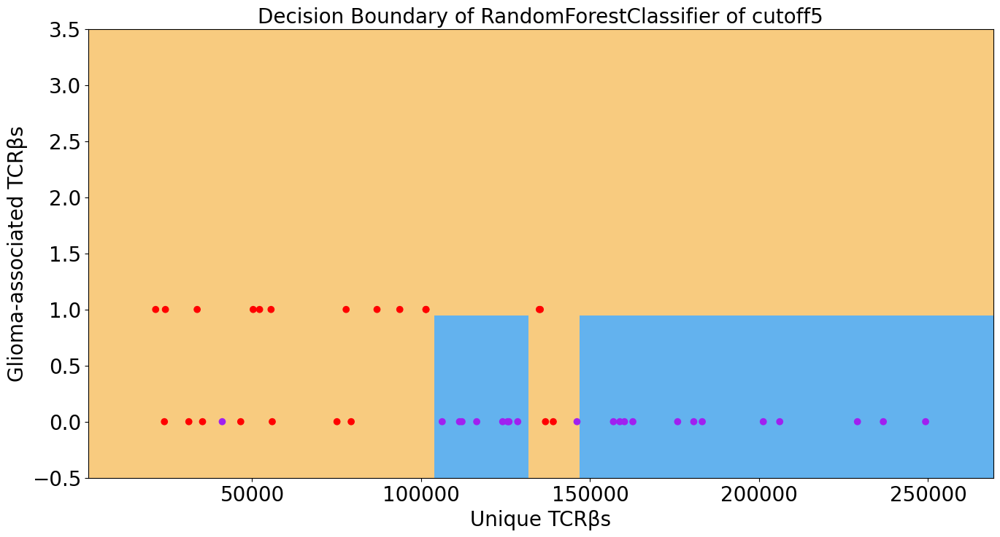

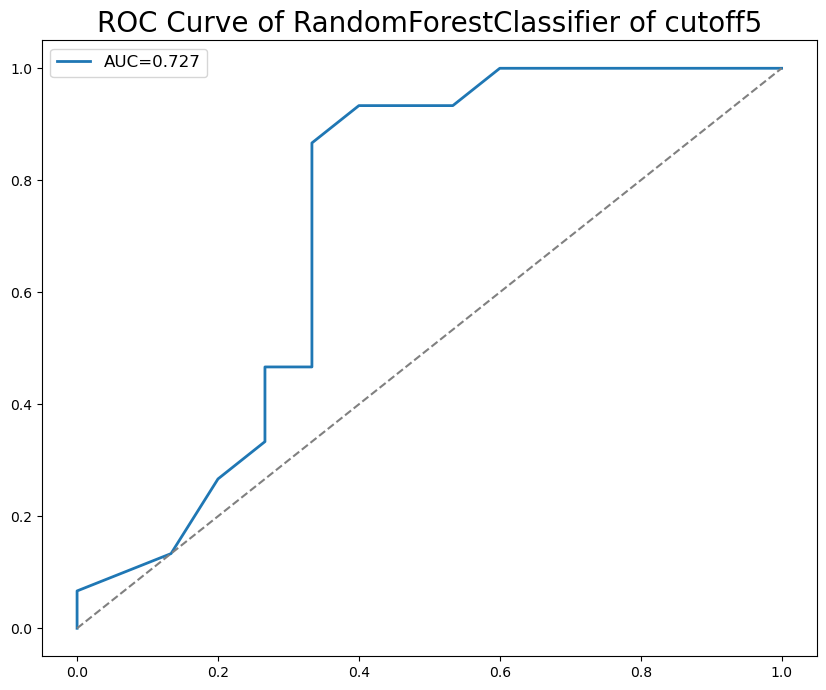

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 4
accuracy 0.7333333333333333


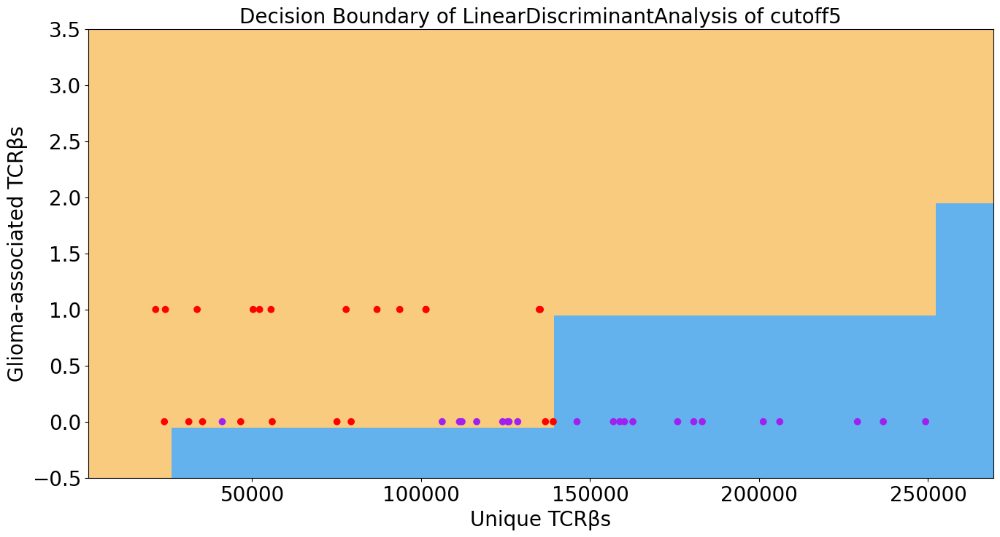

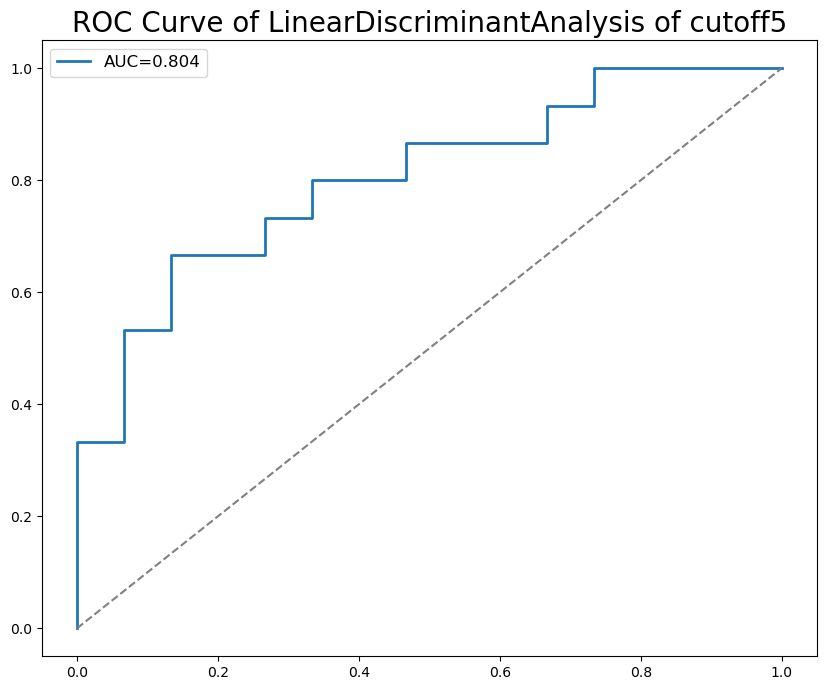

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 7
accuracy 0.7666666666666667


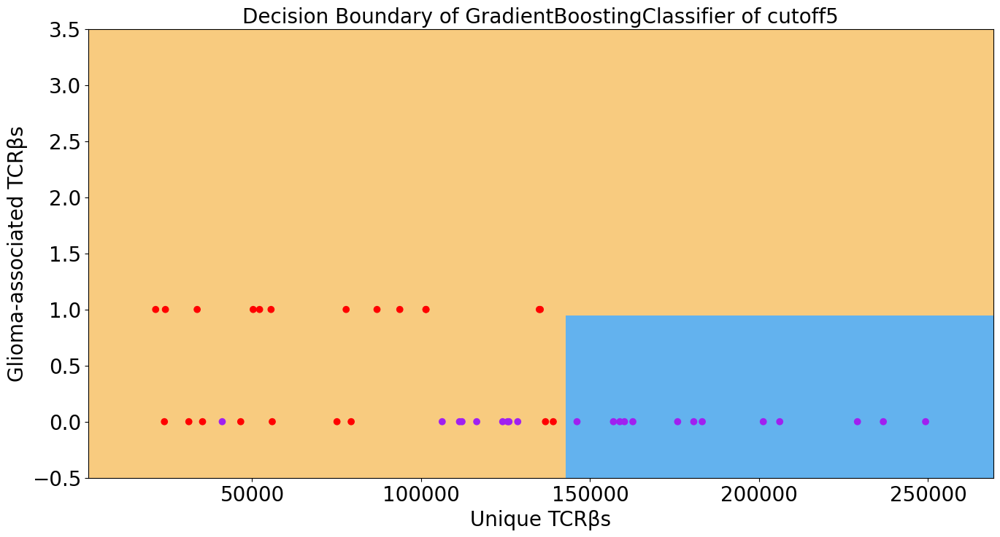

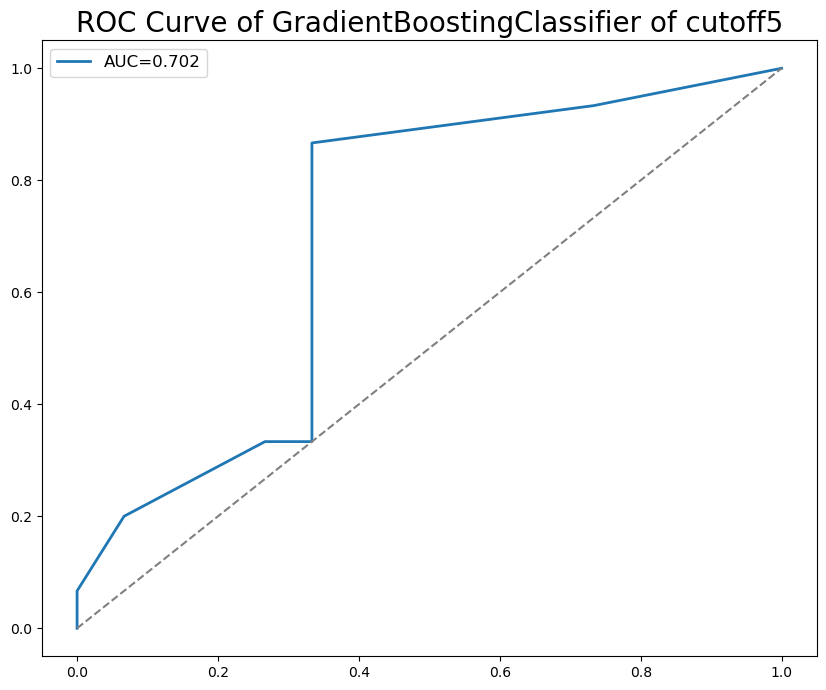

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 4
accuracy 0.7333333333333333


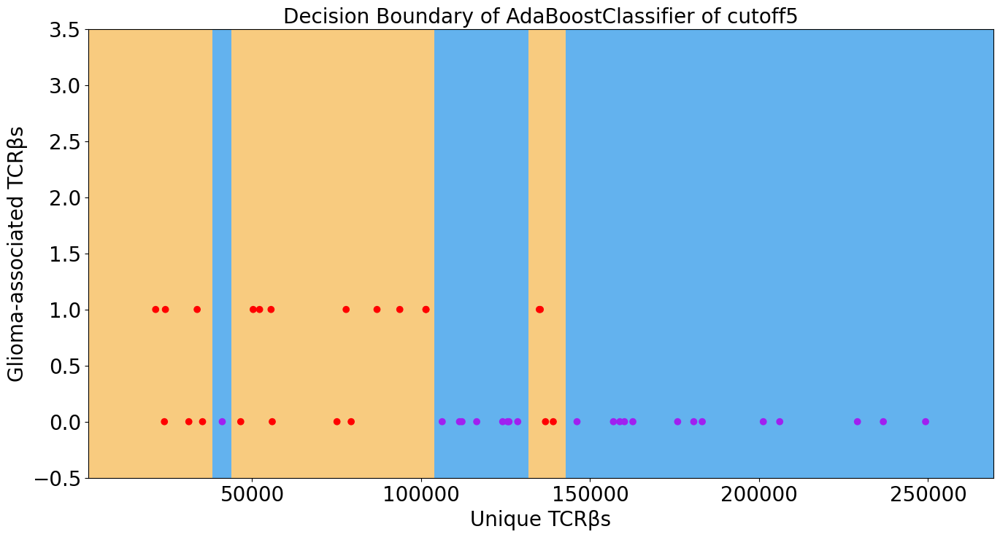

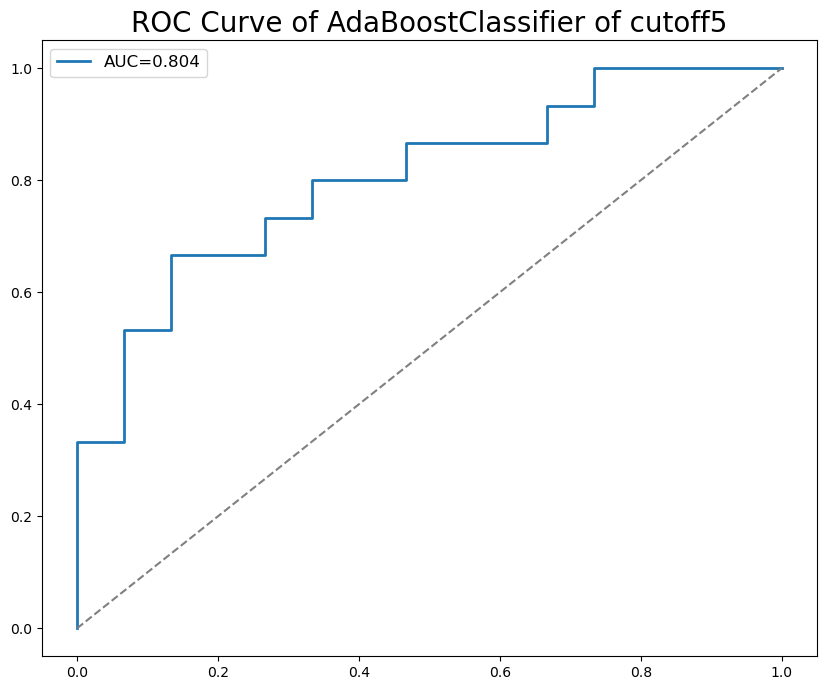

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 7
accuracy 0.7666666666666667


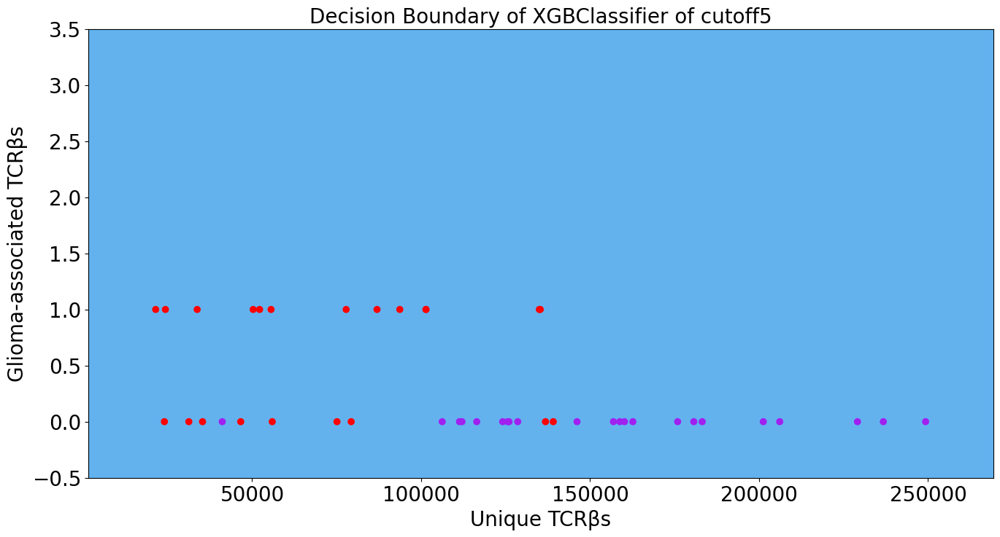

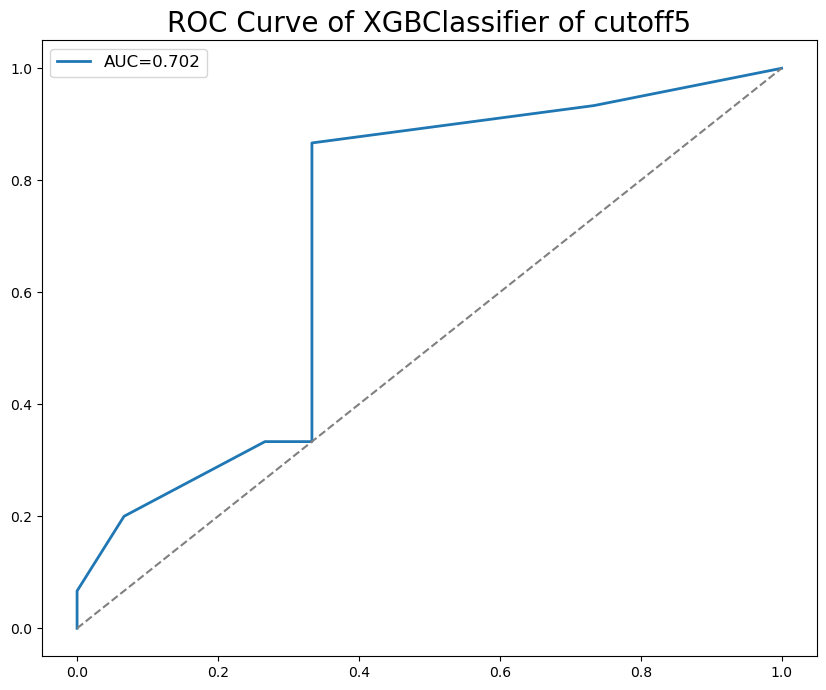

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.6333333333333333


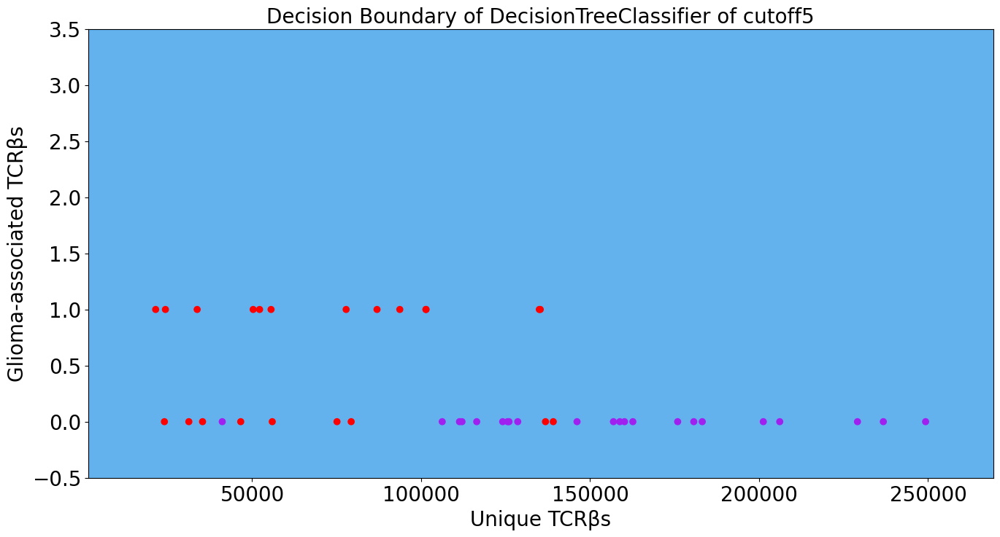

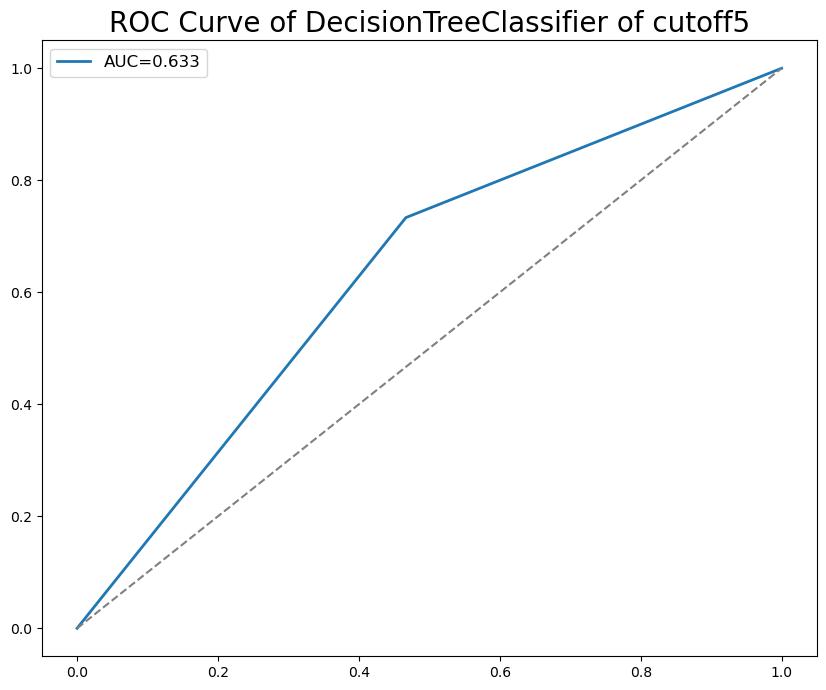

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 3
accuracy 0.7666666666666667


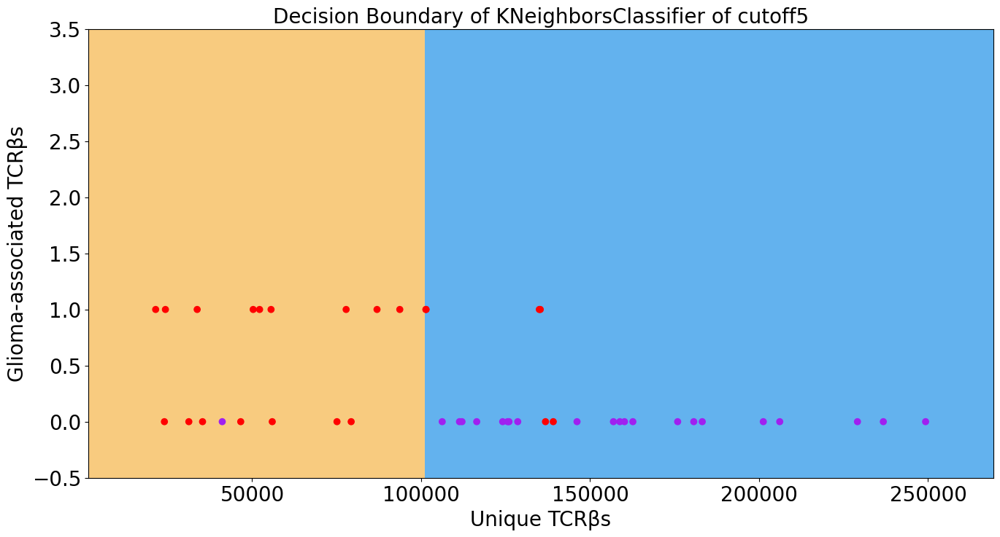

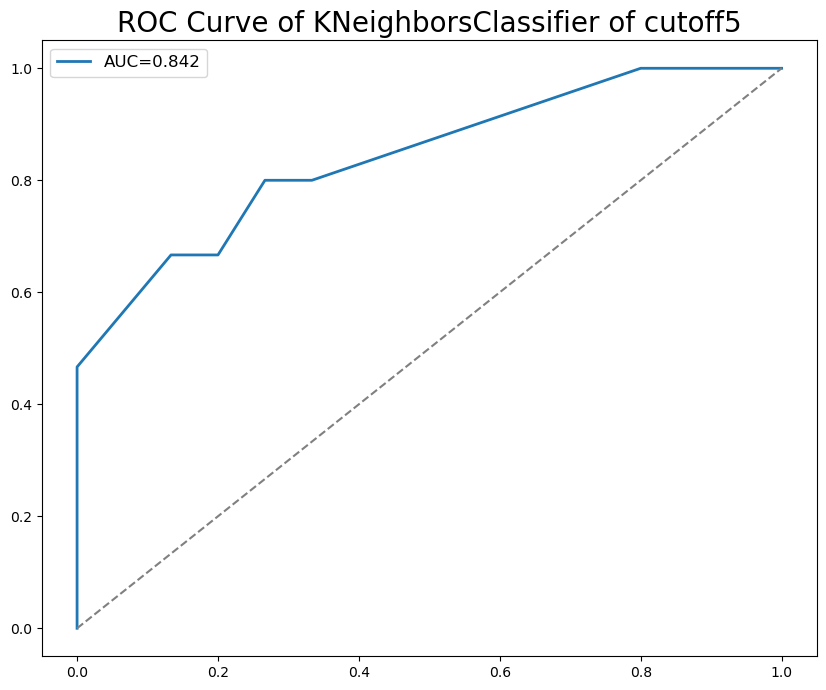

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 10
accuracy 0.7333333333333333


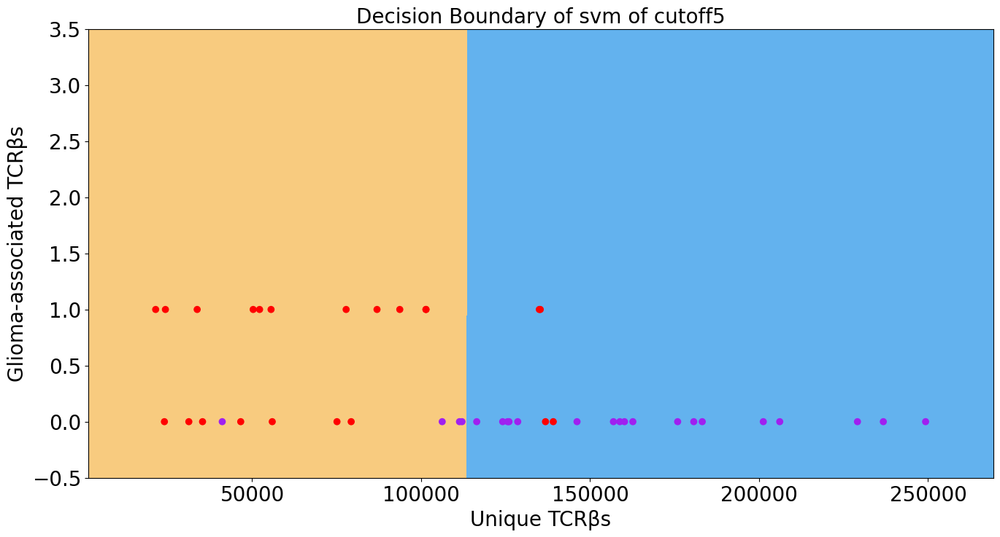

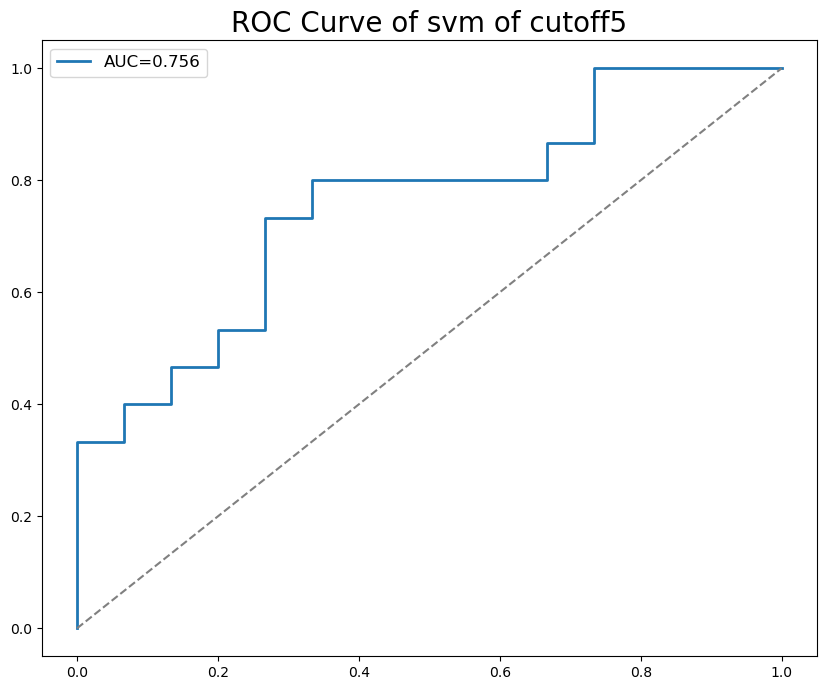

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 2
accuracy 0.8333333333333334


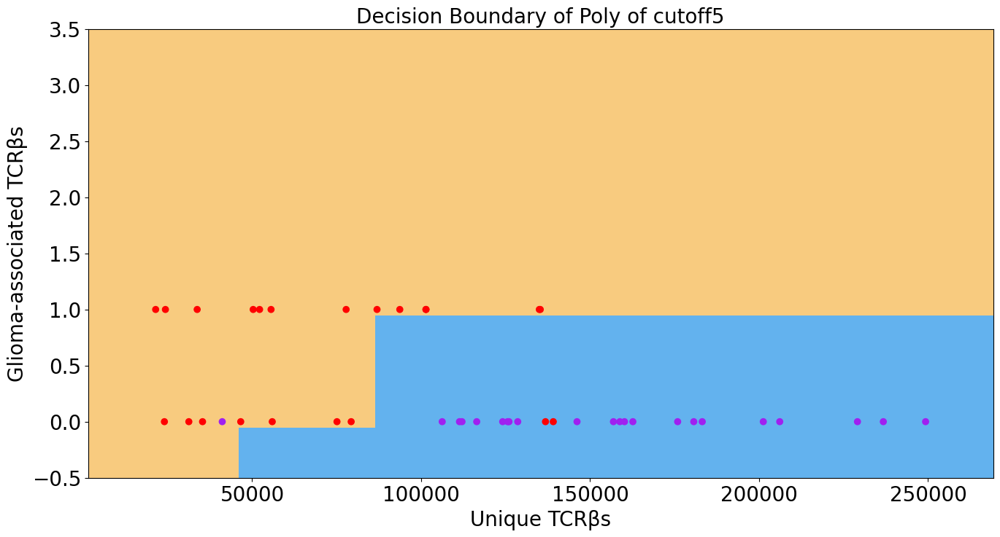

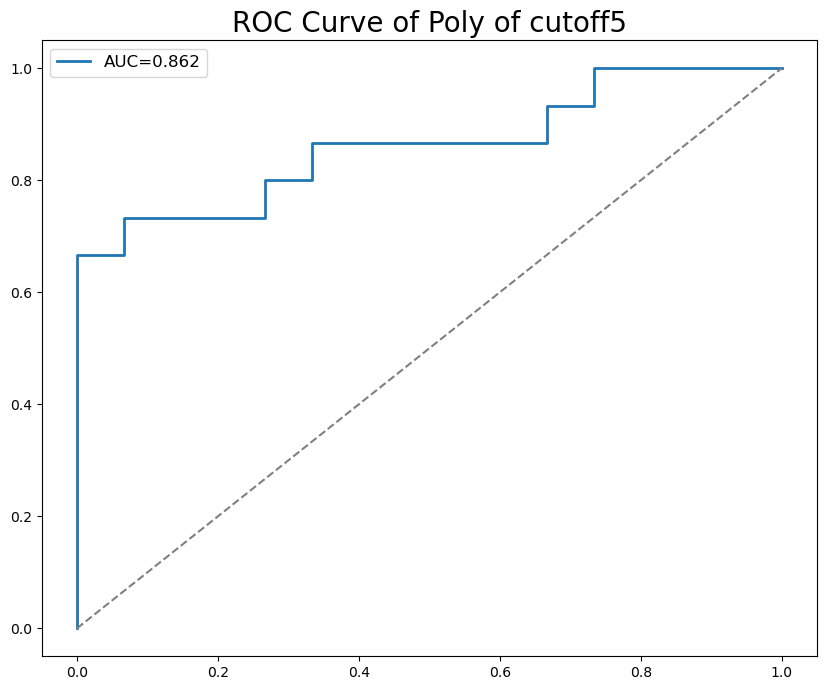

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.5666666666666667


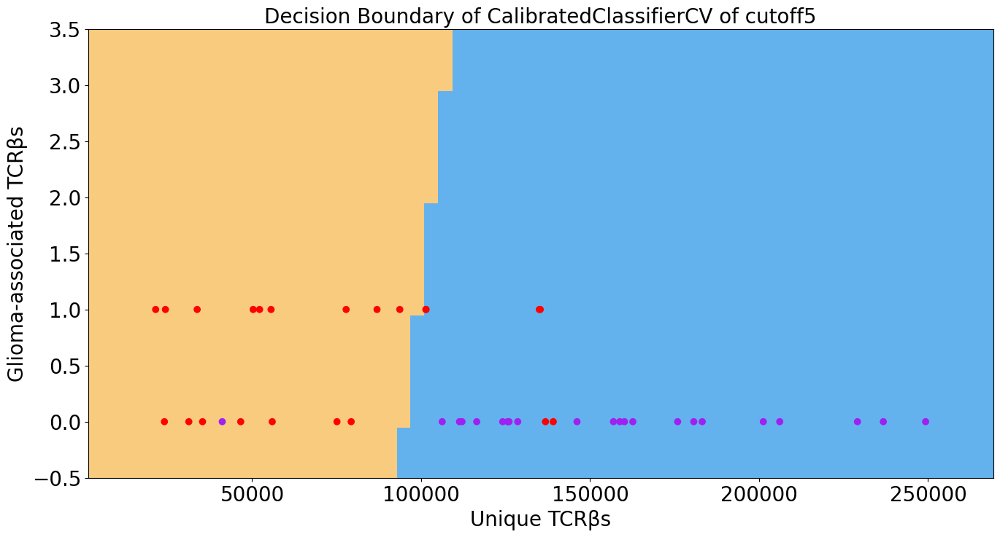

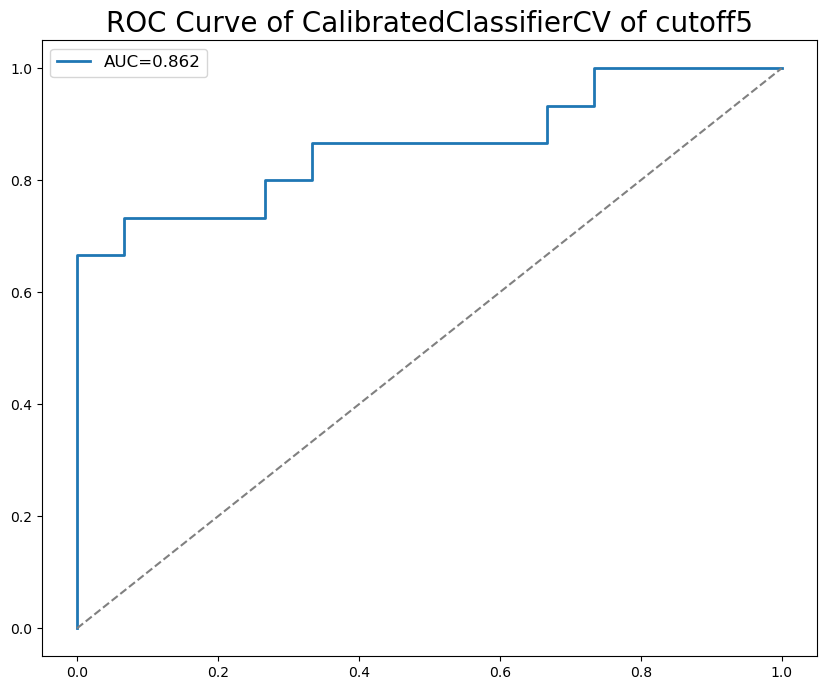

best_index 0
accuracy 0.5666666666666667


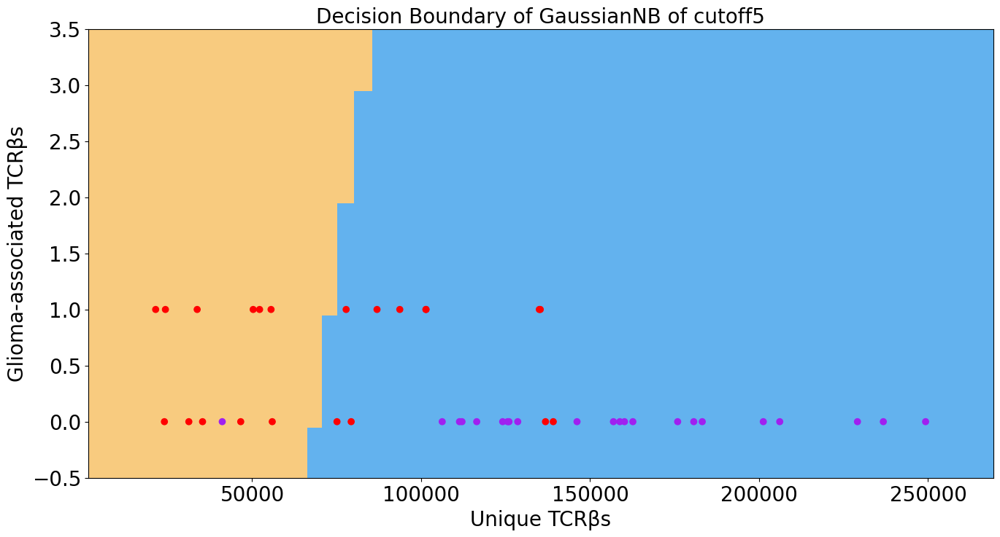

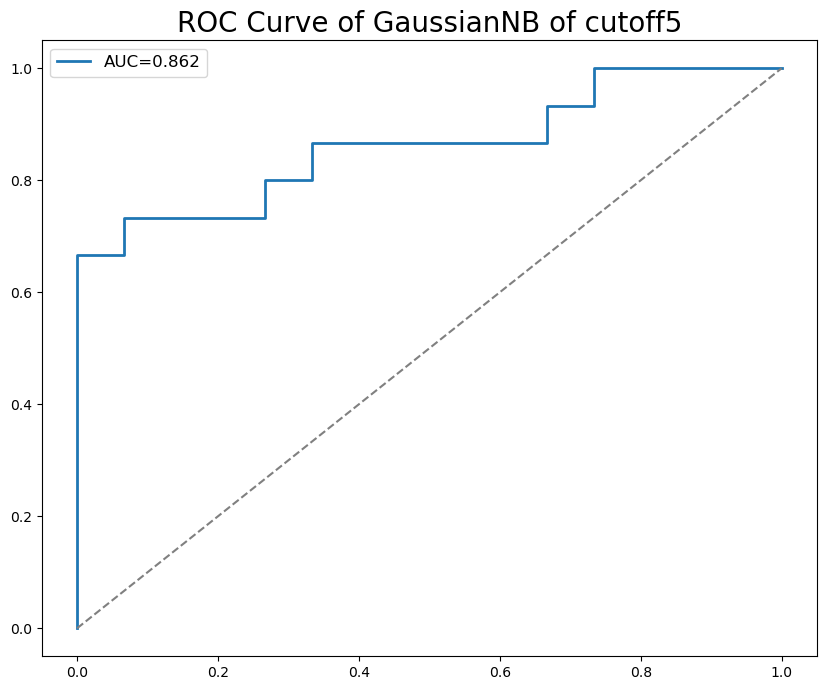

0:	learn: 0.6695560	total: 301us	remaining: 1.21ms
1:	learn: 0.6392864	total: 731us	remaining: 1.1ms
2:	learn: 0.6189313	total: 1.09ms	remaining: 726us
3:	learn: 0.5885540	total: 1.25ms	remaining: 311us
4:	learn: 0.5616981	total: 1.44ms	remaining: 0us
best_index 3
accuracy 0.7666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


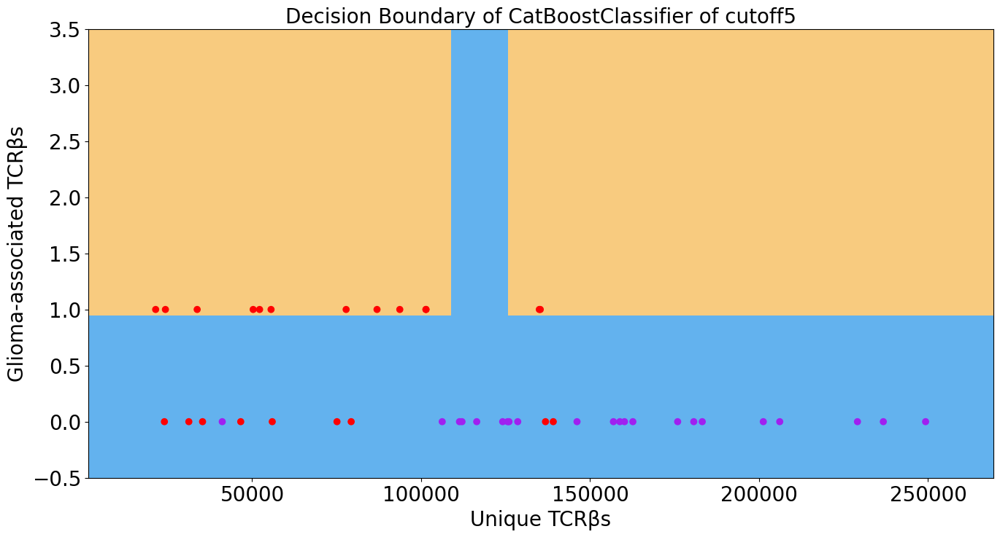

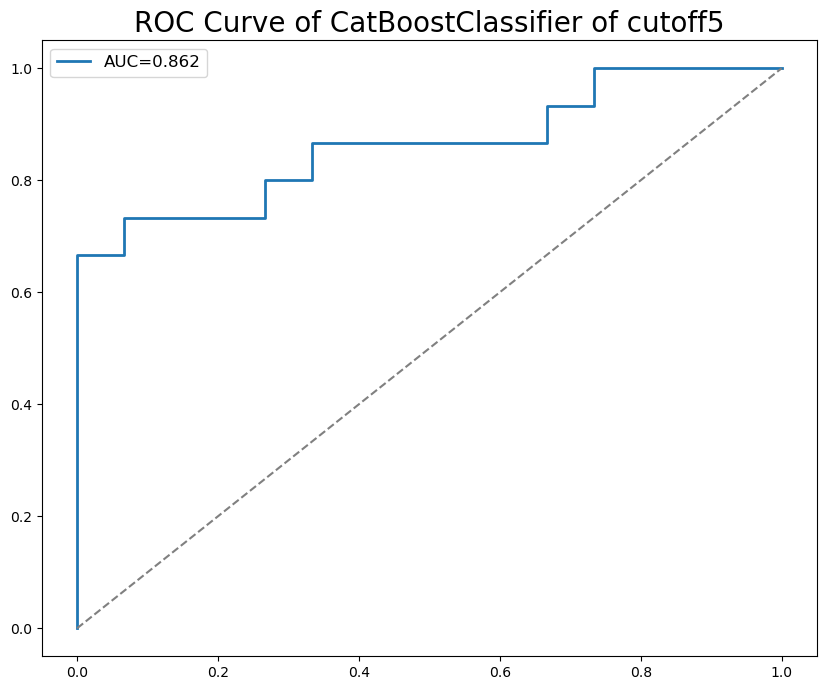

best_index 2
accuracy 0.6333333333333333


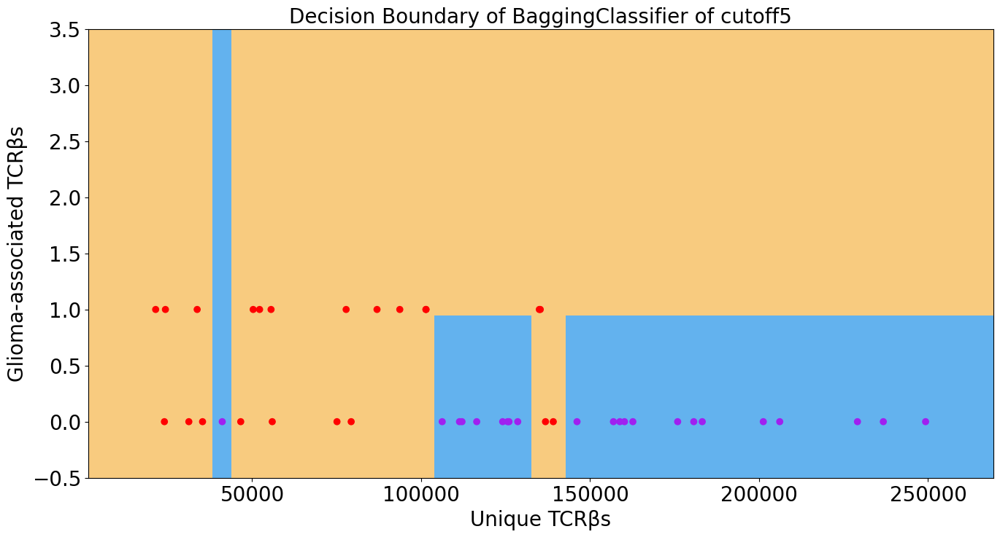

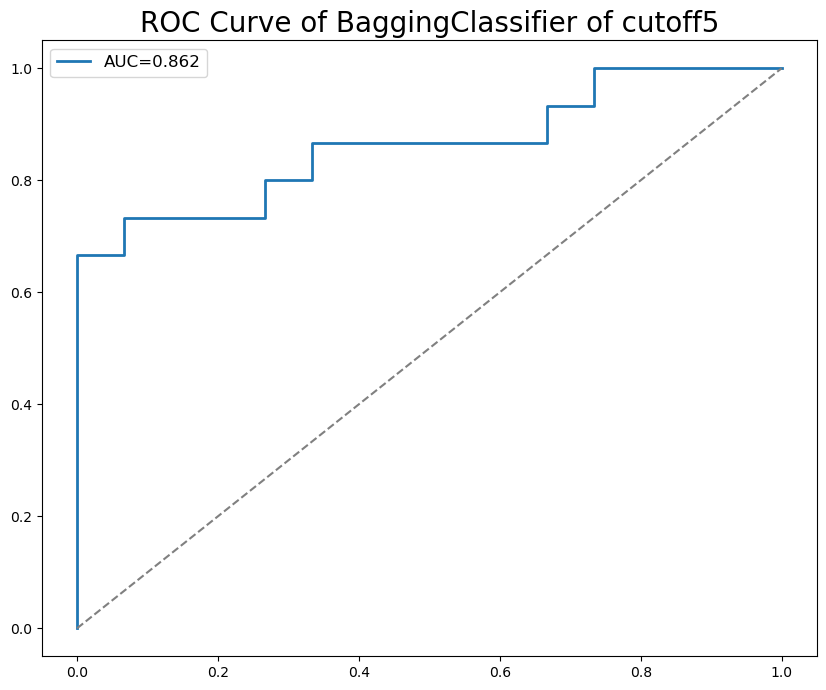

Epoch 1/100
2/2 [==============================] - 1s 360ms/step - loss: 0.7274 - accuracy: 0.5000 - auc_10: 0.5470 - precision_10: 0.5000 - recall_10: 0.5000 - val_loss: 0.6713 - val_accuracy: 0.5000 - val_auc_10: 0.6267 - val_precision_10: 0.5000 - val_recall_10: 0.5000
Epoch 2/100
2/2 [==============================] - 0s 21ms/step - loss: 0.7157 - accuracy: 0.5000 - auc_10: 0.5754 - precision_10: 0.5000 - recall_10: 0.5000 - val_loss: 0.6653 - val_accuracy: 0.5000 - val_auc_10: 0.6333 - val_precision_10: 0.5000 - val_recall_10: 0.5000
Epoch 3/100
2/2 [==============================] - 0s 23ms/step - loss: 0.7040 - accuracy: 0.5000 - auc_10: 0.5945 - precision_10: 0.5000 - recall_10: 0.5000 - val_loss: 0.6596 - val_accuracy: 0.5000 - val_auc_10: 0.6378 - val_precision_10: 0.5000 - val_recall_10: 0.5000
Epoch 4/100
2/2 [==============================] - 0s 20ms/step - loss: 0.6938 - accuracy: 0.5000 - auc_10: 0.6090 - precision_10: 0.5000 - recall_10: 0.5000 - val_loss: 0.6538 - val_

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:376: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:377: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:376: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:377: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:376: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:377: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\U

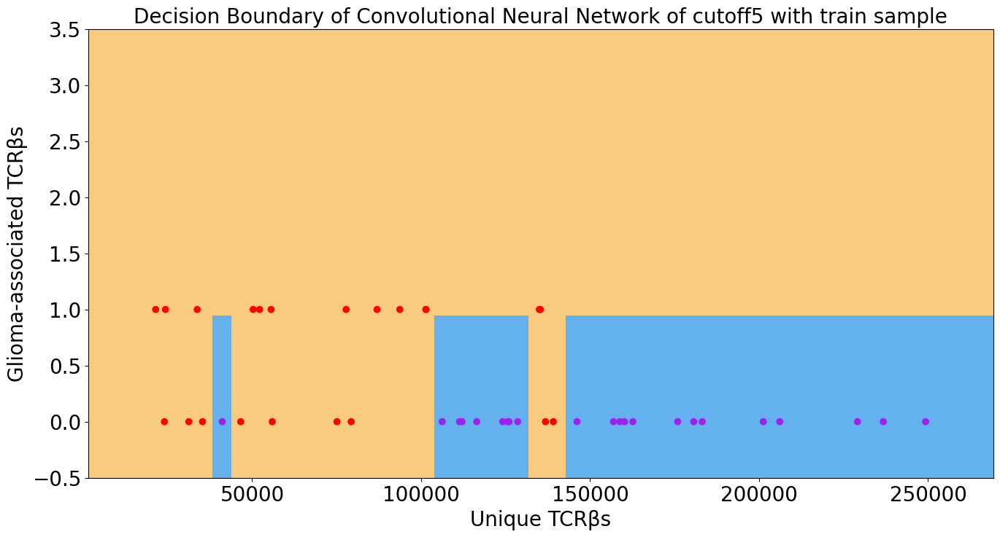

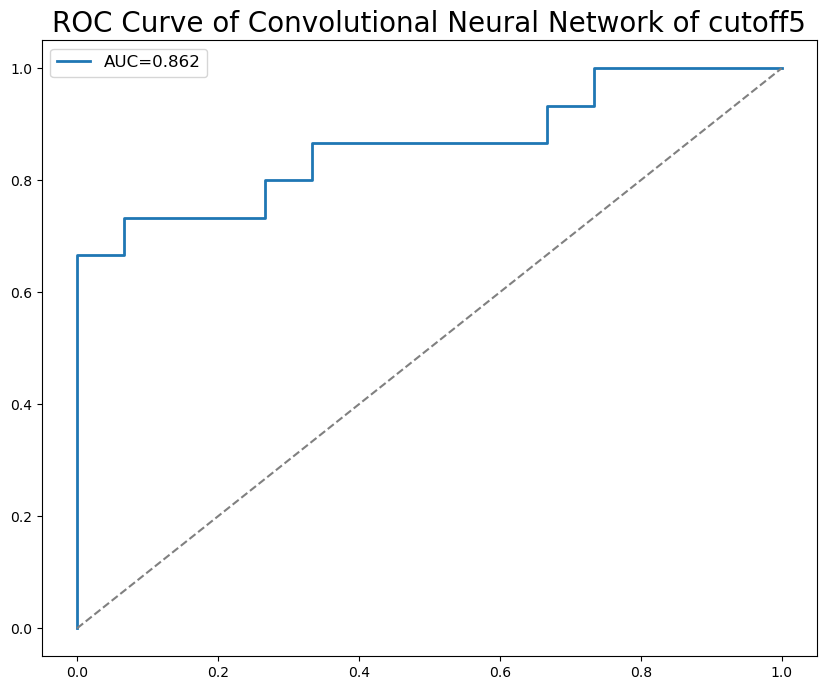

Epoch 1/100
2/2 [==============================] - 1s 369ms/step - loss: 0.6730 - accuracy: 0.6818 - auc_11: 0.7598 - precision_11: 0.6818 - recall_11: 0.6818 - val_loss: 0.6145 - val_accuracy: 0.7333 - val_auc_11: 0.8306 - val_precision_11: 0.7333 - val_recall_11: 0.7333
Epoch 2/100
2/2 [==============================] - 0s 24ms/step - loss: 0.5236 - accuracy: 0.9318 - auc_11: 0.9499 - precision_11: 0.9318 - recall_11: 0.9318 - val_loss: 0.5396 - val_accuracy: 0.7667 - val_auc_11: 0.8300 - val_precision_11: 0.7667 - val_recall_11: 0.7667
Epoch 3/100
2/2 [==============================] - 0s 25ms/step - loss: 0.3709 - accuracy: 0.9318 - auc_11: 0.9613 - precision_11: 0.9318 - recall_11: 0.9318 - val_loss: 0.4810 - val_accuracy: 0.7667 - val_auc_11: 0.8478 - val_precision_11: 0.7667 - val_recall_11: 0.7667
Epoch 4/100
2/2 [==============================] - 0s 27ms/step - loss: 0.2625 - accuracy: 0.9318 - auc_11: 0.9602 - precision_11: 0.9318 - recall_11: 0.9318 - val_loss: 0.4929 - val_

C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:463: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:464: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:463: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_253964\3865355982.py:464: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


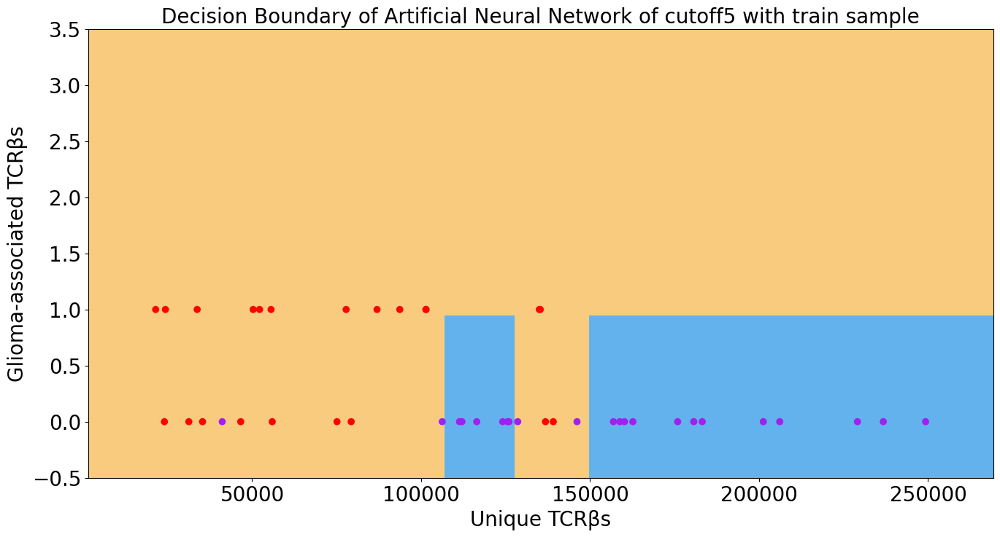

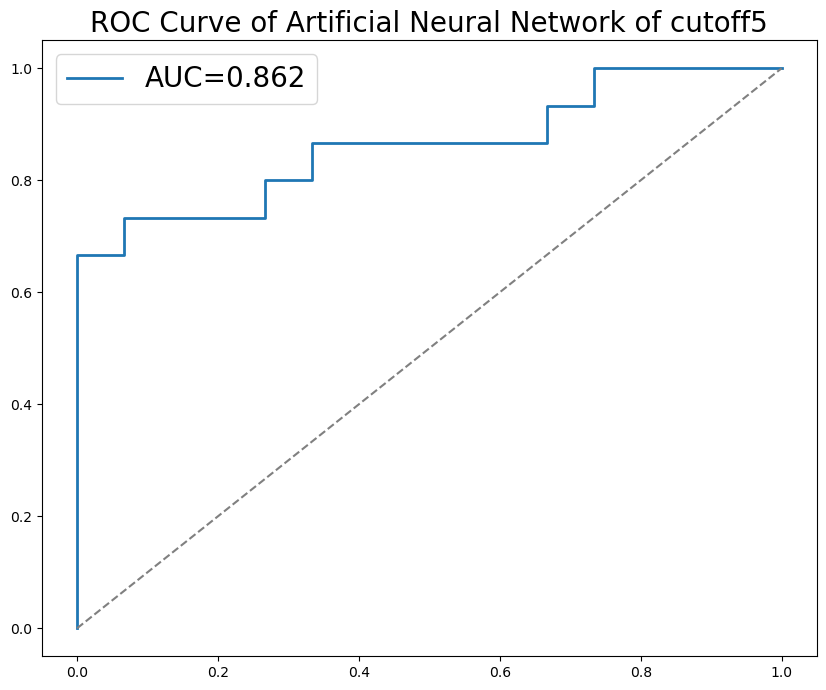

,cutoff,algorithm,best_thresthod,AUC,Accuracy,Sensitivity,Specificity,F1,FDR,Cross_entropy_loss
0,1,lr,8.135874e-08,0.902222,0.833333,0.733333,0.933333,0.083333,0.814815,5.693111
0,1,rf,3.761905e-01,0.975556,0.966667,0.933333,1.000000,0.000000,0.965517,0.192883
0,1,lda,3.365629e-02,0.928889,0.866667,0.800000,0.933333,0.076923,0.857143,0.899367
0,1,gbdt,2.190173e-05,0.933333,0.933333,0.933333,0.933333,0.066667,0.933333,0.715283
0,1,adb,3.365629e-02,0.928889,0.866667,0.800000,0.933333,0.076923,0.857143,0.899367
...,...,...,...,...,...,...,...,...,...,...
0,5,nb,8.573093e-01,0.524444,0.566667,0.200000,0.933333,0.250000,0.315789,1.446104
0,5,cbc,5.496580e-01,0.837778,0.766667,0.533333,1.000000,0.000000,0.695652,0.620082
0,5,bag,6.489097e-01,0.597778,0.633333,0.733333,0.533333,0.388889,0.666667,3.173694
0,5,CNN,4.100000e-01,0.853333,0.833333,0.733333,0.933333,0.083333,0.814815,0.458748


In [135]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import numpy as np
import struct
import sklearn
from sklearn import *
import matplotlib.pyplot as plt
from sklearn.datasets import make_moons
import numpy as np
import pandas as pd
import sklearn
import sklearn.metrics as metrics
from sklearn.metrics import plot_roc_curve,roc_curve,auc,roc_auc_score
from matplotlib.colors import ListedColormap
from sklearn.preprocessing import StandardScaler

# 第二步 绘制决策边界
def plot_decision_boundary(X,THRESHOLD,y,Xt,yt):#, y_pred
    x_min, x_max = X[:, 0].min() - 20000, X[:, 0].max() + 20000
    y_min, y_max = X[:, 1].min() - .5, X[:, 1].max() + 3    
    h = 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
    # 用预测函数预测一下
    markers = ('s','x','o','^','v')
    colors = ('#63b2ee','#f8cb7f','cyan','pink','lightgreen','gray','cyan') #A020F0 #前两个分别为阴性，阳性的区域的颜色：'cyan','pink'
    # 背景色
    cmap = ListedColormap(colors[:len(np.unique(y))])
    colors2 = ('#A020F0','red','#A020F0','red','lightgreen','gray','cyan') #前两个分别为阴性，阳性的点的颜色：'#A020F0','red'
    # 背景色
    cmap2 = ListedColormap(colors2[:len(np.unique(y))])   
    X_new = np.c_[xx.ravel(), yy.ravel()]#展开按行连接，生成的形状为（100000，2）
    #y_predict = np.where(clf.predict_proba(X)[:,1] >= THRESHOLD, 1, 0)#预测 
    #y_predict = clf.predict(X_new)
    y_predict = (clf.predict_proba(X_new)[:,1] >= THRESHOLD).astype(int)#0.259095242694766
    y_predict = np.array(y_predict)
    zz = y_predict.reshape(xx.shape)#重新变成（200，500）
    plt.contourf(xx, yy,zz, cmap=cmap)#背景色
    #训练样本散点图
    plt.scatter(X[:, 0], X[:, 1], c=y, cmap=cmap2)
    #测试样本散点图
#     plt.scatter(Xt[:, 0], Xt[:, 1], c=yt, cmap=cmap2)

dfs=pd.DataFrame() 
for i in range(1,6):
    data_train=pd.read_csv('data/Glioma_dimension2/merge_dimension2/AssociatedClones_train_Cutoff_1e-0%d.csv'%i)
    data_test=pd.read_csv('data/Glioma_dimension2/merge_dimension2/AssociatedClones_test_Cutoff_1e-0%d.csv'%i)
    data_train.drop(['Unnamed: 0'], axis=1, inplace=True)
    data_test.drop(['Unnamed: 0'], axis=1, inplace=True)
    
    #test
    Xt,yt=np.split(data_test,indices_or_sections=(2,),axis=1)
    Xt = Xt.values
    yt = yt.values
    #train
    X,y=np.split(data_train,indices_or_sections=(2,),axis=1)
    X = X.values
    y = y.values
    #标准化 可选 knn要 其他不用
    Xs = StandardScaler().fit_transform(X) 
    Xts = StandardScaler().fit_transform(Xt) 
    train_data,train_label,train_datas,train_labels=X,y,Xs,y
    test_data,test_label,test_datas,test_labels=Xt,yt,Xts,yt

    #绘制train并保存散点图
    np.random.seed(0)
    plt.figure(figsize=(16, 8))
    plt.xlabel('Unique TCRβs',size=20)
    plt.ylabel('Glioma-associated TCRβs',size=20)
    plt.title("Scatter Diagram of cutoff%d of train sample"%i,size=20)
    colors2 = ('#A020F0','red','#A020F0','red','lightgreen','gray','cyan')
    cmap2 = ListedColormap(colors2[:len(np.unique(y))])
    plt.scatter(X[:, 0], X[:, 1], s=40, c=y, cmap=cmap2)#plt.cm.Spectral
    plt.savefig("C:/Users/Administrator/Desktop/分类_脑胶质瘤/结果数据与图片/最终版figure整理/figure2/区域算法划分图/cutoff%d/train_sample/散点图_cutoff%d"%(i,i))
    plt.show()
    
    #绘制test并保存散点图
    np.random.seed(0)
    plt.figure(figsize=(16, 8))
    plt.xlabel('Unique TCRβs',size=20)
    plt.ylabel('Glioma-associated TCRβs',size=20)
    plt.title("Scatter Diagram of cutoff%d of test sample"%i,size=20)
    colors2 = ('#A020F0','red','#A020F0','red','lightgreen','gray','cyan')
    cmap2 = ListedColormap(colors2[:len(np.unique(yt))])
    plt.scatter(Xt[:, 0], Xt[:, 1], s=40, c=yt, cmap=cmap2)#plt.cm.Spectral
    plt.savefig("C:/Users/Administrator/Desktop/分类_脑胶质瘤/结果数据与图片/最终版figure整理/figure2/区域算法划分图/cutoff%d/test_sample/散点图_cutoff%d"%(i,i))
    plt.show()
    
    #训练模型
    #训练模型
    # LR
    from sklearn.linear_model import LogisticRegressionCV
    from sklearn.linear_model import LogisticRegression
    lr_clf = LogisticRegression(multi_class='multinomial',solver='newton-cg',class_weight='balanced',max_iter=10000)
    #clf = LogisticRegression(multi_class='multinomial',solver='lbfgs',class_weight='balanced',max_iter=10000)
    #lr_clf = LogisticRegression()
    
    #svm linear
    from sklearn.svm import SVC
    svm_clf=SVC(kernel='linear', probability=True,random_state=10)#使用核函数为线性核，参数默认，创建分类器 

    #SVM poly
    from sklearn.svm import SVC
    import sklearn
    from sklearn.preprocessing import PolynomialFeatures, StandardScaler
    from sklearn.svm import LinearSVC
    from sklearn.pipeline import Pipeline
    def PolynomialSVC(degree, C=1.0):
        return Pipeline([
            ('poly', PolynomialFeatures(degree=degree)),
            ('std)scaler', StandardScaler()),
            ('linearSVC', LinearSVC(C=C))
        ])
    svm = PolynomialSVC(degree=3)
    from sklearn.calibration import CalibratedClassifierCV
    poly_clf = CalibratedClassifierCV(svm) 

    #KNN
    from sklearn.neighbors import KNeighborsClassifier
    knn_clf = KNeighborsClassifier(n_neighbors=10)

    #RF
    from sklearn.linear_model import LogisticRegressionCV
    from sklearn.ensemble import RandomForestClassifier #分类器
    rf_clf = RandomForestClassifier(n_estimators = 210) #训练100个基分类器

    #LDA
    from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
    from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
    lda_clf = LinearDiscriminantAnalysis() 

    #GBDT
    from sklearn.ensemble import GradientBoostingClassifier #GBDT算法
    gbdt_clf = GradientBoostingClassifier() 

    #AdaBoost
    from sklearn.ensemble import AdaBoostClassifier
    adb_clf = AdaBoostClassifier(n_estimators=100) #迭代100次

    #xgboost
    import xgboost as xgb
    from xgboost.sklearn import XGBClassifier
    xgb_clf = XGBClassifier()

    #decision tree
    from sklearn.tree import DecisionTreeClassifier
    dt_clf = DecisionTreeClassifier()
    
    #bays
    from sklearn.model_selection import StratifiedShuffleSplit
    from sklearn.naive_bayes import GaussianNB
    from sklearn.metrics import confusion_matrix
    nb_clf = GaussianNB()

    #CalibratedClassifierCV
    from sklearn.naive_bayes import GaussianNB
    from sklearn.calibration import CalibratedClassifierCV
    # 创建高斯朴素贝叶斯实例
    clf = GaussianNB()
    # 使用sigmoid校准创建校准交叉验证
    # clf_sigmoid = CalibratedClassifierCV(clf, cv=2, method='sigmoid')
    cv_clf = CalibratedClassifierCV(clf, cv=2, method='sigmoid')

    #CatBoostClassifier
    import catboost as cb
    from catboost import CatBoostClassifier
    from sklearn import metrics
    from sklearn.model_selection import train_test_split
    cbc_clf=CatBoostClassifier(iterations=5, learning_rate=0.1)

    #BaggingClassifier
    from sklearn.tree import DecisionTreeClassifier
    from sklearn.ensemble import BaggingClassifier
    from sklearn.model_selection import train_test_split
    dt = DecisionTreeClassifier(random_state=1)
    bag_clf=BaggingClassifier(base_estimator=dt, 
            n_estimators=50, random_state=1) 
    
    #神经网络算法

    #训练模型
    lr_clf.fit(train_data,train_label.astype('int').ravel())
    rf_clf.fit(train_datas,train_labels.astype('int').ravel())
    lda_clf.fit(train_data,train_label.astype('int').ravel())
    gbdt_clf.fit(train_datas,train_labels.astype('int').ravel())
    adb_clf.fit(train_data,train_label.astype('int').ravel())
    xgb_clf.fit(train_datas,train_labels.astype('int').ravel())
    dt_clf.fit(train_data,train_label.astype('int').ravel())
    knn_clf.fit(train_datas,train_labels.astype('int').ravel())
    svm_clf.fit(train_datas,train_labels.astype('int').ravel())
    poly_clf.fit(train_data,train_label.astype('int').ravel())
    nb_clf.fit(train_data,train_label.astype('int').ravel())
    cv_clf.fit(train_data,train_label.astype('int').ravel())
    cbc_clf.fit(train_data,train_label.astype('int').ravel())
    bag_clf.fit(train_data,train_label.astype('int').ravel())

    #prob 预测
    score_lr = lr_clf.predict_proba(test_data)[:,1]
    score_rf = rf_clf.predict_proba(test_datas)[:,1]
    score_lda = lda_clf.predict_proba(test_data)[:,1]
    score_gbdt = gbdt_clf.predict_proba(test_datas)[:,1]
    score_adb = lda_clf.predict_proba(test_data)[:,1]
    score_xgb = gbdt_clf.predict_proba(test_datas)[:,1]
    score_dt = dt_clf.predict_proba(test_data)[:,1]
    score_knn = knn_clf.predict_proba(test_datas)[:,1]
    score_svm = svm_clf.predict_proba(test_datas)[:,1]
    score_poly = poly_clf.predict_proba(test_data)[:,1]
    score_nb = nb_clf.predict_proba(test_data)[:,1]
    score_cv = cv_clf.predict_proba(test_data)[:,1]
    score_cbc = cbc_clf.predict_proba(test_data)[:,1]
    score_bag = bag_clf.predict_proba(test_data)[:,1]
    
    #0-1预测
    predict_lr = lr_clf.predict(test_data)
    predict_rf = rf_clf.predict(test_datas)
    predict_lda = lda_clf.predict(test_data)
    predict_gbdt = gbdt_clf.predict(test_datas)
    predict_adb = adb_clf.predict(test_data)
    predict_xgb = xgb_clf.predict(test_datas)
    predict_dt = dt_clf.predict(test_data)
    predict_knn = knn_clf.predict(test_datas)
    predict_svm = svm_clf.predict(test_datas)
    predict_poly = poly_clf.predict(test_data)
    predict_nb = nb_clf.predict(test_data)
    predict_cv = cv_clf.predict(test_data)
    predict_cbc = cbc_clf.predict(test_data)
    predict_bag = bag_clf.predict(test_data)
    
    #使用roc_curve方法得到三个模型的真正率TP,假正率FP和阈值threshold
    fpr_lr,tpr_lr,thres_lr = roc_curve(test_label,score_lr,)
    fpr_rf,tpr_rf,thres_rf = roc_curve(test_labels,score_rf,)
    fpr_lda,tpr_lda,thres_lda = roc_curve(test_label,score_lda,)
    fpr_gbdt,tpr_gbdt,thres_gbdt = roc_curve(test_labels,score_gbdt,)
    fpr_adb,tpr_adb,thres_adb = roc_curve(test_label,score_adb,)
    fpr_xgb,tpr_xgb,thres_xgb = roc_curve(test_labels,score_xgb,)
    fpr_dt,tpr_dt,thres_dt = roc_curve(test_label,score_dt,)
    fpr_knn,tpr_knn,thres_knn = roc_curve(test_labels,score_knn,)
    fpr_svm,tpr_svm,thres_svm = roc_curve(test_labels,score_svm,)
    fpr_poly,tpr_poly,thres_poly = roc_curve(test_label,score_poly,)
    fpr_nb,tpr_nb,thres_nb = roc_curve(test_label,score_poly,)
    fpr_cv,tpr_cv,thres_cv = roc_curve(test_label,score_poly,)
    fpr_cbc,tpr_cbc,thres_cbc = roc_curve(test_label,score_poly,)
    fpr_bag,tpr_bag,thres_bag = roc_curve(test_label,score_poly,)
    
    #修改函数已获取最佳阈值对应的最佳准确率等
    def classification_inbestthres(test_label,predict,score,fpr,tpr,thres):
        results = []
        for threshold in thres:
            if threshold > 1:
                continue
            else:
                y_pred = (score > threshold).astype(int)
                tn, fp, fn, tp = confusion_matrix(test_label, y_pred).ravel()
                accuracy = (tp + tn) / (tp + tn + fn +fp)
                recall = tp / (tp + fn)
                speciality=tn / (tn + fp)
                precision = tp / (tp + fp)
                FDR = fp / (tp + fp)
                f1 = 2 * tp / (2 * tp + fn + fp)
                Cross_entropy_loss = metrics.log_loss(test_label, score)
                results.append([threshold, roc_auc_score(test_label, score), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
        # 转换为数组并找出准确率最高的结果
        results = np.array(results)
        best_index = np.argmax(results[:, 2])
        print("best_index",best_index)
        # 输出最佳阈值下的指标
        best_threshold, auc_alg,accuracy, recall,speciality, precision, FDR, f1, Cross_entropy_loss = results[best_index, :]
        print("accuracy",accuracy)
        return best_threshold, auc_alg,accuracy, recall,speciality, FDR, f1, Cross_entropy_loss
    
    algos = {"lr":lr_clf,"rf":rf_clf,"lda":lda_clf,"gbdt":gbdt_clf,"adb":adb_clf,"xgb":xgb_clf,"dt":dt_clf,"knn":knn_clf,"svm":svm_clf,"poly":poly_clf,"cv":cv_clf,"nb":nb_clf,"cbc":cbc_clf,"bag":bag_clf}
    names = {"lr":"LogisticRegression","rf":"RandomForestClassifier","lda":"LinearDiscriminantAnalysis","gbdt":"GradientBoostingClassifier","adb":"AdaBoostClassifier","xgb":"XGBClassifier","dt":"DecisionTreeClassifier","knn":"KNeighborsClassifier","svm":"svm","poly":"Poly","cv":"CalibratedClassifierCV","nb":"GaussianNB","cbc":"CatBoostClassifier","bag":"BaggingClassifier"}
    algorithms = ["lr","rf","lda","gbdt","adb","xgb","dt","knn","svm","poly","cv","nb","cbc","bag"]
    for alg in algorithms:
        clf=algos[alg]
        clf.fit(train_data,train_label.astype('int').ravel())
        thres=eval("thres_%s"%alg)
#         thres= np.linspace(0, 1, 101)
        predict=eval("predict_%s"%alg)##***给参数名字字符串赋值的过程***
        score=eval("score_%s"%alg)
        fpr=eval("fpr_%s"%alg)
        tpr=eval("tpr_%s"%alg)
        result=classification_inbestthres(test_label,predict,score,fpr,tpr,thres)
        df=[]
        list = [i,alg,result[0],result[1],result[2],result[3],result[4],result[5],result[6],result[7]]
        df.append(list)
        data=pd.DataFrame(df)
        dfs=pd.concat([dfs,data])

        plt.figure(figsize=(16, 8))
        plt.tick_params(labelsize=20)
        plt.xlabel('Unique TCRβs',size=20)
        plt.ylabel('Glioma-associated TCRβs',size=20)
        plt.title("Decision Boundary of %s of cutoff%d"%(names[alg],i),size=20)
        plot_decision_boundary(X,result[0],y,Xt,yt)#,Xt,yt
        plt.savefig("C:/Users/Administrator/Desktop/分类_脑胶质瘤/结果数据与图片/最终版figure整理/figure2/区域算法划分图/cutoff%d/train_sample/Decision_Boundary_of_%s_cutoff%d"%(i,names[alg],i))
        plt.show()
        
        #auc single
        fig,ax = plt.subplots(figsize=(10,8))
        ax.plot(fpr,tpr,linewidth=2,
                label='AUC={}'.format(str(round(auc(fpr,tpr),3))))
        ax.set_title("ROC Curve of %s of cutoff%d"%(names[alg],i),size=20)
        #绘制对角线
        ax.plot([0,1],[0,1],linestyle='--',color='grey')
        #调整字体大小
        plt.legend(fontsize=12)
        plt.savefig("C:/Users/Administrator/Desktop/分类_脑胶质瘤/结果数据与图片/最终版figure整理/figure2/auc/single/cutoff%d/ROC_Curve_of_%s_cutoff%d"%(i,names[alg],i))
        plt.show()
    
    #加上两个神经网络算法的结果
    import tensorflow as tf
    from sklearn.datasets import load_iris
    from sklearn.model_selection import train_test_split
    from sklearn.preprocessing import StandardScaler
    import numpy as np
    from sklearn.datasets import load_iris
    from sklearn.model_selection import train_test_split
    from sklearn.preprocessing import StandardScaler
    import matplotlib.pyplot as plt
    # X_train, X_test, y_train, y_test = Xs, Xts,y,yt#标准化后结果反而差
    X_train, X_test, y_train, y_test = X, Xt,y,yt
    # Scale the data
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test = scaler.transform(X_test)
    # Convert labels to one-hot encoding
    y_train = tf.keras.utils.to_categorical(y_train, num_classes=2)
    y_test = tf.keras.utils.to_categorical(y_test, num_classes=2)
    
    '''
    2.1 卷积神经网络 用于二分类 with adam
    '''
    # Build the model
    model = tf.keras.Sequential([
        tf.keras.layers.Reshape((2, 1), input_shape=(2,)),#每次输入的x_train的大小 2*1
        tf.keras.layers.Conv1D(filters=32, kernel_size=2, activation='relu'),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(units=2, activation='softmax')#输出的类别数 0-1 两类
    ])
    # Compile the model
    model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy", tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])
    # Train the model
    history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))
    # Evaluate the model on the test data
    test_loss, test_accuracy, test_auc, test_precision, test_recall = model.evaluate(X_test, y_test)
    # Calculate the F1 score, FDR error rate, sensitivity, and specificity
    f1_score = 2 * (test_precision * test_recall) / (test_precision + test_recall)
    fdr_error_rate = 1 - test_recall
    sensitivity = test_recall
    specificity = 1 - test_precision
    # Evaluate the model
    results = model.evaluate(X_test, y_test)
    # Make predictions
    probabilities = model.predict(X_test)
    predictions = np.argmax(probabilities, axis=1)
    import numpy as np
    from sklearn.metrics import roc_auc_score, confusion_matrix, precision_recall_curve, f1_score
    from tensorflow.keras.losses import BinaryCrossentropy
    # 预测结果
    predictions = model.predict(X_test)
    # 在测试集上进行预测
    y_pred_cnn = model.predict(X_test)[:, 1]
    # 计算CNN模型的AUC
    fpr_cnn, tpr_cnn, thresholds = roc_curve(y_test[:, 1], y_pred_cnn)
    auc_cnn = auc(fpr_cnn, tpr_cnn)
    # 枚举阈值并计算分类结果
    thresholds = np.linspace(0, 1, 101)
    results = []
    for threshold in thresholds:
        y_pred = (predictions > threshold).astype(int)
        tn, fp, fn, tp = confusion_matrix(y_test.argmax(axis=1), y_pred.argmax(axis=1)).ravel()
        accuracy = (tp + tn) / (tp + tn + fn +fp)
        recall = tp / (tp + fn)
        speciality=tn / (tn + fp)
        precision = tp / (tp + fp)
        FDR = fp / (tp + fp)
        f1 = 2 * tp / (2 * tp + fn + fp)
#         Cross_entropy_loss = metrics.log_loss(y_test.argmax(axis=1), predictions.argmax(axis=1))
        Cross_entropy_loss = metrics.log_loss(y_test, predictions)
        results.append([threshold, roc_auc_score(y_test, predictions), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
#         results.append([threshold, roc_auc_score(y_test.argmax(axis=1), predictions.argmax(axis=1)), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
    # 转换为数组并找出准确率最高的结果
    results = np.array(results)
    best_index = np.argmax(results[:, 2])
    # 输出最佳阈值下的指标
    best_threshold, auc_cnn,accuracy, recall,speciality, precision, FDR, f1, Cross_entropy_loss = results[best_index, :]
    df=[]
    list = [i,'CNN',best_threshold,auc_cnn, accuracy,recall,speciality,FDR,f1,Cross_entropy_loss]
    df.append(list)
    data=pd.DataFrame(df)
    dfs=pd.concat([dfs,data])
    
    #训练点的散点图
    plt.figure(figsize=(16, 8))
    plt.tick_params(labelsize=20)
    plt.xlabel('Unique TCRβs',size=20)
    plt.ylabel('Glioma-associated TCRβs',size=20)
    plt.title("Decision Boundary of Convolutional Neural Network of cutoff%d with train sample"%i,size=20)
    plot_decision_boundary(X,best_threshold,y,Xt,yt)
    plt.savefig("C:/Users/Administrator/Desktop/分类_脑胶质瘤/结果数据与图片/最终版figure整理/figure2/区域算法划分图/cutoff%d/train_sample/Decision_Boundary_of_CNN_cutoff%d with train sample"%(i,i))
    plt.show()
    
    #auc single
    fig,ax = plt.subplots(figsize=(10,8))
    ax.plot(fpr,tpr,linewidth=2,
            label='AUC={}'.format(str(round(auc(fpr,tpr),3))))
    ax.set_title("ROC Curve of Convolutional Neural Network of cutoff%d"%i,size=20)
    #绘制对角线
    ax.plot([0,1],[0,1],linestyle='--',color='grey')
    #调整字体大小
    plt.legend(fontsize=12)
    plt.savefig("C:/Users/Administrator/Desktop/分类_脑胶质瘤/结果数据与图片/最终版figure整理/figure2/auc/single/cutoff%d/ROC_Curve_of_CNN_cutoff%d"%(i,i))
    plt.show()
    
    '''
    2.2 ann
    '''
    # Build the model
    import keras
    model = keras.Sequential([
            keras.layers.Dense(500,activation='relu',input_shape=[2]),#输入特征数目为2
            keras.layers.Dense(500,activation='relu'),
            keras.layers.Dense(250,activation='relu'),
            keras.layers.Dense(250,activation='relu'),
            keras.layers.Dense(2, activation='softmax')])#输出的类别为2个，所以输出层2个节点
    # Compile the model
    model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy", tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])
    # Train the model
    history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))
    # Evaluate the model on the test data
    test_loss, test_accuracy, test_auc, test_precision, test_recall = model.evaluate(X_test, y_test)
    # Calculate the F1 score, FDR error rate, sensitivity, and specificity
    f1_score = 2 * (test_precision * test_recall) / (test_precision + test_recall)
    fdr_error_rate = 1 - test_recall
    sensitivity = test_recall
    specificity = 1 - test_precision
    # Evaluate the model
    results = model.evaluate(X_test, y_test)
    # Make predictions
    probabilities = model.predict(X_test)
    predictions = np.argmax(probabilities, axis=1)
    import numpy as np
    from sklearn.metrics import roc_auc_score, confusion_matrix, precision_recall_curve, f1_score
    from tensorflow.keras.losses import BinaryCrossentropy
    # 预测结果
    predictions = model.predict(X_test)
    # 在测试集上进行预测
    y_pred_ann = model.predict(X_test)[:, 1]
    # 计算CNN模型的AUC
    fpr_ann, tpr_ann, thresholds = roc_curve(y_test[:, 1], y_pred_ann)
    auc_ann = auc(fpr_ann, tpr_ann)
    # 枚举阈值并计算分类结果
    thresholds = np.linspace(0, 1, 101)
    results = []
    for threshold in thresholds:
        y_pred = (predictions > threshold).astype(int)
        tn, fp, fn, tp = confusion_matrix(y_test.argmax(axis=1), y_pred.argmax(axis=1)).ravel()
#         accuracy = accuracy_score(y_test.argmax(axis=1), y_pred.argmax(axis=1))
        accuracy = (tp + tn) / (tp + tn + fn +fp)
        recall = tp / (tp + fn)
        speciality=tn / (tn + fp)
        precision = tp / (tp + fp)
        FDR = fp / (tp + fp)
        f1 = 2 * tp / (2 * tp + fn + fp)
#         f1 = f1_score(y_test.argmax(axis=1), y_pred.argmax(axis=1))
#         loss = BinaryCrossentropy(y_test.argmax(axis=1), predictions.argmax(axis=1))
#         Cross_entropy_loss = metrics.log_loss(y_test.argmax(axis=1), predictions.argmax(axis=1))
        Cross_entropy_loss = metrics.log_loss(y_test, predictions)
        results.append([threshold, roc_auc_score(y_test, predictions), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
#         results.append([threshold, roc_auc_score(y_test.argmax(axis=1), predictions.argmax(axis=1)), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
    # 转换为数组并找出准确率最高的结果
    results = np.array(results)
    best_index = np.argmax(results[:, 2])
    # 输出最佳阈值下的指标
    best_threshold, auc_ann,accuracy, recall,speciality, precision, FDR, f1, Cross_entropy_loss = results[best_index, :]
    df=[]
    list = [i,'ANN',best_threshold,auc_ann, accuracy,recall,speciality,FDR,f1,Cross_entropy_loss]
    df.append(list)
    data=pd.DataFrame(df)
    dfs=pd.concat([dfs,data])
    
    #训练点的散点图
    plt.figure(figsize=(16, 8))
    plt.tick_params(labelsize=20)
    plt.xlabel('Unique TCRβs',size=20)
    plt.ylabel('Glioma-associated TCRβs',size=20)
    plt.title("Decision Boundary of Artificial Neural Network of cutoff%d with train sample"%i,size=20)
    plot_decision_boundary(X,best_threshold,y,Xt,yt)
    plt.savefig("C:/Users/Administrator/Desktop/分类_脑胶质瘤/结果数据与图片/最终版figure整理/figure2/区域算法划分图/cutoff%d/train_sample/Decision_Boundary_of_ANN_cutoff%d with train sample"%(i,i))
    plt.show()

    #auc single
    fig,ax = plt.subplots(figsize=(10,8))
    ax.plot(fpr,tpr,linewidth=2,
            label='AUC={}'.format(str(round(auc(fpr,tpr),3))))
    ax.set_title("ROC Curve of Artificial Neural Network of cutoff%d"%i,size=20)
    #绘制对角线
    ax.plot([0,1],[0,1],linestyle='--',color='grey')
    #调整字体大小
    plt.legend(fontsize=20)
    plt.savefig("C:/Users/Administrator/Desktop/分类_脑胶质瘤/结果数据与图片/最终版figure整理/figure2/auc/single/cutoff%d/ROC_Curve_of_ANN_cutoff%d"%(i,i))
    plt.show()
    
#     #ROC
#     #创建画布
#     fig,ax = plt.subplots(figsize=(10,8))
#     #自定义标签名称label=''
#     ax.plot(fpr_lr,tpr_lr,linewidth=2,
#             label='Logistic Regression (AUC={})'.format(str(round(auc(fpr_lr,tpr_lr),3))))
#     ax.plot(fpr_rf,tpr_rf,linewidth=2,
#             label='RandomForestClassifier (AUC={})'.format(str(round(auc(fpr_rf,tpr_rf),3))))
#     ax.plot(fpr_lda,tpr_lda,linewidth=2,
#             label='LinearDiscriminantAnalysis (AUC={})'.format(str(round(auc(fpr_lda,tpr_lda),3))))
#     ax.plot(fpr_gbdt,tpr_gbdt,linewidth=2,
#             label='GradientBoostingClassifier (AUC={})'.format(str(round(auc(fpr_gbdt,tpr_gbdt),3))))
#     ax.plot(fpr_adb,tpr_adb,linewidth=2,
#             label='Adaboost (AUC={})'.format(str(round(auc(fpr_adb,tpr_adb),3))))
#     ax.plot(fpr_xgb,tpr_xgb,linewidth=2,
#             label='XGBoost (AUC={})'.format(str(round(auc(fpr_xgb,tpr_xgb),3))))
#     ax.plot(fpr_dt,tpr_dt,linewidth=2,
#             label='DecisionTreeClassifier (AUC={})'.format(str(round(auc(fpr_dt,tpr_dt),3))))
#     ax.plot(fpr_knn,tpr_knn,linewidth=2,
#            label='K Nearest Neibor (AUC={})'.format(str(round(auc(fpr_knn,tpr_knn),3))))
#     ax.plot(fpr_svm,tpr_svm,linewidth=2,
#             label='svm (AUC={})'.format(str(round(auc(fpr_svm,tpr_svm),3))))
#     ax.plot(fpr_poly,tpr_poly,linewidth=2,
#             label='Poly (AUC={})'.format(str(round(auc(fpr_poly,tpr_poly),3))))
#     ax.plot(fpr_cv,tpr_cv,linewidth=2,
#            label='CalibratedClassifierCV (AUC={})'.format(str(round(auc(fpr_cv,tpr_cv),3))))
#     ax.plot(fpr_nb,tpr_nb,linewidth=2,
#             label='GaussianNB (AUC={})'.format(str(round(auc(fpr_nb,tpr_nb),3))))
#     ax.plot(fpr_cbc,tpr_cbc,linewidth=2,
#             label='CatBoostClassifier (AUC={})'.format(str(round(auc(fpr_cbc,tpr_cbc),3))))
#     ax.plot(fpr_bag,tpr_bag,linewidth=2,
#             label='BaggingClassifier (AUC={})'.format(str(round(auc(fpr_bag,tpr_bag),3))))
#     ax.plot(fpr_cnn,tpr_cnn,linewidth=2,
#             label='Convolutional Neural Network (AUC={})'.format(str(round(auc(fpr_cnn,tpr_cnn),3))))
#     ax.plot(fpr_ann,tpr_ann,linewidth=2,
#             label='Artificial Neural Network (AUC={})'.format(str(round(auc(fpr_ann,tpr_ann),3))))
#     #绘制对角线
#     ax.plot([0,1],[0,1],linestyle='--',color='grey')
#     #调整字体大小
#     plt.legend(fontsize=20)
#     plt.title("ROC curves of various algorithms at cutoff %d"%i,size=20)
#     plt.savefig("C:/Users/Administrator/Desktop/分类_脑胶质瘤/原始数据/Glioma_merge_2_multi_230305/二维/figure/ROC_algorithms_cutoff%d"%i)
#     plt.show()
    
dfs.columns = ['cutoff','algorithm','best_thresthod','AUC','Accuracy','Sensitivity','Specificity','F1','FDR','Cross_entropy_loss']
# dfs.to_csv("C:/Users/Administrator/Desktop/分类_脑胶质瘤/原始数据/Glioma_merge_2_multi_230305/二维/各个算法的各个指标结果_尝试匹配图的auc和计算的auc_0317.csv")
dfs

### Distribution map of individual algorithms - test points

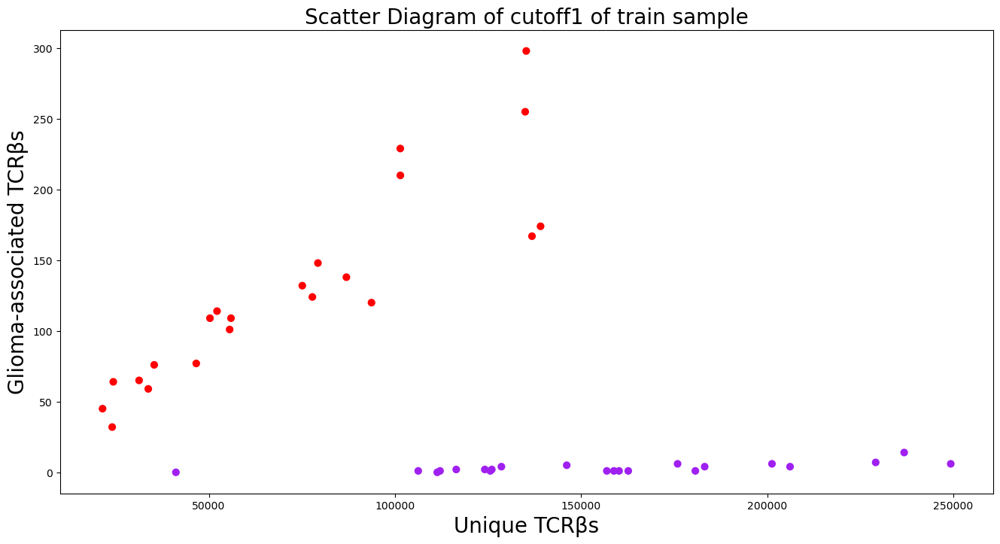

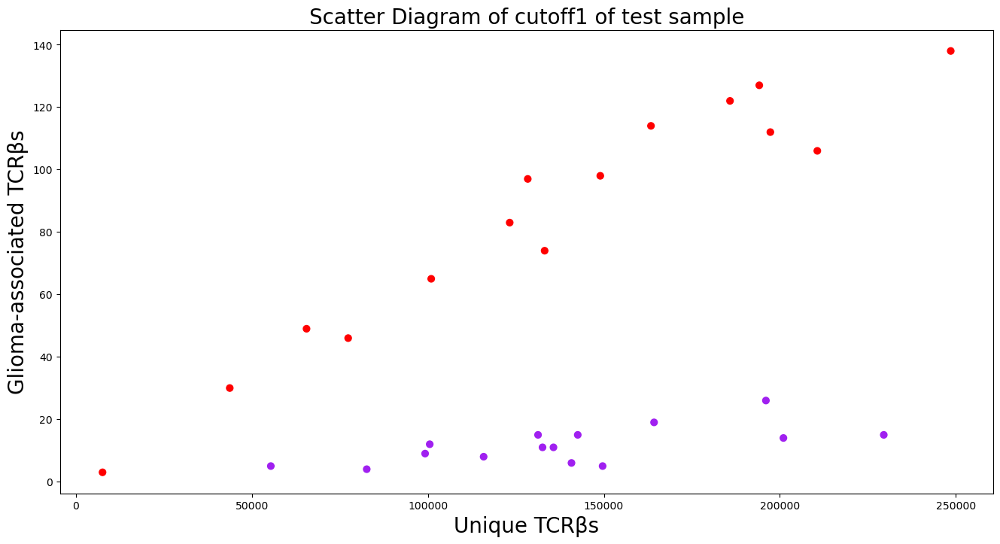

0:	learn: 0.6501965	total: 486us	remaining: 1.95ms
1:	learn: 0.5986504	total: 957us	remaining: 1.44ms
2:	learn: 0.5675918	total: 1.26ms	remaining: 842us
3:	learn: 0.5387542	total: 1.62ms	remaining: 404us
4:	learn: 0.5147164	total: 1.95ms	remaining: 0us


C:\Users\Administrator\AppData\Local\Temp\ipykernel_2052\4079151127.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_2052\4079151127.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 4
accuracy 0.9333333333333333


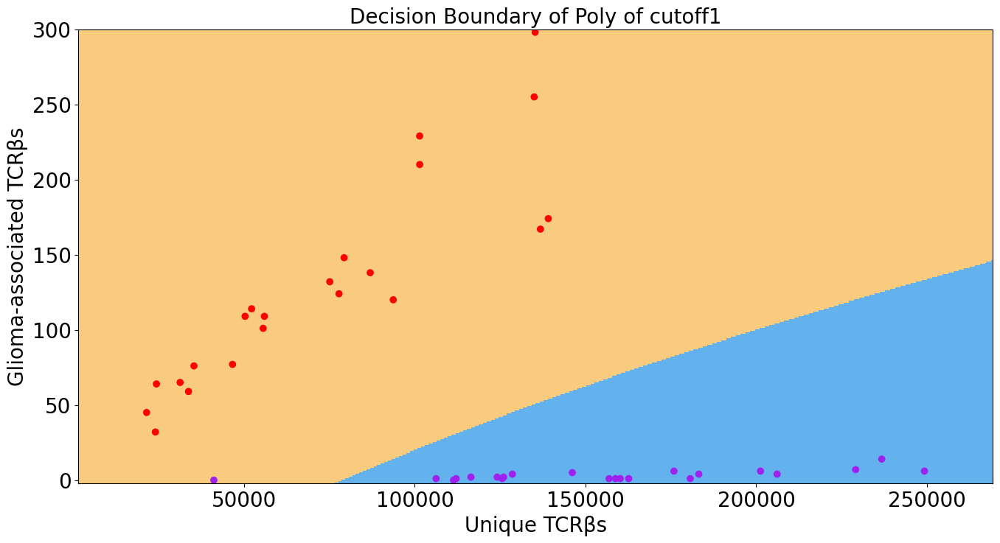

best_index 0
accuracy 0.9333333333333333


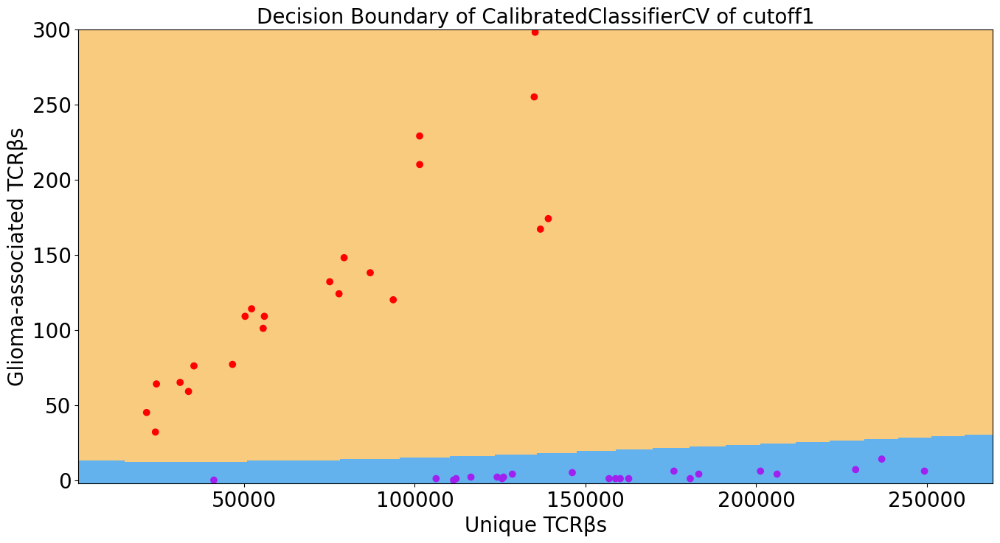

best_index 0
accuracy 0.9


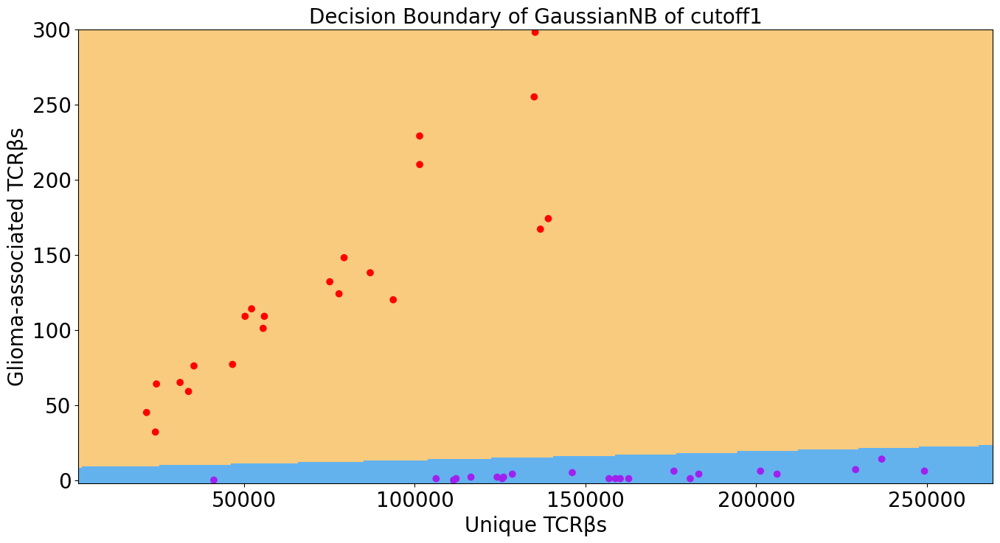

0:	learn: 0.6501965	total: 14.1ms	remaining: 56.3ms
1:	learn: 0.5986504	total: 16.2ms	remaining: 24.4ms
2:	learn: 0.5675918	total: 18.8ms	remaining: 12.5ms
3:	learn: 0.5387542	total: 19.2ms	remaining: 4.81ms
4:	learn: 0.5147164	total: 19.7ms	remaining: 0us


C:\Users\Administrator\AppData\Local\Temp\ipykernel_2052\4079151127.py:257: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_2052\4079151127.py:258: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.6


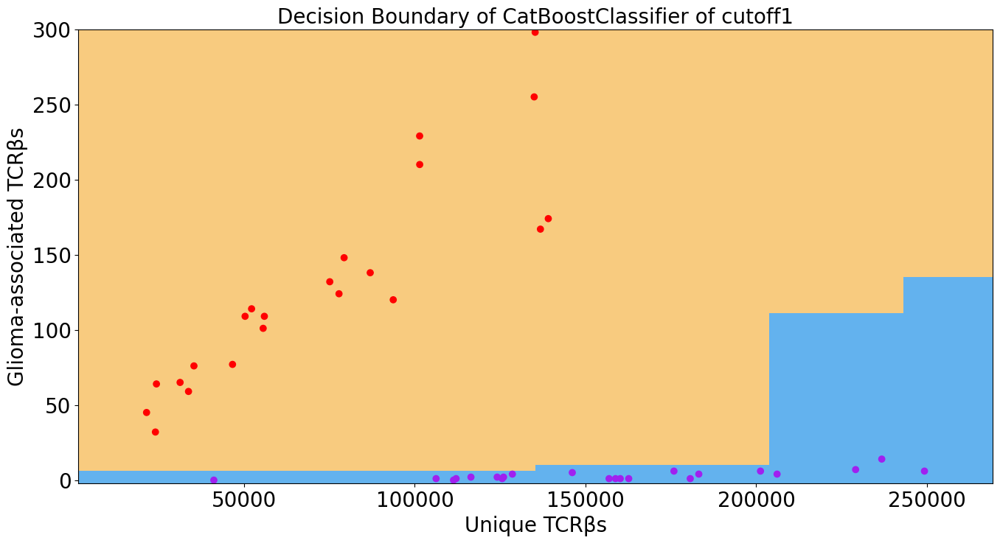

best_index 0
accuracy 0.9333333333333333


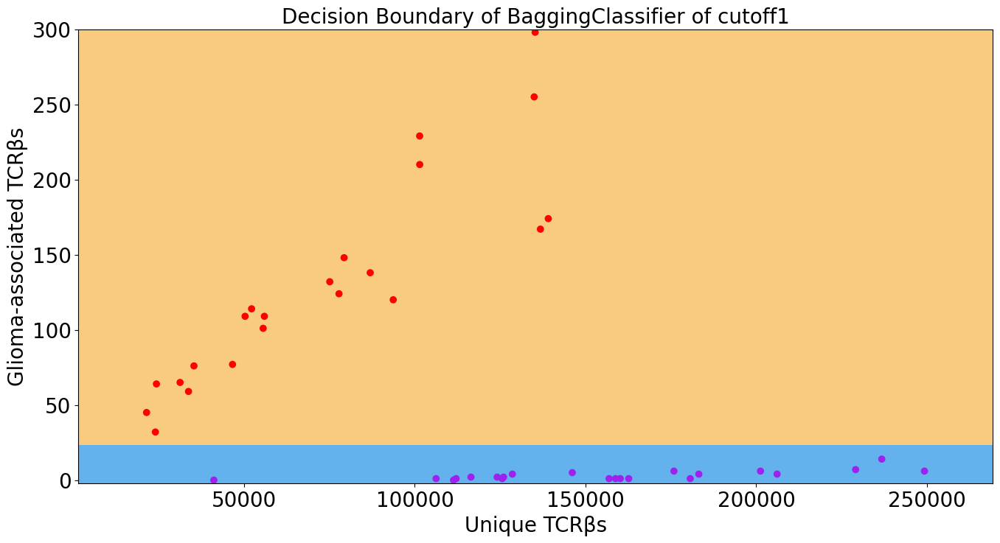

Epoch 1/100
2/2 [==============================] - 1s 457ms/step - loss: 0.6267 - accuracy: 0.8182 - auc_8: 0.8913 - precision_8: 0.8182 - recall_8: 0.8182 - val_loss: 0.6709 - val_accuracy: 0.5333 - val_auc_8: 0.6417 - val_precision_8: 0.5333 - val_recall_8: 0.5333
Epoch 2/100
2/2 [==============================] - 0s 23ms/step - loss: 0.6147 - accuracy: 0.8636 - auc_8: 0.9272 - precision_8: 0.8636 - recall_8: 0.8636 - val_loss: 0.6662 - val_accuracy: 0.6000 - val_auc_8: 0.6600 - val_precision_8: 0.6000 - val_recall_8: 0.6000
Epoch 3/100
2/2 [==============================] - 0s 23ms/step - loss: 0.6029 - accuracy: 0.9091 - auc_8: 0.9638 - precision_8: 0.9091 - recall_8: 0.9091 - val_loss: 0.6617 - val_accuracy: 0.6333 - val_auc_8: 0.6922 - val_precision_8: 0.6333 - val_recall_8: 0.6333
Epoch 4/100
2/2 [==============================] - 0s 25ms/step - loss: 0.5914 - accuracy: 0.9091 - auc_8: 0.9886 - precision_8: 0.9091 - recall_8: 0.9091 - val_loss: 0.6572 - val_accuracy: 0.7000 - va

C:\Users\Administrator\AppData\Local\Temp\ipykernel_2052\4079151127.py:365: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_2052\4079151127.py:366: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_2052\4079151127.py:365: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_2052\4079151127.py:366: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_2052\4079151127.py:365: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_2052\4079151127.py:366: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Adminis

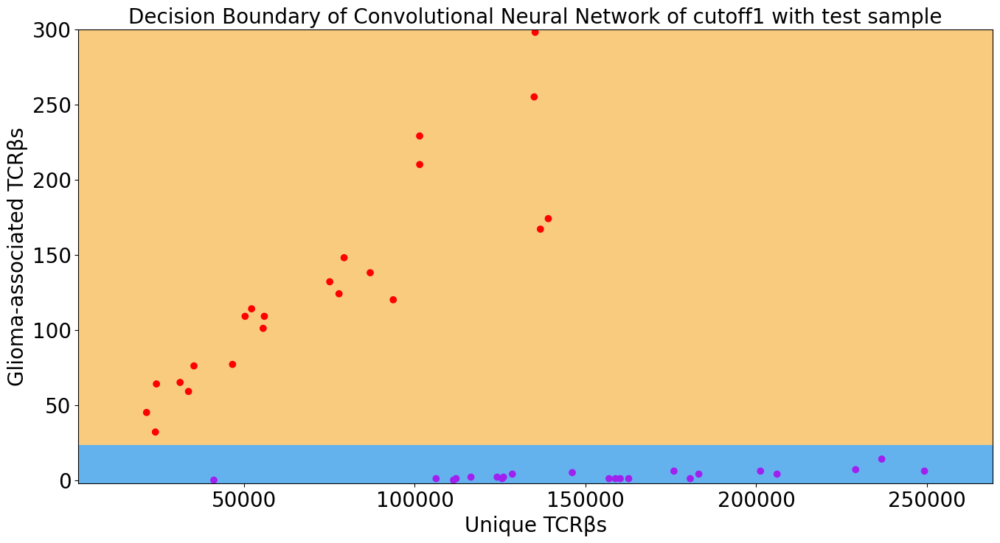

Epoch 1/100
2/2 [==============================] - 1s 394ms/step - loss: 0.6588 - accuracy: 0.6364 - auc_9: 0.8561 - precision_9: 0.6364 - recall_9: 0.6364 - val_loss: 0.6121 - val_accuracy: 0.8000 - val_auc_9: 0.8900 - val_precision_9: 0.8000 - val_recall_9: 0.8000
Epoch 2/100
2/2 [==============================] - 0s 28ms/step - loss: 0.4756 - accuracy: 0.9773 - auc_9: 0.9995 - precision_9: 0.9773 - recall_9: 0.9773 - val_loss: 0.5153 - val_accuracy: 0.8333 - val_auc_9: 0.9033 - val_precision_9: 0.8333 - val_recall_9: 0.8333
Epoch 3/100
2/2 [==============================] - 0s 27ms/step - loss: 0.2808 - accuracy: 0.9773 - auc_9: 0.9995 - precision_9: 0.9773 - recall_9: 0.9773 - val_loss: 0.4303 - val_accuracy: 0.7667 - val_auc_9: 0.8994 - val_precision_9: 0.7667 - val_recall_9: 0.7667
Epoch 4/100
2/2 [==============================] - 0s 29ms/step - loss: 0.1238 - accuracy: 0.9773 - auc_9: 0.9995 - precision_9: 0.9773 - recall_9: 0.9773 - val_loss: 0.4510 - val_accuracy: 0.8000 - va

C:\Users\Administrator\AppData\Local\Temp\ipykernel_2052\4079151127.py:439: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_2052\4079151127.py:440: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_2052\4079151127.py:439: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_2052\4079151127.py:440: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


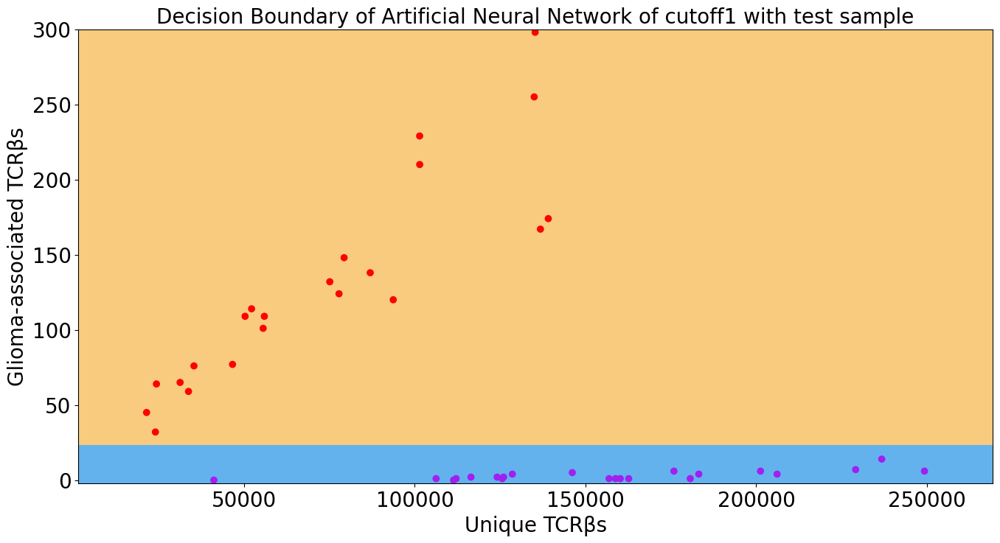

In [5]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import numpy as np
import struct
import sklearn
from sklearn import *
import matplotlib.pyplot as plt
from sklearn.datasets import make_moons
import numpy as np
import pandas as pd
import sklearn
import sklearn.metrics as metrics
from sklearn.metrics import plot_roc_curve,roc_curve,auc,roc_auc_score
from matplotlib.colors import ListedColormap
from sklearn.preprocessing import StandardScaler

# 第二步 绘制决策边界
def plot_decision_boundary(X,THRESHOLD,y,Xt,yt):#, y_pred
    x_min, x_max = X[:, 0].min() - 20000, X[:, 0].max() + 20000
    y_min, y_max = X[:, 1].min() - 2, X[:, 1].max() + 3    
    h = 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
    # 用预测函数预测一下
    markers = ('s','x','o','^','v')
    colors = ('#63b2ee','#f8cb7f','cyan','pink','lightgreen','gray','cyan') #A020F0 #前两个分别为阴性，阳性的区域的颜色：'cyan','pink'
    # 背景色
    cmap = ListedColormap(colors[:len(np.unique(y))])
    colors2 = ('#A020F0','red','#A020F0','red','lightgreen','gray','cyan') #前两个分别为阴性，阳性的点的颜色：'#A020F0','red'
    # 背景色
    cmap2 = ListedColormap(colors2[:len(np.unique(y))])   
    X_new = np.c_[xx.ravel(), yy.ravel()]#展开按行连接，生成的形状为（100000，2）
    #y_predict = np.where(clf.predict_proba(X)[:,1] >= THRESHOLD, 1, 0)#预测 
    #y_predict = clf.predict(X_new)
    y_predict = (clf.predict_proba(X_new)[:,1] >= THRESHOLD).astype(int)#0.259095242694766
    y_predict = np.array(y_predict)
    zz = y_predict.reshape(xx.shape)#重新变成（200，500）
    plt.contourf(xx, yy,zz, cmap=cmap)#背景色
    #训练样本散点图
    plt.scatter(X[:, 0], X[:, 1], c=y, cmap=cmap2)
    #测试样本散点图
#     plt.scatter(Xt[:, 0], Xt[:, 1], c=yt, cmap=cmap2)

dfs=pd.DataFrame() 
for i in range(1,2):
    data_train=pd.read_csv('D:/zky/aimuen/分类_脑胶质瘤/原始数据/Glioma_merge_2_multi_230305/二维/AssociatedClones_train_Cutoff_1e-0%d.csv'%i)
    data_test=pd.read_csv('D:/zky/aimuen/分类_脑胶质瘤/原始数据/Glioma_merge_2_multi_230305/二维/AssociatedClones_test_Cutoff_1e-0%d.csv'%i)
    data_train.drop(['Unnamed: 0'], axis=1, inplace=True)
    data_test.drop(['Unnamed: 0'], axis=1, inplace=True)
    
    #test
    Xt,yt=np.split(data_test,indices_or_sections=(2,),axis=1)
    Xt = Xt.values
    yt = yt.values
    #train
    X,y=np.split(data_train,indices_or_sections=(2,),axis=1)
    X = X.values
    y = y.values
    #标准化 可选 knn要 其他不用
    Xs = StandardScaler().fit_transform(X) 
    Xts = StandardScaler().fit_transform(Xt) 
    train_data,train_label,train_datas,train_labels=X,y,Xs,y
    test_data,test_label,test_datas,test_labels=Xt,yt,Xts,yt

    #绘制train并保存散点图
    np.random.seed(0)
    plt.figure(figsize=(16, 8))
    plt.xlabel('Unique TCRβs',size=20)
    plt.ylabel('Glioma-associated TCRβs',size=20)
    plt.title("Scatter Diagram of cutoff%d of train sample"%i,size=20)
    colors2 = ('#A020F0','red','#A020F0','red','lightgreen','gray','cyan')
    cmap2 = ListedColormap(colors2[:len(np.unique(y))])
    plt.scatter(X[:, 0], X[:, 1], s=40, c=y, cmap=cmap2)#plt.cm.Spectral
    plt.savefig("D:/zky/aimuen/分类_脑胶质瘤/结果数据与图片/最终版figure整理/figure2/区域算法划分图/cutoff%d/test_sample/散点图_cutoff%d"%(i,i))
    plt.show()
    
    #绘制test并保存散点图
    np.random.seed(0)
    plt.figure(figsize=(16, 8))
    plt.xlabel('Unique TCRβs',size=20)
    plt.ylabel('Glioma-associated TCRβs',size=20)
    plt.title("Scatter Diagram of cutoff%d of test sample"%i,size=20)
    colors2 = ('#A020F0','red','#A020F0','red','lightgreen','gray','cyan')
    cmap2 = ListedColormap(colors2[:len(np.unique(yt))])
    plt.scatter(Xt[:, 0], Xt[:, 1], s=40, c=yt, cmap=cmap2)#plt.cm.Spectral
    plt.savefig("D:/zky/aimuen/分类_脑胶质瘤/结果数据与图片/最终版figure整理/figure2/区域算法划分图/cutoff%d/test_sample/散点图_cutoff%d"%(i,i))
    plt.show()
    
    #训练模型
    #训练模型
    # LR
    from sklearn.linear_model import LogisticRegressionCV
    from sklearn.linear_model import LogisticRegression
    lr_clf = LogisticRegression(multi_class='multinomial',solver='newton-cg',class_weight='balanced',max_iter=10000)
    #clf = LogisticRegression(multi_class='multinomial',solver='lbfgs',class_weight='balanced',max_iter=10000)
    #lr_clf = LogisticRegression()
    
    #svm linear
    from sklearn.svm import SVC
    svm_clf=SVC(kernel='linear', probability=True,random_state=10)#使用核函数为线性核，参数默认，创建分类器 

    #SVM poly
    from sklearn.svm import SVC
    import sklearn
    from sklearn.preprocessing import PolynomialFeatures, StandardScaler
    from sklearn.svm import LinearSVC
    from sklearn.pipeline import Pipeline
    def PolynomialSVC(degree, C=1.0):
        return Pipeline([
            ('poly', PolynomialFeatures(degree=degree)),
            ('std)scaler', StandardScaler()),
            ('linearSVC', LinearSVC(C=C))
        ])
    svm = PolynomialSVC(degree=3)
    from sklearn.calibration import CalibratedClassifierCV
    poly_clf = CalibratedClassifierCV(svm) 

    #KNN
    from sklearn.neighbors import KNeighborsClassifier
    knn_clf = KNeighborsClassifier(n_neighbors=10)

    #RF
    from sklearn.linear_model import LogisticRegressionCV
    from sklearn.ensemble import RandomForestClassifier #分类器
    rf_clf = RandomForestClassifier(n_estimators = 210) #训练100个基分类器

    #LDA
    from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
    from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
    lda_clf = LinearDiscriminantAnalysis() 

    #GBDT
    from sklearn.ensemble import GradientBoostingClassifier #GBDT算法
    gbdt_clf = GradientBoostingClassifier() 

    #AdaBoost
    from sklearn.ensemble import AdaBoostClassifier
    adb_clf = AdaBoostClassifier(n_estimators=100) #迭代100次

    #xgboost
    import xgboost as xgb
    from xgboost.sklearn import XGBClassifier
    xgb_clf = XGBClassifier()

    #decision tree
    from sklearn.tree import DecisionTreeClassifier
    dt_clf = DecisionTreeClassifier()
    
    #bays
    from sklearn.model_selection import StratifiedShuffleSplit
    from sklearn.naive_bayes import GaussianNB
    from sklearn.metrics import confusion_matrix
    nb_clf = GaussianNB()

    #CalibratedClassifierCV
    from sklearn.naive_bayes import GaussianNB
    from sklearn.calibration import CalibratedClassifierCV
    # 创建高斯朴素贝叶斯实例
    clf = GaussianNB()
    # 使用sigmoid校准创建校准交叉验证
    # clf_sigmoid = CalibratedClassifierCV(clf, cv=2, method='sigmoid')
    cv_clf = CalibratedClassifierCV(clf, cv=2, method='sigmoid')

    #CatBoostClassifier
    import catboost as cb
    from catboost import CatBoostClassifier
    from sklearn import metrics
    from sklearn.model_selection import train_test_split
    cbc_clf=CatBoostClassifier(iterations=5, learning_rate=0.1)

    #BaggingClassifier
    from sklearn.tree import DecisionTreeClassifier
    from sklearn.ensemble import BaggingClassifier
    from sklearn.model_selection import train_test_split
    dt = DecisionTreeClassifier(random_state=1)
    bag_clf=BaggingClassifier(base_estimator=dt, 
            n_estimators=50, random_state=1) 
    
    #神经网络算法

    #训练模型
    lr_clf.fit(train_data,train_label.astype('int').ravel())
    rf_clf.fit(train_datas,train_labels.astype('int').ravel())
    lda_clf.fit(train_data,train_label.astype('int').ravel())
    gbdt_clf.fit(train_datas,train_labels.astype('int').ravel())
    adb_clf.fit(train_data,train_label.astype('int').ravel())
    xgb_clf.fit(train_datas,train_labels.astype('int').ravel())
    dt_clf.fit(train_data,train_label.astype('int').ravel())
    knn_clf.fit(train_datas,train_labels.astype('int').ravel())
    svm_clf.fit(train_datas,train_labels.astype('int').ravel())
    poly_clf.fit(train_data,train_label.astype('int').ravel())
    nb_clf.fit(train_data,train_label.astype('int').ravel())
    cv_clf.fit(train_data,train_label.astype('int').ravel())
    cbc_clf.fit(train_data,train_label.astype('int').ravel())
    bag_clf.fit(train_data,train_label.astype('int').ravel())

    #prob 预测
    score_lr = lr_clf.predict_proba(test_data)[:,1]
    score_rf = rf_clf.predict_proba(test_datas)[:,1]
    score_lda = lda_clf.predict_proba(test_data)[:,1]
    score_gbdt = gbdt_clf.predict_proba(test_datas)[:,1]
    score_adb = lda_clf.predict_proba(test_data)[:,1]
    score_xgb = gbdt_clf.predict_proba(test_datas)[:,1]
    score_dt = dt_clf.predict_proba(test_data)[:,1]
    score_knn = knn_clf.predict_proba(test_datas)[:,1]
    score_svm = svm_clf.predict_proba(test_datas)[:,1]
    score_poly = poly_clf.predict_proba(test_data)[:,1]
    score_nb = nb_clf.predict_proba(test_data)[:,1]
    score_cv = cv_clf.predict_proba(test_data)[:,1]
    score_cbc = cbc_clf.predict_proba(test_data)[:,1]
    score_bag = bag_clf.predict_proba(test_data)[:,1]
    
    #0-1预测
    predict_lr = lr_clf.predict(test_data)
    predict_rf = rf_clf.predict(test_datas)
    predict_lda = lda_clf.predict(test_data)
    predict_gbdt = gbdt_clf.predict(test_datas)
    predict_adb = adb_clf.predict(test_data)
    predict_xgb = xgb_clf.predict(test_datas)
    predict_dt = dt_clf.predict(test_data)
    predict_knn = knn_clf.predict(test_datas)
    predict_svm = svm_clf.predict(test_datas)
    predict_poly = poly_clf.predict(test_data)
    predict_nb = nb_clf.predict(test_data)
    predict_cv = cv_clf.predict(test_data)
    predict_cbc = cbc_clf.predict(test_data)
    predict_bag = bag_clf.predict(test_data)
    
    #使用roc_curve方法得到三个模型的真正率TP,假正率FP和阈值threshold
    fpr_lr,tpr_lr,thres_lr = roc_curve(test_label,score_lr,)
    fpr_rf,tpr_rf,thres_rf = roc_curve(test_labels,score_rf,)
    fpr_lda,tpr_lda,thres_lda = roc_curve(test_label,score_lda,)
    fpr_gbdt,tpr_gbdt,thres_gbdt = roc_curve(test_labels,score_gbdt,)
    fpr_adb,tpr_adb,thres_adb = roc_curve(test_label,score_adb,)
    fpr_xgb,tpr_xgb,thres_xgb = roc_curve(test_labels,score_xgb,)
    fpr_dt,tpr_dt,thres_dt = roc_curve(test_label,score_dt,)
    fpr_knn,tpr_knn,thres_knn = roc_curve(test_labels,score_knn,)
    fpr_svm,tpr_svm,thres_svm = roc_curve(test_labels,score_svm,)
    fpr_poly,tpr_poly,thres_poly = roc_curve(test_label,score_poly,)
    fpr_nb,tpr_nb,thres_nb = roc_curve(test_label,score_poly,)
    fpr_cv,tpr_cv,thres_cv = roc_curve(test_label,score_poly,)
    fpr_cbc,tpr_cbc,thres_cbc = roc_curve(test_label,score_poly,)
    fpr_bag,tpr_bag,thres_bag = roc_curve(test_label,score_poly,)
    
    #修改函数已获取最佳阈值对应的最佳准确率等
    def classification_inbestthres(test_label,predict,score,fpr,tpr,thres):
        results = []
        for threshold in thres:
            if threshold > 1:
                continue
            else:
                y_pred = (score > threshold).astype(int)
                tn, fp, fn, tp = confusion_matrix(test_label, y_pred).ravel()
                accuracy = (tp + tn) / (tp + tn + fn +fp)
                recall = tp / (tp + fn)
                speciality=tn / (tn + fp)
                precision = tp / (tp + fp)
                FDR = fp / (tp + fp)
                f1 = 2 * tp / (2 * tp + fn + fp)
                Cross_entropy_loss = metrics.log_loss(test_label, score)
                results.append([threshold, roc_auc_score(test_label, score), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
        # 转换为数组并找出准确率最高的结果
        results = np.array(results)
        best_index = np.argmax(results[:, 2])
        print("best_index",best_index)
        # 输出最佳阈值下的指标
        best_threshold, auc_alg,accuracy, recall,speciality, precision, FDR, f1, Cross_entropy_loss = results[best_index, :]
        print("accuracy",accuracy)
        return best_threshold, auc_alg,accuracy, recall,speciality, FDR, f1, Cross_entropy_loss
    
    algos = {"lr":lr_clf,"rf":rf_clf,"lda":lda_clf,"gbdt":gbdt_clf,"adb":adb_clf,"xgb":xgb_clf,"dt":dt_clf,"knn":knn_clf,"svm":svm_clf,"poly":poly_clf,"cv":cv_clf,"nb":nb_clf,"cbc":cbc_clf,"bag":bag_clf}
    names = {"lr":"LogisticRegression","rf":"RandomForestClassifier","lda":"LinearDiscriminantAnalysis","gbdt":"GradientBoostingClassifier","adb":"AdaBoostClassifier","xgb":"XGBClassifier","dt":"DecisionTreeClassifier","knn":"KNeighborsClassifier","svm":"svm","poly":"Poly","cv":"CalibratedClassifierCV","nb":"GaussianNB","cbc":"CatBoostClassifier","bag":"BaggingClassifier"}
#     algorithms = ["lr","rf","lda","gbdt","adb","xgb","dt","knn","svm","poly","cv","nb","cbc","bag"]#"poly","cv","nb","cbc","bag"
    algorithms = ["poly","cv","nb","cbc","bag"]#"poly","cv","nb","cbc","bag"
    for alg in algorithms:
        clf=algos[alg]
        clf.fit(train_data,train_label.astype('int').ravel())
        thres=eval("thres_%s"%alg)
#         thres= np.linspace(0, 1, 101)
        predict=eval("predict_%s"%alg)##***给参数名字字符串赋值的过程***
        score=eval("score_%s"%alg)
        fpr=eval("fpr_%s"%alg)
        tpr=eval("tpr_%s"%alg)
        result=classification_inbestthres(test_label,predict,score,fpr,tpr,thres)
        df=[]
        list = [i,alg,result[0],result[1],result[2],result[3],result[4],result[5],result[6],result[7]]
        df.append(list)
        data=pd.DataFrame(df)
        dfs=pd.concat([dfs,data])

        plt.figure(figsize=(16, 8))
        plt.tick_params(labelsize=20)
        plt.xlabel('Unique TCRβs',size=20)
        plt.ylabel('Glioma-associated TCRβs',size=20)
        plt.title("Decision Boundary of %s of cutoff%d"%(names[alg],i),size=20)
        plot_decision_boundary(X,result[0],y,Xt,yt)#,Xt,yt
        plt.savefig("D:/zky/aimuen/分类_脑胶质瘤/结果数据与图片/最终版figure整理/figure2/区域算法划分图/cutoff%d/test_sample/Decision_Boundary_of_%s_cutoff%d"%(i,names[alg],i))
        plt.show()
    
    #加上两个神经网络算法的结果
    import tensorflow as tf
    from sklearn.datasets import load_iris
    from sklearn.model_selection import train_test_split
    from sklearn.preprocessing import StandardScaler
    import numpy as np
    from sklearn.datasets import load_iris
    from sklearn.model_selection import train_test_split
    from sklearn.preprocessing import StandardScaler
    import matplotlib.pyplot as plt
    # X_train, X_test, y_train, y_test = Xs, Xts,y,yt#标准化后结果反而差
    X_train, X_test, y_train, y_test = X, Xt,y,yt
    # Scale the data
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test = scaler.transform(X_test)
    # Convert labels to one-hot encoding
    y_train = tf.keras.utils.to_categorical(y_train, num_classes=2)
    y_test = tf.keras.utils.to_categorical(y_test, num_classes=2)
    
    '''
    2.1 卷积神经网络 用于二分类 with adam
    '''
    # Build the model
    model = tf.keras.Sequential([
        tf.keras.layers.Reshape((2, 1), input_shape=(2,)),#每次输入的x_train的大小 2*1
        tf.keras.layers.Conv1D(filters=32, kernel_size=2, activation='relu'),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(units=2, activation='softmax')#输出的类别数 0-1 两类
    ])
    # Compile the model
    model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy", tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])
    # Train the model
    history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))
    # Evaluate the model on the test data
    test_loss, test_accuracy, test_auc, test_precision, test_recall = model.evaluate(X_test, y_test)
    # Calculate the F1 score, FDR error rate, sensitivity, and specificity
    f1_score = 2 * (test_precision * test_recall) / (test_precision + test_recall)
    fdr_error_rate = 1 - test_recall
    sensitivity = test_recall
    specificity = 1 - test_precision
    # Evaluate the model
    results = model.evaluate(X_test, y_test)
    # Make predictions
    probabilities = model.predict(X_test)
    predictions = np.argmax(probabilities, axis=1)
    import numpy as np
    from sklearn.metrics import roc_auc_score, confusion_matrix, precision_recall_curve, f1_score
    from tensorflow.keras.losses import BinaryCrossentropy
    # 预测结果
    predictions = model.predict(X_test)
    # 在测试集上进行预测
    y_pred_cnn = model.predict(X_test)[:, 1]
    # 计算CNN模型的AUC
    fpr_cnn, tpr_cnn, thresholds = roc_curve(y_test[:, 1], y_pred_cnn)
    auc_cnn = auc(fpr_cnn, tpr_cnn)
    # 枚举阈值并计算分类结果
    thresholds = np.linspace(0, 1, 101)
    results = []
    for threshold in thresholds:
        y_pred = (predictions > threshold).astype(int)
        tn, fp, fn, tp = confusion_matrix(y_test.argmax(axis=1), y_pred.argmax(axis=1)).ravel()
        accuracy = (tp + tn) / (tp + tn + fn +fp)
        recall = tp / (tp + fn)
        speciality=tn / (tn + fp)
        precision = tp / (tp + fp)
        FDR = fp / (tp + fp)
        f1 = 2 * tp / (2 * tp + fn + fp)
#         Cross_entropy_loss = metrics.log_loss(y_test.argmax(axis=1), predictions.argmax(axis=1))
        Cross_entropy_loss = metrics.log_loss(y_test, predictions)
        results.append([threshold, roc_auc_score(y_test, predictions), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
#         results.append([threshold, roc_auc_score(y_test.argmax(axis=1), predictions.argmax(axis=1)), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
    # 转换为数组并找出准确率最高的结果
    results = np.array(results)
    best_index = np.argmax(results[:, 2])
    # 输出最佳阈值下的指标
    best_threshold, auc_cnn,accuracy, recall,speciality, precision, FDR, f1, Cross_entropy_loss = results[best_index, :]
    df=[]
    list = [i,'CNN',best_threshold,auc_cnn, accuracy,recall,speciality,FDR,f1,Cross_entropy_loss]
    df.append(list)
    data=pd.DataFrame(df)
    dfs=pd.concat([dfs,data])
    
    #测试点的散点图
    plt.figure(figsize=(16, 8))
    plt.tick_params(labelsize=20)
    plt.xlabel('Unique TCRβs',size=20)
    plt.ylabel('Glioma-associated TCRβs',size=20)
    plt.title("Decision Boundary of Convolutional Neural Network of cutoff%d with test sample"%i,size=20)
    plot_decision_boundary(X,best_threshold,y,Xt,yt)
    plt.savefig("D:/zky/aimuen/分类_脑胶质瘤/结果数据与图片/最终版figure整理/figure2/区域算法划分图/cutoff%d/test_sample/Decision_Boundary_of_CNN_cutoff%d with test sample"%(i,i))
    plt.show()
    '''
    2.2 ann
    '''
    # Build the model
    import keras
    model = keras.Sequential([
            keras.layers.Dense(500,activation='relu',input_shape=[2]),#输入特征数目为2
            keras.layers.Dense(500,activation='relu'),
            keras.layers.Dense(250,activation='relu'),
            keras.layers.Dense(250,activation='relu'),
            keras.layers.Dense(2, activation='softmax')])#输出的类别为2个，所以输出层2个节点
    # Compile the model
    model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy", tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])
    # Train the model
    history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))
    # Evaluate the model on the test data
    test_loss, test_accuracy, test_auc, test_precision, test_recall = model.evaluate(X_test, y_test)
    # Calculate the F1 score, FDR error rate, sensitivity, and specificity
    f1_score = 2 * (test_precision * test_recall) / (test_precision + test_recall)
    fdr_error_rate = 1 - test_recall
    sensitivity = test_recall
    specificity = 1 - test_precision
    # Evaluate the model
    results = model.evaluate(X_test, y_test)
    # Make predictions
    probabilities = model.predict(X_test)
    predictions = np.argmax(probabilities, axis=1)
    import numpy as np
    from sklearn.metrics import roc_auc_score, confusion_matrix, precision_recall_curve, f1_score
    from tensorflow.keras.losses import BinaryCrossentropy
    # 预测结果
    predictions = model.predict(X_test)
    # 在测试集上进行预测
    y_pred_ann = model.predict(X_test)[:, 1]
    # 计算CNN模型的AUC
    fpr_ann, tpr_ann, thresholds = roc_curve(y_test[:, 1], y_pred_ann)
    auc_ann = auc(fpr_ann, tpr_ann)
    # 枚举阈值并计算分类结果
    thresholds = np.linspace(0, 1, 101)
    results = []
    for threshold in thresholds:
        y_pred = (predictions > threshold).astype(int)
        tn, fp, fn, tp = confusion_matrix(y_test.argmax(axis=1), y_pred.argmax(axis=1)).ravel()
#         accuracy = accuracy_score(y_test.argmax(axis=1), y_pred.argmax(axis=1))
        accuracy = (tp + tn) / (tp + tn + fn +fp)
        recall = tp / (tp + fn)
        speciality=tn / (tn + fp)
        precision = tp / (tp + fp)
        FDR = fp / (tp + fp)
        f1 = 2 * tp / (2 * tp + fn + fp)
#         f1 = f1_score(y_test.argmax(axis=1), y_pred.argmax(axis=1))
#         loss = BinaryCrossentropy(y_test.argmax(axis=1), predictions.argmax(axis=1))
#         Cross_entropy_loss = metrics.log_loss(y_test.argmax(axis=1), predictions.argmax(axis=1))
        Cross_entropy_loss = metrics.log_loss(y_test, predictions)
        results.append([threshold, roc_auc_score(y_test, predictions), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
#         results.append([threshold, roc_auc_score(y_test.argmax(axis=1), predictions.argmax(axis=1)), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
    # 转换为数组并找出准确率最高的结果
    results = np.array(results)
    best_index = np.argmax(results[:, 2])
    # 输出最佳阈值下的指标
    best_threshold, auc_ann,accuracy, recall,speciality, precision, FDR, f1, Cross_entropy_loss = results[best_index, :]
    df=[]
    list = [i,'ANN',best_threshold,auc_ann, accuracy,recall,speciality,FDR,f1,Cross_entropy_loss]
    df.append(list)
    data=pd.DataFrame(df)
    dfs=pd.concat([dfs,data])
    
    #测试点的散点图
    plt.figure(figsize=(16, 8))
    plt.tick_params(labelsize=20)
    plt.xlabel('Unique TCRβs',size=20)
    plt.ylabel('Glioma-associated TCRβs',size=20)
    plt.title("Decision Boundary of Artificial Neural Network of cutoff%d with test sample"%i,size=20)
    plot_decision_boundary(X,best_threshold,y,Xt,yt)
    plt.savefig("D:/zky/aimuen/分类_脑胶质瘤/结果数据与图片/最终版figure整理/figure2/区域算法划分图/cutoff%d/test_sample/Decision_Boundary_of_ANN_cutoff%d with test sample"%(i,i))
    plt.show()


# Figure3 Multi-dimensional Classification No dimensionality reduction

## cutoff1

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


0:	learn: 0.6195240	total: 213ms	remaining: 852ms
1:	learn: 0.5602012	total: 262ms	remaining: 393ms
2:	learn: 0.5053662	total: 274ms	remaining: 183ms
3:	learn: 0.4576476	total: 287ms	remaining: 71.7ms
4:	learn: 0.4074582	total: 299ms	remaining: 0us


C:\Users\Administrator\AppData\Local\Temp\ipykernel_33192\1268857326.py:217: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_33192\1268857326.py:218: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_33192\1268857326.py:217: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_33192\1268857326.py:218: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_33192\1268857326.py:217: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_33192\1268857326.py:218: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\A

best_index 1
accuracy 0.9333333333333333
best_index 3
accuracy 0.9333333333333333
best_index 1
accuracy 0.9666666666666667
best_index 3
accuracy 0.9666666666666667
best_index 1
accuracy 0.9666666666666667
best_index 3
accuracy 0.9666666666666667
best_index 1
accuracy 0.9666666666666667
best_index 1
accuracy 0.9333333333333333
best_index 1
accuracy 0.9333333333333333
best_index 0
accuracy 0.5
best_index 0
accuracy 0.5
best_index 1
accuracy 0.9666666666666667
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_33192\1268857326.py:217: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_33192\1268857326.py:218: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_33192\1268857326.py:217: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_33192\1268857326.py:218: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


Epoch 1/100
2/2 [==============================] - 1s 408ms/step - loss: 0.5892 - accuracy: 0.4773 - auc: 0.6929 - precision: 0.4773 - recall: 0.4773 - val_loss: 0.3213 - val_accuracy: 0.9000 - val_auc: 0.9478 - val_precision: 0.9000 - val_recall: 0.9000
Epoch 2/100
2/2 [==============================] - 0s 22ms/step - loss: 0.1727 - accuracy: 0.9773 - auc: 0.9974 - precision: 0.9773 - recall: 0.9773 - val_loss: 0.2467 - val_accuracy: 0.9333 - val_auc: 0.9489 - val_precision: 0.9333 - val_recall: 0.9333
Epoch 3/100
2/2 [==============================] - 0s 21ms/step - loss: 0.0866 - accuracy: 0.9773 - auc: 0.9995 - precision: 0.9773 - recall: 0.9773 - val_loss: 0.2256 - val_accuracy: 0.9333 - val_auc: 0.9556 - val_precision: 0.9333 - val_recall: 0.9333
Epoch 4/100
2/2 [==============================] - 0s 20ms/step - loss: 0.0542 - accuracy: 0.9773 - auc: 0.9995 - precision: 0.9773 - recall: 0.9773 - val_loss: 0.2161 - val_accuracy: 0.9333 - val_auc: 0.9578 - val_precision: 0.9333 - va

C:\Users\Administrator\AppData\Local\Temp\ipykernel_33192\1268857326.py:314: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_33192\1268857326.py:315: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_33192\1268857326.py:314: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_33192\1268857326.py:315: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


Epoch 1/100
2/2 [==============================] - 1s 498ms/step - loss: 0.6356 - accuracy: 0.4318 - auc_1: 0.5710 - precision_1: 0.4318 - recall_1: 0.4318 - val_loss: 0.3922 - val_accuracy: 0.7667 - val_auc_1: 0.8978 - val_precision_1: 0.7667 - val_recall_1: 0.7667
Epoch 2/100
2/2 [==============================] - 0s 29ms/step - loss: 0.1044 - accuracy: 1.0000 - auc_1: 1.0000 - precision_1: 1.0000 - recall_1: 1.0000 - val_loss: 0.2621 - val_accuracy: 0.9000 - val_auc_1: 0.9567 - val_precision_1: 0.9000 - val_recall_1: 0.9000
Epoch 3/100
2/2 [==============================] - 0s 28ms/step - loss: 0.0069 - accuracy: 1.0000 - auc_1: 1.0000 - precision_1: 1.0000 - recall_1: 1.0000 - val_loss: 0.3512 - val_accuracy: 0.9333 - val_auc_1: 0.9533 - val_precision_1: 0.9333 - val_recall_1: 0.9333
Epoch 4/100
2/2 [==============================] - 0s 27ms/step - loss: 4.0051e-04 - accuracy: 1.0000 - auc_1: 1.0000 - precision_1: 1.0000 - recall_1: 1.0000 - val_loss: 0.4816 - val_accuracy: 0.9333 

C:\Users\Administrator\AppData\Local\Temp\ipykernel_33192\1268857326.py:379: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_33192\1268857326.py:380: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_33192\1268857326.py:379: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_33192\1268857326.py:380: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


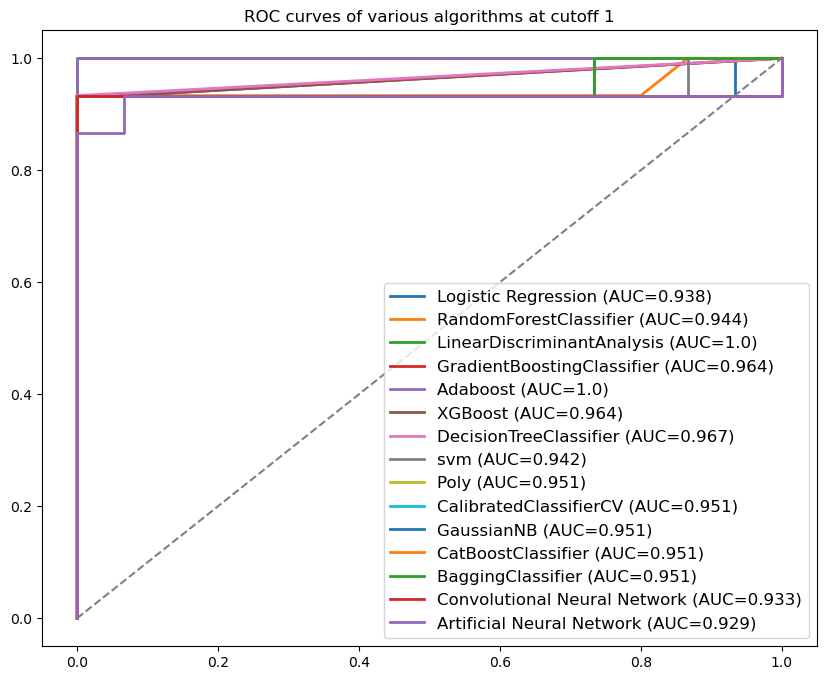

,cutoff,algorithm,best_thresthod,AUC,Accuracy,Sensitivity,Specificity,F1,FDR,Cross_entropy_loss
0,1,lr,2.452083e-01,0.937778,0.933333,0.866667,1.0,0.0,0.928571,0.228297
0,1,rf,5.095238e-01,0.944444,0.933333,0.866667,1.0,0.0,0.928571,0.267766
0,1,lda,9.165300e-19,1.000000,0.966667,0.933333,1.0,0.0,0.965517,1.904722
0,1,gbdt,3.937267e-05,0.964444,0.966667,0.933333,1.0,0.0,0.965517,0.350904
0,1,adb,9.165300e-19,1.000000,0.966667,0.933333,1.0,0.0,0.965517,1.904722
0,1,xgb,3.937267e-05,0.964444,0.966667,0.933333,1.0,0.0,0.965517,0.350904
0,1,dt,0.000000e+00,0.966667,0.966667,0.933333,1.0,0.0,0.965517,1.151293
0,1,svm,6.757918e-01,0.942222,0.933333,0.866667,1.0,0.0,0.928571,0.185507
0,1,poly,3.745671e-01,0.951111,0.933333,0.866667,1.0,0.0,0.928571,0.498286
0,1,cv,8.401750e-01,0.500000,0.500000,0.000000,1.0,NaN,0.000000,0.696740


In [2]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import numpy as np
import struct
import sklearn
from sklearn import *
import matplotlib.pyplot as plt
from sklearn.datasets import make_moons
import numpy as np
import pandas as pd
import sklearn
import sklearn.metrics as metrics
from sklearn.metrics import plot_roc_curve,roc_curve,auc,roc_auc_score
from matplotlib.colors import ListedColormap
from sklearn.preprocessing import StandardScaler

dfs=pd.DataFrame() 
for i in range(1,2):
    data_train=pd.read_csv('data/Glioma_multi_dimension/ori/train_e-%d.csv'%i)
    data_test=pd.read_csv('data/Glioma_multi_dimension/ori/test_e-%d.csv'%i)
    
    data_train.drop(['Unnamed: 0'], axis=1, inplace=True)
    data_train = data_train.apply(pd.to_numeric, errors='coerce')# 将非数字转换为缺失值
    data_train[data_train > 0] = 1
    data_train = data_train.sample(frac=1.0)
    data_train.to_csv("data/Glioma_multi_dimension/new_data/train_cutoff%d.csv"%i)
    
    data_test.drop(['Unnamed: 0'], axis=1, inplace=True)
    data_test = data_test.apply(pd.to_numeric, errors='coerce')# 将非数字转换为缺失值
    data_test[data_test > 0] = 1
    data_test = data_test.sample(frac=1.0)
    data_test.to_csv("data/Glioma_multi_dimension/new_data/test_cutoff%d.csv"%i)
    
    #test
    yt,Xt=np.split(data_test,indices_or_sections=(1,),axis=1)
    Xt = Xt.values
    yt = yt.values
    #train
    y,X=np.split(data_train,indices_or_sections=(1,),axis=1)
    X = X.values
    y = y.values
    #标准化 可选 knn要 其他不用
    Xs = StandardScaler().fit_transform(X) 
    Xts = StandardScaler().fit_transform(Xt) 
    train_data,train_label,train_datas,train_labels=X,y,Xs,y
    test_data,test_label,test_datas,test_labels=Xt,yt,Xts,yt

    #训练模型
    #训练模型
    # LR
    from sklearn.linear_model import LogisticRegressionCV
    from sklearn.linear_model import LogisticRegression
    lr_clf = LogisticRegression(multi_class='multinomial',solver='newton-cg',class_weight='balanced',max_iter=10000)
    #clf = LogisticRegression(multi_class='multinomial',solver='lbfgs',class_weight='balanced',max_iter=10000)
    #lr_clf = LogisticRegression()
    
    #svm linear
    from sklearn.svm import SVC
    svm_clf=SVC(kernel='linear', probability=True,random_state=10)#使用核函数为线性核，参数默认，创建分类器 

    #SVM poly
    from sklearn.svm import SVC
    import sklearn
    from sklearn.preprocessing import PolynomialFeatures, StandardScaler
    from sklearn.svm import LinearSVC
    from sklearn.pipeline import Pipeline
    def PolynomialSVC(degree, C=1.0):
        return Pipeline([
            ('poly', PolynomialFeatures(degree=degree)),
            ('std)scaler', StandardScaler()),
            ('linearSVC', LinearSVC(C=C))
        ])
    svm = PolynomialSVC(degree=3)
    from sklearn.calibration import CalibratedClassifierCV
    poly_clf = CalibratedClassifierCV(svm) 

    #KNN
    from sklearn.neighbors import KNeighborsClassifier
    knn_clf = KNeighborsClassifier(n_neighbors=10)

    #RF
    from sklearn.linear_model import LogisticRegressionCV
    from sklearn.ensemble import RandomForestClassifier #分类器
    rf_clf = RandomForestClassifier(n_estimators = 210) #训练100个基分类器

    #LDA
    from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
    from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
    lda_clf = LinearDiscriminantAnalysis() 

    #GBDT
    from sklearn.ensemble import GradientBoostingClassifier #GBDT算法
    gbdt_clf = GradientBoostingClassifier() 

    #AdaBoost
    from sklearn.ensemble import AdaBoostClassifier
    adb_clf = AdaBoostClassifier(n_estimators=100) #迭代100次

    #xgboost
    import xgboost as xgb
    from xgboost.sklearn import XGBClassifier
    xgb_clf = XGBClassifier()

    #decision tree
    from sklearn.tree import DecisionTreeClassifier
    dt_clf = DecisionTreeClassifier()
    
    #bays
    from sklearn.model_selection import StratifiedShuffleSplit
    from sklearn.naive_bayes import GaussianNB
    from sklearn.metrics import confusion_matrix
    nb_clf = GaussianNB()

    #CalibratedClassifierCV
    from sklearn.naive_bayes import GaussianNB
    from sklearn.calibration import CalibratedClassifierCV
    # 创建高斯朴素贝叶斯实例
    clf = GaussianNB()
    # 使用sigmoid校准创建校准交叉验证
    # clf_sigmoid = CalibratedClassifierCV(clf, cv=2, method='sigmoid')
    cv_clf = CalibratedClassifierCV(clf, cv=2, method='sigmoid')

    #CatBoostClassifier
    import catboost as cb
    from catboost import CatBoostClassifier
    from sklearn import metrics
    from sklearn.model_selection import train_test_split
    cbc_clf=CatBoostClassifier(iterations=5, learning_rate=0.1)

    #BaggingClassifier
    from sklearn.tree import DecisionTreeClassifier
    from sklearn.ensemble import BaggingClassifier
    from sklearn.model_selection import train_test_split
    dt = DecisionTreeClassifier(random_state=1)
    bag_clf=BaggingClassifier(base_estimator=dt, 
            n_estimators=50, random_state=1) 
    
    #神经网络算法

    #训练模型
    lr_clf.fit(train_data,train_label.astype('int').ravel())
    rf_clf.fit(train_data,train_label.astype('int').ravel())
    lda_clf.fit(train_data,train_label.astype('int').ravel())
    gbdt_clf.fit(train_data,train_label.astype('int').ravel())
    adb_clf.fit(train_data,train_label.astype('int').ravel())
    xgb_clf.fit(train_data,train_label.astype('int').ravel())
    dt_clf.fit(train_data,train_label.astype('int').ravel())
    knn_clf.fit(train_data,train_label.astype('int').ravel())
    svm_clf.fit(train_data,train_label.astype('int').ravel())
    poly_clf.fit(train_data,train_label.astype('int').ravel())
    nb_clf.fit(train_data,train_label.astype('int').ravel())
    cv_clf.fit(train_data,train_label.astype('int').ravel())
    cbc_clf.fit(train_data,train_label.astype('int').ravel())
    bag_clf.fit(train_data,train_label.astype('int').ravel())

    #prob 预测
    score_lr = lr_clf.predict_proba(test_data)[:,1]
    score_rf = rf_clf.predict_proba(test_data)[:,1]
    score_lda = lda_clf.predict_proba(test_data)[:,1]
    score_gbdt = gbdt_clf.predict_proba(test_data)[:,1]
    score_adb = lda_clf.predict_proba(test_data)[:,1]
    score_xgb = gbdt_clf.predict_proba(test_data)[:,1]
    score_dt = dt_clf.predict_proba(test_data)[:,1]
#     score_knn = knn_clf.predict_proba(test_data)[:,1]
    score_svm = svm_clf.predict_proba(test_data)[:,1]
    score_poly = poly_clf.predict_proba(test_data)[:,1]
    score_nb = nb_clf.predict_proba(test_data)[:,1]
    score_cv = cv_clf.predict_proba(test_data)[:,1]
    score_cbc = cbc_clf.predict_proba(test_data)[:,1]
    score_bag = bag_clf.predict_proba(test_data)[:,1]
    
    #0-1预测
    predict_lr = lr_clf.predict(test_data)
    predict_rf = rf_clf.predict(test_data)
    predict_lda = lda_clf.predict(test_data)
    predict_gbdt = gbdt_clf.predict(test_data)
    predict_adb = adb_clf.predict(test_data)
    predict_xgb = xgb_clf.predict(test_data)
    predict_dt = dt_clf.predict(test_data)
#     predict_knn = knn_clf.predict(test_data)
    predict_svm = svm_clf.predict(test_data)
    predict_poly = poly_clf.predict(test_data)
    predict_nb = nb_clf.predict(test_data)
    predict_cv = cv_clf.predict(test_data)
    predict_cbc = cbc_clf.predict(test_data)
    predict_bag = bag_clf.predict(test_data)
    
    #使用roc_curve方法得到三个模型的真正率TP,假正率FP和阈值threshold
    fpr_lr,tpr_lr,thres_lr = roc_curve(test_label,score_lr,)
    fpr_rf,tpr_rf,thres_rf = roc_curve(test_label,score_rf,)
    fpr_lda,tpr_lda,thres_lda = roc_curve(test_label,score_lda,)
    fpr_gbdt,tpr_gbdt,thres_gbdt = roc_curve(test_label,score_gbdt,)
    fpr_adb,tpr_adb,thres_adb = roc_curve(test_label,score_adb,)
    fpr_xgb,tpr_xgb,thres_xgb = roc_curve(test_label,score_xgb,)
    fpr_dt,tpr_dt,thres_dt = roc_curve(test_label,score_dt,)
#     fpr_knn,tpr_knn,thres_knn = roc_curve(test_label,score_knn,)
    fpr_svm,tpr_svm,thres_svm = roc_curve(test_label,score_svm,)
    fpr_poly,tpr_poly,thres_poly = roc_curve(test_label,score_poly,)
    fpr_nb,tpr_nb,thres_nb = roc_curve(test_label,score_poly,)
    fpr_cv,tpr_cv,thres_cv = roc_curve(test_label,score_poly,)
    fpr_cbc,tpr_cbc,thres_cbc = roc_curve(test_label,score_poly,)
    fpr_bag,tpr_bag,thres_bag = roc_curve(test_label,score_poly,)
    
    #修改函数已获取最佳阈值对应的最佳准确率等
    def classification_inbestthres(test_label,predict,score,fpr,tpr,thres):
        results = []
        for threshold in thres:
            if threshold > 1:
                continue
            else:
                y_pred = (score > threshold).astype(int)
                tn, fp, fn, tp = confusion_matrix(test_label, y_pred).ravel()
                accuracy = (tp + tn) / (tp + tn + fn +fp)
                recall = tp / (tp + fn)
                speciality=tn / (tn + fp)
                precision = tp / (tp + fp)
                FDR = fp / (tp + fp)
                f1 = 2 * tp / (2 * tp + fn + fp)
                Cross_entropy_loss = metrics.log_loss(test_label, score)
                results.append([threshold, roc_auc_score(test_label, score), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
        # 转换为数组并找出准确率最高的结果
        results = np.array(results)
        best_index = np.argmax(results[:, 2])
        print("best_index",best_index)
        # 输出最佳阈值下的指标
        best_threshold, auc_alg,accuracy, recall,speciality, precision, FDR, f1, Cross_entropy_loss = results[best_index, :]
        print("accuracy",accuracy)
        return best_threshold, auc_alg,accuracy, recall,speciality, FDR, f1, Cross_entropy_loss

    algorithms = ["lr","rf","lda","gbdt","adb","xgb","dt","svm","poly","cv","nb","cbc","bag"]#,"knn"
    for alg in algorithms:
        thres=eval("thres_%s"%alg)
#         thres= np.linspace(0, 1, 101)
        predict=eval("predict_%s"%alg)##***给参数名字字符串赋值的过程***
        score=eval("score_%s"%alg)
        fpr=eval("fpr_%s"%alg)
        tpr=eval("tpr_%s"%alg)
        result=classification_inbestthres(test_label,predict,score,fpr,tpr,thres)
        df=[]
        list = [i,alg,result[0],result[1],result[2],result[3],result[4],result[5],result[6],result[7]]
        df.append(list)
        data=pd.DataFrame(df)
        dfs=pd.concat([dfs,data])
    
    #加上两个神经网络算法的结果
    import tensorflow as tf
    from sklearn.datasets import load_iris
    from sklearn.model_selection import train_test_split
    from sklearn.preprocessing import StandardScaler
    import numpy as np
    from sklearn.datasets import load_iris
    from sklearn.model_selection import train_test_split
    from sklearn.preprocessing import StandardScaler
    import matplotlib.pyplot as plt
    # X_train, X_test, y_train, y_test = Xs, Xts,y,yt#标准化后结果反而差
    X_train, X_test, y_train, y_test = X, Xt,y,yt
    # Scale the data
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test = scaler.transform(X_test)
    # Convert labels to one-hot encoding
    y_train = tf.keras.utils.to_categorical(y_train, num_classes=2)
    y_test = tf.keras.utils.to_categorical(y_test, num_classes=2)
    
    #获取数据框的列数
    colnum_X_train= X_train.shape[1]
    
    '''
    2.1 卷积神经网络 用于二分类 with adam
    '''
    # Build the model
    model = tf.keras.Sequential([
        tf.keras.layers.Reshape((colnum_X_train, 1), input_shape=(colnum_X_train,)),#每次输入的x_train的大小 2*1
        tf.keras.layers.Conv1D(filters=32, kernel_size=1, activation='relu'),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(units=2, activation='softmax')#输出的类别数 0-1 两类
    ])
    # Compile the model
    model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy", tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])
    # Train the model
    history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))
    # Evaluate the model on the test data
    test_loss, test_accuracy, test_auc, test_precision, test_recall = model.evaluate(X_test, y_test)
    # Calculate the F1 score, FDR error rate, sensitivity, and specificity
    f1_score = 2 * (test_precision * test_recall) / (test_precision + test_recall)
    fdr_error_rate = 1 - test_recall
    sensitivity = test_recall
    specificity = 1 - test_precision
    # Evaluate the model
    results = model.evaluate(X_test, y_test)
    # Make predictions
    probabilities = model.predict(X_test)
    predictions = np.argmax(probabilities, axis=1)
    import numpy as np
    from sklearn.metrics import roc_auc_score, confusion_matrix, precision_recall_curve, f1_score
    from tensorflow.keras.losses import BinaryCrossentropy
    # 预测结果
    predictions = model.predict(X_test)
    # 在测试集上进行预测
    y_pred_cnn = model.predict(X_test)[:, 1]
    # 计算CNN模型的AUC
    fpr_cnn, tpr_cnn, thresholds = roc_curve(y_test[:, 1], y_pred_cnn)
    auc_cnn = auc(fpr_cnn, tpr_cnn)
    # 枚举阈值并计算分类结果
    thresholds = np.linspace(0, 1, 101)
    results = []
    for threshold in thresholds:
        y_pred = (predictions > threshold).astype(int)
        tn, fp, fn, tp = confusion_matrix(y_test.argmax(axis=1), y_pred.argmax(axis=1)).ravel()
        accuracy = (tp + tn) / (tp + tn + fn +fp)
        recall = tp / (tp + fn)
        speciality=tn / (tn + fp)
        precision = tp / (tp + fp)
        FDR = fp / (tp + fp)
        f1 = 2 * tp / (2 * tp + fn + fp)
#         Cross_entropy_loss = metrics.log_loss(y_test.argmax(axis=1), predictions.argmax(axis=1))
        Cross_entropy_loss = metrics.log_loss(y_test, predictions)
        results.append([threshold, roc_auc_score(y_test, predictions), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
#         results.append([threshold, roc_auc_score(y_test.argmax(axis=1), predictions.argmax(axis=1)), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
    # 转换为数组并找出准确率最高的结果
    results = np.array(results)
    best_index = np.argmax(results[:, 2])
    # 输出最佳阈值下的指标
    best_threshold, auc_cnn,accuracy, recall,speciality, precision, FDR, f1, Cross_entropy_loss = results[best_index, :]
    df=[]
    list = [i,'CNN',best_threshold,auc_cnn, accuracy,recall,speciality,FDR,f1,Cross_entropy_loss]
    df.append(list)
    data=pd.DataFrame(df)
    dfs=pd.concat([dfs,data])

    '''
    2.2 ann
    '''
    # Build the model
    import keras
    model = keras.Sequential([
            keras.layers.Dense(500,activation='relu',input_shape=[colnum_X_train]),#输入特征数目为2
            keras.layers.Dense(500,activation='relu'),
            keras.layers.Dense(250,activation='relu'),
            keras.layers.Dense(250,activation='relu'),
            keras.layers.Dense(2, activation='softmax')])#输出的类别为2个，所以输出层2个节点
    # Compile the model
    model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy", tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])
    # Train the model
    history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))
    # Evaluate the model on the test data
    test_loss, test_accuracy, test_auc, test_precision, test_recall = model.evaluate(X_test, y_test)
    # Calculate the F1 score, FDR error rate, sensitivity, and specificity
    f1_score = 2 * (test_precision * test_recall) / (test_precision + test_recall)
    fdr_error_rate = 1 - test_recall
    sensitivity = test_recall
    specificity = 1 - test_precision
    # Evaluate the model
    results = model.evaluate(X_test, y_test)
    # Make predictions
    probabilities = model.predict(X_test)
    predictions = np.argmax(probabilities, axis=1)
    import numpy as np
    from sklearn.metrics import roc_auc_score, confusion_matrix, precision_recall_curve, f1_score
    from tensorflow.keras.losses import BinaryCrossentropy
    # 预测结果
    predictions = model.predict(X_test)
    # 在测试集上进行预测
    y_pred_ann = model.predict(X_test)[:, 1]
    # 计算CNN模型的AUC
    fpr_ann, tpr_ann, thresholds = roc_curve(y_test[:, 1], y_pred_ann)
    auc_ann = auc(fpr_ann, tpr_ann)
    # 枚举阈值并计算分类结果
    thresholds = np.linspace(0, 1, 101)
    results = []
    for threshold in thresholds:
        y_pred = (predictions > threshold).astype(int)
        tn, fp, fn, tp = confusion_matrix(y_test.argmax(axis=1), y_pred.argmax(axis=1)).ravel()
#         accuracy = accuracy_score(y_test.argmax(axis=1), y_pred.argmax(axis=1))
        accuracy = (tp + tn) / (tp + tn + fn +fp)
        recall = tp / (tp + fn)
        speciality=tn / (tn + fp)
        precision = tp / (tp + fp)
        FDR = fp / (tp + fp)
        f1 = 2 * tp / (2 * tp + fn + fp)
#         f1 = f1_score(y_test.argmax(axis=1), y_pred.argmax(axis=1))
#         loss = BinaryCrossentropy(y_test.argmax(axis=1), predictions.argmax(axis=1))
#         Cross_entropy_loss = metrics.log_loss(y_test.argmax(axis=1), predictions.argmax(axis=1))
        Cross_entropy_loss = metrics.log_loss(y_test, predictions)
        results.append([threshold, roc_auc_score(y_test, predictions), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
#         results.append([threshold, roc_auc_score(y_test.argmax(axis=1), predictions.argmax(axis=1)), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
    # 转换为数组并找出准确率最高的结果
    results = np.array(results)
    best_index = np.argmax(results[:, 2])
    # 输出最佳阈值下的指标
    best_threshold, auc_ann,accuracy, recall,speciality, precision, FDR, f1, Cross_entropy_loss = results[best_index, :]
    df=[]
    list = [i,'ANN',best_threshold,auc_ann, accuracy,recall,speciality,FDR,f1,Cross_entropy_loss]
    df.append(list)
    data=pd.DataFrame(df)
    dfs=pd.concat([dfs,data])
    
    #ROC
    #创建画布
    fig,ax = plt.subplots(figsize=(10,8))
    #自定义标签名称label=''
    ax.plot(fpr_lr,tpr_lr,linewidth=2,
            label='Logistic Regression (AUC={})'.format(str(round(auc(fpr_lr,tpr_lr),3))))
    ax.plot(fpr_rf,tpr_rf,linewidth=2,
            label='RandomForestClassifier (AUC={})'.format(str(round(auc(fpr_rf,tpr_rf),3))))
    ax.plot(fpr_lda,tpr_lda,linewidth=2,
            label='LinearDiscriminantAnalysis (AUC={})'.format(str(round(auc(fpr_lda,tpr_lda),3))))
    ax.plot(fpr_gbdt,tpr_gbdt,linewidth=2,
            label='GradientBoostingClassifier (AUC={})'.format(str(round(auc(fpr_gbdt,tpr_gbdt),3))))
    ax.plot(fpr_adb,tpr_adb,linewidth=2,
            label='Adaboost (AUC={})'.format(str(round(auc(fpr_adb,tpr_adb),3))))
    ax.plot(fpr_xgb,tpr_xgb,linewidth=2,
            label='XGBoost (AUC={})'.format(str(round(auc(fpr_xgb,tpr_xgb),3))))
    ax.plot(fpr_dt,tpr_dt,linewidth=2,
            label='DecisionTreeClassifier (AUC={})'.format(str(round(auc(fpr_dt,tpr_dt),3))))
#     ax.plot(fpr_knn,tpr_knn,linewidth=2,
#            label='K Nearest Neibor (AUC={})'.format(str(round(auc(fpr_knn,tpr_knn),3))))
    ax.plot(fpr_svm,tpr_svm,linewidth=2,
            label='svm (AUC={})'.format(str(round(auc(fpr_svm,tpr_svm),3))))
    ax.plot(fpr_poly,tpr_poly,linewidth=2,
            label='Poly (AUC={})'.format(str(round(auc(fpr_poly,tpr_poly),3))))
    ax.plot(fpr_cv,tpr_cv,linewidth=2,
           label='CalibratedClassifierCV (AUC={})'.format(str(round(auc(fpr_cv,tpr_cv),3))))
    ax.plot(fpr_nb,tpr_nb,linewidth=2,
            label='GaussianNB (AUC={})'.format(str(round(auc(fpr_nb,tpr_nb),3))))
    ax.plot(fpr_cbc,tpr_cbc,linewidth=2,
            label='CatBoostClassifier (AUC={})'.format(str(round(auc(fpr_cbc,tpr_cbc),3))))
    ax.plot(fpr_bag,tpr_bag,linewidth=2,
            label='BaggingClassifier (AUC={})'.format(str(round(auc(fpr_bag,tpr_bag),3))))
    ax.plot(fpr_cnn,tpr_cnn,linewidth=2,
            label='Convolutional Neural Network (AUC={})'.format(str(round(auc(fpr_cnn,tpr_cnn),3))))
    ax.plot(fpr_ann,tpr_ann,linewidth=2,
            label='Artificial Neural Network (AUC={})'.format(str(round(auc(fpr_ann,tpr_ann),3))))
    #绘制对角线
    ax.plot([0,1],[0,1],linestyle='--',color='grey')
    #调整字体大小
    plt.legend(fontsize=12)
    plt.title("ROC curves of various algorithms at cutoff %d"%i)
    plt.savefig("data/Glioma_multi_dimension/figure/cutoff%d"%i)
    plt.show()
    
dfs.columns = ['cutoff','algorithm','best_thresthod','AUC','Accuracy','Sensitivity','Specificity','F1','FDR','Cross_entropy_loss']
dfs.to_csv("data/Glioma_multi_dimension/result_sheet/result_multi_dimension_cutoff1.csv")
dfs

## cutoff2-5

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\svm\_base.py:1225: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


0:	learn: 0.5953160	total: 1.41ms	remaining: 5.64ms
1:	learn: 0.4942280	total: 3.26ms	remaining: 4.89ms
2:	learn: 0.4348970	total: 4.78ms	remaining: 3.18ms
3:	learn: 0.4010357	total: 6.24ms	remaining: 1.56ms
4:	learn: 0.3573293	total: 7.7ms	remaining: 0us


C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:221: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:222: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:221: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:222: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:221: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:222: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

best_index 2
accuracy 0.9666666666666667
best_index 4
accuracy 0.9666666666666667
best_index 6
accuracy 0.8666666666666667
best_index 2
accuracy 0.9666666666666667
best_index 6
accuracy 0.8666666666666667
best_index 2
accuracy 0.9666666666666667
best_index 1
accuracy 0.9333333333333333
best_index 2
accuracy 0.9666666666666667
best_index 2
accuracy 0.9666666666666667
best_index 1
accuracy 0.8666666666666667
best_index 0
accuracy 0.8666666666666667
best_index 2
accuracy 0.9666666666666667
best_index 1
accuracy 0.9666666666666667


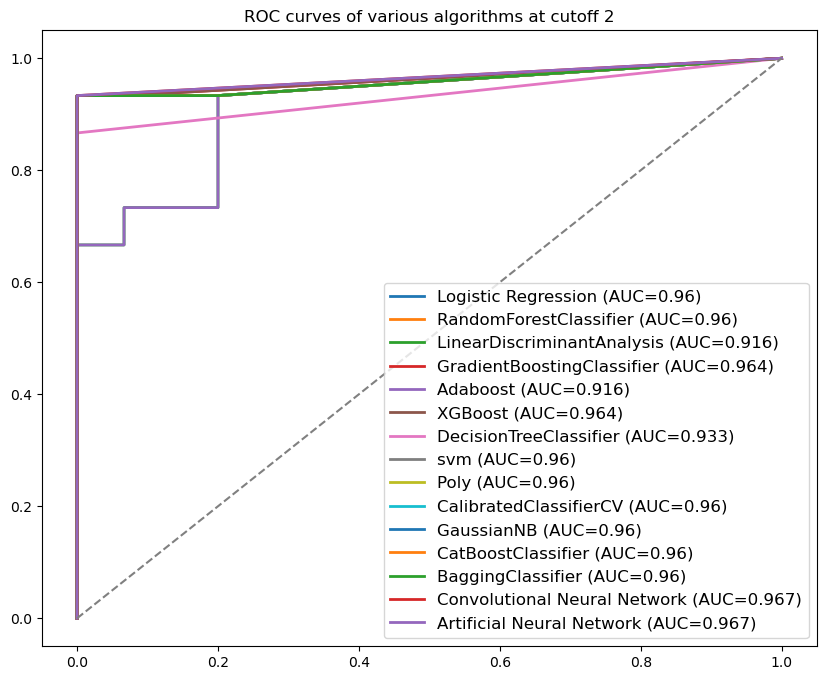

0:	learn: 0.6615535	total: 564us	remaining: 2.26ms
1:	learn: 0.6405328	total: 1.27ms	remaining: 1.91ms
2:	learn: 0.6062404	total: 1.75ms	remaining: 1.17ms
3:	learn: 0.5873460	total: 2.08ms	remaining: 519us
4:	learn: 0.5625971	total: 2.59ms	remaining: 0us
best_index 2
accuracy 0.9666666666666667
best_index 4
accuracy 0.9666666666666667
best_index 2
accuracy 0.9333333333333333
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:221: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:222: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:221: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:222: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:221: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:222: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

best_index 2
accuracy 0.9333333333333333
best_index 4
accuracy 0.9666666666666667
best_index 1
accuracy 0.9666666666666667
best_index 2
accuracy 0.9666666666666667
best_index 2
accuracy 0.9666666666666667
best_index 1
accuracy 0.9666666666666667
best_index 0
accuracy 0.9666666666666667
best_index 0
accuracy 0.5
best_index 1
accuracy 0.9666666666666667


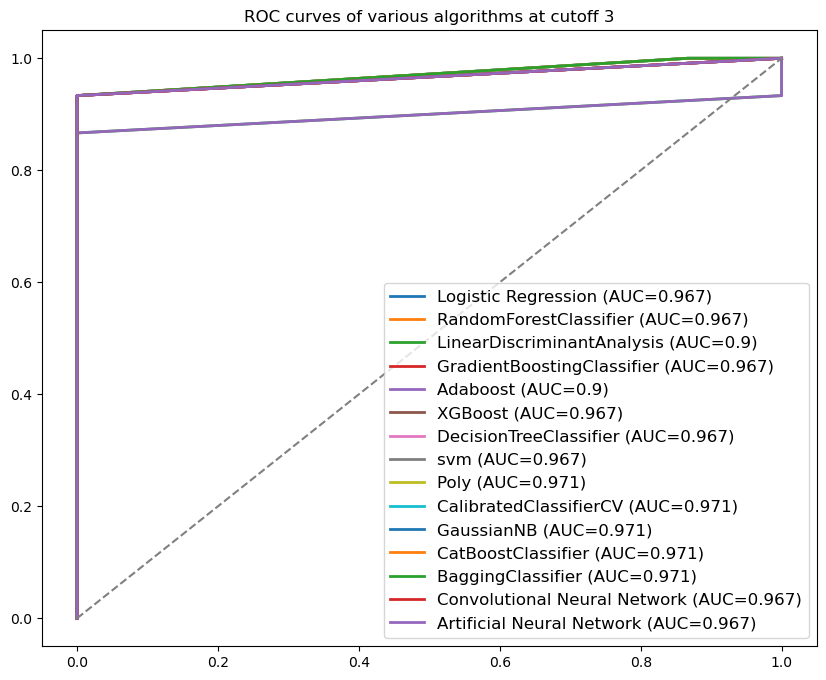

0:	learn: 0.6695560	total: 185us	remaining: 741us
1:	learn: 0.6486317	total: 574us	remaining: 861us
2:	learn: 0.6300471	total: 692us	remaining: 461us
3:	learn: 0.6135096	total: 829us	remaining: 207us
4:	learn: 0.5987519	total: 952us	remaining: 0us
best_index 1
accuracy 0.7666666666666667
best_index 1
accuracy 0.7666666666666667
best_index 1
accuracy 0.7666666666666667
best_index 1
accuracy 0.7666666666666667
best_index 1
accuracy 0.7666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:221: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:222: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:221: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:222: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:221: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:222: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

best_index 1
accuracy 0.7666666666666667
best_index 1
accuracy 0.7666666666666667
best_index 1
accuracy 0.7666666666666667
best_index 1
accuracy 0.7666666666666667
best_index 0
accuracy 0.7666666666666667
best_index 0
accuracy 0.7666666666666667
best_index 0
accuracy 0.5
best_index 0
accuracy 0.7666666666666667
Epoch 1/100
2/2 [==============================] - 1s 363ms/step - loss: 0.8309 - accuracy: 0.2045 - auc_94: 0.1173 - precision_94: 0.2045 - recall_94: 0.2045 - val_loss: 0.8052 - val_accuracy: 0.2333 - val_auc_94: 0.1711 - val_precision_94: 0.2333 - val_recall_94: 0.2333
Epoch 2/100
2/2 [==============================] - 0s 23ms/step - loss: 0.8151 - accuracy: 0.2045 - auc_94: 0.1441 - precision_94: 0.2045 - recall_94: 0.2045 - val_loss: 0.7916 - val_accuracy: 0.2333 - val_auc_94: 0.1711 - val_precision_94: 0.2333 - val_recall_94: 0.2333
Epoch 3/100
2/2 [==============================] - 0s 22ms/step - loss: 0.8003 - accuracy: 0.2045 - auc_94: 0.1441 - precision_94: 0.2045 - re

C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:323: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:324: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:323: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:324: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:323: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:324: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

Epoch 1/100
2/2 [==============================] - 1s 375ms/step - loss: 0.6830 - accuracy: 0.6136 - auc_95: 0.6364 - precision_95: 0.6136 - recall_95: 0.6136 - val_loss: 0.6210 - val_accuracy: 0.7667 - val_auc_95: 0.8289 - val_precision_95: 0.7667 - val_recall_95: 0.7667
Epoch 2/100
2/2 [==============================] - 0s 24ms/step - loss: 0.6040 - accuracy: 0.7955 - auc_95: 0.8171 - precision_95: 0.7955 - recall_95: 0.7955 - val_loss: 0.5608 - val_accuracy: 0.7667 - val_auc_95: 0.8289 - val_precision_95: 0.7667 - val_recall_95: 0.7667
Epoch 3/100
2/2 [==============================] - 0s 27ms/step - loss: 0.5302 - accuracy: 0.7955 - auc_95: 0.8425 - precision_95: 0.7955 - recall_95: 0.7955 - val_loss: 0.5168 - val_accuracy: 0.7667 - val_auc_95: 0.8289 - val_precision_95: 0.7667 - val_recall_95: 0.7667
Epoch 4/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4755 - accuracy: 0.7955 - auc_95: 0.8771 - precision_95: 0.7955 - recall_95: 0.7955 - val_loss: 0.4972 - val_

C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:388: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:389: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:388: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:389: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


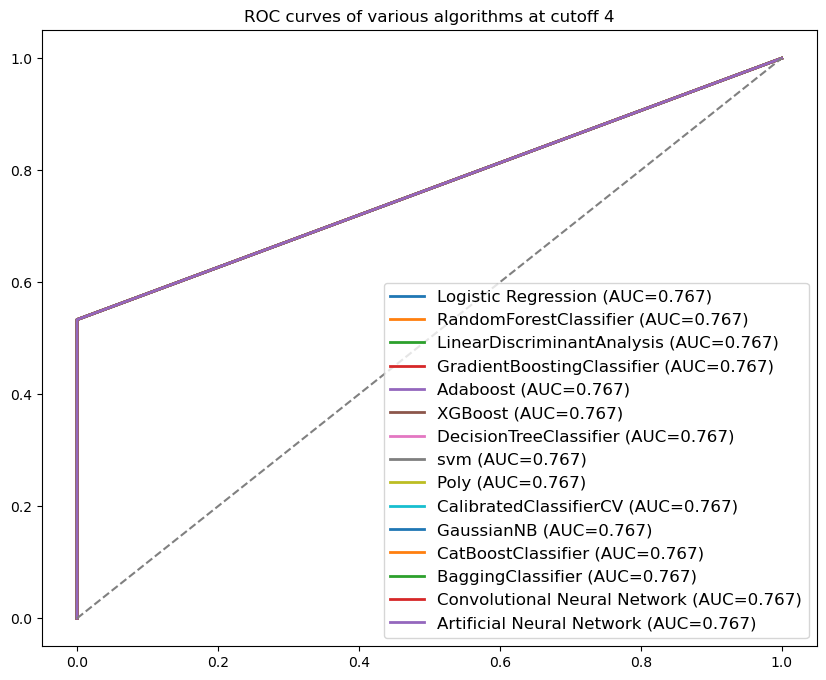

0:	learn: 0.6695561	total: 213us	remaining: 852us
1:	learn: 0.6486317	total: 666us	remaining: 999us
2:	learn: 0.6300471	total: 783us	remaining: 522us
3:	learn: 0.6135096	total: 894us	remaining: 223us
4:	learn: 0.5987520	total: 1.04ms	remaining: 0us
best_index 1
accuracy 0.7666666666666667
best_index 1
accuracy 0.7666666666666667
best_index 1
accuracy 0.7666666666666667
best_index 1
accuracy 0.7666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:221: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:222: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:221: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:222: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:221: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:222: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

best_index 1
accuracy 0.7666666666666667
best_index 1
accuracy 0.7666666666666667
best_index 1
accuracy 0.7666666666666667
best_index 1
accuracy 0.7666666666666667
best_index 1
accuracy 0.7666666666666667
best_index 0
accuracy 0.7666666666666667
best_index 0
accuracy 0.7666666666666667
best_index 0
accuracy 0.5
best_index 0
accuracy 0.7666666666666667
Epoch 1/100
2/2 [==============================] - 1s 370ms/step - loss: 0.7334 - accuracy: 0.2045 - auc_96: 0.1529 - precision_96: 0.2045 - recall_96: 0.2045 - val_loss: 0.7205 - val_accuracy: 0.5000 - val_auc_96: 0.2689 - val_precision_96: 0.5000 - val_recall_96: 0.5000
Epoch 2/100
2/2 [==============================] - 0s 19ms/step - loss: 0.7221 - accuracy: 0.5000 - auc_96: 0.2761 - precision_96: 0.5000 - recall_96: 0.5000 - val_loss: 0.7110 - val_accuracy: 0.5000 - val_auc_96: 0.3667 - val_precision_96: 0.5000 - val_recall_96: 0.5000
Epoch 3/100
2/2 [==============================] - 0s 21ms/step - loss: 0.7108 - accuracy: 0.5000 - a

C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:323: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:324: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:323: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:324: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:323: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:324: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

Epoch 1/100
2/2 [==============================] - 1s 394ms/step - loss: 0.6916 - accuracy: 0.6136 - auc_97: 0.5599 - precision_97: 0.6136 - recall_97: 0.6136 - val_loss: 0.6345 - val_accuracy: 0.7667 - val_auc_97: 0.8289 - val_precision_97: 0.7667 - val_recall_97: 0.7667
Epoch 2/100
2/2 [==============================] - 0s 25ms/step - loss: 0.6143 - accuracy: 0.7955 - auc_97: 0.8678 - precision_97: 0.7955 - recall_97: 0.7955 - val_loss: 0.5730 - val_accuracy: 0.7667 - val_auc_97: 0.8289 - val_precision_97: 0.7667 - val_recall_97: 0.7667
Epoch 3/100
2/2 [==============================] - 0s 24ms/step - loss: 0.5472 - accuracy: 0.7955 - auc_97: 0.8611 - precision_97: 0.7955 - recall_97: 0.7955 - val_loss: 0.5090 - val_accuracy: 0.7667 - val_auc_97: 0.8289 - val_precision_97: 0.7667 - val_recall_97: 0.7667
Epoch 4/100
2/2 [==============================] - 0s 30ms/step - loss: 0.4763 - accuracy: 0.7955 - auc_97: 0.8611 - precision_97: 0.7955 - recall_97: 0.7955 - val_loss: 0.4739 - val_

C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:388: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:389: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:388: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_5768\331573863.py:389: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


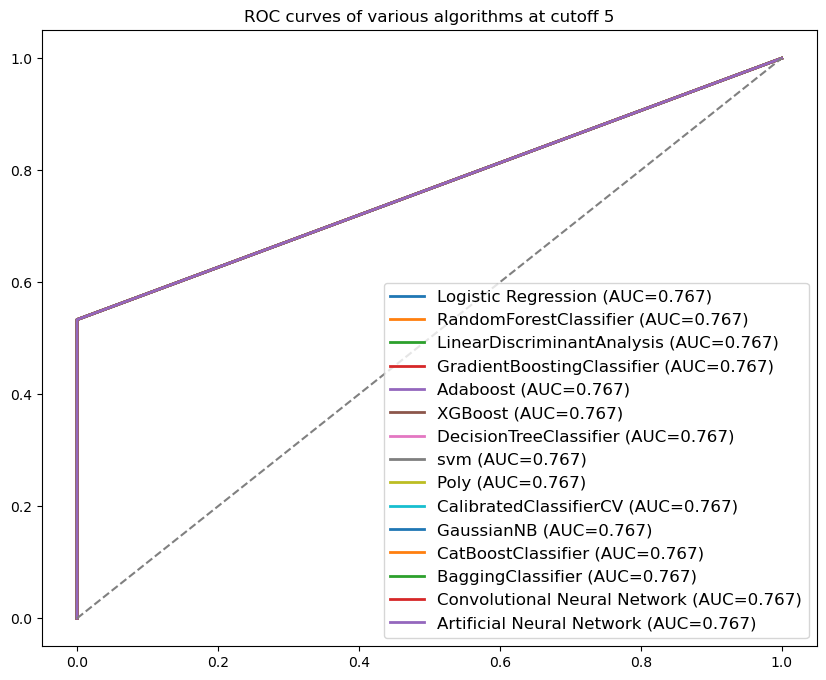

,cutoff,algorithm,best_thresthod,AUC,Accuracy,Sensitivity,Specificity,F1,FDR,Cross_entropy_loss
0,2,lr,8.105558e-02,0.960000,0.966667,0.933333,1.0,0.000000,0.965517,0.152702
0,2,rf,5.714286e-02,0.960000,0.966667,0.933333,1.0,0.000000,0.965517,1.197384
0,2,lda,5.367123e-04,0.915556,0.866667,0.933333,0.8,0.176471,0.875000,0.853605
0,2,gbdt,6.030987e-05,0.964444,0.966667,0.933333,1.0,0.000000,0.965517,0.532086
0,2,adb,5.367123e-04,0.915556,0.866667,0.933333,0.8,0.176471,0.875000,0.853605
0,2,xgb,6.030987e-05,0.964444,0.966667,0.933333,1.0,0.000000,0.965517,0.532086
0,2,dt,0.000000e+00,0.933333,0.933333,0.866667,1.0,0.000000,0.928571,2.302585
0,2,svm,1.246538e-01,0.960000,0.966667,0.933333,1.0,0.000000,0.965517,0.139766
0,2,poly,3.112482e-01,0.960000,0.966667,0.933333,1.0,0.000000,0.965517,0.354596
0,2,cv,4.518168e-01,0.866667,0.866667,0.933333,0.8,0.176471,0.875000,0.391808


In [73]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import numpy as np
import struct
import sklearn
from sklearn import *
import matplotlib.pyplot as plt
from sklearn.datasets import make_moons
import numpy as np
import pandas as pd
import sklearn
import sklearn.metrics as metrics
from sklearn.metrics import plot_roc_curve,roc_curve,auc,roc_auc_score
from matplotlib.colors import ListedColormap
from sklearn.preprocessing import StandardScaler

dfs=pd.DataFrame() 
for i in range(2,6):
    data_train=pd.read_csv('data/Glioma_multi_dimension/ori/train_e-%d.csv'%i)
    data_test=pd.read_csv('data/Glioma_multi_dimension/ori/test_e-%d.csv'%i)
    
    data_train.drop(['Unnamed: 0'], axis=1, inplace=True)
    data_train = data_train.apply(pd.to_numeric, errors='coerce')# 将非数字转换为缺失值
    data_train[data_train > 0] = 1
    data_train = data_train.sample(frac=1.0)
    data_train.to_csv("data/Glioma_multi_dimension/new_data/train_cutoff%d.csv"%i)
    
    data_test.drop(['Unnamed: 0'], axis=1, inplace=True)
    data_test = data_test.apply(pd.to_numeric, errors='coerce')# 将非数字转换为缺失值
    data_test[data_test > 0] = 1
    data_test = data_test.sample(frac=1.0)
    data_test.to_csv("data/Glioma_multi_dimension/new_data/test_cutoff%d.csv"%i)
    
    #test
    yt,Xt=np.split(data_test,indices_or_sections=(1,),axis=1)
    Xt = Xt.values
    yt = yt.values
    #train
    y,X=np.split(data_train,indices_or_sections=(1,),axis=1)
    X = X.values
    y = y.values
    #标准化 可选 knn要 其他不用
    Xs = StandardScaler().fit_transform(X) 
    Xts = StandardScaler().fit_transform(Xt) 
    train_data,train_label,train_datas,train_labels=X,y,Xs,y
    test_data,test_label,test_datas,test_labels=Xt,yt,Xts,yt

    #训练模型
    #训练模型
    # LR
    from sklearn.linear_model import LogisticRegressionCV
    from sklearn.linear_model import LogisticRegression
    lr_clf = LogisticRegression(multi_class='multinomial',solver='newton-cg',class_weight='balanced',max_iter=10000)
    #clf = LogisticRegression(multi_class='multinomial',solver='lbfgs',class_weight='balanced',max_iter=10000)
    #lr_clf = LogisticRegression()
    
    #svm linear
    from sklearn.svm import SVC
    svm_clf=SVC(kernel='linear', probability=True,random_state=10)#使用核函数为线性核，参数默认，创建分类器 

    #SVM poly
    from sklearn.svm import SVC
    import sklearn
    from sklearn.preprocessing import PolynomialFeatures, StandardScaler
    from sklearn.svm import LinearSVC
    from sklearn.pipeline import Pipeline
    def PolynomialSVC(degree, C=1.0):
        return Pipeline([
            ('poly', PolynomialFeatures(degree=degree)),
            ('std)scaler', StandardScaler()),
            ('linearSVC', LinearSVC(C=C))
        ])
    svm = PolynomialSVC(degree=3)
    from sklearn.calibration import CalibratedClassifierCV
    poly_clf = CalibratedClassifierCV(svm) 

    #KNN
    from sklearn.neighbors import KNeighborsClassifier
    knn_clf = KNeighborsClassifier(n_neighbors=10)

    #RF
    from sklearn.linear_model import LogisticRegressionCV
    from sklearn.ensemble import RandomForestClassifier #分类器
    rf_clf = RandomForestClassifier(n_estimators = 210) #训练100个基分类器

    #LDA
    from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
    from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
    lda_clf = LinearDiscriminantAnalysis() 

    #GBDT
    from sklearn.ensemble import GradientBoostingClassifier #GBDT算法
    gbdt_clf = GradientBoostingClassifier() 

    #AdaBoost
    from sklearn.ensemble import AdaBoostClassifier
    adb_clf = AdaBoostClassifier(n_estimators=100) #迭代100次

    #xgboost
    import xgboost as xgb
    from xgboost.sklearn import XGBClassifier
    xgb_clf = XGBClassifier()

    #decision tree
    from sklearn.tree import DecisionTreeClassifier
    dt_clf = DecisionTreeClassifier()
    
    #bays
    from sklearn.model_selection import StratifiedShuffleSplit
    from sklearn.naive_bayes import GaussianNB
    from sklearn.metrics import confusion_matrix
    nb_clf = GaussianNB()

    #CalibratedClassifierCV
    from sklearn.naive_bayes import GaussianNB
    from sklearn.calibration import CalibratedClassifierCV
    # 创建高斯朴素贝叶斯实例
    clf = GaussianNB()
    # 使用sigmoid校准创建校准交叉验证
    # clf_sigmoid = CalibratedClassifierCV(clf, cv=2, method='sigmoid')
    cv_clf = CalibratedClassifierCV(clf, cv=2, method='sigmoid')

    #CatBoostClassifier
    import catboost as cb
    from catboost import CatBoostClassifier
    from sklearn import metrics
    from sklearn.model_selection import train_test_split
    cbc_clf=CatBoostClassifier(iterations=5, learning_rate=0.1)

    #BaggingClassifier
    from sklearn.tree import DecisionTreeClassifier
    from sklearn.ensemble import BaggingClassifier
    from sklearn.model_selection import train_test_split
    dt = DecisionTreeClassifier(random_state=1)
    bag_clf=BaggingClassifier(base_estimator=dt, 
            n_estimators=50, random_state=1) 
    
    #神经网络算法

    #训练模型
    lr_clf.fit(train_data,train_label.astype('int').ravel())
    rf_clf.fit(train_data,train_label.astype('int').ravel())
    lda_clf.fit(train_data,train_label.astype('int').ravel())
    gbdt_clf.fit(train_data,train_label.astype('int').ravel())
    adb_clf.fit(train_data,train_label.astype('int').ravel())
    xgb_clf.fit(train_data,train_label.astype('int').ravel())
    dt_clf.fit(train_data,train_label.astype('int').ravel())
    knn_clf.fit(train_data,train_label.astype('int').ravel())
    svm_clf.fit(train_data,train_label.astype('int').ravel())
    poly_clf.fit(train_data,train_label.astype('int').ravel())
    nb_clf.fit(train_data,train_label.astype('int').ravel())
    cv_clf.fit(train_data,train_label.astype('int').ravel())
    cbc_clf.fit(train_data,train_label.astype('int').ravel())
    bag_clf.fit(train_data,train_label.astype('int').ravel())

    #prob 预测
    score_lr = lr_clf.predict_proba(test_data)[:,1]
    score_rf = rf_clf.predict_proba(test_data)[:,1]
    score_lda = lda_clf.predict_proba(test_data)[:,1]
    score_gbdt = gbdt_clf.predict_proba(test_data)[:,1]
    score_adb = lda_clf.predict_proba(test_data)[:,1]
    score_xgb = gbdt_clf.predict_proba(test_data)[:,1]
    score_dt = dt_clf.predict_proba(test_data)[:,1]
#     score_knn = knn_clf.predict_proba(test_data)[:,1]
    score_svm = svm_clf.predict_proba(test_data)[:,1]
    score_poly = poly_clf.predict_proba(test_data)[:,1]
    score_nb = nb_clf.predict_proba(test_data)[:,1]
    score_cv = cv_clf.predict_proba(test_data)[:,1]
    score_cbc = cbc_clf.predict_proba(test_data)[:,1]
    score_bag = bag_clf.predict_proba(test_data)[:,1]
    
    #0-1预测
    predict_lr = lr_clf.predict(test_data)
    predict_rf = rf_clf.predict(test_data)
    predict_lda = lda_clf.predict(test_data)
    predict_gbdt = gbdt_clf.predict(test_data)
    predict_adb = adb_clf.predict(test_data)
    predict_xgb = xgb_clf.predict(test_data)
    predict_dt = dt_clf.predict(test_data)
#     predict_knn = knn_clf.predict(test_data)
    predict_svm = svm_clf.predict(test_data)
    predict_poly = poly_clf.predict(test_data)
    predict_nb = nb_clf.predict(test_data)
    predict_cv = cv_clf.predict(test_data)
    predict_cbc = cbc_clf.predict(test_data)
    predict_bag = bag_clf.predict(test_data)
    
    #使用roc_curve方法得到三个模型的真正率TP,假正率FP和阈值threshold
    fpr_lr,tpr_lr,thres_lr = roc_curve(test_label,score_lr,)
    fpr_rf,tpr_rf,thres_rf = roc_curve(test_label,score_rf,)
    fpr_lda,tpr_lda,thres_lda = roc_curve(test_label,score_lda,)
    fpr_gbdt,tpr_gbdt,thres_gbdt = roc_curve(test_label,score_gbdt,)
    fpr_adb,tpr_adb,thres_adb = roc_curve(test_label,score_adb,)
    fpr_xgb,tpr_xgb,thres_xgb = roc_curve(test_label,score_xgb,)
    fpr_dt,tpr_dt,thres_dt = roc_curve(test_label,score_dt,)
#     fpr_knn,tpr_knn,thres_knn = roc_curve(test_label,score_knn,)
    fpr_svm,tpr_svm,thres_svm = roc_curve(test_label,score_svm,)
    fpr_poly,tpr_poly,thres_poly = roc_curve(test_label,score_poly,)
    fpr_nb,tpr_nb,thres_nb = roc_curve(test_label,score_poly,)
    fpr_cv,tpr_cv,thres_cv = roc_curve(test_label,score_poly,)
    fpr_cbc,tpr_cbc,thres_cbc = roc_curve(test_label,score_poly,)
    fpr_bag,tpr_bag,thres_bag = roc_curve(test_label,score_poly,)
    
    #修改函数已获取最佳阈值对应的最佳准确率等
    def classification_inbestthres(test_label,predict,score,fpr,tpr,thres):
        results = []
        for threshold in thres:
            if threshold > 1:
                continue
            else:
                y_pred = (score > threshold).astype(int)
                tn, fp, fn, tp = confusion_matrix(test_label, y_pred).ravel()
                accuracy = (tp + tn) / (tp + tn + fn +fp)
                recall = tp / (tp + fn)
                speciality=tn / (tn + fp)
                precision = tp / (tp + fp)
                FDR = fp / (tp + fp)
                f1 = 2 * tp / (2 * tp + fn + fp)
                Cross_entropy_loss = metrics.log_loss(test_label, score)
                results.append([threshold, roc_auc_score(test_label, score), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
        # 转换为数组并找出准确率最高的结果
        results = np.array(results)
        best_index = np.argmax(results[:, 2])
        print("best_index",best_index)
        # 输出最佳阈值下的指标
        best_threshold, auc_alg,accuracy, recall,speciality, precision, FDR, f1, Cross_entropy_loss = results[best_index, :]
        print("accuracy",accuracy)
        return best_threshold, auc_alg,accuracy, recall,speciality, FDR, f1, Cross_entropy_loss

    algorithms = ["lr","rf","lda","gbdt","adb","xgb","dt","svm","poly","cv","nb","cbc","bag"]#,"knn"
    for alg in algorithms:
        thres=eval("thres_%s"%alg)
#         thres= np.linspace(0, 1, 101)
        predict=eval("predict_%s"%alg)##***给参数名字字符串赋值的过程***
        score=eval("score_%s"%alg)
        fpr=eval("fpr_%s"%alg)
        tpr=eval("tpr_%s"%alg)
        result=classification_inbestthres(test_label,predict,score,fpr,tpr,thres)
        df=[]
        list = [i,alg,result[0],result[1],result[2],result[3],result[4],result[5],result[6],result[7]]
        df.append(list)
        data=pd.DataFrame(df)
        dfs=pd.concat([dfs,data])
    
    #加上两个神经网络算法的结果
    import tensorflow as tf
    from sklearn.datasets import load_iris
    from sklearn.model_selection import train_test_split
    from sklearn.preprocessing import StandardScaler
    import numpy as np
    from sklearn.datasets import load_iris
    from sklearn.model_selection import train_test_split
    from sklearn.preprocessing import StandardScaler
    import matplotlib.pyplot as plt
    # X_train, X_test, y_train, y_test = Xs, Xts,y,yt#标准化后结果反而差
    X_train, X_test, y_train, y_test = X, Xt,y,yt
    # Scale the data
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test = scaler.transform(X_test)
    # Convert labels to one-hot encoding
    y_train = tf.keras.utils.to_categorical(y_train, num_classes=2)
    y_test = tf.keras.utils.to_categorical(y_test, num_classes=2)
    
    #获取数据框的列数
    colnum_X_train= X_train.shape[1]
    
    '''
    2.1 卷积神经网络 用于二分类 with adam
    '''
    # Build the model
    model = tf.keras.Sequential([
        tf.keras.layers.Reshape((colnum_X_train, 1), input_shape=(colnum_X_train,)),#每次输入的x_train的大小 2*1
        tf.keras.layers.Conv1D(filters=32, kernel_size=1, activation='relu'),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(units=2, activation='softmax')#输出的类别数 0-1 两类
    ])
    # Compile the model
    model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy", tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])
    # Train the model
    history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))
    # Evaluate the model on the test data
    test_loss, test_accuracy, test_auc, test_precision, test_recall = model.evaluate(X_test, y_test)
    # Calculate the F1 score, FDR error rate, sensitivity, and specificity
    f1_score = 2 * (test_precision * test_recall) / (test_precision + test_recall)
    fdr_error_rate = 1 - test_recall
    sensitivity = test_recall
    specificity = 1 - test_precision
    # Evaluate the model
    results = model.evaluate(X_test, y_test)
    # Make predictions
    probabilities = model.predict(X_test)
    predictions = np.argmax(probabilities, axis=1)
    import numpy as np
    from sklearn.metrics import roc_auc_score, confusion_matrix, precision_recall_curve, f1_score
    from tensorflow.keras.losses import BinaryCrossentropy
    # 预测结果
    predictions = model.predict(X_test)
    # 在测试集上进行预测
    y_pred_cnn = model.predict(X_test)[:, 1]
    # 计算CNN模型的AUC
    fpr_cnn, tpr_cnn, thresholds = roc_curve(y_test[:, 1], y_pred_cnn)
    auc_cnn = auc(fpr_cnn, tpr_cnn)
    # 枚举阈值并计算分类结果
    thresholds = np.linspace(0, 1, 101)
    results = []
    for threshold in thresholds:
        y_pred = (predictions > threshold).astype(int)
        tn, fp, fn, tp = confusion_matrix(y_test.argmax(axis=1), y_pred.argmax(axis=1)).ravel()
        accuracy = (tp + tn) / (tp + tn + fn +fp)
        recall = tp / (tp + fn)
        speciality=tn / (tn + fp)
        precision = tp / (tp + fp)
        FDR = fp / (tp + fp)
        f1 = 2 * tp / (2 * tp + fn + fp)
#         Cross_entropy_loss = metrics.log_loss(y_test.argmax(axis=1), predictions.argmax(axis=1))
        Cross_entropy_loss = metrics.log_loss(y_test, predictions)
        results.append([threshold, roc_auc_score(y_test, predictions), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
#         results.append([threshold, roc_auc_score(y_test.argmax(axis=1), predictions.argmax(axis=1)), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
    # 转换为数组并找出准确率最高的结果
    results = np.array(results)
    best_index = np.argmax(results[:, 2])
    # 输出最佳阈值下的指标
    best_threshold, auc_cnn,accuracy, recall,speciality, precision, FDR, f1, Cross_entropy_loss = results[best_index, :]
    df=[]
    list = [i,'CNN',best_threshold,auc_cnn, accuracy,recall,speciality,FDR,f1,Cross_entropy_loss]
    df.append(list)
    data=pd.DataFrame(df)
    dfs=pd.concat([dfs,data])

    '''
    2.2 ann
    '''
    # Build the model
    import keras
    model = keras.Sequential([
            keras.layers.Dense(500,activation='relu',input_shape=[colnum_X_train]),#输入特征数目为2
            keras.layers.Dense(500,activation='relu'),
            keras.layers.Dense(250,activation='relu'),
            keras.layers.Dense(250,activation='relu'),
            keras.layers.Dense(2, activation='softmax')])#输出的类别为2个，所以输出层2个节点
    # Compile the model
    model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy", tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall()])
    # Train the model
    history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))
    # Evaluate the model on the test data
    test_loss, test_accuracy, test_auc, test_precision, test_recall = model.evaluate(X_test, y_test)
    # Calculate the F1 score, FDR error rate, sensitivity, and specificity
    f1_score = 2 * (test_precision * test_recall) / (test_precision + test_recall)
    fdr_error_rate = 1 - test_recall
    sensitivity = test_recall
    specificity = 1 - test_precision
    # Evaluate the model
    results = model.evaluate(X_test, y_test)
    # Make predictions
    probabilities = model.predict(X_test)
    predictions = np.argmax(probabilities, axis=1)
    import numpy as np
    from sklearn.metrics import roc_auc_score, confusion_matrix, precision_recall_curve, f1_score
    from tensorflow.keras.losses import BinaryCrossentropy
    # 预测结果
    predictions = model.predict(X_test)
    # 在测试集上进行预测
    y_pred_ann = model.predict(X_test)[:, 1]
    # 计算CNN模型的AUC
    fpr_ann, tpr_ann, thresholds = roc_curve(y_test[:, 1], y_pred_ann)
    auc_ann = auc(fpr_ann, tpr_ann)
    # 枚举阈值并计算分类结果
    thresholds = np.linspace(0, 1, 101)
    results = []
    for threshold in thresholds:
        y_pred = (predictions > threshold).astype(int)
        tn, fp, fn, tp = confusion_matrix(y_test.argmax(axis=1), y_pred.argmax(axis=1)).ravel()
#         accuracy = accuracy_score(y_test.argmax(axis=1), y_pred.argmax(axis=1))
        accuracy = (tp + tn) / (tp + tn + fn +fp)
        recall = tp / (tp + fn)
        speciality=tn / (tn + fp)
        precision = tp / (tp + fp)
        FDR = fp / (tp + fp)
        f1 = 2 * tp / (2 * tp + fn + fp)
#         f1 = f1_score(y_test.argmax(axis=1), y_pred.argmax(axis=1))
#         loss = BinaryCrossentropy(y_test.argmax(axis=1), predictions.argmax(axis=1))
#         Cross_entropy_loss = metrics.log_loss(y_test.argmax(axis=1), predictions.argmax(axis=1))
        Cross_entropy_loss = metrics.log_loss(y_test, predictions)
        results.append([threshold, roc_auc_score(y_test, predictions), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
#         results.append([threshold, roc_auc_score(y_test.argmax(axis=1), predictions.argmax(axis=1)), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
    # 转换为数组并找出准确率最高的结果
    results = np.array(results)
    best_index = np.argmax(results[:, 2])
    # 输出最佳阈值下的指标
    best_threshold, auc_ann,accuracy, recall,speciality, precision, FDR, f1, Cross_entropy_loss = results[best_index, :]
    df=[]
    list = [i,'ANN',best_threshold,auc_ann, accuracy,recall,speciality,FDR,f1,Cross_entropy_loss]
    df.append(list)
    data=pd.DataFrame(df)
    dfs=pd.concat([dfs,data])
    
    #ROC
    #创建画布
    fig,ax = plt.subplots(figsize=(10,8))
    #自定义标签名称label=''
    ax.plot(fpr_lr,tpr_lr,linewidth=2,
            label='Logistic Regression (AUC={})'.format(str(round(auc(fpr_lr,tpr_lr),3))))
    ax.plot(fpr_rf,tpr_rf,linewidth=2,
            label='RandomForestClassifier (AUC={})'.format(str(round(auc(fpr_rf,tpr_rf),3))))
    ax.plot(fpr_lda,tpr_lda,linewidth=2,
            label='LinearDiscriminantAnalysis (AUC={})'.format(str(round(auc(fpr_lda,tpr_lda),3))))
    ax.plot(fpr_gbdt,tpr_gbdt,linewidth=2,
            label='GradientBoostingClassifier (AUC={})'.format(str(round(auc(fpr_gbdt,tpr_gbdt),3))))
    ax.plot(fpr_adb,tpr_adb,linewidth=2,
            label='Adaboost (AUC={})'.format(str(round(auc(fpr_adb,tpr_adb),3))))
    ax.plot(fpr_xgb,tpr_xgb,linewidth=2,
            label='XGBoost (AUC={})'.format(str(round(auc(fpr_xgb,tpr_xgb),3))))
    ax.plot(fpr_dt,tpr_dt,linewidth=2,
            label='DecisionTreeClassifier (AUC={})'.format(str(round(auc(fpr_dt,tpr_dt),3))))
#     ax.plot(fpr_knn,tpr_knn,linewidth=2,
#            label='K Nearest Neibor (AUC={})'.format(str(round(auc(fpr_knn,tpr_knn),3))))
    ax.plot(fpr_svm,tpr_svm,linewidth=2,
            label='svm (AUC={})'.format(str(round(auc(fpr_svm,tpr_svm),3))))
    ax.plot(fpr_poly,tpr_poly,linewidth=2,
            label='Poly (AUC={})'.format(str(round(auc(fpr_poly,tpr_poly),3))))
    ax.plot(fpr_cv,tpr_cv,linewidth=2,
           label='CalibratedClassifierCV (AUC={})'.format(str(round(auc(fpr_cv,tpr_cv),3))))
    ax.plot(fpr_nb,tpr_nb,linewidth=2,
            label='GaussianNB (AUC={})'.format(str(round(auc(fpr_nb,tpr_nb),3))))
    ax.plot(fpr_cbc,tpr_cbc,linewidth=2,
            label='CatBoostClassifier (AUC={})'.format(str(round(auc(fpr_cbc,tpr_cbc),3))))
    ax.plot(fpr_bag,tpr_bag,linewidth=2,
            label='BaggingClassifier (AUC={})'.format(str(round(auc(fpr_bag,tpr_bag),3))))
    ax.plot(fpr_cnn,tpr_cnn,linewidth=2,
            label='Convolutional Neural Network (AUC={})'.format(str(round(auc(fpr_cnn,tpr_cnn),3))))
    ax.plot(fpr_ann,tpr_ann,linewidth=2,
            label='Artificial Neural Network (AUC={})'.format(str(round(auc(fpr_ann,tpr_ann),3))))
    #绘制对角线
    ax.plot([0,1],[0,1],linestyle='--',color='grey')
    #调整字体大小
    plt.legend(fontsize=12)
    plt.title("ROC curves of various algorithms at cutoff %d"%i)
    plt.savefig("data/Glioma_multi_dimension/figure/cutoff%d"%i)
    plt.show()
    
dfs.columns = ['cutoff','algorithm','best_thresthod','AUC','Accuracy','Sensitivity','Specificity','F1','FDR','Cross_entropy_loss']
dfs.to_csv("data/Glioma_multi_dimension/result_sheet/result_multi_dimension_cutoff1.csv")
dfs

# Figure4 Multidimensional Downscaling
## Lasso

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:1614: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


最终维数: 20
feature_names Index(['CASSSYNEQFF_TRBV12_TRBJ2-1', 'CASRGTGNQPQHF_TRBV12_TRBJ1-5',
       'CASSQETQYF_TRBV3_TRBJ2-5', 'CASSYSPTSGLYNEQFF_TRBV6_TRBJ2-1',
       'CASSLLGNTEAFF_TRBV12_TRBJ1-1', 'CASSLGGGYTF_TRBV12_TRBJ1-2',
       'CASSSGQGNTEAFF_TRBV7-9_TRBJ1-1', 'CASSFGQGYGYTF_TRBV12_TRBJ1-2',
       'CASSFGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFLGTEAFF_TRBV12_TRBJ1-1',
       'CASSQGGGNQPQHF_TRBV3_TRBJ1-5', 'CASSPANTEAFF_TRBV18-1_TRBJ1-1',
       'CASSLRETQYF_TRBV12_TRBJ2-5', 'CASSLGGNQPQHF_TRBV12_TRBJ1-5',
       'CASSQGYEQYF_TRBV3_TRBJ2-7', 'CASSPSNQPQHF_TRBV12_TRBJ1-5',
       'CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSLTGNTEAFF_TRBV12_TRBJ1-1',
       'CASSYSDTGELFF_TRBV6_TRBJ2-2', 'CASSLSGNTIYF_TRBV12_TRBJ1-3'],
      dtype='object') <bound method Index.astype of Index(['CASSSYNEQFF_TRBV12_TRBJ2-1', 'CASRGTGNQPQHF_TRBV12_TRBJ1-5',
       'CASSQETQYF_TRBV3_TRBJ2-5', 'CASSYSPTSGLYNEQFF_TRBV6_TRBJ2-1',
       'CASSLLGNTEAFF_TRBV12_TRBJ1-1', 'CASSLGGGYTF_TRBV12_TRBJ1-2',
       'CASSSGQGN

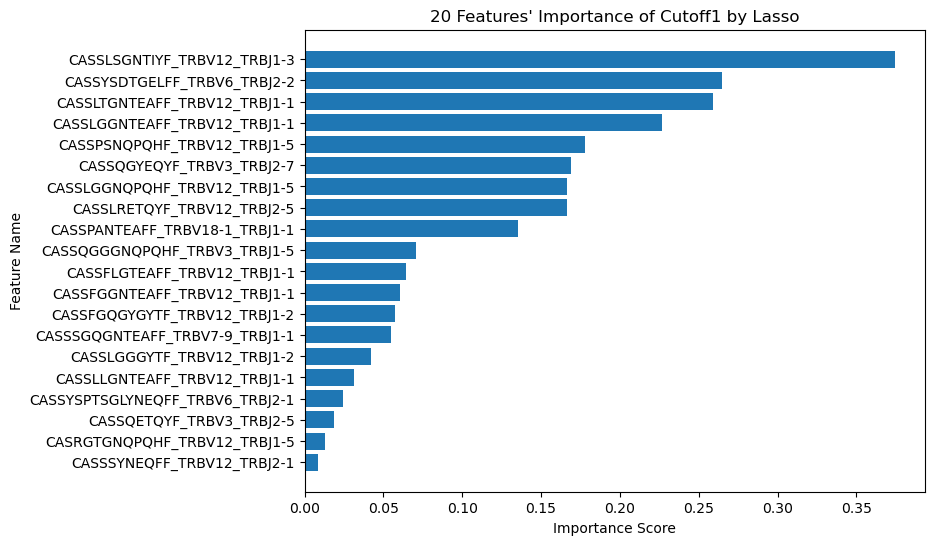

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:1614: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


最终维数: 14
feature_names Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSQVSYEQYF_TRBV3_TRBJ2-7',
       'CASSQAYEQYF_TRBV3_TRBJ2-7', 'CASSQVGYEQYF_TRBV3_TRBJ2-7',
       'CASSYNSGANVLTF_TRBV6_TRBJ2-6', 'CASSLGGGYTF_TRBV12_TRBJ1-2',
       'CASSQETQYF_TRBV3_TRBJ2-5', 'CASSLGGNQPQHF_TRBV12_TRBJ1-5',
       'CASSLRETQYF_TRBV12_TRBJ2-5', 'CASSFGGNTEAFF_TRBV12_TRBJ1-1',
       'CASSLTGNTEAFF_TRBV12_TRBJ1-1', 'CASSLQETQYF_TRBV12_TRBJ2-5',
       'CASSQGETQYF_TRBV3_TRBJ2-5', 'CASSLSGNTIYF_TRBV12_TRBJ1-3'],
      dtype='object') <bound method Index.astype of Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSQVSYEQYF_TRBV3_TRBJ2-7',
       'CASSQAYEQYF_TRBV3_TRBJ2-7', 'CASSQVGYEQYF_TRBV3_TRBJ2-7',
       'CASSYNSGANVLTF_TRBV6_TRBJ2-6', 'CASSLGGGYTF_TRBV12_TRBJ1-2',
       'CASSQETQYF_TRBV3_TRBJ2-5', 'CASSLGGNQPQHF_TRBV12_TRBJ1-5',
       'CASSLRETQYF_TRBV12_TRBJ2-5', 'CASSFGGNTEAFF_TRBV12_TRBJ1-1',
       'CASSLTGNTEAFF_TRBV12_TRBJ1-1', 'CASSLQETQYF_TRBV12_TRBJ2-5',
       'CASSQGETQYF_TRBV3_TRBJ2-5', 'CA

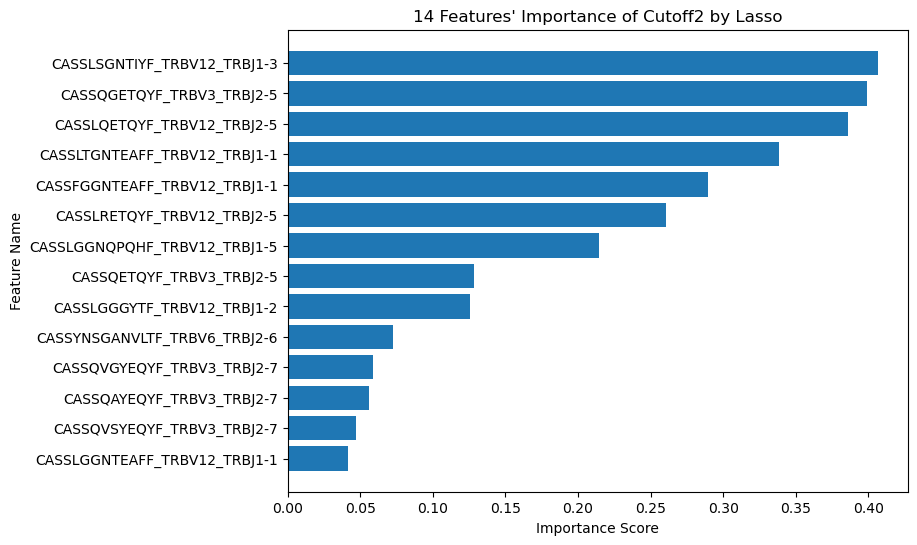

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\linear_model\_coordinate_descent.py:1614: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


最终维数: 9
feature_names Index(['CASSQGYEQYF_TRBV3_TRBJ2-7', 'CASSLGGNTEAFF_TRBV12_TRBJ1-1',
       'CASSLGGGYTF_TRBV12_TRBJ1-2', 'CASSLGGNQPQHF_TRBV12_TRBJ1-5',
       'CASSFGGNTEAFF_TRBV12_TRBJ1-1', 'CASSLQETQYF_TRBV12_TRBJ2-5',
       'CASSLRETQYF_TRBV12_TRBJ2-5', 'CASSLSGNTIYF_TRBV12_TRBJ1-3',
       'CASSLTGNTEAFF_TRBV12_TRBJ1-1'],
      dtype='object') <bound method Index.astype of Index(['CASSQGYEQYF_TRBV3_TRBJ2-7', 'CASSLGGNTEAFF_TRBV12_TRBJ1-1',
       'CASSLGGGYTF_TRBV12_TRBJ1-2', 'CASSLGGNQPQHF_TRBV12_TRBJ1-5',
       'CASSFGGNTEAFF_TRBV12_TRBJ1-1', 'CASSLQETQYF_TRBV12_TRBJ2-5',
       'CASSLRETQYF_TRBV12_TRBJ2-5', 'CASSLSGNTIYF_TRBV12_TRBJ1-3',
       'CASSLTGNTEAFF_TRBV12_TRBJ1-1'],
      dtype='object')>
importance_scores [0.02884515 0.08535084 0.11900038 0.18401419 0.19085402 0.23613771
 0.28371041 0.33457327 0.37448505] <built-in method astype of numpy.ndarray object at 0x0000014FA50DD8D0>


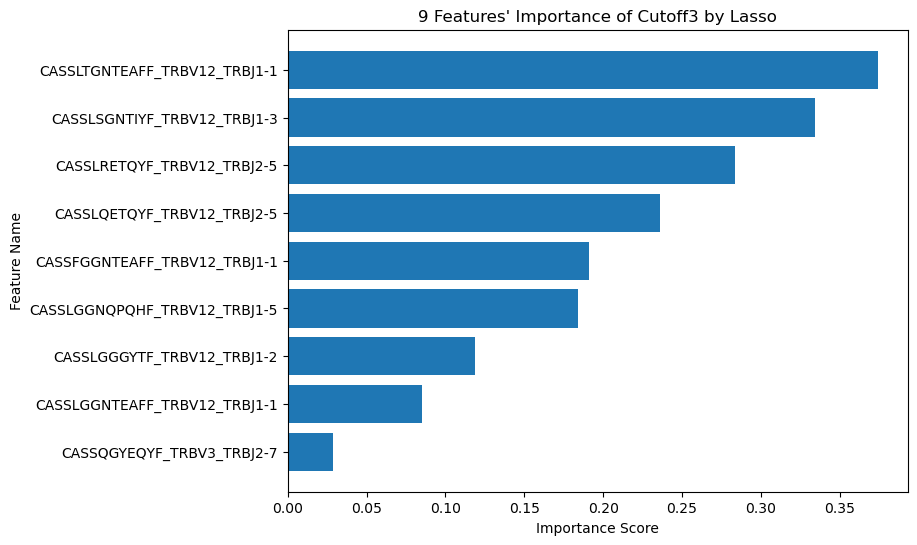

,Dimensionality_reduction_methods,cutoff,dimension,index,TCR,importance
0,Lasso,1,20,20,CASSSYNEQFF_TRBV12_TRBJ2-1,0.008435
0,Lasso,1,20,19,CASRGTGNQPQHF_TRBV12_TRBJ1-5,0.013209
0,Lasso,1,20,18,CASSQETQYF_TRBV3_TRBJ2-5,0.018824
0,Lasso,1,20,17,CASSYSPTSGLYNEQFF_TRBV6_TRBJ2-1,0.024050
0,Lasso,1,20,16,CASSLLGNTEAFF_TRBV12_TRBJ1-1,0.031463
0,Lasso,1,20,15,CASSLGGGYTF_TRBV12_TRBJ1-2,0.042394
0,Lasso,1,20,14,CASSSGQGNTEAFF_TRBV7-9_TRBJ1-1,0.054985
0,Lasso,1,20,13,CASSFGQGYGYTF_TRBV12_TRBJ1-2,0.057027
0,Lasso,1,20,12,CASSFGGNTEAFF_TRBV12_TRBJ1-1,0.060595
0,Lasso,1,20,11,CASSFLGTEAFF_TRBV12_TRBJ1-1,0.064377


In [12]:
dfs=pd.DataFrame() 
for i in range(1,4):
    data_train=pd.read_csv('data/Glioma_multi_dimension/ori/train_e-%d.csv'%i)
    data_test=pd.read_csv('data/Glioma_multi_dimension/ori/test_e-%d.csv'%i)
    
    data_train.drop(['Unnamed: 0'], axis=1, inplace=True)
    data_train = data_train.apply(pd.to_numeric, errors='coerce')# 将非数字转换为缺失值
    data_train[data_train > 0] = 1
    data_train = data_train.sample(frac=1.0)
    
    data_test.drop(['Unnamed: 0'], axis=1, inplace=True)
    data_test = data_test.apply(pd.to_numeric, errors='coerce')# 将非数字转换为缺失值
    data_test[data_test > 0] = 1
    data_test = data_test.sample(frac=1.0)
    
    #test
    yt_d,Xt_d=np.split(data_test,indices_or_sections=(1,),axis=1)
    Xt = Xt_d.values
    yt = yt_d.values
    #train
    y_d,X_d=np.split(data_train,indices_or_sections=(1,),axis=1)
    X = X_d.values
    y = y_d.values
    #标准化 可选 knn要 其他不用
    Xs = StandardScaler().fit_transform(X) 
    Xts = StandardScaler().fit_transform(Xt) 
    train_data,train_label,train_datas,train_labels=X,y,Xs,y
    test_data,test_label,test_datas,test_labels=Xt,yt,Xts,yt

    # X为特征矩阵，y为目标变量
    # 首先使用lasso选择特征
    lasso = LassoCV(cv=10, random_state=0)
    lasso.fit(X_d, y_d)
#     selected_cols = X_d.columns[lasso.coef_ != 0]
    
    coef = lasso.coef_

    # 确定最佳降维的维数和对应的列名
    n_features = np.sum(coef != 0)
    feature_names = X_d.columns[coef != 0]

    print("最终维数:", len(feature_names))
#     print("Selected features:", feature_names)
    
    # 按重要性分数排序
    importance_scores = np.abs(coef[coef != 0])
    sorted_indices = np.argsort(importance_scores)#[::-1] 是要从小到大则解开注释
    importance_scores = importance_scores[sorted_indices]
    feature_names = feature_names[sorted_indices]
    print("feature_names",feature_names,feature_names.astype)
    print("importance_scores",importance_scores,importance_scores.astype)
    
    #输入表格
    for k in range(len(feature_names)):
        df=[]
        list=["Lasso",i,len(feature_names),len(feature_names)-k,feature_names[k],importance_scores[k]]
        df.append(list)
        data=pd.DataFrame(df)
        dfs=pd.concat([dfs,data])
    
    # 绘制每个特征的重要性因子条形图
    plt.figure(figsize=(8, 6))
    plt.barh(feature_names, importance_scores)
    plt.xlabel("Importance Score")
    plt.ylabel("Feature Name")
    plt.title("%d Features' Importance of Cutoff%d by Lasso"%(len(feature_names),i))
    plt.show()

dfs.columns = ['Dimensionality_reduction_methods','cutoff','dimension', 'index','TCR','importance']
dfs.to_csv('data/Glioma_multi_dimension/ori/lasso.csv')
dfs

## RFECV
### Features Selection

In [13]:
'''
模型定义
'''

# LR
from sklearn.linear_model import LogisticRegressionCV
from sklearn.linear_model import LogisticRegression
lr_clf = LogisticRegression(multi_class='multinomial',solver='newton-cg',class_weight='balanced',max_iter=10000)
clf_lr = LogisticRegression(multi_class='multinomial',solver='newton-cg',class_weight='balanced',max_iter=10000)
#clf = LogisticRegression(multi_class='multinomial',solver='lbfgs',class_weight='balanced',max_iter=10000)
#lr_clf = LogisticRegression()

#svm linear
from sklearn.svm import SVC
svm_clf=SVC(kernel='linear', probability=True,random_state=10)#使用核函数为线性核，参数默认，创建分类器 

#SVM poly
from sklearn.svm import SVC
import sklearn
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.svm import LinearSVC
from sklearn.pipeline import Pipeline
def PolynomialSVC(degree, C=1.0):
    return Pipeline([
        ('poly', PolynomialFeatures(degree=degree)),
        ('std)scaler', StandardScaler()),
        ('linearSVC', LinearSVC(C=C))
    ])
svm = PolynomialSVC(degree=3)
from sklearn.calibration import CalibratedClassifierCV
poly_clf = CalibratedClassifierCV(svm) 

#KNN
from sklearn.neighbors import KNeighborsClassifier
knn_clf = KNeighborsClassifier(n_neighbors=10)

#RF
from sklearn.linear_model import LogisticRegressionCV
from sklearn.ensemble import RandomForestClassifier #分类器
rf_clf = RandomForestClassifier(n_estimators = 210) #训练100个基分类器

#LDA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
lda_clf = LinearDiscriminantAnalysis() 

#GBDT
from sklearn.ensemble import GradientBoostingClassifier #GBDT算法
gbdt_clf = GradientBoostingClassifier() 

#AdaBoost
from sklearn.ensemble import AdaBoostClassifier
adb_clf = AdaBoostClassifier(n_estimators=100) #迭代100次

#xgboost
import xgboost as xgb
from xgboost.sklearn import XGBClassifier
xgb_clf = XGBClassifier()

#decision tree
from sklearn.tree import DecisionTreeClassifier
dt_clf = DecisionTreeClassifier()

#bays
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import confusion_matrix
nb_clf = GaussianNB()

#CalibratedClassifierCV
from sklearn.naive_bayes import GaussianNB
from sklearn.calibration import CalibratedClassifierCV
# 创建高斯朴素贝叶斯实例
clf = GaussianNB()
# 使用sigmoid校准创建校准交叉验证
# clf_sigmoid = CalibratedClassifierCV(clf, cv=2, method='sigmoid')
cv_clf = CalibratedClassifierCV(clf, cv=2, method='sigmoid')

#CatBoostClassifier
import catboost as cb
from catboost import CatBoostClassifier
from sklearn import metrics
from sklearn.model_selection import train_test_split
cbc_clf=CatBoostClassifier(iterations=5, learning_rate=0.1)

#BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.model_selection import train_test_split
dt = DecisionTreeClassifier(random_state=1)
bag_clf=BaggingClassifier(base_estimator=dt, 
        n_estimators=50, random_state=1) 

#修改函数已获取最佳阈值对应的最佳准确率等
def classification_inbestthres_valid(test_label,predict,score,fpr,tpr,thres):
    results = []
    for threshold in thres:
        if threshold > 1:
            continue
        else:
            y_pred = (score > threshold).astype(int)
            tn, fp, fn, tp = confusion_matrix(test_label, y_pred).ravel()
            accuracy = (tp + tn) / (tp + tn + fn +fp)
            recall = tp / (tp + fn)
            speciality=tn / (tn + fp)
            precision = tp / (tp + fp)
            FDR = fp / (tp + fp)
            f1 = 2 * tp / (2 * tp + fn + fp)
            Cross_entropy_loss = metrics.log_loss(test_label, score)
            results.append([threshold, roc_auc_score(test_label, score), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
    # 转换为数组并找出准确率最高的结果
    results = np.array(results)
    best_index = np.argmax(results[:, 2])
    print("best_index",best_index)
    # 输出最佳阈值下的指标
    best_threshold, auc_alg,accuracy, recall,speciality, precision, FDR, f1, Cross_entropy_loss = results[best_index, :]
    print("accuracy",accuracy)
    return best_threshold, auc_alg,accuracy, recall,speciality, FDR, f1, Cross_entropy_loss


algorithms = ["lr","rf","lda","gbdt","adb","xgb","dt","svm","poly","cv","nb","cbc","bag"]#,"knn"

cutoff1
降维算法： lr


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

Optimal number of features : 327
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFGGNTEAFF_TRBV12_TRBJ1-1',
       'CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGETQYF_TRBV12_TRBJ2-5',
       'CASSLGYEQYF_TRBV12_TRBJ2-7', 'CASSLGGGYTF_TRBV12_TRBJ1-2',
       'CASSQGYEQYF_TRBV3_TRBJ2-7', 'CASSLGGNQPQHF_TRBV12_TRBJ1-5',
       'CASSLRETQYF_TRBV12_TRBJ2-5', 'CASSLSGNTIYF_TRBV12_TRBJ1-3',
       ...
       'CASSRGYEQYF_TRBV3_TRBJ2-7', 'CATRDSQETQYF_TRBV24_TRBJ2-5',
       'CASSEGGSSYNSPLHF_TRBV2-1_TRBJ1-6', 'CASSSTATNEKLFF_TRBV5-1_TRBJ1-4',
       'CASSRGYEQYF_TRBV12_TRBJ2-7', 'CASRPGQGYEQYF_TRBV12_TRBJ2-7',
       'CASSPGETQYF_TRBV3_TRBJ2-5', 'CAWSLAYEQYF_TRBV30-1_TRBJ2-7',
       'CASSASTDTQYF_TRBV5-1_TRBJ2-3', 'CASSFGTGSYEQYF_TRBV12_TRBJ2-7'],
      dtype='object', length=327)
分类算法： lr
best_index 1
accuracy 0.9333333333333333


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


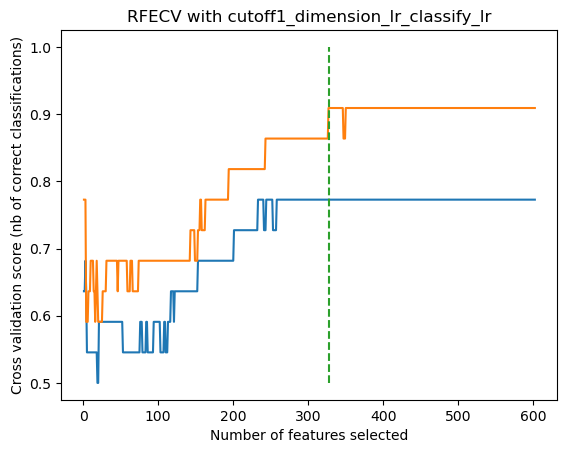

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 3
accuracy 0.9333333333333333


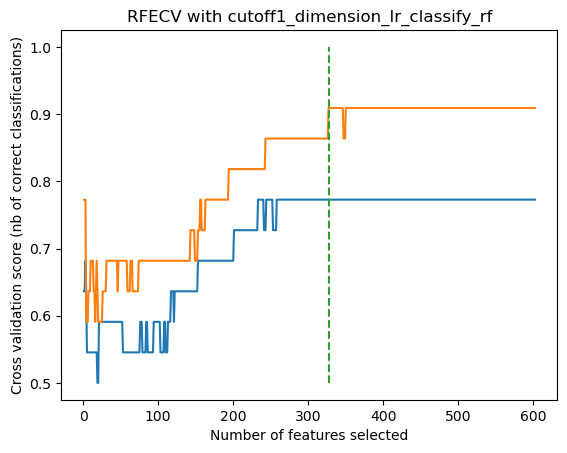

分类算法： lda


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 1
accuracy 0.9666666666666667


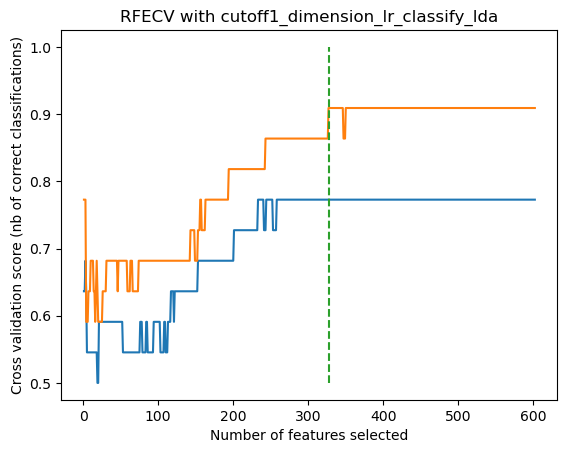

分类算法： gbdt
best_index 2
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


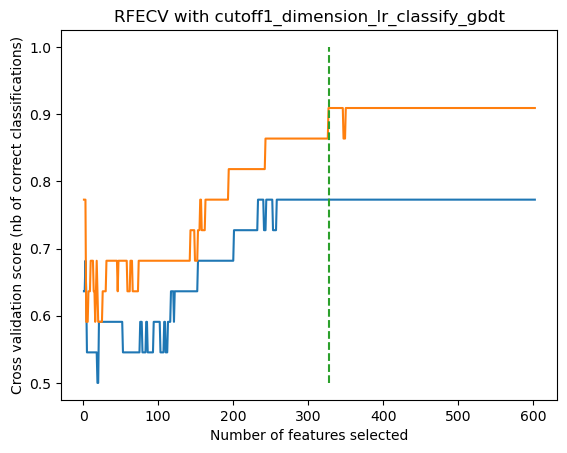

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9666666666666667


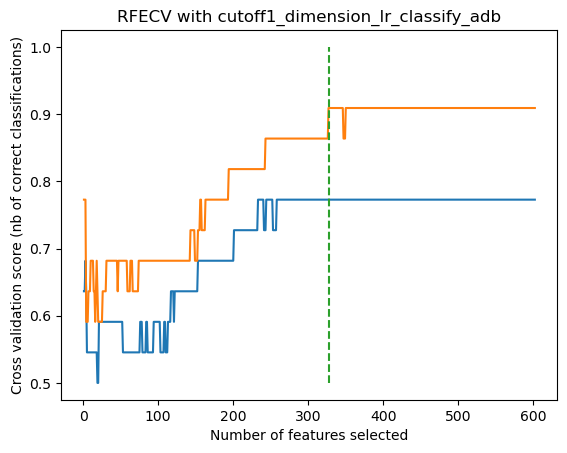

分类算法： xgb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9666666666666667


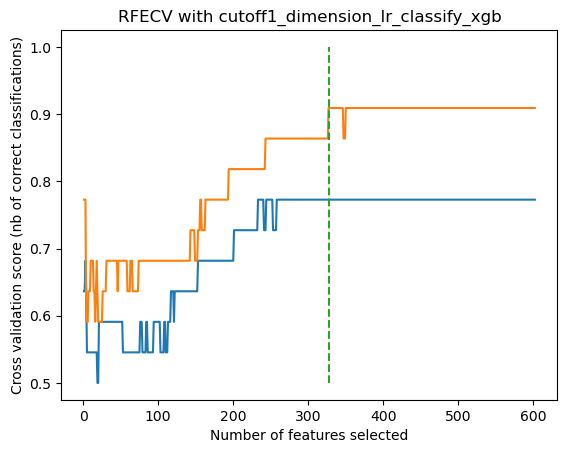

分类算法： dt
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


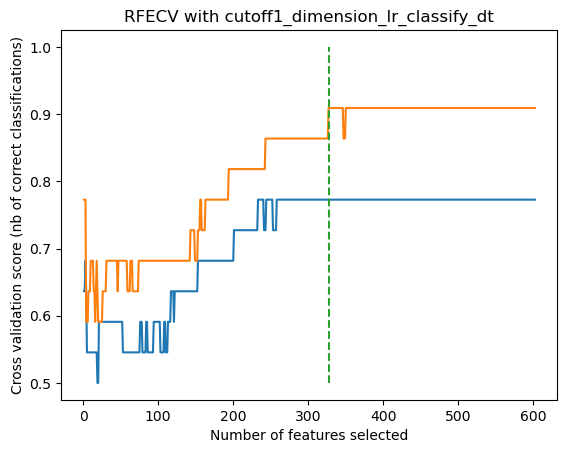

分类算法： svm
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


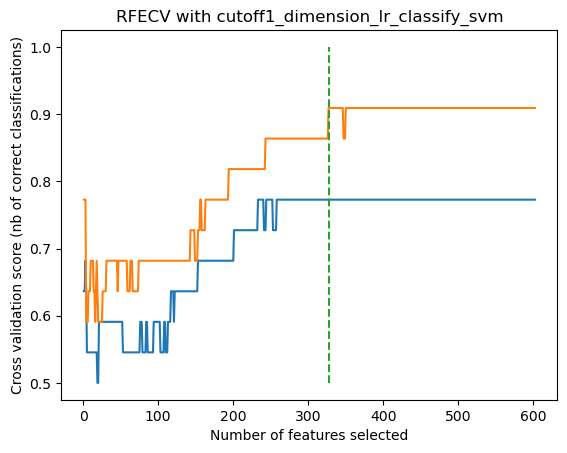

分类算法： nb
best_index 0
accuracy 0.5


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


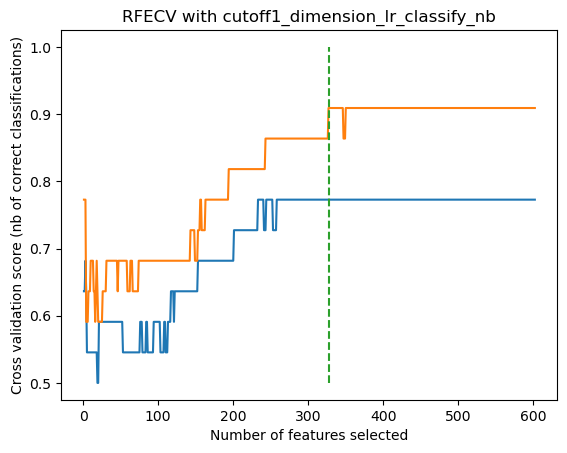

分类算法： cbc
0:	learn: 0.6294439	total: 15.3ms	remaining: 61.2ms
1:	learn: 0.5542199	total: 29.4ms	remaining: 44ms
2:	learn: 0.4950158	total: 46.6ms	remaining: 31.1ms
3:	learn: 0.4334259	total: 71.5ms	remaining: 17.9ms
4:	learn: 0.3865714	total: 102ms	remaining: 0us


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9666666666666667


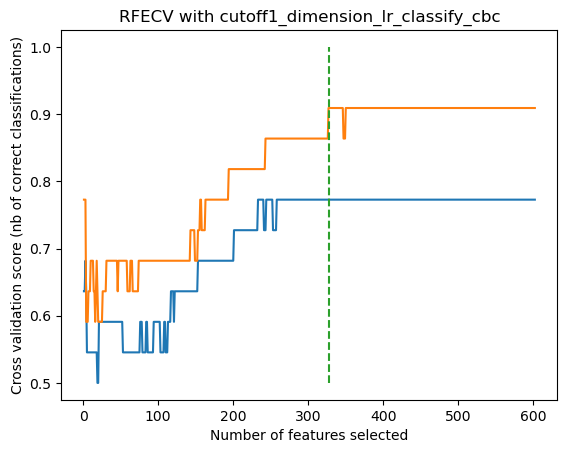

分类算法： bag


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 4
accuracy 0.9666666666666667


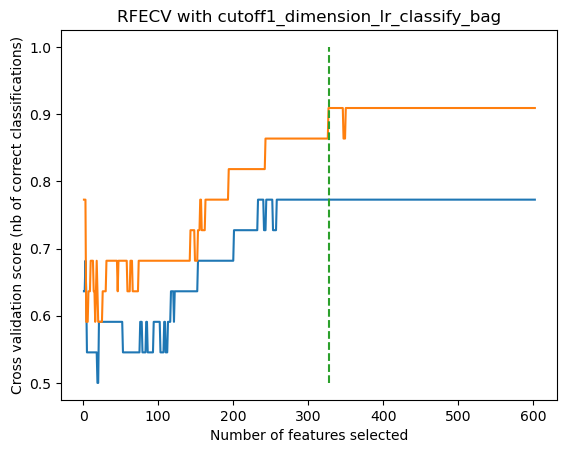

分类算法： cv
best_index 0
accuracy 0.5


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


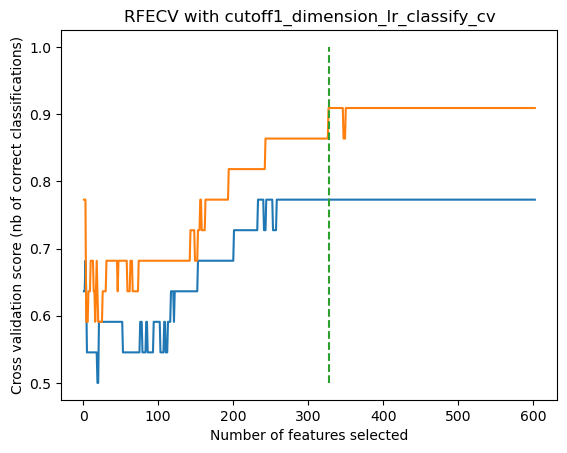

降维算法： rf


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\feature_selection\_rfe.py:296: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X[:, features], y, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\feature_selection\_rfe.py:296: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X[:, features], y, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\feature_selection\_rfe.py:296: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X[:, features], y, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\feature_selection\_rfe.py:296: DataConversionWarning: A column-vector y was passed when a 1

Optimal number of features : 15
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFGGNTEAFF_TRBV12_TRBJ1-1',
       'CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGETQYF_TRBV12_TRBJ2-5',
       'CASSLGYEQYF_TRBV12_TRBJ2-7', 'CASSLGGGYTF_TRBV12_TRBJ1-2',
       'CASSQGYEQYF_TRBV3_TRBJ2-7', 'CASSLGGNQPQHF_TRBV12_TRBJ1-5',
       'CASSLRETQYF_TRBV12_TRBJ2-5', 'CASSLSGNTIYF_TRBV12_TRBJ1-3',
       'CASSLTGNTEAFF_TRBV12_TRBJ1-1', 'CASSLGNQPQHF_TRBV12_TRBJ1-5',
       'CASSLRGDTEAFF_TRBV12_TRBJ1-1', 'CASSLGGNTIYF_TRBV12_TRBJ1-3',
       'CASSDGSIRDYTF_TRBV2-1_TRBJ1-2'],
      dtype='object')
分类算法： lr
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


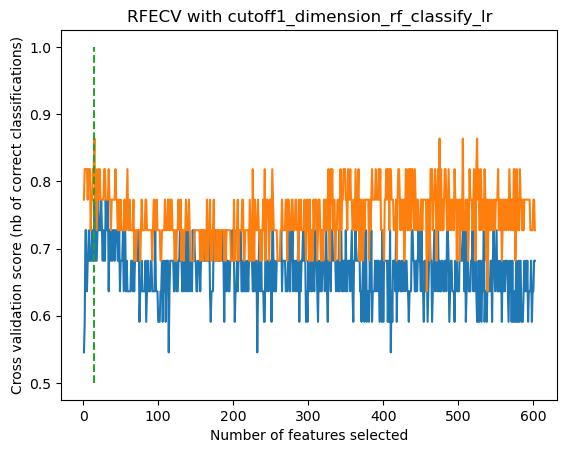

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 3
accuracy 0.9666666666666667


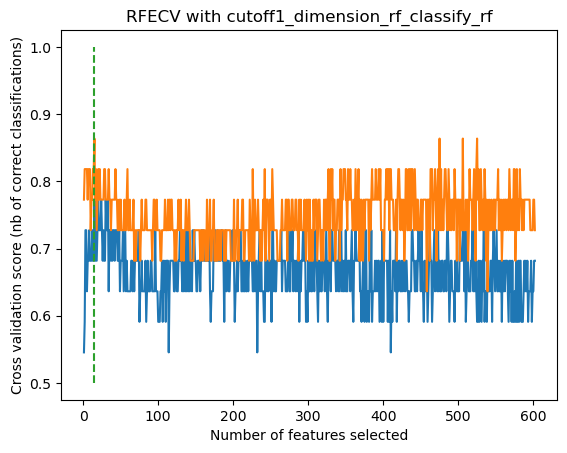

分类算法： lda
best_index 2
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


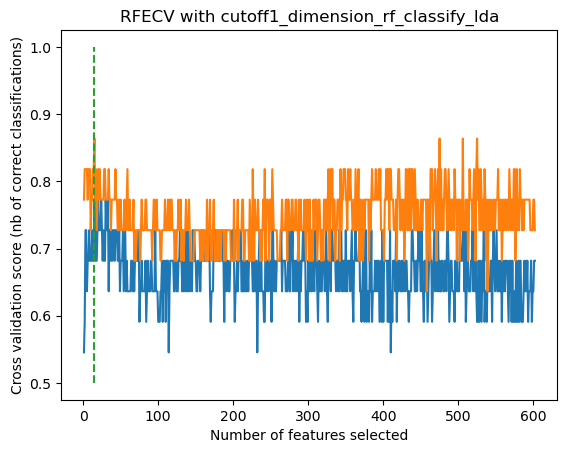

分类算法： gbdt
best_index 5
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


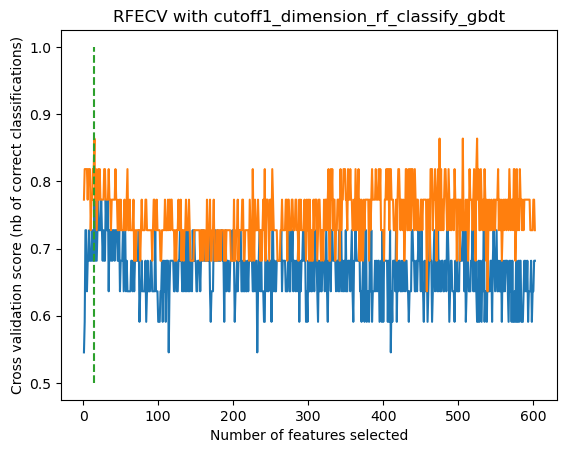

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 3
accuracy 0.9666666666666667


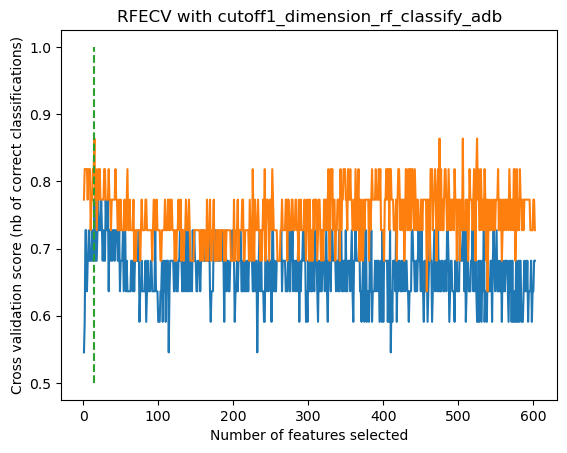

分类算法： xgb
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


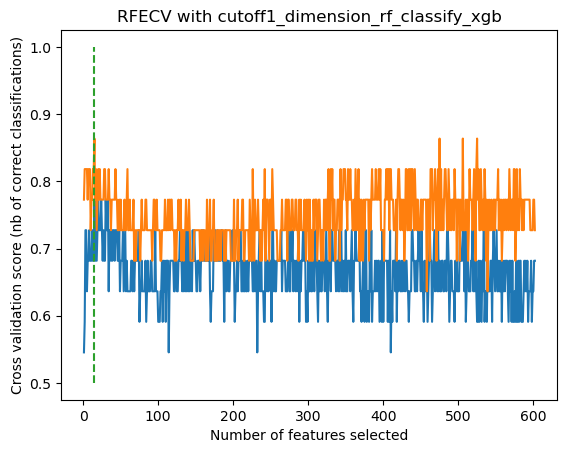

分类算法： dt
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


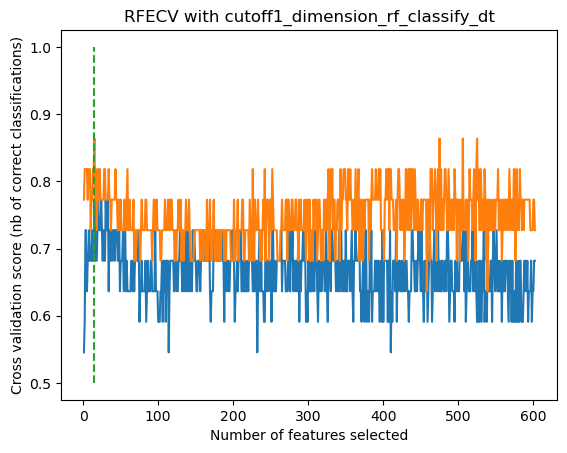

分类算法： svm
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


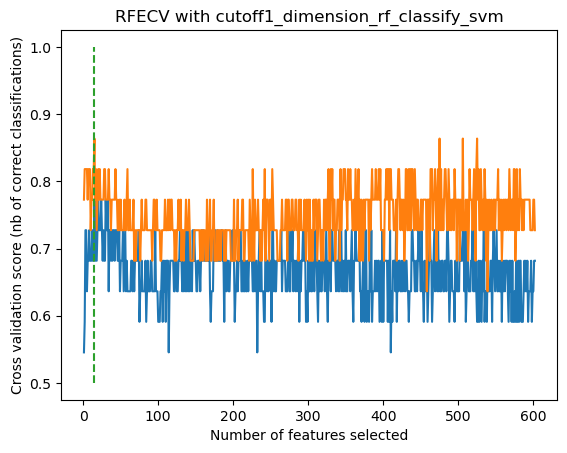

分类算法： nb
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


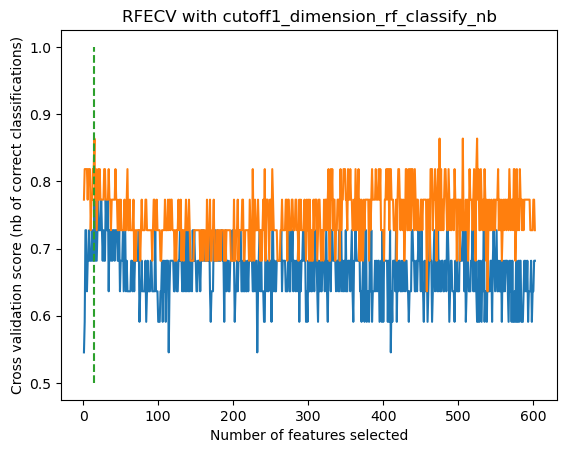

分类算法： cbc
0:	learn: 0.6602774	total: 1.04ms	remaining: 4.16ms
1:	learn: 0.6348828	total: 1.97ms	remaining: 2.96ms
2:	learn: 0.6011369	total: 2.64ms	remaining: 1.76ms
3:	learn: 0.5885788	total: 2.94ms	remaining: 735us
4:	learn: 0.5626626	total: 3.86ms	remaining: 0us
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


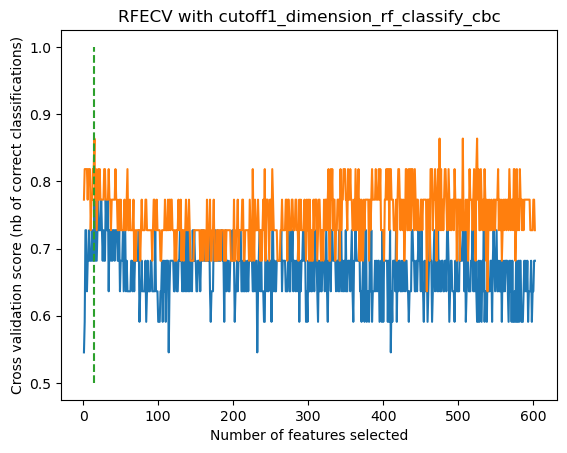

分类算法： bag
best_index 3
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


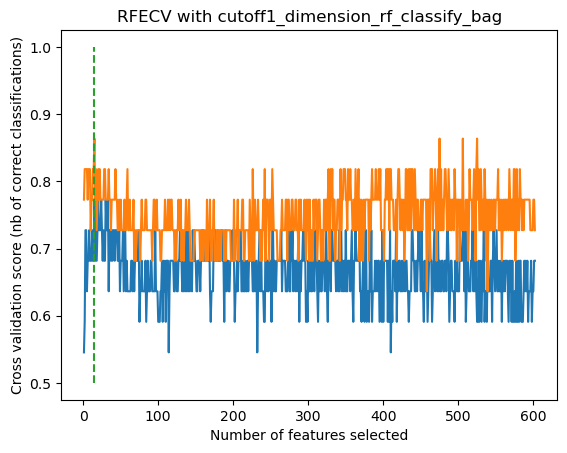

分类算法： cv
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


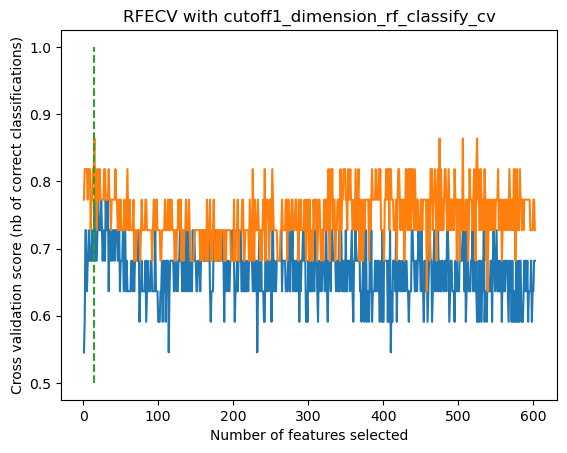

降维算法： lda


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

Optimal number of features : 44
Best performing dimensions: Index(['CASSLGYEQYF_TRBV12_TRBJ2-7', 'CASRRDSNQPQHF_TRBV2-1_TRBJ1-5',
       'CASSQVGYEQYF_TRBV3_TRBJ2-7', 'CASSQDGGLGNQPQHF_TRBV4-1_TRBJ1-5',
       'CASSEGTGGYEQYF_TRBV6-1_TRBJ2-7', 'CASSASYEQYF_TRBV7-9_TRBJ2-7',
       'CAWTVGARAEAFF_TRBV30-1_TRBJ1-1', 'CASSPSRDTEAFF_TRBV18-1_TRBJ1-1',
       'CASSFSGSNTEAFF_TRBV12_TRBJ1-1', 'CASSPGGYEQYF_TRBV9-1_TRBJ2-7',
       'CASRTGVFSGNTIYF_TRBV2-1_TRBJ1-3', 'CASSYGETQYF_TRBV6_TRBJ2-5',
       'CAWTPNTEAFF_TRBV30-1_TRBJ1-1', 'CASSLAGGPYEQYF_TRBV5-1_TRBJ2-7',
       'CASSLAGAGTEAFF_TRBV5-1_TRBJ1-1', 'CASSFEGDQPQHF_TRBV5-1_TRBJ1-5',
       'CASSDSSGANVLTF_TRBV2-1_TRBJ2-6', 'CASSEGRGNQPQHF_TRBV2-1_TRBJ1-5',
       'CASSFGQGYGYTF_TRBV12_TRBJ1-2', 'CASSLEPNTEAFF_TRBV5-4_TRBJ1-1',
       'CASSPGGNTEAFF_TRBV9-1_TRBJ1-1', 'CASSQGGYGYTF_TRBV3_TRBJ1-2',
       'CASSLGGSSYNEQFF_TRBV12_TRBJ2-1', 'CASSLNYGYTF_TRBV12_TRBJ1-2',
       'CASSYGGSYEQYF_TRBV6-5_TRBJ2-7', 'CASSFSGSYEQYF_TRBV7-9_TRBJ2-7',

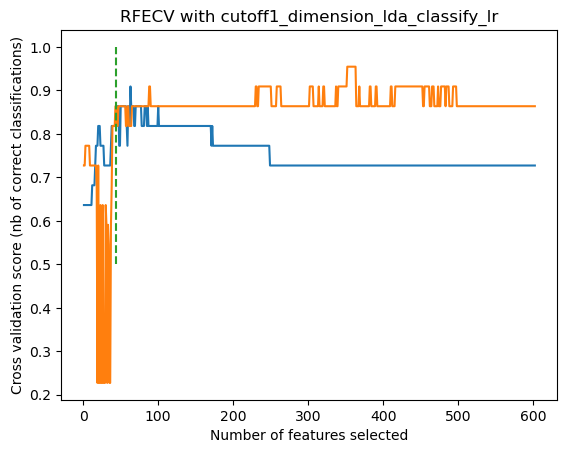

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 4
accuracy 1.0


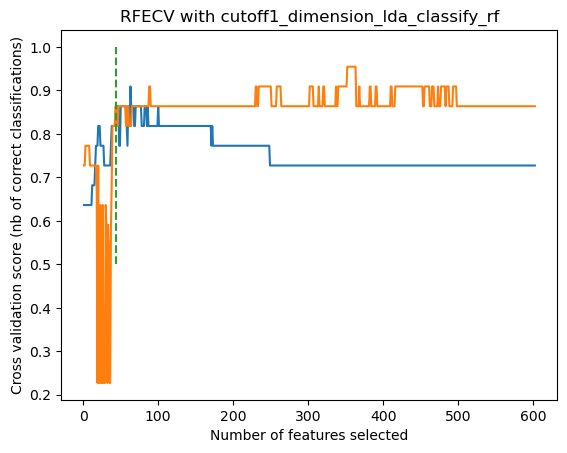

分类算法： lda
best_index 2
accuracy 1.0


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


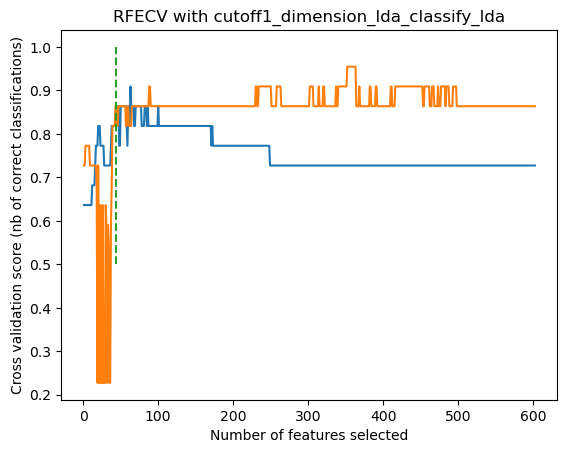

分类算法： gbdt
best_index 2
accuracy 1.0


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


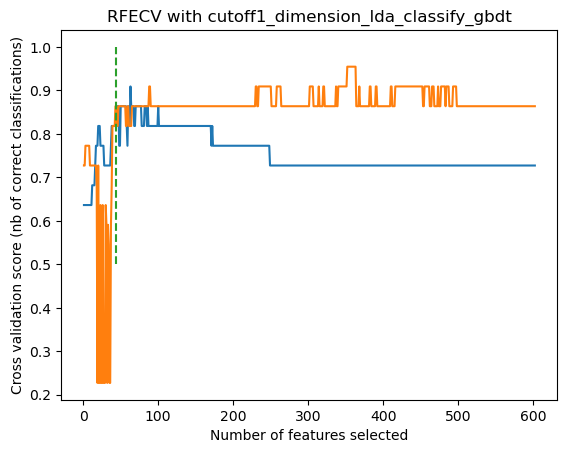

分类算法： adb
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


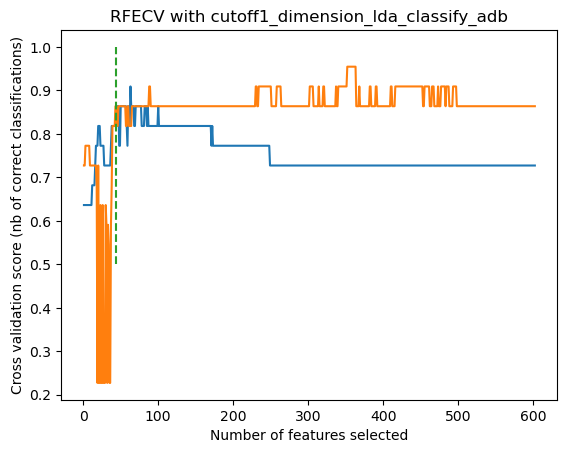

分类算法： xgb
best_index 2
accuracy 1.0


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


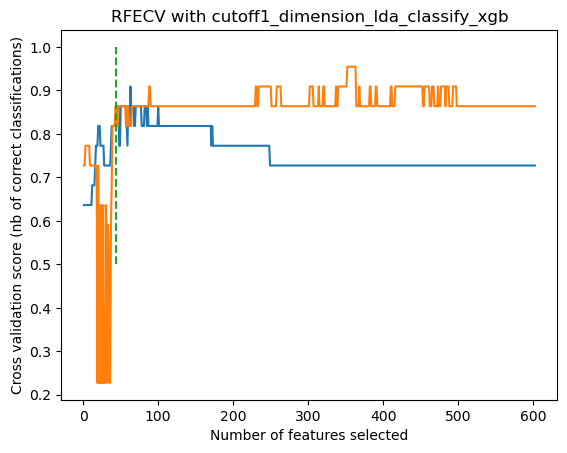

分类算法： dt
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


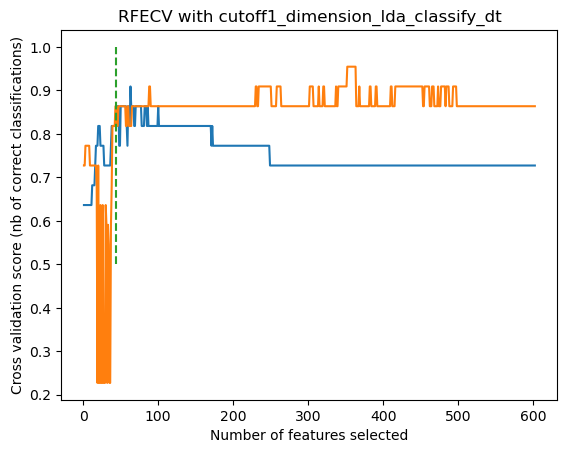

分类算法： svm
best_index 2
accuracy 1.0


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


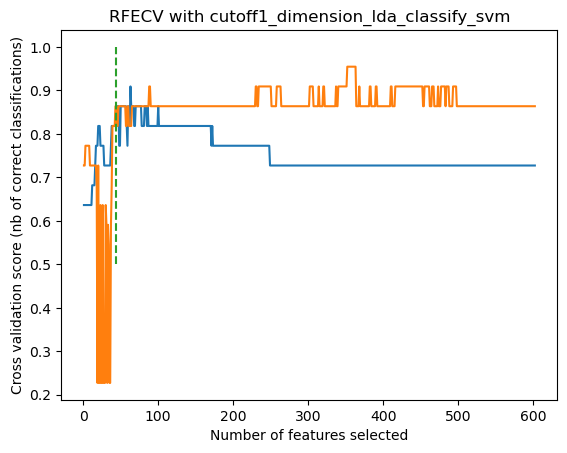

分类算法： nb
best_index 2
accuracy 1.0


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


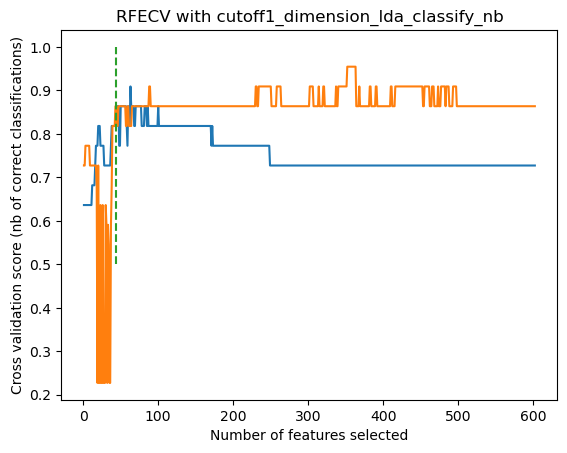

分类算法： cbc
0:	learn: 0.6492549	total: 1.57ms	remaining: 6.3ms
1:	learn: 0.6196356	total: 3.32ms	remaining: 4.98ms
2:	learn: 0.5866566	total: 5.61ms	remaining: 3.74ms
3:	learn: 0.5425637	total: 7.72ms	remaining: 1.93ms
4:	learn: 0.5246839	total: 8.9ms	remaining: 0us
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


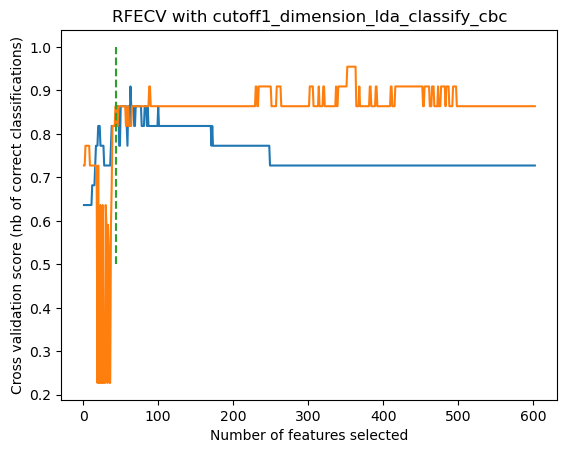

分类算法： bag
best_index 5
accuracy 1.0


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


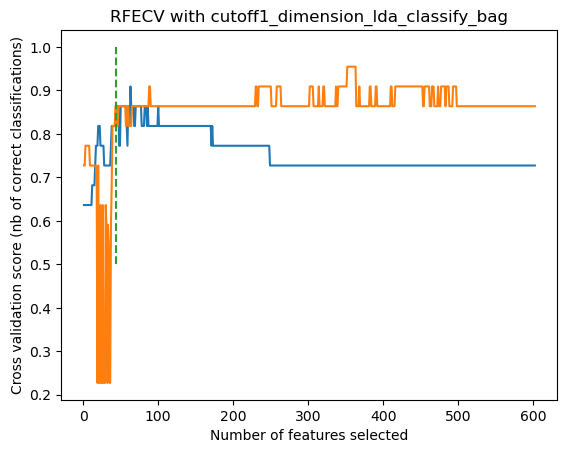

分类算法： cv
best_index 2
accuracy 1.0


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


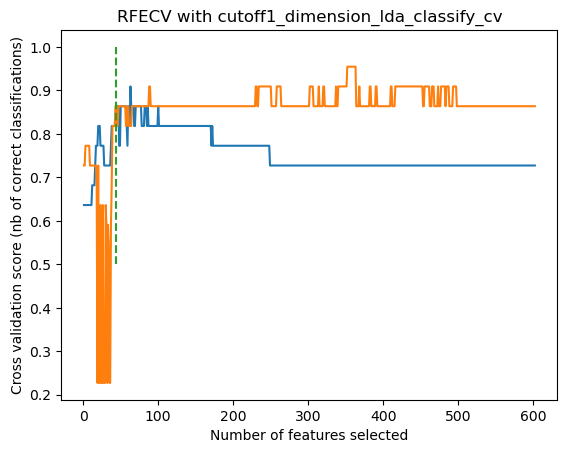

降维算法： gbdt


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example usin

Optimal number of features : 8
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSLQETQYF_TRBV12_TRBJ2-5',
       'CASSLRETQYF_TRBV12_TRBJ2-5', 'CASSLSGNTIYF_TRBV12_TRBJ1-3',
       'CASSLGNQPQHF_TRBV12_TRBJ1-5', 'CASSYSDTGELFF_TRBV6_TRBJ2-2',
       'CASSLGEKLFF_TRBV12_TRBJ1-4', 'CASSPSNQPQHF_TRBV12_TRBJ1-5'],
      dtype='object')
分类算法： lr
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


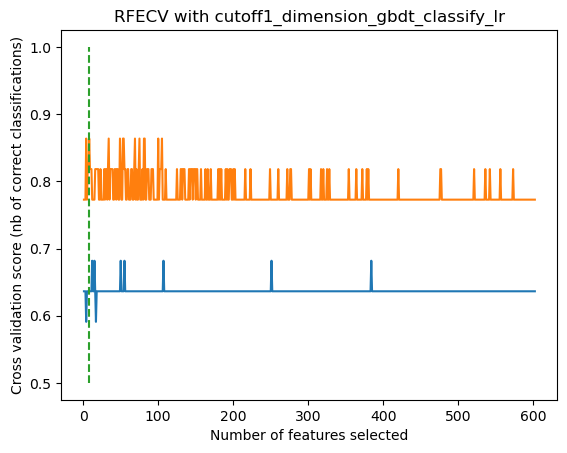

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9666666666666667


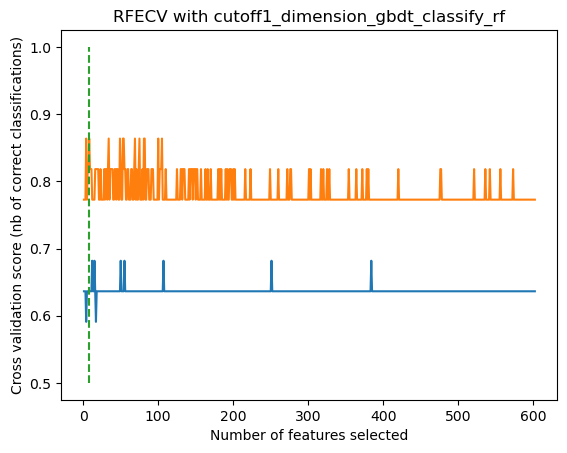

C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


分类算法： lda
best_index 2
accuracy 0.9666666666666667


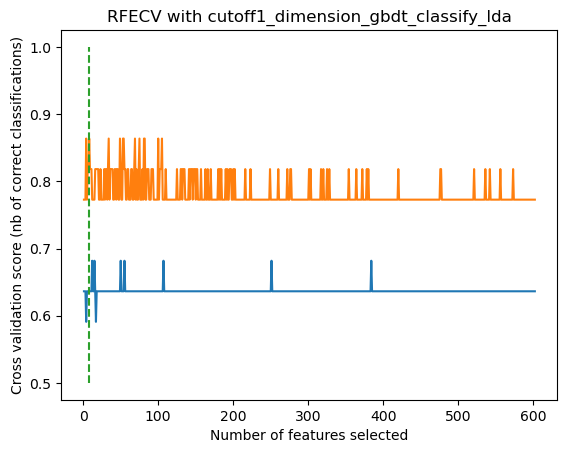

分类算法： gbdt
best_index 3
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


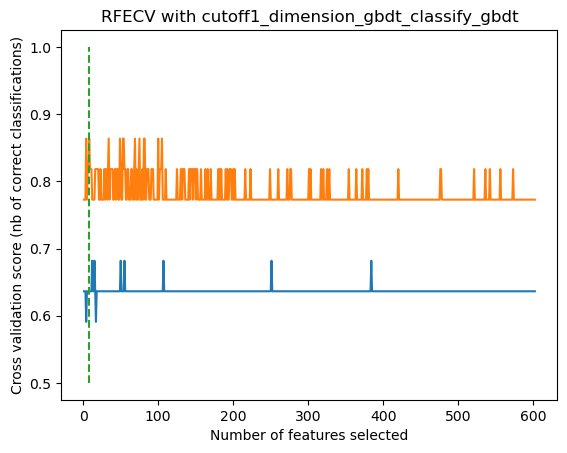

分类算法： adb
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


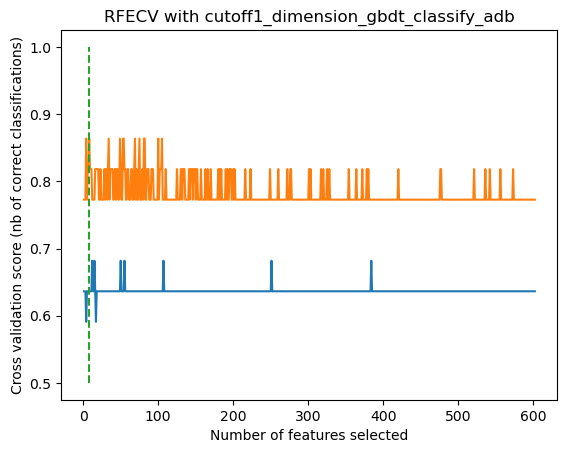

分类算法： xgb
best_index 5
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


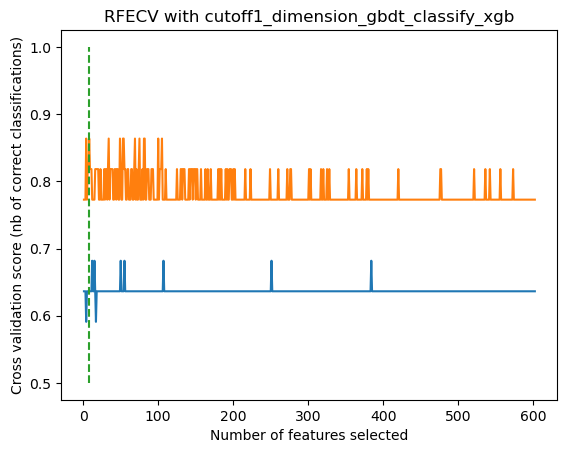

分类算法： dt
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


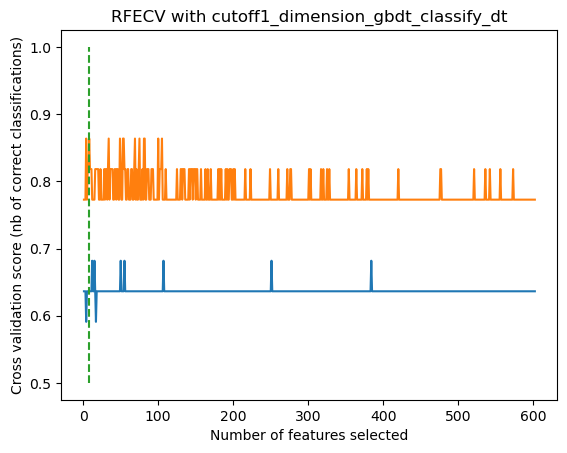

分类算法： svm
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


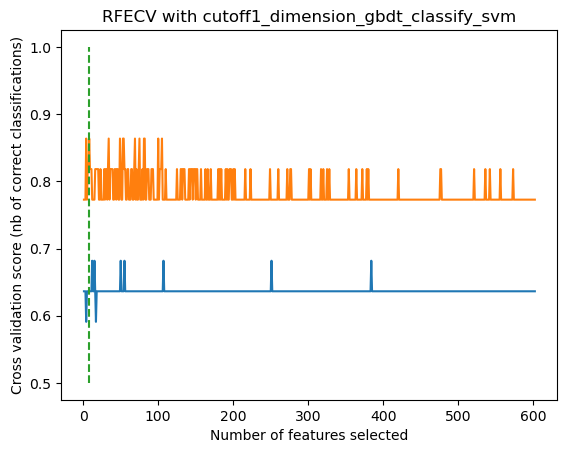

分类算法： nb
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


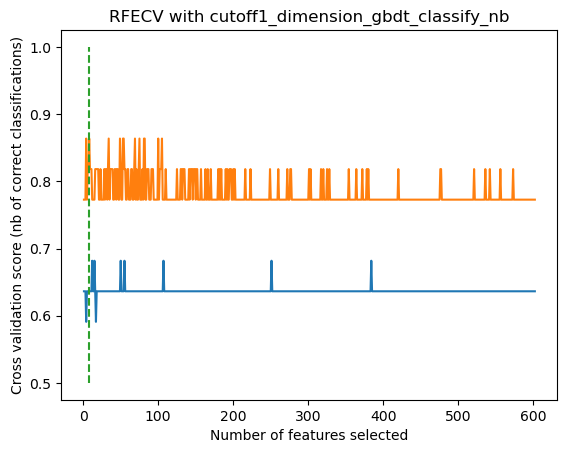

分类算法： cbc
0:	learn: 0.6569497	total: 889us	remaining: 3.56ms
1:	learn: 0.6204865	total: 1.61ms	remaining: 2.42ms
2:	learn: 0.5897555	total: 2.9ms	remaining: 1.94ms
3:	learn: 0.5586443	total: 3.72ms	remaining: 930us
4:	learn: 0.5300082	total: 4.75ms	remaining: 0us
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


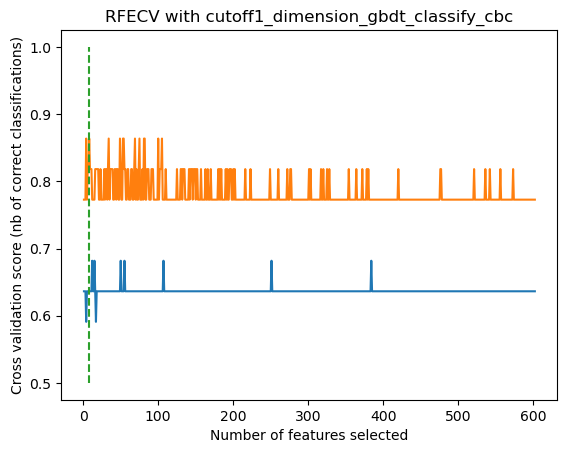

分类算法： bag
best_index 3
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


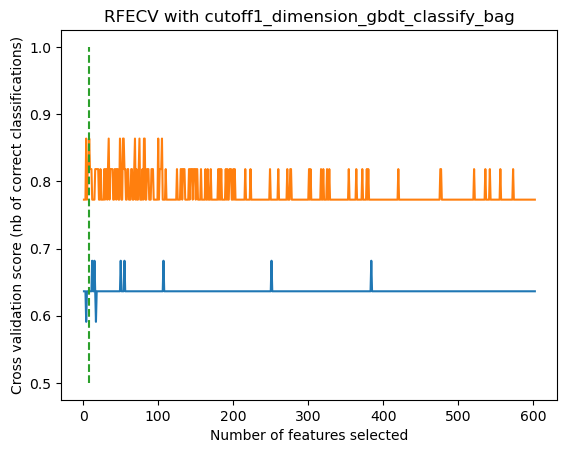

分类算法： cv
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


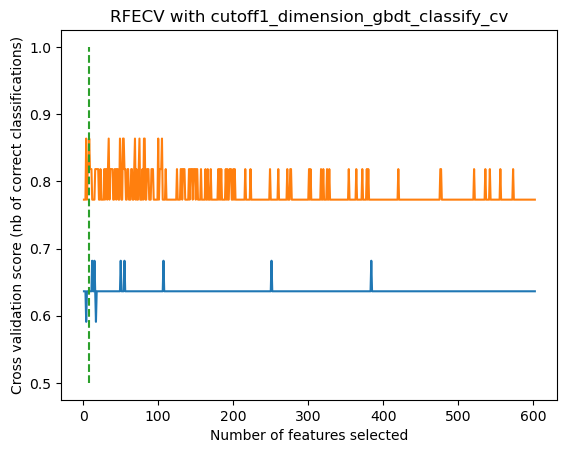

降维算法： adb


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

Optimal number of features : 5
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSQGYEQYF_TRBV3_TRBJ2-7',
       'CASSLSGNTIYF_TRBV12_TRBJ1-3', 'CASSLTGNTEAFF_TRBV12_TRBJ1-1',
       'CASSYSDTGELFF_TRBV6_TRBJ2-2'],
      dtype='object')
分类算法： lr
best_index 7
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


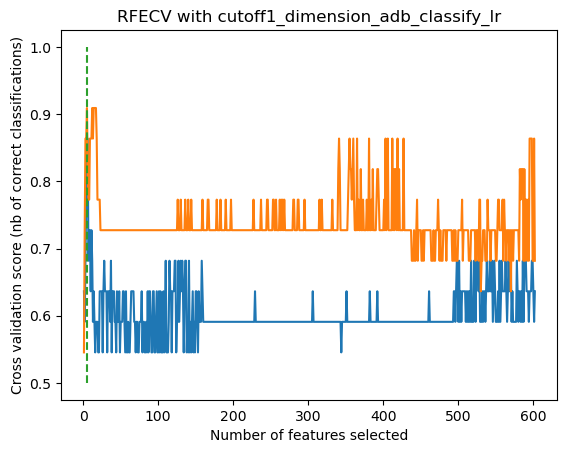

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9666666666666667


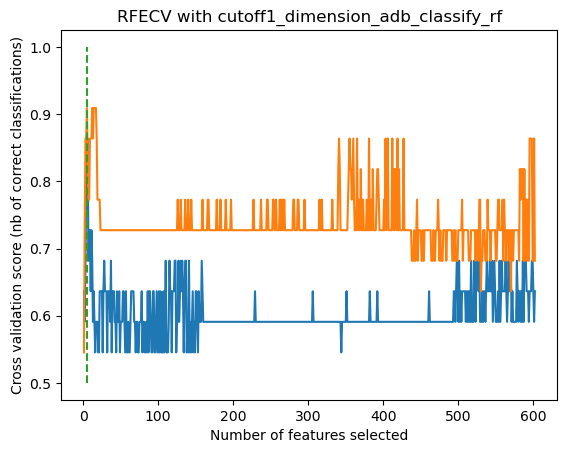

分类算法： lda
best_index 7
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


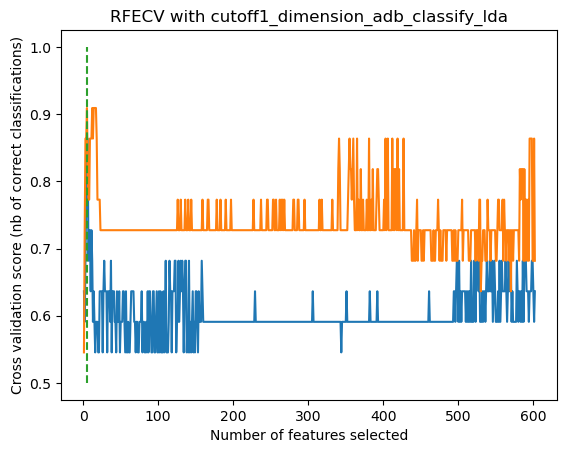

分类算法： gbdt
best_index 7
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


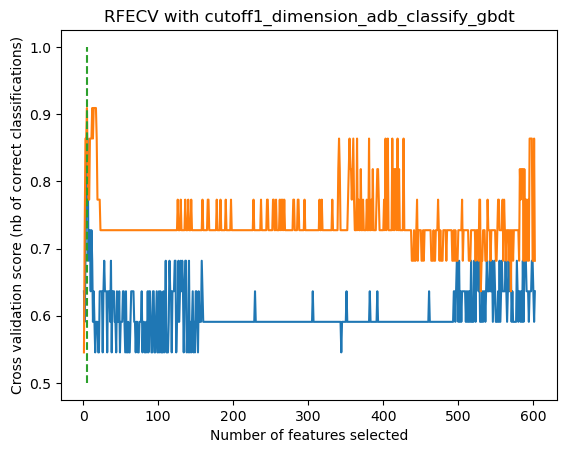

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 7
accuracy 0.9666666666666667


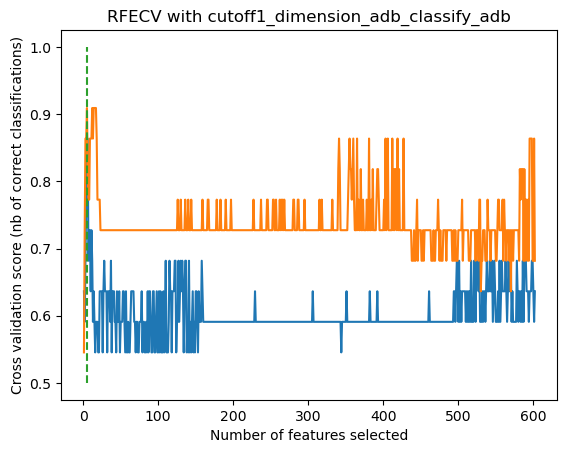

分类算法： xgb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 6
accuracy 0.9666666666666667


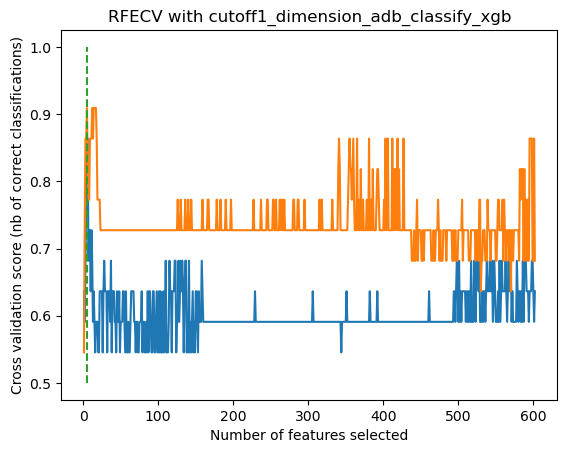

分类算法： dt
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


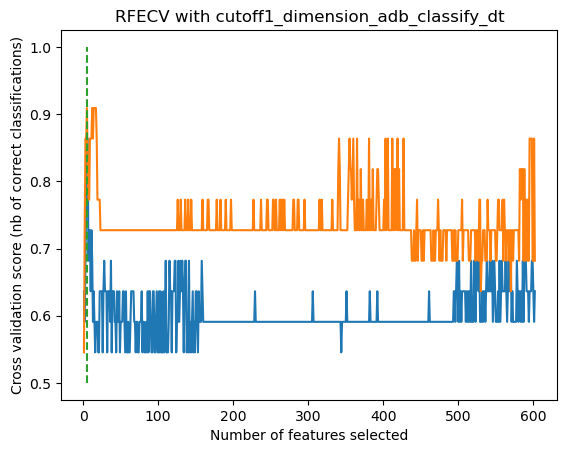

分类算法： svm
best_index 7
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


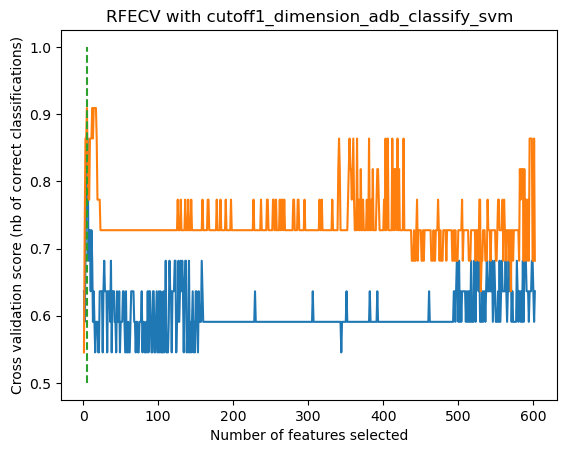

分类算法： nb
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


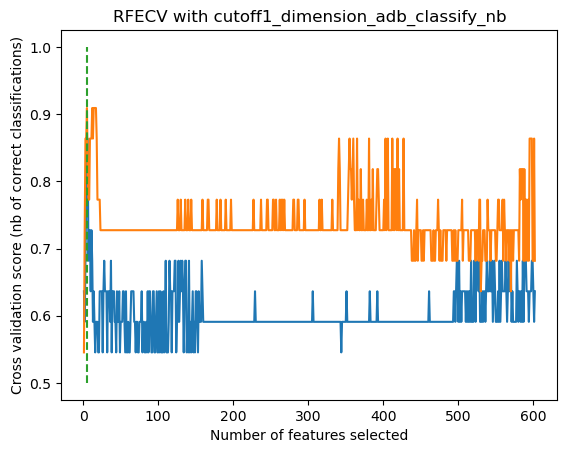

分类算法： cbc
0:	learn: 0.6546022	total: 1.41ms	remaining: 5.64ms
1:	learn: 0.6201618	total: 2.33ms	remaining: 3.5ms
2:	learn: 0.5861037	total: 2.64ms	remaining: 1.76ms
3:	learn: 0.5581815	total: 3.05ms	remaining: 762us
4:	learn: 0.5299667	total: 3.42ms	remaining: 0us
best_index 6
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


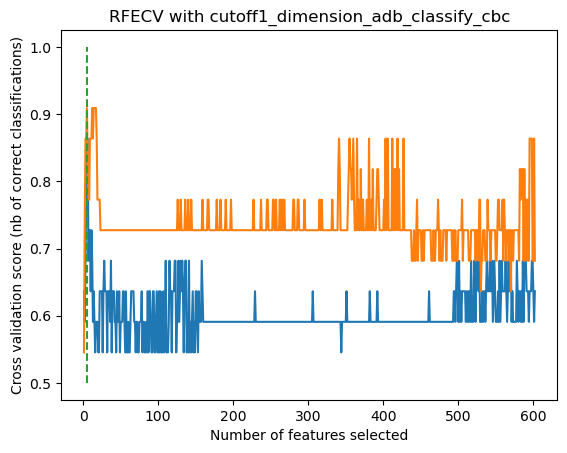

分类算法： bag
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


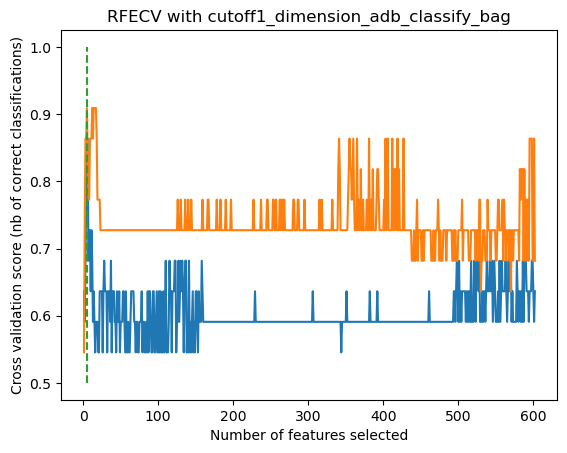

分类算法： cv
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


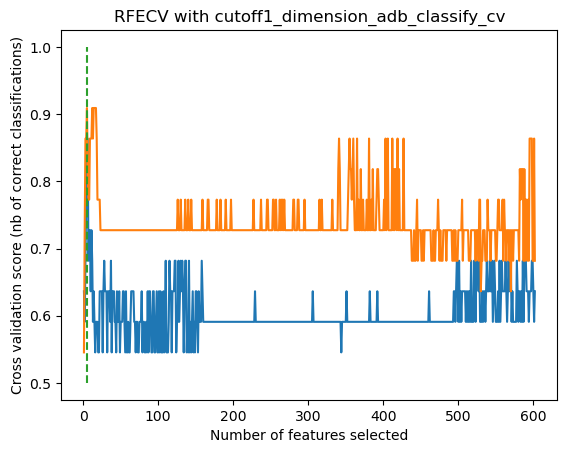

降维算法： xgb
Optimal number of features : 5
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSLRETQYF_TRBV12_TRBJ2-5',
       'CASSLTGNTEAFF_TRBV12_TRBJ1-1', 'CASSLGNQPQHF_TRBV12_TRBJ1-5',
       'CASSLVNQPQHF_TRBV7-9_TRBJ1-5'],
      dtype='object')
分类算法： lr
best_index 6
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


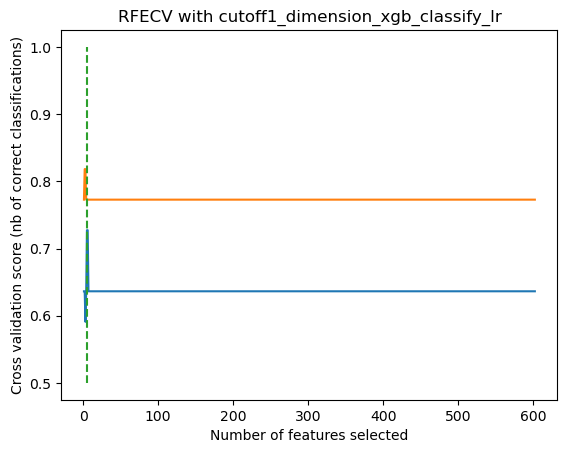

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 3
accuracy 0.9666666666666667


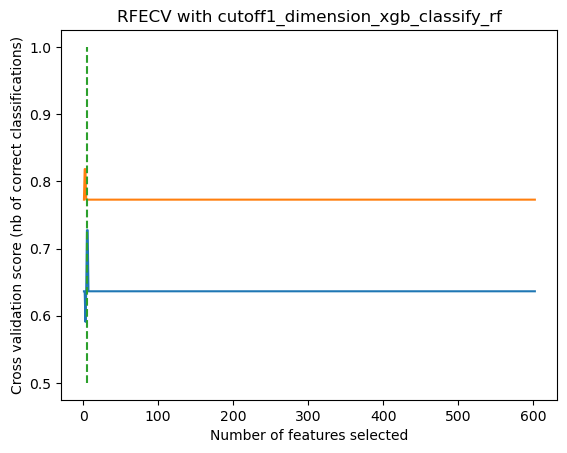

分类算法： lda
best_index 6
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


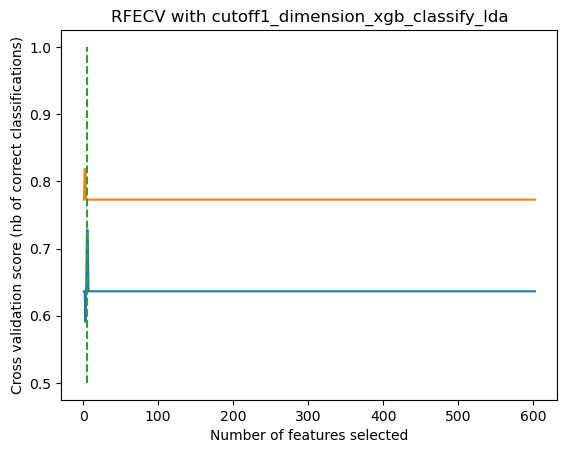

分类算法： gbdt
best_index 6
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


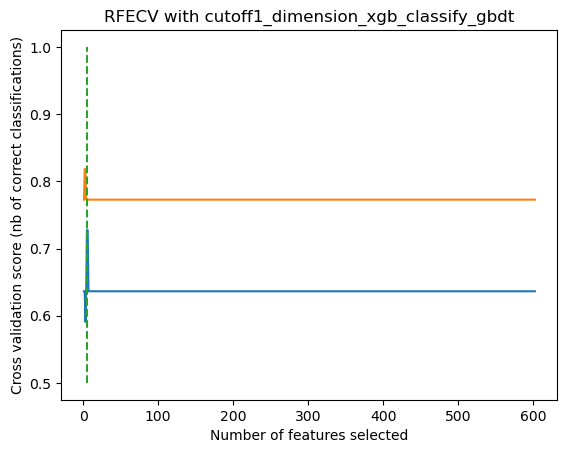

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 5
accuracy 0.9666666666666667


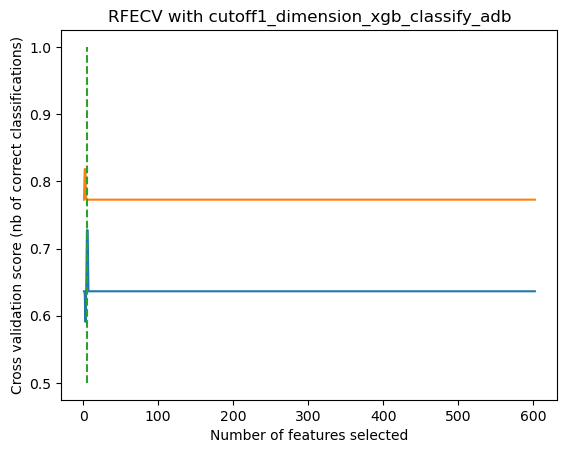

分类算法： xgb
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


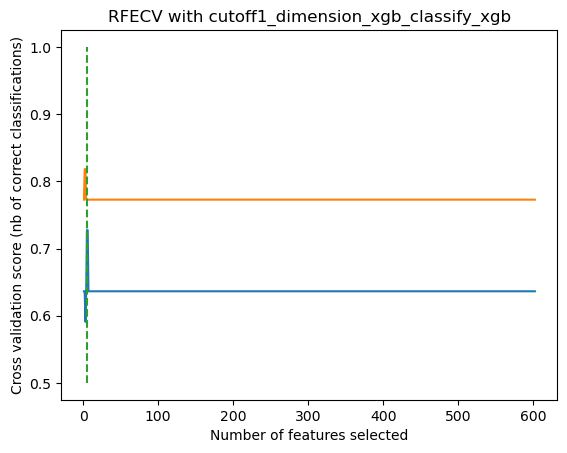

分类算法： dt
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


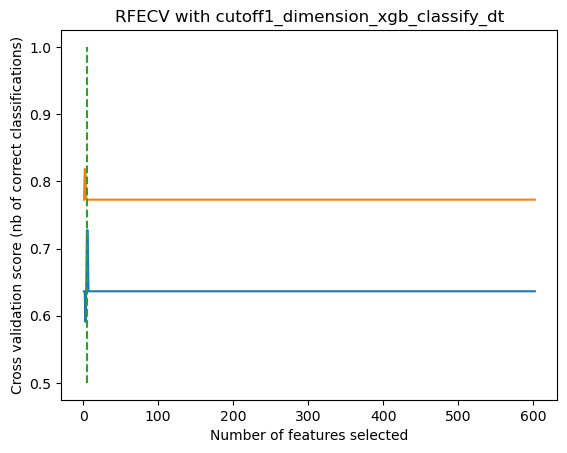

分类算法： svm
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


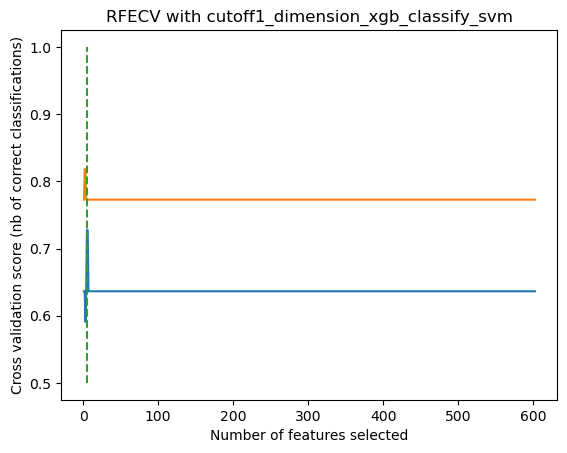

分类算法： nb
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


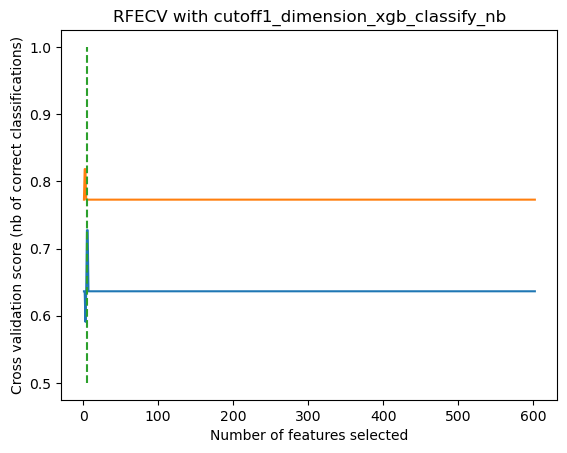

分类算法： cbc
0:	learn: 0.6748063	total: 398us	remaining: 1.59ms
1:	learn: 0.6410076	total: 794us	remaining: 1.19ms
2:	learn: 0.6078378	total: 1.14ms	remaining: 762us
3:	learn: 0.5763689	total: 1.49ms	remaining: 372us
4:	learn: 0.5526686	total: 1.88ms	remaining: 0us
best_index 7
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


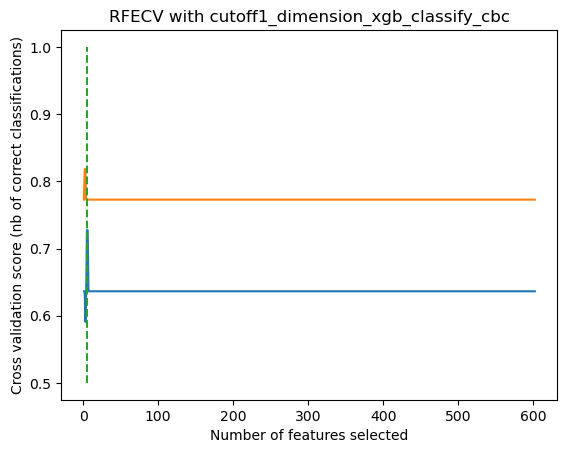

分类算法： bag
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


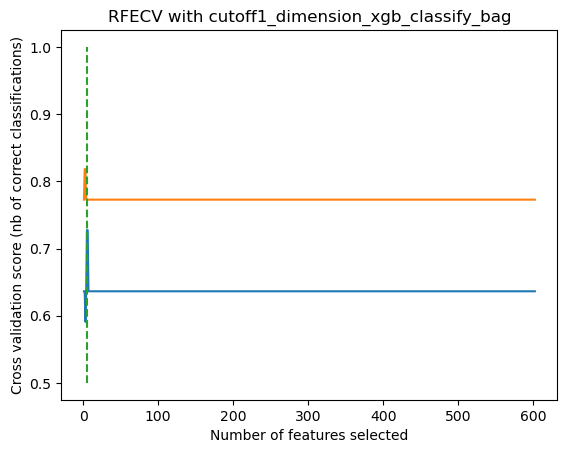

分类算法： cv
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


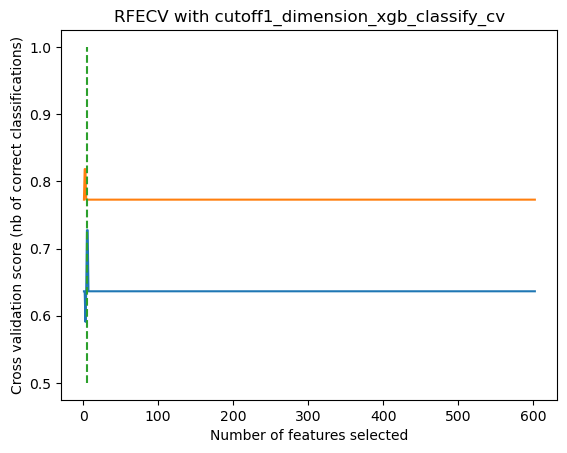

降维算法： dt
Optimal number of features : 110
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFGGNTEAFF_TRBV12_TRBJ1-1',
       'CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGETQYF_TRBV12_TRBJ2-5',
       'CASSLGYEQYF_TRBV12_TRBJ2-7', 'CASSLGGGYTF_TRBV12_TRBJ1-2',
       'CASSQGYEQYF_TRBV3_TRBJ2-7', 'CASSLGGNQPQHF_TRBV12_TRBJ1-5',
       'CASSLRETQYF_TRBV12_TRBJ2-5', 'CASSLSGNTIYF_TRBV12_TRBJ1-3',
       ...
       'CASSFGVNYGYTF_TRBV12_TRBJ1-2', 'CASSQVGGETQYF_TRBV4-1_TRBJ2-5',
       'CASSRGSYEQYF_TRBV12_TRBJ2-7', 'CASSVGGGHNEQFF_TRBV9-1_TRBJ2-1',
       'CASSLATGSYEQYF_TRBV5-1_TRBJ2-7', 'CASSPRETQYF_TRBV12_TRBJ2-5',
       'CASSFGGSYEQYF_TRBV12_TRBJ2-7', 'CASSQGGDTQYF_TRBV3_TRBJ2-3',
       'CASSLRNQPQHF_TRBV12_TRBJ1-5', 'CASSYGQETQYF_TRBV6_TRBJ2-5'],
      dtype='object', length=110)
分类算法： lr
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


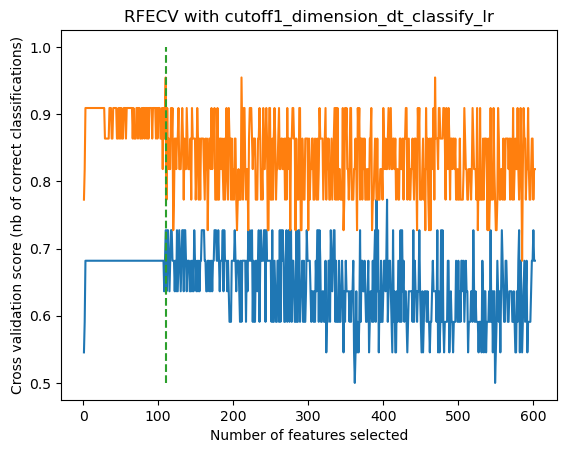

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 5
accuracy 0.9666666666666667


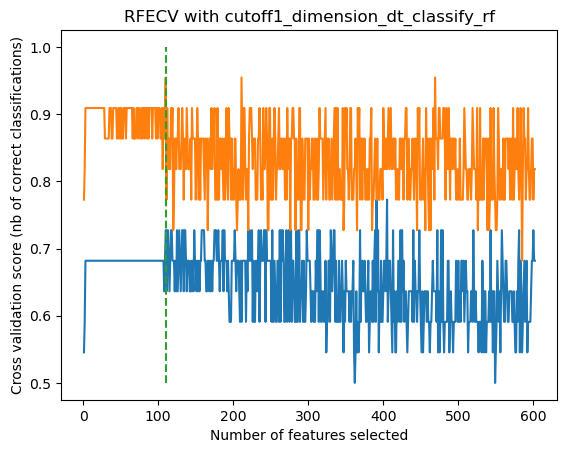

分类算法： lda
best_index 1
accuracy 0.9


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


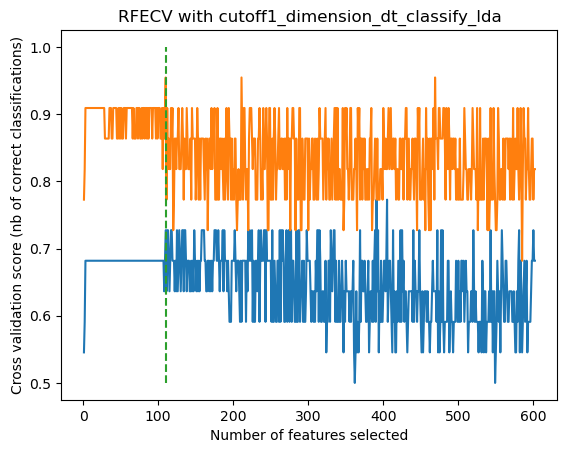

分类算法： gbdt
best_index 7
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


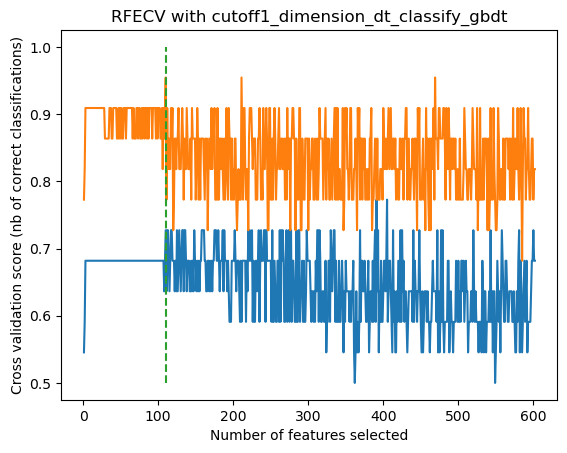

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 1.0


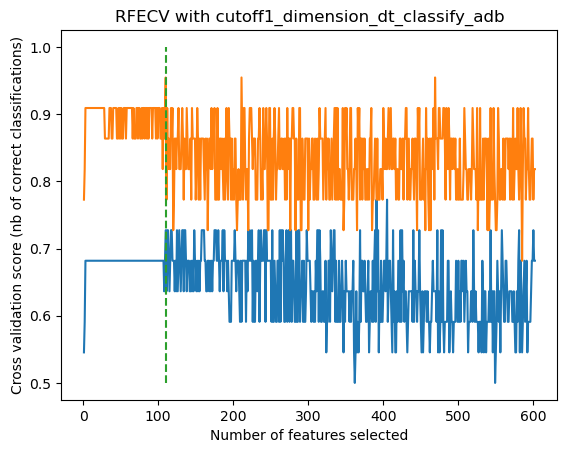

分类算法： xgb
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


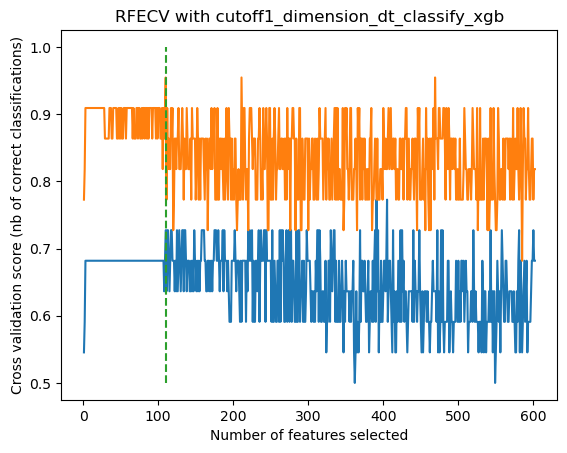

分类算法： dt
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


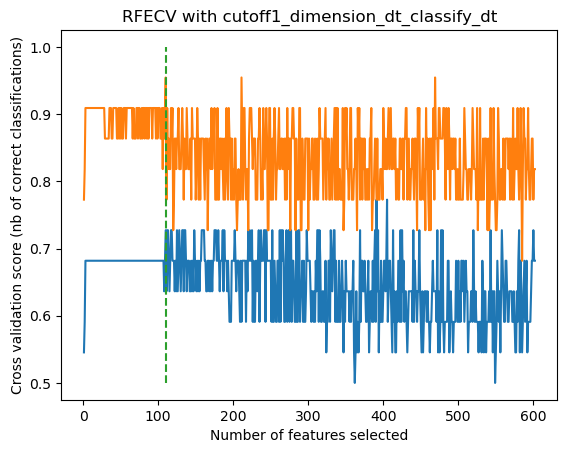

分类算法： svm
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


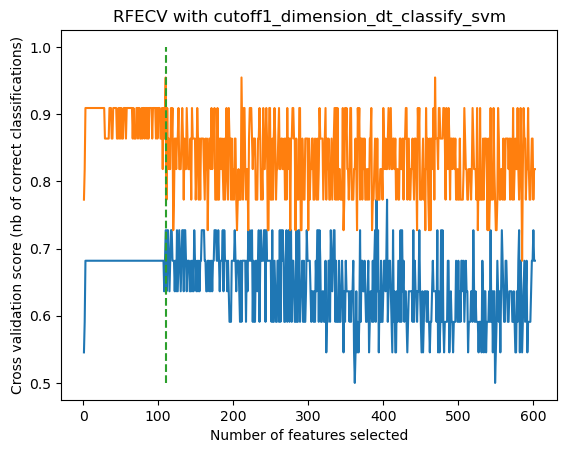

分类算法： nb
best_index 1
accuracy 0.7333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


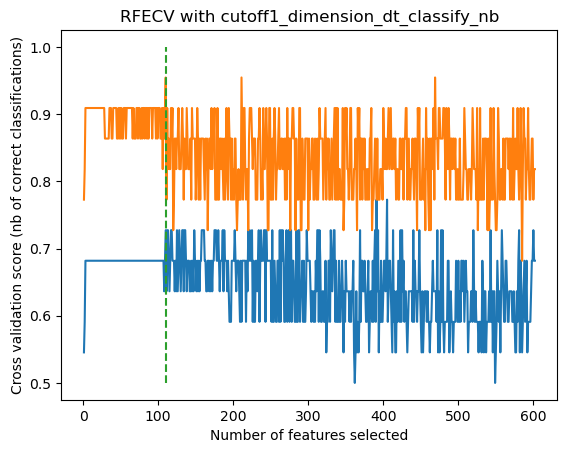

分类算法： cbc
0:	learn: 0.6377073	total: 5.4ms	remaining: 21.6ms
1:	learn: 0.5849646	total: 9.89ms	remaining: 14.8ms
2:	learn: 0.5293586	total: 25ms	remaining: 16.7ms
3:	learn: 0.4812964	total: 29.8ms	remaining: 7.45ms
4:	learn: 0.4497288	total: 34.4ms	remaining: 0us
best_index 2
accuracy 1.0


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


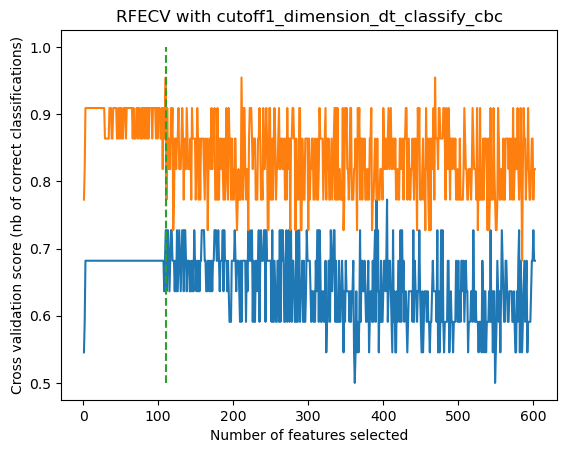

分类算法： bag
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


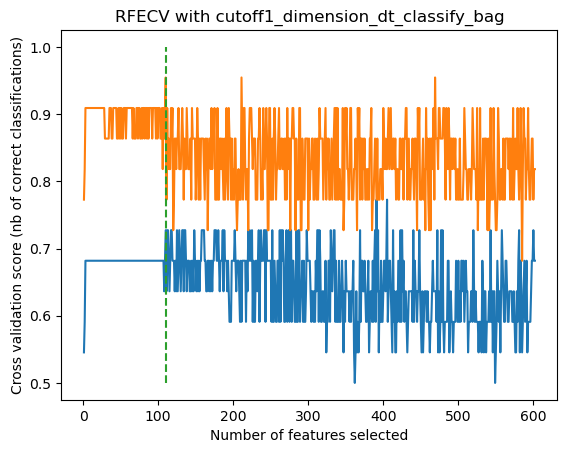

分类算法： cv
best_index 1
accuracy 0.7666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


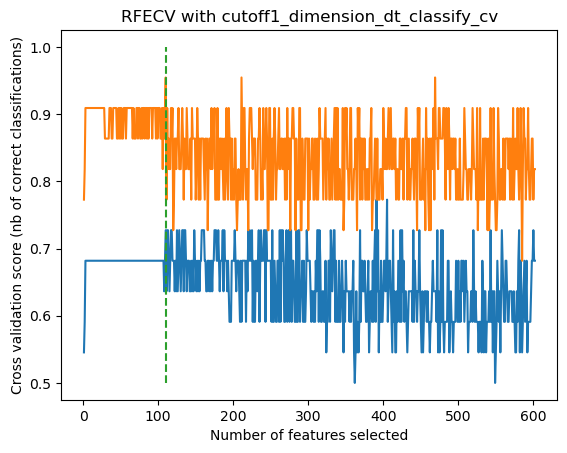

降维算法： svm


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

Optimal number of features : 254
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFGGNTEAFF_TRBV12_TRBJ1-1',
       'CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGYEQYF_TRBV12_TRBJ2-7',
       'CASSLGGGYTF_TRBV12_TRBJ1-2', 'CASSQGYEQYF_TRBV3_TRBJ2-7',
       'CASSLGGNQPQHF_TRBV12_TRBJ1-5', 'CASSLRETQYF_TRBV12_TRBJ2-5',
       'CASSLSGNTIYF_TRBV12_TRBJ1-3', 'CASSLTGNTEAFF_TRBV12_TRBJ1-1',
       ...
       'CASSLAGGQPQHF_TRBV12_TRBJ1-5', 'CAWSRGGNQPQHF_TRBV30-1_TRBJ1-5',
       'CASSYDSYGYTF_TRBV6_TRBJ1-2', 'CASSFGQPQHF_TRBV12_TRBJ1-5',
       'CASSLGSNYGYTF_TRBV12_TRBJ1-2', 'CASSLDRVGETQYF_TRBV5-1_TRBJ2-5',
       'CASSFGGGGYTF_TRBV12_TRBJ1-2', 'CASSSTATNEKLFF_TRBV5-1_TRBJ1-4',
       'CASRPGQGYEQYF_TRBV12_TRBJ2-7', 'CASSFGTGSYEQYF_TRBV12_TRBJ2-7'],
      dtype='object', length=254)
分类算法： lr
best_index 1
accuracy 0.9333333333333333


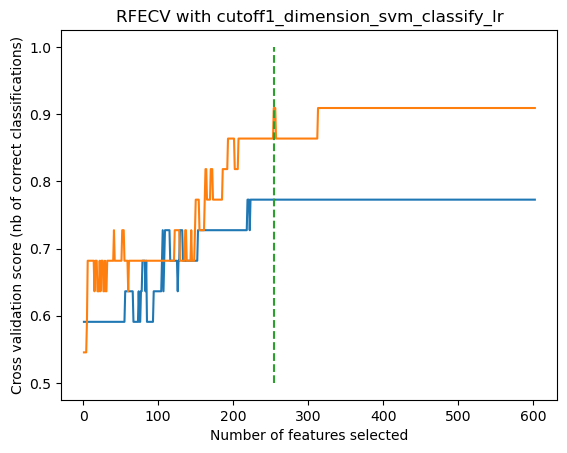

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 4
accuracy 0.9333333333333333


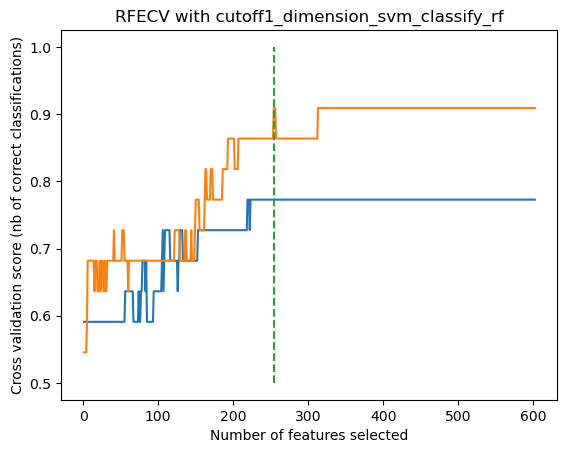

分类算法： lda
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


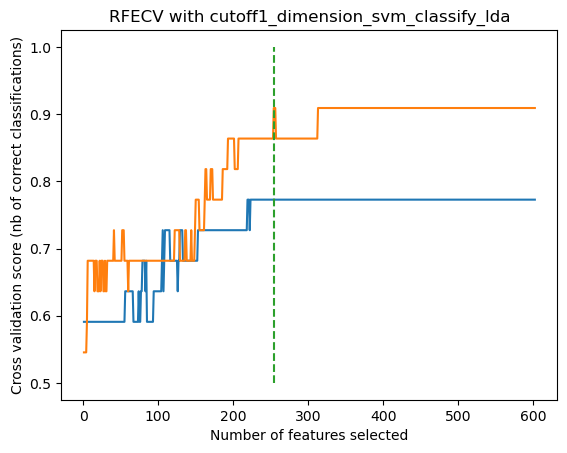

分类算法： gbdt
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


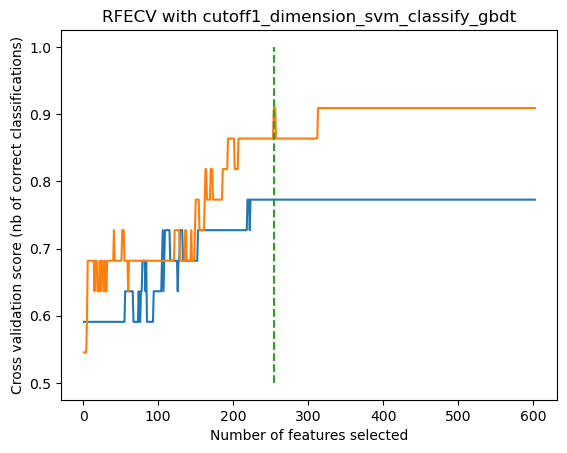

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9666666666666667


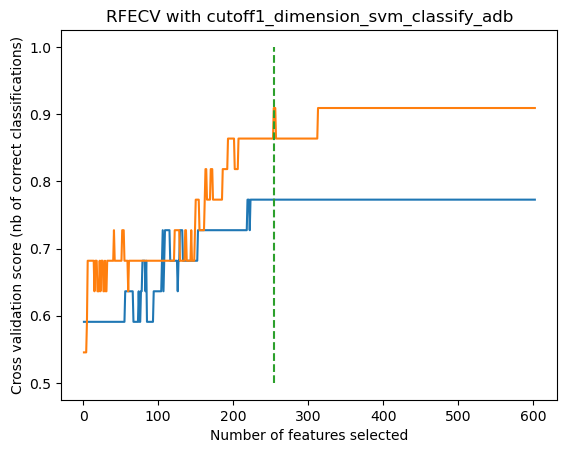

分类算法： xgb
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


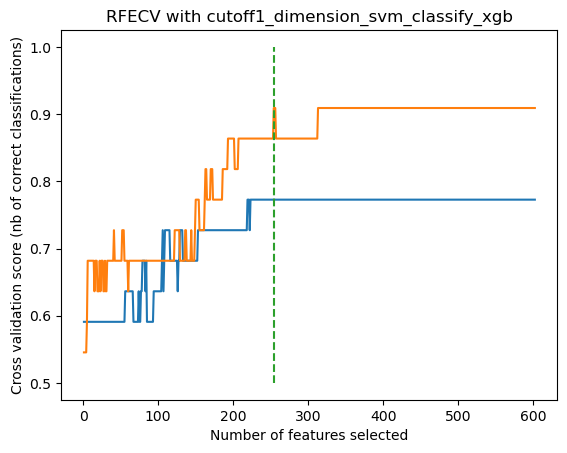

分类算法： dt
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


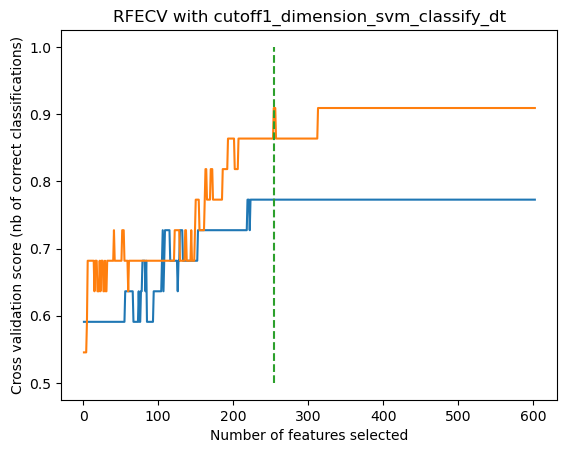

分类算法： svm
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


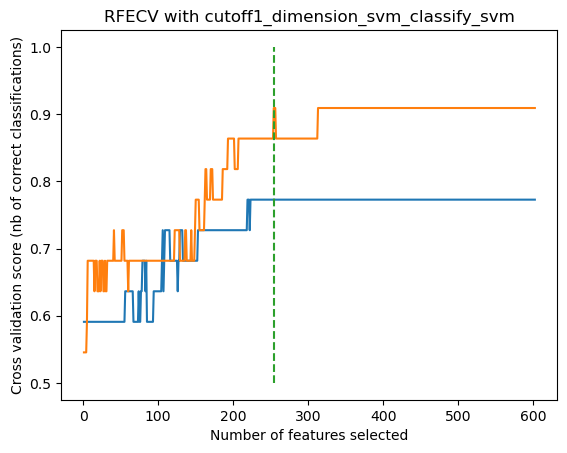

分类算法： nb
best_index 0
accuracy 0.5


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


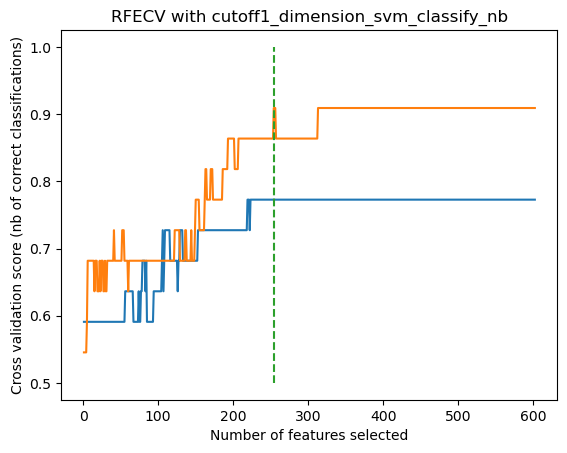

分类算法： cbc
0:	learn: 0.6115118	total: 6.89ms	remaining: 27.6ms
1:	learn: 0.5566507	total: 22.4ms	remaining: 33.6ms
2:	learn: 0.4922287	total: 33.5ms	remaining: 22.3ms
3:	learn: 0.4299090	total: 52.4ms	remaining: 13.1ms
4:	learn: 0.3871767	total: 69.4ms	remaining: 0us
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


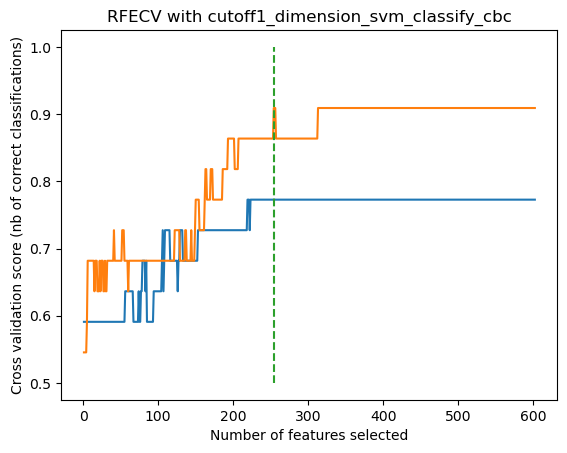

分类算法： bag
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


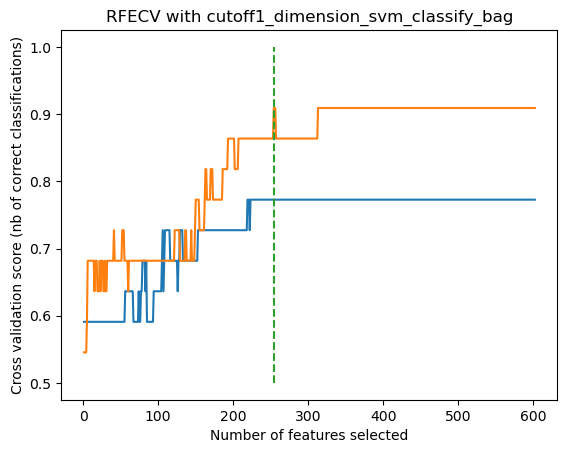

分类算法： cv
best_index 0
accuracy 0.5


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


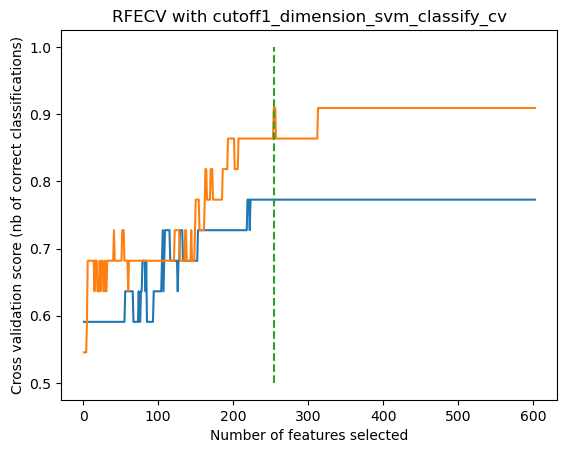

降维算法： cbc
0:	learn: 0.6196085	total: 13.7ms	remaining: 54.8ms
1:	learn: 0.5528296	total: 29.3ms	remaining: 44ms
2:	learn: 0.4729210	total: 45.9ms	remaining: 30.6ms
3:	learn: 0.4244863	total: 62.8ms	remaining: 15.7ms
4:	learn: 0.3865016	total: 78.5ms	remaining: 0us
0:	learn: 0.5813693	total: 13.6ms	remaining: 54.4ms
1:	learn: 0.5223000	total: 31.8ms	remaining: 47.8ms
2:	learn: 0.4474541	total: 49.4ms	remaining: 32.9ms
3:	learn: 0.4079347	total: 59.6ms	remaining: 14.9ms
4:	learn: 0.3559674	total: 74ms	remaining: 0us
0:	learn: 0.6146500	total: 17ms	remaining: 68.1ms
1:	learn: 0.5658271	total: 31.1ms	remaining: 46.6ms
2:	learn: 0.4846663	total: 50.6ms	remaining: 33.7ms
3:	learn: 0.4484051	total: 71.5ms	remaining: 17.9ms
4:	learn: 0.3884330	total: 99.8ms	remaining: 0us
0:	learn: 0.5813693	total: 18.2ms	remaining: 73ms
1:	learn: 0.4918466	total: 41.3ms	remaining: 62ms
2:	learn: 0.4235677	total: 66.2ms	remaining: 44.1ms
3:	learn: 0.3872815	total: 94.8ms	remaining: 23.7ms
4:	learn: 0.3393367	t

C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


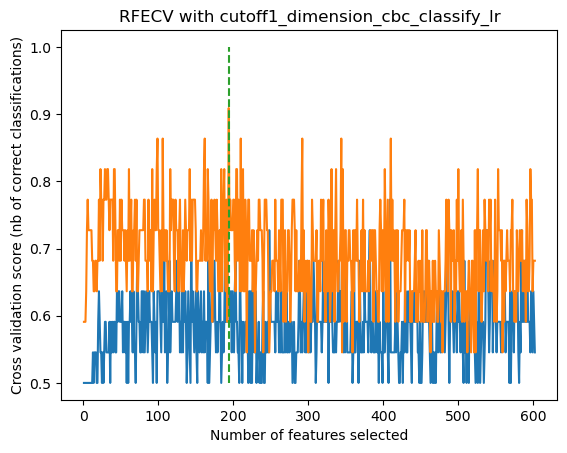

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.5666666666666667


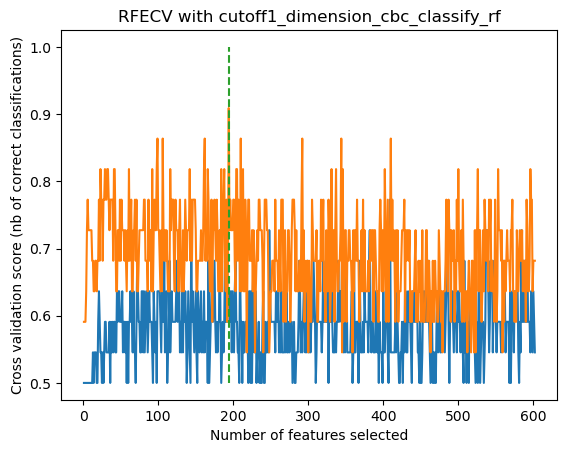

分类算法： lda
best_index 1
accuracy 0.5333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


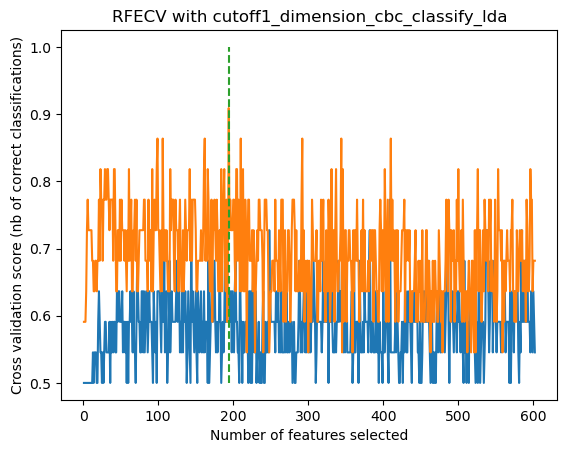

分类算法： gbdt


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.6333333333333333


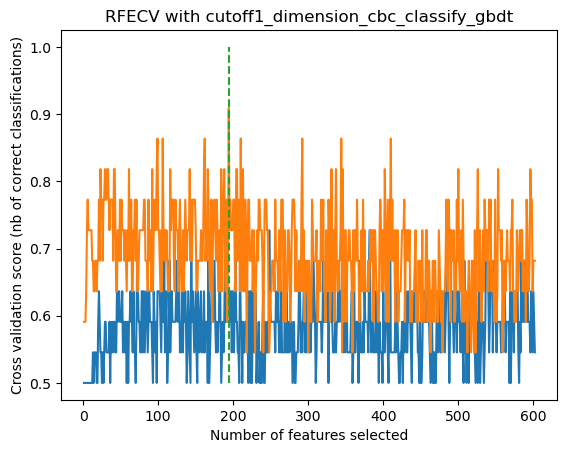

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 0
accuracy 0.5


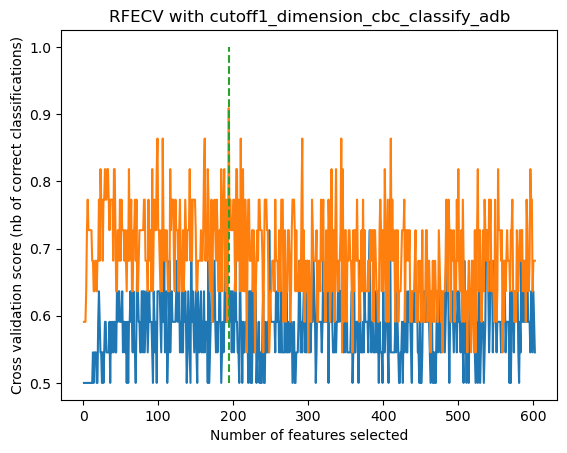

分类算法： xgb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 0
accuracy 0.5


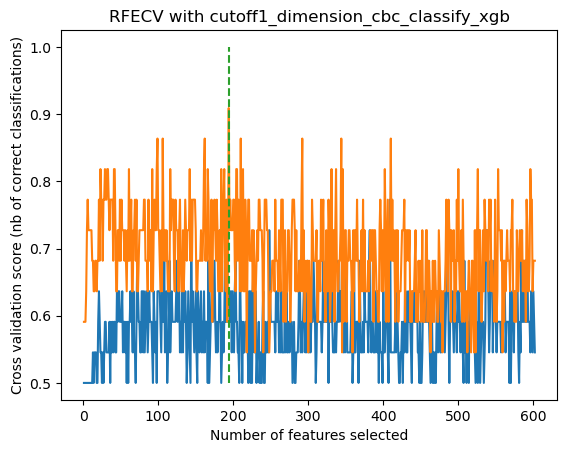

分类算法： dt
best_index 0
accuracy 0.5


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


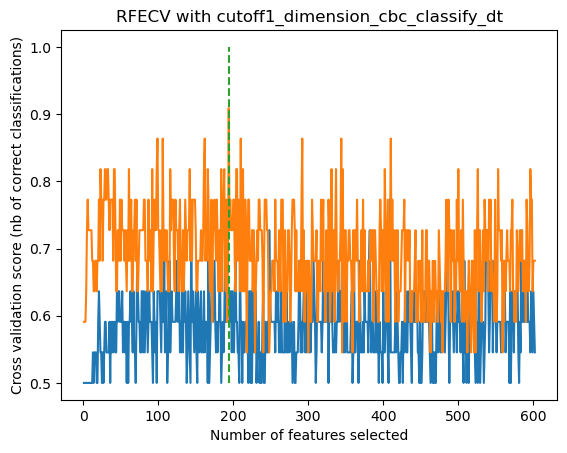

分类算法： svm
best_index 2
accuracy 0.5666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


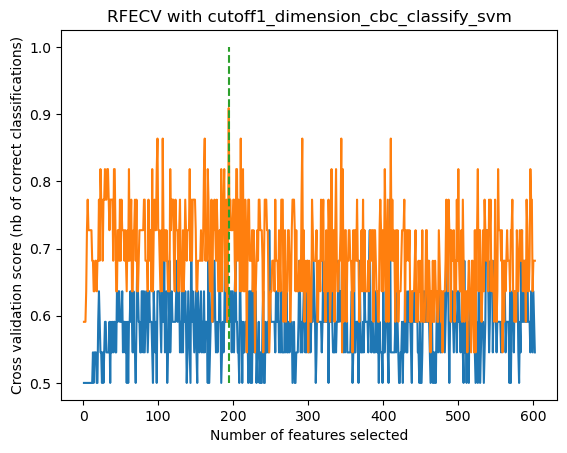

分类算法： nb
best_index 0
accuracy 0.5


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


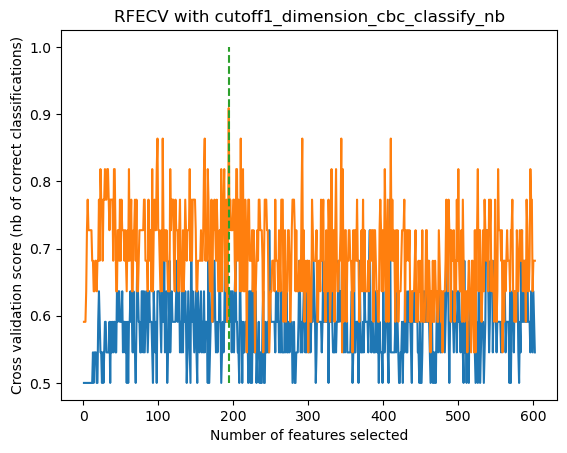

分类算法： cbc
0:	learn: 0.6504945	total: 13.5ms	remaining: 53.9ms
1:	learn: 0.6180825	total: 23.2ms	remaining: 34.8ms
2:	learn: 0.5720774	total: 33.9ms	remaining: 22.6ms
3:	learn: 0.5402904	total: 49.1ms	remaining: 12.3ms
4:	learn: 0.5022852	total: 64.3ms	remaining: 0us
best_index 0
accuracy 0.5


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


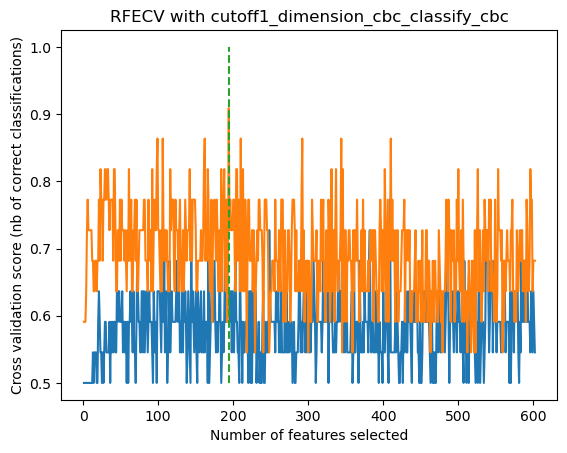

分类算法： bag


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 3
accuracy 0.6333333333333333


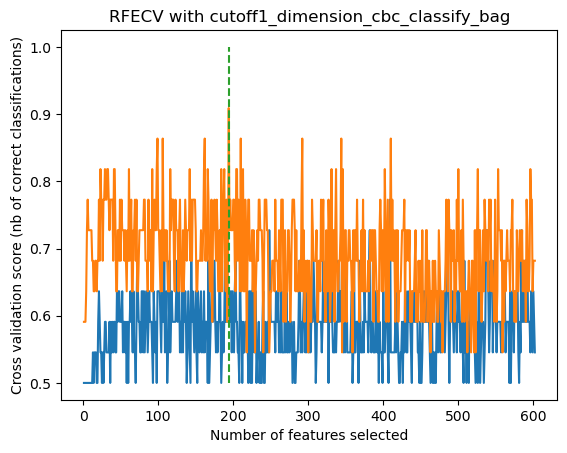

分类算法： cv
best_index 0
accuracy 0.5


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


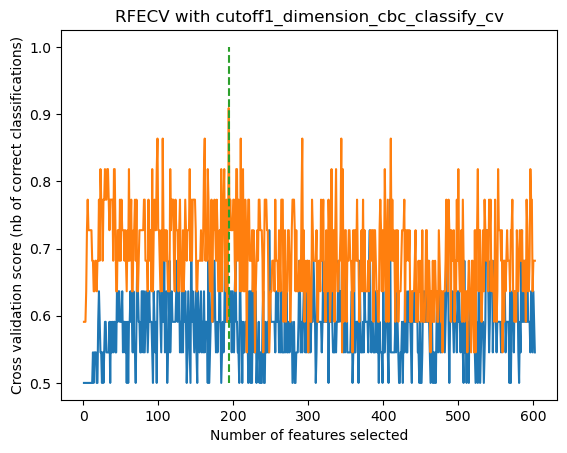

cutoff2
降维算法： lr


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

Optimal number of features : 9
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFGGNTEAFF_TRBV12_TRBJ1-1',
       'CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGGNQPQHF_TRBV12_TRBJ1-5',
       'CASSLRETQYF_TRBV12_TRBJ2-5', 'CASSLSGNTIYF_TRBV12_TRBJ1-3',
       'CASSLTGNTEAFF_TRBV12_TRBJ1-1', 'CASSLRGDTEAFF_TRBV12_TRBJ1-1',
       'CASSDGSIRDYTF_TRBV2-1_TRBJ1-2'],
      dtype='object')
分类算法： lr
best_index 2
accuracy 0.9666666666666667


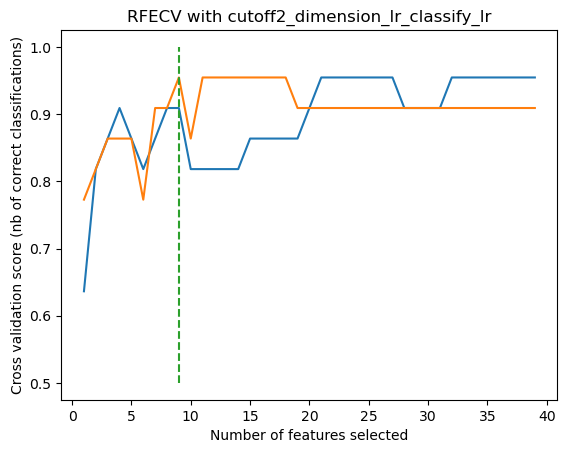

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 3
accuracy 0.9666666666666667


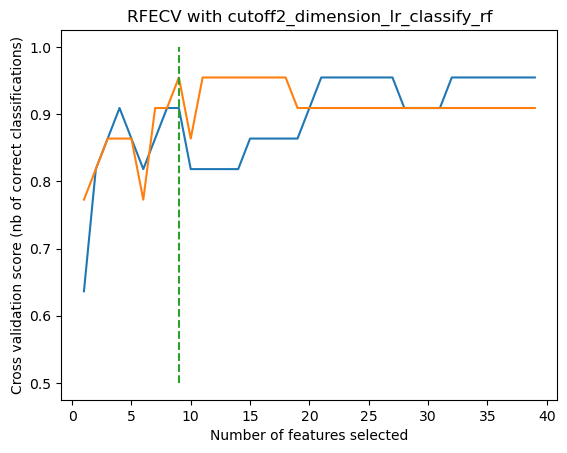

分类算法： lda
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


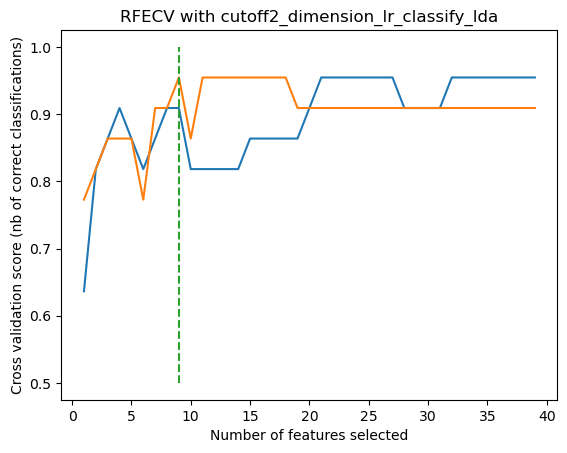

分类算法： gbdt
best_index 5
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


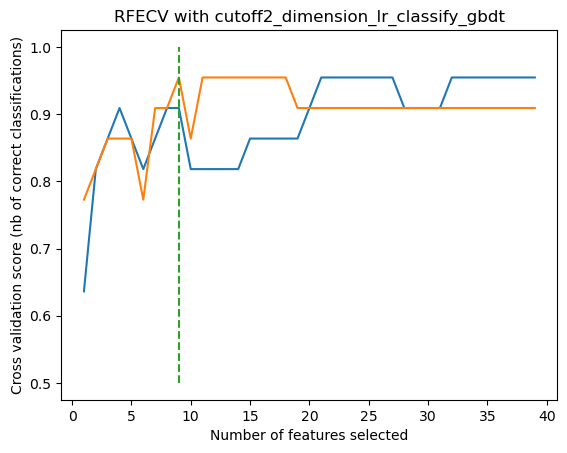

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 2
accuracy 0.9666666666666667


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


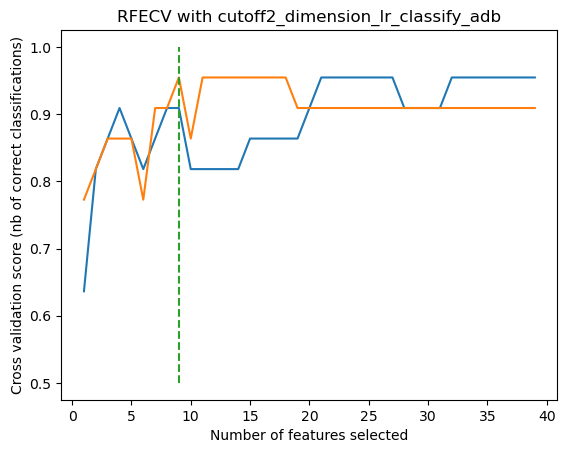

分类算法： xgb
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


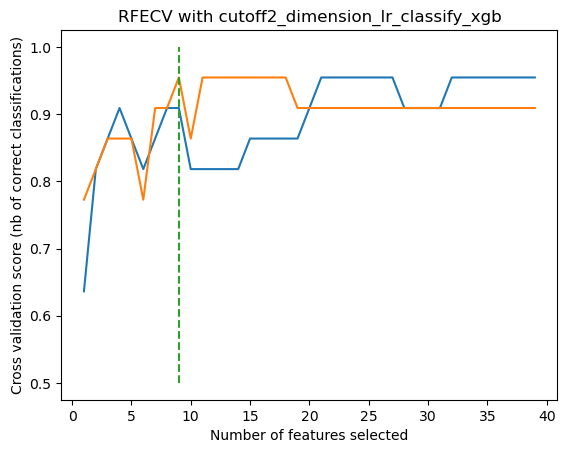

分类算法： dt
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


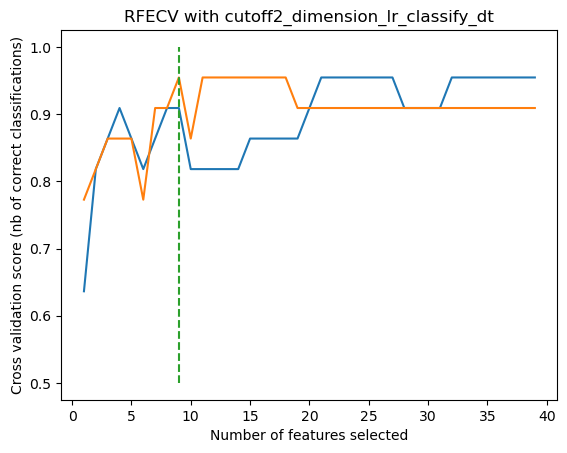

分类算法： svm
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


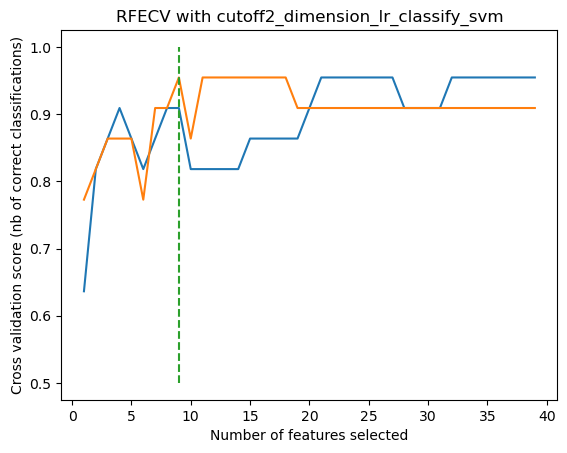

分类算法： nb
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


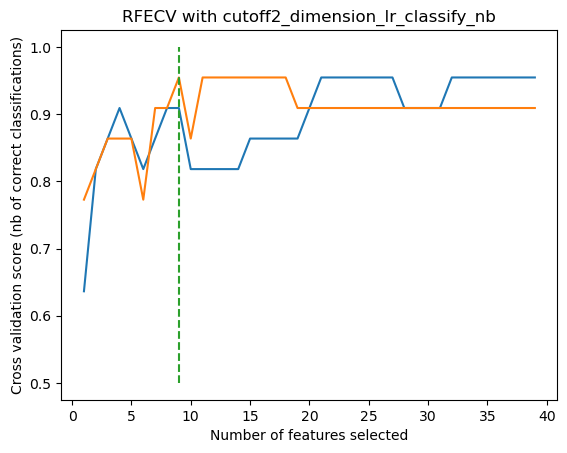

分类算法： cbc
0:	learn: 0.6619938	total: 901us	remaining: 3.61ms
1:	learn: 0.6332560	total: 3.61ms	remaining: 5.41ms
2:	learn: 0.6049612	total: 4.37ms	remaining: 2.92ms
3:	learn: 0.5801671	total: 5.99ms	remaining: 1.5ms
4:	learn: 0.5522242	total: 6.55ms	remaining: 0us


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9666666666666667


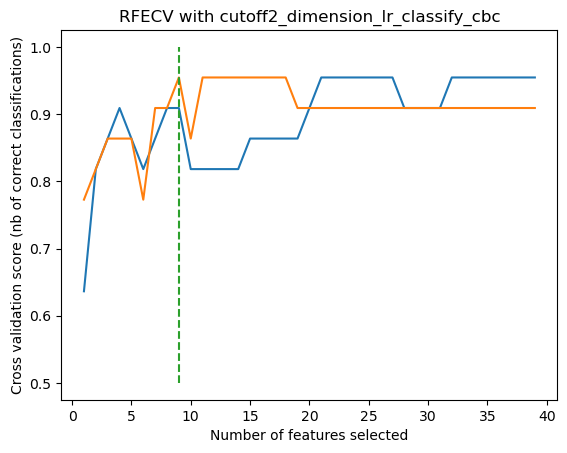

分类算法： bag
best_index 3
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


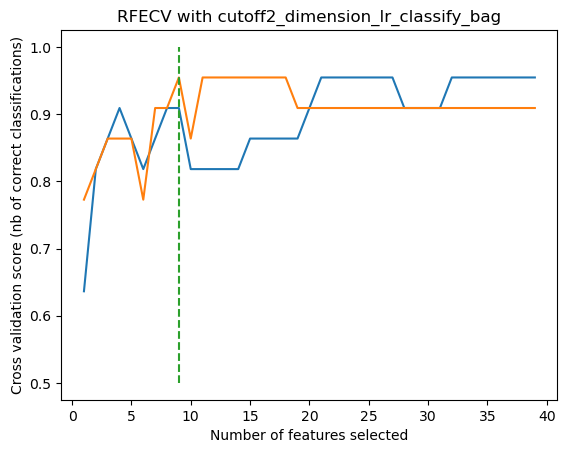

分类算法： cv
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


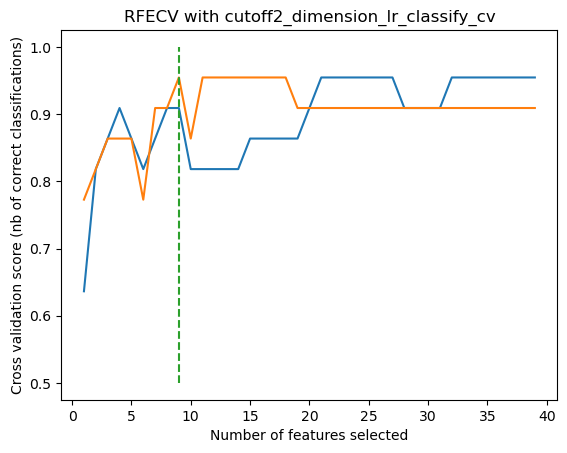

降维算法： rf


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\feature_selection\_rfe.py:296: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X[:, features], y, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\feature_selection\_rfe.py:296: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X[:, features], y, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\feature_selection\_rfe.py:296: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X[:, features], y, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\feature_selection\_rfe.py:296: DataConversionWarning: A column-vector y was passed when a 1

Optimal number of features : 30
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFGGNTEAFF_TRBV12_TRBJ1-1',
       'CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGETQYF_TRBV12_TRBJ2-5',
       'CASSLGYEQYF_TRBV12_TRBJ2-7', 'CASSLGGGYTF_TRBV12_TRBJ1-2',
       'CASSQGYEQYF_TRBV3_TRBJ2-7', 'CASSLGGNQPQHF_TRBV12_TRBJ1-5',
       'CASSLRETQYF_TRBV12_TRBJ2-5', 'CASSLSGNTIYF_TRBV12_TRBJ1-3',
       'CASSLTGNTEAFF_TRBV12_TRBJ1-1', 'CASSFSGNTIYF_TRBV12_TRBJ1-3',
       'CASSYSYEQYF_TRBV6_TRBJ2-7', 'CAWSRDLREPQHF_TRBV30-1_TRBJ1-5',
       'CASSYRENTEAFF_TRBV6_TRBJ1-1', 'CASSYGTSTDTQYF_TRBV6_TRBJ2-3',
       'CASSQAYEQYF_TRBV3_TRBJ2-7', 'CASSLGNQPQHF_TRBV12_TRBJ1-5',
       'CASSLRGDTEAFF_TRBV12_TRBJ1-1', 'CASSLGGNTIYF_TRBV12_TRBJ1-3',
       'CASSLKETQYF_TRBV12_TRBJ2-5', 'CASSDGSIRDYTF_TRBV2-1_TRBJ1-2',
       'CSVGSGGTNEKLFF_TRBV29-1_TRBJ1-4', 'CASSYNSGANVLTF_TRBV6_TRBJ2-6',
       'CASSQETQYF_TRBV3_TRBJ2-5', 'CASSFLQETQYF_TRBV12_TRBJ2-5',
       'CASSLGGYEQYF_TRBV12_TRBJ2-7', 'CAS

C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


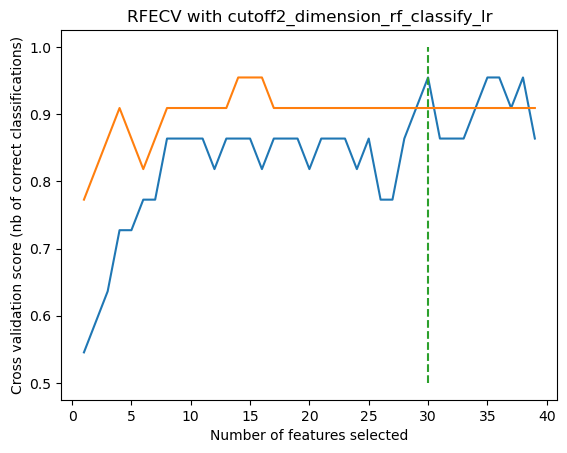

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 6
accuracy 0.9666666666666667


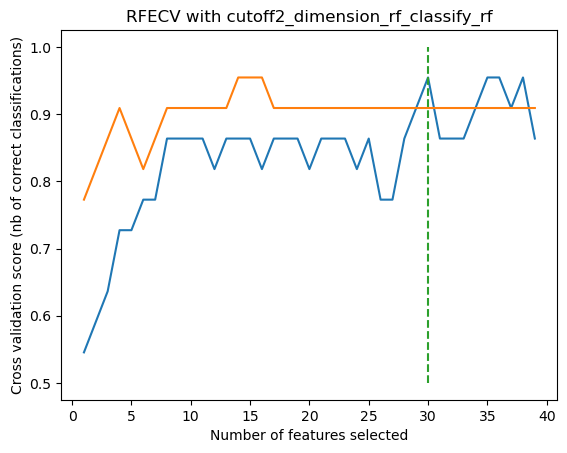

分类算法： lda
best_index 2
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


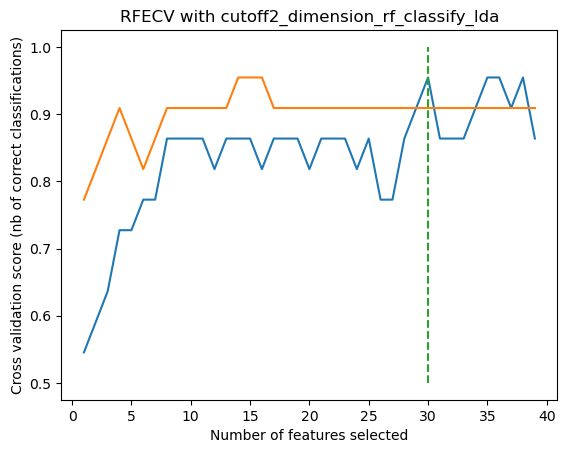

分类算法： gbdt
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


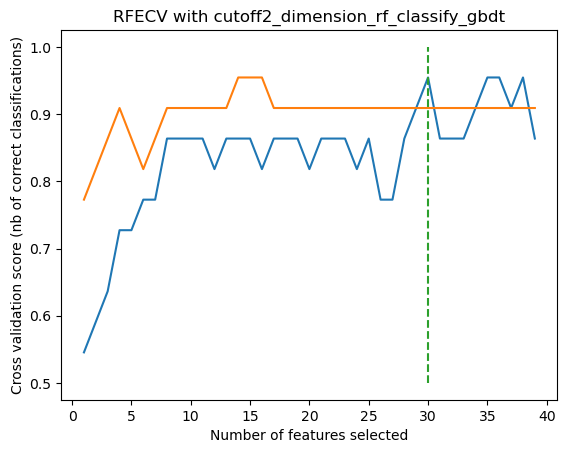

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9666666666666667


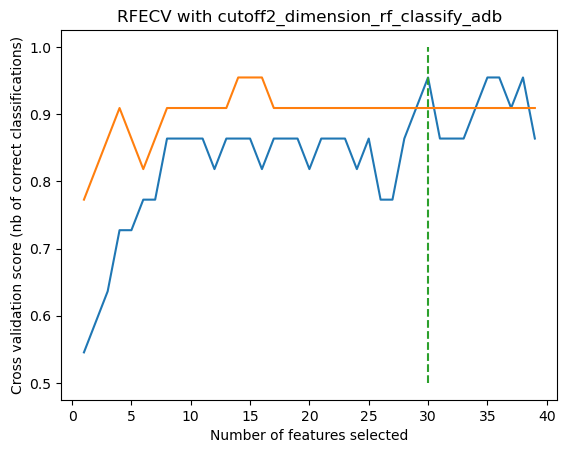

分类算法： xgb
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


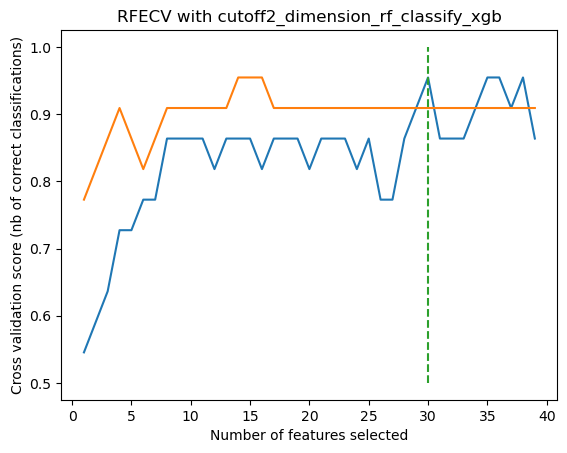

分类算法： dt
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


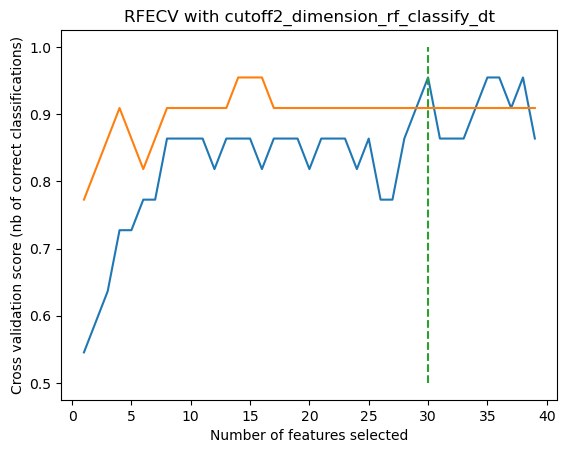

分类算法： svm
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


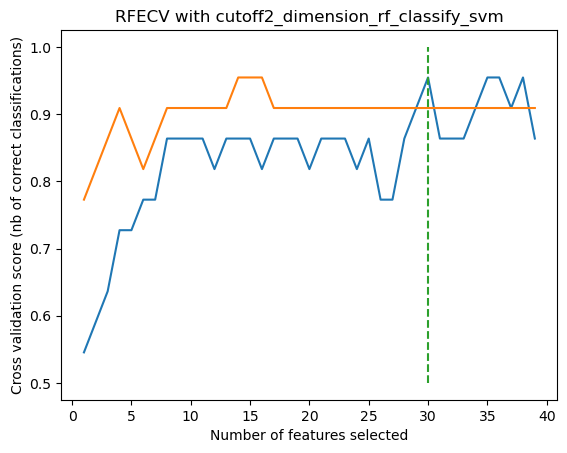

分类算法： nb
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


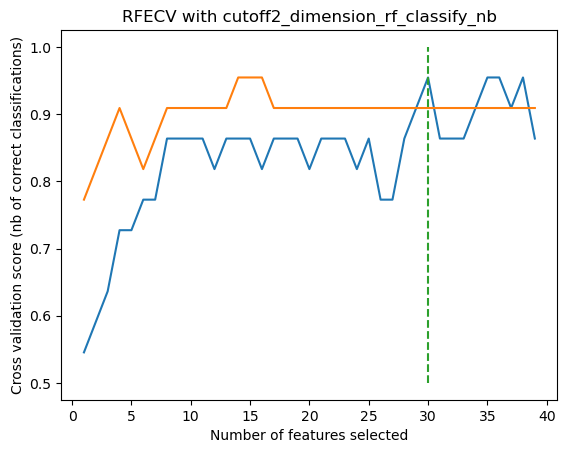

分类算法： cbc
0:	learn: 0.5977952	total: 2.98ms	remaining: 11.9ms
1:	learn: 0.5094344	total: 4.56ms	remaining: 6.84ms
2:	learn: 0.4583393	total: 7.28ms	remaining: 4.85ms
3:	learn: 0.3890387	total: 31.1ms	remaining: 7.77ms
4:	learn: 0.3327796	total: 33.2ms	remaining: 0us
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


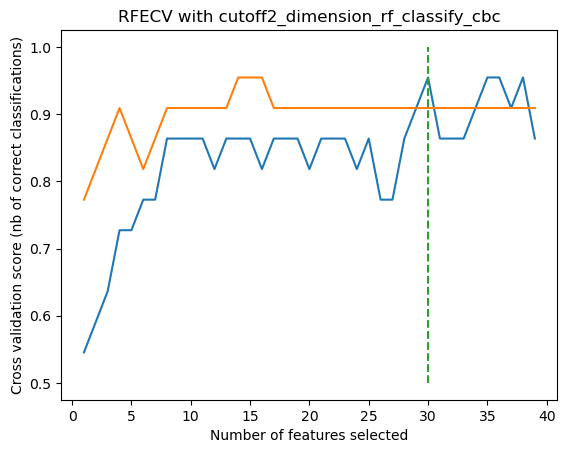

分类算法： bag
best_index 5
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


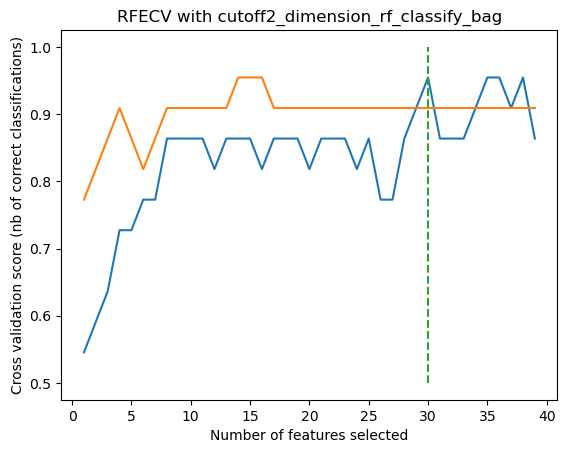

分类算法： cv
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


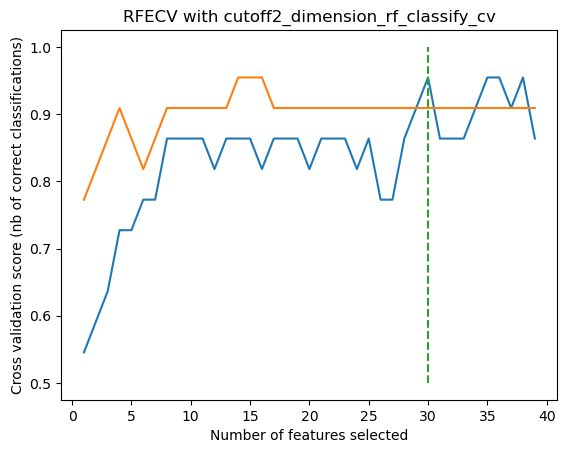

降维算法： lda


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

Optimal number of features : 25
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFGGNTEAFF_TRBV12_TRBJ1-1',
       'CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLRETQYF_TRBV12_TRBJ2-5',
       'CASSLSGNTIYF_TRBV12_TRBJ1-3', 'CASSFSGNTIYF_TRBV12_TRBJ1-3',
       'CASSYSYEQYF_TRBV6_TRBJ2-7', 'CAWSRDLREPQHF_TRBV30-1_TRBJ1-5',
       'CASSSDPTSSHEQYF_TRBV7-9_TRBJ2-7', 'CASSLGNQPQHF_TRBV12_TRBJ1-5',
       'CASSLRGDTEAFF_TRBV12_TRBJ1-1', 'CASSLKETQYF_TRBV12_TRBJ2-5',
       'CASSDGSIRDYTF_TRBV2-1_TRBJ1-2', 'CASSHEGLENTEAFF_TRBV3_TRBJ1-1',
       'CSVGSGGTNEKLFF_TRBV29-1_TRBJ1-4', 'CASSYNSGANVLTF_TRBV6_TRBJ2-6',
       'CASSLRGNYGYTF_TRBV12_TRBJ1-2', 'CASSQGNYGYTF_TRBV3_TRBJ1-2',
       'CASSQETQYF_TRBV3_TRBJ2-5', 'CASSLGGYEQYF_TRBV12_TRBJ2-7',
       'CASSQGSGNTIYF_TRBV3_TRBJ1-3', 'CASSQVGYEQYF_TRBV3_TRBJ2-7',
       'CASSPSYEQYF_TRBV6_TRBJ2-7', 'CASSLNTGELFF_TRBV12_TRBJ2-2',
       'CASSLGNTIYF_TRBV12_TRBJ1-3'],
      dtype='object')
分类算法： lr
best_index 2
accuracy 0.96666666666

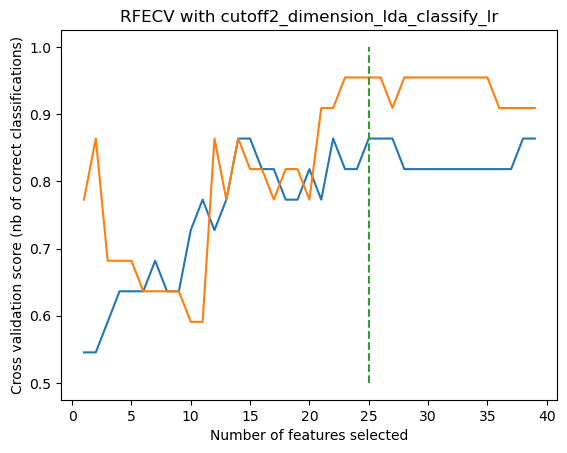

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 3
accuracy 0.9666666666666667


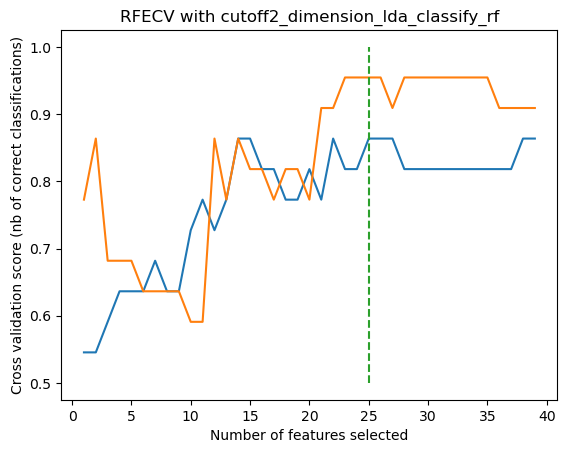

分类算法： lda
best_index 4
accuracy 0.8


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


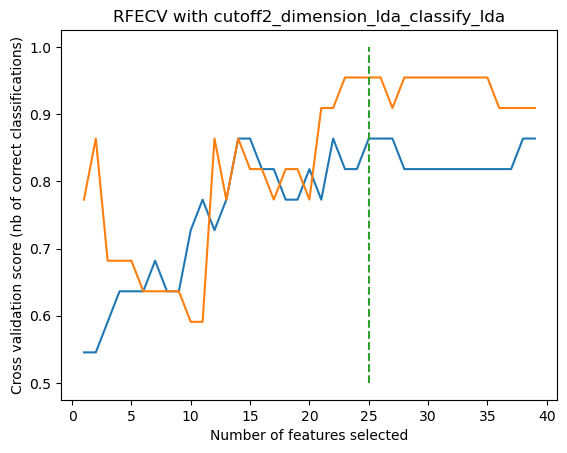

分类算法： gbdt
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


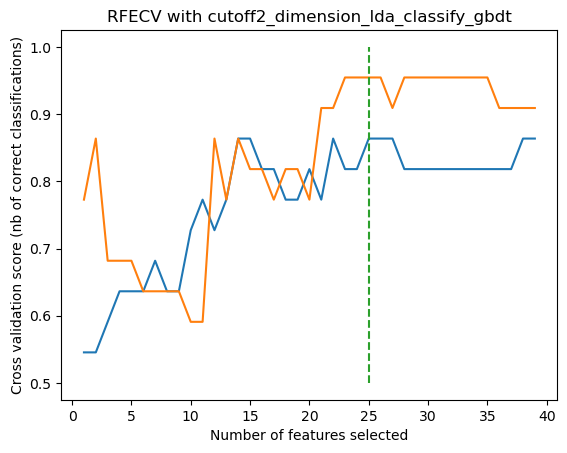

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9666666666666667


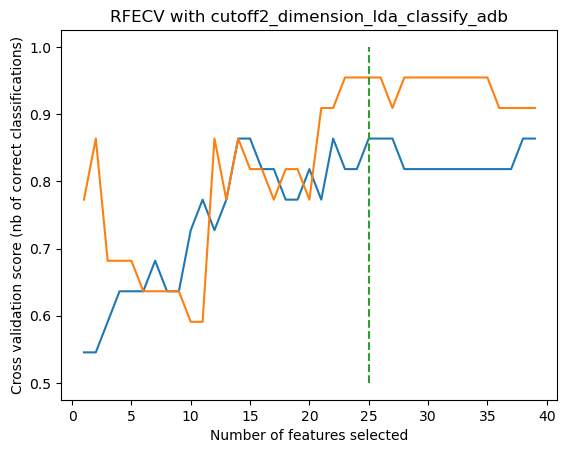

分类算法： xgb
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


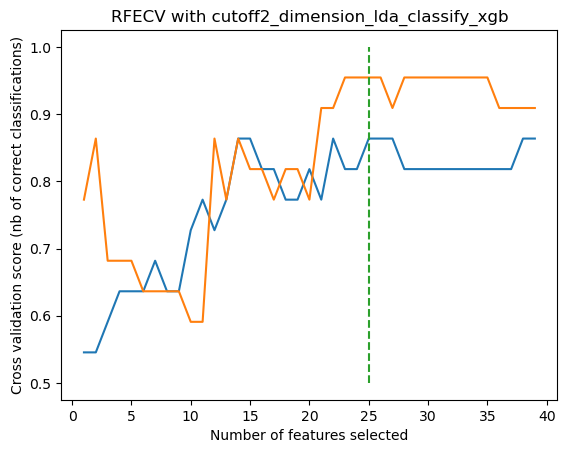

分类算法： dt
best_index 1
accuracy 0.9


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


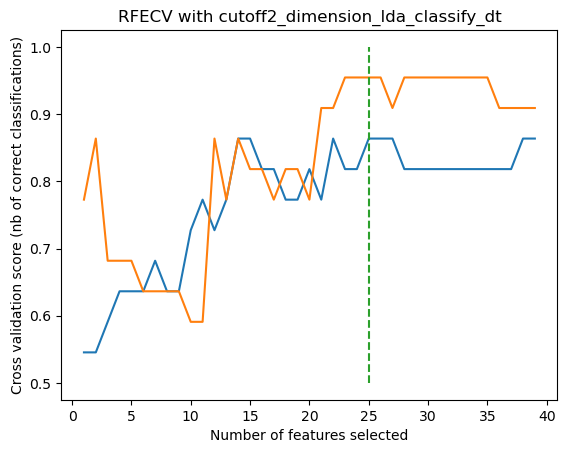

分类算法： svm
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


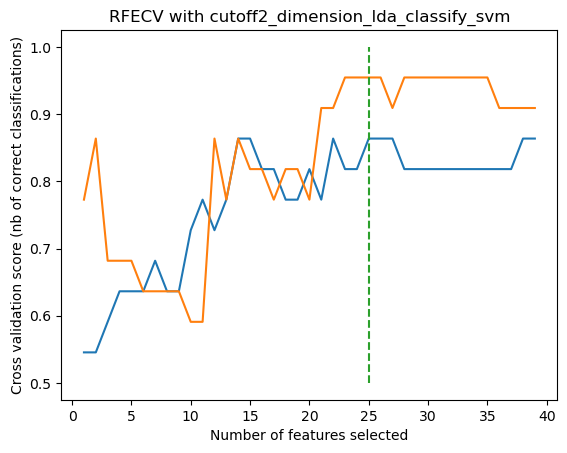

分类算法： nb
best_index 1
accuracy 0.8666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


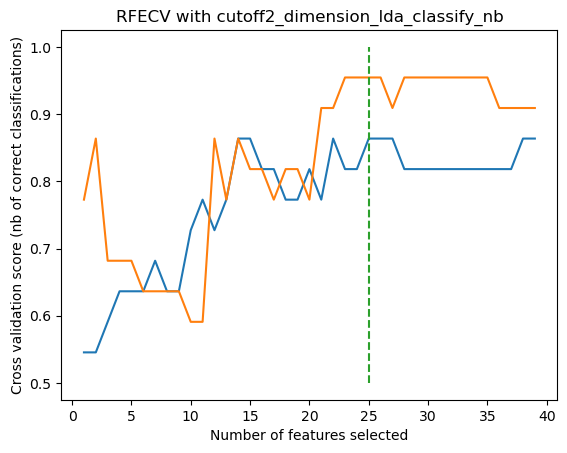

分类算法： cbc
0:	learn: 0.6058011	total: 5.89ms	remaining: 23.6ms
1:	learn: 0.5210313	total: 7.65ms	remaining: 11.5ms
2:	learn: 0.4819275	total: 8.85ms	remaining: 5.9ms
3:	learn: 0.4315511	total: 10.1ms	remaining: 2.51ms
4:	learn: 0.4027996	total: 11.4ms	remaining: 0us
best_index 2
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


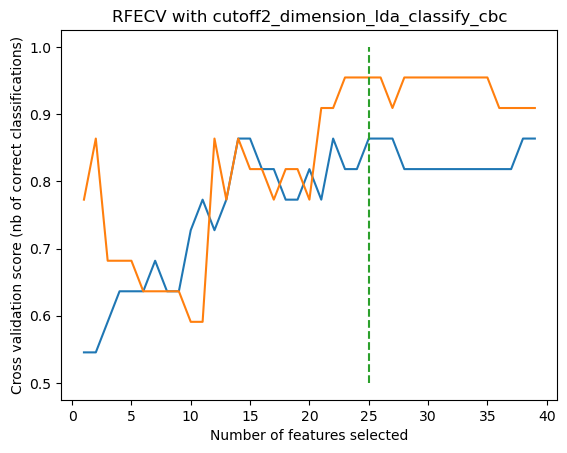

分类算法： bag
best_index 3
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


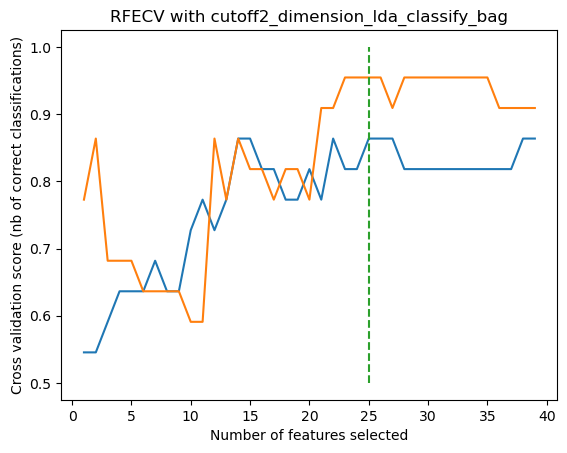

分类算法： cv
best_index 1
accuracy 0.8666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


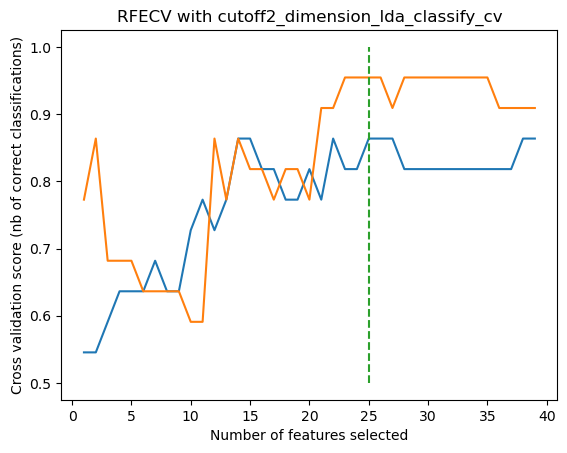

降维算法： gbdt


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example usin

Optimal number of features : 6
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSLQETQYF_TRBV12_TRBJ2-5',
       'CASSLGGNQPQHF_TRBV12_TRBJ1-5', 'CASSLRETQYF_TRBV12_TRBJ2-5',
       'CASSLGNQPQHF_TRBV12_TRBJ1-5', 'CASSYNSGANVLTF_TRBV6_TRBJ2-6'],
      dtype='object')
分类算法： lr
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


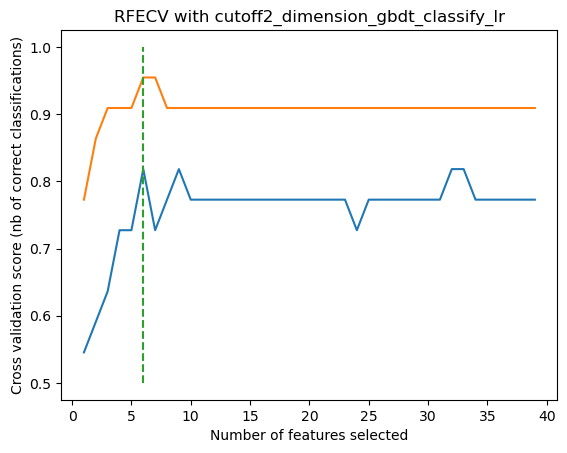

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9666666666666667


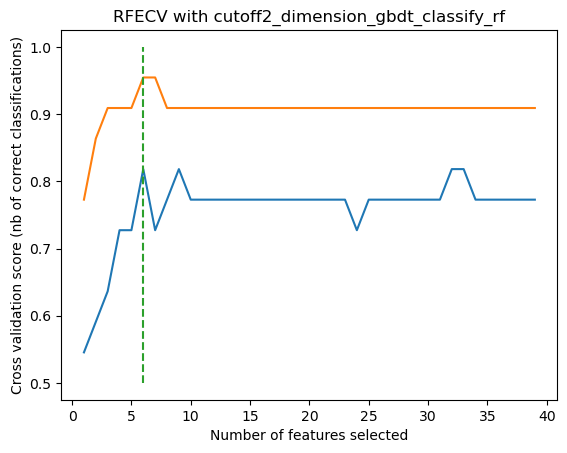

分类算法： lda
best_index 4
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


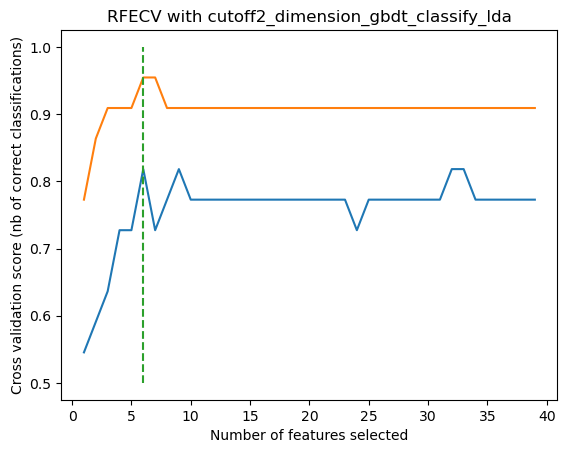

分类算法： gbdt
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


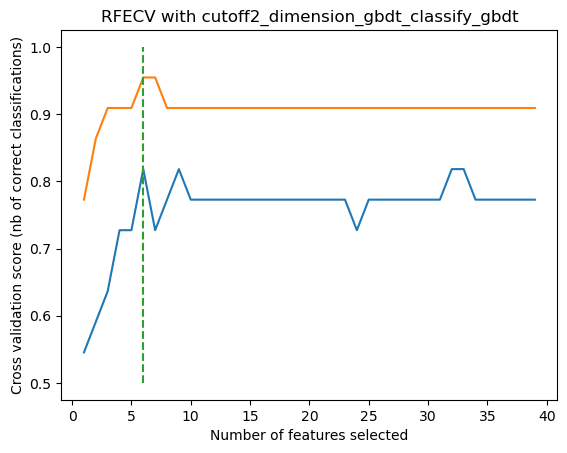

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 3
accuracy 0.9666666666666667


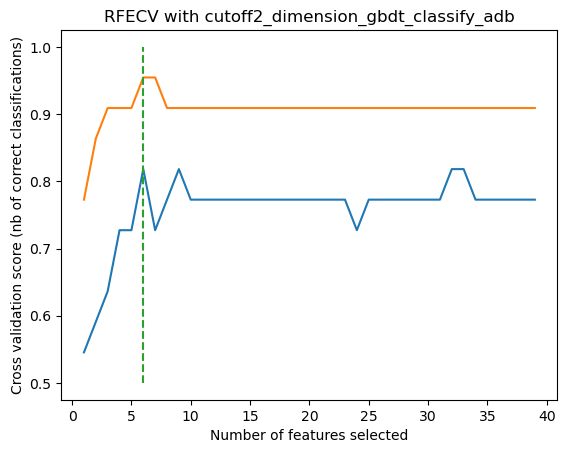

分类算法： xgb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 5
accuracy 0.9666666666666667


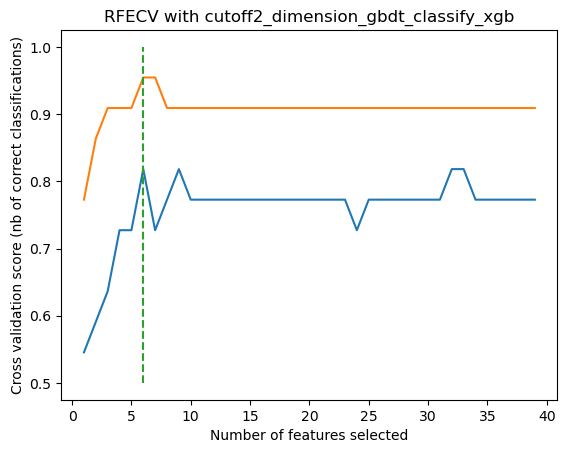

分类算法： dt
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


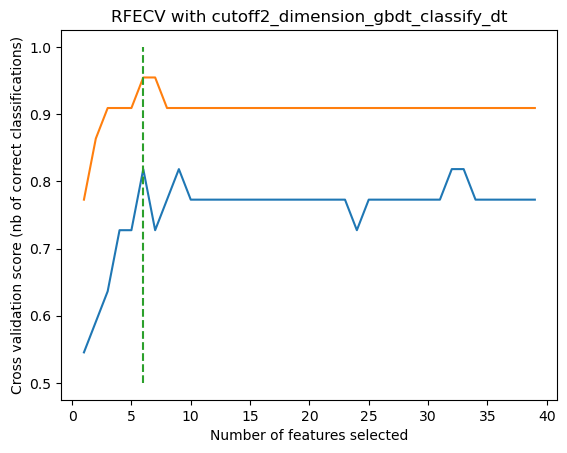

分类算法： svm
best_index 5
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


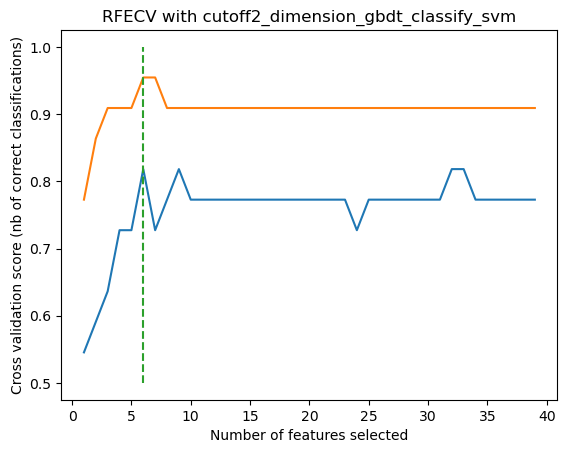

分类算法： nb
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


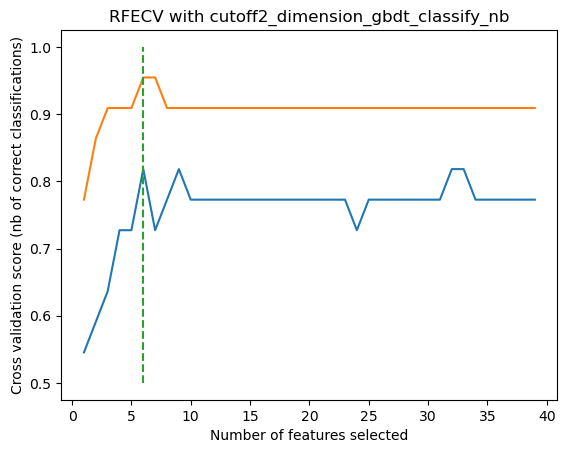

分类算法： cbc
0:	learn: 0.6582991	total: 357us	remaining: 1.43ms
1:	learn: 0.6334748	total: 728us	remaining: 1.09ms
2:	learn: 0.6011482	total: 1.39ms	remaining: 926us
3:	learn: 0.5744324	total: 1.78ms	remaining: 444us
4:	learn: 0.5497704	total: 2.16ms	remaining: 0us
best_index 3
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


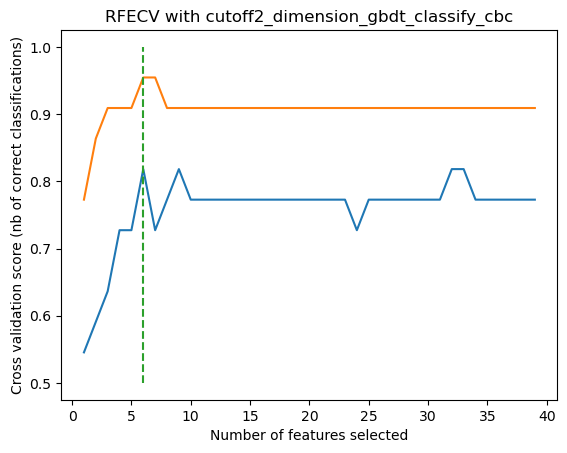

分类算法： bag


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9666666666666667


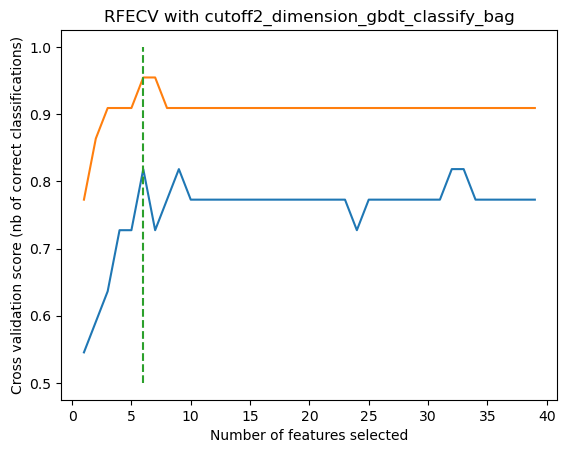

分类算法： cv
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


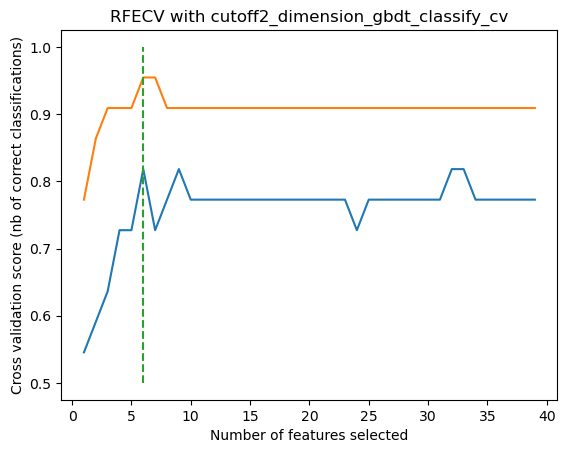

降维算法： adb


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

Optimal number of features : 17
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFGGNTEAFF_TRBV12_TRBJ1-1',
       'CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGYEQYF_TRBV12_TRBJ2-7',
       'CASSLGGGYTF_TRBV12_TRBJ1-2', 'CASSLGGNQPQHF_TRBV12_TRBJ1-5',
       'CASSLRETQYF_TRBV12_TRBJ2-5', 'CASSLSGNTIYF_TRBV12_TRBJ1-3',
       'CASSLTGNTEAFF_TRBV12_TRBJ1-1', 'CAWSRDLREPQHF_TRBV30-1_TRBJ1-5',
       'CASSLGNQPQHF_TRBV12_TRBJ1-5', 'CASSLRGDTEAFF_TRBV12_TRBJ1-1',
       'CASSDGSIRDYTF_TRBV2-1_TRBJ1-2', 'CASSYNSGANVLTF_TRBV6_TRBJ2-6',
       'CASSFLQETQYF_TRBV12_TRBJ2-5', 'CASSQVGYEQYF_TRBV3_TRBJ2-7',
       'CASSLGNTIYF_TRBV12_TRBJ1-3'],
      dtype='object')
分类算法： lr
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


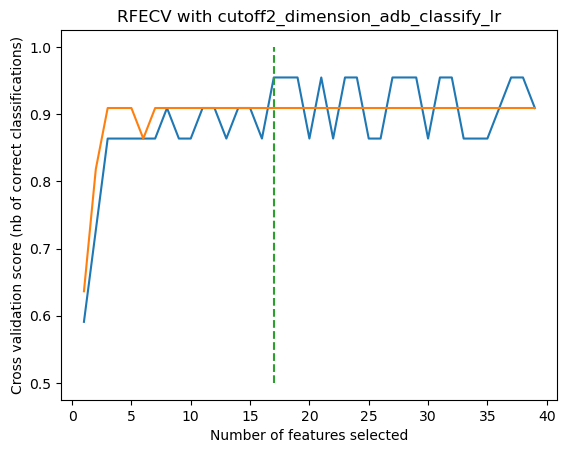

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 7
accuracy 0.9666666666666667


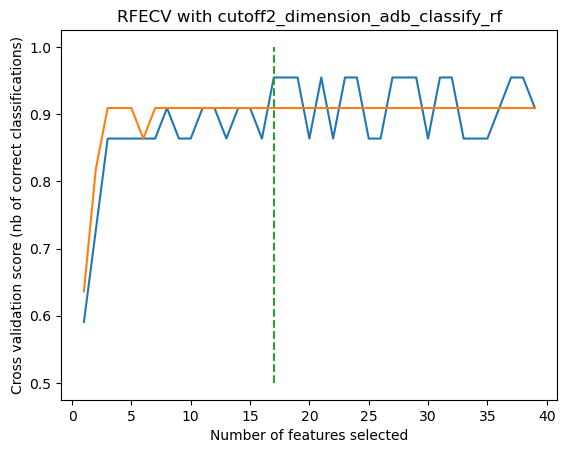

分类算法： lda
best_index 2
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


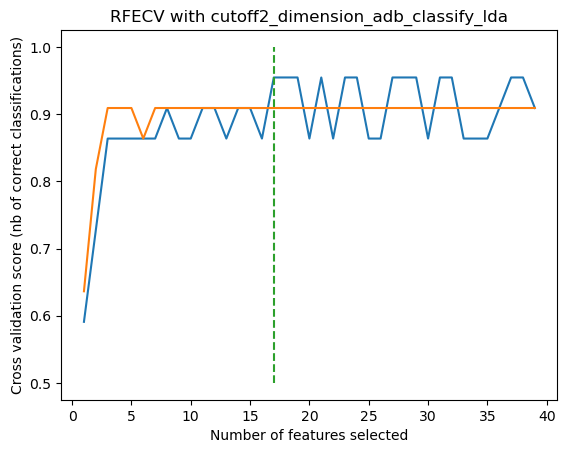

分类算法： gbdt
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


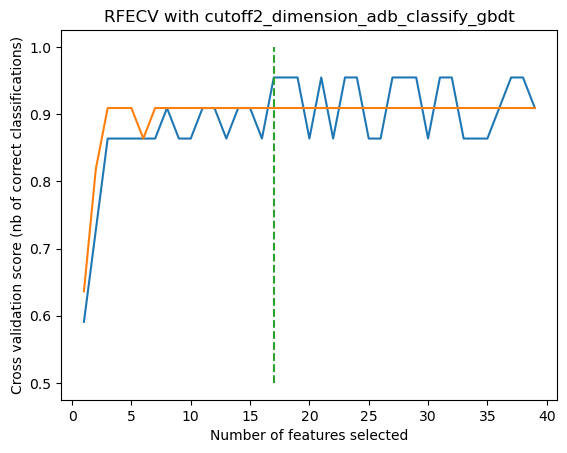

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9666666666666667


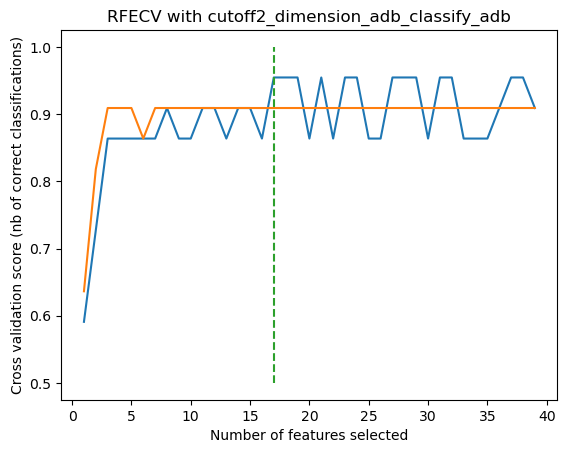

分类算法： xgb
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


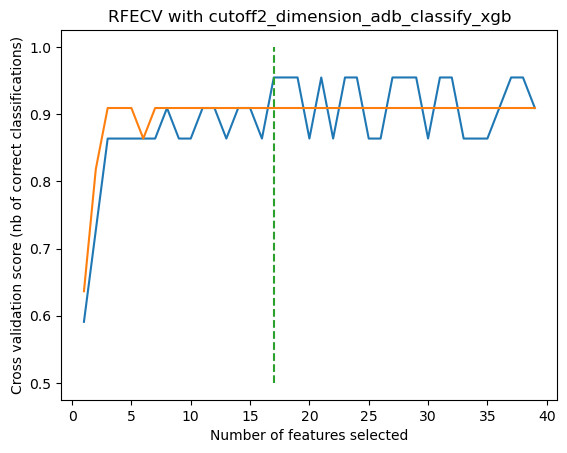

分类算法： dt
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


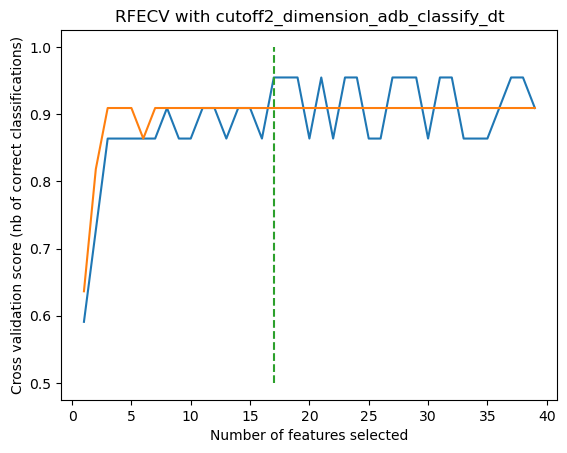

分类算法： svm
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


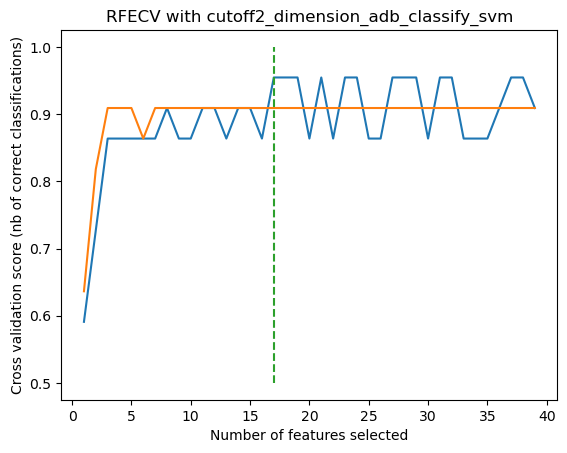

分类算法： nb
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


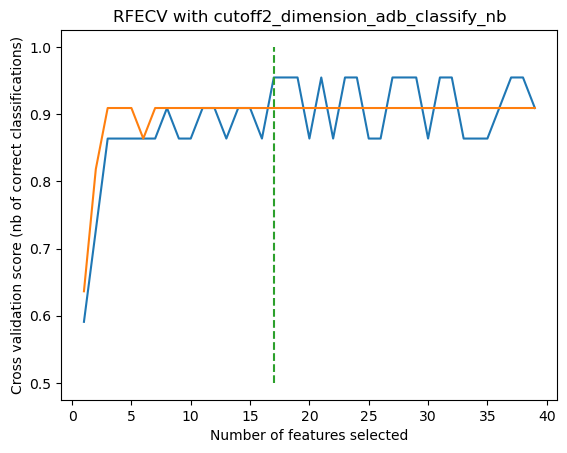

分类算法： cbc
0:	learn: 0.6754115	total: 528us	remaining: 2.12ms
1:	learn: 0.6398438	total: 1.99ms	remaining: 2.99ms
2:	learn: 0.6185865	total: 3.13ms	remaining: 2.08ms
3:	learn: 0.5938914	total: 3.92ms	remaining: 981us
4:	learn: 0.5710219	total: 5.69ms	remaining: 0us
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


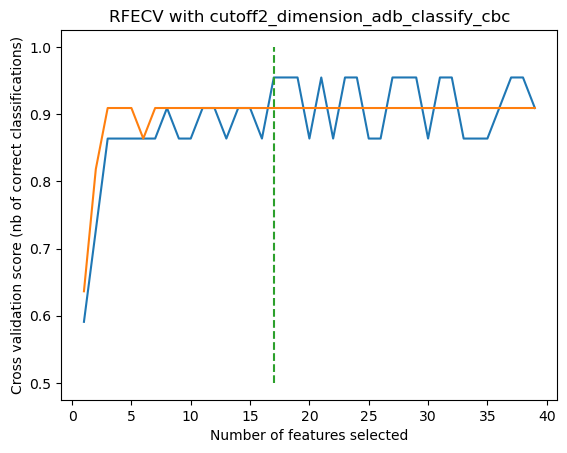

分类算法： bag
best_index 3
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


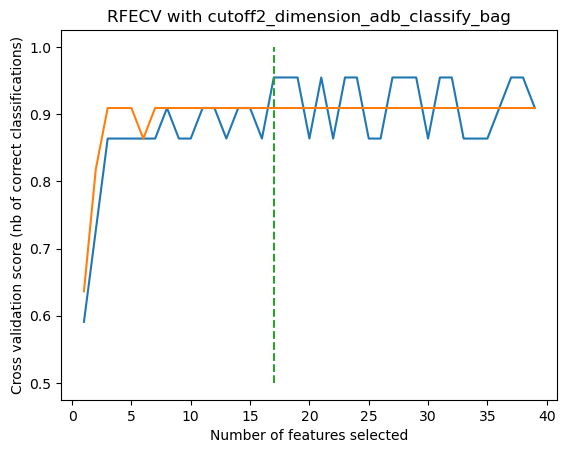

分类算法： cv
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


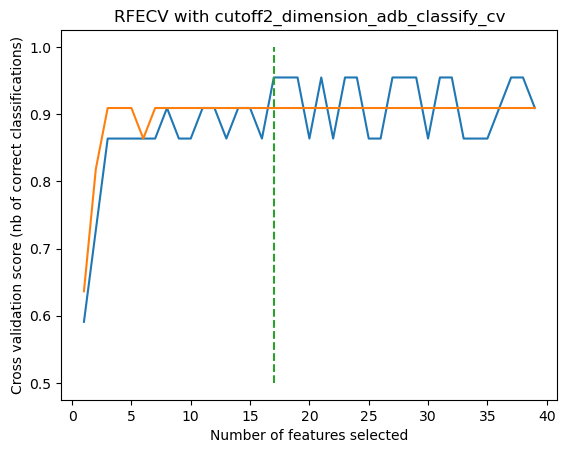

降维算法： xgb
Optimal number of features : 2
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSLGNQPQHF_TRBV12_TRBJ1-5'], dtype='object')
分类算法： lr
best_index 2
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


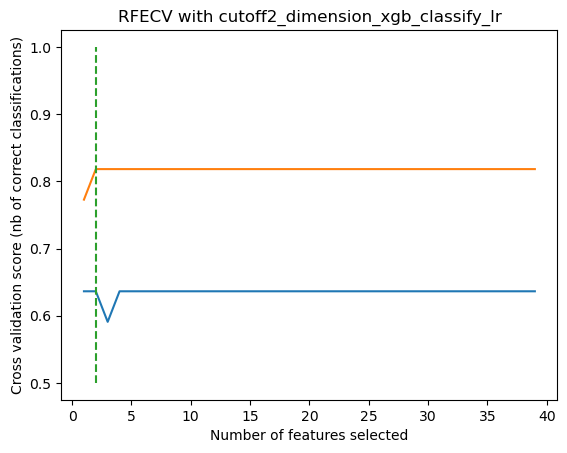

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 1
accuracy 0.9333333333333333


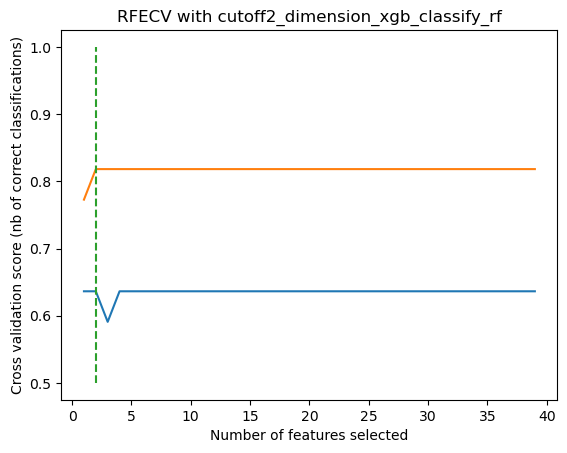

分类算法： lda
best_index 2
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


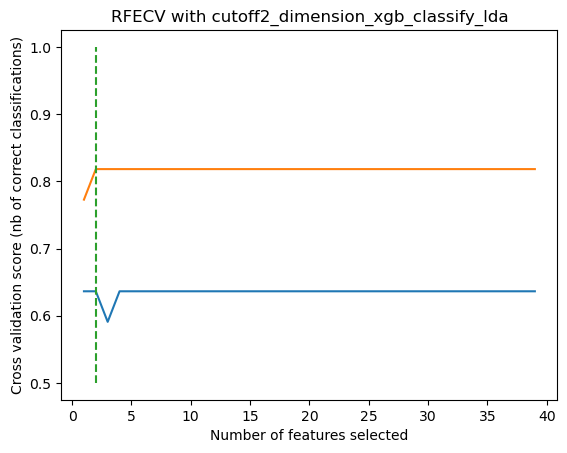

分类算法： gbdt
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


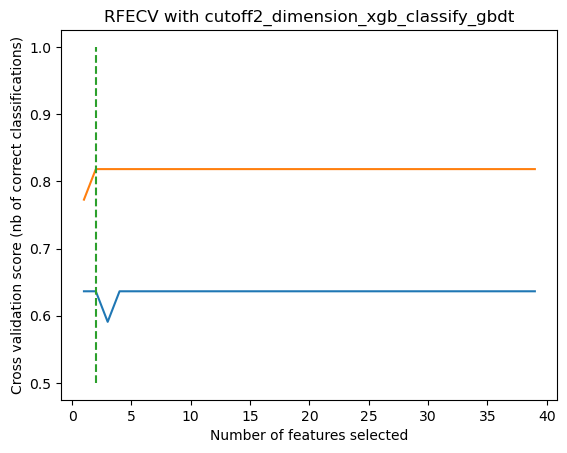

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9333333333333333


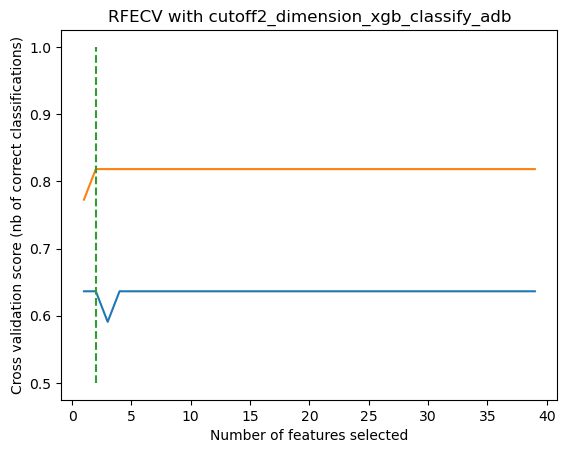

分类算法： xgb
best_index 2
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


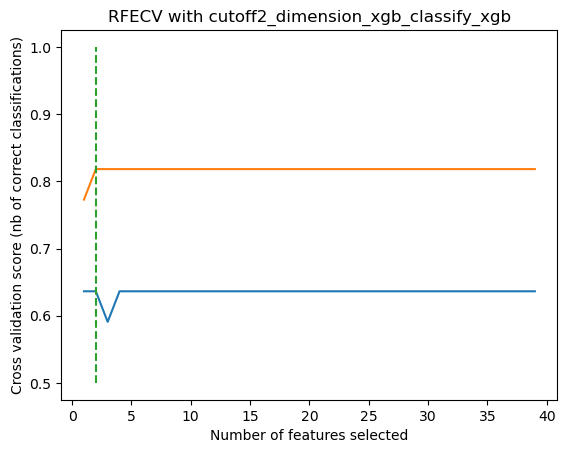

分类算法： dt
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


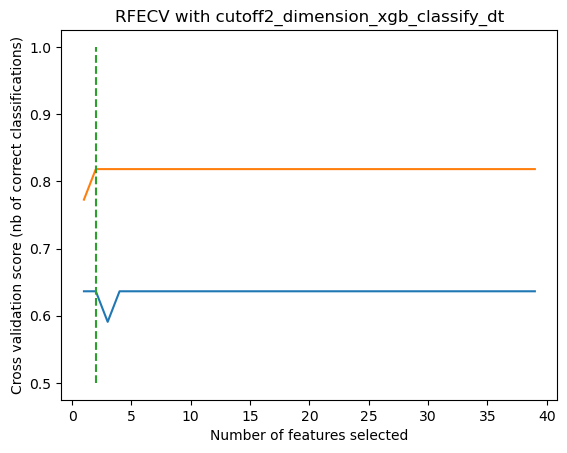

分类算法： svm
best_index 2
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


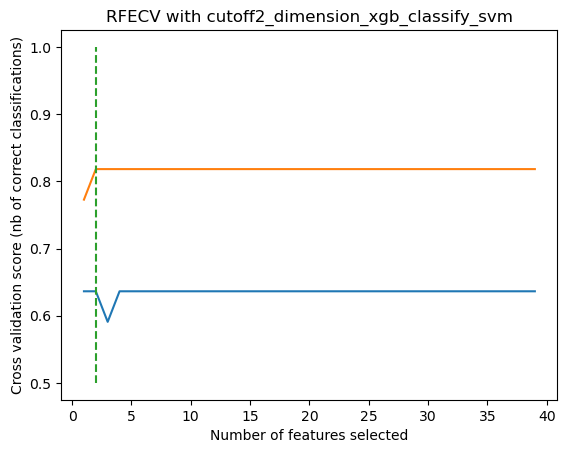

分类算法： nb
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


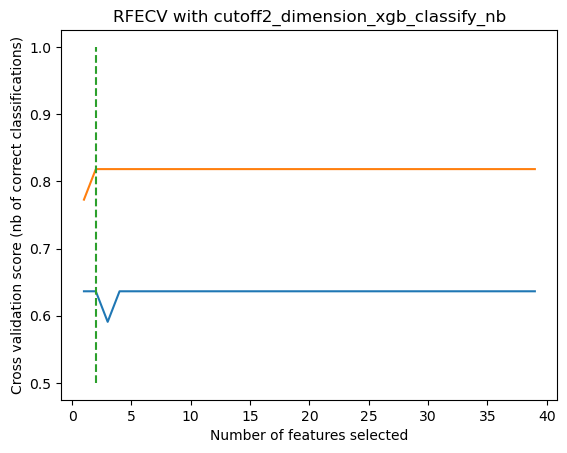

分类算法： cbc
0:	learn: 0.6596699	total: 366us	remaining: 1.47ms
1:	learn: 0.6297601	total: 733us	remaining: 1.1ms
2:	learn: 0.6029673	total: 1.17ms	remaining: 777us
3:	learn: 0.5859722	total: 1.44ms	remaining: 360us
4:	learn: 0.5635723	total: 1.7ms	remaining: 0us
best_index 2
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


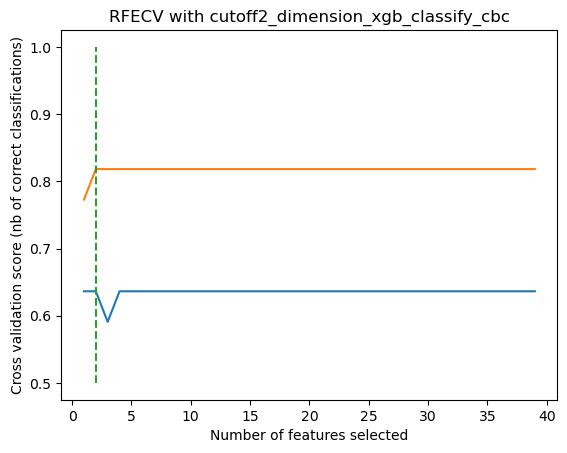

分类算法： bag


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


best_index 1
accuracy 0.9333333333333333


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


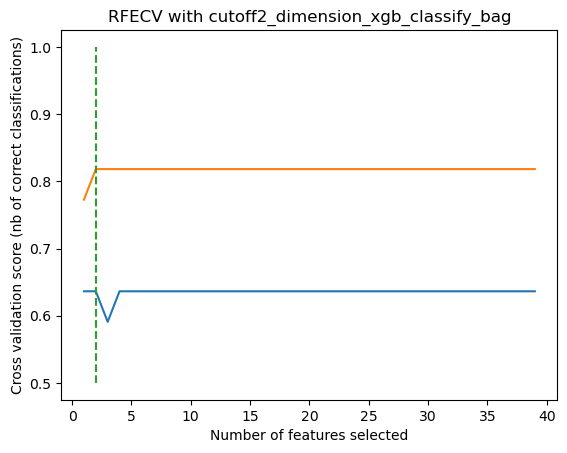

分类算法： cv
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


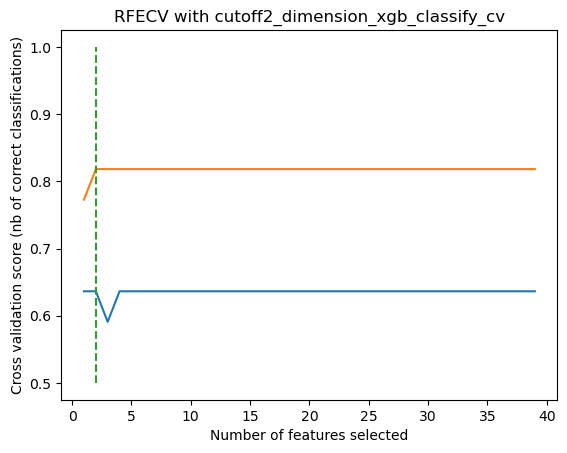

降维算法： dt
Optimal number of features : 38
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFGGNTEAFF_TRBV12_TRBJ1-1',
       'CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGETQYF_TRBV12_TRBJ2-5',
       'CASSLGYEQYF_TRBV12_TRBJ2-7', 'CASSLGGGYTF_TRBV12_TRBJ1-2',
       'CASSQGYEQYF_TRBV3_TRBJ2-7', 'CASSLGGNQPQHF_TRBV12_TRBJ1-5',
       'CASSLRETQYF_TRBV12_TRBJ2-5', 'CASSLSGNTIYF_TRBV12_TRBJ1-3',
       'CASSLTGNTEAFF_TRBV12_TRBJ1-1', 'CASSFSGNTIYF_TRBV12_TRBJ1-3',
       'CASSYSYEQYF_TRBV6_TRBJ2-7', 'CAWSRDLREPQHF_TRBV30-1_TRBJ1-5',
       'CASSYRENTEAFF_TRBV6_TRBJ1-1', 'CASSAGTGIWAEAFF_TRBV25-1_TRBJ1-1',
       'CASSYGTSTDTQYF_TRBV6_TRBJ2-3', 'CASSSDPTSSHEQYF_TRBV7-9_TRBJ2-7',
       'CASSQAYEQYF_TRBV3_TRBJ2-7', 'CASSLGNQPQHF_TRBV12_TRBJ1-5',
       'CASSLRGDTEAFF_TRBV12_TRBJ1-1', 'CASSLGGNTIYF_TRBV12_TRBJ1-3',
       'CASSLKETQYF_TRBV12_TRBJ2-5', 'CASSDGSIRDYTF_TRBV2-1_TRBJ1-2',
       'CASSHEGLENTEAFF_TRBV3_TRBJ1-1', 'CSVGSGGTNEKLFF_TRBV29-1_TRBJ1-4',
       'CASSYNSGANVL

C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


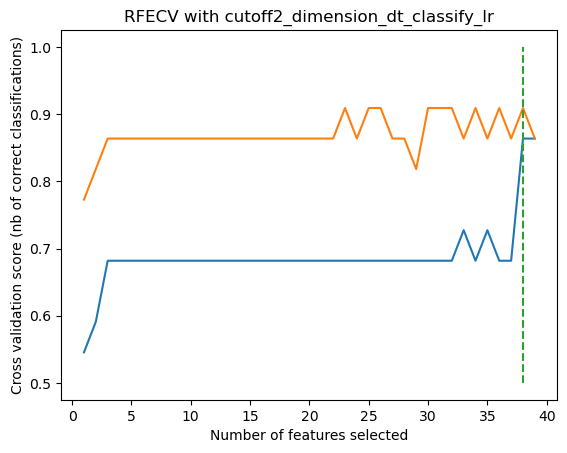

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 6
accuracy 0.9666666666666667


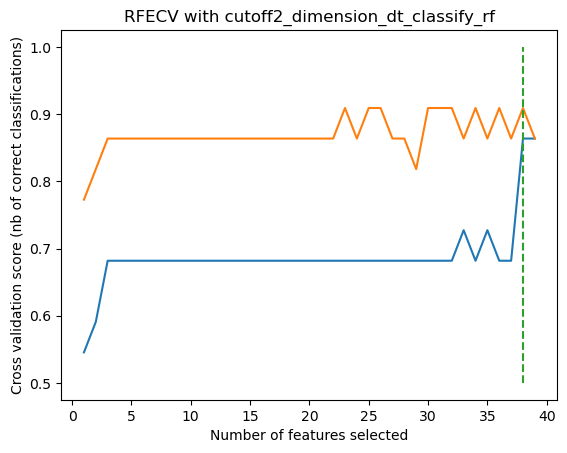

分类算法： lda
best_index 6
accuracy 0.8666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


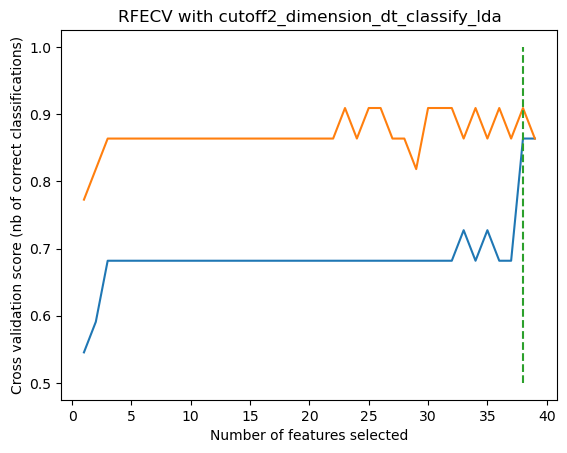

分类算法： gbdt
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


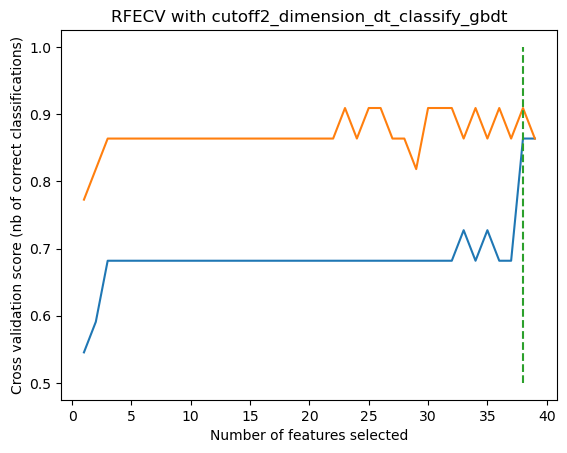

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9666666666666667


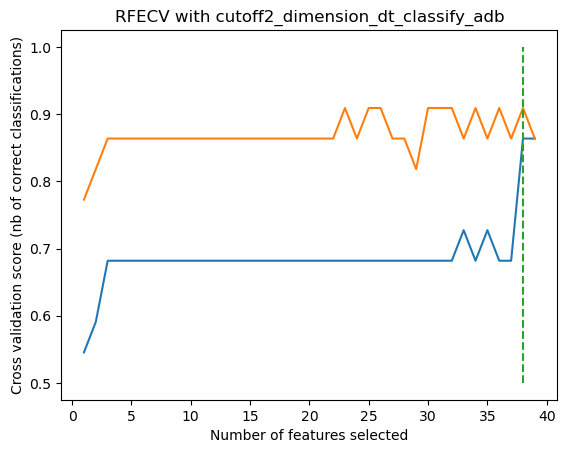

分类算法： xgb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 4
accuracy 0.9666666666666667


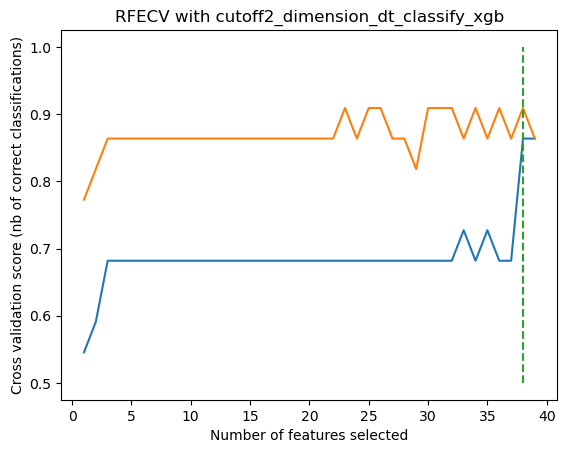

分类算法： dt
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


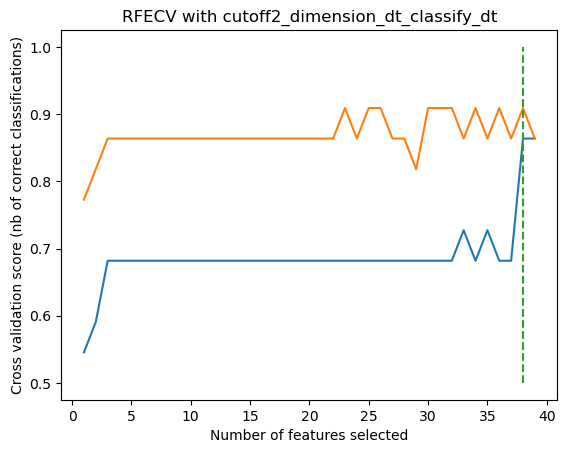

分类算法： svm
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


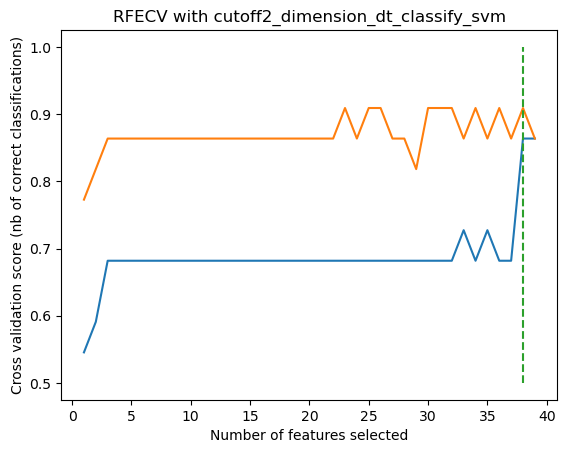

分类算法： nb
best_index 1
accuracy 0.8666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


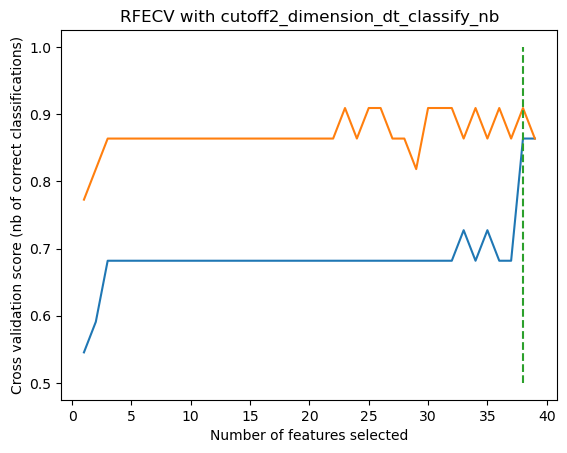

分类算法： cbc
0:	learn: 0.6099281	total: 1.88ms	remaining: 7.52ms
1:	learn: 0.5296503	total: 18ms	remaining: 27ms
2:	learn: 0.4666485	total: 19.8ms	remaining: 13.2ms
3:	learn: 0.4269273	total: 21.8ms	remaining: 5.44ms
4:	learn: 0.3956495	total: 23.6ms	remaining: 0us
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


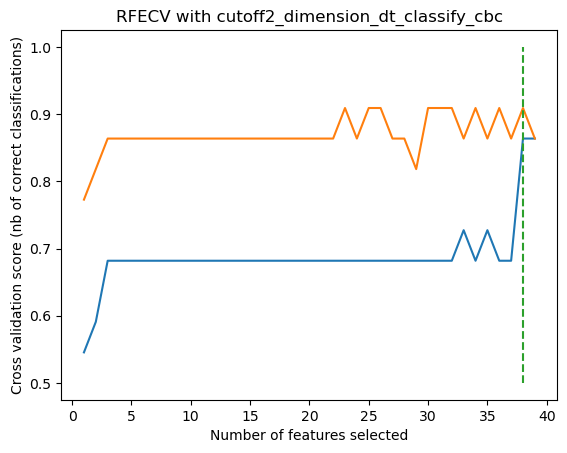

分类算法： bag
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


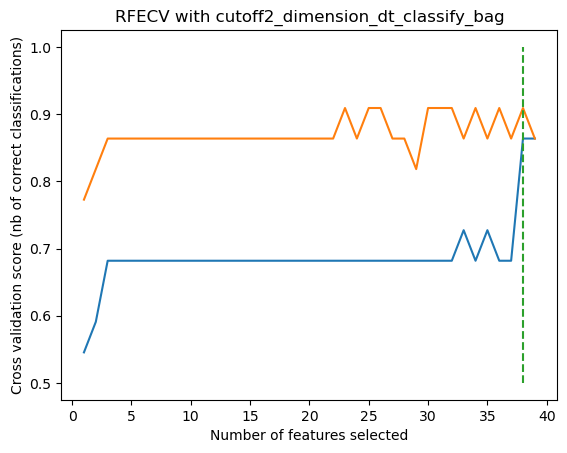

分类算法： cv
best_index 1
accuracy 0.8666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


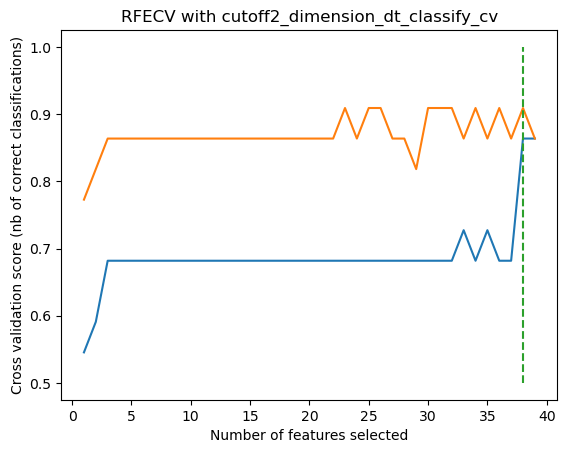

降维算法： svm


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

Optimal number of features : 9
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFGGNTEAFF_TRBV12_TRBJ1-1',
       'CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGGNQPQHF_TRBV12_TRBJ1-5',
       'CASSLRETQYF_TRBV12_TRBJ2-5', 'CASSLSGNTIYF_TRBV12_TRBJ1-3',
       'CASSLTGNTEAFF_TRBV12_TRBJ1-1', 'CAWSRDLREPQHF_TRBV30-1_TRBJ1-5',
       'CASSDGSIRDYTF_TRBV2-1_TRBJ1-2'],
      dtype='object')
分类算法： lr
best_index 2
accuracy 0.9666666666666667


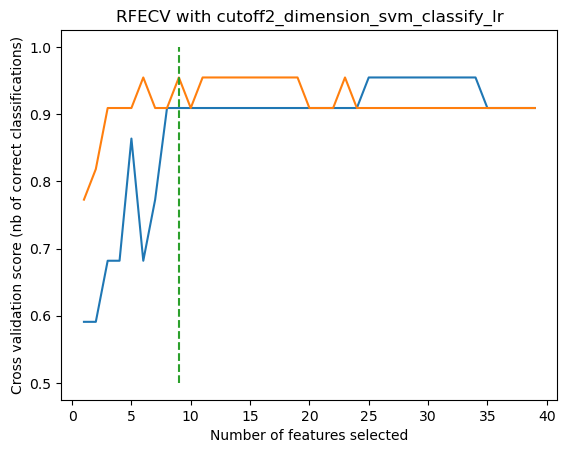

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 5
accuracy 0.9666666666666667


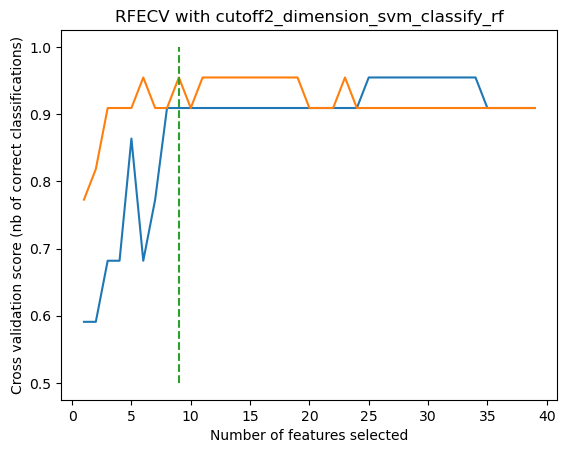

分类算法： lda
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


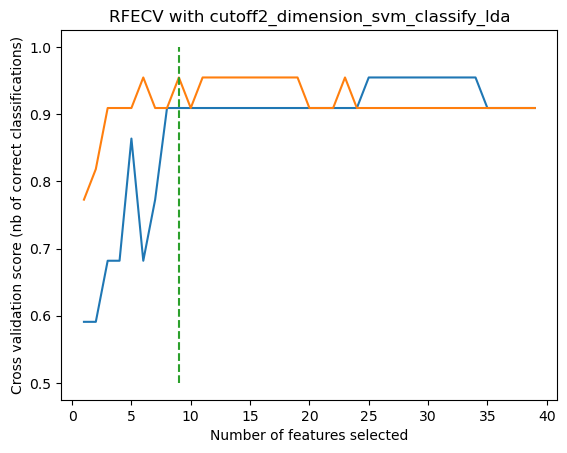

分类算法： gbdt
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


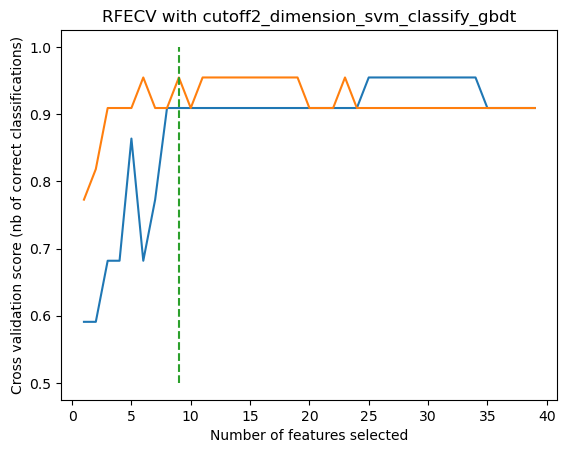

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9666666666666667


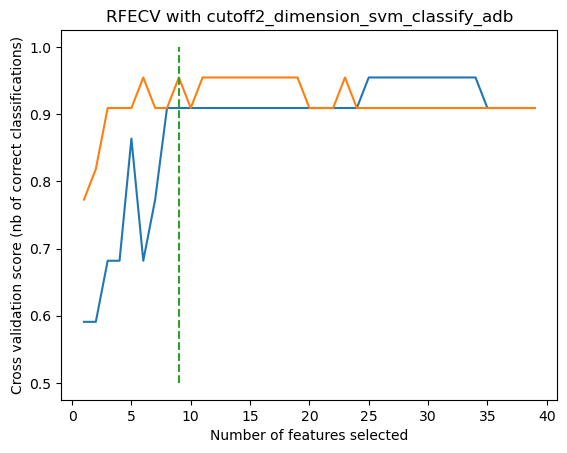

分类算法： xgb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 4
accuracy 0.9666666666666667


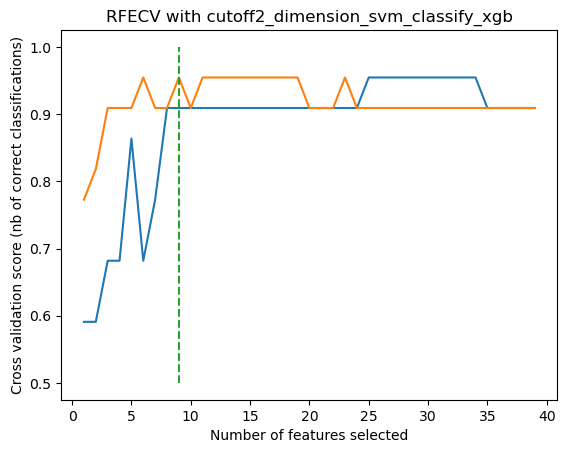

分类算法： dt
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


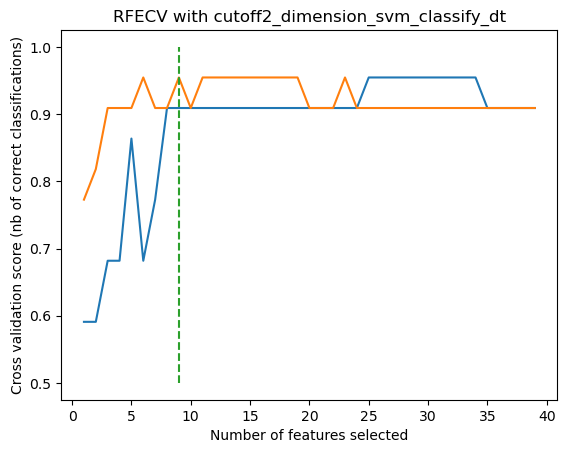

分类算法： svm
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


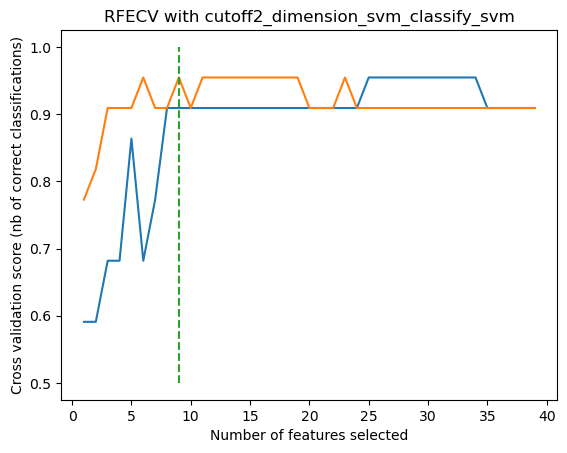

分类算法： nb
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


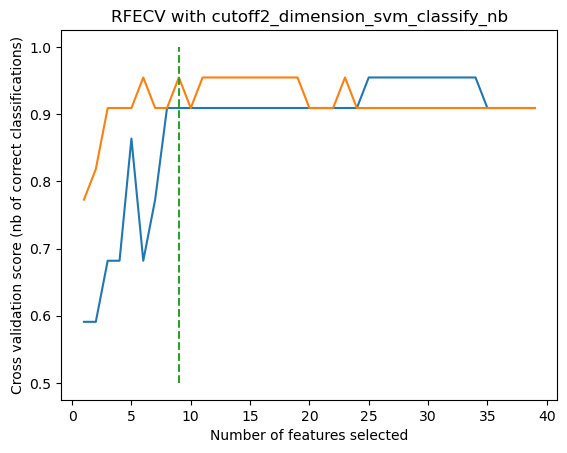

分类算法： cbc
0:	learn: 0.6619938	total: 610us	remaining: 2.44ms
1:	learn: 0.6330422	total: 11.3ms	remaining: 16.9ms
2:	learn: 0.6047846	total: 12ms	remaining: 7.98ms
3:	learn: 0.5796049	total: 12.7ms	remaining: 3.17ms
4:	learn: 0.5516861	total: 13.6ms	remaining: 0us
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


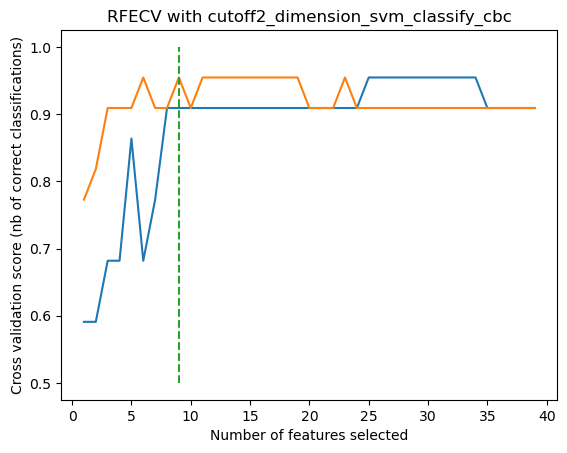

分类算法： bag
best_index 3
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


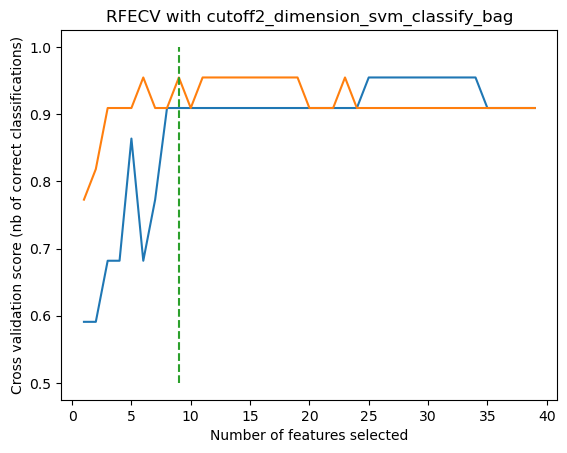

分类算法： cv
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


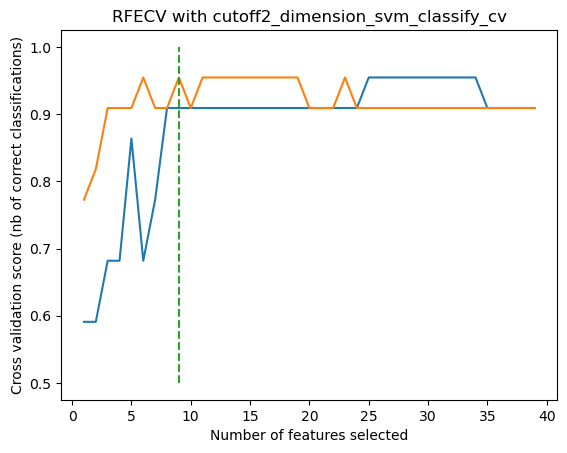

降维算法： cbc
0:	learn: 0.6146500	total: 1.48ms	remaining: 5.92ms
1:	learn: 0.5528645	total: 2.88ms	remaining: 4.32ms
2:	learn: 0.5002231	total: 4.44ms	remaining: 2.96ms
3:	learn: 0.4258563	total: 6.08ms	remaining: 1.52ms
4:	learn: 0.4086200	total: 8.92ms	remaining: 0us
0:	learn: 0.6146500	total: 1.17ms	remaining: 4.68ms
1:	learn: 0.5260895	total: 2.82ms	remaining: 4.23ms
2:	learn: 0.4880813	total: 3.59ms	remaining: 2.4ms
3:	learn: 0.4318003	total: 4.52ms	remaining: 1.13ms
4:	learn: 0.4096892	total: 6.04ms	remaining: 0us
0:	learn: 0.5838485	total: 15.6ms	remaining: 62.4ms
1:	learn: 0.5204845	total: 17ms	remaining: 25.6ms
2:	learn: 0.4924436	total: 44.4ms	remaining: 29.6ms
3:	learn: 0.4465472	total: 46.2ms	remaining: 11.6ms
4:	learn: 0.4037589	total: 48.1ms	remaining: 0us
0:	learn: 0.5827379	total: 1.15ms	remaining: 4.59ms
1:	learn: 0.5007326	total: 2.9ms	remaining: 4.36ms
2:	learn: 0.4542284	total: 4.14ms	remaining: 2.76ms
3:	learn: 0.3911910	total: 5.36ms	remaining: 1.34ms
4:	learn: 0.346

C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


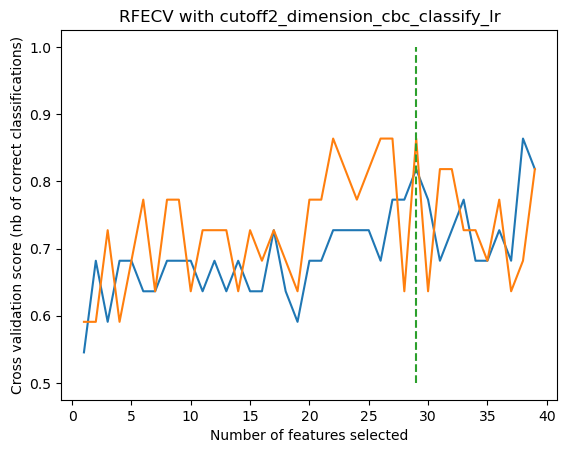

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 4
accuracy 0.9666666666666667


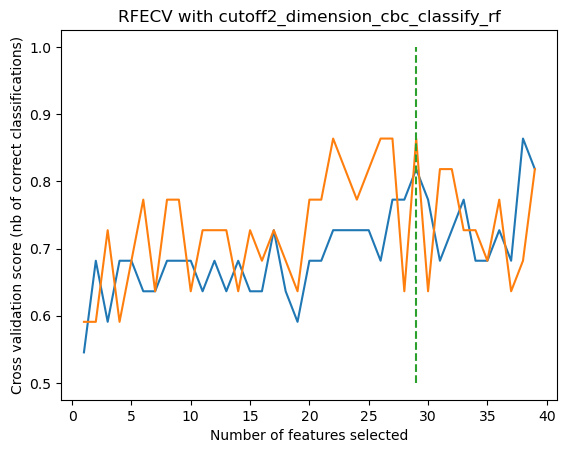

分类算法： lda
best_index 2
accuracy 0.8666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


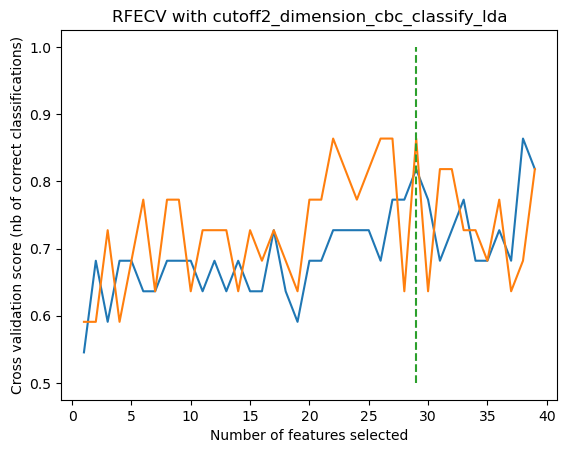

分类算法： gbdt
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


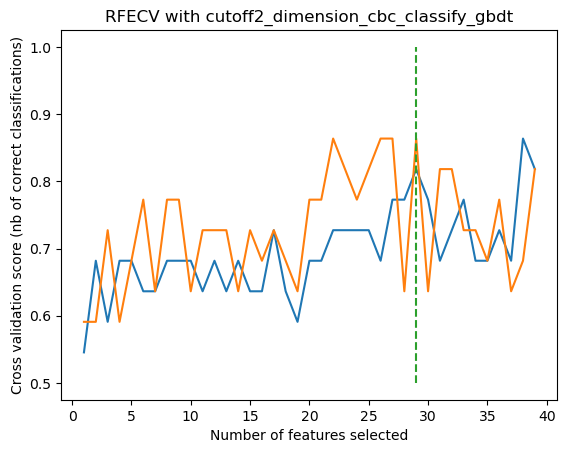

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9666666666666667


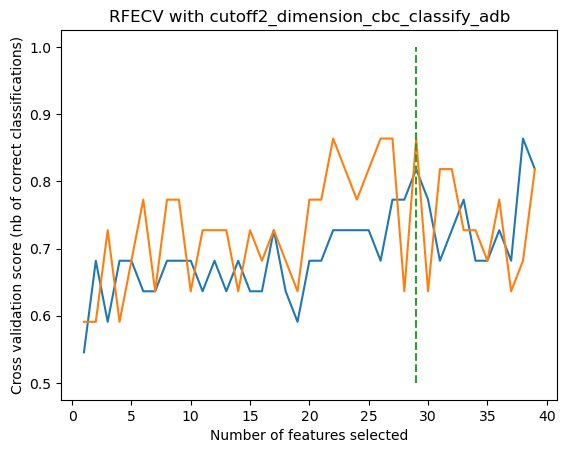

分类算法： xgb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 4
accuracy 0.9666666666666667


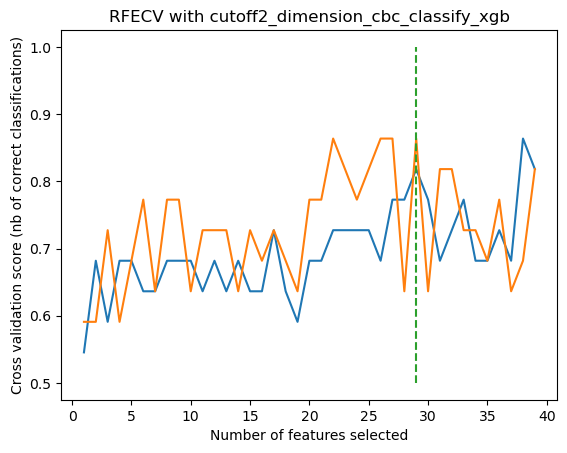

分类算法： dt
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


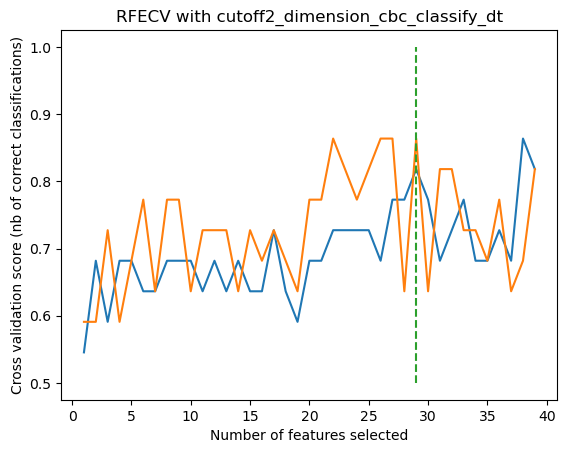

分类算法： svm
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


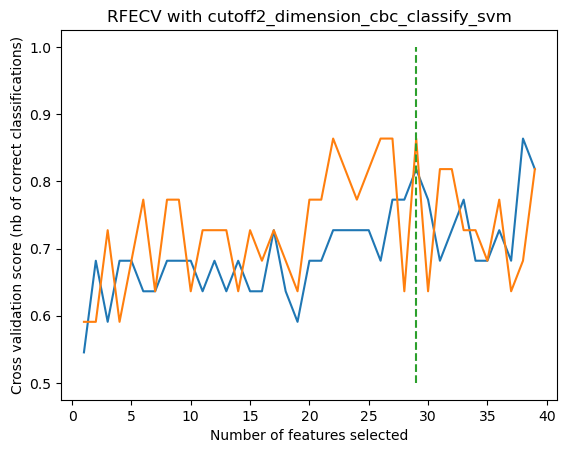

分类算法： nb
best_index 1
accuracy 0.8666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


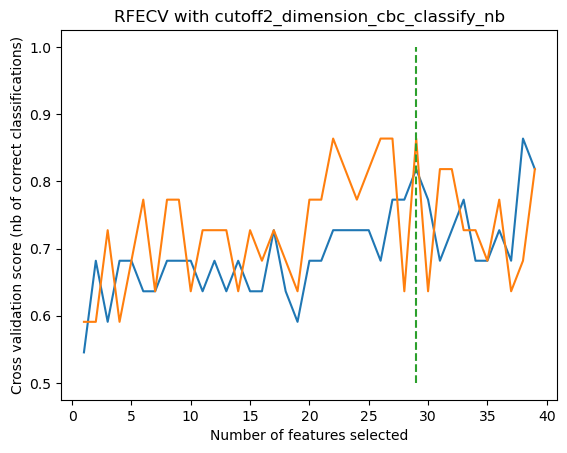

分类算法： cbc
0:	learn: 0.5926255	total: 2.12ms	remaining: 8.46ms
1:	learn: 0.5115186	total: 19.7ms	remaining: 29.6ms
2:	learn: 0.4472954	total: 49.2ms	remaining: 32.8ms
3:	learn: 0.3980789	total: 51.9ms	remaining: 13ms
4:	learn: 0.3387977	total: 63.6ms	remaining: 0us
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


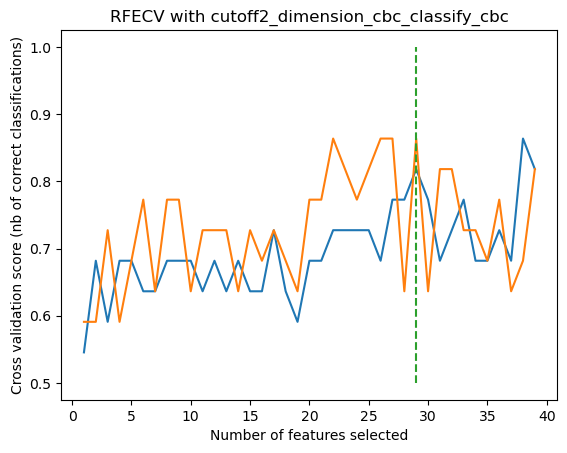

分类算法： bag


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 3
accuracy 0.9666666666666667


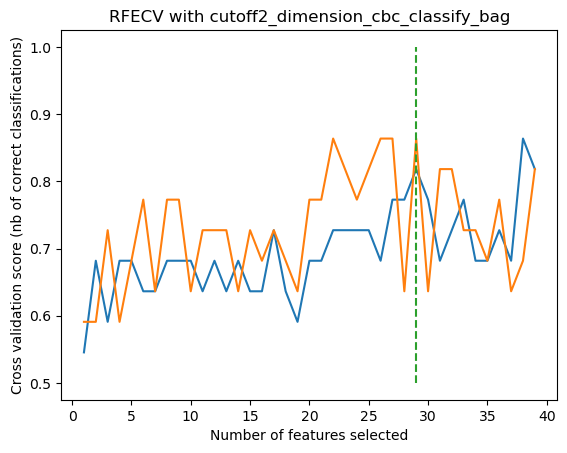

分类算法： cv
best_index 1
accuracy 0.8666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


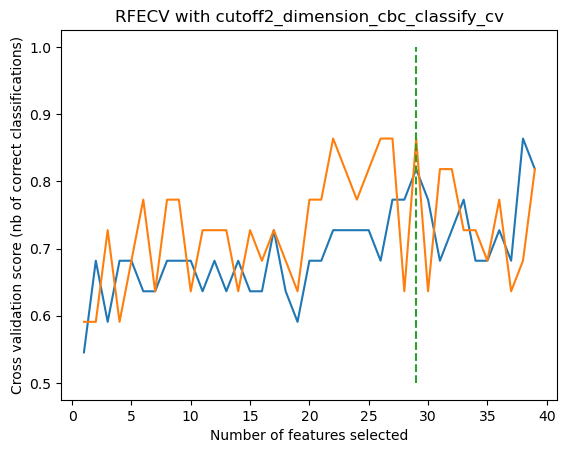

cutoff3
降维算法： lr
Optimal number of features : 8
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFGGNTEAFF_TRBV12_TRBJ1-1',
       'CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGETQYF_TRBV12_TRBJ2-5',
       'CASSLGGNQPQHF_TRBV12_TRBJ1-5', 'CASSLRETQYF_TRBV12_TRBJ2-5',
       'CASSLSGNTIYF_TRBV12_TRBJ1-3', 'CASSLTGNTEAFF_TRBV12_TRBJ1-1'],
      dtype='object')
分类算法： lr
best_index 2
accuracy 0.9666666666666667


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

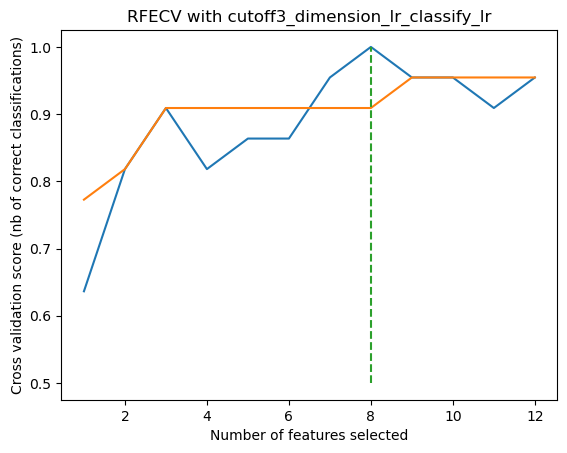

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 4
accuracy 0.9666666666666667


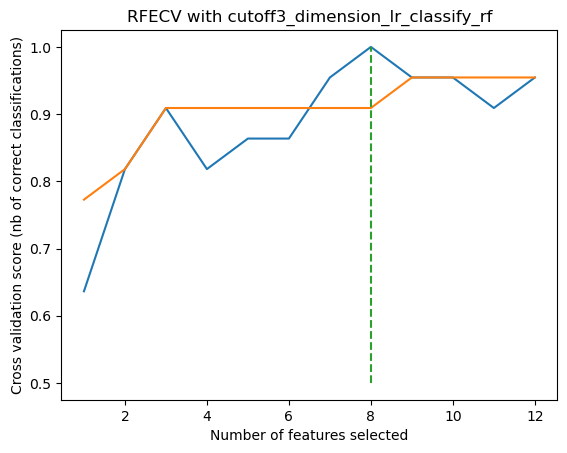

分类算法： lda
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


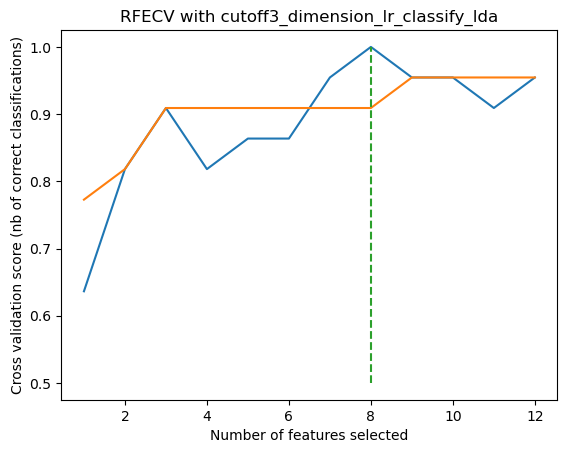

分类算法： gbdt
best_index 5
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


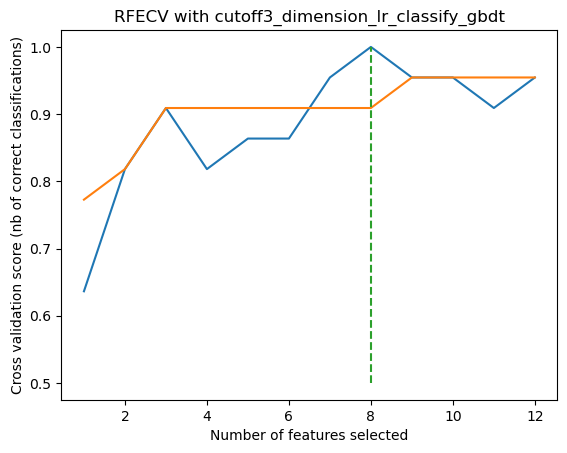

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 4
accuracy 0.9666666666666667


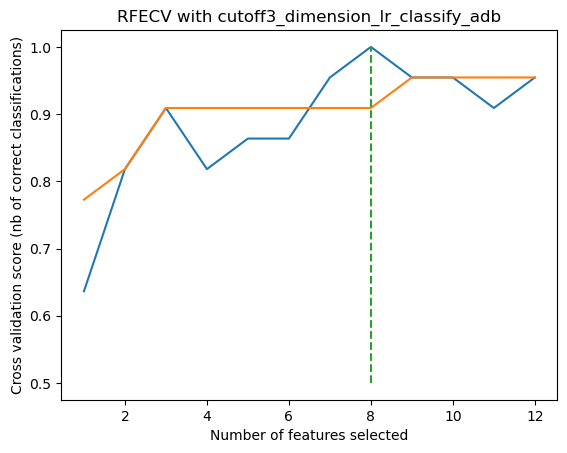

分类算法： xgb
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


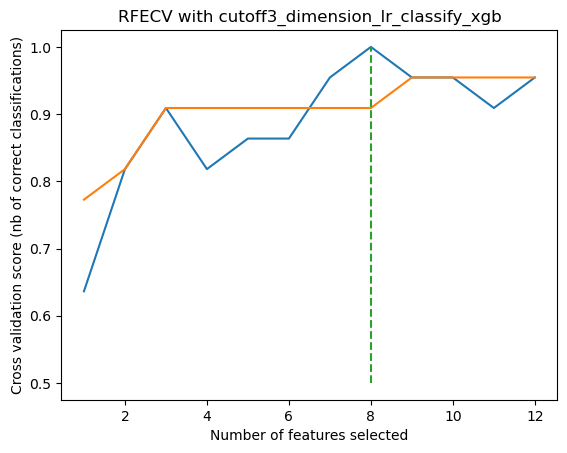

分类算法： dt
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


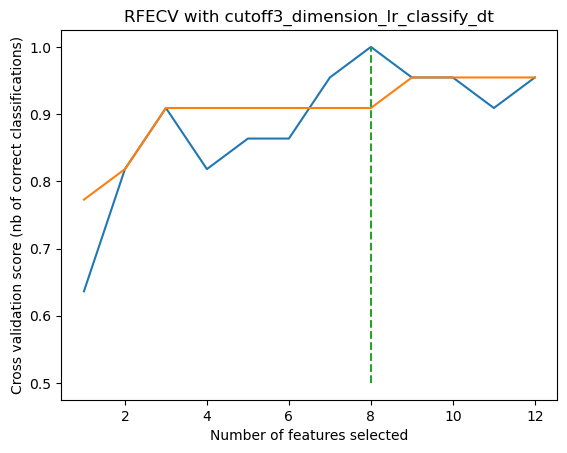

分类算法： svm
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


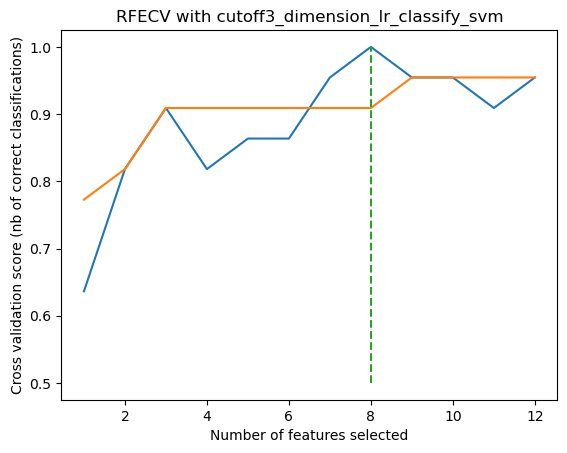

分类算法： nb
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


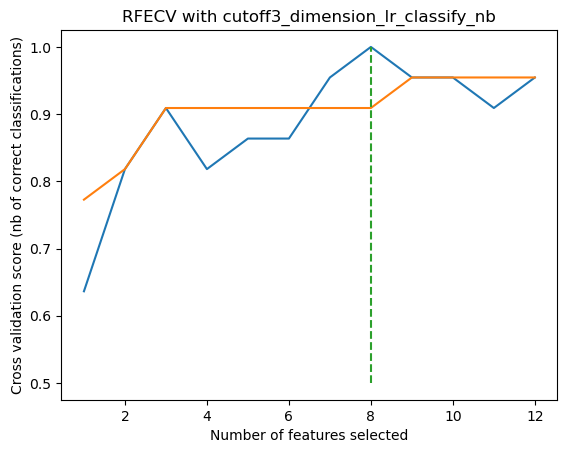

分类算法： cbc
0:	learn: 0.6541178	total: 1.92ms	remaining: 7.66ms
1:	learn: 0.6212759	total: 3.05ms	remaining: 4.58ms
2:	learn: 0.5936289	total: 3.51ms	remaining: 2.34ms
3:	learn: 0.5648703	total: 4.17ms	remaining: 1.04ms
4:	learn: 0.5446017	total: 4.83ms	remaining: 0us
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


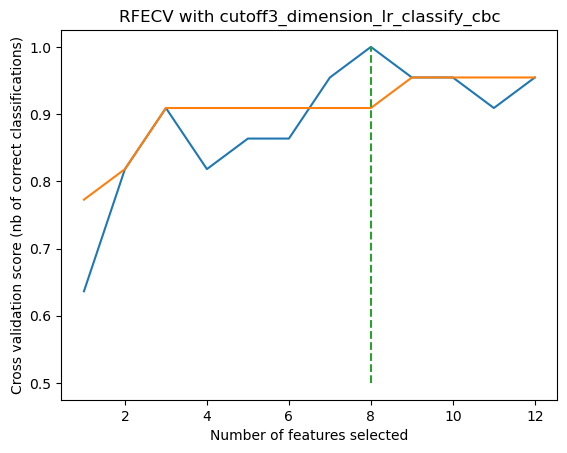

分类算法： bag


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 4
accuracy 0.9666666666666667


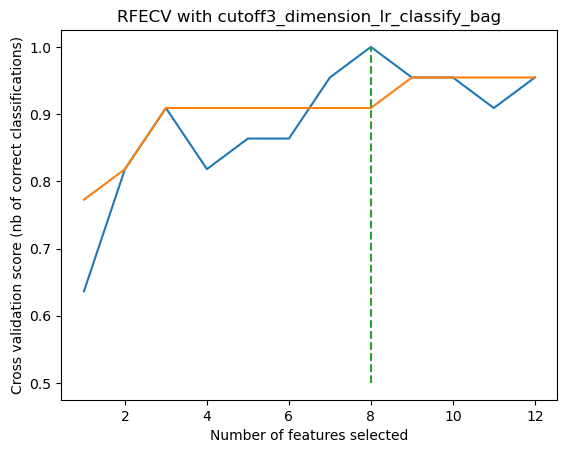

分类算法： cv
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


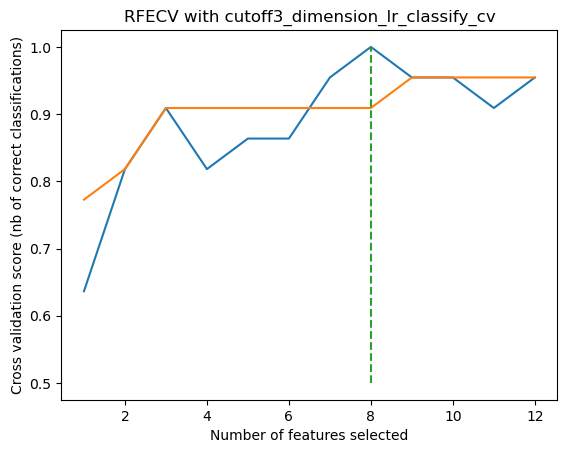

降维算法： rf


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\feature_selection\_rfe.py:296: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X[:, features], y, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\feature_selection\_rfe.py:296: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X[:, features], y, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\feature_selection\_rfe.py:296: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X[:, features], y, **fit_params)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\feature_selection\_rfe.py:296: DataConversionWarning: A column-vector y was passed when a 1

Optimal number of features : 9
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFGGNTEAFF_TRBV12_TRBJ1-1',
       'CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGGGYTF_TRBV12_TRBJ1-2',
       'CASSQGYEQYF_TRBV3_TRBJ2-7', 'CASSLGGNQPQHF_TRBV12_TRBJ1-5',
       'CASSLRETQYF_TRBV12_TRBJ2-5', 'CASSLSGNTIYF_TRBV12_TRBJ1-3',
       'CASSLTGNTEAFF_TRBV12_TRBJ1-1'],
      dtype='object')
分类算法： lr
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


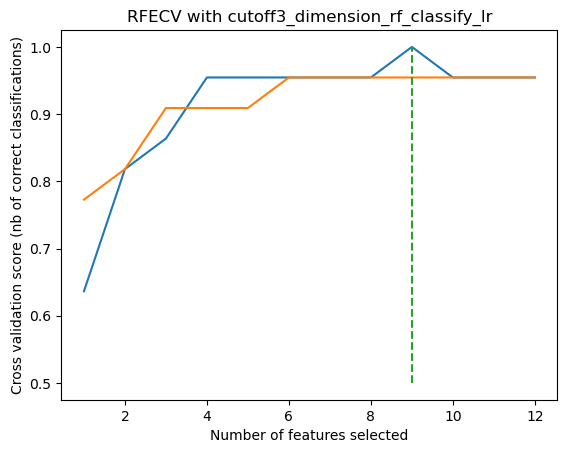

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 3
accuracy 0.9666666666666667


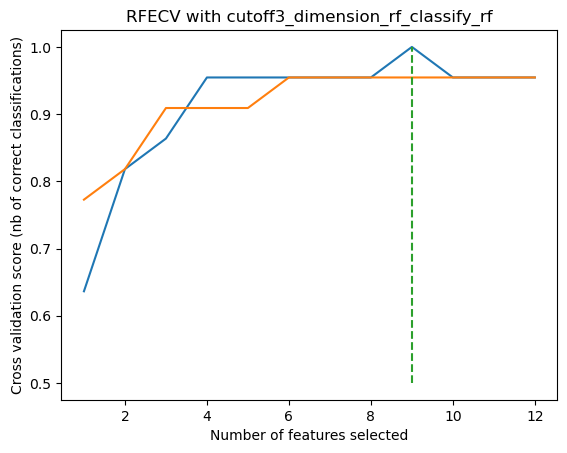

分类算法： lda
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


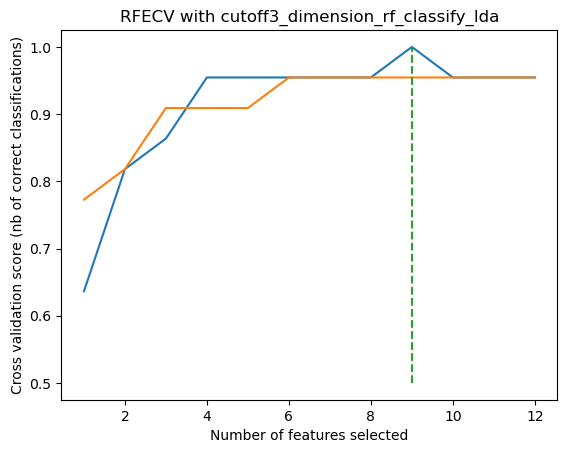

分类算法： gbdt
best_index 5
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


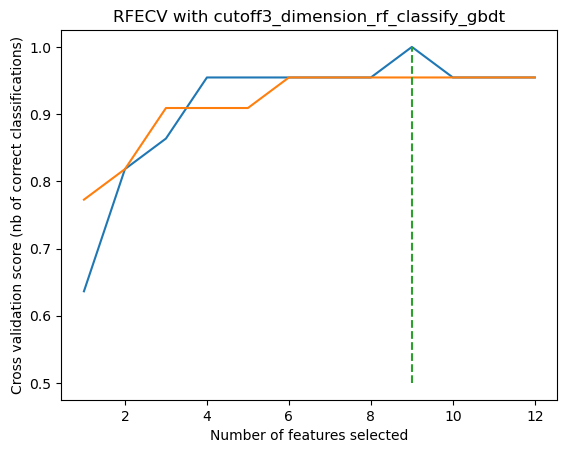

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 6
accuracy 0.9666666666666667


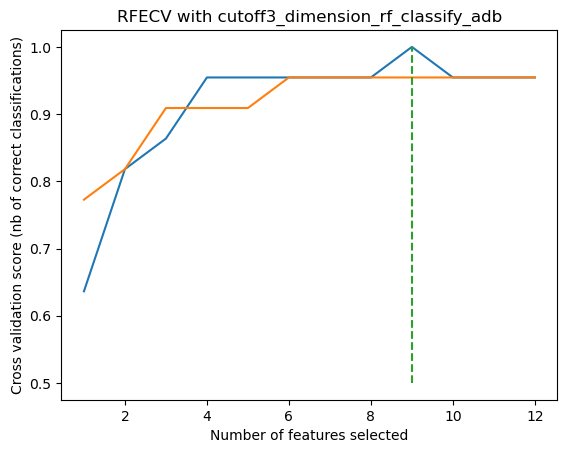

分类算法： xgb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9666666666666667


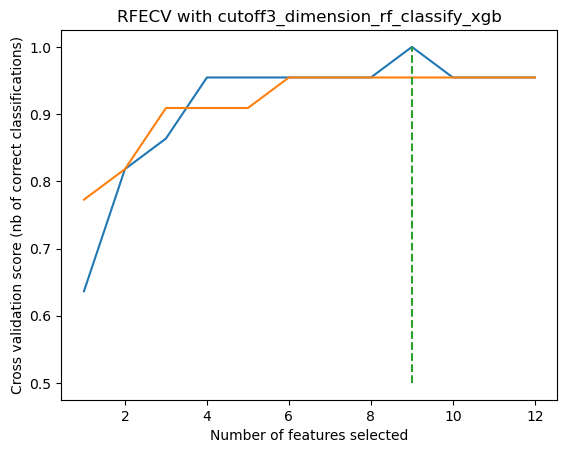

分类算法： dt
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


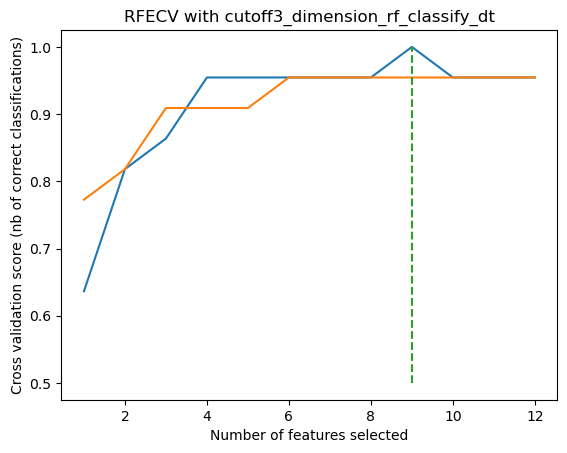

分类算法： svm
best_index 6
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


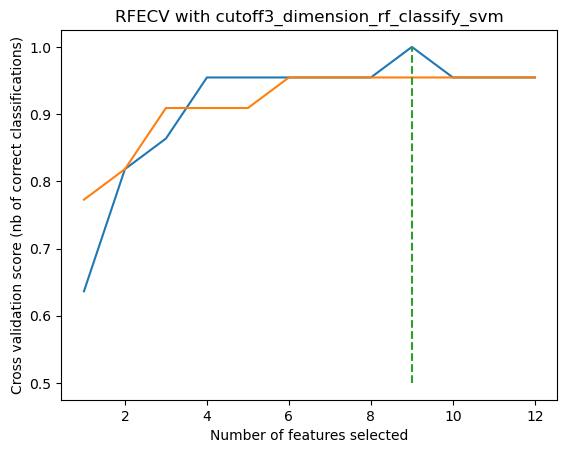

分类算法： nb
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


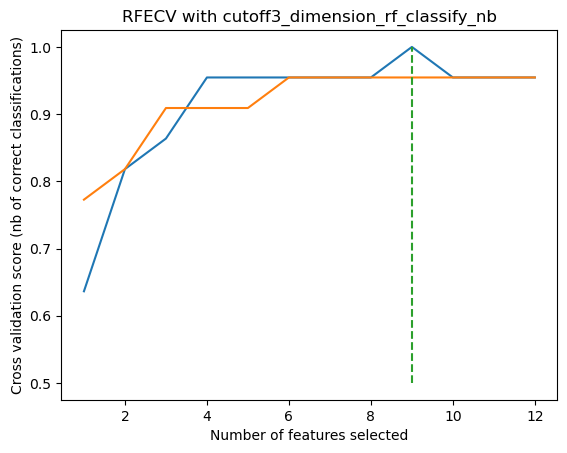

分类算法： cbc
0:	learn: 0.6621213	total: 587us	remaining: 2.35ms
1:	learn: 0.6308169	total: 1.12ms	remaining: 1.68ms
2:	learn: 0.6092339	total: 1.51ms	remaining: 1ms
3:	learn: 0.5828350	total: 2.02ms	remaining: 504us
4:	learn: 0.5535817	total: 2.69ms	remaining: 0us
best_index 3
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


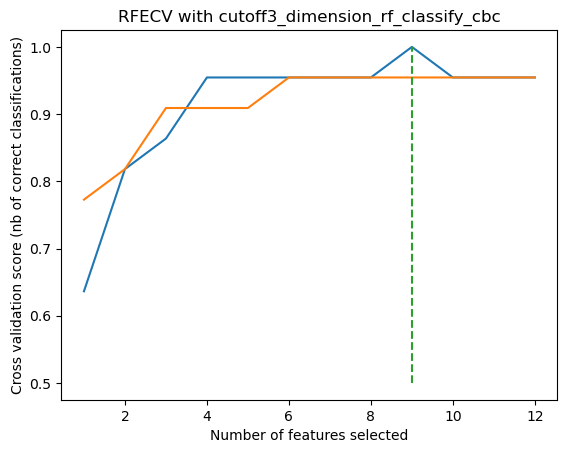

分类算法： bag
best_index 3
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


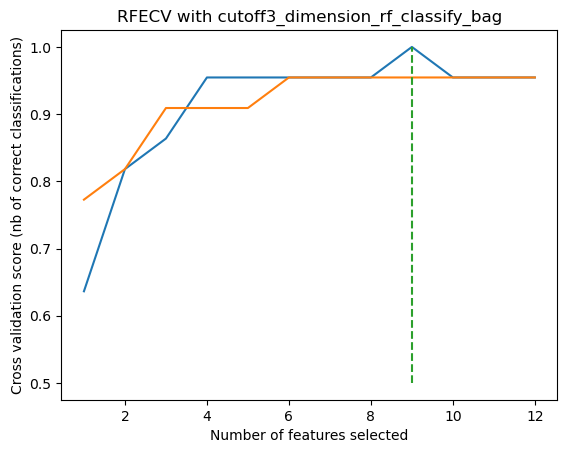

分类算法： cv
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


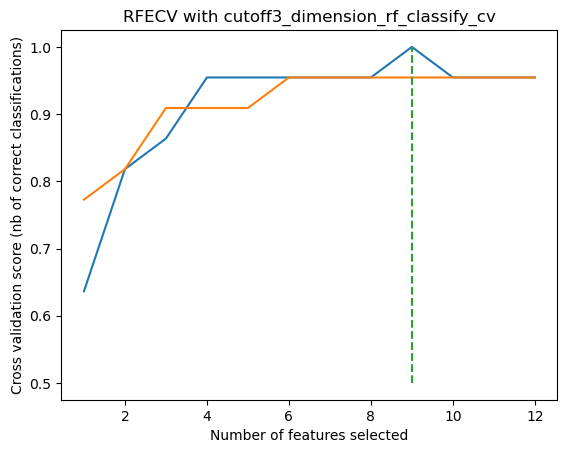

降维算法： lda
Optimal number of features : 6
Best performing dimensions: Index(['CASSFGGNTEAFF_TRBV12_TRBJ1-1', 'CASSLQETQYF_TRBV12_TRBJ2-5',
       'CASSLRETQYF_TRBV12_TRBJ2-5', 'CASSLSGNTIYF_TRBV12_TRBJ1-3',
       'CASSLTGNTEAFF_TRBV12_TRBJ1-1', 'CASSFSGNTIYF_TRBV12_TRBJ1-3'],
      dtype='object')
分类算法： lr
best_index 4
accuracy 0.9


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

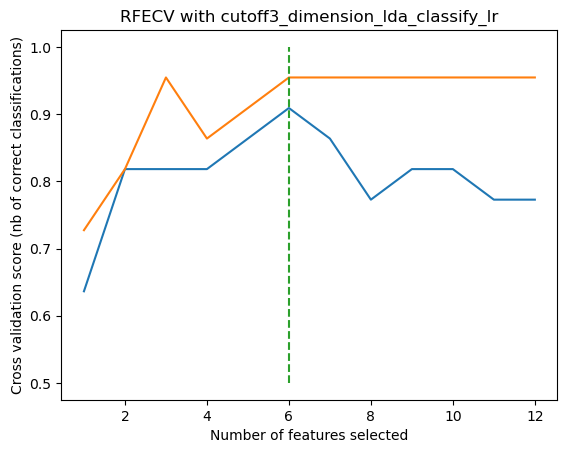

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 4
accuracy 0.9


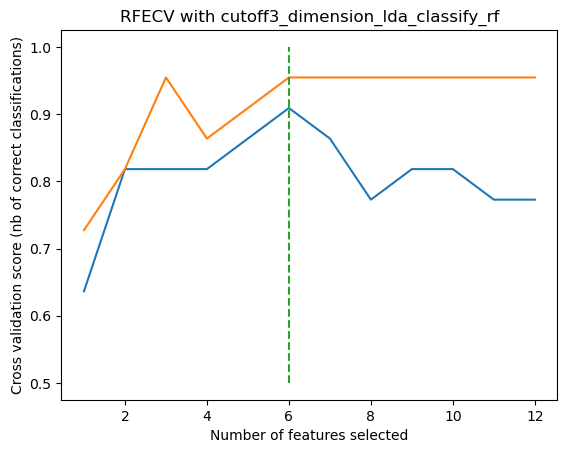

分类算法： lda
best_index 4
accuracy 0.9


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


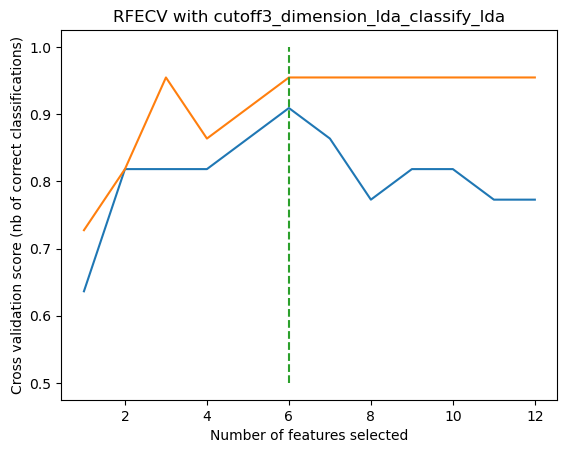

分类算法： gbdt
best_index 3
accuracy 0.9


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


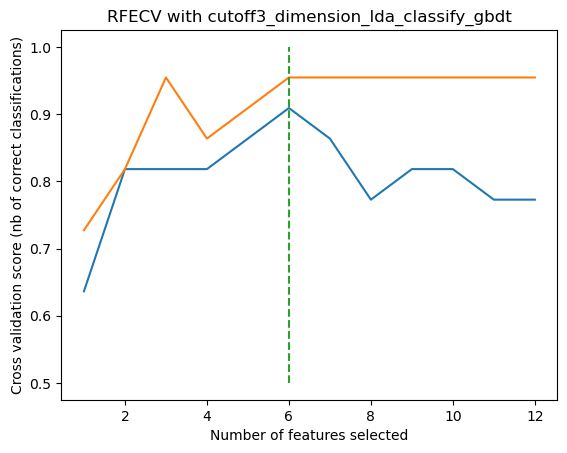

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 5
accuracy 0.9


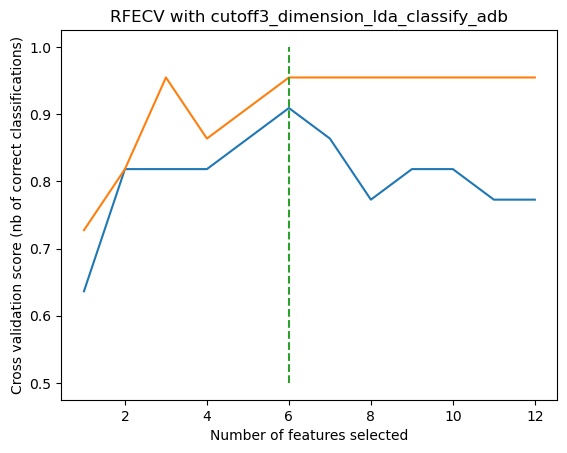

分类算法： xgb
best_index 4
accuracy 0.9


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


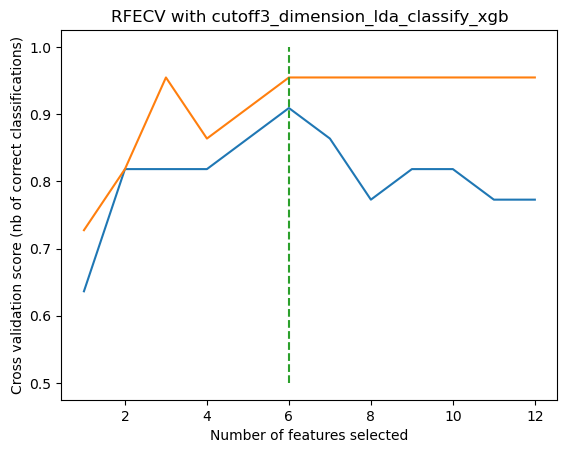

分类算法： dt
best_index 1
accuracy 0.9


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


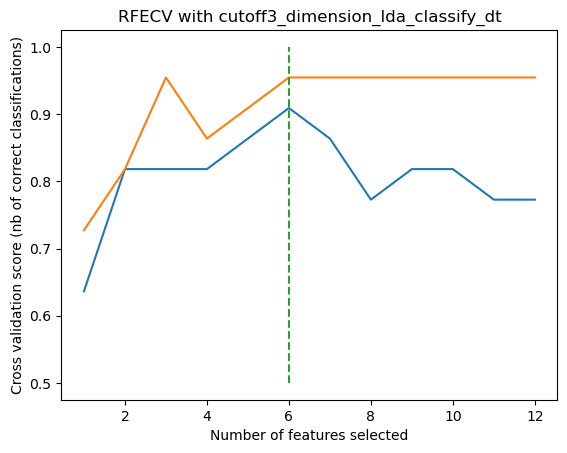

分类算法： svm
best_index 4
accuracy 0.9


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


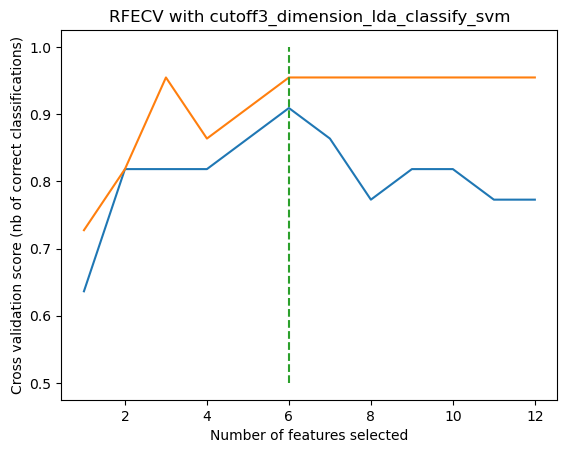

分类算法： nb
best_index 1
accuracy 0.9


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


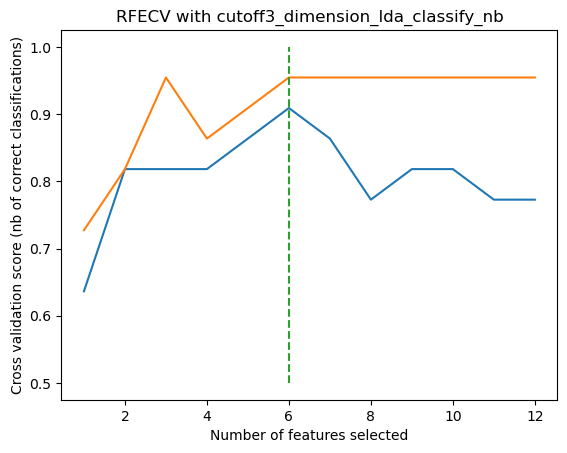

分类算法： cbc
0:	learn: 0.6582991	total: 425us	remaining: 1.7ms
1:	learn: 0.6297790	total: 757us	remaining: 1.14ms
2:	learn: 0.5989573	total: 1.27ms	remaining: 847us
3:	learn: 0.5641410	total: 1.56ms	remaining: 389us
4:	learn: 0.5400754	total: 1.91ms	remaining: 0us
best_index 3
accuracy 0.9


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


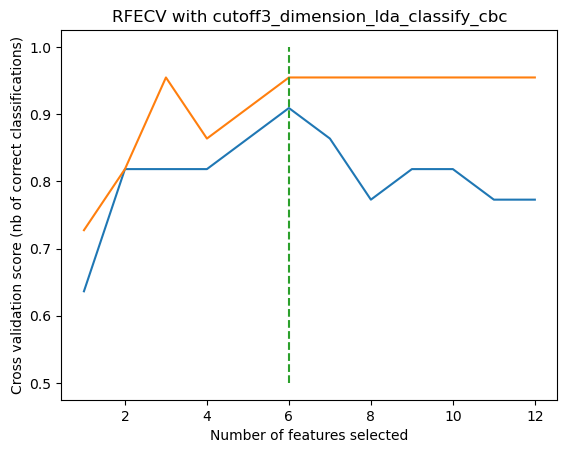

分类算法： bag


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 3
accuracy 0.9


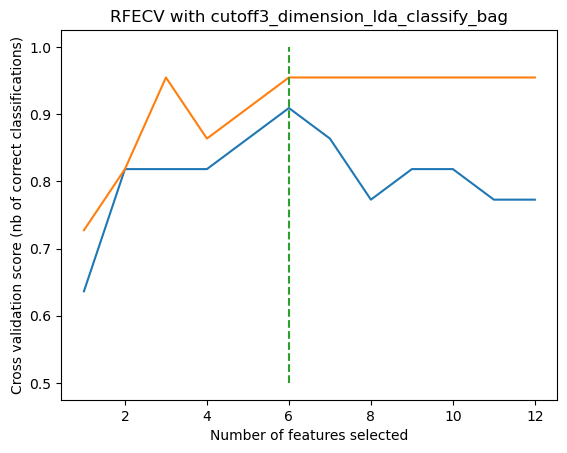

分类算法： cv
best_index 1
accuracy 0.9


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


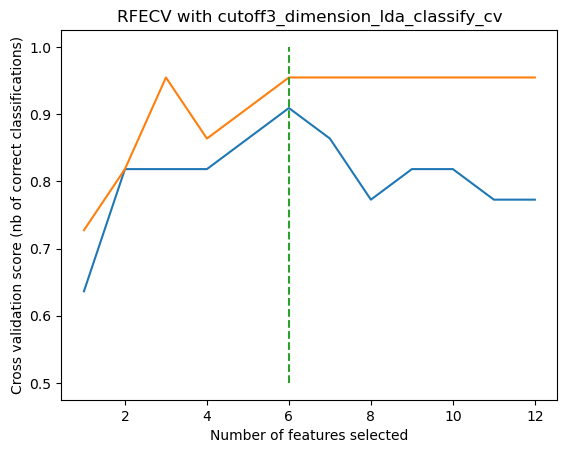

降维算法： gbdt


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example usin

Optimal number of features : 3
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSLRETQYF_TRBV12_TRBJ2-5',
       'CASSLSGNTIYF_TRBV12_TRBJ1-3'],
      dtype='object')
分类算法： lr
best_index 3
accuracy 0.9333333333333333


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


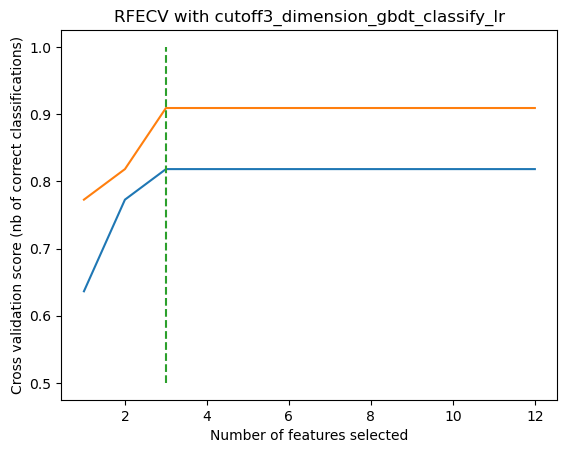

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 1
accuracy 0.9333333333333333


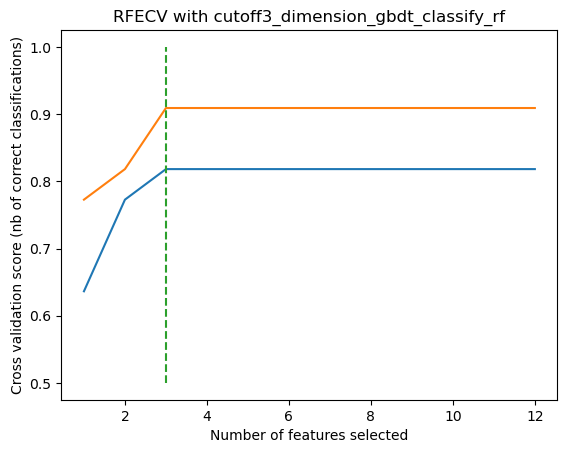

分类算法： lda
best_index 3
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


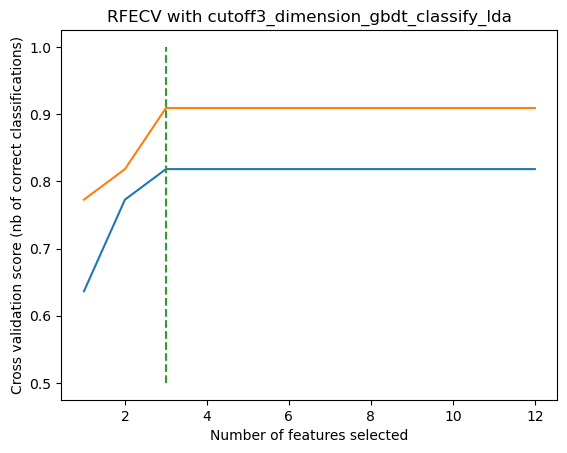

分类算法： gbdt
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


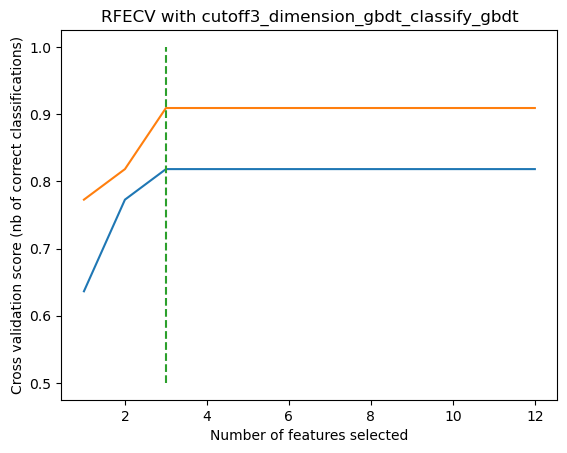

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 3
accuracy 0.9333333333333333


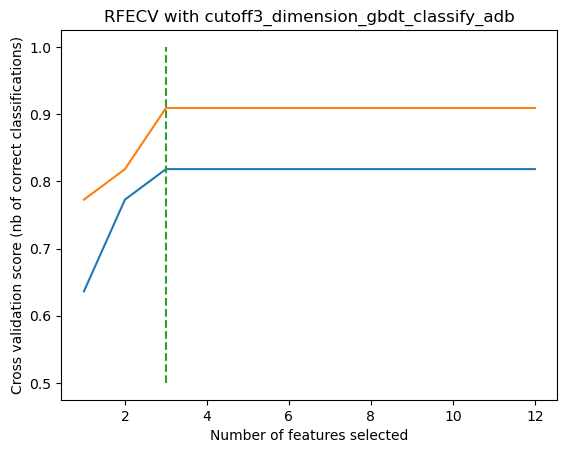

分类算法： xgb
best_index 3
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


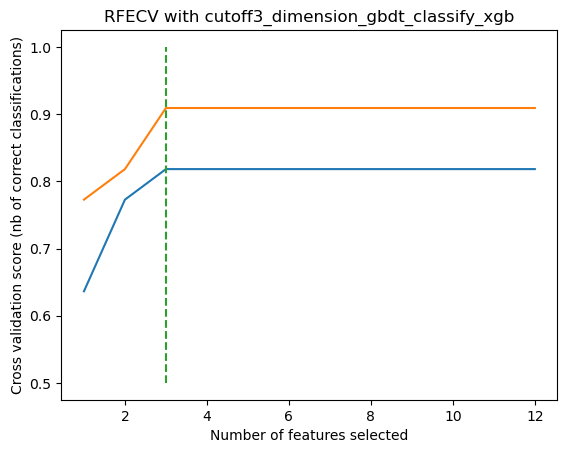

分类算法： dt
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


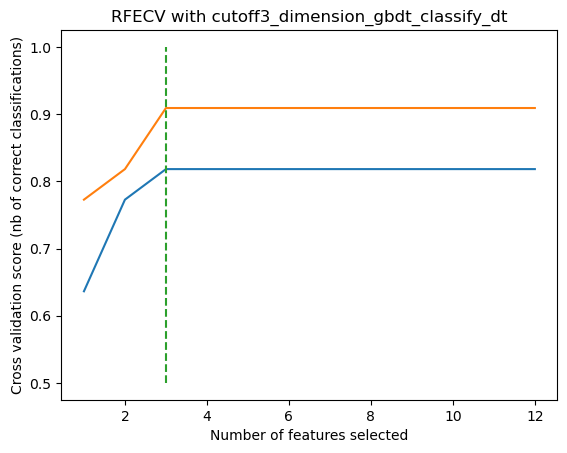

分类算法： svm
best_index 3
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


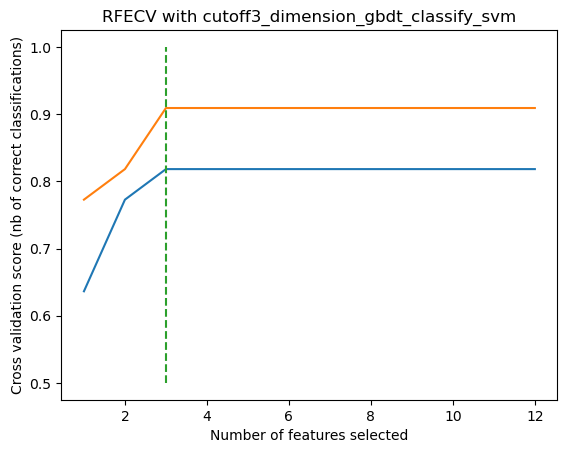

分类算法： nb
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


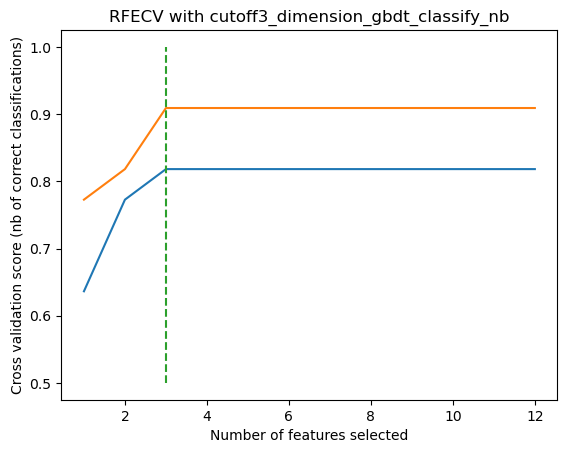

分类算法： cbc
0:	learn: 0.6669410	total: 306us	remaining: 1.22ms
1:	learn: 0.6395969	total: 542us	remaining: 813us
2:	learn: 0.6288811	total: 728us	remaining: 485us
3:	learn: 0.6046964	total: 945us	remaining: 236us
4:	learn: 0.5829055	total: 1.16ms	remaining: 0us
best_index 4
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


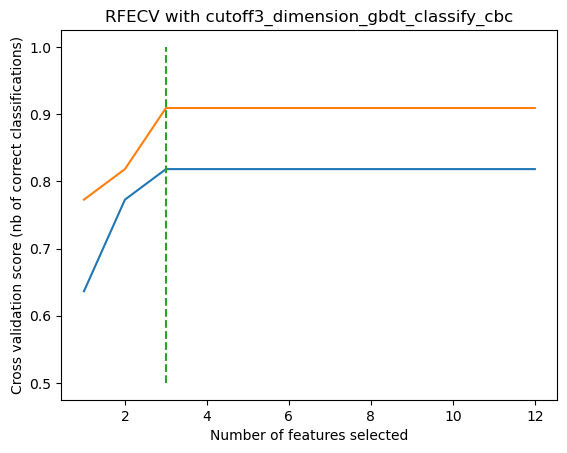

分类算法： bag
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


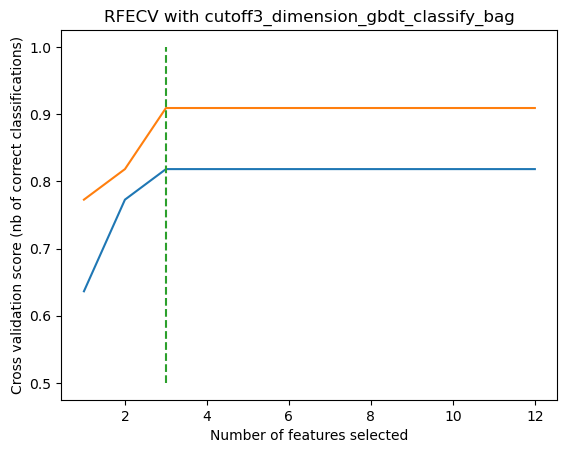

分类算法： cv
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


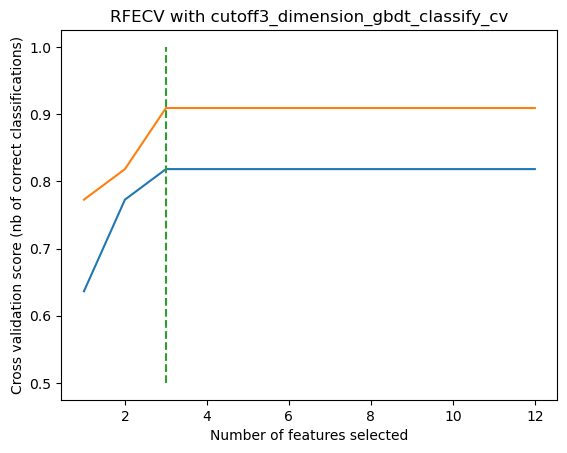

降维算法： adb


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

Optimal number of features : 5
Best performing dimensions: Index(['CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGETQYF_TRBV12_TRBJ2-5',
       'CASSLGGNQPQHF_TRBV12_TRBJ1-5', 'CASSLRETQYF_TRBV12_TRBJ2-5',
       'CASSLSGNTIYF_TRBV12_TRBJ1-3'],
      dtype='object')
分类算法： lr
best_index 6
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


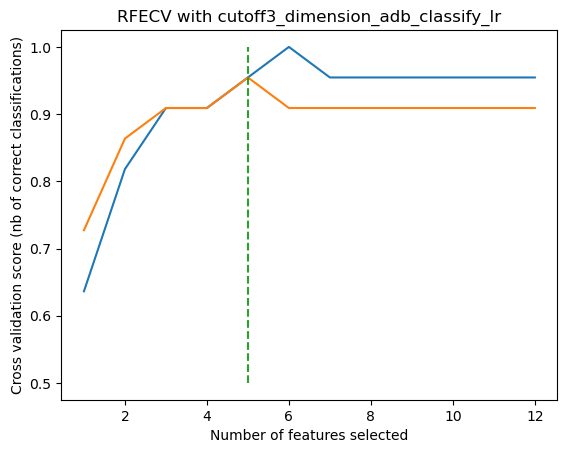

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 5
accuracy 0.9666666666666667


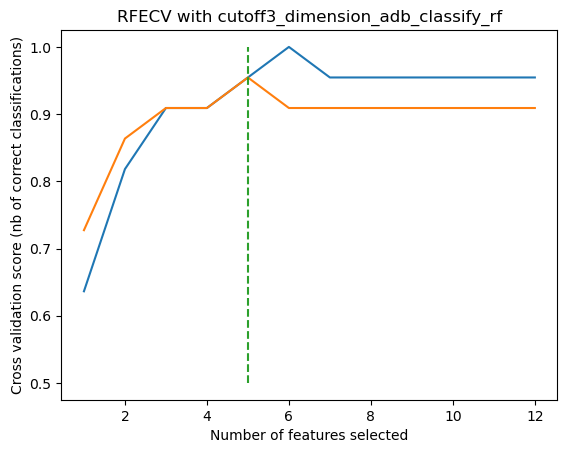

分类算法： lda
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


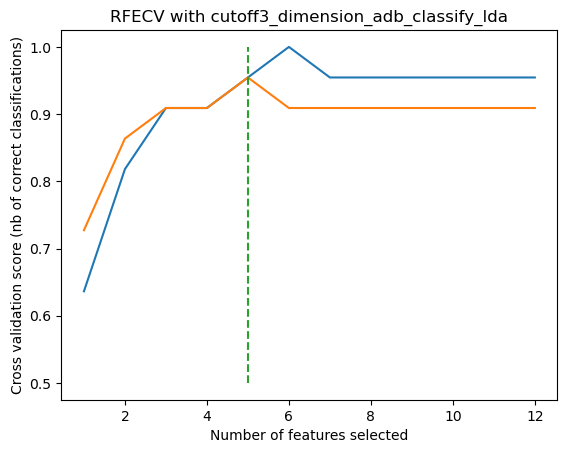

分类算法： gbdt
best_index 4
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


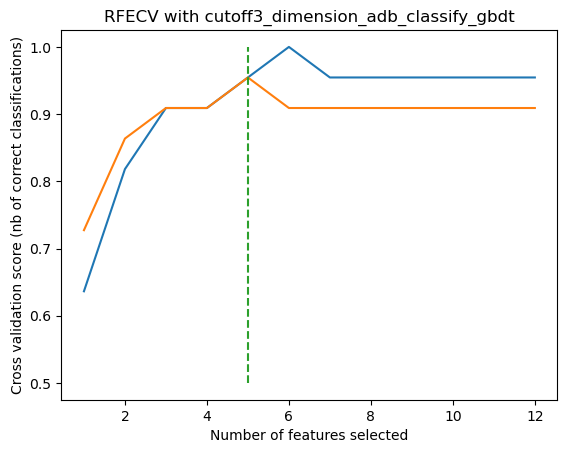

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 4
accuracy 0.9333333333333333


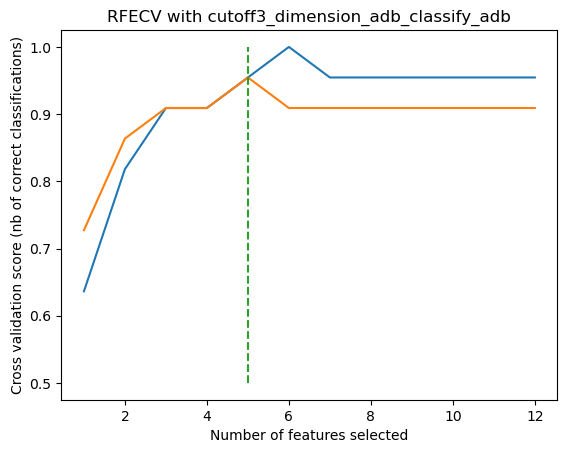

分类算法： xgb
best_index 4
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


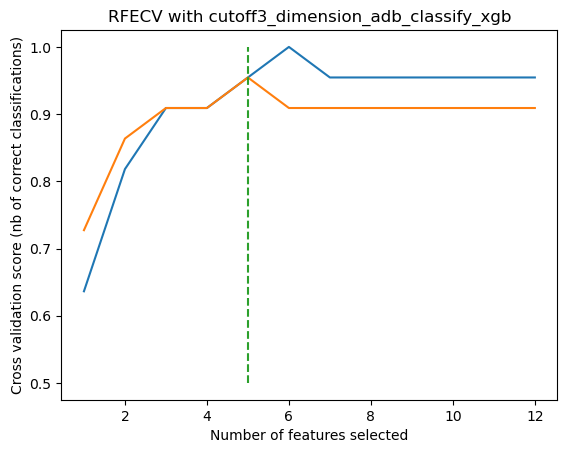

分类算法： dt
best_index 1
accuracy 0.9


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


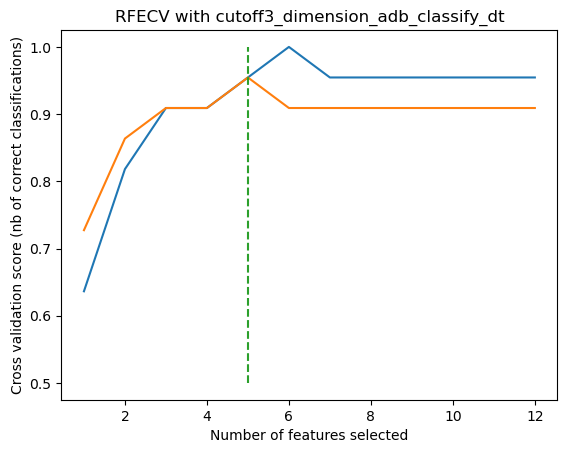

分类算法： svm
best_index 5
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


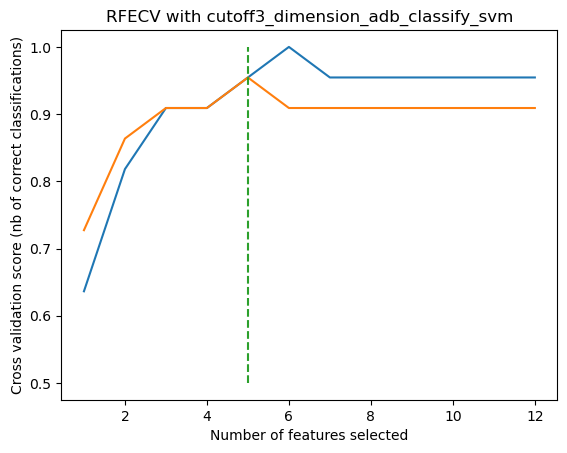

分类算法： nb
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


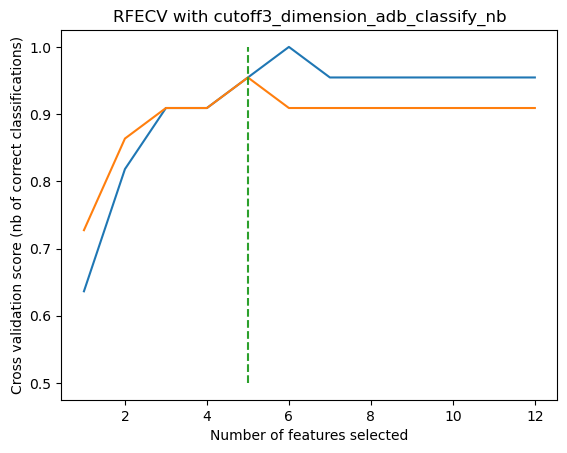

分类算法： cbc
0:	learn: 0.6710915	total: 238us	remaining: 953us
1:	learn: 0.6387611	total: 444us	remaining: 666us
2:	learn: 0.6131499	total: 604us	remaining: 402us
3:	learn: 0.5767017	total: 798us	remaining: 199us
4:	learn: 0.5637320	total: 953us	remaining: 0us
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


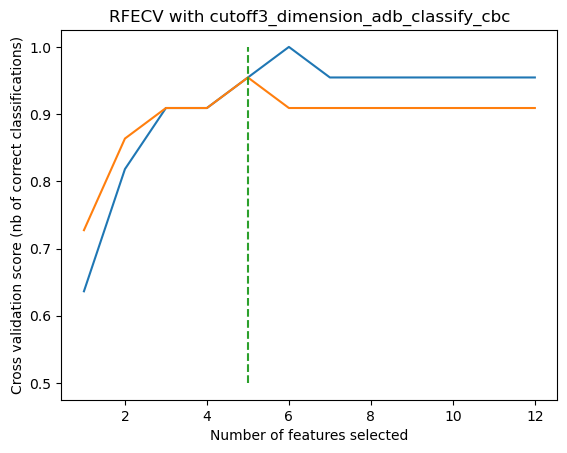

分类算法： bag
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


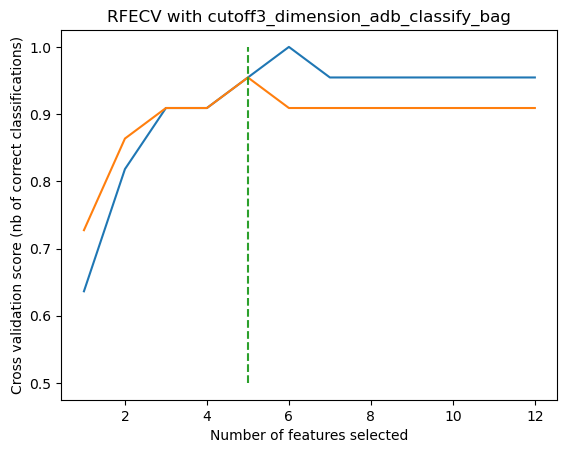

分类算法： cv
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


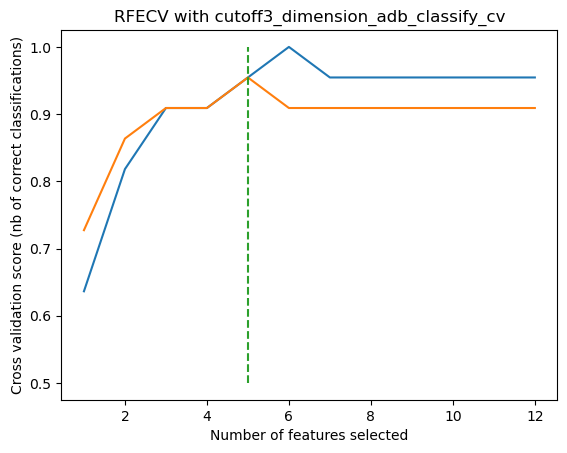

降维算法： xgb
Optimal number of features : 5
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSLQETQYF_TRBV12_TRBJ2-5',
       'CASSLGGGYTF_TRBV12_TRBJ1-2', 'CASSLRETQYF_TRBV12_TRBJ2-5',
       'CASSLSGNTIYF_TRBV12_TRBJ1-3'],
      dtype='object')
分类算法： lr
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


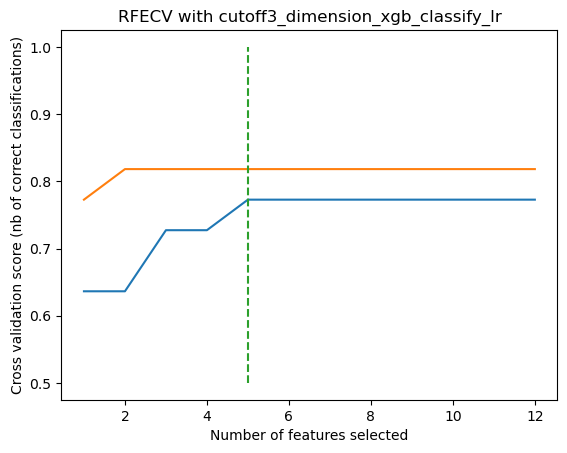

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 3
accuracy 0.9666666666666667


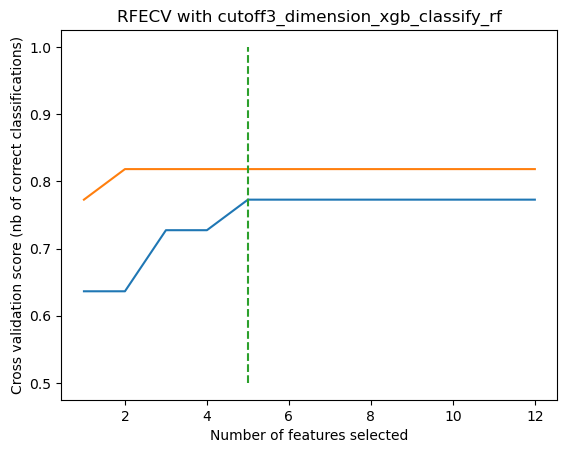

分类算法： lda
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


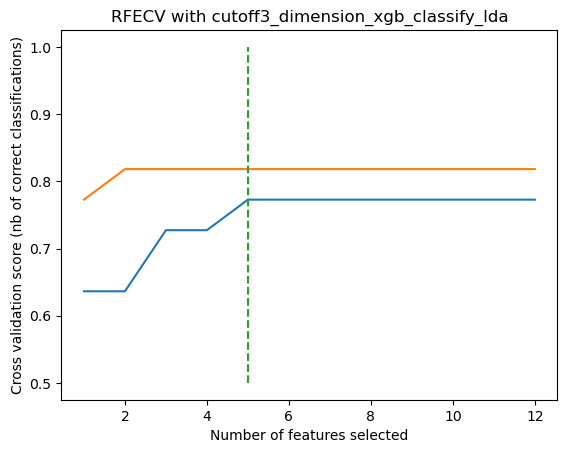

分类算法： gbdt
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


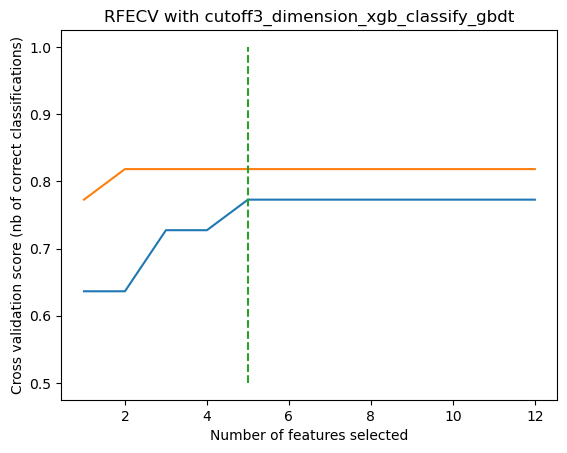

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 6
accuracy 0.9666666666666667


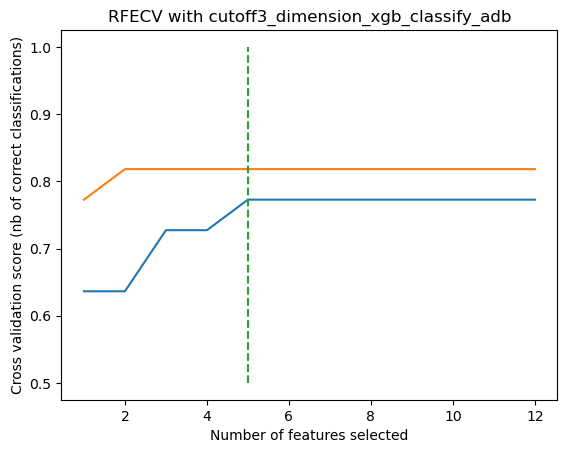

分类算法： xgb
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


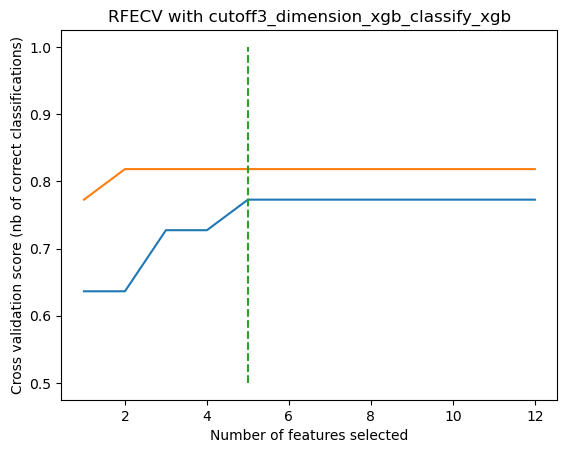

分类算法： dt
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


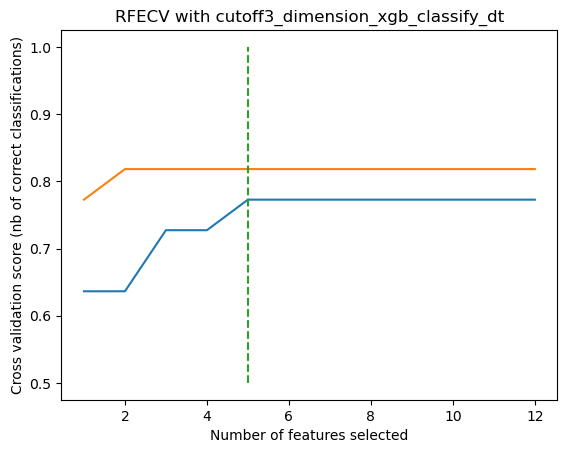

分类算法： svm
best_index 7
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


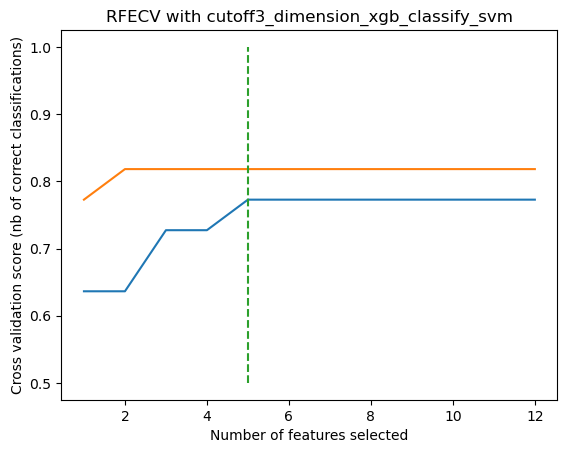

分类算法： nb
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


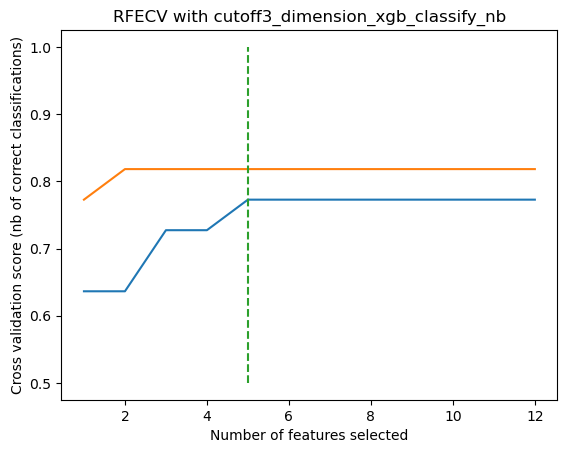

分类算法： cbc
0:	learn: 0.6633401	total: 291us	remaining: 1.17ms
1:	learn: 0.6216888	total: 517us	remaining: 775us
2:	learn: 0.5981324	total: 691us	remaining: 461us
3:	learn: 0.5681699	total: 887us	remaining: 221us
4:	learn: 0.5531930	total: 1.05ms	remaining: 0us
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


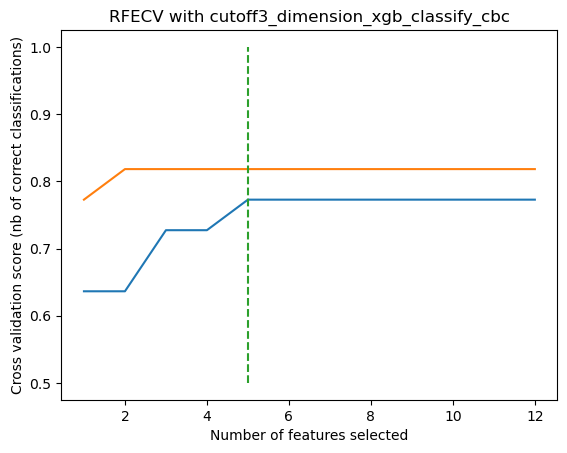

分类算法： bag
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


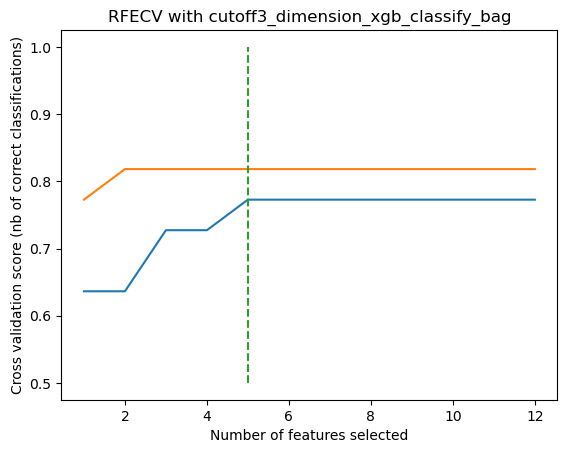

分类算法： cv
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


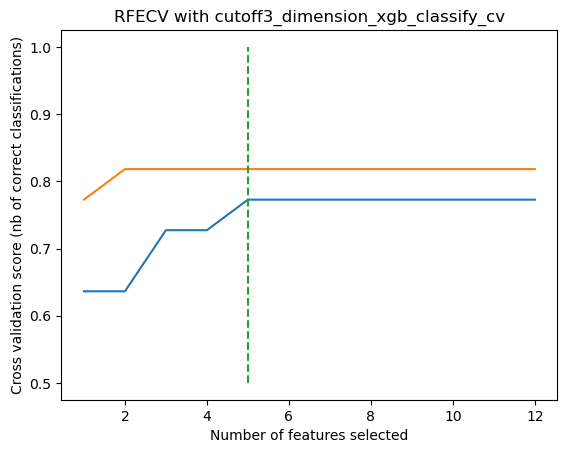

降维算法： dt
Optimal number of features : 4
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSLGGNQPQHF_TRBV12_TRBJ1-5',
       'CASSLRETQYF_TRBV12_TRBJ2-5', 'CASSLSGNTIYF_TRBV12_TRBJ1-3'],
      dtype='object')
分类算法： lr
best_index 6
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


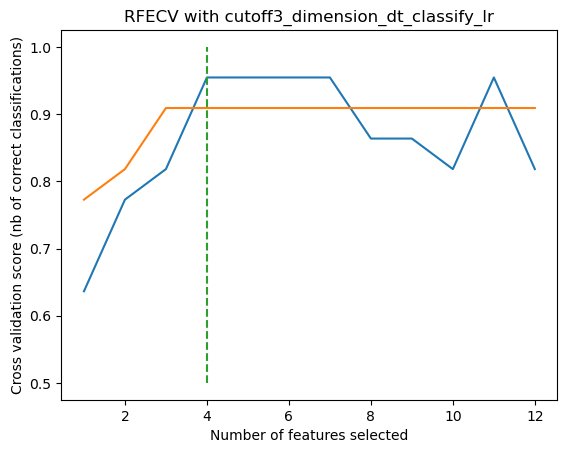

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9333333333333333


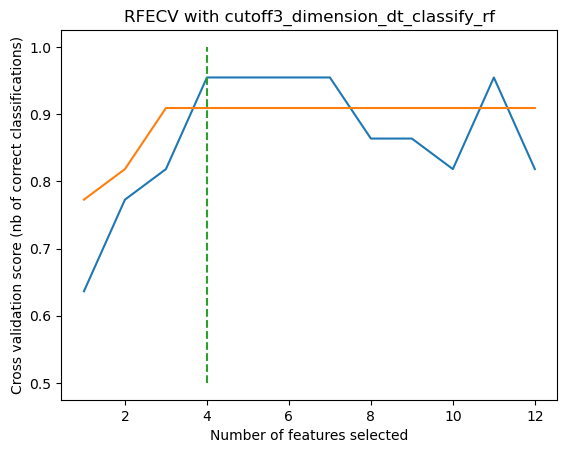

分类算法： lda
best_index 6
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


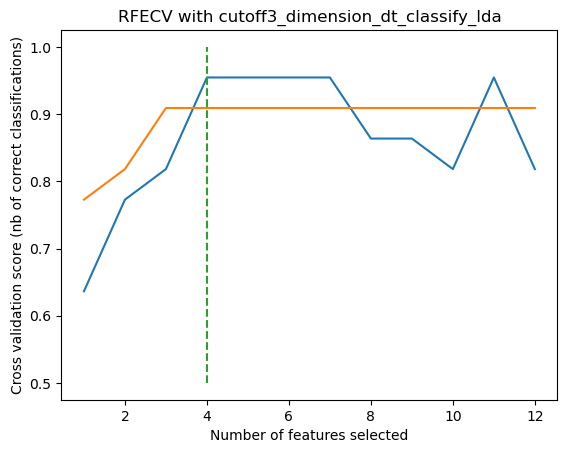

分类算法： gbdt
best_index 4
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


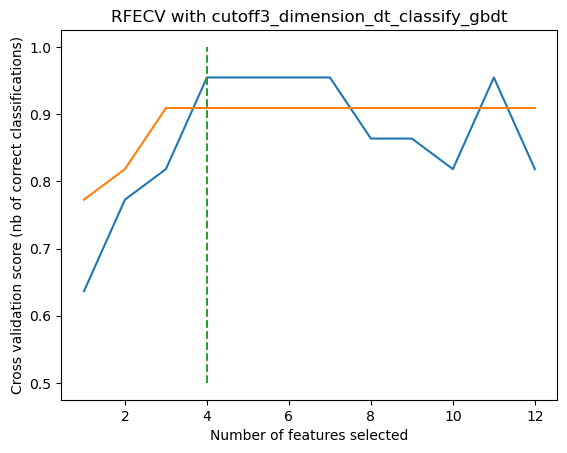

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 6
accuracy 0.9333333333333333


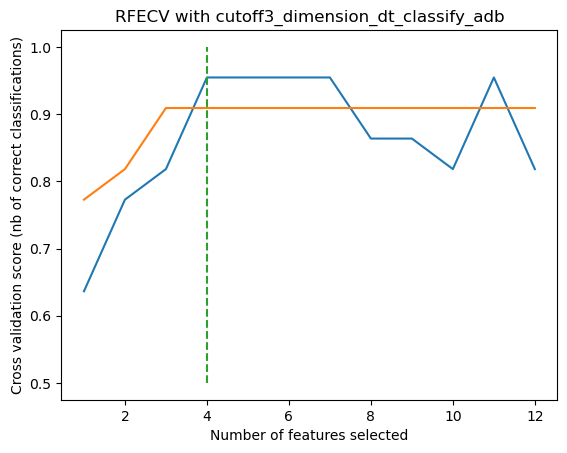

分类算法： xgb
best_index 6
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


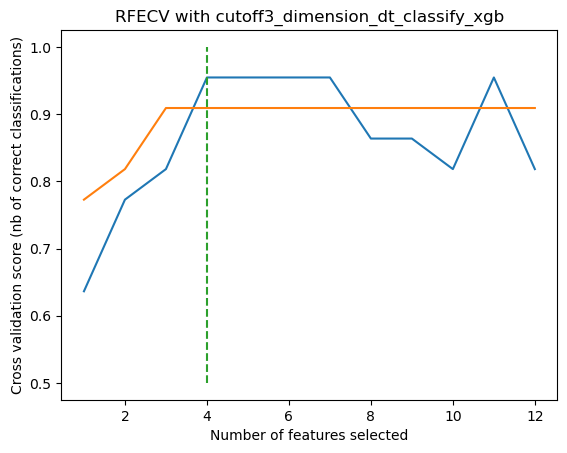

分类算法： dt
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


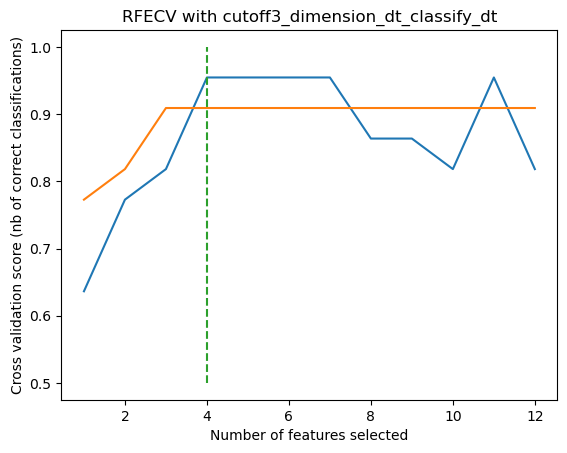

分类算法： svm
best_index 5
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


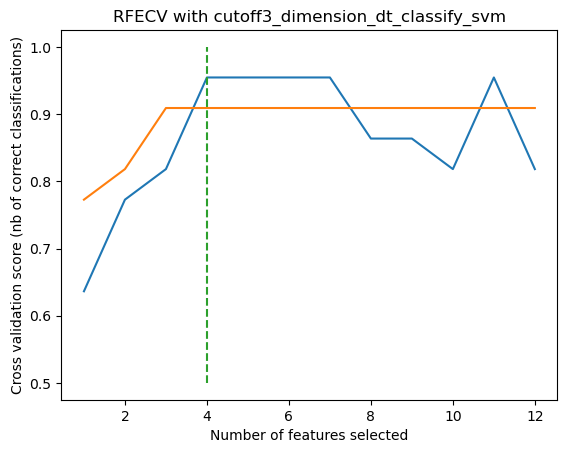

分类算法： nb
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


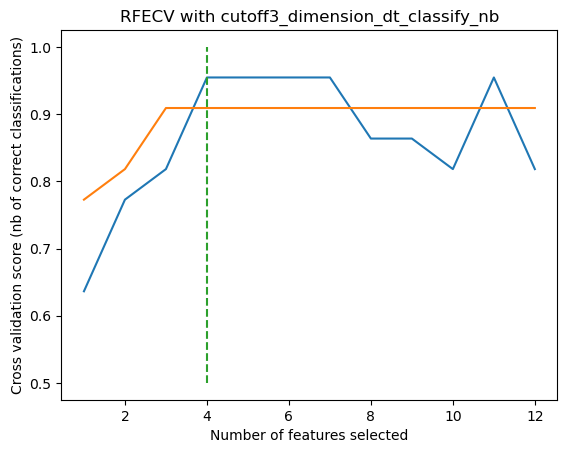

分类算法： cbc
0:	learn: 0.6642006	total: 479us	remaining: 1.92ms
1:	learn: 0.6318064	total: 1.73ms	remaining: 2.6ms
2:	learn: 0.6091030	total: 2.31ms	remaining: 1.54ms
3:	learn: 0.5906199	total: 2.56ms	remaining: 641us
4:	learn: 0.5647580	total: 2.82ms	remaining: 0us
best_index 5
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


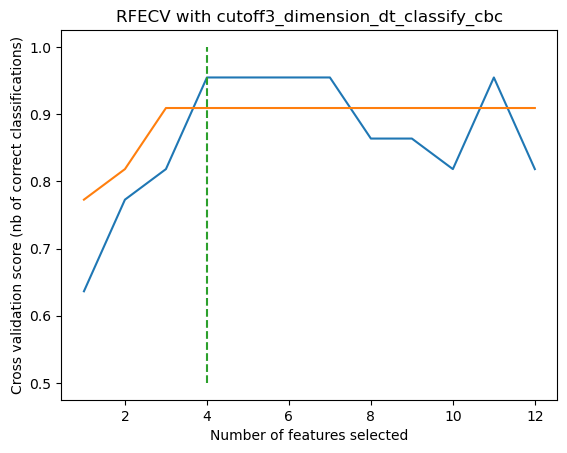

分类算法： bag
best_index 2
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


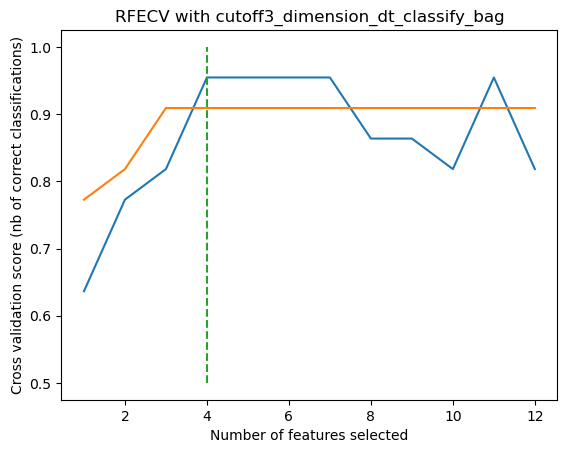

分类算法： cv
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


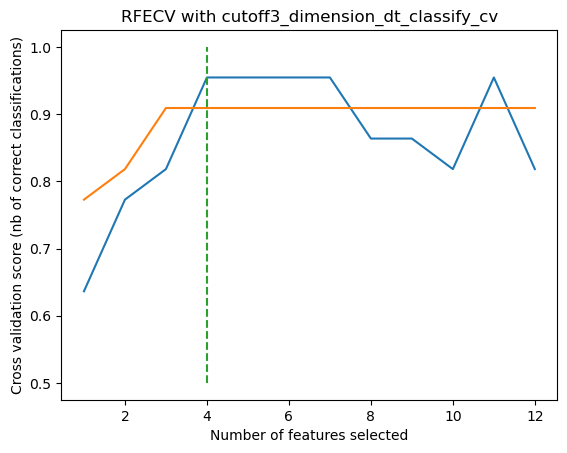

降维算法： svm
Optimal number of features : 10
Best performing dimensions: Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFGGNTEAFF_TRBV12_TRBJ1-1',
       'CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGETQYF_TRBV12_TRBJ2-5',
       'CASSLGGGYTF_TRBV12_TRBJ1-2', 'CASSLGGNQPQHF_TRBV12_TRBJ1-5',
       'CASSLRETQYF_TRBV12_TRBJ2-5', 'CASSLSGNTIYF_TRBV12_TRBJ1-3',
       'CASSLTGNTEAFF_TRBV12_TRBJ1-1', 'CASSFSGNTIYF_TRBV12_TRBJ1-3'],
      dtype='object')
分类算法： lr
best_index 2
accuracy 0.9666666666666667


C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,

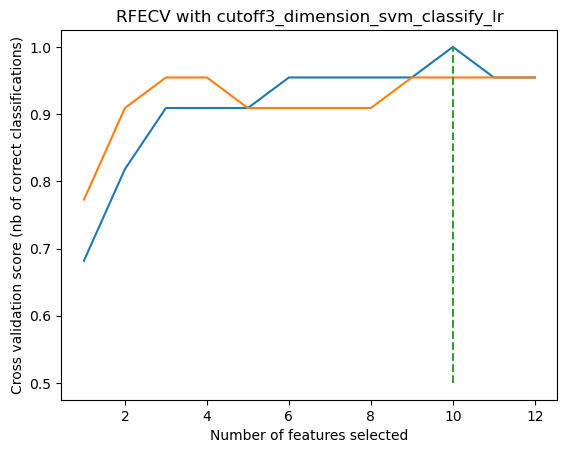

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 4
accuracy 0.9666666666666667


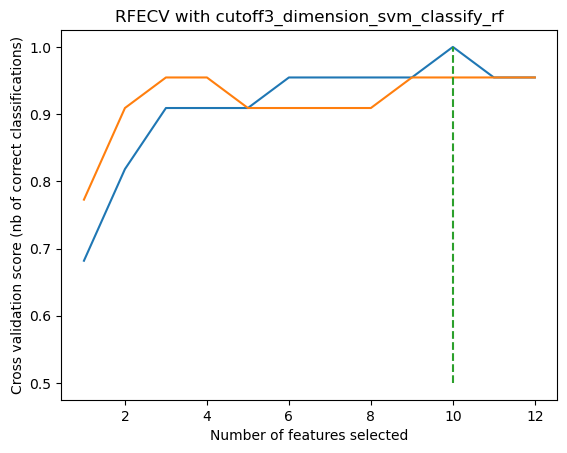

分类算法： lda
best_index 2
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


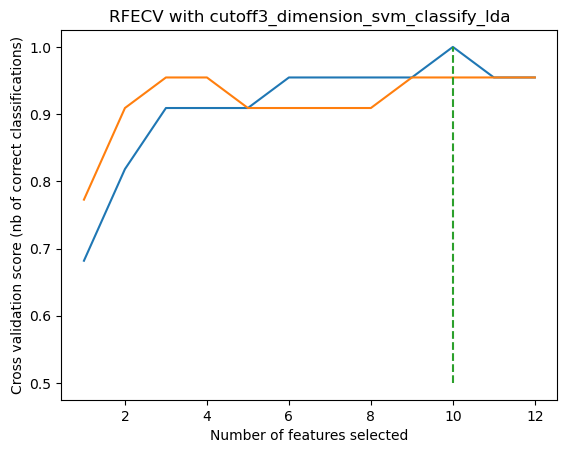

分类算法： gbdt
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


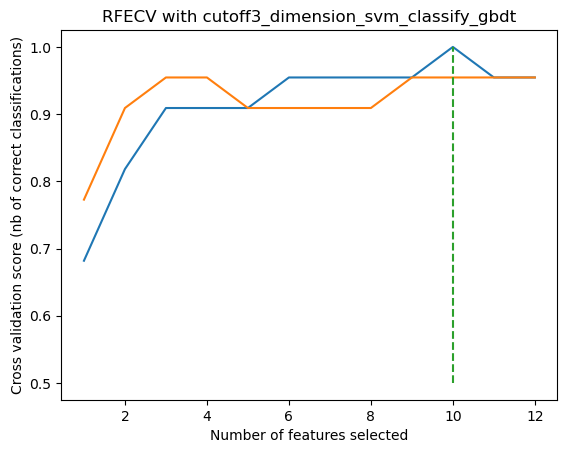

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 4
accuracy 0.9666666666666667


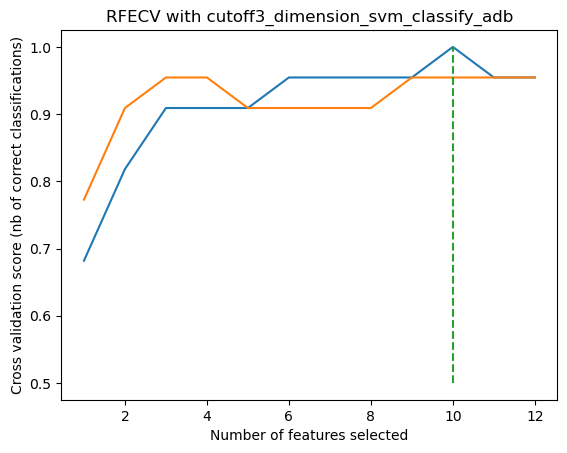

分类算法： xgb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 2
accuracy 0.9666666666666667


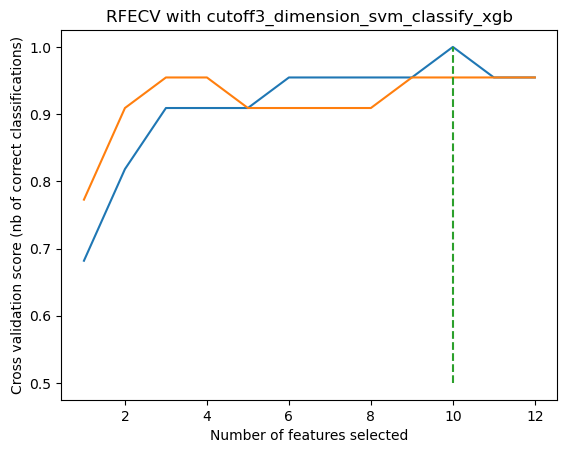

分类算法： dt
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


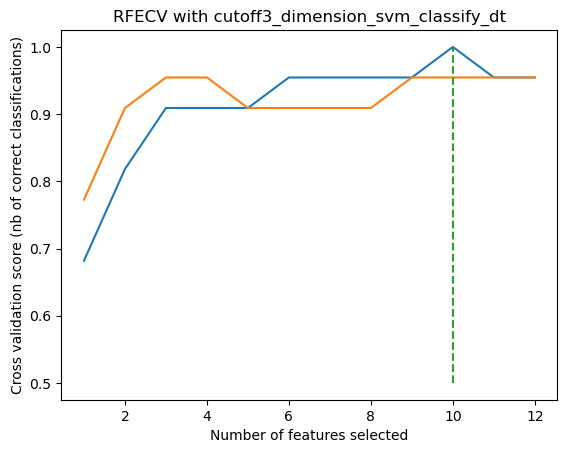

分类算法： svm
best_index 6
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


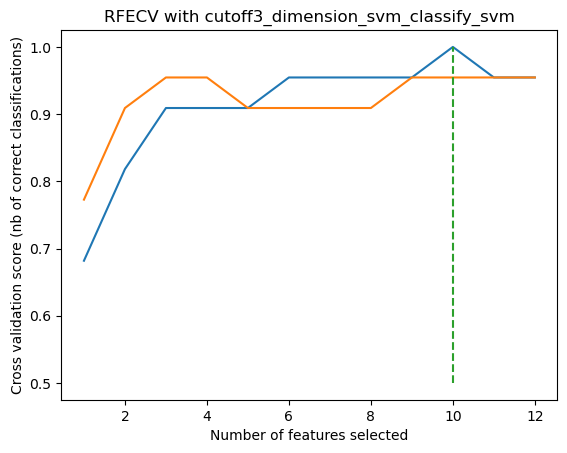

分类算法： nb
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


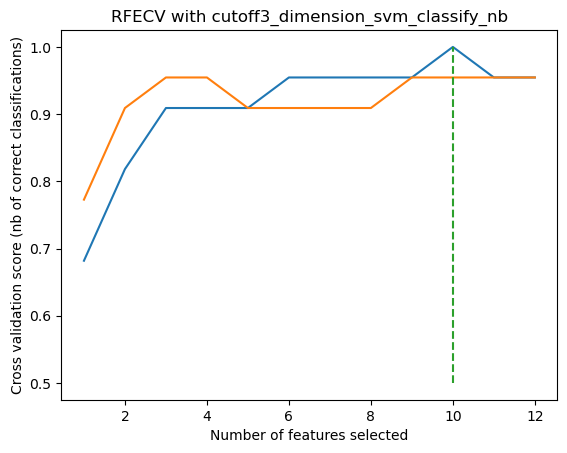

分类算法： cbc
0:	learn: 0.6573787	total: 1.04ms	remaining: 4.14ms
1:	learn: 0.6241752	total: 2.08ms	remaining: 3.12ms
2:	learn: 0.5948489	total: 2.69ms	remaining: 1.8ms
3:	learn: 0.5699342	total: 3.25ms	remaining: 812us
4:	learn: 0.5464224	total: 4.1ms	remaining: 0us
best_index 4
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


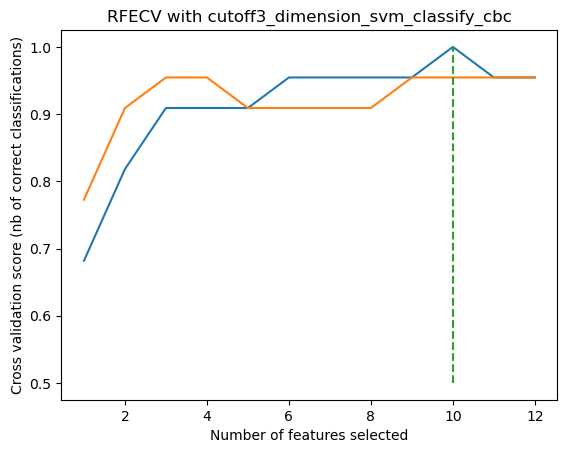

分类算法： bag
best_index 3
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


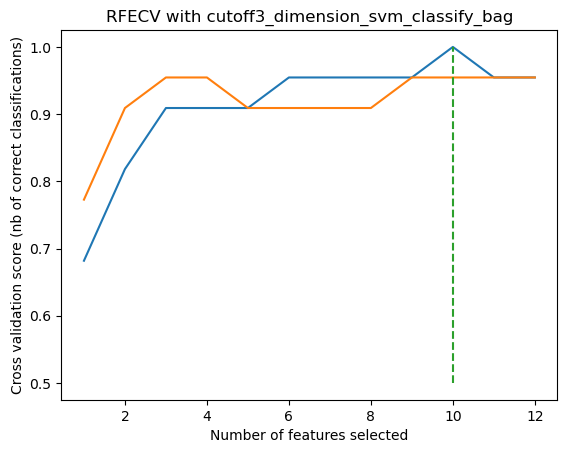

分类算法： cv
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


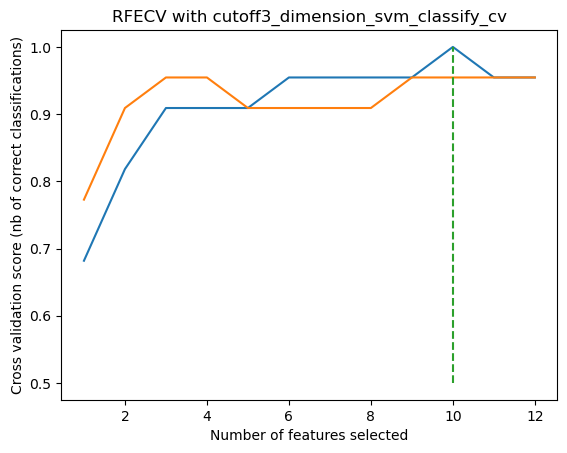

降维算法： cbc
0:	learn: 0.6699870	total: 801us	remaining: 3.21ms
1:	learn: 0.6490966	total: 1.53ms	remaining: 2.3ms
2:	learn: 0.6326572	total: 2.01ms	remaining: 1.34ms
3:	learn: 0.6209091	total: 2.51ms	remaining: 628us
4:	learn: 0.6013285	total: 3.26ms	remaining: 0us
0:	learn: 0.6683333	total: 7.15ms	remaining: 28.6ms
1:	learn: 0.6415118	total: 8.04ms	remaining: 12.1ms
2:	learn: 0.6183133	total: 9.19ms	remaining: 6.13ms
3:	learn: 0.5975744	total: 10.1ms	remaining: 2.52ms
4:	learn: 0.5813546	total: 11.4ms	remaining: 0us
0:	learn: 0.6659446	total: 994us	remaining: 3.98ms
1:	learn: 0.6453047	total: 2.2ms	remaining: 3.31ms
2:	learn: 0.6319297	total: 2.93ms	remaining: 1.95ms
3:	learn: 0.6080615	total: 4.01ms	remaining: 1ms
4:	learn: 0.5891509	total: 5.32ms	remaining: 0us
0:	learn: 0.6614535	total: 540us	remaining: 2.16ms
1:	learn: 0.6478989	total: 1.95ms	remaining: 2.93ms
2:	learn: 0.6282441	total: 2.34ms	remaining: 1.56ms
3:	learn: 0.6012280	total: 3.04ms	remaining: 760us
4:	learn: 0.5844728	t

C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 4
accuracy 0.9333333333333333


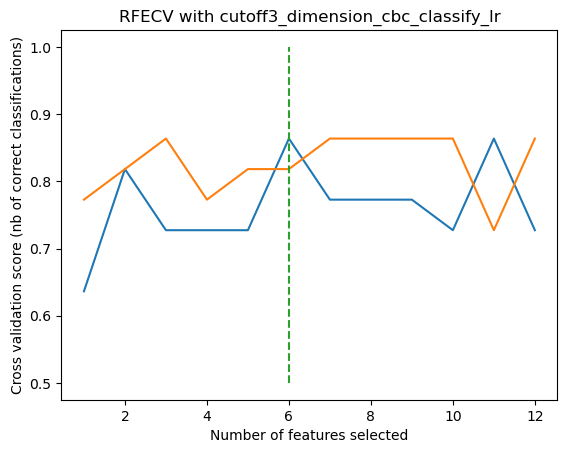

分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 4
accuracy 0.9333333333333333


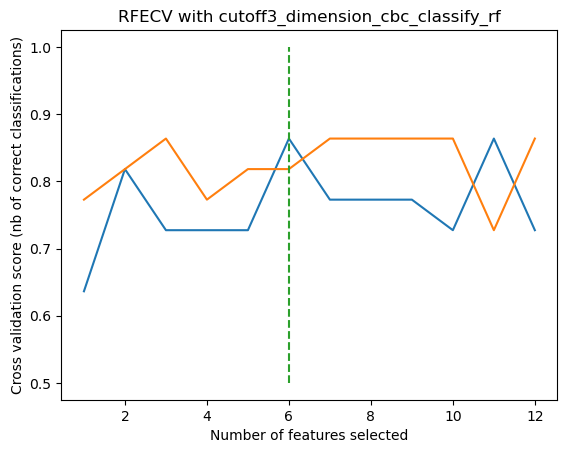

分类算法： lda
best_index 4
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


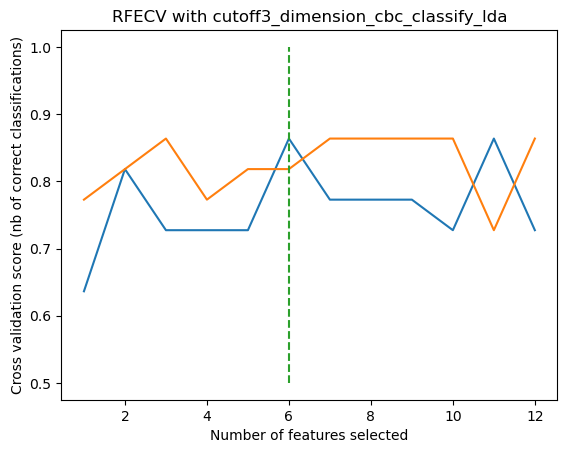

分类算法： gbdt
best_index 6
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


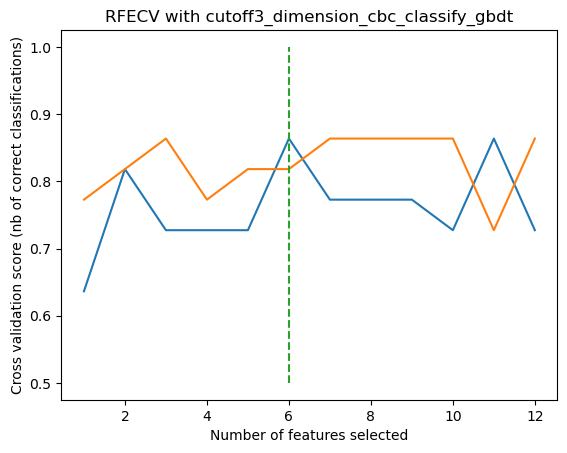

分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 5
accuracy 0.9


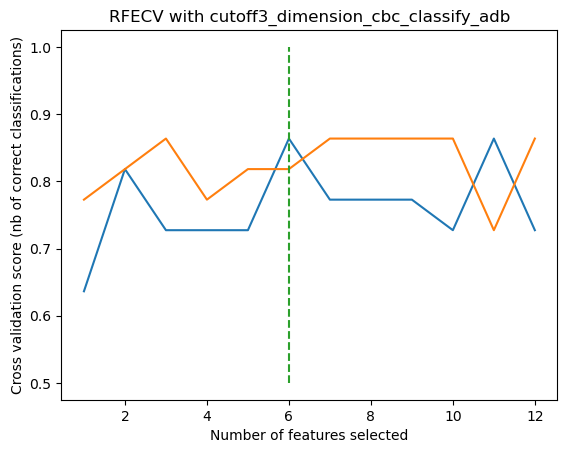

分类算法： xgb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


best_index 4
accuracy 0.9333333333333333


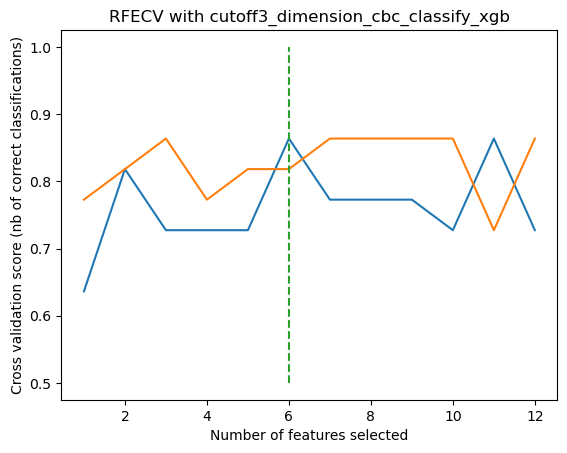

分类算法： dt
best_index 1
accuracy 0.9


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


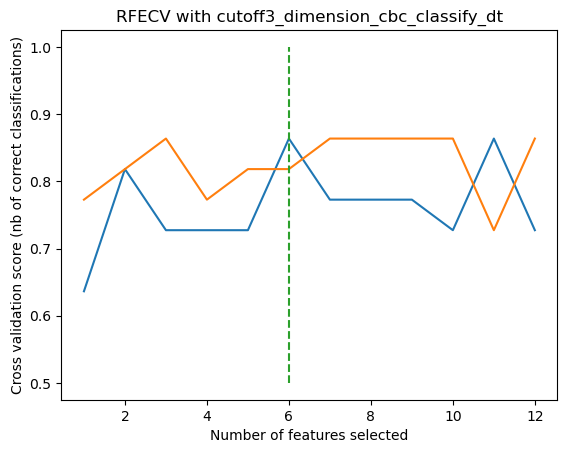

分类算法： svm
best_index 6
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


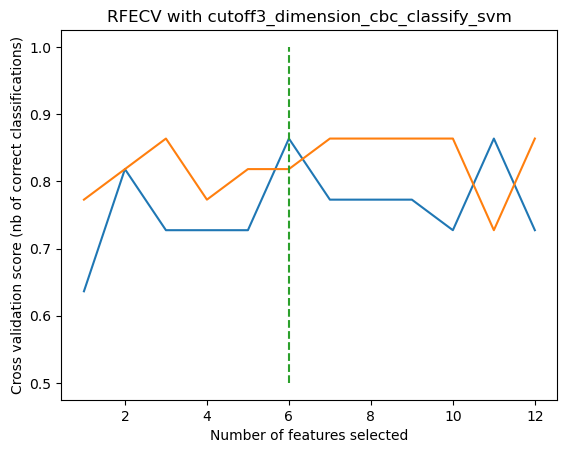

分类算法： nb
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


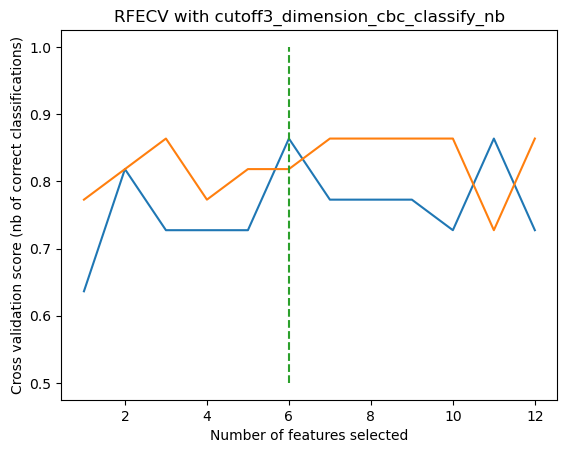

分类算法： cbc
0:	learn: 0.6658027	total: 360us	remaining: 1.44ms
1:	learn: 0.6413146	total: 604us	remaining: 906us
2:	learn: 0.6074907	total: 881us	remaining: 587us
3:	learn: 0.5766276	total: 1.15ms	remaining: 287us
4:	learn: 0.5522447	total: 1.42ms	remaining: 0us
best_index 4
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


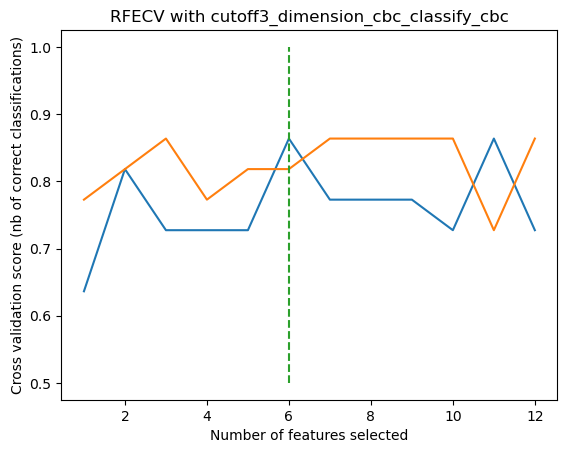

分类算法： bag
best_index 4
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


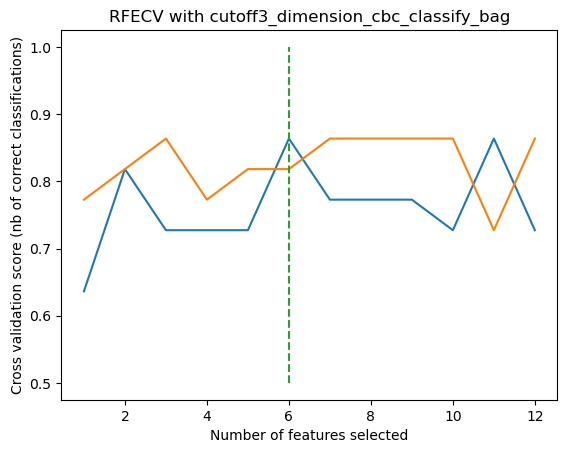

分类算法： cv
best_index 1
accuracy 0.9333333333333333


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:106: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\1353212350.py:107: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:103: FutureWarning: The `grid_scores_` attribute is deprecated in version 1.0 in favor of `cv_results_` and will be removed in version 1.2.
  warnings.warn(msg, category=FutureWarning)


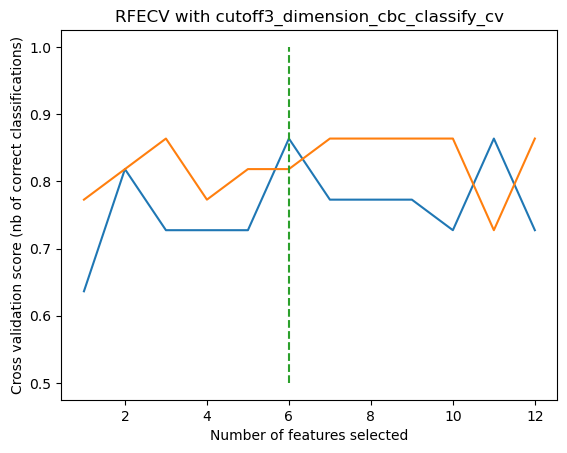

,cutoff,Dimensionality_reduction_methods,classify_method,dimension,TCR,best_thresthod,AUC,Accuracy,Sensitivity,Specificity,F1,FDR,Cross_entropy_loss
0,1,lr,lr,327,"Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFG...",2.798173e-01,0.960000,0.933333,0.866667,1.0,0.0,0.928571,0.218422
0,1,lr,rf,327,"Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFG...",5.523810e-01,0.971111,0.933333,0.866667,1.0,0.0,0.928571,0.224357
0,1,lr,lda,327,"Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFG...",6.472360e-17,1.000000,0.966667,0.933333,1.0,0.0,0.965517,2.023916
0,1,lr,gbdt,327,"Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFG...",9.981711e-01,0.962222,0.933333,0.866667,1.0,0.0,0.928571,0.350920
0,1,lr,adb,327,"Index(['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSFG...",1.287795e-03,0.957778,0.966667,0.933333,1.0,0.0,0.965517,0.236822
...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,3,cbc,svm,6,"Index(['CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGGG...",6.558291e-02,0.933333,0.933333,0.866667,1.0,0.0,0.928571,0.272322
0,3,cbc,nb,6,"Index(['CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGGG...",4.068749e-29,0.933333,0.933333,0.866667,1.0,0.0,0.928571,2.302585
0,3,cbc,cbc,6,"Index(['CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGGG...",3.748939e-01,0.933333,0.933333,0.866667,1.0,0.0,0.928571,0.589833
0,3,cbc,bag,6,"Index(['CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGGG...",0.000000e+00,0.933333,0.933333,0.866667,1.0,0.0,0.928571,2.390610


In [16]:
'''
train
'''

import numpy as np
import matplotlib.pyplot as plt
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, confusion_matrix, roc_auc_score, f1_score, log_loss
from sklearn.model_selection import StratifiedKFold
from sklearn.feature_selection import RFECV
from sklearn.datasets import make_classification
from sklearn.preprocessing import StandardScaler
from xgboost import XGBClassifier
import pandas as pd

dfs=pd.DataFrame() 
for i in range(1,4):
    print("cutoff%d"%i)
    data_train=pd.read_csv('data/Glioma_multi_dimension/ori/train_e-%d.csv'%i)
    data_test=pd.read_csv('data/Glioma_multi_dimension/ori/test_e-%d.csv'%i)
    #训练数据格式处理
    data_train.drop(['Unnamed: 0'], axis=1, inplace=True)# 删除无关列
    data_train = data_train.apply(pd.to_numeric, errors='coerce')# 将非数字转换为缺失值
    data_train[data_train > 0] = 1#将大于0的全部变为1
#     data_train = data_train.sample(frac=1.0)#打乱阳性阴性的顺序，增加随机度
    # 同上处理测试数据
    data_test.drop(['Unnamed: 0'], axis=1, inplace=True)
    data_test = data_test.apply(pd.to_numeric, errors='coerce')# 将非数字转换为缺失值
    data_test[data_test > 0] = 1
#     data_test = data_test.sample(frac=1.0)

    #划分自变量因变量
    #test
    yt,Xt=np.split(data_test,indices_or_sections=(1,),axis=1)
    Xt = Xt.values
    yt = yt.values
    #train
    y1,X1=np.split(data_train,indices_or_sections=(1,),axis=1)
    X = X1.values
    y = y1.values
    
    #标准化 可选 knn要 其他不用
    Xs = StandardScaler().fit_transform(X) 
    Xts = StandardScaler().fit_transform(Xt) 
    
    #赋值，可取消
    train_data,train_label,train_datas,train_labels=X,y,Xs,y
    test_data,test_label,test_datas,test_labels=Xt,yt,Xts,yt

    #降维算法结合分类算法
    algorithms = ["lr","rf","lda","gbdt","adb","xgb","dt","svm","cbc"]#,",knn","poly","bag","cv","nb"
    for alg in algorithms:
        print("降维算法：",alg)
        clf_dimension=eval("%s_clf"%alg)
        
        # 降维算法设置：降维算法若为svm或bag，则需要调整 importance_getter 设置
        list=["svm","bag"]
        if alg in list:
            rfecv = RFECV(estimator=clf_dimension, step=1, cv=StratifiedKFold(2),
              scoring='accuracy', importance_getter='coef_')
        else:
            rfecv = RFECV(estimator=clf_dimension, step=1, cv=StratifiedKFold(2),
                          scoring='accuracy')
            
        #降维算法训练（用标准化后的数据来降维）
        rfecv.fit(Xs, y)
        num_features = rfecv.n_features_
        print("Optimal number of features : %d" % rfecv.n_features_)
        # Output the three dimensions with the best performance
        feature_indices = rfecv.get_support(indices=True)
        best_features = X1.columns[feature_indices]
        print("Best performing dimensions:", best_features)
#         print("Feature ranking:", rfecv.ranking_) # Output the importance list
        # Use the selected features to train and test the classifier
        X_train = Xs[:, feature_indices]
        X_test = Xts[:, feature_indices]
#         svc.fit(X_train, y)
#         y_pred = svc.predict(X_test)
        # Calculate
        from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score, roc_auc_score, log_loss
        algorithms_classify = ["lr","rf","lda","gbdt","adb","xgb","dt","svm","nb","cbc","bag","cv"]
        for clf in algorithms_classify:
            print("分类算法：",clf)
            clfs = clf
            clf=eval("%s_clf"%clf)
            clf.fit(train_data[:, feature_indices], train_label.ravel())
            score = clf.predict_proba(test_data[:, feature_indices])[:,1]
            predict = clf.predict(test_data[:, feature_indices])
            fpr,tpr,thres = roc_curve(yt,score,)
            result=classification_inbestthres_valid(yt,predict,score,fpr,tpr,thres)

            df=[]
            list = [i,alg,clfs,num_features,best_features,result[0],result[1],result[2],result[3],result[4],result[5],result[6],result[7]]
            df.append(list)
            data=pd.DataFrame(df)
            dfs=pd.concat([dfs,data])

            # Plot number of features VS. cross-validation scores
            plt.figure()
            plt.title("RFECV with cutoff%d_dimension_%s_classify_%s"%(i,alg,clfs))
            plt.xlabel("Number of features selected")
            plt.ylabel("Cross validation score (nb of correct classifications)")
            plt.plot(range(1, len(rfecv.grid_scores_) + 1), rfecv.grid_scores_)
            plt.plot([rfecv.n_features_, rfecv.n_features_], [0.5, 1.0], linestyle='--', label="Optimal number of features")
            plt.savefig("data/Glioma_multi_dimension/figure/RFECV/cutoff%d/降维%s_分类%s"%(i,alg,clfs))
            plt.show()
            
dfs.columns = ['cutoff','Dimensionality_reduction_methods','classify_method','dimension','TCR','best_thresthod','AUC','Accuracy','Sensitivity','Specificity','F1','FDR','Cross_entropy_loss']
dfs.to_excel('data/Glioma_multi_dimension/result_sheet/RFECV_all.xlsx')
dfs 

### Test Sequence Group

分类算法： lr
best_index 5
accuracy 0.9666666666666667
分类算法： rf


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\134056518.py:96: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\134056518.py:97: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\134056518.py:96: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\134056518.py:97: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\134056518.py:96: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\134056518.py:97: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

best_index 3
accuracy 0.9666666666666667
分类算法： lda
best_index 5
accuracy 0.9666666666666667
分类算法： gbdt
best_index 1
accuracy 0.9666666666666667
分类算法： adb


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\134056518.py:96: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\134056518.py:97: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\134056518.py:96: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\134056518.py:97: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\134056518.py:96: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\134056518.py:97: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator

best_index 5
accuracy 0.9666666666666667
分类算法： xgb
best_index 4
accuracy 0.9666666666666667
分类算法： dt
best_index 1
accuracy 0.9666666666666667
分类算法： svm
best_index 4
accuracy 0.9666666666666667
分类算法： nb
best_index 1
accuracy 0.9666666666666667
分类算法： cbc
0:	learn: 0.6642007	total: 371us	remaining: 1.49ms
1:	learn: 0.6382580	total: 833us	remaining: 1.25ms
2:	learn: 0.6125386	total: 1.05ms	remaining: 698us
3:	learn: 0.5888198	total: 1.26ms	remaining: 315us
4:	learn: 0.5696353	total: 1.45ms	remaining: 0us
best_index 4
accuracy 0.9666666666666667
分类算法： bag
best_index 2
accuracy 0.9666666666666667
分类算法： cv
best_index 1
accuracy 0.9666666666666667


C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\134056518.py:96: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\134056518.py:97: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\134056518.py:96: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\134056518.py:97: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\134056518.py:96: RuntimeWarning: invalid value encountered in longlong_scalars
  precision = tp / (tp + fp)
C:\Users\Administrator\AppData\Local\Temp\ipykernel_47524\134056518.py:97: RuntimeWarning: invalid value encountered in longlong_scalars
  FDR = fp / (tp + fp)


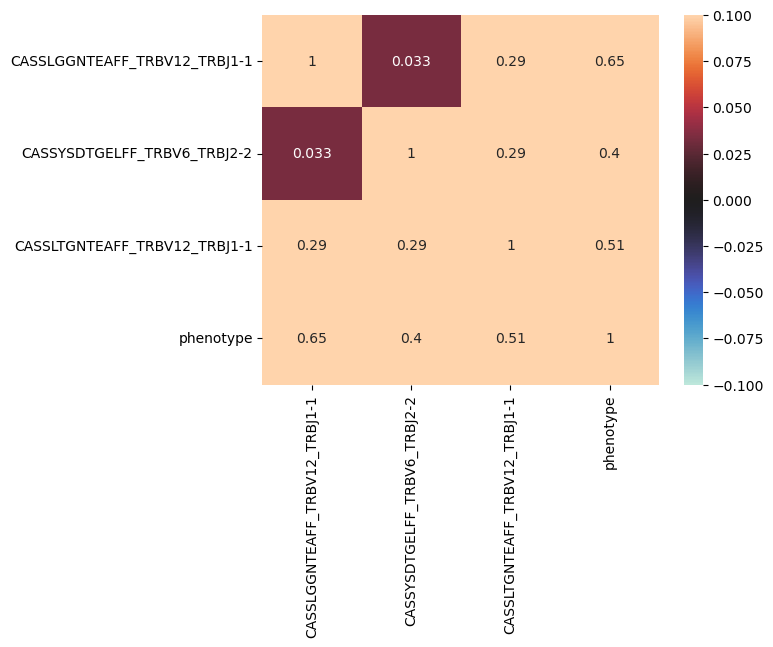

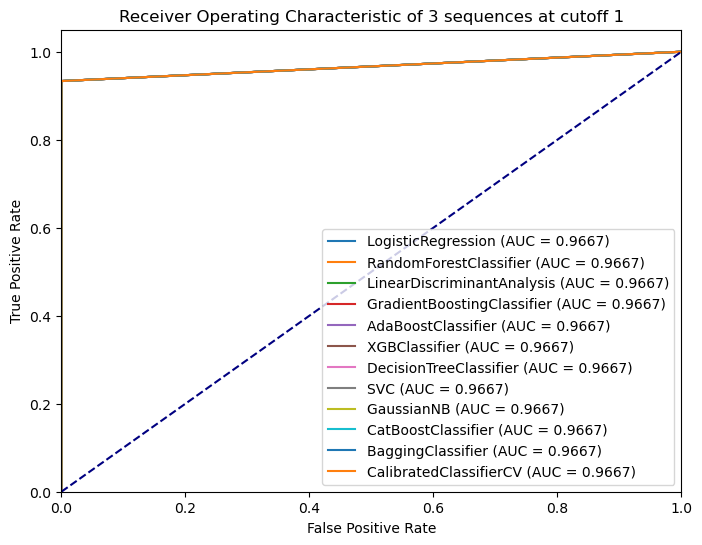

,algorithm,best_thresthod,AUC,Accuracy,Sensitivity,Specificity,FDR,F1,Cross_entropy_loss
0,lr,2.355287e-01,0.966667,0.966667,0.933333,1.0,0.0,0.965517,0.267678
0,rf,1.182072e-01,0.966667,0.966667,0.933333,1.0,0.0,0.965517,0.141586
0,lda,4.492950e-02,0.966667,0.966667,0.933333,1.0,0.0,0.965517,0.190627
0,gbdt,1.200106e-01,0.966667,0.966667,0.933333,1.0,0.0,0.965517,0.134605
0,adb,4.950191e-01,0.966667,0.966667,0.933333,1.0,0.0,0.965517,0.508340
0,xgb,2.255551e-01,0.966667,0.966667,0.933333,1.0,0.0,0.965517,0.269119
0,dt,1.200000e-01,0.966667,0.966667,0.933333,1.0,0.0,0.965517,0.134592
0,svm,2.306528e-01,0.966667,0.966667,0.933333,1.0,0.0,0.965517,0.194974
0,nb,7.945588e-15,0.966667,0.966667,0.933333,1.0,0.0,0.965517,1.082205
0,cbc,4.014239e-01,0.966667,0.966667,0.933333,1.0,0.0,0.965517,0.565663


In [17]:
'''
三条序列
'''

import numpy as np
import matplotlib.pyplot as plt
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, confusion_matrix, roc_auc_score, f1_score, log_loss
from sklearn.model_selection import StratifiedKFold
from sklearn.feature_selection import RFECV
from sklearn.datasets import make_classification
from sklearn.preprocessing import StandardScaler
from xgboost import XGBClassifier
import pandas as pd

data_train1=pd.read_csv('data/Glioma_multi_dimension/ori/train_e-1.csv')
data_test1=pd.read_csv('data/Glioma_multi_dimension/ori/test_e-1.csv')

# # cutoff3 筛选（完全同上） 可以
# cols = ['CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGETQYF_TRBV12_TRBJ2-5',
#        'CASSLGGNQPQHF_TRBV12_TRBJ1-5', 'CASSLRETQYF_TRBV12_TRBJ2-5',
#        'CASSLSGNTIYF_TRBV12_TRBJ1-3', 'phenotype']

# # cutoff1 筛选
# cols = ['CASSLGGNTEAFF_TRBV12_TRBJ1-1', 'CASSQGYEQYF_TRBV3_TRBJ2-7',
#        'CASSLSGNTIYF_TRBV12_TRBJ1-3', 'CASSLTGNTEAFF_TRBV12_TRBJ1-1',
#         'CASSYSDTGELFF_TRBV6_TRBJ2-2','phenotype']#CASSYSDTGELFF_TRBV6_TRBJ2-2 新的 （发现一个fisher精确检验可能筛选错误的序列）


# ## 极限3条序列（能达到auc 0.967）
# cols = ['CASSLQETQYF_TRBV12_TRBJ2-5', 'CASSLGGNQPQHF_TRBV12_TRBJ1-5',
#         'CASSLTGNTEAFF_TRBV12_TRBJ1-1', 'phenotype']#'CASSLGGGYTF_TRBV12_TRBJ1-2','CASSLRETQYF_TRBV12_TRBJ2-5','CASSLSGNTIYF_TRBV12_TRBJ1-3',

# # cutoff3 筛选（完全同上） 可以
# cols = [ 'CASSLGETQYF_TRBV12_TRBJ2-5',
#        'CASSLGGNQPQHF_TRBV12_TRBJ1-5', 
#        'CASSLSGNTIYF_TRBV12_TRBJ1-3', 'phenotype']#'CASSLQETQYF_TRBV12_TRBJ2-5','CASSLRETQYF_TRBV12_TRBJ2-5',

# # cutoff1 筛选
# cols = ['CASSQGYEQYF_TRBV3_TRBJ2-7','CASSLSGNTIYF_TRBV12_TRBJ1-3', 'CASSLGGNTEAFF_TRBV12_TRBJ1-1','CASSYSDTGELFF_TRBV6_TRBJ2-2',
#         'CASSLTGNTEAFF_TRBV12_TRBJ1-1','phenotype']
# #CASSYSDTGELFF_TRBV6_TRBJ2-2 新的 （发现一个fisher精确检验可能筛选错误的序列）

# cutoff1 筛选 极限3条
cols = [ 'CASSLGGNTEAFF_TRBV12_TRBJ1-1','CASSYSDTGELFF_TRBV6_TRBJ2-2',
        'CASSLTGNTEAFF_TRBV12_TRBJ1-1','phenotype']#'CASSQGYEQYF_TRBV3_TRBJ2-7','CASSLSGNTIYF_TRBV12_TRBJ1-3',
#CASSLGGNTEAFF_TRBV12_TRBJ1-1,CASSYSDTGELFF_TRBV6_TRBJ2-2,CASSLTGNTEAFF_TRBV12_TRBJ1-1,CASSQGYEQYF_TRBV3_TRBJ2-7,CASSLSGNTIYF_TRBV12_TRBJ1-3

# 根据列名，选取数据
data_train = data_train1[cols]
data_test = data_test1[cols]
data_test

# 替换大于0的都为1
data_train = data_train.apply(pd.to_numeric, errors='coerce')# 将非数字转换为缺失值
data_train[data_train > 0] = 1
data_train = data_train.sample(frac=1.0)
data_test = data_test.apply(pd.to_numeric, errors='coerce')# 将非数字转换为缺失值
data_test[data_test > 0] = 1
data_test = data_test.sample(frac=1.0)
data_test

import seaborn as sns
train_corr_Biological_index = data_train.corr()
sns.heatmap(data_train.corr(), vmin=-0.1,vmax=0.1,center=0, annot=True)#, annot=True 删除则中间无数字只有色块


# 划分自变量因变量，需要根据列数调整indices数值
#test
Xt1,yt1=np.split(data_test,indices_or_sections=(3,),axis=1)
Xt = Xt1.values
yt = yt1.values
#train
X1,y1=np.split(data_train,indices_or_sections=(3,),axis=1)
X = X1.values
y = y1.values

#标准化 可选 knn要 其他不用
Xs = StandardScaler().fit_transform(X) 
Xts = StandardScaler().fit_transform(Xt) 

# 网格搜索
#修改函数已获取最佳阈值对应的最佳准确率等
roc_data=[]
def classification_inbestthres_valid(test_label,predict,score,fpr,tpr,thres):
    results = []
    for threshold in thres:
        if threshold > 1:
            continue
        else:
            y_pred = (score > threshold).astype(int)
            tn, fp, fn, tp = confusion_matrix(test_label, y_pred).ravel()
            accuracy = (tp + tn) / (tp + tn + fn +fp)
            recall = tp / (tp + fn)
            speciality=tn / (tn + fp)
            precision = tp / (tp + fp)
            FDR = fp / (tp + fp)
            f1 = 2 * tp / (2 * tp + fn + fp)
            Cross_entropy_loss = metrics.log_loss(test_label, score)
            results.append([threshold, roc_auc_score(test_label, score), accuracy,recall,speciality, precision, FDR, f1, Cross_entropy_loss])#predictions.argmax(axis=1)) acc
    # 转换为数组并找出准确率最高的结果
    results = np.array(results)
    best_index = np.argmax(results[:, 2])
    print("best_index",best_index)
    # 输出最佳阈值下的指标
    best_threshold, auc_alg,accuracy, recall,speciality, precision, FDR, f1, Cross_entropy_loss = results[best_index, :]
    print("accuracy",accuracy)
    return best_threshold, auc_alg,accuracy, recall,speciality, FDR, f1, Cross_entropy_loss

# 降维算法集
algorithms = ["lr","rf","lda","gbdt","adb","xgb","dt","svm","cbc"]#,",knn","poly","bag","cv","nb"

# Calculate
dfs=pd.DataFrame() 
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score, roc_auc_score, log_loss
algorithms_classify = ["lr","rf","lda","gbdt","adb","xgb","dt","svm","nb","cbc","bag","cv"]
for clf in algorithms_classify:
    print("分类算法：",clf)
    clfs = clf
    clf=eval("%s_clf"%clf)
    clf.fit(X, y.ravel())
    score = clf.predict_proba(Xt)[:,1]
    predict = clf.predict(Xt)
    fpr,tpr,thres = roc_curve(yt,score,)
    result=classification_inbestthres_valid(yt,predict,score,fpr,tpr,thres)
    
    df=[]
    list = [clfs,result[0],result[1],result[2],result[3],result[4],result[5],result[6],result[7]]
    df.append(list)
    data=pd.DataFrame(df)
    dfs=pd.concat([dfs,data])
    
    
    # 绘制AUC图
    y_pred_prob = clf.predict_proba(Xt)[:, 1]
    fpr, tpr, _ = roc_curve(yt, y_pred_prob)
    roc_auc_value = roc_auc_score(yt, y_pred_prob)  # Use roc_auc_score function
    roc_data.append((clf.__class__.__name__, fpr, tpr, roc_auc_value))

plt.figure(figsize=(8, 6))
for clf, fpr, tpr, roc_auc in roc_data:
    plt.plot(fpr, tpr, label='%s (AUC = %.4f)' % (clf, roc_auc))

plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic of 3 sequences at cutoff 1')
plt.legend(loc="lower right")
plt.show()
    
dfs.columns = ['algorithm','best_thresthod','AUC','Accuracy','Sensitivity','Specificity','FDR','F1','Cross_entropy_loss']
dfs
